In [149]:
import numpy as np
from scipy.special import expit
import random
import importlib

import neural_network as nn
reload = importlib.reload(nn)


# Practically getting a neural network to work

The theory for the neural network can be found in the blog post. 
However, even after writing all the equations down and paying attention to atomic detail, getting a neural network to run is another story. 

Debugging it is not straightforward. We also have a hyperparameter whose value we need to set heuristically, which complicates the process more. In this notebook, I will document my efforts to test and debug a simple network.

The neural network itself is in the file: `neural_network.py`


## Test 1: Single number to number map, NO layers

### Dataset
Here each $X_i$ has dimensions $1 \times 1$ and each $Y_i$ has dimensions $1 \times 1$. 
Each $Y_i$ is just a multiple of $X_i$

### Network
We will use a network with only the input layer and the output layer. There is only one weight matrix with one value that is being trained. There is no non-linear layer involved. 

### Conclusion if the test succeeds
- If there are no errors, we know there are no dimension issues for the first and last layer
- We know that the last derivative in the chain rule has been taken correctly. 


In [43]:
# X should be a matrix of column matrices. It is an array of two dimensional numpy arrays. 
X = np.array([[[random.randint(1, 10)]] for i in range(100)])

In [44]:
X

array([[[ 2]],

       [[ 3]],

       [[ 6]],

       [[ 5]],

       [[ 9]],

       [[ 3]],

       [[ 4]],

       [[ 5]],

       [[ 1]],

       [[ 7]],

       [[ 4]],

       [[ 2]],

       [[10]],

       [[ 3]],

       [[ 8]],

       [[ 4]],

       [[ 8]],

       [[ 5]],

       [[ 9]],

       [[ 4]],

       [[ 4]],

       [[ 7]],

       [[ 6]],

       [[ 8]],

       [[ 9]],

       [[ 1]],

       [[ 5]],

       [[ 3]],

       [[ 9]],

       [[10]],

       [[ 2]],

       [[ 8]],

       [[ 4]],

       [[ 7]],

       [[ 5]],

       [[ 7]],

       [[ 6]],

       [[10]],

       [[ 4]],

       [[ 7]],

       [[ 8]],

       [[10]],

       [[ 4]],

       [[ 2]],

       [[ 5]],

       [[ 4]],

       [[ 4]],

       [[ 2]],

       [[ 2]],

       [[ 8]],

       [[ 4]],

       [[10]],

       [[ 2]],

       [[ 1]],

       [[10]],

       [[ 8]],

       [[ 7]],

       [[ 9]],

       [[ 7]],

       [[ 1]],

       [[ 5]],

       [[ 9]],

       [

In [45]:
# Y is also an array of two dimensional numpy arrays, where each inner 2D array represents a column vector
Y = np.array([[[5*X[i][0, 0]]] for i in range(100)])

In [46]:
Y

array([[[10]],

       [[15]],

       [[30]],

       [[25]],

       [[45]],

       [[15]],

       [[20]],

       [[25]],

       [[ 5]],

       [[35]],

       [[20]],

       [[10]],

       [[50]],

       [[15]],

       [[40]],

       [[20]],

       [[40]],

       [[25]],

       [[45]],

       [[20]],

       [[20]],

       [[35]],

       [[30]],

       [[40]],

       [[45]],

       [[ 5]],

       [[25]],

       [[15]],

       [[45]],

       [[50]],

       [[10]],

       [[40]],

       [[20]],

       [[35]],

       [[25]],

       [[35]],

       [[30]],

       [[50]],

       [[20]],

       [[35]],

       [[40]],

       [[50]],

       [[20]],

       [[10]],

       [[25]],

       [[20]],

       [[20]],

       [[10]],

       [[10]],

       [[40]],

       [[20]],

       [[50]],

       [[10]],

       [[ 5]],

       [[50]],

       [[40]],

       [[35]],

       [[45]],

       [[35]],

       [[ 5]],

       [[25]],

       [[45]],

       [

In [47]:
# The third argument refers to the layers and their sizes, excluding the input and output layer. 
# For example [5, 6, 7] refers to a 5 layer neural network (1 input, 3 middle, 1 output) where the middle layers
# have lengths 5, 6 and 7. The input layer length is defined by the column matrices in X and the output layer 
# length is defined by the column matrices in Y.
n = nn.neural_network(X, Y, [])

EPOCH: 0   ERROR: 63328.78061659152
dW 
[array([[3.12899816]])]
Weight
[array([[0.95213692]])]
EPOCH: 1   ERROR: 3263.2687363923264
dW 
[array([[0.71028258]])]
Weight
[array([[4.08113508]])]
EPOCH: 2   ERROR: 168.15297471756045
dW 
[array([[0.16123415]])]
Weight
[array([[4.79141766]])]
EPOCH: 3   ERROR: 8.66475463422128
dW 
[array([[0.03660015]])]
Weight
[array([[4.95265181]])]
EPOCH: 4   ERROR: 0.44648614154678823
dW 
[array([[0.00830823]])]
Weight
[array([[4.98925196]])]
EPOCH: 5   ERROR: 0.02300698438776567
dW 
[array([[0.00188597]])]
Weight
[array([[4.9975602]])]
EPOCH: 6   ERROR: 0.0011855268985165558
dW 
[array([[0.00042812]])]
Weight
[array([[4.99944616]])]
EPOCH: 7   ERROR: 6.108901555392688e-05
dW 
[array([[9.71821064e-05]])]
Weight
[array([[4.99987428]])]
EPOCH: 8   ERROR: 3.1478558825264185e-06
dW 
[array([[2.20603382e-05]])]
Weight
[array([[4.99997146]])]
EPOCH: 9   ERROR: 1.6220586575885507e-07
dW 
[array([[5.00769676e-06]])]
Weight
[array([[4.99999352]])]
EPOCH: 10   ERRO

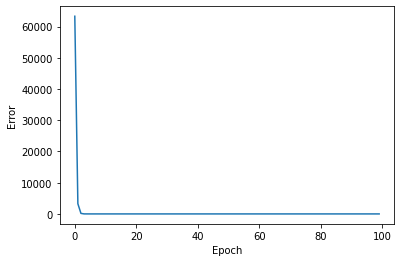

Weight Matrices 
[array([[5.]])]


In [48]:
# We set learning rate as this value after trial and error
n.train(100, 0.0001)

### Result
- The test passed. The error continuously decreased with number of epochs. The weight matrix was found. 
- Scroll down in the above cell to find the error vs epoch number graph

## Test 2: Single number to single number map, 1 layer of size 1

### Dataset
Same as above. Here we have a different multiple
### Neural network
We use a RELU network with exactly 1 layer of size 1.

We set all the weights to random numbers between 0 and 1 to begin with.
### Conclusion if test succeeds
The activation function and its derivative work

In [50]:
X = np.array([[[random.randint(1, 10)]] for i in range(100)])

In [51]:
Y = np.array([[[X[i][0, 0]/10.0]] for i in range(100)])

In [52]:
X

array([[[ 6]],

       [[ 9]],

       [[ 3]],

       [[ 5]],

       [[ 7]],

       [[10]],

       [[ 4]],

       [[ 6]],

       [[ 5]],

       [[ 3]],

       [[ 4]],

       [[ 2]],

       [[10]],

       [[ 5]],

       [[ 1]],

       [[ 3]],

       [[ 8]],

       [[ 3]],

       [[ 3]],

       [[ 5]],

       [[ 2]],

       [[10]],

       [[ 1]],

       [[ 1]],

       [[ 6]],

       [[ 8]],

       [[ 8]],

       [[ 6]],

       [[ 9]],

       [[ 7]],

       [[ 6]],

       [[10]],

       [[10]],

       [[ 8]],

       [[ 1]],

       [[ 1]],

       [[10]],

       [[ 8]],

       [[ 5]],

       [[ 2]],

       [[ 6]],

       [[ 1]],

       [[ 5]],

       [[ 1]],

       [[ 9]],

       [[ 8]],

       [[10]],

       [[ 3]],

       [[ 8]],

       [[ 6]],

       [[ 4]],

       [[ 9]],

       [[ 5]],

       [[ 1]],

       [[ 6]],

       [[ 7]],

       [[ 6]],

       [[ 1]],

       [[10]],

       [[ 2]],

       [[10]],

       [[ 5]],

       [

In [53]:
Y

array([[[0.6]],

       [[0.9]],

       [[0.3]],

       [[0.5]],

       [[0.7]],

       [[1. ]],

       [[0.4]],

       [[0.6]],

       [[0.5]],

       [[0.3]],

       [[0.4]],

       [[0.2]],

       [[1. ]],

       [[0.5]],

       [[0.1]],

       [[0.3]],

       [[0.8]],

       [[0.3]],

       [[0.3]],

       [[0.5]],

       [[0.2]],

       [[1. ]],

       [[0.1]],

       [[0.1]],

       [[0.6]],

       [[0.8]],

       [[0.8]],

       [[0.6]],

       [[0.9]],

       [[0.7]],

       [[0.6]],

       [[1. ]],

       [[1. ]],

       [[0.8]],

       [[0.1]],

       [[0.1]],

       [[1. ]],

       [[0.8]],

       [[0.5]],

       [[0.2]],

       [[0.6]],

       [[0.1]],

       [[0.5]],

       [[0.1]],

       [[0.9]],

       [[0.8]],

       [[1. ]],

       [[0.3]],

       [[0.8]],

       [[0.6]],

       [[0.4]],

       [[0.9]],

       [[0.5]],

       [[0.1]],

       [[0.6]],

       [[0.7]],

       [[0.6]],

       [[0.1]],

       [[1. ]]

In [54]:
n = nn.neural_network(X, Y, [1])

EPOCH: 0   ERROR: 3.103739687142175
dW 
[array([[0.01160762]]), array([[0.00296513]])]
Weight
[array([[0.13530959]]), array([[0.52969694]])]
dW 
[array([[0.01160762]]), array([[0.00296513]])]
Weight
[array([[0.14691722]]), array([[0.52969694]])]
EPOCH: 1   ERROR: 1.8285896829120867
dW 
[array([[0.00895949]]), array([[0.00247118]])]
Weight
[array([[0.14691722]]), array([[0.53266207]])]
dW 
[array([[0.00895949]]), array([[0.00247118]])]
Weight
[array([[0.1558767]]), array([[0.53266207]])]
EPOCH: 2   ERROR: 1.0639655152744039
dW 
[array([[0.00686592]]), array([[0.00199995]])]
Weight
[array([[0.1558767]]), array([[0.53513325]])]
dW 
[array([[0.00686592]]), array([[0.00199995]])]
Weight
[array([[0.16274263]]), array([[0.53513325]])]
EPOCH: 3   ERROR: 0.6126743706205517
dW 
[array([[0.00522962]]), array([[0.00158449]])]
Weight
[array([[0.16274263]]), array([[0.53713319]])]
dW 
[array([[0.00522962]]), array([[0.00158449]])]
Weight
[array([[0.16797225]]), array([[0.53713319]])]
EPOCH: 4   ERRO

EPOCH: 41   ERROR: 1.327267614560484e-10
dW 
[array([[7.79355783e-08]]), array([[2.63492579e-08]])]
Weight
[array([[0.18387213]]), array([[0.5438552]])]
dW 
[array([[7.79355783e-08]]), array([[2.63492579e-08]])]
Weight
[array([[0.18387221]]), array([[0.5438552]])]
EPOCH: 42   ERROR: 7.367283041938954e-11
dW 
[array([[5.8064436e-08]]), array([[1.96310261e-08]])]
Weight
[array([[0.18387221]]), array([[0.54385523]])]
dW 
[array([[5.8064436e-08]]), array([[1.96310261e-08]])]
Weight
[array([[0.18387227]]), array([[0.54385523]])]
EPOCH: 43   ERROR: 4.0893677189483966e-11
dW 
[array([[4.32598125e-08]]), array([[1.46257297e-08]])]
Weight
[array([[0.18387227]]), array([[0.54385525]])]
dW 
[array([[4.32598125e-08]]), array([[1.46257297e-08]])]
Weight
[array([[0.18387231]]), array([[0.54385525]])]
EPOCH: 44   ERROR: 2.2698906582924193e-11
dW 
[array([[3.22299054e-08]]), array([[1.08966256e-08]])]
Weight
[array([[0.18387231]]), array([[0.54385526]])]
dW 
[array([[3.22299054e-08]]), array([[1.08966

[array([[1.08233296e-12]]), array([[3.65926742e-13]])]
Weight
[array([[0.18387244]]), array([[0.5438553]])]
EPOCH: 80   ERROR: 1.4208772533555083e-20
dW 
[array([[8.06370956e-13]]), array([[2.72626546e-13]])]
Weight
[array([[0.18387244]]), array([[0.5438553]])]
dW 
[array([[8.06370956e-13]]), array([[2.72626546e-13]])]
Weight
[array([[0.18387244]]), array([[0.5438553]])]
EPOCH: 81   ERROR: 7.886741430934562e-21
dW 
[array([[6.00766071e-13]]), array([[2.0311344e-13]])]
Weight
[array([[0.18387244]]), array([[0.5438553]])]
dW 
[array([[6.00766071e-13]]), array([[2.0311344e-13]])]
Weight
[array([[0.18387244]]), array([[0.5438553]])]
EPOCH: 82   ERROR: 4.3777336126062974e-21
dW 
[array([[4.47590914e-13]]), array([[1.51326339e-13]])]
Weight
[array([[0.18387244]]), array([[0.5438553]])]
dW 
[array([[4.47590914e-13]]), array([[1.51326339e-13]])]
Weight
[array([[0.18387244]]), array([[0.5438553]])]
EPOCH: 83   ERROR: 2.4299800968714912e-21
dW 
[array([[3.3347091e-13]]), array([[1.12743424e-13]]

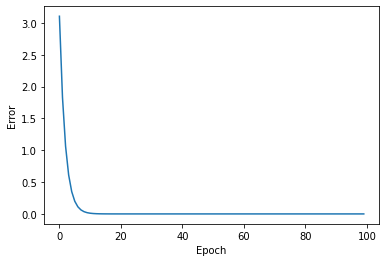

Weight Matrices 
[array([[0.18387244]]), array([[0.5438553]])]


In [57]:
n.train(100, 0.0001)

In [39]:
n.sigmoid(0.37)

0.5914589784327801

### Results
1. The test passed
2. Once again, scroll down in the above cell to find the error vs epoch matrix. 
3. The initial random values are extremely important! Here I set them all to be between 0 and 1. Previously I had set them in the range 10-20. Remember, using the step size, we should be able to reach the optimal values from the initial values as well!
The initial weights can be set in the following line in the `train` function in the `neural_network.py` file:
```
        self.W = [np.random.rand(self.layers[i+1], self.layers[i]) for i in range(self.n)]
```
4. I worry about when I have non-linear functions. How will ReLU manage? Perhaps I should set the initial matrix weights to be negative as well, then. 


## Test 3
No layers, many to many map

In [58]:
X = np.array([[[random.randint(1, 10)],[random.randint(1, 10)]] for i in range(100)])

In [59]:
Y = np.array([[[X[i][0, 0]/10],[X[i][1,0]/20]] for i in range(100)])

In [60]:
X

array([[[ 8],
        [ 6]],

       [[ 8],
        [ 2]],

       [[ 8],
        [10]],

       [[ 1],
        [ 9]],

       [[ 4],
        [ 3]],

       [[ 5],
        [10]],

       [[ 3],
        [10]],

       [[ 7],
        [ 6]],

       [[ 1],
        [ 8]],

       [[ 8],
        [ 7]],

       [[ 6],
        [ 9]],

       [[ 7],
        [10]],

       [[ 5],
        [ 6]],

       [[ 9],
        [ 8]],

       [[ 7],
        [ 4]],

       [[ 3],
        [ 2]],

       [[ 9],
        [ 4]],

       [[ 4],
        [ 6]],

       [[ 9],
        [ 6]],

       [[ 6],
        [ 4]],

       [[ 5],
        [ 8]],

       [[10],
        [ 7]],

       [[ 4],
        [ 8]],

       [[ 8],
        [ 1]],

       [[ 1],
        [ 3]],

       [[ 1],
        [ 9]],

       [[ 6],
        [ 6]],

       [[ 5],
        [ 2]],

       [[ 7],
        [ 2]],

       [[ 8],
        [ 1]],

       [[ 7],
        [ 1]],

       [[ 1],
        [ 3]],

       [[ 5],
        [ 1]],

       [[ 

In [61]:
Y

array([[[0.8 ],
        [0.3 ]],

       [[0.8 ],
        [0.1 ]],

       [[0.8 ],
        [0.5 ]],

       [[0.1 ],
        [0.45]],

       [[0.4 ],
        [0.15]],

       [[0.5 ],
        [0.5 ]],

       [[0.3 ],
        [0.5 ]],

       [[0.7 ],
        [0.3 ]],

       [[0.1 ],
        [0.4 ]],

       [[0.8 ],
        [0.35]],

       [[0.6 ],
        [0.45]],

       [[0.7 ],
        [0.5 ]],

       [[0.5 ],
        [0.3 ]],

       [[0.9 ],
        [0.4 ]],

       [[0.7 ],
        [0.2 ]],

       [[0.3 ],
        [0.1 ]],

       [[0.9 ],
        [0.2 ]],

       [[0.4 ],
        [0.3 ]],

       [[0.9 ],
        [0.3 ]],

       [[0.6 ],
        [0.2 ]],

       [[0.5 ],
        [0.4 ]],

       [[1.  ],
        [0.35]],

       [[0.4 ],
        [0.4 ]],

       [[0.8 ],
        [0.05]],

       [[0.1 ],
        [0.15]],

       [[0.1 ],
        [0.45]],

       [[0.6 ],
        [0.3 ]],

       [[0.5 ],
        [0.1 ]],

       [[0.7 ],
        [0.1 ]],

       [[0.8 ]

In [62]:
n = nn.neural_network(X, Y, [])

EPOCH: 0   ERROR: 7095.530078976494
dW 
[array([[-0.43320746, -0.36852734],
       [-0.95044368, -0.8738992 ]])]
Weight
[array([[0.45026646, 0.21538426],
       [0.62191157, 0.73303194]])]
EPOCH: 1   ERROR: 1170.5409359787413
dW 
[array([[0.16417219, 0.16186913],
       [0.39960177, 0.33751431]])]
Weight
[array([[ 0.017059  , -0.15314308],
       [-0.32853211, -0.14086726]])]
EPOCH: 2   ERROR: 196.3773736790976
dW 
[array([[-0.07560801, -0.05535591],
       [-0.14997449, -0.14996601]])]
Weight
[array([[0.18123118, 0.00872605],
       [0.07106966, 0.19664705]])]
EPOCH: 3   ERROR: 35.07434653890346
dW 
[array([[0.02324814, 0.03066768],
       [0.07033292, 0.05000378]])]
Weight
[array([[ 0.10562317, -0.04662986],
       [-0.07890484,  0.04668104]])]
EPOCH: 4   ERROR: 7.625377891313823
dW 
[array([[-0.01537736, -0.00575062],
       [-0.02072767, -0.02892973]])]
Weight
[array([[ 0.12887131, -0.01596218],
       [-0.00857192,  0.09668483]])]
EPOCH: 5   ERROR: 2.474934382239729
dW 
[array([[0

EPOCH: 64   ERROR: 2.1176166286387817e-11
dW 
[array([[-1.15625680e-08,  1.29354968e-08],
       [ 1.50443496e-08, -1.68307020e-08]])]
Weight
[array([[ 1.00000060e-01, -6.75834614e-08],
       [-7.86014823e-08,  5.00000879e-02]])]
EPOCH: 65   ERROR: 1.3845685374150693e-11
dW 
[array([[-9.34948868e-09,  1.04596384e-08],
       [ 1.21648561e-08, -1.36093001e-08]])]
Weight
[array([[ 1.00000049e-01, -5.46479647e-08],
       [-6.35571327e-08,  5.00000711e-02]])]
EPOCH: 66   ERROR: 9.05277191616657e-12
dW 
[array([[-7.55999346e-09,  8.45766020e-09],
       [ 9.83649867e-09, -1.10044756e-08]])]
Weight
[array([[ 1.00000039e-01, -4.41883262e-08],
       [-5.13922766e-08,  5.00000575e-02]])]
EPOCH: 67   ERROR: 5.919004885596379e-12
dW 
[array([[-6.11300822e-09,  6.83886125e-09],
       [ 7.95378958e-09, -8.89821531e-09]])]
Weight
[array([[ 1.00000032e-01, -3.57306660e-08],
       [-4.15557779e-08,  5.00000465e-02]])]
EPOCH: 68   ERROR: 3.87004324928475e-12
dW 
[array([[-4.94297644e-09,  5.529900

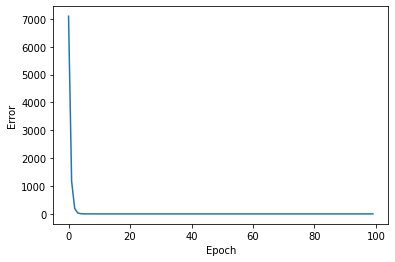

Weight Matrices 
[array([[ 1.00000000e-01, -3.22291318e-11],
       [-3.74833960e-11,  5.00000000e-02]])]


In [63]:
n.train(100, 0.0001)

In [64]:
X = np.array([[[random.randint(1, 10)] for j in range(10)] for i in range(100)])

In [65]:
Y = np.array([[[X[i][j, 0]/(j+1)] for j in range(10)] for i in range(100)])

In [66]:
X


array([[[10],
        [ 9],
        [ 9],
        [ 4],
        [ 4],
        [ 9],
        [ 9],
        [ 4],
        [ 8],
        [ 4]],

       [[ 6],
        [ 4],
        [ 2],
        [ 9],
        [10],
        [ 7],
        [ 1],
        [ 8],
        [ 6],
        [ 5]],

       [[ 8],
        [ 4],
        [ 4],
        [ 5],
        [ 2],
        [ 4],
        [ 3],
        [ 3],
        [ 1],
        [ 5]],

       [[ 7],
        [10],
        [10],
        [ 5],
        [ 1],
        [10],
        [ 8],
        [ 2],
        [ 6],
        [ 3]],

       [[ 3],
        [ 3],
        [ 2],
        [ 3],
        [ 7],
        [ 9],
        [ 1],
        [ 7],
        [ 9],
        [ 2]],

       [[10],
        [ 6],
        [ 8],
        [ 4],
        [ 7],
        [ 8],
        [ 9],
        [10],
        [ 5],
        [ 2]],

       [[ 1],
        [ 8],
        [ 6],
        [ 3],
        [ 1],
        [ 6],
        [ 5],
        [ 7],
        [ 1],
        [ 6]],

      

In [67]:
Y

array([[[10.        ],
        [ 4.5       ],
        [ 3.        ],
        [ 1.        ],
        [ 0.8       ],
        [ 1.5       ],
        [ 1.28571429],
        [ 0.5       ],
        [ 0.88888889],
        [ 0.4       ]],

       [[ 6.        ],
        [ 2.        ],
        [ 0.66666667],
        [ 2.25      ],
        [ 2.        ],
        [ 1.16666667],
        [ 0.14285714],
        [ 1.        ],
        [ 0.66666667],
        [ 0.5       ]],

       [[ 8.        ],
        [ 2.        ],
        [ 1.33333333],
        [ 1.25      ],
        [ 0.4       ],
        [ 0.66666667],
        [ 0.42857143],
        [ 0.375     ],
        [ 0.11111111],
        [ 0.5       ]],

       [[ 7.        ],
        [ 5.        ],
        [ 3.33333333],
        [ 1.25      ],
        [ 0.2       ],
        [ 1.66666667],
        [ 1.14285714],
        [ 0.25      ],
        [ 0.66666667],
        [ 0.3       ]],

       [[ 3.        ],
        [ 1.5       ],
        [ 0.66666667],
   

In [68]:
n = nn.neural_network(X, Y, [])

EPOCH: 0   ERROR: 583483.7034500979
dW 
[array([[-0.2175825 , -0.23439078, -0.22543176, -0.22654182, -0.22619117,
        -0.22676984, -0.21308711, -0.23006664, -0.22241072, -0.21118025],
       [-0.19425718, -0.18814633, -0.18373523, -0.18690215, -0.18911225,
        -0.18332861, -0.1783917 , -0.18246662, -0.18317547, -0.17837539],
       [-0.23051497, -0.21280355, -0.19989604, -0.20794816, -0.22044157,
        -0.20753208, -0.20379652, -0.20764046, -0.22009615, -0.21145745],
       [-0.30947864, -0.28584374, -0.27743527, -0.29322326, -0.29298595,
        -0.29394291, -0.27679728, -0.29560317, -0.29630568, -0.2723079 ],
       [-0.32443607, -0.3220168 , -0.30943235, -0.31379983, -0.30338012,
        -0.30630232, -0.30827328, -0.30829454, -0.30881039, -0.29552944],
       [-0.26004107, -0.23672875, -0.23419256, -0.23238503, -0.24820892,
        -0.22626689, -0.24271567, -0.24272214, -0.24290903, -0.22778922],
       [-0.26076209, -0.25485993, -0.25369947, -0.25004303, -0.2450186 ,
    

EPOCH: 19   ERROR: 4582.72278470785
dW 
[array([[ 0.01607529, -0.00711213, -0.0045554 , -0.00027438, -0.00189183,
        -0.00423037,  0.00297903, -0.00421144,  0.00162644,  0.00035301],
       [ 0.00355069, -0.0017805 , -0.00135434, -0.00048215, -0.00207872,
        -0.0013966 ,  0.00086414,  0.00206253,  0.00198991, -0.00174318],
       [-0.00072271,  0.00019727,  0.0067228 ,  0.0038534 , -0.00439542,
        -0.0001688 ,  0.0021007 ,  0.00368877, -0.00490104, -0.00642344],
       [ 0.00134712,  0.00377171,  0.00478658, -0.0004577 , -0.00095785,
        -0.00660647,  0.00317482, -0.0030335 , -0.00398591,  0.00202602],
       [ 0.00638863, -0.00680975, -0.00370533, -0.00133696,  0.00660842,
        -0.00066042, -0.00467256,  0.0018645 ,  0.00226451, -0.00071661],
       [-0.0004933 ,  0.00315717,  0.00073871,  0.00545999, -0.00431333,
         0.00550956, -0.00696313, -0.00189759, -0.00179257,  0.00059042],
       [ 0.00417173, -0.00434312, -0.00716441, -0.00070626,  0.0037377 ,
    

EPOCH: 37   ERROR: 2493.7838224981697
dW 
[array([[ 1.15697087e-02, -5.23301076e-03, -3.42015108e-03,
         4.35760698e-04, -2.31249038e-03, -2.35553839e-03,
         2.27382793e-03, -3.04668888e-03,  1.30933602e-03,
        -1.12836649e-04],
       [ 2.64254983e-03, -1.35531029e-03, -8.61124545e-04,
        -2.44605663e-04, -1.75563054e-03, -1.03355033e-03,
         5.89391078e-04,  1.47720001e-03,  1.54465093e-03,
        -1.27395075e-03],
       [-1.87000057e-04, -5.09637871e-06,  5.22420521e-03,
         2.69356679e-03, -3.33261254e-03, -5.99100843e-04,
         1.68707864e-03,  2.64272898e-03, -3.64568006e-03,
        -4.52792097e-03],
       [ 7.59541055e-04,  2.80771883e-03,  3.34204609e-03,
         1.98564192e-04, -1.05327903e-03, -4.62993614e-03,
         2.18549148e-03, -1.78909054e-03, -3.05739024e-03,
         1.28837714e-03],
       [ 4.35821794e-03, -4.56336468e-03, -2.87157154e-03,
        -1.06437874e-03,  4.63105487e-03,  1.11494366e-05,
        -3.29031615e-03,  1

EPOCH: 57   ERROR: 1309.3827584630737
dW 
[array([[ 8.11457773e-03, -3.77550507e-03, -2.44054351e-03,
         7.58951515e-04, -2.34398336e-03, -1.17396290e-03,
         1.70686423e-03, -2.17467465e-03,  1.02421590e-03,
        -3.17403551e-04],
       [ 1.91293701e-03, -1.00698779e-03, -5.02260972e-04,
        -8.75588524e-05, -1.44051605e-03, -7.50747806e-04,
         3.91310039e-04,  1.02218431e-03,  1.16623357e-03,
        -8.96881009e-04],
       [ 1.11596949e-04, -1.22714433e-04,  3.92575458e-03,
         1.84488917e-03, -2.50345841e-03, -7.65775093e-04,
         1.31362936e-03,  1.85688072e-03, -2.62285522e-03,
        -3.08261463e-03],
       [ 4.08564628e-04,  2.02737998e-03,  2.26048798e-03,
         5.20311836e-04, -1.01077409e-03, -3.18367436e-03,
         1.44185731e-03, -9.48368051e-04, -2.27997597e-03,
         8.02341272e-04],
       [ 2.86669939e-03, -2.92317614e-03, -2.14009548e-03,
        -8.40320133e-04,  3.17164332e-03,  3.62689708e-04,
        -2.24478866e-03,  7

        -2.84092756e-04]])]
Weight
[array([[ 6.26972195e-01,  2.11559526e-01,  8.43377962e-02,
        -9.44825308e-02,  2.29076285e-01,  3.03015160e-03,
        -1.11903238e-01,  1.12913639e-01, -6.63204021e-02,
         3.08486833e-02],
       [-9.54358386e-02,  5.58604796e-01, -4.27093479e-04,
        -1.29598076e-02,  1.09066295e-01,  4.26575660e-02,
        -1.91858382e-02, -4.35865777e-02, -6.54249412e-02,
         3.52021402e-02],
       [-4.06289257e-02,  3.20161436e-02,  1.24496141e-01,
        -8.75401556e-02,  1.68492249e-01,  8.34175606e-02,
        -8.07699612e-02, -9.47794019e-02,  1.19442383e-01,
         1.11779890e-01],
       [-1.90103014e-02, -1.02589521e-01, -8.87931891e-02,
         1.77375769e-01,  9.58467384e-02,  1.53572159e-01,
        -4.17682833e-02, -1.16671429e-02,  1.25155620e-01,
        -3.89396633e-02],
       [-9.70439902e-02,  8.52487603e-02,  1.07071161e-01,
         5.82733354e-02,  4.68248482e-02, -6.63624594e-02,
         9.20667155e-02,  8.128143

EPOCH: 96   ERROR: 403.59786685639983
dW 
[array([[ 4.17832729e-03, -2.07955878e-03, -1.20287015e-03,
         7.80893632e-04, -1.89360734e-03, -2.19246667e-04,
         1.01121091e-03, -1.18546010e-03,  6.29563144e-04,
        -3.30829219e-04],
       [ 1.03320102e-03, -5.74844056e-04, -1.41702324e-04,
         4.32879664e-05, -9.59047307e-04, -4.18888727e-04,
         1.87650760e-04,  5.04365855e-04,  6.75050527e-04,
        -4.48568095e-04],
       [ 2.73846705e-04, -1.89449308e-04,  2.22610936e-03,
         9.32666154e-04, -1.50550885e-03, -6.98043316e-04,
         7.96180192e-04,  9.78856778e-04, -1.37871198e-03,
        -1.46565368e-03],
       [ 1.44301705e-04,  1.08714854e-03,  1.07823787e-03,
         5.97329135e-04, -7.78663156e-04, -1.62444876e-03,
         6.33873929e-04, -1.87313561e-04, -1.29248011e-03,
         3.59882003e-04],
       [ 1.28564434e-03, -1.22029690e-03, -1.18248187e-03,
        -5.39723529e-04,  1.59680614e-03,  5.01644708e-04,
        -1.08939642e-03,  2

        -2.29207193e-04]])]
Weight
[array([[ 0.79546612,  0.12834723,  0.03551246, -0.06475866,  0.1558777 ,
        -0.00753459, -0.07175191,  0.06543664, -0.04140416,  0.01823465],
       [-0.05398656,  0.53568436, -0.00669574, -0.01162778,  0.07140639,
         0.02591978, -0.01155921, -0.02313867, -0.03854338,  0.01704001],
       [-0.03057144,  0.02496702,  0.21335674, -0.04986841,  0.10882091,
         0.05664873, -0.04921188, -0.05542503,  0.06394821,  0.05209214],
       [-0.01292558, -0.05893737, -0.04491226,  0.19996979,  0.06563345,
         0.08803078, -0.01569056, -0.02061436,  0.07357266, -0.02421309],
       [-0.0443144 ,  0.03470858,  0.05972658,  0.03701653,  0.11136029,
        -0.0475672 ,  0.04782377,  0.01120093, -0.04884172,  0.04672426],
       [-0.07121695, -0.09934762,  0.01774657, -0.02114479,  0.06375859,
         0.14573085,  0.115521  , -0.00626771,  0.07084552, -0.0427137 ],
       [-0.02810638,  0.05798906,  0.05748755,  0.00903354, -0.07609755,
        -

EPOCH: 133   ERROR: 142.46085794355375
dW 
[array([[ 2.28808418e-03, -1.23219048e-03, -5.78796852e-04,
         5.89918323e-04, -1.36698014e-03,  2.07318828e-05,
         6.37749198e-04, -6.92092846e-04,  3.95466489e-04,
        -2.25726018e-04],
       [ 5.84832682e-04, -3.45372131e-04, -1.11154092e-05,
         7.07888873e-05, -6.41219645e-04, -2.50652928e-04,
         1.02960010e-04,  2.63167747e-04,  4.02449288e-04,
        -2.29370762e-04],
       [ 2.45689563e-04, -1.73815153e-04,  1.29237363e-03,
         5.17992654e-04, -9.66459876e-04, -5.13314715e-04,
         4.90944008e-04,  5.59744456e-04, -7.48617900e-04,
        -7.22394311e-04],
       [ 7.89201186e-05,  6.13862823e-04,  5.46863355e-04,
         4.62707101e-04, -5.54783813e-04, -9.09751782e-04,
         2.81661158e-04,  4.74386603e-05, -7.59431420e-04,
         1.99579283e-04],
       [ 6.07958861e-04, -5.25868689e-04, -6.65804008e-04,
        -3.53451949e-04,  8.85956300e-04,  4.11333136e-04,
        -5.63788442e-04,  

EPOCH: 151   ERROR: 87.62427154469553
dW 
[array([[ 1.72005349e-03, -9.67187488e-04, -3.95335136e-04,
         4.93785130e-04, -1.14218558e-03,  5.34469760e-05,
         5.14655618e-04, -5.36219360e-04,  3.15491766e-04,
        -1.76649612e-04],
       [ 4.45536570e-04, -2.71588387e-04,  1.66555834e-05,
         7.05050569e-05, -5.25157997e-04, -1.97400244e-04,
         7.97065808e-05,  1.93461127e-04,  3.13084040e-04,
        -1.64448074e-04],
       [ 2.16108939e-04, -1.57569073e-04,  9.91633132e-04,
         3.95691940e-04, -7.85446315e-04, -4.27892721e-04,
         3.87552171e-04,  4.32322927e-04, -5.56240883e-04,
        -5.09725435e-04],
       [ 6.68299016e-05,  4.68656021e-04,  3.95825623e-04,
         3.88898604e-04, -4.63778347e-04, -6.97273033e-04,
         1.85812934e-04,  8.89225602e-05, -5.87992460e-04,
         1.58064409e-04],
       [ 4.22953717e-04, -3.46381643e-04, -5.02983906e-04,
        -2.86333581e-04,  6.78572207e-04,  3.52895965e-04,
        -4.12925423e-04, -2

EPOCH: 170   ERROR: 53.10026841789748
dW 
[array([[ 1.27831201e-03, -7.54656411e-04, -2.58204697e-04,
         4.02504285e-04, -9.36181745e-04,  6.32613106e-05,
         4.12682808e-04, -4.10508405e-04,  2.48726568e-04,
        -1.32607334e-04],
       [ 3.35375709e-04, -2.11796285e-04,  3.21440903e-05,
         6.59555244e-05, -4.24522645e-04, -1.54367257e-04,
         6.22774777e-05,  1.40807831e-04,  2.40277922e-04,
        -1.15042403e-04],
       [ 1.83766481e-04, -1.38948407e-04,  7.50057976e-04,
         3.00649347e-04, -6.33363166e-04, -3.48416991e-04,
         3.01871512e-04,  3.31759796e-04, -4.06615557e-04,
        -3.50749057e-04],
       [ 5.89291491e-05,  3.54648515e-04,  2.82646861e-04,
         3.17280252e-04, -3.81746376e-04, -5.31311127e-04,
         1.16777944e-04,  1.07229043e-04, -4.49850825e-04,
         1.27146755e-04],
       [ 2.88150599e-04, -2.21032808e-04, -3.74301183e-04,
        -2.28407512e-04,  5.18526507e-04,  2.93700489e-04,
        -2.99012244e-04, -4

EPOCH: 188   ERROR: 33.37342837070415
dW 
[array([[ 9.68423641e-04, -6.00273194e-04, -1.67413176e-04,
         3.28046452e-04, -7.70513745e-04,  6.09446805e-05,
         3.36248698e-04, -3.19001966e-04,  1.98744449e-04,
        -9.88228220e-05],
       [ 2.56970581e-04, -1.68096438e-04,  3.85694695e-05,
         5.96881767e-05, -3.46524751e-04, -1.22886277e-04,
         5.02563382e-05,  1.04975405e-04,  1.87055438e-04,
        -8.14178319e-05],
       [ 1.54996573e-04, -1.21517387e-04,  5.76147924e-04,
         2.33528835e-04, -5.17806724e-04, -2.84270395e-04,
         2.38277775e-04,  2.59823662e-04, -3.02273847e-04,
        -2.44274062e-04],
       [ 5.34385918e-05,  2.73961991e-04,  2.06221940e-04,
         2.58126300e-04, -3.16387028e-04, -4.13555036e-04,
         7.24682518e-05,  1.10462249e-04, -3.49863682e-04,
         1.05508962e-04],
       [ 1.99857874e-04, -1.42837400e-04, -2.83239664e-04,
        -1.83746761e-04,  4.06121060e-04,  2.43307928e-04,
        -2.21381475e-04, -6

EPOCH: 207   ERROR: 20.633477499157614
dW 
[array([[ 7.24750526e-04, -4.74113480e-04, -1.01259946e-04,
         2.62219880e-04, -6.24301599e-04,  5.32441888e-05,
         2.71896130e-04, -2.44448350e-04,  1.57026327e-04,
        -7.08864693e-05],
       [ 1.94541782e-04, -1.32294166e-04,  4.00877181e-05,
         5.23475049e-05, -2.79344065e-04, -9.70010220e-05,
         4.07476975e-05,  7.76243909e-05,  1.43664220e-04,
        -5.59765346e-05],
       [ 1.27967906e-04, -1.04271433e-04,  4.36588605e-04,
         1.80047255e-04, -4.19346064e-04, -2.27834834e-04,
         1.85708191e-04,  2.01907706e-04, -2.21139905e-04,
        -1.64890031e-04],
       [ 4.84500606e-05,  2.09927453e-04,  1.48391650e-04,
         2.05467932e-04, -2.58908914e-04, -3.19347319e-04,
         4.10181538e-05,  1.05662363e-04, -2.69036986e-04,
         8.78616642e-05],
       [ 1.35227852e-04, -8.86487890e-05, -2.11429680e-04,
        -1.45551660e-04,  3.16826829e-04,  1.97354579e-04,
        -1.61996768e-04, -

        -1.10733202e-04]])]
Weight
[array([[ 9.63407197e-01,  3.26720948e-02, -1.80521747e-03,
        -1.65676987e-02,  4.32802671e-02, -2.89818371e-03,
        -2.05601843e-02,  1.29870020e-02, -1.03557568e-02,
         1.61955578e-03],
       [-1.04653906e-02,  5.08896236e-01, -4.72119018e-03,
        -4.51847974e-03,  1.94859094e-02,  6.41486872e-03,
        -3.51984673e-03, -4.21283084e-03, -7.95472901e-03,
         1.24996877e-03],
       [-9.31011869e-03,  9.08951467e-03,  3.09992530e-01,
        -1.08634688e-02,  3.07401005e-02,  1.47562987e-02,
        -1.12384171e-02, -1.28062160e-02,  1.00000259e-02,
         3.10649433e-03],
       [-5.70758922e-03, -1.29332938e-02, -6.37757843e-03,
         2.37784297e-01,  1.96350459e-02,  1.93176168e-02,
         1.93078343e-03, -1.13345754e-02,  1.60157390e-02,
        -8.07183696e-03],
       [-3.36917531e-03,  1.15859183e-03,  1.08152271e-02,
         8.90088978e-03,  1.78576286e-01, -1.30314936e-02,
         7.52459354e-03,  8.359789

EPOCH: 245   ERROR: 8.083274568622716
dW 
[array([[ 4.09171831e-04, -3.00008588e-04, -2.75584872e-05,
         1.64930852e-04, -4.05799432e-04,  3.49137345e-05,
         1.79349743e-04, -1.43208251e-04,  9.84410713e-05,
        -3.39665193e-05],
       [ 1.12381961e-04, -8.29460897e-05,  3.52705970e-05,
         3.82499968e-05, -1.81040529e-04, -6.10307397e-05,
         2.77673268e-05,  4.35659963e-05,  8.48421721e-05,
        -2.53309466e-05],
       [ 8.52708324e-05, -7.48685257e-05,  2.51772183e-04,
         1.08688853e-04, -2.75851625e-04, -1.44498811e-04,
         1.13065634e-04,  1.23717749e-04, -1.18614302e-04,
        -7.12262095e-05],
       [ 3.92041223e-05,  1.25585716e-04,  7.76079030e-05,
         1.27390214e-04, -1.72727650e-04, -1.93082581e-04,
         7.13503976e-06,  8.58164326e-05, -1.60497391e-04,
         6.22966293e-05],
       [ 6.03850830e-05, -3.14300596e-05, -1.18720472e-04,
        -9.05185671e-05,  1.97479001e-04,  1.27093439e-04,
        -8.78930169e-05, -6

EPOCH: 266   ERROR: 4.873636931112728
dW 
[array([[ 2.99424204e-04, -2.34495922e-04, -7.32328159e-06,
         1.26957633e-04, -3.18663139e-04,  2.62466896e-05,
         1.43029137e-04, -1.06343448e-04,  7.62531104e-05,
        -2.14940557e-05],
       [ 8.33308669e-05, -6.44769922e-05,  3.09179045e-05,
         3.15363643e-05, -1.42304282e-04, -4.74337217e-05,
         2.27514828e-05,  3.21379538e-05,  6.34594990e-05,
        -1.57301116e-05],
       [ 6.76010376e-05, -6.16983053e-05,  1.86275257e-04,
         8.27733120e-05, -2.19028990e-04, -1.11855371e-04,
         8.60970916e-05,  9.50227657e-05, -8.42137319e-05,
        -4.26091714e-05],
       [ 3.43480462e-05,  9.55023758e-05,  5.45180786e-05,
         9.69908824e-05, -1.37960209e-04, -1.47074960e-04,
        -1.77850364e-06,  7.36253273e-05, -1.21290539e-04,
         5.17640616e-05],
       [ 3.77561171e-05, -1.62342049e-05, -8.67573668e-05,
        -6.93297711e-05,  1.53695862e-04,  9.88683334e-05,
        -6.30803433e-05, -5

         1.06941460e-01]])]
EPOCH: 285   ERROR: 3.1027551875712165
dW 
[array([[ 2.26133767e-04, -1.88238032e-04,  3.60201477e-06,
         1.00004334e-04, -2.55704662e-04,  1.98314843e-05,
         1.16732717e-04, -8.11132260e-05,  6.06234721e-05,
        -1.35696041e-05],
       [ 6.37257836e-05, -5.15030917e-05,  2.68499582e-05,
         2.62628997e-05, -1.14401900e-04, -3.78263013e-05,
         1.90769432e-05,  2.46220144e-05,  4.88171918e-05,
        -9.83761158e-06],
       [ 5.46351876e-05, -5.15434946e-05,  1.42112587e-04,
         6.48841343e-05, -1.77800334e-04, -8.85859352e-05,
         6.73676654e-05,  7.50978970e-05, -6.18597470e-05,
        -2.53671394e-05],
       [ 3.01831862e-05,  7.49714206e-05,  3.97172224e-05,
         7.55185080e-05, -1.12542366e-04, -1.15281701e-04,
        -6.40108427e-06,  6.31916998e-05, -9.44660883e-05,
         4.37830454e-05],
       [ 2.40923250e-05, -7.95333485e-06, -6.55592298e-05,
        -5.43557909e-05,  1.23110496e-04,  7.85279846e-05

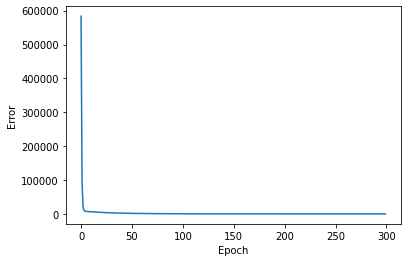

Weight Matrices 
[array([[ 9.87419364e-01,  1.43680571e-02, -2.84104431e-03,
        -6.62061766e-03,  1.85022521e-02, -8.39812660e-04,
        -9.48784512e-03,  4.52591907e-03, -4.38671582e-03,
        -2.09367035e-04],
       [-3.82035291e-03,  5.03852539e-01, -2.42608909e-03,
        -2.11672585e-03,  8.41990507e-03,  2.70647347e-03,
        -1.77313019e-03, -1.63732351e-03, -2.91749390e-03,
        -1.07577085e-04],
       [-4.07627151e-03,  4.38195177e-03,  3.24858362e-01,
        -4.33544719e-03,  1.37677380e-02,  6.01072886e-03,
        -4.45342452e-03, -5.33671479e-03,  3.15238737e-03,
        -6.40951175e-04],
       [-3.14119303e-03, -5.38839701e-03, -1.91904752e-03,
         2.45412161e-01,  8.97045455e-03,  7.72070540e-03,
         2.02961772e-03, -5.81408475e-03,  6.41805158e-03,
        -4.12352712e-03],
       [-1.09613960e-04, -4.01943727e-04,  3.84868688e-03,
         3.45789722e-03,  1.90602758e-01, -5.32179062e-03,
         2.41783407e-03,  4.38919450e-03, -4.0692211

In [69]:
n.train(300, 0.00001)

### Result

1. We tried two different functions, both seemed to converge quite well. 
2. Again, starting values were between 0 and 1

## Test 4: 1 to 1 with several layers: ReLU
### Dataset
First, same as first test. And then we try non-linear case
### Neural network
Several layers Relu
### Conclusion if test passes
Will learn how to change hyperparameter in these cases

In [70]:
X = np.array([[[random.randint(1, 10)]] for i in range(100)])

In [71]:
Y = np.array([[[0.5*X[i][0, 0]]] for i in range(100)])

In [72]:
X

array([[[ 3]],

       [[ 9]],

       [[ 4]],

       [[ 4]],

       [[ 8]],

       [[ 2]],

       [[ 5]],

       [[ 9]],

       [[ 1]],

       [[ 7]],

       [[ 4]],

       [[ 1]],

       [[ 6]],

       [[ 2]],

       [[ 8]],

       [[ 7]],

       [[ 4]],

       [[ 5]],

       [[ 3]],

       [[ 8]],

       [[ 9]],

       [[ 1]],

       [[ 5]],

       [[ 5]],

       [[ 2]],

       [[ 1]],

       [[ 9]],

       [[10]],

       [[ 4]],

       [[10]],

       [[ 9]],

       [[ 8]],

       [[10]],

       [[ 5]],

       [[ 9]],

       [[ 3]],

       [[ 2]],

       [[ 6]],

       [[ 4]],

       [[ 5]],

       [[ 1]],

       [[10]],

       [[ 4]],

       [[ 9]],

       [[ 2]],

       [[ 6]],

       [[ 2]],

       [[ 4]],

       [[ 5]],

       [[ 3]],

       [[ 3]],

       [[ 7]],

       [[ 5]],

       [[ 3]],

       [[10]],

       [[ 6]],

       [[ 1]],

       [[ 1]],

       [[ 3]],

       [[10]],

       [[ 7]],

       [[ 5]],

       [

In [73]:
Y

array([[[1.5]],

       [[4.5]],

       [[2. ]],

       [[2. ]],

       [[4. ]],

       [[1. ]],

       [[2.5]],

       [[4.5]],

       [[0.5]],

       [[3.5]],

       [[2. ]],

       [[0.5]],

       [[3. ]],

       [[1. ]],

       [[4. ]],

       [[3.5]],

       [[2. ]],

       [[2.5]],

       [[1.5]],

       [[4. ]],

       [[4.5]],

       [[0.5]],

       [[2.5]],

       [[2.5]],

       [[1. ]],

       [[0.5]],

       [[4.5]],

       [[5. ]],

       [[2. ]],

       [[5. ]],

       [[4.5]],

       [[4. ]],

       [[5. ]],

       [[2.5]],

       [[4.5]],

       [[1.5]],

       [[1. ]],

       [[3. ]],

       [[2. ]],

       [[2.5]],

       [[0.5]],

       [[5. ]],

       [[2. ]],

       [[4.5]],

       [[1. ]],

       [[3. ]],

       [[1. ]],

       [[2. ]],

       [[2.5]],

       [[1.5]],

       [[1.5]],

       [[3.5]],

       [[2.5]],

       [[1.5]],

       [[5. ]],

       [[3. ]],

       [[0.5]],

       [[0.5]],

       [[1.5]]

In [76]:
n = nn.neural_network(X, Y, [10])

EPOCH: 0   ERROR: 15419.567495965455
dW 
[array([[-0.09987206],
       [-0.10872716],
       [-0.01098077],
       [-0.0770911 ],
       [-0.08741004],
       [-0.09887393],
       [-0.12241539],
       [-0.10795663],
       [-0.12873458],
       [-0.14127921]]), array([[-0.02217285, -0.0916456 , -0.05850779, -0.08782477, -0.0100602 ,
        -0.11184088, -0.00050473, -0.06634802, -0.05299212, -0.06772739]])]
Weight
[array([[0.15311434],
       [0.63285769],
       [0.40402493],
       [0.60647297],
       [0.0694706 ],
       [0.77231597],
       [0.00348543],
       [0.45816553],
       [0.36593652],
       [0.46769075]]), array([[0.68966541, 0.75081421, 0.07582758, 0.53235176, 0.60360909,
        0.68277282, 0.84533818, 0.74549333, 0.88897528, 0.97560204]])]
dW 
[array([[-0.09987206],
       [-0.10872716],
       [-0.01098077],
       [-0.0770911 ],
       [-0.08741004],
       [-0.09887393],
       [-0.12241539],
       [-0.10795663],
       [-0.12873458],
       [-0.14127921]]), a

EPOCH: 16   ERROR: 6.159508773685334
dW 
[array([[-0.00019189],
       [-0.00148888],
       [ 0.00033032],
       [-0.0008327 ],
       [-0.00017179],
       [-0.00107579],
       [-0.00024452],
       [-0.00171888],
       [-0.0002303 ],
       [-0.00243585]]), array([[ 0.        , -0.00094774, -0.00117533, -0.00117274,  0.        ,
        -0.00148658,  0.        , -0.00040073,  0.        , -0.00010575]])]
Weight
[array([[-0.01950692],
       [ 0.32744966],
       [ 0.40608448],
       [ 0.4051908 ],
       [-0.03768073],
       [ 0.51362541],
       [-0.14702891],
       [ 0.13845521],
       [-0.00919396],
       [ 0.03653646]]), array([[ 0.6630027 ,  0.51441776, -0.11412784,  0.28770428,  0.59354889,
         0.37169419,  0.84483345,  0.59388689,  0.79571755,  0.8416061 ]])]
dW 
[array([[-0.00019189],
       [-0.00148888],
       [ 0.00033032],
       [-0.0008327 ],
       [-0.00017179],
       [-0.00107579],
       [-0.00024452],
       [-0.00171888],
       [-0.0002303 ],
     

         0.36265421,  0.84483345,  0.59152015,  0.79571755,  0.84107882]])]
dW 
[array([[-1.13378316e-05],
       [-8.69903891e-05],
       [ 2.07488330e-05],
       [-4.79798659e-05],
       [-1.01501205e-05],
       [-6.20165251e-05],
       [-1.44472704e-05],
       [-1.01154276e-04],
       [-1.36073526e-05],
       [-1.43830636e-04]]), array([[ 0.00000000e+00, -5.44469141e-05, -6.97987884e-05,
        -6.84294496e-05,  0.00000000e+00, -8.67209281e-05,
         0.00000000e+00, -2.18823075e-05,  0.00000000e+00,
        -3.70104446e-06]])]
Weight
[array([[-0.02069193],
       [ 0.31830239],
       [ 0.40818332],
       [ 0.40010711],
       [-0.0387416 ],
       [ 0.5070562 ],
       [-0.14853892],
       [ 0.12786008],
       [-0.01061618],
       [ 0.02149878]]), array([[ 0.6630027 ,  0.50869395, -0.12133301,  0.280572  ,  0.59354889,
         0.36265421,  0.84483345,  0.59152015,  0.79571755,  0.84107882]])]
EPOCH: 34   ERROR: 0.015443342220169378
dW 
[array([[-9.60849575e-06],
  

EPOCH: 49   ERROR: 0.00010814276681849779
dW 
[array([[-8.04050808e-07],
       [-6.16512131e-06],
       [ 1.47661452e-06],
       [-3.39755739e-06],
       [-7.19821293e-07],
       [-4.39165107e-06],
       [-1.02456447e-06],
       [-7.17199595e-06],
       [-9.64999592e-07],
       [-1.01998423e-05]]), array([[ 0.00000000e+00, -3.85481291e-06, -4.95149219e-06,
        -4.84930294e-06,  0.00000000e+00, -6.14545239e-06,
         0.00000000e+00, -1.54436418e-06,  0.00000000e+00,
        -2.51839787e-07]])]
Weight
[array([[-0.02074968],
       [ 0.31785944],
       [ 0.40828921],
       [ 0.39986291],
       [-0.0387933 ],
       [ 0.50674056],
       [-0.14861251],
       [ 0.12734489],
       [-0.01068549],
       [ 0.02076616]]), array([[ 0.6630027 ,  0.50836241, -0.1217584 ,  0.28015515,  0.59354889,
         0.36212594,  0.84483345,  0.59138709,  0.79571755,  0.84105668]])]
dW 
[array([[-8.04050808e-07],
       [-6.16512131e-06],
       [ 1.47661452e-06],
       [-3.39755739e-06]

EPOCH: 65   ERROR: 5.44950750743256e-07
dW 
[array([[-5.70772949e-08],
       [-4.37624311e-07],
       [ 1.04846680e-07],
       [-2.41157549e-07],
       [-5.10980796e-08],
       [-3.11718647e-07],
       [-7.27309367e-08],
       [-5.09111622e-07],
       [-6.85025942e-08],
       [-7.24056665e-07]]), array([[ 0.00000000e+00, -2.73609920e-07, -3.51500190e-07,
        -3.44220482e-07,  0.00000000e+00, -4.36225253e-07,
         0.00000000e+00, -1.09592408e-07,  0.00000000e+00,
        -1.78238626e-08]])]
Weight
[array([[-0.02075458],
       [ 0.31782185],
       [ 0.40829822],
       [ 0.3998422 ],
       [-0.03879769],
       [ 0.50671379],
       [-0.14861876],
       [ 0.12730117],
       [-0.01069137],
       [ 0.02070398]]), array([[ 0.6630027 ,  0.50833892, -0.12178859,  0.28012559,  0.59354889,
         0.36208847,  0.84483345,  0.59137768,  0.79571755,  0.84105515]])]
dW 
[array([[-5.70772949e-08],
       [-4.37624311e-07],
       [ 1.04846680e-07],
       [-2.41157549e-07],


EPOCH: 82   ERROR: 1.9732356907177832e-09
dW 
[array([[-3.43458474e-09],
       [-2.63336374e-08],
       [ 6.30918507e-09],
       [-1.45113702e-08],
       [-3.07478980e-09],
       [-1.87573037e-08],
       [-4.37653125e-09],
       [-3.06353868e-08],
       [-4.12209382e-09],
       [-4.35695779e-08]]), array([[ 0.00000000e+00, -1.64641383e-08, -2.11513020e-08,
        -2.07131403e-08,  0.00000000e+00, -2.62494379e-08,
         0.00000000e+00, -6.59448086e-09,  0.00000000e+00,
        -1.07230664e-09]])]
Weight
[array([[-0.02075494],
       [ 0.31781916],
       [ 0.40829886],
       [ 0.39984071],
       [-0.03879801],
       [ 0.50671186],
       [-0.14861921],
       [ 0.12729803],
       [-0.01069179],
       [ 0.02069951]]), array([[ 0.6630027 ,  0.50833723, -0.12179076,  0.28012346,  0.59354889,
         0.36208578,  0.84483345,  0.591377  ,  0.79571755,  0.84105504]])]
dW 
[array([[-3.43458474e-09],
       [-2.63336374e-08],
       [ 6.30918507e-09],
       [-1.45113702e-08]

EPOCH: 96   ERROR: 1.9266393037497274e-11
dW 
[array([[-3.39378997e-10],
       [-2.60208510e-09],
       [ 6.23425325e-10],
       [-1.43390031e-09],
       [-3.03826855e-10],
       [-1.85345032e-09],
       [-4.32454839e-10],
       [-3.02715087e-09],
       [-4.07313307e-10],
       [-4.30520738e-09]]), array([[ 0.00000000e+00, -1.62685752e-09, -2.09000763e-09,
        -2.04671127e-09,  0.00000000e+00, -2.59376509e-09,
         0.00000000e+00, -6.51614471e-10,  0.00000000e+00,
        -1.05955698e-10]])]
Weight
[array([[-0.02075496],
       [ 0.317819  ],
       [ 0.4082989 ],
       [ 0.39984063],
       [-0.03879803],
       [ 0.50671175],
       [-0.14861923],
       [ 0.12729785],
       [-0.01069182],
       [ 0.02069925]]), array([[ 0.6630027 ,  0.50833713, -0.12179088,  0.28012334,  0.59354889,
         0.36208563,  0.84483345,  0.59137697,  0.79571755,  0.84105503]])]
dW 
[array([[-3.39378997e-10],
       [-2.60208510e-09],
       [ 6.23425325e-10],
       [-1.43390031e-09]

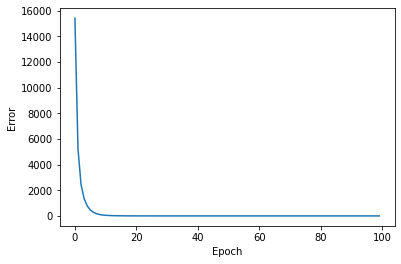

Weight Matrices 
[array([[-0.02075496],
       [ 0.31781899],
       [ 0.4082989 ],
       [ 0.39984062],
       [-0.03879803],
       [ 0.50671175],
       [-0.14861923],
       [ 0.12729784],
       [-0.01069182],
       [ 0.02069924]]), array([[ 0.6630027 ,  0.50833713, -0.12179089,  0.28012333,  0.59354889,
         0.36208562,  0.84483345,  0.59137696,  0.79571755,  0.84105503]])]


In [77]:
n.train(100, 0.00001)

## Test 5: The ultimate test
### Dataset
2-vector inputs and outputs, connected by non-linear functions. 
Also, for the first time, after training, we generate a dataset with the same distribution, and call the test function. 
### Neural network
3 layers of varying sizes 3, 4, 5
### Conclusion if test passes
This neural network slays and is the absolute best


In [78]:
X = np.array([[[random.random()],[random.random()]] for i in range(100)])

In [90]:
Y = np.array([[[X[i][0, 0]**1.5],[X[i][1,0]**2*2]] for i in range(100)])

In [91]:
X

array([[[0.89671759],
        [0.69806609]],

       [[0.19915283],
        [0.1604665 ]],

       [[0.28110542],
        [0.38497757]],

       [[0.42289485],
        [0.42533071]],

       [[0.47451948],
        [0.58229573]],

       [[0.11952546],
        [0.96019129]],

       [[0.73268144],
        [0.13245713]],

       [[0.12751745],
        [0.39947306]],

       [[0.82696115],
        [0.35397967]],

       [[0.58914795],
        [0.51543485]],

       [[0.1890388 ],
        [0.21889734]],

       [[0.86133141],
        [0.39079688]],

       [[0.33576485],
        [0.88778988]],

       [[0.37071259],
        [0.56881247]],

       [[0.71734881],
        [0.45686666]],

       [[0.96627854],
        [0.68045588]],

       [[0.50026911],
        [0.15724027]],

       [[0.66869949],
        [0.67578135]],

       [[0.84148196],
        [0.5518259 ]],

       [[0.20649868],
        [0.36769392]],

       [[0.02093754],
        [0.43239225]],

       [[0.49269225],
        [0.4

In [92]:
Y

array([[[8.49148272e-01],
        [9.74592526e-01]],

       [[8.88750193e-02],
        [5.14989929e-02]],

       [[1.49040336e-01],
        [2.96415452e-01]],

       [[2.75010069e-01],
        [3.61812429e-01]],

       [[3.26874523e-01],
        [6.78136625e-01]],

       [[4.13228829e-02],
        [1.84393464e+00]],

       [[6.27151961e-01],
        [3.50897820e-02]],

       [[4.55359532e-02],
        [3.19157450e-01]],

       [[7.52017006e-01],
        [2.50603214e-01]],

       [[4.52206246e-01],
        [5.31346166e-01]],

       [[8.21914094e-02],
        [9.58320894e-02]],

       [[7.99383953e-01],
        [3.05444409e-01]],

       [[1.94559684e-01],
        [1.57634176e+00]],

       [[2.25712703e-01],
        [6.47095251e-01]],

       [[6.07568950e-01],
        [4.17454293e-01]],

       [[9.49846669e-01],
        [9.26040406e-01]],

       [[3.53838864e-01],
        [4.94490035e-02]],

       [[5.46822637e-01],
        [9.13360854e-01]],

       [[7.71910977e-01],
  

In [94]:
n5 = nn.neural_network(X, Y, [3, 4, 5])

EPOCH: 0   ERROR: 786.4523051318456
dW 
[array([[-0.00091556, -0.00089169],
       [-0.00051266, -0.00049187],
       [-0.00117928, -0.00115545]]), array([[-0.00049377, -0.00015078, -0.00025876],
       [-0.00042555, -0.00012996, -0.00022388],
       [-0.00034981, -0.00010684, -0.00018737],
       [-0.00065757, -0.00020079, -0.00034284]]), array([[-1.64993687e-04, -4.90737433e-05, -2.17879287e-04,
        -1.97563408e-04],
       [-3.79751855e-04, -1.12720948e-04, -5.01672392e-04,
        -4.54548789e-04],
       [-8.87875626e-05, -2.72207777e-05, -1.16539494e-04,
        -1.06906345e-04],
       [-2.77696773e-04, -8.12884504e-05, -3.67843802e-04,
        -3.31562452e-04],
       [-1.72038866e-04, -5.38592881e-05, -2.24842126e-04,
        -2.07958915e-04]]), array([[-0.0007967 , -0.00048541, -0.00031433, -0.00055861, -0.00056689],
       [-0.0004654 , -0.00028432, -0.00018516, -0.00032791, -0.00032861]])]
Weight
[array([[0.55567145, 0.6057819 ],
       [0.17129522, 0.18334836],
       

EPOCH: 7   ERROR: 723.3371603845762
dW 
[array([[-0.00086122, -0.00083482],
       [-0.00048313, -0.00046089],
       [-0.00111481, -0.00108761]]), array([[-4.61436992e-04, -1.39671155e-04, -2.38508019e-04],
       [-3.98874230e-04, -1.20738557e-04, -2.07041276e-04],
       [-3.25432532e-04, -9.85246938e-05, -1.72277821e-04],
       [-6.16119727e-04, -1.86482840e-04, -3.16698019e-04]]), array([[-1.52675784e-04, -4.46263370e-05, -2.02007063e-04,
        -1.82339495e-04],
       [-3.55013214e-04, -1.03539068e-04, -4.69921023e-04,
        -4.23822348e-04],
       [-8.22427740e-05, -2.48588740e-05, -1.08105348e-04,
        -9.88191012e-05],
       [-2.59372912e-04, -7.44961430e-05, -3.44321724e-04,
        -3.08807423e-04],
       [-1.59175649e-04, -4.92392158e-05, -2.08253988e-04,
        -1.92078718e-04]]), array([[-0.00074619, -0.0004521 , -0.00029353, -0.00052122, -0.00053103],
       [-0.0004329 , -0.00026307, -0.00017184, -0.00030399, -0.00030552]])]
Weight
[array([[0.54942894, 0.599

EPOCH: 13   ERROR: 675.2828062753193
dW 
[array([[-0.00081905, -0.00079073],
       [-0.00046018, -0.00043683],
       [-0.00106456, -0.00103476]]), array([[-4.36452322e-04, -1.31140084e-04, -2.23015052e-04],
       [-3.78197715e-04, -1.13640495e-04, -1.94118899e-04],
       [-3.06644169e-04, -9.21559467e-05, -1.60766241e-04],
       [-5.84029479e-04, -1.75474054e-04, -2.96652963e-04]]), array([[-1.43242453e-04, -4.12606671e-05, -1.89826152e-04,
        -1.70700354e-04],
       [-3.35886449e-04, -9.65204782e-05, -4.45319385e-04,
        -4.00103747e-04],
       [-7.72169696e-05, -2.30676824e-05, -1.01614426e-04,
        -9.26200134e-05],
       [-2.45235193e-04, -6.93130398e-05, -3.26135346e-04,
        -2.91277504e-04],
       [-1.49289609e-04, -4.57347766e-05, -1.95476134e-04,
        -1.79897356e-04]]), array([[-0.00070708, -0.00042644, -0.00027746, -0.00049235, -0.00050327],
       [-0.00040779, -0.00024673, -0.00016158, -0.00028558, -0.00028768]])]
Weight
[array([[ 0.54436885,  0.

dW 
[array([[-0.00076231, -0.0007315 ],
       [-0.00042923, -0.00040442],
       [-0.00099659, -0.0009607 ]]), array([[-4.03002448e-04, -1.19799912e-04, -2.02506846e-04],
       [-3.50421588e-04, -1.04172925e-04, -1.76954756e-04],
       [-2.81558804e-04, -8.37157099e-05, -1.45578115e-04],
       [-5.40977892e-04, -1.60808198e-04, -2.70058240e-04]]), array([[-1.30737257e-04, -3.68582408e-05, -1.73641486e-04,
        -1.55300777e-04],
       [-3.10266519e-04, -8.72391599e-05, -4.12288011e-04,
        -3.68390999e-04],
       [-7.05345468e-05, -2.07193323e-05, -9.29632392e-05,
        -8.43944860e-05],
       [-2.26340351e-04, -6.24714830e-05, -3.01773637e-04,
        -2.67889955e-04],
       [-1.36133345e-04, -4.11394804e-05, -1.78429382e-04,
        -1.63721840e-04]]), array([[-0.00065459, -0.0003922 , -0.00025595, -0.00045377, -0.00046604],
       [-0.00037416, -0.00022499, -0.00014788, -0.00026102, -0.00026381]])]
Weight
[array([[ 0.53722972,  0.58794356],
       [ 0.16094163,  0.17

EPOCH: 30   ERROR: 563.1780267369533
dW 
[array([[-0.00071746, -0.00068478],
       [-0.00040472, -0.00037881],
       [-0.00094245, -0.00089874]]), array([[-3.76723174e-04, -1.10961526e-04, -1.86600681e-04],
       [-3.28518609e-04, -9.67664234e-05, -1.63592238e-04],
       [-2.61909872e-04, -7.71593838e-05, -1.33839889e-04],
       [-5.07077880e-04, -1.49350000e-04, -2.49379293e-04]]), array([[-1.21019712e-04, -3.34883206e-05, -1.61033147e-04,
        -1.43360310e-04],
       [-2.90129878e-04, -8.00490879e-05, -3.86259146e-04,
        -3.43517419e-04],
       [-6.53243497e-05, -1.89170846e-05, -8.62004912e-05,
        -7.79960775e-05],
       [-2.11525531e-04, -5.71819687e-05, -2.82624327e-04,
        -2.49589243e-04],
       [-1.25865910e-04, -3.76122410e-05, -1.65090222e-04,
        -1.51129237e-04]]), array([[-0.00061326, -0.00036541, -0.00023906, -0.00042351, -0.00043674],
       [-0.00034775, -0.00020803, -0.00013716, -0.00024182, -0.00024506]])]
Weight
[array([[ 0.53129137,  0.

EPOCH: 38   ERROR: 520.2294611482467
dW 
[array([[-0.00067711, -0.00064293],
       [-0.00038261, -0.00035582],
       [-0.00089354, -0.00084527]]), array([[-3.53224205e-04, -1.03114259e-04, -1.72544274e-04],
       [-3.08869184e-04, -9.01688834e-05, -1.51743639e-04],
       [-2.44386242e-04, -7.13556149e-05, -1.23494084e-04],
       [-4.76702919e-04, -1.39154574e-04, -2.31066353e-04]]), array([[-1.12414963e-04, -3.05450922e-05, -1.49843667e-04,
        -1.32808614e-04],
       [-2.72120288e-04, -7.37030582e-05, -3.62925920e-04,
        -3.21314175e-04],
       [-6.06956101e-05, -1.73380064e-05, -8.01794595e-05,
        -7.23232398e-05],
       [-1.98305569e-04, -5.25233735e-05, -2.65496656e-04,
        -2.33289946e-04],
       [-1.16735061e-04, -3.45195907e-05, -1.53202503e-04,
        -1.39953755e-04]]), array([[-0.00057626, -0.00034155, -0.00022397, -0.00039651, -0.0004105 ],
       [-0.00032412, -0.00019295, -0.00012759, -0.0002247 , -0.00022829]])]
Weight
[array([[ 0.52569562,  0.

EPOCH: 45   ERROR: 486.72727684217864
dW 
[array([[-0.00064497, -0.00060968],
       [-0.00036498, -0.00033752],
       [-0.00085444, -0.00080345]]), array([[-3.34609341e-04, -9.69392068e-05, -1.61533657e-04],
       [-2.93257335e-04, -8.49617121e-05, -1.42434562e-04],
       [-2.30538198e-04, -6.68010035e-05, -1.15412610e-04],
       [-4.52596011e-04, -1.31115673e-04, -2.16692219e-04]]), array([[-1.05659946e-04, -2.82641423e-05, -1.41041783e-04,
        -1.24541049e-04],
       [-2.57852322e-04, -6.87375289e-05, -3.44401702e-04,
        -3.03756071e-04],
       [-5.70519161e-05, -1.61116485e-05, -7.54299371e-05,
        -6.78666748e-05],
       [-1.87852033e-04, -4.88838003e-05, -2.51925364e-04,
        -2.20424264e-04],
       [-1.09542339e-04, -3.21176254e-05, -1.43818292e-04,
        -1.31169175e-04]]), array([[-0.0005469 , -0.00032271, -0.00021202, -0.00037516, -0.0003897 ],
       [-0.00030541, -0.00018107, -0.00012003, -0.0002112 , -0.00021502]])]
Weight
[array([[ 0.52105388,  0

EPOCH: 53   ERROR: 452.4036094221588
dW 
[array([[-0.00061139, -0.000575  ],
       [-0.00034652, -0.0003184 ],
       [-0.00081334, -0.00075872]]), array([[-3.15250674e-04, -9.05596038e-05, -1.50204810e-04],
       [-2.76974586e-04, -7.95664832e-05, -1.32828726e-04],
       [-2.16170273e-04, -6.21078618e-05, -1.07121017e-04],
       [-4.27479687e-04, -1.22794244e-04, -2.01872606e-04]]), array([[-9.86956154e-05, -2.59417406e-05, -1.31950139e-04,
        -1.16033167e-04],
       [-2.43010900e-04, -6.36344221e-05, -3.25095632e-04,
        -2.85524894e-04],
       [-5.32854741e-05, -1.48607340e-05, -7.05107900e-05,
        -6.32692047e-05],
       [-1.76997758e-04, -4.51484062e-05, -2.37807275e-04,
        -2.07088156e-04],
       [-1.02102886e-04, -2.96679775e-05, -1.34092552e-04,
        -1.22102663e-04]]), array([[-0.00051632, -0.00030319, -0.00019961, -0.000353  , -0.00036804],
       [-0.00028596, -0.00016879, -0.00011219, -0.00019722, -0.00020123]])]
Weight
[array([[ 0.51601372,  0.

EPOCH: 62   ERROR: 418.13178602380657
dW 
[array([[-0.00057713, -0.00053968],
       [-0.00032766, -0.00029888],
       [-0.0007714 , -0.00071599]]), array([[-2.95597630e-04, -8.41301407e-05, -1.38841204e-04],
       [-2.60392041e-04, -7.41119873e-05, -1.23163115e-04],
       [-2.01620767e-04, -5.73916371e-05, -9.88293159e-05],
       [-4.01929821e-04, -1.14389749e-04, -1.86974548e-04]]), array([[-9.16924647e-05, -2.36388556e-05, -1.22789178e-04,
        -1.07495800e-04],
       [-2.27941642e-04, -5.85226294e-05, -3.05451843e-04,
        -2.67051228e-04],
       [-4.94871152e-05, -1.36178641e-05, -6.55394391e-05,
        -5.86432173e-05],
       [-1.65998027e-04, -4.14120087e-05, -2.23470571e-04,
        -1.93599432e-04],
       [-9.45957234e-05, -2.72346433e-05, -1.24256901e-04,
        -1.12975566e-04]]), array([[-0.00048522, -0.00028345, -0.00018702, -0.00033054, -0.00034602],
       [-0.00026624, -0.00015641, -0.00010427, -0.00018309, -0.00018725]])]
Weight
[array([[ 0.5106508 ,  0

EPOCH: 70   ERROR: 390.9535620344021
dW 
[array([[-0.00054938, -0.0005111 ],
       [-0.00031235, -0.00028306],
       [-0.00073728, -0.00068126]]), array([[-2.79755832e-04, -7.89852838e-05, -1.29786984e-04],
       [-2.46983874e-04, -6.97339014e-05, -1.15438303e-04],
       [-1.89921669e-04, -5.36282855e-05, -9.22434798e-05],
       [-3.81293533e-04, -1.07650243e-04, -1.75077680e-04]]), array([[-8.60993346e-05, -2.18247472e-05, -1.15458739e-04,
        -1.00691403e-04],
       [-2.15791605e-04, -5.44555693e-05, -2.89582266e-04,
        -2.52185907e-04],
       [-4.64451411e-05, -1.26372040e-05, -6.15499650e-05,
        -5.49468045e-05],
       [-1.57145243e-04, -3.84428487e-05, -2.11910246e-04,
        -1.82763860e-04],
       [-8.85804261e-05, -2.53156533e-05, -1.16359131e-04,
        -1.05680082e-04]]), array([[-4.60120279e-04, -2.67586000e-04, -1.76882718e-04,
        -3.12466358e-04, -3.28245299e-04],
       [-2.50356494e-04, -1.46491385e-04, -9.79006958e-05,
        -1.71754963e-

       [0.20383545, 0.46451011, 0.2860715 , 0.09093238, 0.79271358]])]
dW 
[array([[-0.00052696, -0.00048805],
       [-0.00029995, -0.00027017],
       [-0.00070959, -0.0006529 ]]), array([[-2.67001132e-04, -7.48691662e-05, -1.22569684e-04],
       [-2.34030884e-04, -6.56263356e-05, -1.09264776e-04],
       [-1.80522129e-04, -5.06246529e-05, -8.70080078e-05],
       [-3.64650166e-04, -1.02248565e-04, -1.65576266e-04]]), array([[-8.16314428e-05, -2.03943531e-05, -1.09593732e-04,
        -9.52656496e-05],
       [-2.06007270e-04, -5.12220779e-05, -2.76781631e-04,
        -2.40235656e-04],
       [-4.40095013e-05, -1.18624962e-05, -5.83502465e-05,
        -5.19930052e-05],
       [-1.50026876e-04, -3.60851778e-05, -2.02600113e-04,
        -1.74065365e-04],
       [-8.37622637e-05, -2.37998066e-05, -1.10021874e-04,
        -9.98489525e-05]]), array([[-4.39883108e-04, -2.54855025e-04, -1.68727838e-04,
        -2.97942243e-04, -3.13921612e-04],
       [-2.37580797e-04, -1.38552587e-04, -9.2

[array([[ 0.49772048,  0.55074087],
       [ 0.1385606 ,  0.15290502],
       [ 0.51350129, -0.0593151 ]]), array([[ 0.67041764,  0.04029238,  0.59660123],
       [-0.00937384,  0.02279654,  0.52691043],
       [ 0.78808136,  0.97930289,  0.48019321],
       [ 0.5875317 ,  0.29374393,  0.97182861]]), array([[0.86175844, 0.30096161, 0.33887488, 0.9601352 ],
       [0.08273441, 0.05485782, 0.18079344, 0.95410109],
       [0.19148143, 0.77695526, 0.3135805 , 0.13782277],
       [0.78182754, 0.80521422, 0.246866  , 0.33290174],
       [0.50285154, 0.42734172, 0.70286065, 0.19909769]]), array([[0.35320418, 0.9246022 , 0.09721305, 0.80408799, 0.05298775],
       [0.20198267, 0.46343132, 0.28534825, 0.08966502, 0.79141209]])]
dW 
[array([[-0.00050321, -0.00046365],
       [-0.0002868 , -0.00025661],
       [-0.00068017, -0.00062298]]), array([[-2.53546718e-04, -7.05541829e-05, -1.15031698e-04],
       [-2.22697291e-04, -6.19711185e-05, -1.02800927e-04],
       [-1.70626996e-04, -4.74832146e-0

EPOCH: 94   ERROR: 324.16915904739125
dW 
[array([[-0.00047863, -0.00043847],
       [-0.00027316, -0.00024253],
       [-0.00064903, -0.00058754]]), array([[-2.39689241e-04, -6.61402477e-05, -1.07352680e-04],
       [-2.09620453e-04, -5.78435577e-05, -9.61921620e-05],
       [-1.60457970e-04, -4.42779637e-05, -7.60140746e-05],
       [-3.28918978e-04, -9.07620413e-05, -1.45485709e-04]]), array([[-7.21774602e-05, -1.74281540e-05, -9.71541015e-05,
        -8.38166590e-05],
       [-1.85052353e-04, -4.44340309e-05, -2.49299642e-04,
        -2.14710916e-04],
       [-3.88376303e-05, -1.02504200e-05, -5.15387797e-05,
        -4.57400231e-05],
       [-1.34815256e-04, -3.11460843e-05, -1.82657830e-04,
        -1.55524309e-04],
       [-7.35259916e-05, -2.06447746e-05, -9.65228165e-05,
        -8.75014410e-05]]), array([[-3.96476733e-04, -2.27722976e-04, -1.51302400e-04,
        -2.66933498e-04, -2.83211744e-04],
       [-2.10270498e-04, -1.21703623e-04, -8.19127309e-05,
        -1.43328135e

EPOCH: 102   ERROR: 305.8905882552175
dW 
[array([[-0.00045849, -0.00041791],
       [-0.00026198, -0.00023107],
       [-0.00062391, -0.00056239]]), array([[-2.28399623e-04, -6.25675467e-05, -1.01165267e-04],
       [-2.00155852e-04, -5.48299434e-05, -9.08636777e-05],
       [-1.52190838e-04, -4.16900463e-05, -7.15582721e-05],
       [-3.14110463e-04, -8.60475011e-05, -1.37294465e-04]]), array([[-6.83171635e-05, -1.62423985e-05, -9.20621925e-05,
        -7.91555258e-05],
       [-1.76392017e-04, -4.16867599e-05, -2.37912781e-04,
        -2.04192121e-04],
       [-3.67172648e-05, -9.60257484e-06, -4.87396336e-05,
        -4.31841576e-05],
       [-1.28543703e-04, -2.91528614e-05, -1.74414600e-04,
        -1.47901555e-04],
       [-6.93258738e-05, -1.93751130e-05, -9.09712331e-05,
        -8.24508455e-05]]), array([[-3.78519863e-04, -2.16570301e-04, -1.44121690e-04,
        -2.54165164e-04, -2.70510495e-04],
       [-1.98991684e-04, -1.14795580e-04, -7.74333126e-05,
        -1.35378165e

EPOCH: 110   ERROR: 289.22097235181263
dW 
[array([[-0.00043978, -0.00039886],
       [-0.00025157, -0.00022044],
       [-0.0006001 , -0.00053621]]), array([[-2.17961313e-04, -5.92842757e-05, -9.55051479e-05],
       [-1.91371690e-04, -5.20504995e-05, -8.59720642e-05],
       [-1.44561849e-04, -3.93171961e-05, -6.74894858e-05],
       [-3.00396791e-04, -8.17075251e-05, -1.29789323e-04]]), array([[-6.47749703e-05, -1.51661247e-05, -8.73827383e-05,
        -7.48865449e-05],
       [-1.68387562e-04, -3.91736969e-05, -2.27371479e-04,
        -1.94487913e-04],
       [-3.47666645e-05, -9.01388504e-06, -4.61609202e-05,
        -4.08374015e-05],
       [-1.22755673e-04, -2.73309601e-05, -1.66794452e-04,
        -1.40879344e-04],
       [-6.54599806e-05, -1.82221715e-05, -8.58544552e-05,
        -7.78112058e-05]]), array([[-3.61912892e-04, -2.06296884e-04, -1.37490611e-04,
        -2.42384474e-04, -2.58762960e-04],
       [-1.88570990e-04, -1.08440732e-04, -7.33044886e-05,
        -1.28054972

EPOCH: 118   ERROR: 273.9540097684597
dW 
[array([[-0.00042234, -0.00038112],
       [-0.00024185, -0.00021052],
       [-0.0005782 , -0.00051446]]), array([[-2.08267239e-04, -5.62540935e-05, -9.03022066e-05],
       [-1.83193884e-04, -4.94791501e-05, -8.14650914e-05],
       [-1.37490325e-04, -3.71321502e-05, -6.37587556e-05],
       [-2.87640340e-04, -7.76952871e-05, -1.22878052e-04]]), array([[-6.15096324e-05, -1.41856793e-05, -8.30629625e-05,
        -7.09584741e-05],
       [-1.60954504e-04, -3.68668586e-05, -2.17568410e-04,
        -1.85492716e-04],
       [-3.29646782e-05, -8.47709047e-06, -4.37750765e-05,
        -3.86738920e-05],
       [-1.17387578e-04, -2.56596941e-05, -1.59717273e-04,
        -1.34377671e-04],
       [-6.18878917e-05, -1.71717041e-05, -8.11190608e-05,
        -7.35337093e-05]]), array([[-3.46477950e-04, -1.96785918e-04, -1.31339116e-04,
        -2.31463291e-04, -2.47845514e-04],
       [-1.78908363e-04, -1.02573940e-04, -6.94846441e-05,
        -1.21284302e

EPOCH: 126   ERROR: 259.94316499323554
dW 
[array([[-0.00040605, -0.00036461],
       [-0.00023275, -0.00020121],
       [-0.00055748, -0.00049303]]), array([[-1.99249421e-04, -5.34524469e-05, -8.55090016e-05],
       [-1.74272358e-04, -4.67476543e-05, -7.72807596e-05],
       [-1.30924346e-04, -3.51163243e-05, -6.03303595e-05],
       [-2.75755249e-04, -7.39795340e-05, -1.16499923e-04]]), array([[-5.84934624e-05, -1.32924674e-05, -7.90676108e-05,
        -6.73365775e-05],
       [-1.54040033e-04, -3.47506129e-05, -2.08437015e-04,
        -1.77139581e-04],
       [-3.12968746e-05, -7.98626120e-06, -4.15637878e-05,
        -3.66754565e-05],
       [-1.12399807e-04, -2.41293583e-05, -1.53133019e-04,
        -1.28346453e-04],
       [-5.85813591e-05, -1.62100890e-05, -7.67292289e-05,
        -6.95827465e-05]]), array([[-3.32109737e-04, -1.87964485e-04, -1.25628487e-04,
        -2.21326723e-04, -2.37685348e-04],
       [-1.69933148e-04, -9.71479304e-05, -6.59419174e-05,
        -1.15010829

EPOCH: 134   ERROR: 247.05600046748847
dW 
[array([[-0.00039081, -0.00034915],
       [-0.00022423, -0.00019254],
       [-0.00053823, -0.00047403]]), array([[-1.90843071e-04, -5.08564376e-05, -8.10836931e-05],
       [-1.67245741e-04, -4.45629175e-05, -7.34412575e-05],
       [-1.24814673e-04, -3.32524588e-05, -5.71728337e-05],
       [-2.64659169e-04, -7.05309737e-05, -1.10601282e-04]]), array([[-5.57011490e-05, -1.24768846e-05, -7.53641266e-05,
        -6.39893977e-05],
       [-1.47594788e-04, -3.28053219e-05, -1.99914236e-04,
        -1.69366707e-04],
       [-2.97498856e-05, -7.53636498e-06, -3.95098890e-05,
        -3.48254478e-05],
       [-1.07755632e-04, -2.27253311e-05, -1.46994703e-04,
        -1.22739775e-04],
       [-5.55140781e-05, -1.53275390e-05, -7.26511905e-05,
        -6.59255456e-05]]), array([[-3.18707810e-04, -1.79765251e-04, -1.20316566e-04,
        -2.11899137e-04, -2.28210928e-04],
       [-1.61579741e-04, -9.21190002e-05, -6.26492605e-05,
        -1.09185763

EPOCH: 141   ERROR: 236.60413201191923
dW 
[array([[-0.00037825, -0.00033641],
       [-0.00021721, -0.00018539],
       [-0.00052231, -0.00045833]]), array([[-1.83938696e-04, -4.87363026e-05, -7.74829866e-05],
       [-1.61462238e-04, -4.27748939e-05, -7.03102711e-05],
       [-1.19804938e-04, -3.17332439e-05, -5.46095352e-05],
       [-2.55532720e-04, -6.77103720e-05, -1.05794177e-04]]), array([[-5.34226407e-05, -1.18183641e-05, -7.23385164e-05,
        -6.12627420e-05],
       [-1.42302107e-04, -3.12242739e-05, -1.92906922e-04,
        -1.62994447e-04],
       [-2.84852558e-05, -7.17280581e-06, -3.78286907e-05,
        -3.33159973e-05],
       [-1.03945840e-04, -2.15848006e-05, -1.41953299e-04,
        -1.18147570e-04],
       [-5.30064351e-05, -1.46149050e-05, -6.93126256e-05,
        -6.29418533e-05]]), array([[-3.07694634e-04, -1.73050250e-04, -1.15958489e-04,
        -2.04168918e-04, -2.20425475e-04],
       [-1.54730460e-04, -8.80113708e-05, -5.99545473e-05,
        -1.04421401

EPOCH: 149   ERROR: 225.52925316264316
dW 
[array([[-0.00036473, -0.00032275],
       [-0.00020963, -0.00017771],
       [-0.0005042 , -0.00043653]]), array([[-1.76536828e-04, -4.64753106e-05, -7.36582356e-05],
       [-1.55238834e-04, -4.08614220e-05, -6.69737231e-05],
       [-1.14442694e-04, -3.01161929e-05, -5.18894104e-05],
       [-2.45735823e-04, -6.46981478e-05, -1.00681837e-04]]), array([[-5.09951530e-05, -1.11231822e-05, -6.91112451e-05,
        -5.83626373e-05],
       [-1.36630706e-04, -2.95446897e-05, -1.85388808e-04,
        -1.56177456e-04],
       [-2.71347901e-05, -6.78871509e-06, -3.60316377e-05,
        -3.17066415e-05],
       [-9.98684979e-05, -2.03737673e-05, -1.36550588e-04,
        -1.13241096e-04],
       [-5.03271970e-05, -1.38626150e-05, -6.57426568e-05,
        -5.97589274e-05]]), array([[-2.95891140e-04, -1.65876322e-04, -1.11292543e-04,
        -1.95898697e-04, -2.12079426e-04],
       [-1.47390497e-04, -8.36247235e-05, -5.70729151e-05,
        -9.93285249

Weight
[array([[ 0.46756324,  0.52354817],
       [ 0.12129116,  0.13789178],
       [ 0.4722115 , -0.09601862]]), array([[ 0.65529928,  0.03620794,  0.59004223],
       [-0.02263349,  0.01921452,  0.52099504],
       [ 0.77810347,  0.97660702,  0.47556043],
       [ 0.56665087,  0.28810305,  0.96290527]]), array([[0.85729122, 0.29992995, 0.3328431 , 0.95498117],
       [0.0710498 , 0.05217966, 0.16500009, 0.94063497],
       [0.18908861, 0.77633889, 0.31040374, 0.13501488],
       [0.77330364, 0.80335003, 0.23526884, 0.32314449],
       [0.49836088, 0.42609307, 0.69697662, 0.19376003]]), array([[0.32804901, 0.91031307, 0.08767675, 0.78728141, 0.03499205],
       [0.18900393, 0.45598685, 0.28030642, 0.08086407, 0.78232055]])]
dW 
[array([[-0.00035049, -0.00030844],
       [-0.00020163, -0.00016962],
       [-0.00048594, -0.00041842]]), array([[-1.68781658e-04, -4.41200618e-05, -6.96927257e-05],
       [-1.47992108e-04, -3.86768086e-05, -6.34834982e-05],
       [-1.08834318e-04, -2.8435

EPOCH: 166   ERROR: 204.6794639664794
dW 
[array([[-0.00033859, -0.00029648],
       [-0.00019495, -0.00016288],
       [-0.00047077, -0.00040375]]), array([[-1.62328570e-04, -4.21722785e-05, -6.64260564e-05],
       [-1.42564117e-04, -3.70278855e-05, -6.06231508e-05],
       [-1.04175744e-04, -2.70481671e-05, -4.67566884e-05],
       [-2.26890406e-04, -5.89524567e-05, -9.09952073e-05]]), array([[-4.63817752e-05, -9.82554346e-06, -6.29664638e-05,
        -5.28659751e-05],
       [-1.25752354e-04, -2.63792981e-05, -1.70940094e-04,
        -1.43136753e-04],
       [-2.45596800e-05, -6.07017973e-06, -3.25992918e-05,
        -2.86461802e-05],
       [-9.20615622e-05, -1.80941108e-05, -1.26184821e-04,
        -1.03871629e-04],
       [-4.52156225e-05, -1.24560125e-05, -5.89213794e-05,
        -5.37030866e-05]]), array([[-2.73242204e-04, -1.52178993e-04, -1.02362868e-04,
        -1.80082104e-04, -1.96062240e-04],
       [-1.33323882e-04, -7.52648525e-05, -5.15686680e-05,
        -8.96068444e

Weight
[array([[ 0.46180502,  0.51850579],
       [ 0.11797586,  0.13512177],
       [ 0.46420607, -0.1028839 ]]), array([[ 0.65253849,  0.03549061,  0.58891229],
       [-0.02505689,  0.01858502,  0.51996389],
       [ 0.77633159,  0.97614691,  0.47476505],
       [ 0.56279217,  0.28710034,  0.96135744]]), array([[0.85654673, 0.29977206, 0.33183247, 0.95413247],
       [0.06903219, 0.05175595, 0.16225765, 0.93833808],
       [0.18869433, 0.77624139, 0.30988039, 0.13455496],
       [0.77182665, 0.80305934, 0.23324457, 0.32147773],
       [0.49763479, 0.42589304, 0.69603037, 0.19289765]]), array([[0.32366553, 0.90787117, 0.08603436, 0.78439198, 0.03184685],
       [0.18686352, 0.45477831, 0.27947848, 0.07942536, 0.78082719]])]
dW 
[array([[-0.00032737, -0.00028522],
       [-0.00018863, -0.00015649],
       [-0.00045627, -0.00038939]]), array([[-1.56253439e-04, -4.03490450e-05, -6.33795233e-05],
       [-1.36863209e-04, -3.53305549e-05, -5.79291310e-05],
       [-9.97970597e-05, -2.5752

        -8.11366246e-05, -8.42779590e-05]])]
Weight
[array([[ 0.45891878,  0.51599909],
       [ 0.11631207,  0.13374752],
       [ 0.46017692, -0.10631322]]), array([[ 0.65131445,  0.03517558,  0.58841818],
       [-0.0261294 ,  0.01830908,  0.51951182],
       [ 0.77555191,  0.9759464 ,  0.47441736],
       [ 0.56107623,  0.28665864,  0.96067958]]), array([[0.85615518, 0.29969075, 0.33130032, 0.95368742],
       [0.06796215, 0.05153611, 0.16080135, 0.93712361],
       [0.18848779, 0.77619072, 0.30960636, 0.13431431],
       [0.77104232, 0.80290913, 0.23216774, 0.3205958 ],
       [0.49725662, 0.42578867, 0.69553856, 0.19244828]]), array([[0.321335  , 0.9065789 , 0.08516364, 0.7828607 , 0.03017326],
       [0.18574318, 0.45414789, 0.2790454 , 0.07867364, 0.7800465 ]])]
dW 
[array([[-0.00031547, -0.00027329],
       [-0.00018191, -0.00014971],
       [-0.00044086, -0.00037419]]), array([[-1.49836115e-04, -3.84345365e-05, -6.01926125e-05],
       [-1.30885264e-04, -3.35601415e-05, -5.51

EPOCH: 191   ERROR: 179.328862005143
dW 
[array([[-0.00030548, -0.00026329],
       [-0.00017628, -0.00014404],
       [-0.0004278 , -0.00036099]]), array([[-1.44472862e-04, -3.68438568e-05, -5.75549964e-05],
       [-1.26078884e-04, -3.21382774e-05, -5.27801461e-05],
       [-9.13266204e-05, -2.32679927e-05, -4.04965877e-05],
       [-2.03122958e-04, -5.18110391e-05, -7.90664981e-05]]), array([[-4.06769911e-05, -8.27100113e-06, -5.53468145e-05,
        -4.60990237e-05],
       [-1.12090611e-04, -2.25279417e-05, -1.52742285e-04,
        -1.26831066e-04],
       [-2.13615148e-05, -5.20534265e-06, -2.83235392e-05,
        -2.48642639e-05],
       [-8.22796147e-05, -1.53268978e-05, -1.13161009e-04,
        -9.21799217e-05],
       [-3.88677719e-05, -1.07633777e-05, -5.04231119e-05,
        -4.62236988e-05]]), array([[-2.44759653e-04, -1.35092774e-04, -9.11930117e-05,
        -1.60310920e-04, -1.75923531e-04],
       [-1.15735520e-04, -6.49113116e-05, -4.47162035e-05,
        -7.75232659e-

EPOCH: 199   ERROR: 172.3313311867285
dW 
[array([[-0.00029604, -0.00025389],
       [-0.00017093, -0.00013864],
       [-0.00041487, -0.00034655]]), array([[-1.39412908e-04, -3.53509596e-05, -5.50907391e-05],
       [-1.20639313e-04, -3.05726854e-05, -5.05601080e-05],
       [-8.76970827e-05, -2.22130283e-05, -3.87643655e-05],
       [-1.96369660e-04, -4.98044779e-05, -7.57433250e-05]]), array([[-3.90805658e-05, -7.84754029e-06, -5.32098015e-05,
        -4.42121466e-05],
       [-1.08223133e-04, -2.14667908e-05, -1.47578886e-04,
        -1.22231455e-04],
       [-2.04635194e-05, -4.96838949e-06, -2.71202478e-05,
        -2.38065221e-05],
       [-7.95152314e-05, -1.45665080e-05, -1.09472146e-04,
        -8.88869905e-05],
       [-3.70854541e-05, -1.02989913e-05, -4.80314925e-05,
        -4.41324976e-05]]), array([[-2.36691230e-04, -1.30281647e-04, -8.80434344e-05,
        -1.54736959e-04, -1.70219132e-04],
       [-1.10771973e-04, -6.20106239e-05, -4.27881840e-05,
        -7.41279684e

        -7.09322739e-05, -7.36913480e-05]])]
Weight
[array([[ 0.45171157,  0.50980386],
       [ 0.11215191,  0.13036161],
       [ 0.45007954, -0.11478954]]), array([[ 0.64789845,  0.03430643,  0.58706172],
       [-0.02910013,  0.01755359,  0.51826751],
       [ 0.77339688,  0.97539863,  0.47346291],
       [ 0.55626987,  0.28543549,  0.95881554]]), array([[0.85519508, 0.29949649, 0.32999363, 0.9526001 ],
       [0.06531121, 0.0510061 , 0.15718795, 0.93412629],
       [0.18798421, 0.77606817, 0.30893878, 0.13372826],
       [0.76909564, 0.80254892, 0.22948931, 0.31841684],
       [0.49634184, 0.42553502, 0.69435263, 0.19136006]]), array([[0.31554263, 0.90338541, 0.08300691, 0.77906971, 0.02600897],
       [0.18301584, 0.45261936, 0.27799174, 0.07684746, 0.77814933]])]
dW 
[array([[-0.00028709, -0.00024498],
       [-0.00016585, -0.00013355],
       [-0.00040311, -0.00033495]]), array([[-1.34633356e-04, -3.39480700e-05, -5.27832088e-05],
       [-1.15914220e-04, -2.92076969e-05, -4.85

EPOCH: 215   ERROR: 159.6857530258634
dW 
[array([[-0.00027857, -0.00023651],
       [-0.00016102, -0.00012871],
       [-0.00039195, -0.00032408]]), array([[-1.30103184e-04, -3.26254874e-05, -5.06155693e-05],
       [-1.11655425e-04, -2.79770893e-05, -4.65755516e-05],
       [-8.10337884e-05, -2.02922355e-05, -3.56273662e-05],
       [-1.83921979e-04, -4.61342380e-05, -6.96964071e-05]]), array([[-3.61674157e-05, -7.09249107e-06, -4.93047913e-05,
        -4.07772105e-05],
       [-1.01111379e-04, -1.95619316e-05, -1.38070627e-04,
        -1.13793328e-04],
       [-1.88215186e-05, -4.54240438e-06, -2.49168246e-05,
        -2.18775542e-05],
       [-7.44371030e-05, -1.32065507e-05, -1.02686362e-04,
        -8.28514182e-05],
       [-3.38271353e-05, -9.46079417e-06, -4.36527410e-05,
        -4.03204803e-05]]), array([[-2.21850537e-04, -1.21465628e-04, -8.22774257e-05,
        -1.44525418e-04, -1.59730543e-04],
       [-1.01667310e-04, -5.67160790e-05, -3.92563049e-05,
        -6.79157689e

EPOCH: 223   ERROR: 153.95233118955588
dW 
[array([[-0.00027046, -0.00022843],
       [-0.00015643, -0.00012412],
       [-0.00038144, -0.00031416]]), array([[-1.25804820e-04, -3.13772012e-05, -4.85768320e-05],
       [-1.08166507e-04, -2.69549185e-05, -4.47888902e-05],
       [-7.79639616e-05, -1.94148320e-05, -3.42026648e-05],
       [-1.78164257e-04, -4.44499976e-05, -6.69359292e-05]]), array([[-3.48336156e-05, -6.75306297e-06, -4.75144123e-05,
        -3.92083716e-05],
       [-9.78296782e-05, -1.86991381e-05, -1.33676912e-04,
        -1.09909040e-04],
       [-1.80681626e-05, -4.34998127e-06, -2.39043537e-05,
        -2.09950242e-05],
       [-7.20961817e-05, -1.25918899e-05, -9.95540739e-05,
        -8.00754406e-05],
       [-3.23326009e-05, -9.08161993e-06, -4.16410275e-05,
        -3.85773737e-05]]), array([[-2.14998639e-04, -1.17411719e-04, -7.96238272e-05,
        -1.39826185e-04, -1.54888469e-04],
       [-9.74772687e-05, -5.42917044e-05, -3.76333787e-05,
        -6.50644890

Weight
[array([[ 0.4453958 ,  0.50445512],
       [ 0.10850013,  0.12745278],
       [ 0.44118481, -0.12212513]]), array([[ 0.64494197,  0.03356643,  0.58591449],
       [-0.0316425 ,  0.01691776,  0.51721095],
       [ 0.77155871,  0.9749392 ,  0.47265529],
       [ 0.55208777,  0.28438843,  0.95723546]]), array([[0.85437433, 0.29933617, 0.32887452, 0.95167527],
       [0.06301304, 0.05056333, 0.15404902, 0.93154143],
       [0.18755758, 0.77596529, 0.30837413, 0.13323242],
       [0.76740312, 0.80225026, 0.22715367, 0.3165344 ],
       [0.49557626, 0.42532056, 0.69336538, 0.19044718]]), array([[0.31049727, 0.90062549, 0.08113665, 0.7757848 , 0.02237559],
       [0.18071243, 0.45133506, 0.27710237, 0.07530915, 0.77655156]])]
dW 
[array([[-0.00026368, -0.00022169],
       [-0.00015258, -0.00012029],
       [-0.00037216, -0.00030411]]), array([[-1.22225099e-04, -3.03425370e-05, -4.68936060e-05],
       [-1.05252617e-04, -2.61053968e-05, -4.33093464e-05],
       [-7.54106778e-05, -1.8688

        -6.01283336e-05, -6.24012923e-05]])]
Weight
[array([[ 0.44331987,  0.50271465],
       [ 0.10729858,  0.12650951],
       [ 0.43825228, -0.1245139 ]]), array([[ 0.64385961,  0.03329844,  0.5855007 ],
       [-0.03257115,  0.01668805,  0.51682865],
       [ 0.7708926 ,  0.97477456,  0.4723638 ],
       [ 0.5505512 ,  0.28400784,  0.95666476]]), array([[0.8540762 , 0.29927926, 0.32846755, 0.95134044],
       [0.06217062, 0.05040493, 0.15289694, 0.9305972 ],
       [0.18740367, 0.77592833, 0.3081707 , 0.13305364],
       [0.76678137, 0.80214397, 0.22629402, 0.31584582],
       [0.49530253, 0.42524316, 0.69301387, 0.19012008]]), array([[0.30884484, 0.89972604, 0.08052579, 0.77471244, 0.02118423],
       [0.17997388, 0.45092452, 0.27681726, 0.07481665, 0.77604032]])]
EPOCH: 239   ERROR: 143.52647934881128
dW 
[array([[-0.00025538, -0.00021348],
       [-0.00014786, -0.00011559],
       [-0.00036122, -0.0002936 ]]), array([[-1.17853300e-04, -2.90852576e-05, -4.48557484e-05],
       [

EPOCH: 247   ERROR: 138.78364199757627
dW 
[array([[-0.00024838, -0.00020659],
       [-0.00014386, -0.00011161],
       [-0.00035131, -0.00028263]]), array([[-1.14175283e-04, -2.80328816e-05, -4.31564816e-05],
       [-9.71565968e-05, -2.38252813e-05, -3.99346726e-05],
       [-6.96806558e-05, -1.70720319e-05, -3.04235869e-05],
       [-1.62551827e-04, -3.99270712e-05, -5.95809112e-05]]), array([[-3.12624828e-05, -5.86247519e-06, -4.27122454e-05,
        -3.50212539e-05],
       [-8.89616640e-05, -1.64142109e-05, -1.21781817e-04,
        -9.94458255e-05],
       [-1.60447841e-05, -3.84234894e-06, -2.11806965e-05,
        -1.86324278e-05],
       [-6.57797815e-05, -1.09679879e-05, -9.10859176e-05,
        -7.26084390e-05],
       [-2.83180923e-05, -8.07991902e-06, -3.62293440e-05,
        -3.39109023e-05]]), array([[-1.96479795e-04, -1.06509446e-04, -7.24735790e-05,
        -1.27169363e-04, -1.41797839e-04],
       [-8.61751827e-05, -4.77912602e-05, -3.32648891e-05,
        -5.73993316

EPOCH: 255   ERROR: 134.32146385358843
dW 
[array([[-0.00024169, -0.00020001],
       [-0.00014005, -0.00010783],
       [-0.00034246, -0.00027424]]), array([[-1.10677507e-04, -2.70368764e-05, -4.15529148e-05],
       [-9.38785299e-05, -2.29021198e-05, -3.84985057e-05],
       [-6.71961672e-05, -1.63767069e-05, -2.93081786e-05],
       [-1.57845851e-04, -3.85768895e-05, -5.74002869e-05]]), array([[-3.01991131e-05, -5.60434001e-06, -4.12799760e-05,
        -3.37783050e-05],
       [-8.62969526e-05, -1.57466430e-05, -1.18201513e-04,
        -9.63113272e-05],
       [-1.54405484e-05, -3.69299578e-06, -2.03661897e-05,
        -1.79291085e-05],
       [-6.38843346e-05, -1.04966660e-05, -8.85402597e-05,
        -7.03744436e-05],
       [-2.71193191e-05, -7.78285003e-06, -3.46112919e-05,
        -3.25219563e-05]]), array([[-1.90915881e-04, -1.03248771e-04, -7.03370321e-05,
        -1.23384342e-04, -1.37865606e-04],
       [-8.27854777e-05, -4.58535472e-05, -3.19548972e-05,
        -5.51057378

EPOCH: 263   ERROR: 130.11661733090085
dW 
[array([[-0.0002353 , -0.00019373],
       [-0.0001364 , -0.00010422],
       [-0.00033355, -0.00026481]]), array([[-1.07343466e-04, -2.60921295e-05, -4.00380830e-05],
       [-9.07343738e-05, -2.20219657e-05, -3.71363627e-05],
       [-6.48310680e-05, -1.57182396e-05, -2.82561807e-05],
       [-1.53355374e-04, -3.72947445e-05, -5.53379716e-05]]), array([[-2.91906780e-05, -5.36196200e-06, -3.99205333e-05,
        -3.26014584e-05],
       [-8.37587120e-05, -1.51170892e-05, -1.14788126e-04,
        -9.33303602e-05],
       [-1.48668463e-05, -3.55230064e-06, -1.95921551e-05,
        -1.72625147e-05],
       [-6.20798258e-05, -1.00528105e-05, -8.61146333e-05,
        -6.82508574e-05],
       [-2.59813441e-05, -7.50270300e-06, -3.30739010e-05,
        -3.12059752e-05]]), array([[-1.85614833e-04, -1.00149494e-04, -6.83045889e-05,
        -1.19784281e-04, -1.34118711e-04],
       [-7.95617898e-05, -4.40162335e-05, -3.07097659e-05,
        -5.29274934

EPOCH: 270   ERROR: 126.63853902943175
dW 
[array([[-0.00022993, -0.00018846],
       [-0.00013334, -0.00010121],
       [-0.00032609, -0.00025691]]), array([[-1.04557927e-04, -2.53061789e-05, -3.87826271e-05],
       [-8.85506441e-05, -2.13985513e-05, -3.60319738e-05],
       [-6.28574596e-05, -1.51712954e-05, -2.73847353e-05],
       [-1.49600149e-04, -3.62270274e-05, -5.36274253e-05]]), array([[-2.83519514e-05, -5.16238674e-06, -3.87889744e-05,
        -3.16240857e-05],
       [-8.16396357e-05, -1.45968349e-05, -1.11936067e-04,
        -9.08452694e-05],
       [-1.43890196e-05, -3.43590038e-06, -1.89471037e-05,
        -1.67080785e-05],
       [-6.05742718e-05, -9.68677635e-06, -8.40889969e-05,
        -6.64817128e-05],
       [-2.50334534e-05, -7.27042021e-06, -3.17927551e-05,
        -3.01112680e-05]]), array([[-1.81189922e-04, -9.75676991e-05, -6.66108457e-05,
        -1.16784064e-04, -1.30990578e-04],
       [-7.68717593e-05, -4.24869883e-05, -2.96712441e-05,
        -5.11120260

EPOCH: 278   ERROR: 122.88244246395838
dW 
[array([[-2.24051501e-04, -1.82711962e-04],
       [-1.29985333e-04, -9.79241777e-05],
       [-3.17494313e-04, -2.47005362e-04]]), array([[-1.01521538e-04, -2.44528099e-05, -3.74255281e-05],
       [-8.61584734e-05, -2.07185824e-05, -3.48323920e-05],
       [-6.07086437e-05, -1.45783508e-05, -2.64417271e-05],
       [-1.45503236e-04, -3.50666117e-05, -5.17777197e-05]]), array([[-2.74417810e-05, -4.94698120e-06, -3.75599578e-05,
        -3.05650348e-05],
       [-7.93323255e-05, -1.40330569e-05, -1.08827746e-04,
        -8.81434795e-05],
       [-1.38694433e-05, -3.31014180e-06, -1.82454815e-05,
        -1.61058251e-05],
       [-5.89364717e-05, -9.29027396e-06, -8.18828021e-05,
        -6.45604111e-05],
       [-2.40021231e-05, -7.01954829e-06, -3.03989504e-05,
        -2.89210921e-05]]), array([[-1.76374332e-04, -9.47637837e-05, -6.47676398e-05,
        -1.13521265e-04, -1.27584119e-04],
       [-7.39396856e-05, -4.08237550e-05, -2.85408313e

EPOCH: 286   ERROR: 119.33390251025462
dW 
[array([[-2.18419374e-04, -1.77217446e-04],
       [-1.26770690e-04, -9.47818874e-05],
       [-3.09929765e-04, -2.39725125e-04]]), array([[-9.86213096e-05, -2.36414716e-05, -3.61408270e-05],
       [-8.38673374e-05, -2.00704213e-05, -3.36930836e-05],
       [-5.86587435e-05, -1.40154997e-05, -2.55497963e-05],
       [-1.41586169e-04, -3.39621814e-05, -5.00251004e-05]]), array([[-2.65766416e-05, -4.74383940e-06, -3.63907625e-05,
        -2.95599783e-05],
       [-7.71303798e-05, -1.34990714e-05, -1.05858762e-04,
        -8.55691632e-05],
       [-1.33749093e-05, -3.19142374e-06, -1.75771936e-05,
        -1.55335162e-05],
       [-5.73743958e-05, -8.91486746e-06, -7.97766538e-05,
        -6.27308339e-05],
       [-2.30205141e-05, -6.78282240e-06, -2.90714883e-05,
        -2.77901412e-05]]), array([[-1.71778329e-04, -9.20938092e-05, -6.30098319e-05,
        -1.10411008e-04, -1.24331903e-04],
       [-7.11443777e-05, -3.92423399e-05, -2.74643321e

        -4.54615322e-05, -4.69388919e-05]])]
Weight
[array([[ 0.43026369,  0.49198265],
       [ 0.09972902,  0.12073937],
       [ 0.4197538 , -0.13912893]]), array([[ 0.63790941,  0.03185405,  0.5832847 ],
       [-0.03762415,  0.01546323,  0.51477123],
       [ 0.76730499,  0.97390591,  0.47079956],
       [ 0.54204605,  0.28194226,  0.95360161]]), array([[0.85248514, 0.29898757, 0.32629151, 0.94956399],
       [0.05760136, 0.04958213, 0.14663432, 0.9255075 ],
       [0.18659431, 0.77573488, 0.3071044 , 0.13211375],
       [0.76339347, 0.80159708, 0.2215936 , 0.31212281],
       [0.49389007, 0.42483438, 0.69121718, 0.18842263]]), array([[0.29851108, 0.89415234, 0.07672368, 0.7680451 , 0.01371659],
       [0.17555522, 0.44848001, 0.27511162, 0.07187722, 0.77299604]])]
dW 
[array([[-2.13025629e-04, -1.71975289e-04],
       [-1.23679515e-04, -9.17584815e-05],
       [-3.02755835e-04, -2.33153739e-04]]), array([[-9.58464767e-05, -2.28688635e-05, -3.49209514e-05],
       [-8.12582019e-05

       [0.17508265, 0.44821966, 0.27492917, 0.07156353, 0.77267229]])]
dW 
[array([[-2.08489637e-04, -1.67580955e-04],
       [-1.21076459e-04, -8.92195661e-05],
       [-2.96238277e-04, -2.26233590e-04]]), array([[-9.35199727e-05, -2.22237497e-05, -3.39053201e-05],
       [-7.90251794e-05, -1.87417475e-05, -3.16549249e-05],
       [-5.50595027e-05, -1.30341782e-05, -2.40001560e-05],
       [-1.34686642e-04, -3.20294481e-05, -4.69711387e-05]]), array([[-2.50644535e-05, -4.39420464e-06, -3.43451602e-05,
        -2.78068085e-05],
       [-7.32597046e-05, -1.25753004e-05, -1.00634676e-04,
        -8.10530548e-05],
       [-1.25090599e-05, -2.98524780e-06, -1.64061410e-05,
        -1.45336115e-05],
       [-5.46305213e-05, -8.26798184e-06, -7.60733203e-05,
        -5.95234501e-05],
       [-2.13022028e-05, -6.36983891e-06, -2.67459412e-05,
        -2.58147536e-05]]), array([[-1.63699272e-04, -8.74141331e-05, -5.99289187e-05,
        -1.04958100e-04, -1.18615053e-04],
       [-6.62384797e-0

EPOCH: 310   ERROR: 109.78181862053503
dW 
[array([[-2.02888229e-04, -1.62161595e-04],
       [-1.17860343e-04, -8.60887878e-05],
       [-2.88774137e-04, -2.19481363e-04]]), array([[-9.06556090e-05, -2.14330807e-05, -3.26640294e-05],
       [-7.63359608e-05, -1.80082294e-05, -3.05235701e-05],
       [-5.30423072e-05, -1.24881742e-05, -2.31406285e-05],
       [-1.30807109e-04, -3.09499168e-05, -4.52731955e-05]]), array([[-2.42208138e-05, -4.20252711e-06, -3.32028099e-05,
        -2.68308020e-05],
       [-7.10879523e-05, -1.20662663e-05, -9.77006055e-05,
        -7.85244870e-05],
       [-1.20251043e-05, -2.87128661e-06, -1.57511084e-05,
        -1.39758829e-05],
       [-5.30922388e-05, -7.91279823e-06, -7.39948414e-05,
        -5.77291238e-05],
       [-2.03418505e-05, -6.14066216e-06, -2.54454322e-05,
        -2.47130068e-05]]), array([[-1.59167121e-04, -8.47967149e-05, -5.82058746e-05,
        -1.01907426e-04, -1.15407893e-04],
       [-6.34895936e-05, -3.49346717e-05, -2.45168813e

       [0.17405936, 0.44765651, 0.27453403, 0.07088466, 0.77197277]])]
EPOCH: 318   ERROR: 106.91954636132228
dW 
[array([[-1.98116162e-04, -1.57554738e-04],
       [-1.15110740e-04, -8.34103471e-05],
       [-2.82296937e-04, -2.13517468e-04]]), array([[-8.82175728e-05, -2.07634577e-05, -3.16161382e-05],
       [-7.37848750e-05, -1.73246328e-05, -2.95480154e-05],
       [-5.13275190e-05, -1.20264837e-05, -2.24162438e-05],
       [-1.27501595e-04, -3.00346712e-05, -4.38381553e-05]]), array([[-2.35060835e-05, -4.04178914e-06, -3.22343544e-05,
        -2.60052037e-05],
       [-6.92403118e-05, -1.16376230e-05, -9.52027108e-05,
        -7.63765720e-05],
       [-1.16146730e-05, -2.77553153e-06, -1.51951745e-05,
        -1.35037112e-05],
       [-5.17840968e-05, -7.61394303e-06, -7.22261740e-05,
        -5.62054397e-05],
       [-1.95276507e-05, -5.94805829e-06, -2.43419562e-05,
        -2.37807110e-05]]), array([[-1.55310411e-04, -8.25743942e-05, -5.67417261e-05,
        -9.93155103e-05, -

        -3.90584440e-05, -4.01302885e-05]])]
Weight
[array([[ 0.42377693,  0.48679883],
       [ 0.09596086,  0.1179878 ],
       [ 0.41052133, -0.14614497]]), array([[ 0.63501123,  0.0311689 ,  0.58224049],
       [-0.04006195,  0.01488817,  0.51379561],
       [ 0.76560956,  0.97350675,  0.47005975],
       [ 0.53786408,  0.28095285,  0.95215432]]), array([[0.8517079 , 0.29885256, 0.32522609, 0.94870287],
       [0.05532109, 0.04919464, 0.14350057, 0.92298831],
       [0.18620826, 0.77564269, 0.30659869, 0.13166507],
       [0.76169065, 0.8013429 , 0.21922055, 0.31027092],
       [0.49323666, 0.42463727, 0.69039961, 0.18762896]]), array([[0.29340637, 0.89143219, 0.07485672, 0.76477633, 0.0100155 ],
       [0.17351656, 0.44735811, 0.27432438, 0.07052476, 0.77160266]])]
dW 
[array([[-1.93506072e-04, -1.53086570e-04],
       [-1.12468883e-04, -8.08467601e-05],
       [-2.76280443e-04, -2.08268706e-04]]), array([[-8.58767707e-05, -2.01234944e-05, -3.06175546e-05],
       [-7.19959198e-05

Weight
[array([[ 0.42224895,  0.48559355],
       [ 0.09507262,  0.11735217],
       [ 0.40834027, -0.14778004]]), array([[ 0.63433438,  0.03101068,  0.58199986],
       [-0.04063013,  0.01475569,  0.51357013],
       [ 0.76521923,  0.97341597,  0.4698889 ],
       [ 0.53688329,  0.28072336,  0.95182048]]), array([[0.85152762, 0.29882195, 0.32497875, 0.94850379],
       [0.05478735, 0.04910615, 0.14276625, 0.92240072],
       [0.18611982, 0.77562152, 0.30648319, 0.13156217],
       [0.76129066, 0.80128521, 0.21866207, 0.30983788],
       [0.4930893 , 0.42459176, 0.69021689, 0.18744884]]), array([[0.29220602, 0.89079581, 0.07441875, 0.76401006, 0.00914389],
       [0.17305277, 0.44710328, 0.2741452 , 0.07021735, 0.77128701]])]
dW 
[array([[-1.89071299e-04, -1.48799794e-04],
       [-1.09925384e-04, -7.83851848e-05],
       [-2.70067094e-04, -2.02063782e-04]]), array([[-8.36324212e-05, -1.95125173e-05, -2.96668911e-05],
       [-7.02747444e-05, -1.63538448e-05, -2.78190531e-05],
       [

        -3.62557611e-05, -3.71357374e-05]])]
Weight
[array([[ 0.42075571,  0.48442182],
       [ 0.09420431,  0.11673582],
       [ 0.40620499, -0.14937474]]), array([[ 0.63367508,  0.03085722,  0.58176663],
       [-0.04118482,  0.01462692,  0.51335123],
       [ 0.76484121,  0.97332846,  0.46972318],
       [ 0.53592635,  0.28050041,  0.9514968 ]]), array([[0.85133092, 0.29878886, 0.32470879, 0.94828685],
       [0.05420283, 0.04901023, 0.14196172, 0.92175814],
       [0.18602383, 0.77559851, 0.30635802, 0.13145045],
       [0.76085193, 0.80122281, 0.21804903, 0.30936379],
       [0.4929305 , 0.42454219, 0.6900208 , 0.18725417]]), array([[0.29103353, 0.89017541, 0.07399133, 0.76326246, 0.00829201],
       [0.17260582, 0.44685783, 0.27397249, 0.06992116, 0.77098336]])]
EPOCH: 343   ERROR: 98.85901666228992
dW 
[array([[-1.84272861e-04, -1.44165891e-04],
       [-1.07170856e-04, -7.57218607e-05],
       [-2.63796070e-04, -1.96648617e-04]]), array([[-8.12104995e-05, -1.88563462e-05, -2.

EPOCH: 351   ERROR: 96.53327470926394
dW 
[array([[-1.80172570e-04, -1.40214799e-04],
       [-1.04815077e-04, -7.34490056e-05],
       [-2.57993251e-04, -1.90851437e-04]]), array([[-7.91474588e-05, -1.82999401e-05, -2.77886776e-05],
       [-6.68231971e-05, -1.54080937e-05, -2.61437212e-05],
       [-4.49667042e-05, -1.03341516e-05, -1.97750407e-05],
       [-1.15176286e-04, -2.66594365e-05, -3.85857433e-05]]), array([[-2.08744569e-05, -3.46267705e-06, -2.86630512e-05,
        -2.29759732e-05],
       [-6.23755322e-05, -1.00791326e-05, -8.59074387e-05,
        -6.84239240e-05],
       [-1.00988533e-05, -2.42844387e-06, -1.31395135e-05,
        -1.17658865e-05],
       [-4.69300093e-05, -6.53003714e-06, -6.56520458e-05,
        -5.05712865e-05],
       [-1.65210526e-05, -5.24886765e-06, -2.02630720e-05,
        -2.03499836e-05]]), array([[-1.40982120e-04, -7.43593372e-05, -5.13175378e-05,
        -8.97175132e-05, -1.02533356e-04],
       [-5.25031287e-05, -2.88142471e-05, -2.02995991e-

Weight
[array([[ 0.41786854,  0.48217413],
       [ 0.09252474,  0.11555819],
       [ 0.40207043, -0.15243582]]), array([[ 0.63240649,  0.03056382,  0.58132107],
       [-0.04225571,  0.01437992,  0.51293209],
       [ 0.76412017,  0.9731627 ,  0.46940612],
       [ 0.5340805 ,  0.28007303,  0.95087813]]), array([[0.85099628, 0.29873332, 0.3242493 , 0.94791849],
       [0.05320313, 0.04884858, 0.14058492, 0.9206614 ],
       [0.18586187, 0.77555957, 0.30614728, 0.13126177],
       [0.76009986, 0.80111807, 0.21699698, 0.30855326],
       [0.49266542, 0.42445804, 0.68969559, 0.18692773]]), array([[0.28876788, 0.88897998, 0.07316649, 0.76182033, 0.00664444],
       [0.17175976, 0.44639347, 0.27364539, 0.06936068, 0.77041019]])]
EPOCH: 359   ERROR: 94.31756704968909
dW 
[array([[-1.76217943e-04, -1.36410249e-04],
       [-1.02541175e-04, -7.12586752e-05],
       [-2.52411753e-04, -1.85353115e-04]]), array([[-7.71631595e-05, -1.77670627e-05, -2.69670401e-05],
       [-6.52896718e-05, -1.49

Weight
[array([[ 0.4162998 ,  0.48096294],
       [ 0.09161178,  0.11492637],
       [ 0.39982308, -0.15408014]]), array([[ 0.6317959 ,  0.03042348,  0.5811081 ],
       [-0.04277282,  0.01426141,  0.51273132],
       [ 0.76377623,  0.97308417,  0.46925437],
       [ 0.53318985,  0.27986808,  0.95058228]]), array([[0.85083577, 0.29870701, 0.3240288 , 0.94774211],
       [0.05272119, 0.04877175, 0.13992081, 0.9201337 ],
       [0.18578483, 0.77554098, 0.30604725, 0.13117192],
       [0.75973647, 0.80106847, 0.21648811, 0.30816262],
       [0.49254069, 0.42441774, 0.68954357, 0.18677338]]), array([[0.28753738, 0.88833261, 0.07271912, 0.76103849, 0.00574881],
       [0.17131038, 0.44614694, 0.27347155, 0.06906303, 0.77010669]])]
dW 
[array([[-1.72411560e-04, -1.32765986e-04],
       [-1.00350890e-04, -6.91590732e-05],
       [-2.47071463e-04, -1.80194404e-04]]), array([[-7.52609934e-05, -1.72581522e-05, -2.61839227e-05],
       [-6.38117778e-05, -1.45903647e-05, -2.47035525e-05],
       [

EPOCH: 376   ERROR: 89.95192696409686
dW 
[array([[-1.68284673e-04, -1.28820966e-04],
       [-9.79742296e-05, -6.68843013e-05],
       [-2.41682613e-04, -1.75680451e-04]]), array([[-7.32043492e-05, -1.67103791e-05, -2.53431404e-05],
       [-6.22098473e-05, -1.41583120e-05, -2.39458891e-05],
       [-4.08160477e-05, -9.24791655e-06, -1.80856986e-05],
       [-1.07075401e-04, -2.44744247e-05, -3.52229077e-05]]), array([[-1.91741986e-05, -3.09736539e-06, -2.63508169e-05,
        -2.10284128e-05],
       [-5.78870241e-05, -9.08271896e-06, -7.98164745e-05,
        -6.32495866e-05],
       [-9.11406430e-06, -2.20860833e-06, -1.18028496e-05,
        -1.06413876e-05],
       [-4.37635576e-05, -5.83801598e-06, -6.13518904e-05,
        -4.69153326e-05],
       [-1.45662082e-05, -4.80644205e-06, -1.76108785e-05,
        -1.81271197e-05]]), array([[-1.31622103e-04, -6.90305444e-05, -4.77802809e-05,
        -8.34680089e-05, -9.58970566e-05],
       [-4.68468221e-05, -2.56918177e-05, -1.81386288e-

        -2.99203001e-05, -3.03334939e-05]])]
Weight
[array([[ 0.4134385 ,  0.47877246],
       [ 0.08994602,  0.11378916],
       [ 0.39571481, -0.15706557]]), array([[ 0.63047595,  0.03012208,  0.58065098],
       [-0.04389222,  0.01400657,  0.51229961],
       [ 0.76303995,  0.97291729,  0.46892817],
       [ 0.53125941,  0.2794267 ,  0.94994698]]), array([[0.85048998, 0.29865112, 0.3235536 , 0.94736286],
       [0.05167752, 0.04860787, 0.13848179, 0.91899323],
       [0.1856204 , 0.77550114, 0.30583429, 0.13097994],
       [0.75894751, 0.80096311, 0.21538214, 0.30731675],
       [0.49227775, 0.42433106, 0.68922556, 0.18644624]]), array([[0.28529347, 0.88715549, 0.07190446, 0.7596153 , 0.00411407],
       [0.17051015, 0.44570806, 0.27316173, 0.06853304, 0.76956805]])]
EPOCH: 385   ERROR: 87.80738996430395
dW 
[array([[-1.64322598e-04, -1.25046181e-04],
       [-9.56817811e-05, -6.46893497e-05],
       [-2.36371601e-04, -1.71117378e-04]]), array([[-7.12299982e-05, -1.61870426e-05, -2.

        -2.87268343e-05, -2.90473808e-05]])]
Weight
[array([[ 0.41213589,  0.47778349],
       [ 0.08918748,  0.11327824],
       [ 0.39384254, -0.15841395]]), array([[ 0.62991205,  0.02999416,  0.58045704],
       [-0.0443703 ,  0.01389846,  0.5121162 ],
       [ 0.76272856,  0.97284723,  0.46878957],
       [ 0.53043249,  0.27923884,  0.94967733]]), array([[0.85034275, 0.29862764, 0.32335119, 0.94720167],
       [0.05123082, 0.04853878, 0.13786554, 0.91850608],
       [0.18555107, 0.77548426, 0.30574473, 0.13089889],
       [0.75860896, 0.80091887, 0.21490704, 0.30695472],
       [0.49216833, 0.42429421, 0.68909432, 0.18630928]]), array([[0.28414582, 0.88655516, 0.07148836, 0.75888868, 0.0032772 ],
       [0.17011083, 0.44548908, 0.273007  , 0.06826857, 0.76930023]])]
dW 
[array([[-1.60933911e-04, -1.21830221e-04],
       [-9.37161466e-05, -6.28119473e-05],
       [-2.31366684e-04, -1.66122552e-04]]), array([[-6.95448465e-05, -1.57422155e-05, -2.38622820e-05],
       [-5.87038172e-05

EPOCH: 401   ERROR: 84.25873486517453
dW 
[array([[-1.57642595e-04, -1.18697727e-04],
       [-9.18169736e-05, -6.10029535e-05],
       [-2.27069045e-04, -1.62576294e-04]]), array([[-6.79178867e-05, -1.53145445e-05, -2.32106265e-05],
       [-5.74592584e-05, -1.29114823e-05, -2.19709163e-05],
       [-3.71368432e-05, -8.29821552e-06, -1.66131229e-05],
       [-9.98514237e-05, -2.25505796e-05, -3.22847704e-05]]), array([[-1.76784591e-05, -2.78438730e-06, -2.43136087e-05,
        -1.93218816e-05],
       [-5.38999481e-05, -8.22088607e-06, -7.43976327e-05,
        -5.86713015e-05],
       [-8.24463708e-06, -2.01765837e-06, -1.06218238e-05,
        -9.65207196e-06],
       [-4.09549108e-05, -5.24295457e-06, -5.75306096e-05,
        -4.36858122e-05],
       [-1.28403951e-05, -4.41979033e-06, -1.52686004e-05,
        -1.61710428e-05]]), array([[-1.23312690e-04, -6.43252684e-05, -4.46523252e-05,
        -7.79416480e-05, -9.00026792e-05],
       [-4.18311348e-05, -2.29416890e-05, -1.62244209e-

EPOCH: 409   ERROR: 82.59735282592706
dW 
[array([[-1.54460687e-04, -1.15675873e-04],
       [-8.99732237e-05, -5.92452265e-05],
       [-2.22815656e-04, -1.58988869e-04]]), array([[-6.63445154e-05, -1.49027268e-05, -2.25846773e-05],
       [-5.60535411e-05, -1.25456397e-05, -2.13898555e-05],
       [-3.60442850e-05, -8.01879365e-06, -1.61815356e-05],
       [-9.76978173e-05, -2.19819939e-05, -3.14209788e-05]]), array([[-1.72365887e-05, -2.69355954e-06, -2.37111724e-05,
        -1.88190950e-05],
       [-5.27144365e-05, -7.96911782e-06, -7.27848055e-05,
        -5.73136264e-05],
       [-7.98732434e-06, -1.96200082e-06, -1.02719940e-05,
        -9.36006934e-06],
       [-4.01203751e-05, -5.06941547e-06, -5.63939977e-05,
        -4.27287659e-05],
       [-1.23298456e-05, -4.30698261e-06, -1.45751467e-05,
        -1.55939733e-05]]), array([[-1.20841964e-04, -6.29312526e-05, -4.37243304e-05,
        -7.63024089e-05, -8.82494797e-05],
       [-4.03437150e-05, -2.21298100e-05, -1.56576484e-

EPOCH: 417   ERROR: 81.00619061209213
dW 
[array([[-1.51370436e-04, -1.12735973e-04],
       [-8.81875330e-05, -5.75450900e-05],
       [-2.18767518e-04, -1.55651085e-04]]), array([[-6.48228585e-05, -1.45061192e-05, -2.19833778e-05],
       [-5.48903020e-05, -1.22381344e-05, -2.08475434e-05],
       [-3.49887483e-05, -7.75003284e-06, -1.57674360e-05],
       [-9.56133462e-05, -2.14339622e-05, -3.05904877e-05]]), array([[-1.68107521e-05, -2.60686030e-06, -2.31303232e-05,
        -1.83351795e-05],
       [-5.15684058e-05, -7.72805186e-06, -7.12249831e-05,
        -5.60028446e-05],
       [-7.73918774e-06, -1.90880158e-06, -9.93446722e-06,
        -9.07887911e-06],
       [-3.93138198e-05, -4.90333258e-06, -5.52950208e-05,
        -4.18049400e-05],
       [-1.18376793e-05, -4.19915696e-06, -1.39062933e-05,
        -1.50385306e-05]]), array([[-1.18453256e-04, -6.15857993e-05, -4.28282313e-05,
        -7.47195386e-05, -8.65543200e-05],
       [-3.89084030e-05, -2.13480759e-05, -1.51112451e-

Weight
[array([[ 0.40718487,  0.47407406],
       [ 0.08630348,  0.11137773],
       [ 0.38670031, -0.16351286]]), array([[ 0.62778483,  0.02951613,  0.57973258],
       [-0.04617039,  0.0134954 ,  0.51142989],
       [ 0.76157221,  0.97258985,  0.46827054],
       [ 0.52730045,  0.27853386,  0.94866945]]), array([[0.84978997, 0.29854118, 0.32259079, 0.94659807],
       [0.04954078, 0.04828305, 0.13553212, 0.91666837],
       [0.18529477, 0.77542132, 0.30541507, 0.13059856],
       [0.75732287, 0.80075615, 0.21309939, 0.30558481],
       [0.49177238, 0.42415606, 0.68862603, 0.18580868]]), array([[2.80272269e-01, 8.84537582e-01, 7.00866755e-02, 7.56442579e-01,
        4.48530989e-04],
       [1.68815798e-01, 4.44778691e-01, 2.72504410e-01, 6.74106125e-02,
        7.68436968e-01]])]
dW 
[array([[-1.48374355e-04, -1.09886668e-04],
       [-8.64544550e-05, -5.58951597e-05],
       [-2.14827720e-04, -1.52396262e-04]]), array([[-6.33500472e-05, -1.41238555e-05, -2.14052869e-05],
       [-5.3

EPOCH: 433   ERROR: 78.01779798663925
dW 
[array([[-1.45467152e-04, -1.07121830e-04],
       [-8.47721778e-05, -5.42939997e-05],
       [-2.11006284e-04, -1.49246218e-04]]), array([[-6.19239146e-05, -1.37552496e-05, -2.08492724e-05],
       [-5.26529281e-05, -1.16510071e-05, -1.98208283e-05],
       [-3.29808954e-05, -7.24213836e-06, -1.49877889e-05],
       [-9.16375370e-05, -2.03951757e-05, -2.90221048e-05]]), array([[-1.60037132e-05, -2.44441053e-06, -2.20287490e-05,
        -1.74198342e-05],
       [-4.93865528e-05, -7.27419702e-06, -6.82533729e-05,
        -5.35120858e-05],
       [-7.26845571e-06, -1.80895818e-06, -9.29366702e-06,
        -8.54657163e-06],
       [-3.77788169e-05, -4.59081360e-06, -5.32021907e-05,
        -4.00499512e-05],
       [-1.09044854e-05, -3.99685032e-06, -1.26370272e-05,
        -1.39877640e-05]]), array([[-1.13904582e-04, -5.90303164e-05, -4.11240332e-05,
        -7.17100675e-05, -8.33255815e-05],
       [-3.61826989e-05, -1.98683769e-05, -1.40746576e-

EPOCH: 441   ERROR: 76.61608501850203
dW 
[array([[-1.42666636e-04, -1.04477536e-04],
       [-8.31402972e-05, -5.27442295e-05],
       [-2.06976567e-04, -1.45528268e-04]]), array([[-6.05488888e-05, -1.34011255e-05, -2.03152353e-05],
       [-5.12890208e-05, -1.13056743e-05, -1.93107133e-05],
       [-3.20300598e-05, -7.00308223e-06, -1.46198406e-05],
       [-8.97497288e-05, -1.99047096e-05, -2.82833498e-05]]), array([[-1.56225897e-05, -2.36845704e-06, -2.15082644e-05,
        -1.69882747e-05],
       [-4.83521465e-05, -7.06103470e-06, -6.68438049e-05,
        -5.23331703e-05],
       [-7.04560806e-06, -1.76218029e-06, -8.99040269e-06,
        -8.29478832e-06],
       [-3.70518041e-05, -4.44413873e-06, -5.22101079e-05,
        -3.92203890e-05],
       [-1.04624246e-05, -3.90206401e-06, -1.20362733e-05,
        -1.34901797e-05]]), array([[-1.11749830e-04, -5.78226597e-05, -4.03173077e-05,
        -7.02860446e-05, -8.17953045e-05],
       [-3.48889367e-05, -1.91677213e-05, -1.35836880e-

EPOCH: 449   ERROR: 75.27103481219324
dW 
[array([[-1.39937559e-04, -1.01893253e-04],
       [-8.15591326e-05, -5.12459158e-05],
       [-2.03394239e-04, -1.42615304e-04]]), array([[-5.92172110e-05, -1.30595421e-05, -1.98012895e-05],
       [-5.02689153e-05, -1.10404002e-05, -1.88453231e-05],
       [-3.11101457e-05, -6.77277358e-06, -1.42660151e-05],
       [-8.79200834e-05, -1.94312543e-05, -2.75718659e-05]]), array([[-1.52546843e-05, -2.29582453e-06, -2.10056190e-05,
        -1.65721962e-05],
       [-4.73507921e-05, -6.85661433e-06, -6.54787255e-05,
        -5.11933132e-05],
       [-6.83034821e-06, -1.71737235e-06, -8.69734850e-06,
        -8.05188532e-06],
       [-3.63481847e-05, -4.30356730e-06, -5.12495538e-05,
        -3.84184845e-05],
       [-1.00355417e-05, -3.81124576e-06, -1.14559190e-05,
        -1.30103086e-05]]), array([[-1.09663908e-04, -5.66554205e-05, -3.95372697e-05,
        -6.89091025e-05, -8.03137475e-05],
       [-3.36384045e-05, -1.84918357e-05, -1.31095444e-

Weight
[array([[ 0.40261233,  0.47072401],
       [ 0.0836387 ,  0.10968578],
       [ 0.3800651 , -0.16818229]]), array([[ 0.62584361,  0.02908633,  0.57908101],
       [-0.04781847,  0.01313195,  0.51081026],
       [ 0.7605447 ,  0.97236509,  0.46780168],
       [ 0.52442346,  0.27789557,  0.94776234]]), array([[0.84928901, 0.29846517, 0.32190111, 0.94605326],
       [0.04799075, 0.04805649, 0.13338936, 0.91499054],
       [0.18506871, 0.77536479, 0.30512656, 0.13033244],
       [0.75613527, 0.80061352, 0.21142602, 0.30432752],
       [0.49143638, 0.42403092, 0.68823924, 0.18537564]]), array([[ 0.27679841,  0.88273966,  0.06883323,  0.75425733, -0.00209395],
       [ 0.16772846,  0.44418134,  0.27208111,  0.06668948,  0.76772004]])]
EPOCH: 457   ERROR: 73.98029690325085
dW 
[array([[-1.37288944e-04, -9.93869541e-05],
       [-8.00235996e-05, -4.97918783e-05],
       [-1.99493930e-04, -1.38837671e-04]]), array([[-5.79273824e-05, -1.27299938e-05, -1.93068828e-05],
       [-4.92792741e

EPOCH: 465   ERROR: 72.743150754322
dW 
[array([[-1.34722144e-04, -9.69636142e-05],
       [-7.85346074e-05, -4.83851291e-05],
       [-1.95768307e-04, -1.35323698e-04]]), array([[-5.66806480e-05, -1.24126030e-05, -1.88321146e-05],
       [-4.83196918e-05, -1.05364990e-05, -1.79646954e-05],
       [-2.93605914e-05, -6.33738750e-06, -1.35989620e-05],
       [-8.44313544e-05, -1.85335825e-05, -2.62290767e-05]]), array([[-1.45573152e-05, -2.15953436e-06, -2.00521605e-05,
        -1.57850077e-05],
       [-4.54453331e-05, -6.47135038e-06, -6.28792842e-05,
        -4.90283808e-05],
       [-6.42185151e-06, -1.63316559e-06, -8.14094580e-06,
        -7.59173037e-06],
       [-3.50098496e-05, -4.03876323e-06, -4.94210397e-05,
        -3.68961700e-05],
       [-9.22564033e-06, -3.64062093e-06, -1.03544436e-05,
        -1.21013891e-05]]), array([[-1.05695096e-04, -5.44397677e-05, -3.80543770e-05,
        -6.62923574e-05, -7.74936022e-05],
       [-3.12625140e-05, -1.72113525e-05, -1.22097381e-05

EPOCH: 474   ERROR: 71.4108601889155
dW 
[array([[-1.31936829e-04, -9.43460913e-05],
       [-7.69091858e-05, -4.68507011e-05],
       [-1.91993692e-04, -1.32214989e-04]]), array([[-5.53262353e-05, -1.20691376e-05, -1.83194617e-05],
       [-4.70315020e-05, -1.02137489e-05, -1.74762815e-05],
       [-2.84279494e-05, -6.10669978e-06, -1.32457165e-05],
       [-8.25665833e-05, -1.80564754e-05, -2.55184395e-05]]), array([[-1.41866990e-05, -2.08799911e-06, -1.95451029e-05,
        -1.53674364e-05],
       [-4.44288793e-05, -6.26828021e-06, -6.14916883e-05,
        -4.78756522e-05],
       [-6.20441352e-06, -1.58887857e-06, -7.84474006e-06,
        -7.34712441e-06],
       [-3.42963608e-05, -3.89928442e-06, -4.84453442e-05,
        -3.60862760e-05],
       [-8.79449960e-06, -3.55087850e-06, -9.76821164e-06,
        -1.16180354e-05]]), array([[-1.03579016e-04, -5.32611507e-05, -3.72646048e-05,
        -6.48989608e-05, -7.59892502e-05],
       [-2.99958337e-05, -1.65304402e-05, -1.17308962e-0

EPOCH: 482   ERROR: 70.27538489412368
dW 
[array([[-1.29540014e-04, -9.20974087e-05],
       [-7.55056005e-05, -4.55254572e-05],
       [-1.88686133e-04, -1.29457176e-04]]), array([[-5.41605263e-05, -1.17747434e-05, -1.78811108e-05],
       [-4.58165601e-05, -9.91357415e-06, -1.70491805e-05],
       [-2.76261119e-05, -5.90921677e-06, -1.29439821e-05],
       [-8.09604318e-05, -1.76472259e-05, -2.49103175e-05]]), array([[-1.38687552e-05, -2.02735885e-06, -1.91099284e-05,
        -1.50096661e-05],
       [-4.35544457e-05, -6.09569089e-06, -6.02975107e-05,
        -4.68852198e-05],
       [-6.01779999e-06, -1.55124235e-06, -7.59041094e-06,
        -7.13747746e-06],
       [-3.36826374e-05, -3.78085940e-06, -4.76057733e-05,
        -3.53904707e-05],
       [-8.42464660e-06, -3.47455051e-06, -9.26506813e-06,
        -1.12039848e-05]]), array([[-1.01758536e-04, -5.22487109e-05, -3.65862709e-05,
        -6.37018688e-05, -7.46950166e-05],
       [-2.89082994e-05, -1.59470268e-05, -1.13201469e-

       [ 0.1667006 ,  0.44361498,  0.27167923,  0.06600636,  0.76705132]])]
EPOCH: 491   ERROR: 69.05031090694715
dW 
[array([[-1.26908507e-04, -8.96198810e-05],
       [-7.39763638e-05, -4.40849510e-05],
       [-1.84989704e-04, -1.26178545e-04]]), array([[-5.28903706e-05, -1.14552666e-05, -1.74069317e-05],
       [-4.48452515e-05, -9.66604182e-06, -1.66179001e-05],
       [-2.67533508e-05, -5.69516995e-06, -1.26178772e-05],
       [-7.92091065e-05, -1.72027822e-05, -2.42520071e-05]]), array([[-1.35234928e-05, -1.96204013e-06, -1.86371308e-05,
        -1.46216763e-05],
       [-4.26023166e-05, -5.90924296e-06, -5.89966194e-05,
        -4.58082128e-05],
       [-5.81506345e-06, -1.51065503e-06, -7.31396783e-06,
        -6.91003685e-06],
       [-3.30144716e-05, -3.65297324e-06, -4.66913106e-05,
        -3.46339233e-05],
       [-8.02300709e-06, -3.39224660e-06, -8.71838985e-06,
        -1.07550103e-05]]), array([[-9.97761254e-05, -5.11479686e-05, -3.58482140e-05,
        -6.23995363e-0

        -1.78799155e-05, -1.72441158e-05]])]
Weight
[array([[ 0.39711206,  0.46679995],
       [ 0.08043261,  0.10774076],
       [ 0.37206171, -0.17368059]]), array([[ 0.62353979,  0.0285844 ,  0.57831895],
       [-0.04977314,  0.01270803,  0.51008343],
       [ 0.75936436,  0.97211193,  0.46725042],
       [ 0.52098311,  0.27714412,  0.94670079]]), array([[0.84871181, 0.29838039, 0.32110587, 0.94542819],
       [0.04618152, 0.04780186, 0.13088509, 0.91304158],
       [0.18481695, 0.77530017, 0.3048085 , 0.13003415],
       [0.75473778, 0.80045528, 0.20945163, 0.30285777],
       [0.491081  , 0.42388638, 0.68784581, 0.18490509]]), array([[ 0.27246949,  0.88051453,  0.06727605,  0.75154559, -0.00527027],
       [ 0.16648134,  0.44349383,  0.2715932 ,  0.06586035,  0.76691011]])]
dW 
[array([[-1.24921327e-04, -8.77525390e-05],
       [-7.28209155e-05, -4.29986212e-05],
       [-1.81979409e-04, -1.23244954e-04]]), array([[-5.19334659e-05, -1.12154295e-05, -1.70519291e-05],
       [-4.41

EPOCH: 507   ERROR: 67.00361553089193
dW 
[array([[-1.22469589e-04, -8.54695340e-05],
       [-7.13697168e-05, -4.16314928e-05],
       [-1.78416854e-04, -1.20203835e-04]]), array([[-5.07408512e-05, -1.09175713e-05, -1.66119918e-05],
       [-4.25331573e-05, -9.10219792e-06, -1.58320582e-05],
       [-2.52787421e-05, -5.33560491e-06, -1.20708834e-05],
       [-7.62423733e-05, -1.64539937e-05, -2.31477235e-05]]), array([[-1.29417996e-05, -1.85337090e-06, -1.78400472e-05,
        -1.39691893e-05],
       [-4.09925853e-05, -5.59792502e-06, -5.67958410e-05,
        -4.39906384e-05],
       [-5.47313916e-06, -1.44280153e-06, -6.84760513e-06,
        -6.52700593e-06],
       [-3.18852538e-05, -3.43986296e-06, -4.51446183e-05,
        -3.33578374e-05],
       [-7.34576434e-06, -3.25438027e-06, -7.79654117e-06,
        -9.99889335e-06]]), array([[-9.64256434e-05, -4.92915160e-05, -3.46026498e-05,
        -6.02015745e-05, -7.09020403e-05],
       [-2.57305650e-05, -1.42486493e-05, -1.01212710e-

Weight
[array([[ 0.39515033,  0.46543043],
       [ 0.0792893 ,  0.10707334],
       [ 0.36920278, -0.17560812]]), array([[ 0.62272681,  0.02840943,  0.57805274],
       [-0.05045717,  0.0125616 ,  0.50982949],
       [ 0.75895913,  0.97202638,  0.46705699],
       [ 0.51976168,  0.27688047,  0.94632985]]), array([[0.84849117, 0.29834876, 0.32080173, 0.94519001],
       [0.04548291, 0.04770636, 0.12991719, 0.91229178],
       [0.18472354, 0.77527556, 0.30469159, 0.12992277],
       [0.75419451, 0.80039657, 0.20868251, 0.30228931],
       [0.49095539, 0.42383091, 0.68771228, 0.18473429]]), array([[ 0.27082664,  0.87967457,  0.06668646,  0.75051979, -0.00647818],
       [ 0.16604177,  0.44325045,  0.27142032,  0.06556722,  0.76662886]])]
dW 
[array([[-1.20326782e-04, -8.34589327e-05],
       [-7.01228574e-05, -4.04613674e-05],
       [-1.75606253e-04, -1.17991490e-04]]), array([[-4.97130111e-05, -1.06618778e-05, -1.62352108e-05],
       [-4.17608539e-05, -8.90740332e-06, -1.54906761e-05]

dW 
[array([[-1.18239261e-04, -8.15004723e-05],
       [-6.89074835e-05, -3.93209523e-05],
       [-1.72864110e-04, -1.15833208e-04]]), array([[-4.87132875e-05, -1.04141157e-05, -1.58709169e-05],
       [-4.10089684e-05, -8.71848218e-06, -1.51601918e-05],
       [-2.38905852e-05, -4.99969838e-06, -1.15617232e-05],
       [-7.34403186e-05, -1.57519683e-05, -2.21169041e-05]]), array([[-1.23962153e-05, -1.75358648e-06, -1.70918992e-05,
        -1.33586113e-05],
       [-3.94755279e-05, -5.31082983e-06, -5.47203928e-05,
        -4.22815465e-05],
       [-5.15223941e-06, -1.38002787e-06, -6.40959855e-06,
        -6.16836695e-06],
       [-3.08212183e-05, -3.24394920e-06, -4.36862636e-05,
        -3.21580837e-05],
       [-6.71071121e-06, -3.12640519e-06, -6.93145477e-06,
        -9.29159582e-06]]), array([[-9.32680902e-05, -4.75465624e-05, -3.34323754e-05,
        -5.81353211e-05, -6.86558411e-05],
       [-2.38562035e-05, -1.32515495e-05, -9.41489346e-06,
        -1.59437792e-05, -1.511316

EPOCH: 531   ERROR: 64.20820101882725
dW 
[array([[-1.16205048e-04, -7.95922801e-05],
       [-6.77224893e-05, -3.82092013e-05],
       [-1.70188077e-04, -1.13727133e-04]]), array([[-4.77406253e-05, -1.01739607e-05, -1.55185901e-05],
       [-4.02767569e-05, -8.53520099e-06, -1.48401647e-05],
       [-2.32256069e-05, -4.83971845e-06, -1.13199869e-05],
       [-7.20948007e-05, -1.54167689e-05, -2.16263050e-05]]), array([[-1.21356206e-05, -1.70644041e-06, -1.67343567e-05,
        -1.30674839e-05],
       [-3.87482488e-05, -5.17464078e-06, -5.37249333e-05,
        -4.14636133e-05],
       [-4.99887454e-06, -1.35032084e-06, -6.20013513e-06,
        -5.99728406e-06],
       [-3.03112014e-05, -3.15105994e-06, -4.29869280e-05,
        -3.15839744e-05],
       [-6.40739080e-06, -3.06585251e-06, -6.51797187e-06,
        -8.95443447e-06]]), array([[-9.17541383e-05, -4.67117170e-05, -3.28718912e-05,
        -5.71458942e-05, -6.75786092e-05],
       [-2.29599138e-05, -1.27760922e-05, -9.07737756e-

EPOCH: 539   ERROR: 63.341572788732904
dW 
[array([[-1.14222256e-04, -7.77325710e-05],
       [-6.65668206e-05, -3.71251165e-05],
       [-1.67575913e-04, -1.11671491e-04]]), array([[-4.67940200e-05, -9.94110505e-06, -1.51777368e-05],
       [-3.95635101e-05, -8.35733781e-06, -1.45301761e-05],
       [-2.25790495e-05, -4.68475947e-06, -1.10863338e-05],
       [-7.07844928e-05, -1.50915539e-05, -2.11513530e-05]]), array([[-1.18827251e-05, -1.66101641e-06, -1.63872532e-05,
        -1.27852847e-05],
       [-3.80407735e-05, -5.04308492e-06, -5.27562698e-05,
        -4.06688545e-05],
       [-4.84998815e-06, -1.32166904e-06, -5.99670367e-06,
        -5.83140061e-06],
       [-2.98151189e-05, -3.06135936e-06, -4.23065021e-05,
        -3.10261667e-05],
       [-6.11304975e-06, -3.00745764e-06, -6.11653905e-06,
        -8.62767939e-06]]), array([[-9.02812759e-05, -4.59006744e-05, -3.23270200e-05,
        -5.61841327e-05, -6.65304533e-05],
       [-2.20895126e-05, -1.23152180e-05, -8.74977575e

        -1.42523884e-05, -1.32432845e-05]])]
Weight
[array([[ 0.39131436,  0.46280275],
       [ 0.07705378,  0.10581179],
       [ 0.36358508, -0.1793623 ]]), array([[ 0.62115076,  0.02807352,  0.57754036],
       [-0.05178675,  0.01227981,  0.50933953],
       [ 0.75819226,  0.97186655,  0.46668325],
       [ 0.51738173,  0.27637148,  0.94561581]]), array([[0.84810216, 0.29829403, 0.3202653 , 0.94477109],
       [0.04424111, 0.04754041, 0.12819546, 0.91096283],
       [0.18456318, 0.77523227, 0.30449264, 0.12973041],
       [0.75322325, 0.80029548, 0.20730514, 0.30127715],
       [0.49074956, 0.42373263, 0.68750263, 0.18444686]]), array([[ 0.26788665,  0.87817764,  0.06563312,  0.74868858, -0.00864344],
       [ 0.16530473,  0.44284037,  0.27112897,  0.06507409,  0.7661641 ]])]
dW 
[array([[-1.12289085e-04, -7.59196425e-05],
       [-6.54394708e-05, -3.60677457e-05],
       [-1.65025477e-04, -1.09664589e-04]]), array([[-4.58725152e-05, -9.71525631e-06, -1.48478884e-05],
       [-3.88

       [ 0.16513767,  0.44274694,  0.2710626 ,  0.06496194,  0.76606023]])]
dW 
[array([[-1.10403817e-04, -7.41518703e-05],
       [-6.43394788e-05, -3.50361797e-05],
       [-1.62534723e-04, -1.07704809e-04]]), array([[-4.49751995e-05, -9.49613669e-06, -1.45285994e-05],
       [-3.81912383e-05, -8.01703155e-06, -1.39387409e-05],
       [-2.13384705e-05, -4.38908755e-06, -1.06419488e-05],
       [-6.82644928e-05, -1.44695270e-05, -2.02459074e-05]]), array([[-1.13988307e-05, -1.57503438e-06, -1.57227466e-05,
        -1.22462482e-05],
       [-3.66823633e-05, -4.79311623e-06, -5.08954780e-05,
        -3.91454197e-05],
       [-4.56496968e-06, -1.26735211e-06, -5.60702400e-06,
        -5.51442160e-06],
       [-2.88627149e-05, -2.89099812e-06, -4.09996322e-05,
        -2.99570130e-05],
       [-5.54993856e-06, -2.89677555e-06, -5.34799575e-06,
        -8.00376136e-06]]), array([[-8.74528834e-05, -4.43464193e-05, -3.12818238e-05,
        -5.43395144e-05, -6.45171769e-05],
       [-2.042254

EPOCH: 563   ERROR: 60.91793903231456
dW 
[array([[-1.08564813e-04, -7.24277035e-05],
       [-6.32659265e-05, -3.40295500e-05],
       [-1.60101694e-04, -1.05790604e-04]]), array([[-4.41012039e-05, -9.28348201e-06, -1.42194468e-05],
       [-3.75309529e-05, -7.85419652e-06, -1.36565551e-05],
       [-2.07431661e-05, -4.24799177e-06, -1.04305941e-05],
       [-6.70524378e-05, -1.41719868e-05, -1.98142481e-05]]), array([[-1.11672681e-05, -1.53433604e-06, -1.54045842e-05,
        -1.19887437e-05],
       [-3.60300755e-05, -4.67434850e-06, -5.00015336e-05,
        -3.84151243e-05],
       [-4.42851746e-06, -1.24160318e-06, -5.42034668e-06,
        -5.36294545e-06],
       [-2.84054315e-05, -2.81009079e-06, -4.03718943e-05,
        -2.94445181e-05],
       [-5.28052581e-06, -2.84431702e-06, -4.98002588e-06,
        -7.70583446e-06]]), array([[-8.60945552e-05, -4.36015237e-05, -3.07804187e-05,
        -5.34547314e-05, -6.35500802e-05],
       [-1.96241861e-05, -1.10145155e-05, -7.82277553e-

EPOCH: 571   ERROR: 60.16468702001665
dW 
[array([[-1.06770507e-04, -7.07456604e-05],
       [-6.22179361e-05, -3.30470265e-05],
       [-1.57724520e-04, -1.03920493e-04]]), array([[-4.32496995e-05, -9.07704095e-06, -1.39200278e-05],
       [-3.68871082e-05, -7.69599445e-06, -1.33829272e-05],
       [-2.01637132e-05, -4.11115002e-06, -1.02260752e-05],
       [-6.58708604e-05, -1.38829725e-05, -1.93959008e-05]]), array([[-1.09422755e-05, -1.49507869e-06, -1.50953399e-05,
        -1.17388307e-05],
       [-3.53948822e-05, -4.55950304e-06, -4.91307483e-05,
        -3.77047599e-05],
       [-4.29590250e-06, -1.21674162e-06, -5.23884190e-06,
        -5.21590641e-06],
       [-2.79601565e-05, -2.73187805e-06, -3.97604746e-05,
        -2.89460232e-05],
       [-5.01880529e-06, -2.79367316e-06, -4.62238480e-06,
        -7.41678366e-06]]), array([[-8.47717132e-05, -4.28770599e-05, -3.02924637e-05,
        -5.25937560e-05, -6.26081021e-05],
       [-1.88481022e-05, -1.06065285e-05, -7.53123630e-

EPOCH: 579   ERROR: 59.43684162385561
dW 
[array([[-1.05019399e-04, -6.91043252e-05],
       [-6.11946681e-05, -3.20878154e-05],
       [-1.55401407e-04, -1.02093061e-04]]), array([[-4.24198953e-05, -8.87657430e-06, -1.36299593e-05],
       [-3.62591429e-05, -7.54225187e-06, -1.31175300e-05],
       [-1.95995431e-05, -3.97839376e-06, -1.00281180e-05],
       [-6.47187089e-05, -1.36021619e-05, -1.89903504e-05]]), array([[-1.07236042e-05, -1.45720093e-06, -1.47946784e-05,
        -1.14962153e-05],
       [-3.47761819e-05, -4.44842330e-06, -4.82823138e-05,
        -3.70136074e-05],
       [-4.16698309e-06, -1.19273061e-06, -5.06231958e-06,
        -5.07313632e-06],
       [-2.75264627e-05, -2.65625129e-06, -3.91647978e-05,
        -2.84610186e-05],
       [-4.76449251e-06, -2.74476871e-06, -4.27469185e-06,
        -7.13627137e-06]]), array([[-8.34831119e-05, -4.21722816e-05, -2.98174786e-05,
        -5.17557328e-05, -6.16903630e-05],
       [-1.80934975e-05, -1.02105297e-05, -7.24789648e-

EPOCH: 587   ERROR: 58.73334479357694
dW 
[array([[-1.03310059e-04, -6.75023442e-05],
       [-6.01953193e-05, -3.11511571e-05],
       [-1.53130642e-04, -1.00306950e-04]]), array([[-4.16110360e-05, -8.68185428e-06, -1.33488768e-05],
       [-3.56465202e-05, -7.39280339e-06, -1.28600520e-05],
       [-1.90501130e-05, -3.84956265e-06, -9.83646160e-06],
       [-6.35949785e-05, -1.33292482e-05, -1.85971061e-05]]), array([[-1.05110170e-05, -1.42064450e-06, -1.45022800e-05,
        -1.12606174e-05],
       [-3.41733998e-05, -4.34096031e-06, -4.74554576e-05,
        -3.63409805e-05],
       [-4.04162413e-06, -1.16953518e-06, -4.89059850e-06,
        -4.93447494e-06],
       [-2.71039421e-05, -2.58310716e-06, -3.85843145e-05,
        -2.79890181e-05],
       [-4.51731621e-06, -2.69753213e-06, -3.93658403e-06,
        -6.86397593e-06]]), array([[-8.22275615e-05, -4.14864770e-05, -2.93550051e-05,
        -5.09398452e-05, -6.07960227e-05],
       [-1.73596076e-05, -9.82607174e-06, -6.97245926e-

        -1.12880527e-05, -9.94500423e-06]])]
Weight
[array([[ 0.38629323,  0.45947495],
       [ 0.07412786,  0.104257  ],
       [ 0.35616837, -0.18424945]]), array([[ 0.61911656,  0.0276465 ,  0.57688548],
       [-0.05352151,  0.0119178 ,  0.50870998],
       [ 0.75724353,  0.97167305,  0.46620218],
       [ 0.51428381,  0.27571842,  0.94470334]]), array([[0.8475758 , 0.29822205, 0.31953919, 0.94420636],
       [0.04253908, 0.04732094, 0.12583299, 0.90914952],
       [0.18435631, 0.77517374, 0.30424028, 0.1294793 ],
       [0.75187901, 0.80016394, 0.20539369, 0.29988529],
       [0.49050735, 0.42359826, 0.68727898, 0.18408939]]), array([[ 0.26381121,  0.87611597,  0.0641767 ,  0.74615987, -0.01165317],
       [ 0.16439617,  0.44232918,  0.27076602,  0.0644617 ,  0.76560812]])]
dW 
[array([[-1.01641116e-04, -6.59384224e-05],
       [-5.92191209e-05, -3.02363247e-05],
       [-1.50910579e-04, -9.85608612e-05]]), array([[-4.08224001e-05, -8.49266383e-06, -1.30764328e-05],
       [-3.50

EPOCH: 603   ERROR: 57.395530687751474
dW 
[array([[-1.00022049e-04, -6.44260481e-05],
       [-5.82631067e-05, -2.93395409e-05],
       [-1.48639630e-04, -9.67165161e-05]]), array([[-4.00533824e-05, -8.30881447e-06, -1.28123207e-05],
       [-3.42654342e-05, -7.06357537e-06, -1.23476771e-05],
       [-1.79934840e-05, -3.60308584e-06, -9.47108689e-06],
       [-6.14290994e-05, -1.28059804e-05, -1.78457216e-05]]), array([[-1.01032217e-05, -1.35130495e-06, -1.39410957e-05,
        -1.08094418e-05],
       [-3.30134793e-05, -4.13641179e-06, -4.58636450e-05,
        -3.50487762e-05],
       [-3.80109204e-06, -1.12547610e-06, -4.56089602e-06,
        -4.66888939e-06],
       [-2.62909197e-05, -2.44394011e-06, -3.74669066e-05,
        -2.70822366e-05],
       [-4.04338029e-06, -2.60782485e-06, -3.28779696e-06,
        -6.34285534e-06]]), array([[-7.98112527e-05, -4.01691646e-05, -2.84659592e-05,
        -4.93715232e-05, -5.90744766e-05],
       [-1.59511887e-05, -9.09014070e-06, -6.44423465e

Weight
[array([[ 0.38459281,  0.45837969],
       [ 0.0731373 ,  0.10375814],
       [ 0.35364063, -0.18589472]]), array([[ 0.61843559,  0.02750523,  0.57666765],
       [-0.05410548,  0.0117974 ,  0.5084999 ],
       [ 0.7569376 ,  0.97161178,  0.46604115],
       [ 0.51323943,  0.2755007 ,  0.94439993]]), array([[0.84741394, 0.29820039, 0.31931584, 0.94403317],
       [0.04201026, 0.04725465, 0.12509834, 0.90858806],
       [0.18429537, 0.7751557 , 0.30416713, 0.12940446],
       [0.75145793, 0.80012476, 0.20479364, 0.2994515 ],
       [0.49044241, 0.42355649, 0.68722603, 0.18398763]]), array([[ 0.26253297,  0.87547258,  0.06372078,  0.74536911, -0.01259926],
       [ 0.16414022,  0.44218335,  0.27066263,  0.06428776,  0.76545646]])]
dW 
[array([[-9.84310204e-05, -6.29355507e-05],
       [-5.73316823e-05, -2.84669759e-05],
       [-1.46518876e-04, -9.50498017e-05]]), array([[-3.93036029e-05, -8.13017010e-06, -1.25563432e-05],
       [-3.36987038e-05, -6.92679186e-06, -1.21130336e-05]

Weight
[array([[ 0.38381234,  0.45788273],
       [ 0.07268277,  0.10353426],
       [ 0.35247819, -0.1866473 ]]), array([[ 0.61812446,  0.02744097,  0.57656832],
       [-0.0543719 ,  0.01174273,  0.5084041 ],
       [ 0.75679995,  0.97158442,  0.46596754],
       [ 0.51276094,  0.27540136,  0.9442616 ]]), array([[0.84733535, 0.29818995, 0.31920739, 0.94394916],
       [0.04175253, 0.04722266, 0.12474018, 0.90831476],
       [0.18426628, 0.77514694, 0.30413246, 0.12936856],
       [0.75125207, 0.80010596, 0.20450005, 0.29923981],
       [0.49041265, 0.42353611, 0.68720329, 0.18393973]]), array([[ 0.26190777,  0.87515845,  0.06349793,  0.74498275, -0.01306239],
       [ 0.16402032,  0.44211465,  0.27061397,  0.06420597,  0.76538643]])]
dW 
[array([[-9.68894311e-05, -6.14967121e-05],
       [-5.64190704e-05, -2.76111942e-05],
       [-1.44331672e-04, -9.32677429e-05]]), array([[-3.85724017e-05, -7.95653383e-06, -1.23081171e-05],
       [-3.29221208e-05, -6.74635902e-06, -1.18625889e-05]

EPOCH: 628   ERROR: 55.476338173681185
dW 
[array([[-9.51907053e-05, -5.99119677e-05],
       [-5.54242003e-05, -2.66833584e-05],
       [-1.42194844e-04, -9.17421052e-05]]), array([[-3.77755989e-05, -7.76788646e-06, -1.20375763e-05],
       [-3.23282808e-05, -6.60379268e-06, -1.16157906e-05],
       [-1.64521024e-05, -3.24654381e-06, -8.94363481e-06],
       [-5.82574723e-05, -1.20462069e-05, -1.67595455e-05]]), array([[-9.51039216e-06, -1.25272221e-06, -1.31246932e-05,
        -1.01552566e-05],
       [-3.13190161e-05, -3.84414912e-06, -4.35368644e-05,
        -3.31658361e-05],
       [-3.45114453e-06, -1.06236443e-06, -4.08096421e-06,
        -4.28335649e-06],
       [-2.51034670e-05, -2.24569808e-06, -3.58338024e-05,
        -2.57613839e-05],
       [-3.35442084e-06, -2.47893082e-06, -2.34422371e-06,
        -5.58687035e-06]]), array([[-7.62823831e-05, -3.82509809e-05, -2.71710046e-05,
        -4.70863468e-05, -5.65595868e-05],
       [-1.39002177e-05, -8.02261475e-06, -5.67584502e

EPOCH: 637   ERROR: 54.83138499165575
dW 
[array([[-9.35355734e-05, -5.83690999e-05],
       [-5.44543927e-05, -2.57796261e-05],
       [-1.39998373e-04, -9.00446297e-05]]), array([[-3.70005992e-05, -7.58507279e-06, -1.17758140e-05],
       [-3.17497431e-05, -6.46543258e-06, -1.13767236e-05],
       [-1.59287672e-05, -3.12630030e-06, -8.76490282e-06],
       [-5.71771520e-05, -1.17891589e-05, -1.63924810e-05]]), array([[-9.30949023e-06, -1.21980455e-06, -1.28479336e-05,
        -9.93396477e-06],
       [-3.07426760e-05, -3.74617202e-06, -4.27452548e-05,
        -3.25265214e-05],
       [-3.33235078e-06, -1.04110529e-06, -3.91812105e-06,
        -4.15257895e-06],
       [-2.46998247e-05, -2.17948435e-06, -3.52783564e-05,
        -2.53133854e-05],
       [-3.12051344e-06, -2.43533429e-06, -2.02417504e-06,
        -5.33022115e-06]]), array([[-7.50831143e-05, -3.76006394e-05, -2.67316767e-05,
        -4.63109635e-05, -5.57046231e-05],
       [-1.32025280e-05, -7.66041297e-06, -5.41468369e-

       [ 0.16367852,  0.44191704,  0.27047421,  0.06397145,  0.76519124]])]
dW 
[array([[-9.22768402e-05, -5.71958948e-05],
       [-5.37165414e-05, -2.50921480e-05],
       [-1.38325859e-04, -8.87521736e-05]]), array([[-3.64119709e-05, -7.44667851e-06, -1.15781058e-05],
       [-3.13099991e-05, -6.36062125e-06, -1.11959624e-05],
       [-1.55316378e-05, -3.03534800e-06, -8.63000928e-06],
       [-5.63561874e-05, -1.15944727e-05, -1.61150736e-05]]), array([[-9.15726687e-06, -1.19503893e-06, -1.26381651e-05,
        -9.76647254e-06],
       [-3.03051491e-05, -3.67229676e-06, -4.21441469e-05,
        -3.20416926e-05],
       [-3.24233404e-06, -1.02509395e-06, -3.79467436e-06,
        -4.05359056e-06],
       [-2.43933946e-05, -2.12957505e-06, -3.48565893e-05,
        -2.49736316e-05],
       [-2.94335537e-06, -2.40250054e-06, -1.78165248e-06,
        -5.13606247e-06]]), array([[-7.41726212e-05, -3.71074875e-05, -2.63983568e-05,
        -4.57227074e-05, -5.50554309e-05],
       [-1.267381

EPOCH: 653   ERROR: 53.740243851205086
dW 
[array([[-9.06947330e-05, -5.57218053e-05],
       [-5.27887596e-05, -2.42280267e-05],
       [-1.35839196e-04, -8.64249923e-05]]), array([[-3.56731210e-05, -7.27352064e-06, -1.13313386e-05],
       [-3.07574646e-05, -6.22936357e-06, -1.09700445e-05],
       [-1.50336105e-05, -2.92164412e-06, -8.46173349e-06],
       [-5.53251715e-05, -1.13507674e-05, -1.57686478e-05]]), array([[-8.96664643e-06, -1.16423840e-06, -1.23753956e-05,
        -9.55695798e-06],
       [-2.97562649e-05, -3.58022186e-06, -4.13898348e-05,
        -3.14341024e-05],
       [-3.12960408e-06, -1.00516013e-06, -3.64001922e-06,
        -3.92975538e-06],
       [-2.40089650e-05, -2.06739010e-06, -3.43273295e-05,
        -2.45478449e-05],
       [-2.72160000e-06, -2.36162437e-06, -1.47794106e-06,
        -4.89328520e-06]]), array([[-7.30303372e-05, -3.64895152e-05, -2.59804321e-05,
        -4.49851818e-05, -5.42408216e-05],
       [-1.20116719e-05, -7.04371975e-06, -4.96916440e

        -7.95473805e-06, -6.20339518e-06]])]
Weight
[array([[ 0.37990883,  0.4554545 ],
       [ 0.07041034,  0.10246517],
       [ 0.34663548, -0.19039627]]), array([[ 0.61658208,  0.02712512,  0.57607759],
       [-0.05569667,  0.01147325,  0.50792981],
       [ 0.75613878,  0.97145489,  0.46560204],
       [ 0.51037576,  0.27491004,  0.94357854]]), array([[0.84693762, 0.29813791, 0.31865849, 0.94352483],
       [0.04043807, 0.04706281, 0.12291242, 0.90692437],
       [0.18412452, 0.77510244, 0.30396608, 0.12919168],
       [0.75019521, 0.80001308, 0.20299029, 0.29815712],
       [0.49028148, 0.42343194, 0.68712037, 0.18371381]]), array([[ 0.25876679,  0.87358597,  0.06237978,  0.74304575, -0.01539305],
       [ 0.16347304,  0.44179663,  0.27038925,  0.0638292 ,  0.76507787]])]
EPOCH: 662   ERROR: 53.15770326291358
dW 
[array([[-8.91556123e-05, -5.42896794e-05],
       [-5.18858315e-05, -2.33881924e-05],
       [-1.33794023e-04, -8.48537364e-05]]), array([[-3.49556474e-05, -7.1059267

EPOCH: 670   ERROR: 52.65658843990726
dW 
[array([[-8.78188508e-05, -5.30460131e-05],
       [-5.11012913e-05, -2.26585887e-05],
       [-1.32015450e-04, -8.34874091e-05]]), array([[-3.43333196e-05, -6.96104940e-06, -1.08882079e-05],
       [-2.97528431e-05, -5.99193445e-06, -1.05630536e-05],
       [-1.41319187e-05, -2.71676075e-06, -8.15953815e-06],
       [-5.34540781e-05, -1.09106662e-05, -1.51461918e-05]]), array([[-8.62229231e-06, -1.10918070e-06, -1.19004032e-05,
        -9.17915139e-06],
       [-2.87621297e-05, -3.41508598e-06, -4.00228616e-05,
        -3.03355610e-05],
       [-2.92595013e-06, -9.69468783e-07, -3.36047293e-06,
        -3.70638198e-06],
       [-2.33126546e-05, -1.95591752e-06, -3.33681240e-05,
        -2.37780524e-05],
       [-2.32125852e-06, -2.28843884e-06, -9.29355910e-07,
        -4.45560794e-06]]), array([[-7.09615017e-05, -3.53723131e-05, -2.52240839e-05,
        -4.36505940e-05, -5.27648222e-05],
       [-1.08153995e-05, -6.42610573e-06, -4.52196818e-

[array([[-8.66726742e-05, -5.19797857e-05],
       [-5.04283627e-05, -2.20328690e-05],
       [-1.30488734e-04, -8.23146415e-05]]), array([[-3.38003247e-05, -6.83733526e-06, -1.07133686e-05],
       [-2.93527587e-05, -5.89784536e-06, -1.04022310e-05],
       [-1.37736891e-05, -2.63573663e-06, -8.04043565e-06],
       [-5.27091557e-05, -1.07363025e-05, -1.49003878e-05]]), array([[-8.48577251e-06, -1.08758616e-06, -1.17120021e-05,
        -9.02960676e-06],
       [-2.83669411e-05, -3.35011094e-06, -3.94792560e-05,
        -2.98995351e-05],
       [-2.84521230e-06, -9.55448211e-07, -3.24957793e-06,
        -3.61796849e-06],
       [-2.30358355e-05, -1.91207771e-06, -3.29866739e-05,
        -2.34724840e-05],
       [-2.16266780e-06, -2.25969088e-06, -7.11870133e-07,
        -4.28251631e-06]]), array([[-7.01389985e-05, -3.49289137e-05, -2.49236797e-05,
        -4.31205520e-05, -5.21778824e-05],
       [-1.03411555e-05, -6.18183554e-06, -4.34477176e-06,
        -7.25388444e-06, -5.41177308e-

EPOCH: 686   ERROR: 51.699095561219806
dW 
[array([[-8.52302965e-05, -5.06381878e-05],
       [-4.95812149e-05, -2.12452703e-05],
       [-1.28565192e-04, -8.08371540e-05]]), array([[-3.31303899e-05, -6.68232029e-06, -1.04948013e-05],
       [-2.88495318e-05, -5.77988198e-06, -1.02009869e-05],
       [-1.33238183e-05, -2.53428811e-06, -7.89165196e-06],
       [-5.17723767e-05, -1.05177280e-05, -1.45929340e-05]]), array([[-8.31456171e-06, -1.06069654e-06, -1.14756521e-05,
        -8.84225736e-06],
       [-2.78704671e-05, -3.26903607e-06, -3.87961557e-05,
        -2.93523077e-05],
       [-2.74396225e-06, -9.37971894e-07, -3.11045008e-06,
        -3.50720962e-06],
       [-2.26880466e-05, -1.85739188e-06, -3.25073339e-05,
        -2.30889586e-05],
       [-1.96388987e-06, -2.22385839e-06, -4.39128806e-07,
        -4.06580063e-06]]), array([[-6.91056068e-05, -3.43724535e-05, -2.45464970e-05,
        -4.24550572e-05, -5.14403447e-05],
       [-9.74645298e-06, -5.87599053e-06, -4.12263739e

        -6.54834223e-06, -4.61257241e-06]])]
Weight
[array([[ 0.37705333,  0.45374353],
       [ 0.06874897,  0.10174065],
       [ 0.3423369 , -0.19310559]]), array([[ 0.61546884,  0.02689998,  0.57572473],
       [-0.05666368,  0.01127899,  0.50758717],
       [ 0.75568569,  0.97136824,  0.46533717],
       [ 0.5086394 ,  0.27455644,  0.94308779]]), array([[0.84665814, 0.2981021 , 0.31827275, 0.94322745],
       [0.03950356, 0.04695251, 0.1216118 , 0.90593944],
       [0.18403095, 0.77507096, 0.30385928, 0.12907264],
       [0.74943615, 0.79995015, 0.20190327, 0.29738376],
       [0.49021074, 0.42335748, 0.68709774, 0.18357317]]), array([[ 0.2564517 ,  0.87243303,  0.06155711,  0.74162244, -0.01711528],
       [ 0.16313146,  0.44159246,  0.27024575,  0.06358962,  0.76489906]])]
EPOCH: 695   ERROR: 51.186124353726505
dW 
[array([[-8.38234390e-05, -4.93301878e-05],
       [-4.87546092e-05, -2.04771172e-05],
       [-1.26437696e-04, -7.89518443e-05]]), array([[-3.24778682e-05, -6.531842

EPOCH: 703   ERROR: 50.74484045939433
dW 
[array([[-8.26014970e-05, -4.81944410e-05],
       [-4.80363931e-05, -1.98099001e-05],
       [-1.24805698e-04, -7.77011845e-05]]), array([[-3.19118281e-05, -6.40172047e-06, -1.01011312e-05],
       [-2.79327517e-05, -5.56605929e-06, -9.83758926e-06],
       [-1.25067551e-05, -2.35088303e-06, -7.62392855e-06],
       [-5.00671191e-05, -1.01218073e-05, -1.40387125e-05]]), array([[-8.00429791e-06, -1.01251731e-06, -1.10470803e-05,
        -8.50335267e-06],
       [-2.69684265e-05, -3.12330131e-06, -3.75543930e-05,
        -2.83597607e-05],
       [-2.56053581e-06, -9.06608221e-07, -2.85821070e-06,
        -3.30690827e-06],
       [-2.20560284e-05, -1.75914015e-06, -3.16358653e-05,
        -2.23932016e-05],
       [-1.60411801e-06, -2.15955494e-06,  5.49624887e-08,
        -3.67426455e-06]]), array([[-6.72277568e-05, -3.33630533e-05, -2.38617352e-05,
        -4.12469282e-05, -5.00996835e-05],
       [-8.66941560e-06, -5.32345264e-06, -3.72049920e-

Weight
[array([[ 0.37573042,  0.45297123],
       [ 0.06797964,  0.10142299],
       [ 0.34033831, -0.19435011]]), array([[ 0.61495765,  0.02679741,  0.57556292],
       [-0.05711105,  0.01118983,  0.50742959],
       [ 0.75548518,  0.97133053,  0.46521505],
       [ 0.50783749,  0.2743943 ,  0.9428629 ]]), array([[0.84652992, 0.29808588, 0.31809579, 0.94309123],
       [0.03907162, 0.04690247, 0.12101033, 0.9054852 ],
       [0.18398989, 0.77505644, 0.30381343, 0.12901963],
       [0.74908295, 0.79992195, 0.20139668, 0.29702513],
       [0.4901849 , 0.42332289, 0.68709838, 0.18351419]]), array([[ 0.25530693,  0.87186484,  0.06115076,  0.74092002, -0.01796833],
       [ 0.162983  ,  0.4415014 ,  0.2701821 ,  0.06348368,  0.76482677]])]
dW 
[array([[-8.14048523e-05, -4.70823466e-05],
       [-4.73328007e-05, -1.91563670e-05],
       [-1.23205640e-04, -7.64750916e-05]]), array([[-3.13581360e-05, -6.27482141e-06, -9.92381843e-06],
       [-2.75157002e-05, -5.46926652e-06, -9.67362324e-06]

EPOCH: 719   ERROR: 49.90075609620207
dW 
[array([[-8.02512176e-05, -4.60156672e-05],
       [-4.66404544e-05, -1.85123888e-05],
       [-1.21456499e-04, -7.50385862e-05]]), array([[-3.08167585e-05, -6.15110884e-06, -9.75139094e-06],
       [-2.68211582e-05, -5.31577412e-06, -9.48318005e-06],
       [-1.17738559e-05, -2.18732232e-06, -7.38641574e-06],
       [-4.85331682e-05, -9.76790346e-06, -1.35457917e-05]]), array([[-7.72672563e-06, -9.70098272e-07, -1.06634041e-05,
        -8.20081079e-06],
       [-2.61587315e-05, -2.99447892e-06, -3.64391538e-05,
        -2.74706638e-05],
       [-2.39649431e-06, -8.78923015e-07, -2.63242087e-06,
        -3.12815950e-06],
       [-2.14885801e-05, -1.67236504e-06, -3.08530943e-05,
        -2.17698160e-05],
       [-1.28275089e-06, -2.10277697e-06,  4.96819730e-07,
        -3.32529858e-06]]), array([[-6.55418547e-05, -3.24588169e-05, -2.32478870e-05,
        -4.01638291e-05, -4.88957159e-05],
       [-7.70653369e-06, -4.83099879e-06, -3.36120509e-

EPOCH: 729   ERROR: 49.39846159529894
dW 
[array([[-7.88218069e-05, -4.46876700e-05],
       [-4.57996203e-05, -1.77317489e-05],
       [-1.19543901e-04, -7.35754031e-05]]), array([[-3.01569414e-05, -6.00081977e-06, -9.54251620e-06],
       [-2.63289256e-05, -5.20225724e-06, -9.29078443e-06],
       [-1.13329297e-05, -2.08935310e-06, -7.24472997e-06],
       [-4.76082096e-05, -9.55553678e-06, -1.32511502e-05]]), array([[-7.56004418e-06, -9.45051474e-07, -1.04328869e-05,
        -8.01943752e-06],
       [-2.56712908e-05, -2.91821469e-06, -3.57675043e-05,
        -2.69362695e-05],
       [-2.29803865e-06, -8.62513620e-07, -2.49680648e-06,
        -3.02105307e-06],
       [-2.11468786e-05, -1.62107082e-06, -3.03815855e-05,
        -2.13950267e-05],
       [-1.09007565e-06, -2.06907543e-06,  7.61978645e-07,
        -3.11643129e-06]]), array([[-6.45268188e-05, -3.19152604e-05, -2.28789958e-05,
        -3.95126647e-05, -4.81707725e-05],
       [-7.12890722e-06, -4.53627608e-06, -3.14580153e-

EPOCH: 737   ERROR: 49.00948095835452
dW 
[array([[-7.77042398e-05, -4.36495389e-05],
       [-4.51419872e-05, -1.71213009e-05],
       [-1.18046677e-04, -7.24300878e-05]]), array([[-2.96417016e-05, -5.88384681e-06, -9.38038668e-06],
       [-2.59442744e-05, -5.11385528e-06, -9.14128272e-06],
       [-1.09889581e-05, -2.01315724e-06, -7.13483938e-06],
       [-4.68855504e-05, -9.39017766e-06, -1.30223101e-05]]), array([[-7.43018971e-06, -9.25694041e-07, -1.02532374e-05,
        -7.87829867e-06],
       [-2.52908774e-05, -2.85914500e-06, -3.52431891e-05,
        -2.65196665e-05],
       [-2.22135173e-06, -8.49816825e-07, -2.39112349e-06,
        -2.93772285e-06],
       [-2.08801696e-05, -1.58135547e-06, -3.00134845e-05,
        -2.11028104e-05],
       [-9.40098647e-07, -2.04299885e-06,  9.68510410e-07,
        -2.95404150e-06]]), array([[-6.37345702e-05, -3.14915077e-05, -2.25912715e-05,
        -3.90047800e-05, -4.76048539e-05],
       [-6.67907798e-06, -4.30713689e-06, -2.97809988e-

EPOCH: 745   ERROR: 48.63148793188269
dW 
[array([[-7.66090705e-05, -4.26323417e-05],
       [-4.44973333e-05, -1.65229935e-05],
       [-1.16577836e-04, -7.13065683e-05]]), array([[-2.91373264e-05, -5.76967035e-06, -9.22251871e-06],
       [-2.55674986e-05, -5.02752508e-06, -8.99557025e-06],
       [-1.06525350e-05, -1.93882984e-06, -7.02791178e-06],
       [-4.61778081e-05, -9.22871283e-06, -1.27993666e-05]]), array([[-7.30333409e-06, -9.06917739e-07, -1.00776818e-05,
        -7.74055854e-06],
       [-2.49186788e-05, -2.80173860e-06, -3.47300752e-05,
        -2.61124519e-05],
       [-2.14645125e-06, -8.37488492e-07, -2.28785571e-06,
        -2.85641535e-06],
       [-2.06191872e-05, -1.54277049e-06, -2.96532249e-05,
        -2.08171440e-05],
       [-7.93701036e-07, -2.01767902e-06,  1.17023118e-06,
        -2.79569142e-06]]), array([[-6.29593551e-05, -3.10772948e-05, -2.23099062e-05,
        -3.85081218e-05, -4.70510239e-05],
       [-6.23980803e-06, -4.08370064e-06, -2.81437209e-

       [ 0.16268901,  0.44131363,  0.270052  ,  0.06326813,  0.76470075]])]
dW 
[array([[-7.55356958e-05, -4.16355132e-05],
       [-4.38653163e-05, -1.59365062e-05],
       [-1.15136647e-04, -7.02042829e-05]]), array([[-2.86435076e-05, -5.65820214e-06, -9.06877396e-06],
       [-2.51983812e-05, -4.94320305e-06, -8.85352747e-06],
       [-1.03234419e-05, -1.86631003e-06, -6.92384922e-06],
       [-4.54845673e-05, -9.07102178e-06, -1.25821314e-05]]), array([[-7.17938530e-06, -8.88702007e-07, -9.90609517e-06,
        -7.60611003e-06],
       [-2.45544601e-05, -2.74594006e-06, -3.42278449e-05,
        -2.57143493e-05],
       [-2.07328376e-06, -8.25515910e-07, -2.18693113e-06,
        -2.77706812e-06],
       [-2.03637664e-05, -1.50527792e-06, -2.93005822e-05,
        -2.05378334e-05],
       [-6.50775447e-07, -1.99308980e-06,  1.36728502e-06,
        -2.64125566e-06]]), array([[-6.22006862e-05, -3.06723377e-05, -2.20347148e-05,
        -3.80223616e-05, -4.65089383e-05],
       [-5.810787

EPOCH: 761   ERROR: 47.907840753584864
dW 
[array([[-7.44856910e-05, -4.06611915e-05],
       [-4.32469053e-05, -1.53631337e-05],
       [-1.13379840e-04, -6.85402093e-05]]), array([[-2.81610439e-05, -5.54958142e-06, -8.91950207e-06],
       [-2.48371701e-05, -4.86091939e-06, -8.71529683e-06],
       [-1.00022363e-05, -1.79569641e-06, -6.82281692e-06],
       [-4.48069827e-05, -8.91730650e-06, -1.23711475e-05]]), array([[-7.05853925e-06, -8.71056827e-07, -9.73873325e-06,
        -7.47517037e-06],
       [-2.41989191e-05, -2.69179199e-06, -3.37374065e-05,
        -2.53261390e-05],
       [-2.00197748e-06, -8.13906783e-07, -2.08853046e-06,
        -2.69981084e-06],
       [-2.01143816e-05, -1.46890538e-06, -2.89561554e-05,
        -2.02654273e-05],
       [-5.11571974e-07, -1.96924686e-06,  1.55930127e-06,
        -2.49096947e-06]]), array([[-6.14600396e-05, -3.02773846e-05, -2.17661724e-05,
        -3.75483497e-05, -4.59795920e-05],
       [-5.39282835e-06, -3.65378844e-06, -2.49877405e

EPOCH: 770   ERROR: 47.51924312755389
dW 
[array([[-7.33301392e-05, -3.95892985e-05],
       [-4.25661421e-05, -1.47321862e-05],
       [-1.11828090e-04, -6.73583686e-05]]), array([[-2.76306786e-05, -5.43051737e-06, -8.75640996e-06],
       [-2.44397217e-05, -4.77065527e-06, -8.56404731e-06],
       [-9.64948884e-06, -1.71834742e-06, -6.71248315e-06],
       [-4.40617853e-05, -8.74875225e-06, -1.21405211e-05]]), array([[-6.92598026e-06, -8.51846492e-07, -9.55507864e-06,
        -7.33169823e-06],
       [-2.38083581e-05, -2.63272706e-06, -3.31984960e-05,
        -2.49001402e-05],
       [-1.92379087e-06, -8.01254364e-07, -1.98058106e-06,
        -2.61518623e-06],
       [-1.98403792e-05, -1.42924299e-06, -2.85776325e-05,
        -1.99664549e-05],
       [-3.59040112e-07, -1.94326096e-06,  1.76983321e-06,
        -2.32646173e-06]]), array([[-6.06463546e-05, -2.98439344e-05, -2.14713211e-05,
        -3.70278936e-05, -4.53979297e-05],
       [-4.93469949e-06, -3.42175351e-06, -2.32811671e-

EPOCH: 778   ERROR: 47.183855851938475
dW 
[array([[-7.23213054e-05, -3.86529348e-05],
       [-4.19738969e-05, -1.41835061e-05],
       [-1.10500895e-04, -6.63578549e-05]]), array([[-2.71694828e-05, -5.32728378e-06, -8.61537061e-06],
       [-2.41383450e-05, -4.70139035e-06, -8.43808712e-06],
       [-9.34303363e-06, -1.65132330e-06, -6.61713705e-06],
       [-4.34134777e-05, -8.60255756e-06, -1.19409702e-05]]), array([[-6.81094665e-06, -8.35302354e-07, -9.39565231e-06,
        -7.20732453e-06],
       [-2.34689190e-05, -2.58176149e-06, -3.27300136e-05,
        -2.45302685e-05],
       [-1.85596318e-06, -7.90342649e-07, -1.88688772e-06,
        -2.54184859e-06],
       [-1.96022011e-05, -1.39503563e-06, -2.82485448e-05,
        -1.97068310e-05],
       [-2.26804735e-07, -1.92084549e-06,  1.95246967e-06,
        -2.18399386e-06]]), array([[-5.99390957e-05, -2.94675708e-05, -2.12152069e-05,
        -3.65758018e-05, -4.48922760e-05],
       [-4.53737281e-06, -3.22081461e-06, -2.18012945e

        -3.33229211e-06, -9.36754360e-07]])]
Weight
[array([[ 0.3699377 ,  0.44975855],
       [ 0.06461527,  0.10018336],
       [ 0.33152867, -0.19972149]]), array([[ 0.61275665,  0.02636186,  0.57486595],
       [-0.05904464,  0.01080986,  0.50674956],
       [ 0.75468446,  0.97118508,  0.46468359],
       [ 0.50434692,  0.2736971 ,  0.94189575]]), array([[0.84598487, 0.29801822, 0.31734371, 0.94251358],
       [0.03721079, 0.04669347, 0.11841673, 0.90353548],
       [0.18383049, 0.77499387, 0.30364404, 0.1288071 ],
       [0.74754218, 0.799807  , 0.19918053, 0.29546997],
       [0.49012845, 0.42317207, 0.68719042, 0.1833078 ]]), array([[ 0.2506018 ,  0.86954291,  0.05948358,  0.73804261, -0.02148511],
       [ 0.16252428,  0.44119975,  0.26997447,  0.06314065,  0.7646497 ]])]
dW 
[array([[-7.13540035e-05, -3.77603469e-05],
       [-4.13910729e-05, -1.36431449e-05],
       [-1.09036056e-04, -6.51870821e-05]]), array([[-2.67189536e-05, -5.22668554e-06, -8.47809029e-06],
       [-2.35

EPOCH: 794   ERROR: 46.54063915317015
dW 
[array([[-7.03894070e-05, -3.68663980e-05],
       [-4.08236972e-05, -1.31181461e-05],
       [-1.07753411e-04, -6.42184653e-05]]), array([[-2.62783630e-05, -5.12855340e-06, -8.34441659e-06],
       [-2.32460116e-05, -4.50524907e-06, -8.16156480e-06],
       [-8.75187743e-06, -1.52245284e-06, -6.43416453e-06],
       [-4.21600407e-05, -8.32098834e-06, -1.15573179e-05]]), array([[-6.58916159e-06, -8.03905542e-07, -9.08818243e-06,
        -6.96782134e-06],
       [-2.28132918e-05, -2.48514259e-06, -3.18250009e-05,
        -2.38166345e-05],
       [-1.72537170e-06, -7.68996817e-07, -1.70640758e-06,
        -2.40080207e-06],
       [-1.91418842e-05, -1.33109176e-06, -2.76124845e-05,
        -1.92056331e-05],
       [ 2.74240172e-08, -1.87619492e-06,  2.30383977e-06,
        -1.91039107e-06]]), array([[-5.85728545e-05, -2.87411622e-05, -2.07224237e-05,
        -3.57045367e-05, -4.39159172e-05],
       [-3.77247960e-06, -2.83496543e-06, -1.89376646e-

EPOCH: 802   ERROR: 46.23189998418108
dW 
[array([[-6.94442454e-05, -3.59908703e-05],
       [-4.02675253e-05, -1.26037578e-05],
       [-1.06493865e-04, -6.32675002e-05]]), array([[-2.58470378e-05, -5.03272931e-06, -8.21411519e-06],
       [-2.29445483e-05, -4.43708614e-06, -8.04294585e-06],
       [-8.46617630e-06, -1.46037695e-06, -6.34626648e-06],
       [-4.15529663e-05, -8.18515767e-06, -1.13726794e-05]]), array([[-6.48207082e-06, -7.88922869e-07, -8.93966318e-06,
        -6.85232590e-06],
       [-2.24961134e-05, -2.43901857e-06, -3.13870797e-05,
        -2.34718055e-05],
       [-1.66237975e-06, -7.58610448e-07, -1.61930062e-06,
        -2.33284945e-06],
       [-1.89190893e-05, -1.30084729e-06, -2.73045909e-05,
        -1.89633497e-05],
       [ 1.49898929e-07, -1.85423232e-06,  2.47324910e-06,
        -1.77874411e-06]]), array([[-5.79117830e-05, -2.83900742e-05, -2.04845923e-05,
        -3.52836659e-05, -4.34435690e-05],
       [-3.40359282e-06, -2.64932506e-06, -1.75519282e-

EPOCH: 810   ERROR: 45.93148135713708
dW 
[array([[-6.85318279e-05, -3.51489250e-05],
       [-3.97210511e-05, -1.20982219e-05],
       [-1.05155332e-04, -6.22174235e-05]]), array([[-2.54254474e-05, -4.93928973e-06, -8.08721473e-06],
       [-2.24667884e-05, -4.33367764e-06, -7.90670377e-06],
       [-8.18724085e-06, -1.39989398e-06, -6.26072527e-06],
       [-4.09593533e-05, -8.05266700e-06, -1.11927701e-05]]), array([[-6.37753736e-06, -7.74443825e-07, -8.79466201e-06,
        -6.73967579e-06],
       [-2.21861575e-05, -2.39449464e-06, -3.09590948e-05,
        -2.31350594e-05],
       [-1.60095695e-06, -7.48351407e-07, -1.53433598e-06,
        -2.26663455e-06],
       [-1.87012697e-05, -1.27196839e-06, -2.70035648e-05,
        -1.87266477e-05],
       [ 2.69197909e-07, -1.83227170e-06,  2.63834278e-06,
        -1.65059725e-06]]), array([[-5.72656885e-05, -2.80471213e-05, -2.02527846e-05,
        -3.48729872e-05, -4.29820716e-05],
       [-3.04393340e-06, -2.46863736e-06, -1.61955826e-

dW 
[array([[-6.76246794e-05, -3.43092865e-05],
       [-3.91878584e-05, -1.16057194e-05],
       [-1.03954407e-04, -6.13162245e-05]]), array([[-2.50127475e-05, -4.84804482e-06, -7.96352264e-06],
       [-2.21934508e-05, -4.27187922e-06, -7.79573856e-06],
       [-7.91446763e-06, -1.34087012e-06, -6.17740496e-06],
       [-4.03780244e-05, -7.92325088e-06, -1.10173221e-05]]), array([[-6.27536706e-06, -7.60408205e-07, -8.65290335e-06,
        -6.62966670e-06],
       [-2.18828447e-05, -2.35132830e-06, -3.05402220e-05,
        -2.28057881e-05],
       [-1.54096914e-06, -7.38284479e-07, -1.45132296e-06,
        -2.20201745e-06],
       [-1.84880460e-05, -1.24414183e-06, -2.67088666e-05,
        -1.84951273e-05],
       [ 3.85606732e-07, -1.81058313e-06,  2.79952706e-06,
        -1.52565367e-06]]), array([[-5.66333555e-05, -2.77117139e-05, -2.00262950e-05,
        -3.44714908e-05, -4.25304506e-05],
       [-2.69275524e-06, -2.29248193e-06, -1.48684899e-06,
        -2.41068681e-06,  1.234874

EPOCH: 827   ERROR: 45.31950115868162
dW 
[array([[-6.66253820e-05, -3.33848077e-05],
       [-3.86003920e-05, -1.10633730e-05],
       [-1.02329341e-04, -5.98349270e-05]]), array([[-2.45586226e-05, -4.74790154e-06, -7.82824426e-06],
       [-2.18923304e-05, -4.20399028e-06, -7.67405621e-06],
       [-7.61462197e-06, -1.27612984e-06, -6.08631989e-06],
       [-3.97380790e-05, -7.78117282e-06, -1.08253555e-05]]), array([[-6.16316427e-06, -7.45077292e-07, -8.49716196e-06,
        -6.50898592e-06],
       [-2.15493403e-05, -2.30409992e-06, -3.00795126e-05,
        -2.24441102e-05],
       [-1.47513243e-06, -7.27266632e-07, -1.36016635e-06,
        -2.13116938e-06],
       [-1.82535316e-05, -1.21372129e-06, -2.63846619e-05,
        -1.82407590e-05],
       [ 5.13264449e-07, -1.78683229e-06,  2.97640958e-06,
        -1.38876678e-06]]), array([[-5.59379537e-05, -2.73432126e-05, -1.97773070e-05,
        -3.40301349e-05, -4.20336724e-05],
       [-2.30751805e-06, -2.09952332e-06, -1.34122291e-

EPOCH: 835   ERROR: 45.043677542025556
dW 
[array([[-6.57555842e-05, -3.25804588e-05],
       [-3.80889666e-05, -1.05914388e-05],
       [-1.01177374e-04, -5.89732782e-05]]), array([[-2.41637559e-05, -4.66104788e-06, -7.71134404e-06],
       [-2.16302324e-05, -4.14506178e-06, -7.56863898e-06],
       [-7.35417223e-06, -1.22001491e-06, -6.00764492e-06],
       [-3.91814116e-05, -7.65791490e-06, -1.06593957e-05]]), array([[-6.06579499e-06, -7.31847669e-07, -8.36195413e-06,
        -6.40437302e-06],
       [-2.12595805e-05, -2.26327819e-06, -2.96791064e-05,
        -2.21301933e-05],
       [-1.41803875e-06, -7.17740149e-07, -1.28107063e-06,
        -2.06979017e-06],
       [-1.80497157e-05, -1.18744845e-06, -2.61028253e-05,
        -1.80199228e-05],
       [ 6.23878520e-07, -1.76628467e-06,  3.12978674e-06,
        -1.27026938e-06]]), array([[-5.53336487e-05, -2.70232924e-05, -1.95610199e-05,
        -3.36467588e-05, -4.16018746e-05],
       [-1.97361495e-06, -1.93251979e-06, -1.21496323e

        -1.74930542e-06,  8.86469028e-07]])]
Weight
[array([[ 0.36606188,  0.4477833 ],
       [ 0.06236891,  0.09951011],
       [ 0.32557908, -0.20323012]]), array([[ 0.61132111,  0.02608333,  0.57440902],
       [-0.06031995,  0.01056411,  0.50630209],
       [ 0.75422682,  0.97110723,  0.46432944],
       [ 0.50203158,  0.27324236,  0.9412635 ]]), array([[0.84561802, 0.29797371, 0.31683786, 0.94212595],
       [0.0359331 , 0.04655585, 0.11663369, 0.9022035 ],
       [0.18373942, 0.77495077, 0.30355753, 0.12867755],
       [0.74646391, 0.79973403, 0.19762319, 0.29439076],
       [0.49014752, 0.42306646, 0.68734824, 0.18321576]]), array([[ 0.24735413,  0.86795294,  0.05833504,  0.73606527, -0.02392333],
       [ 0.16235984,  0.44106355,  0.2698856 ,  0.0629963 ,  0.76464877]])]
EPOCH: 844   ERROR: 44.74171419033934
dW 
[array([[-6.47959765e-05, -3.16932384e-05],
       [-3.75246184e-05, -1.00707982e-05],
       [-9.95576821e-05, -5.74650917e-05]]), array([[-2.37285487e-05, -4.5655733

dW 
[array([[-6.39623721e-05, -3.09233946e-05],
       [-3.70343220e-05, -9.61901155e-06],
       [-9.84542679e-05, -5.66439467e-05]]), array([[-2.33509500e-05, -4.48292593e-06, -7.47269988e-06],
       [-2.10898095e-05, -4.02404646e-06, -7.35268720e-06],
       [-6.81886196e-06, -1.10502914e-06, -5.84709831e-06],
       [-3.80348716e-05, -7.40503528e-06, -1.03204020e-05]]), array([[-5.86590969e-06, -7.04901783e-07, -8.08424073e-06,
        -6.18994094e-06],
       [-2.06637231e-05, -2.17993494e-06, -2.88553906e-05,
        -2.14855732e-05],
       [-1.30093756e-06, -6.98279737e-07, -1.11872540e-06,
        -1.94406068e-06],
       [-1.76304258e-05, -1.13387310e-06, -2.55228452e-05,
        -1.75663010e-05],
       [ 8.50499303e-07, -1.72427461e-06,  3.44430834e-06,
        -1.02778755e-06]]), array([[-5.40906788e-05, -2.63661752e-05, -1.91163891e-05,
        -3.28586846e-05, -4.07134535e-05],
       [-1.28918722e-06, -1.59089226e-06, -9.56057448e-07,
        -1.52337707e-06,  1.147751

EPOCH: 860   ERROR: 44.22777177173644
dW 
[array([[-6.31436725e-05, -3.01674304e-05],
       [-3.65527060e-05, -9.17531091e-06],
       [-9.73695331e-05, -5.58367739e-05]]), array([[-2.29804298e-05, -4.40202413e-06, -7.36482092e-06],
       [-2.08430304e-05, -3.96900662e-06, -7.25472097e-06],
       [-6.57521441e-06, -1.05284672e-06, -5.77454754e-06],
       [-3.75119116e-05, -7.29013588e-06, -1.01670734e-05]]), array([[-5.77503563e-06, -6.92748295e-07, -7.95791349e-06,
        -6.09260094e-06],
       [-2.03923771e-05, -2.14225544e-06, -2.84801291e-05,
        -2.11924379e-05],
       [-1.24775130e-06, -6.89476456e-07, -1.04493558e-06,
        -1.88702791e-06],
       [-1.74394052e-05, -1.10968102e-06, -2.52585305e-05,
        -1.73599523e-05],
       [ 9.53309633e-07, -1.70525408e-06,  3.58713034e-06,
        -9.17909734e-07]]), array([[-5.35245085e-05, -2.60672708e-05, -1.89139699e-05,
        -3.24999301e-05, -4.03086528e-05],
       [-9.78535730e-07, -1.43614523e-06, -8.38496117e-

EPOCH: 868   ERROR: 43.980272942500065
dW 
[array([[-6.23395258e-05, -2.94250175e-05],
       [-3.60795700e-05, -8.73950924e-06],
       [-9.63030555e-05, -5.50432572e-05]]), array([[-2.26168115e-05, -4.32281917e-06, -7.25946163e-06],
       [-2.06007178e-05, -3.91510423e-06, -7.15889251e-06],
       [-6.33632004e-06, -1.00177938e-06, -5.70373614e-06],
       [-3.69984989e-05, -7.17762055e-06, -1.00172545e-05]]), array([[-5.68600180e-06, -6.80904649e-07, -7.83410714e-06,
        -5.99731901e-06],
       [-2.01262145e-05, -2.10548054e-06, -2.81119641e-05,
        -2.09051460e-05],
       [-1.19566988e-06, -6.80880779e-07, -9.72642530e-07,
        -1.83122744e-06],
       [-1.72519885e-05, -1.08608883e-06, -2.49991728e-05,
        -1.71576728e-05],
       [ 1.05391126e-06, -1.68667120e-06,  3.72698083e-06,
        -8.10484359e-07]]), array([[-5.29690599e-05, -2.57742869e-05, -1.87154709e-05,
        -3.21481309e-05, -3.99114635e-05],
       [-6.74448034e-07, -1.28486746e-06, -7.23387807e

       [ 0.16232612,  0.44101545,  0.26985739,  0.0629516 ,  0.7646931 ]])]
dW 
[array([[-6.15631249e-05, -2.87105131e-05],
       [-3.56128134e-05, -8.30926975e-06],
       [-9.51473329e-05, -5.41458082e-05]]), array([[-2.22601324e-05, -4.24530612e-06, -7.15661972e-06],
       [-2.01812181e-05, -3.82617788e-06, -7.04427108e-06],
       [-6.10220856e-06, -9.51824820e-07, -5.63466090e-06],
       [-3.64946961e-05, -7.06748431e-06, -9.87094653e-06]]), array([[-5.59880802e-06, -6.69410615e-07, -7.71282169e-06,
        -5.90409143e-06],
       [-1.98652650e-05, -2.06974475e-06, -2.77509373e-05,
        -2.06237190e-05],
       [-1.14470096e-06, -6.72521502e-07, -9.01857387e-07,
        -1.77666482e-06],
       [-1.70681861e-05, -1.06318381e-06, -2.47447865e-05,
        -1.69594672e-05],
       [ 1.15228293e-06, -1.66858678e-06,  3.86382872e-06,
        -7.05528257e-07]]), array([[-5.24244014e-05, -2.54872269e-05, -1.85209917e-05,
        -3.18033882e-05, -3.95219626e-05],
       [-3.770310

EPOCH: 885   ERROR: 43.474766648704474
dW 
[array([[-6.06918590e-05, -2.79063104e-05],
       [-3.51000840e-05, -7.83716703e-06],
       [-9.39906144e-05, -5.32857811e-05]]), array([[-2.18668192e-05, -4.16004147e-06, -7.04380142e-06],
       [-1.99205308e-05, -3.76850332e-06, -6.94178823e-06],
       [-5.84430662e-06, -8.96897736e-07, -5.55893585e-06],
       [-3.59389302e-05, -6.94630672e-06, -9.71036552e-06]]), array([[-5.50282296e-06, -6.56851260e-07, -7.57926367e-06,
        -5.80156329e-06],
       [-1.95776683e-05, -2.03063858e-06, -2.73529591e-05,
        -2.03138308e-05],
       [-1.08863211e-06, -6.63368025e-07, -8.23946681e-07,
        -1.71669614e-06],
       [-1.68655531e-05, -1.03814102e-06, -2.44643038e-05,
        -1.67411569e-05],
       [ 1.26040685e-06, -1.64877089e-06,  4.01435853e-06,
        -5.90269615e-07]]), array([[-5.18240126e-05, -2.51710765e-05, -1.83067509e-05,
        -3.14235842e-05, -3.90925580e-05],
       [-5.00272498e-08, -9.74839612e-07, -4.87056410e

Weight
[array([[ 0.36300585,  0.44634013],
       [ 0.06060041,  0.09908132],
       [ 0.32086119, -0.20592571]]), array([[ 0.61021236,  0.02587138,  0.57405312],
       [-0.06132575,  0.01037297,  0.5059516 ],
       [ 0.75391598,  0.97105806,  0.46404983],
       [ 0.50021793,  0.27289048,  0.94077239]]), array([[0.84533927, 0.29794032, 0.3164538 , 0.94183193],
       [0.03494652, 0.04645261, 0.11525566, 0.9011787 ],
       [0.18368075, 0.77491739, 0.30350975, 0.12858773],
       [0.74561829, 0.79968076, 0.19639785, 0.29354972],
       [0.49019899, 0.42298378, 0.68753064, 0.18317586]]), array([[ 0.24470309,  0.86666284,  0.05739833,  0.73445621, -0.02592075],
       [ 0.16232464,  0.44099856,  0.26984887,  0.06293858,  0.76472757]])]
dW 
[array([[-5.99317572e-05, -2.72048315e-05],
       [-3.46527027e-05, -7.42532408e-06],
       [-9.29804717e-05, -5.25348070e-05]]), array([[-2.15239890e-05, -4.08590223e-06, -6.94596239e-06],
       [-1.96931786e-05, -3.71833979e-06, -6.85276427e-06]

EPOCH: 902   ERROR: 42.99486249485227
dW 
[array([[-5.90923939e-05, -2.64303336e-05],
       [-3.41585958e-05, -6.97056706e-06],
       [-9.18638868e-05, -5.17047814e-05]]), array([[-2.11457345e-05, -4.00429892e-06, -6.83855917e-06],
       [-1.94421986e-05, -3.66311107e-06, -6.75487538e-06],
       [-5.37217347e-06, -7.96626045e-07, -5.42131492e-06],
       [-3.49194103e-05, -6.72489449e-06, -9.41800957e-06]]), array([[-5.32729916e-06, -6.34082072e-07, -7.33491124e-06,
        -5.61434644e-06],
       [-1.90508147e-05, -1.95957278e-06, -2.66236686e-05,
        -1.97469036e-05],
       [-9.86202610e-07, -6.46720233e-07, -6.81495775e-07,
        -1.60728868e-06],
       [-1.64941853e-05, -9.92692657e-07, -2.39501720e-05,
        -1.63416116e-05],
       [ 1.45769003e-06, -1.61269579e-06,  4.28933957e-06,
        -3.80248546e-07]]), array([[-5.07238253e-05, -2.45925480e-05, -1.79144363e-05,
        -3.07281057e-05, -3.83055228e-05],
       [ 5.46956727e-07, -6.79243955e-07, -2.60987507e-

EPOCH: 911   ERROR: 42.75069129107156
dW 
[array([[-5.82716614e-05, -2.56744788e-05],
       [-3.36754009e-05, -6.52674265e-06],
       [-9.06953145e-05, -5.07776415e-05]]), array([[-2.07764536e-05, -3.92481410e-06, -6.73396883e-06],
       [-1.91963481e-05, -3.60915895e-06, -6.65935257e-06],
       [-5.13080496e-06, -7.45493838e-07, -5.35102102e-06],
       [-3.43970032e-05, -6.61186041e-06, -9.26903376e-06]]), array([[-5.23757741e-06, -6.22515667e-07, -7.20996696e-06,
        -5.51876075e-06],
       [-1.87811434e-05, -1.92338726e-06, -2.62503196e-05,
        -1.94570410e-05],
       [-9.33864421e-07, -6.38236184e-07, -6.08704307e-07,
        -1.55139886e-06],
       [-1.63040648e-05, -9.69582208e-07, -2.36868957e-05,
        -1.61373650e-05],
       [ 1.55843182e-06, -1.59429313e-06,  4.42975008e-06,
        -2.72963995e-07]]), array([[-5.01607620e-05, -2.42968501e-05, -1.77137150e-05,
        -3.03723081e-05, -3.79025961e-05],
       [ 8.52048604e-07, -5.28385780e-07, -1.45466877e-

Weight
[array([[ 0.36142008,  0.44563546],
       [ 0.05968386,  0.09889837],
       [ 0.31839487, -0.20731053]]), array([[ 0.60966626,  0.02576806,  0.57387636],
       [-0.06182879,  0.01027827,  0.50577692],
       [ 0.75377871,  0.97103786,  0.46390957],
       [ 0.49931523,  0.27271676,  0.940529  ]]), array([[0.84520165, 0.29792395, 0.31626434, 0.94168691],
       [0.03445389, 0.04640202, 0.11456717, 0.90066817],
       [0.18365563, 0.77490066, 0.30349276, 0.12854649],
       [0.74519134, 0.79965518, 0.19577777, 0.29312687],
       [0.49023789, 0.42294203, 0.68764356, 0.18316705]]), array([[ 0.24338988,  0.86602638,  0.05693456,  0.73366082, -0.02691267],
       [ 0.1623419 ,  0.4409824 ,  0.26984324,  0.06293097,  0.76479459]])]
dW 
[array([[-5.75565735e-05, -2.50166850e-05],
       [-3.32543561e-05, -6.14048231e-06],
       [-8.97470334e-05, -5.00799663e-05]]), array([[-2.04550946e-05, -3.85579690e-06, -6.64325514e-06],
       [-1.89819464e-05, -3.56222951e-06, -6.57635878e-06]

EPOCH: 927   ERROR: 42.33303254252769
dW 
[array([[-5.68554802e-05, -2.43723190e-05],
       [-3.28415314e-05, -5.76211066e-06],
       [-8.84822632e-05, -4.88835288e-05]]), array([[-2.01403249e-05, -3.78832701e-06, -6.55487488e-06],
       [-1.87715758e-05, -3.51628636e-06, -6.49527298e-06],
       [-4.71572139e-06, -6.57759999e-07, -5.23047168e-06],
       [-3.34966242e-05, -6.41771250e-06, -9.01391150e-06]]), array([[-5.08332319e-06, -6.02760309e-07, -6.99506840e-06,
        -5.35462904e-06],
       [-1.83169402e-05, -1.86144750e-06, -2.56074895e-05,
        -1.89586591e-05],
       [-8.43954642e-07, -6.23701653e-07, -4.83620656e-07,
        -1.45543696e-06],
       [-1.59766857e-05, -9.30073532e-07, -2.32334158e-05,
        -1.57861665e-05],
       [ 1.73133759e-06, -1.56273729e-06,  4.67081676e-06,
        -8.88386784e-08]]), array([[-4.91914760e-05, -2.37884427e-05, -1.73683042e-05,
        -2.97600614e-05, -3.72087605e-05],
       [ 1.37600123e-06, -2.69691438e-07,  5.29487267e-

EPOCH: 935   ERROR: 42.131995365951724
dW 
[array([[-5.61672429e-05, -2.37401084e-05],
       [-3.24362487e-05, -5.39087232e-06],
       [-8.75706253e-05, -4.82165121e-05]]), array([[-1.98315880e-05, -3.72228354e-06, -6.46862036e-06],
       [-1.85649978e-05, -3.47127561e-06, -6.41596636e-06],
       [-4.51459307e-06, -6.15336739e-07, -5.17240066e-06],
       [-3.30594168e-05, -6.32374528e-06, -8.89099424e-06]]), array([[-5.00862291e-06, -5.93262868e-07, -6.89094335e-06,
        -5.27525484e-06],
       [-1.80918724e-05, -1.83160851e-06, -2.52956979e-05,
        -1.87173286e-05],
       [-8.00473003e-07, -6.16694092e-07, -4.23086437e-07,
        -1.40907335e-06],
       [-1.58178693e-05, -9.11063452e-07, -2.30133571e-05,
        -1.56160392e-05],
       [ 1.81485066e-06, -1.54750993e-06,  4.78735542e-06,
         2.70332728e-11]]), array([[-4.87213827e-05, -2.35421593e-05, -1.72008581e-05,
        -2.94632578e-05, -3.68721575e-05],
       [ 1.62916198e-06, -1.44913848e-07,  1.48864606e

       [ 0.16237755,  0.44097722,  0.2698455 ,  0.06293632,  0.76487093]])]
dW 
[array([[-5.54802324e-05, -2.31078286e-05],
       [-3.20396634e-05, -5.02794873e-06],
       [-8.67602771e-05, -4.76510544e-05]]), array([[-1.95284052e-05, -3.65756193e-06, -6.38426465e-06],
       [-1.85031218e-05, -3.45488153e-06, -6.35506378e-06],
       [-4.31727838e-06, -5.73776420e-07, -5.11564011e-06],
       [-3.26299274e-05, -6.23164444e-06, -8.77072965e-06]]), array([[-4.93536329e-06, -5.83991613e-07, -6.78879906e-06,
        -5.19747408e-06],
       [-1.78709358e-05, -1.80245911e-06, -2.49895866e-05,
        -1.84806000e-05],
       [-7.57867140e-07, -6.09806394e-07, -3.63742540e-07,
        -1.36367462e-06],
       [-1.56619118e-05, -8.92557220e-07, -2.27972485e-05,
        -1.54491032e-05],
       [ 1.89660815e-06, -1.53249364e-06,  4.90152546e-06,
         8.69683469e-08]]), array([[-4.82598156e-05, -2.33005191e-05, -1.70365774e-05,
        -2.91720076e-05, -3.65416489e-05],
       [ 1.877126

EPOCH: 951   ERROR: 41.74321166119054
dW 
[array([[-5.48156709e-05, -2.24978322e-05],
       [-3.16487289e-05, -4.67022946e-06],
       [-8.58838349e-05, -4.70121825e-05]]), array([[-1.92310454e-05, -3.59420501e-06, -6.30176219e-06],
       [-1.83112269e-05, -3.41308016e-06, -6.27965066e-06],
       [-4.12397406e-06, -5.33112177e-07, -5.06016032e-06],
       [-3.22085430e-05, -6.14147133e-06, -8.65305415e-06]]), array([[-4.86357986e-06, -5.74924325e-07, -6.68869546e-06,
        -5.12131057e-06],
       [-1.76542665e-05, -1.77398539e-06, -2.46893790e-05,
        -1.82485725e-05],
       [-7.16171573e-07, -6.02931070e-07, -3.05645117e-07,
        -1.31926757e-06],
       [-1.55088902e-05, -8.74679531e-07, -2.25852184e-05,
        -1.52854110e-05],
       [ 1.97652887e-06, -1.51734480e-06,  5.01319590e-06,
         1.71919786e-07]]), array([[-4.78070389e-05, -2.30636044e-05, -1.68757014e-05,
        -2.88865968e-05, -3.62174999e-05],
       [ 2.11977755e-06,  9.63863836e-08,  3.35449076e-

EPOCH: 959   ERROR: 41.55521777680705
dW 
[array([[-5.41620699e-05, -2.18980045e-05],
       [-3.12642094e-05, -4.31846442e-06],
       [-8.50210682e-05, -4.63833388e-05]]), array([[-1.89388017e-05, -3.53206570e-06, -6.22103773e-06],
       [-1.81225434e-05, -3.37207566e-06, -6.20574301e-06],
       [-3.93417365e-06, -4.93239032e-07, -5.00590571e-06],
       [-3.17942695e-05, -6.05301908e-06, -8.53786431e-06]]), array([[-4.79312971e-06, -5.66067982e-07, -6.59042195e-06,
        -5.04662439e-06],
       [-1.74414199e-05, -1.74613725e-06, -2.43944179e-05,
        -1.80208134e-05],
       [-6.75281936e-07, -5.96200858e-07, -2.48640213e-07,
        -1.27575045e-06],
       [-1.53585203e-05, -8.57211996e-07, -2.23768465e-05,
        -1.51246852e-05],
       [ 2.05483945e-06, -1.50250496e-06,  5.12270097e-06,
         2.55102257e-07]]), array([[-4.73621538e-05, -2.28310031e-05, -1.67176915e-05,
        -2.86062705e-05, -3.58989633e-05],
       [ 2.35762028e-06,  2.13127234e-07,  4.26158609e-

         9.16980716e-07,  3.99379563e-06]])]
Weight
[array([[ 0.35881149,  0.44454841],
       [ 0.05817755,  0.09866165],
       [ 0.31431719, -0.20955011]]), array([[ 0.60872759,  0.02559221,  0.57356953],
       [-0.06271481,  0.01011283,  0.5054719 ],
       [ 0.75357061,  0.97101013,  0.46366376],
       [ 0.49774716,  0.27241723,  0.94010746]]), array([[0.84496444, 0.29789588, 0.31593803, 0.94143708],
       [0.03359513, 0.04631536, 0.11336635, 0.89978007],
       [0.18361906, 0.77487136, 0.30347504, 0.12848083],
       [0.7444389 , 0.79961224, 0.19468258, 0.29238459],
       [0.49032856, 0.42286842, 0.68787832, 0.18317082]]), array([[ 0.24107142,  0.8649069 ,  0.05611608,  0.7322593 , -0.0286681 ],
       [ 0.16243089,  0.44098075,  0.2698545 ,  0.06295278,  0.76496027]])]
dW 
[array([[-5.35191946e-05, -2.13081276e-05],
       [-3.08859703e-05, -3.97252876e-06],
       [-8.41716962e-05, -4.57643173e-05]]), array([[-1.86515581e-05, -3.47111290e-06, -6.14204432e-06],
       [-1.79

dW 
[array([[-5.28944143e-05, -2.07357784e-05],
       [-3.05130285e-05, -3.63141227e-06],
       [-8.32788471e-05, -4.50967037e-05]]), array([[-1.83694080e-05, -3.41135683e-06, -6.06476936e-06],
       [-1.76622945e-05, -3.27435272e-06, -6.05123189e-06],
       [-3.56491181e-06, -4.15812048e-07, -4.90096465e-06],
       [-3.09867188e-05, -5.88116327e-06, -8.31473177e-06]]), array([[-4.65614162e-06, -5.48978872e-07, -6.39924874e-06,
        -4.90157780e-06],
       [-1.70269840e-05, -1.69231402e-06, -2.38199586e-05,
        -1.75778352e-05],
       [-5.95876267e-07, -5.83145749e-07, -1.37851229e-07,
        -1.19133038e-06],
       [-1.50655779e-05, -8.23540013e-07, -2.19708681e-05,
        -1.48119382e-05],
       [ 2.20671246e-06, -1.47365753e-06,  5.33531825e-06,
         4.16265264e-07]]), array([[-4.64956154e-05, -2.23784559e-05, -1.64101730e-05,
        -2.80606308e-05, -3.52784471e-05],
       [ 2.81913644e-06,  4.39239687e-07,  6.02358350e-07,
         1.06034752e-06,  4.162208

         1.18328997e-06,  4.30669040e-06]])]
Weight
[array([[ 0.35801692,  0.44423632],
       [ 0.05771914,  0.09860653],
       [ 0.31306607, -0.21022807]]), array([[ 0.60845151,  0.02554093,  0.57347841],
       [-0.06298066,  0.01006353,  0.50538093],
       [ 0.75351679,  0.97100382,  0.46359015],
       [ 0.4972816 ,  0.27232885,  0.93998253]]), array([[0.84489446, 0.29788763, 0.31584186, 0.94136342],
       [0.03333933, 0.04628993, 0.11300851, 0.89951598],
       [0.18361005, 0.7748626 , 0.30347287, 0.12846288],
       [0.74421264, 0.79959986, 0.19435263, 0.29216212],
       [0.49036152, 0.42284629, 0.68795815, 0.18317692]]), array([[ 0.24037317,  0.8645708 ,  0.05586964,  0.73183788, -0.02919786],
       [ 0.16247275,  0.44098712,  0.26986337,  0.06296841,  0.76502238]])]
dW 
[array([[-5.23505740e-05, -2.02369951e-05],
       [-3.01933082e-05, -3.33920038e-06],
       [-8.25625351e-05, -4.45761191e-05]]), array([[-1.81268721e-05, -3.36007839e-06, -5.99857121e-06],
       [-1.75

EPOCH: 990   ERROR: 40.865207848148266
dW 
[array([[-5.17384414e-05, -1.96756788e-05],
       [-2.98334211e-05, -3.01035648e-06],
       [-8.17556056e-05, -4.39897331e-05]]), array([[-1.78540544e-05, -3.30250210e-06, -5.92441078e-06],
       [-1.73390369e-05, -3.20447254e-06, -5.92335508e-06],
       [-3.23139080e-06, -3.46031872e-07, -4.80681275e-06],
       [-3.02553467e-05, -5.72614912e-06, -8.11414753e-06]]), array([[-4.53243839e-06, -5.33732642e-07, -6.22652444e-06,
        -4.77079364e-06],
       [-1.66521421e-05, -1.64426690e-06, -2.33002527e-05,
        -1.71777096e-05],
       [-5.24329726e-07, -5.71313827e-07, -3.79285305e-08,
        -1.11535738e-06],
       [-1.48003880e-05, -7.93739536e-07, -2.16033259e-05,
        -1.45292262e-05],
       [ 2.34327360e-06, -1.44731786e-06,  5.52678221e-06,
         5.61020308e-07]]), array([[-4.57114603e-05, -2.19694374e-05, -1.61324610e-05,
        -2.75675290e-05, -3.47169575e-05],
       [ 3.23450507e-06,  6.42234032e-07,  7.61417111e

EPOCH: 998   ERROR: 40.6964707750676
dW 
[array([[-5.11361345e-05, -1.91234797e-05],
       [-2.94792938e-05, -2.68685940e-06],
       [-8.09609302e-05, -4.34123111e-05]]), array([[-1.75857959e-05, -3.24599581e-06, -5.85180518e-06],
       [-1.71706596e-05, -3.16819328e-06, -5.85703896e-06],
       [-3.05802142e-06, -3.09818219e-07, -4.75814704e-06],
       [-2.98744673e-05, -5.64566991e-06, -8.01032360e-06]]), array([[-4.46816816e-06, -5.25861757e-07, -6.13674613e-06,
        -4.70292457e-06],
       [-1.64571482e-05, -1.61941813e-06, -2.30298355e-05,
        -1.69697852e-05],
       [-4.87204186e-07, -5.65185118e-07,  1.39633030e-08,
        -1.07597400e-06],
       [-1.46623652e-05, -7.78351736e-07, -2.14120138e-05,
        -1.43822509e-05],
       [ 2.41404446e-06, -1.43365913e-06,  5.62612320e-06,
         6.35968173e-07]]), array([[-4.53033981e-05, -2.17568237e-05, -1.59880196e-05,
        -2.73110603e-05, -3.44247191e-05],
       [ 3.44986819e-06,  7.47303845e-07,  8.43954096e-0

EPOCH: 1006   ERROR: 40.53141091740764
dW 
[array([[-5.05610431e-05, -1.85979401e-05],
       [-2.91283554e-05, -2.36609310e-06],
       [-8.00419594e-05, -4.27058642e-05]]), array([[-1.73221647e-05, -3.19056600e-06, -5.78075337e-06],
       [-1.67869453e-05, -3.09017795e-06, -5.76558197e-06],
       [-2.88781918e-06, -2.74302345e-07, -4.71054936e-06],
       [-2.95000388e-05, -5.56671666e-06, -7.90867796e-06]]), array([[-4.40508395e-06, -5.18188397e-07, -6.04859817e-06,
        -4.63636116e-06],
       [-1.62655991e-05, -1.59517254e-06, -2.27641545e-05,
        -1.67656802e-05],
       [-4.50803310e-07, -5.59185370e-07,  6.48708342e-08,
        -1.03738447e-06],
       [-1.45267221e-05, -7.63370384e-07, -2.12239899e-05,
        -1.42379209e-05],
       [ 2.48336315e-06, -1.42026455e-06,  5.72350678e-06,
         7.09334468e-07]]), array([[-4.49024389e-05, -2.15480526e-05, -1.58461988e-05,
        -2.70591912e-05, -3.41375571e-05],
       [ 3.66087821e-06,  8.50128268e-07,  9.24875164e

Weight
[array([[ 0.35632897,  0.4436048 ],
       [ 0.05674622,  0.09851777],
       [ 0.31039582, -0.21165913]]), array([[ 0.60788813,  0.02543692,  0.57329097],
       [-0.06352814,  0.00996252,  0.50519363],
       [ 0.75341852,  0.97099382,  0.46343777],
       [ 0.49632472,  0.272148  ,  0.93972595]]), array([[0.84475133, 0.29787078, 0.31564527, 0.94121277],
       [0.03281224, 0.04623805, 0.11227092, 0.89897246],
       [0.18359437, 0.7748445 , 0.30347319, 0.12842836],
       [0.74374312, 0.79957491, 0.193667  , 0.29170154],
       [0.4904386 , 0.42280038, 0.68813795, 0.18319708]]), array([[ 0.2389225 ,  0.86387408,  0.05535768,  0.73096331, -0.03030014],
       [ 0.16258262,  0.44101078,  0.26989017,  0.06301468,  0.7651701 ]])]
dW 
[array([[-4.99951613e-05, -1.80806869e-05],
       [-2.87838951e-05, -2.05133761e-06],
       [-7.91480541e-05, -4.20218745e-05]]), array([[-1.70633591e-05, -3.13624474e-06, -5.71129478e-06],
       [-1.64255706e-05, -3.01672949e-06, -5.67796036e-06]

EPOCH: 1022   ERROR: 40.21243337341076
dW 
[array([[-4.94231125e-05, -1.75563650e-05],
       [-2.84478040e-05, -1.74449633e-06],
       [-7.83949387e-05, -4.14761401e-05]]), array([[-1.68090781e-05, -3.08296653e-06, -5.64335898e-06],
       [-1.62708753e-05, -2.98358205e-06, -5.61664362e-06],
       [-2.55713785e-06, -2.05389806e-07, -4.61858936e-06],
       [-2.87709701e-05, -5.41343519e-06, -7.71199863e-06]]), array([[-4.28251989e-06, -5.03528496e-07, -5.87725870e-06,
        -4.50719168e-06],
       [-1.58930503e-05, -1.54882093e-06, -2.22473022e-05,
        -1.63691296e-05],
       [-3.80229460e-07, -5.47629514e-07,  1.63656362e-07,
        -9.62637403e-07],
       [-1.42626905e-05, -7.34858257e-07, -2.08579672e-05,
        -1.39573027e-05],
       [ 2.61751394e-06, -1.39437248e-06,  5.91221606e-06,
         8.51199560e-07]]), array([[-4.41222580e-05, -2.11421780e-05, -1.55707690e-05,
        -2.65696726e-05, -3.35788474e-05],
       [ 4.06935910e-06,  1.04883995e-06,  1.08160510e

EPOCH: 1030   ERROR: 40.058016504640875
dW 
[array([[-4.88600475e-05, -1.70403825e-05],
       [-2.81169856e-05, -1.44255130e-06],
       [-7.76530128e-05, -4.09385726e-05]]), array([[-1.65589471e-05, -3.03065140e-06, -5.57681493e-06],
       [-1.61186373e-05, -2.95103286e-06, -5.55647351e-06],
       [-2.39617718e-06, -1.71892055e-07, -4.57408707e-06],
       [-2.84153817e-05, -5.33890161e-06, -7.61668034e-06]]), array([[-4.22287983e-06, -4.96462606e-07, -5.79384494e-06,
        -4.44441354e-06],
       [-1.57115551e-05, -1.52644371e-06, -2.19954433e-05,
        -1.61761515e-05],
       [-3.45943436e-07, -5.42038678e-07,  2.11690993e-07,
        -9.26359674e-07],
       [-1.41339797e-05, -7.21119176e-07, -2.06795210e-05,
        -1.38206663e-05],
       [ 2.68258756e-06, -1.38182903e-06,  6.00387617e-06,
         9.19953650e-07]]), array([[-4.37420202e-05, -2.09445740e-05, -1.54366428e-05,
        -2.63312502e-05, -3.33065172e-05],
       [ 4.26758254e-06,  1.14510345e-06,  1.15770532

EPOCH: 1037   ERROR: 39.925646297910625
dW 
[array([[-4.83964551e-05, -1.66172785e-05],
       [-2.78291185e-05, -1.17961888e-06],
       [-7.68490751e-05, -4.03118090e-05]]), array([[-1.63438183e-05, -2.98572541e-06, -5.51977994e-06],
       [-1.57274018e-05, -2.87271107e-06, -5.47300584e-06],
       [-2.25789950e-06, -1.43134177e-07, -4.53596569e-06],
       [-2.81094632e-05, -5.27489146e-06, -7.53495004e-06]]), array([[-4.17163225e-06, -4.90443015e-07, -5.72215070e-06,
        -4.39050600e-06],
       [-1.55555051e-05, -1.50738626e-06, -2.17788725e-05,
        -1.60103248e-05],
       [-3.16525839e-07, -5.37228841e-07,  2.52926117e-07,
        -8.95248485e-07],
       [-1.40232505e-05, -7.09485233e-07, -2.05260037e-05,
        -1.37031950e-05],
       [ 2.73835129e-06, -1.37098801e-06,  6.08248499e-06,
         9.78846896e-07]]), array([[-4.34149849e-05, -2.07746978e-05, -1.53214465e-05,
        -2.61263557e-05, -3.30723207e-05],
       [ 4.43751577e-06,  1.22753136e-06,  1.22304882

EPOCH: 1045   ERROR: 39.77746575279613
dW 
[array([[-4.78515106e-05, -1.61180197e-05],
       [-2.75093122e-05, -8.87871491e-07],
       [-7.61343187e-05, -3.97956023e-05]]), array([[-1.61021166e-05, -2.93532583e-06, -5.45594007e-06],
       [-1.55862011e-05, -2.84255950e-06, -5.41607173e-06],
       [-2.10272017e-06, -1.10881354e-07, -4.49332001e-06],
       [-2.77656578e-05, -5.20307887e-06, -7.44343201e-06]]), array([[-4.11410968e-06, -4.83750537e-07, -5.64165521e-06,
        -4.33004057e-06],
       [-1.53802442e-05, -1.48620013e-06, -2.15356098e-05,
        -1.58241977e-05],
       [-2.83555942e-07, -5.31839251e-07,  2.99166012e-07,
        -8.60398717e-07],
       [-1.38988177e-05, -6.96611424e-07, -2.03534828e-05,
        -1.35712755e-05],
       [ 2.80076972e-06, -1.35879666e-06,  6.17054876e-06,
         1.04473898e-06]]), array([[-4.30475684e-05, -2.05839377e-05, -1.51921960e-05,
        -2.58963373e-05, -3.28092313e-05],
       [ 4.62778449e-06,  1.31971934e-06,  1.29629051e

EPOCH: 1054   ERROR: 39.614324582535
dW 
[array([[-4.72484985e-05, -1.55656870e-05],
       [-2.71554312e-05, -5.65137563e-07],
       [-7.53426886e-05, -3.92239468e-05]]), array([[-1.58348301e-05, -2.87969186e-06, -5.38565378e-06],
       [-1.54299811e-05, -2.80927701e-06, -5.35325784e-06],
       [-1.93129603e-06, -7.52816012e-08, -4.44639444e-06],
       [-2.73853386e-05, -5.12380425e-06, -7.34262758e-06]]), array([[-4.05057751e-06, -4.76388253e-07, -5.55272087e-06,
        -4.26331342e-06],
       [-1.51865181e-05, -1.46286593e-06, -2.12666725e-05,
        -1.56186130e-05],
       [-2.47181524e-07, -5.25894909e-07,  3.50213266e-07,
        -8.21975686e-07],
       [-1.37612156e-05, -6.82450778e-07, -2.01626932e-05,
        -1.34255114e-05],
       [ 2.86956128e-06, -1.34533873e-06,  6.26769720e-06,
         1.11731606e-06]]), array([[-4.26413173e-05, -2.03731749e-05, -1.50493303e-05,
        -2.56420902e-05, -3.25183010e-05],
       [ 4.83755641e-06,  1.42123289e-06,  1.37710307e-0

[array([[-4.67867011e-05, -1.51427926e-05],
       [-2.68844268e-05, -3.18057738e-07],
       [-7.47359322e-05, -3.87858445e-05]]), array([[-1.56302577e-05, -2.83718258e-06, -5.33208166e-06],
       [-1.53103636e-05, -2.78384706e-06, -5.30528719e-06],
       [-1.80022493e-06, -4.80818643e-08, -4.41064677e-06],
       [-2.70941679e-05, -5.06322920e-06, -7.26576226e-06]]), array([[-4.00200840e-06, -4.70780964e-07, -5.48471113e-06,
        -4.21234144e-06],
       [-1.50383086e-05, -1.44507436e-06, -2.10608908e-05,
        -1.54614403e-05],
       [-2.19403399e-07, -5.21356488e-07,  3.89220329e-07,
        -7.92651116e-07],
       [-1.36559000e-05, -6.71667074e-07, -2.00166632e-05,
        -1.33140330e-05],
       [ 2.92204276e-06, -1.33505533e-06,  6.34188024e-06,
         1.17265536e-06]]), array([[-4.23304253e-05, -2.02119988e-05, -1.49400327e-05,
        -2.54475820e-05, -3.22956371e-05],
       [ 4.99764713e-06,  1.49861588e-06,  1.43882275e-06,
         2.42567568e-06,  5.77601945e-

Weight
[array([[ 0.35373166,  0.44272225],
       [ 0.05525259,  0.09846239],
       [ 0.30626328, -0.21382438]]), array([[ 0.60699545,  0.025274  ,  0.572989  ],
       [-0.06439501,  0.00980423,  0.50489339],
       [ 0.75329832,  0.97098677,  0.46318937],
       [ 0.49478757,  0.27185972,  0.93931385]]), array([[0.84452337, 0.29784397, 0.31533262, 0.94097284],
       [0.0319612 , 0.04615567, 0.11107934, 0.89809666],
       [0.1835778 , 0.77481509, 0.30348828, 0.12838001],
       [0.74297505, 0.79953621, 0.19254251, 0.29095125],
       [0.49059079, 0.42272529, 0.68847473, 0.18325259]]), array([[ 0.23654414,  0.86273637,  0.05451832,  0.72953228, -0.03211234],
       [ 0.16283152,  0.44108063,  0.26995931,  0.06313184,  0.76546849]])]
dW 
[array([[-4.62665084e-05, -1.46665200e-05],
       [-2.65791594e-05, -3.98164769e-08],
       [-7.40519113e-05, -3.82920087e-05]]), array([[-1.53999409e-05, -2.78939739e-06, -5.27200090e-06],
       [-1.51756386e-05, -2.75526221e-06, -5.25138959e-06]

[array([[ 0.35331758,  0.44259236],
       [ 0.05501474,  0.09846327],
       [ 0.30559985, -0.21416682]]), array([[ 0.60685787,  0.0252491 ,  0.57294182],
       [-0.064531  ,  0.00977956,  0.50484636],
       [ 0.7532841 ,  0.97098675,  0.46315021],
       [ 0.49454813,  0.27181506,  0.93924962]]), array([[0.84448808, 0.29783982, 0.31528429, 0.94093569],
       [0.03182809, 0.04614293, 0.11089291, 0.89795988],
       [0.18357625, 0.77481047, 0.30349237, 0.12837331],
       [0.74285374, 0.79953032, 0.19236457, 0.29083311],
       [0.49061788, 0.42271343, 0.68853292, 0.18326398]]), array([[ 0.23620951,  0.86257675,  0.05440021,  0.7293312 , -0.03236783],
       [ 0.16287356,  0.44109361,  0.26997162,  0.06315254,  0.76551623]])]
EPOCH: 1078   ERROR: 39.19686635098359
dW 
[array([[-4.56907626e-05, -1.41395086e-05],
       [-2.62413015e-05,  2.68032407e-07],
       [-7.32941672e-05, -3.77450171e-05]]), array([[-1.51451805e-05, -2.73663131e-06, -5.20583380e-06],
       [-1.50265482e-05, -

EPOCH: 1086   ERROR: 39.06313495268934
dW 
[array([[-4.51872374e-05, -1.36787145e-05],
       [-2.59458349e-05,  5.37168756e-07],
       [-7.26308847e-05, -3.72662754e-05]]), array([[-1.49225075e-05, -2.69058883e-06, -5.14825225e-06],
       [-1.48961779e-05, -2.69616173e-06, -5.14003756e-06],
       [-1.34767464e-06,  4.57100312e-08, -4.28810923e-06],
       [-2.60862300e-05, -4.85432553e-06, -7.00178417e-06]]), array([[-3.83435354e-06, -4.51567929e-07, -5.24980311e-06,
        -4.03666130e-06],
       [-1.45259810e-05, -1.38398109e-06, -2.03493292e-05,
        -1.49188690e-05],
       [-1.23725526e-07, -5.05730009e-07,  5.23739991e-07,
        -6.91767179e-07],
       [-1.32915392e-05, -6.34729254e-07, -1.95113980e-05,
        -1.29289228e-05],
       [ 3.10243949e-06, -1.29958966e-06,  6.59734753e-06,
         1.36267666e-06]]), array([[-4.12550959e-05, -1.96552867e-05, -1.45622171e-05,
        -2.47752087e-05, -3.15253174e-05],
       [ 5.54830260e-06,  1.76418704e-06,  1.65144154e

EPOCH: 1094   ERROR: 38.93199220681496
dW 
[array([[-4.46913202e-05, -1.32249855e-05],
       [-2.56548449e-05,  8.02146327e-07],
       [-7.19770796e-05, -3.67944318e-05]]), array([[-1.47033173e-05, -2.64533698e-06, -5.09180262e-06],
       [-1.47677936e-05, -2.66909899e-06, -5.08908678e-06],
       [-1.20781654e-06,  7.46617450e-08, -4.25052203e-06],
       [-2.57738844e-05, -4.78983780e-06, -6.92065245e-06]]), array([[-3.78254979e-06, -4.45676828e-07, -5.17717104e-06,
        -3.98246380e-06],
       [-1.43674503e-05, -1.36520712e-06, -2.01290784e-05,
        -1.47512159e-05],
       [-9.42316998e-08, -5.00914056e-07,  5.65261525e-07,
        -6.60706441e-07],
       [-1.31786917e-05, -6.23407992e-07, -1.93548970e-05,
        -1.28098322e-05],
       [ 3.15792761e-06, -1.28864049e-06,  6.67608312e-06,
         1.42106350e-06]]), array([[-4.09221399e-05, -1.94831566e-05, -1.44453073e-05,
        -2.45671483e-05, -3.12867526e-05],
       [ 5.71779647e-06,  1.84573997e-06,  1.71699386e

       [ 0.16300213,  0.44113465,  0.27000997,  0.06321684,  0.76565923]])]
dW 
[array([[-4.43242872e-05, -1.28892438e-05],
       [-2.54394897e-05,  9.98197210e-07],
       [-7.14928404e-05, -3.64449994e-05]]), array([[-1.45411678e-05, -2.61190600e-06, -5.05019187e-06],
       [-1.46727852e-05, -2.64910761e-06, -5.05146504e-06],
       [-1.10444769e-06,  9.60507350e-08, -4.22282811e-06],
       [-2.55427639e-05, -4.74219588e-06, -6.86082595e-06]]), array([[-3.74426334e-06, -4.41336966e-07, -5.12347605e-06,
        -3.94243478e-06],
       [-1.42502172e-05, -1.35136399e-06, -1.99661815e-05,
        -1.46273097e-05],
       [-7.24562429e-08, -4.97358543e-07,  5.95934326e-07,
        -6.37785664e-07],
       [-1.30952083e-05, -6.15069508e-07, -1.92391154e-05,
        -1.27217871e-05],
       [ 3.19885620e-06, -1.28055101e-06,  6.73420915e-06,
         1.46411174e-06]]), array([[-4.06758510e-05, -1.93559067e-05, -1.43588516e-05,
        -2.44132842e-05, -3.11102701e-05],
       [ 5.842853

EPOCH: 1108   ERROR: 38.708512604834766
dW 
[array([[-4.38413357e-05, -1.24475556e-05],
       [-2.51561331e-05,  1.25608310e-06],
       [-7.08552039e-05, -3.59849237e-05]]), array([[-1.43279041e-05, -2.56799441e-06, -4.99565826e-06],
       [-1.45477831e-05, -2.62285178e-06, -5.00207497e-06],
       [-9.68617315e-07,  1.24145695e-07, -4.18655008e-06],
       [-2.52387121e-05, -4.67961863e-06, -6.78239088e-06]]), array([[-3.69395480e-06, -4.35652706e-07, -5.05290078e-06,
        -3.88987116e-06],
       [-1.40960846e-05, -1.33321611e-06, -1.97519834e-05,
        -1.44644985e-05],
       [-4.38732013e-08, -4.92691498e-07,  6.36219065e-07,
        -6.07714169e-07],
       [-1.29854044e-05, -6.04150305e-07, -1.90868254e-05,
        -1.26060575e-05],
       [ 3.25252895e-06, -1.26992476e-06,  6.81050039e-06,
         1.52054043e-06]]), array([[-4.03519501e-05, -1.91886554e-05, -1.42451818e-05,
        -2.42109846e-05, -3.08781539e-05],
       [ 6.00689792e-06,  1.98463005e-06,  1.82892977

EPOCH: 1116   ERROR: 38.5841351696307
dW 
[array([[-4.33656002e-05, -1.20125688e-05],
       [-2.48770272e-05,  1.51001978e-06],
       [-7.02265753e-05, -3.55314041e-05]]), array([[-1.41179337e-05, -2.52482481e-06, -4.94218377e-06],
       [-1.44246619e-05, -2.59704316e-06, -4.95354942e-06],
       [-8.35024096e-07,  1.51766846e-07, -4.15099530e-06],
       [-2.49392715e-05, -4.61809969e-06, -6.70544717e-06]]), array([[-3.64447522e-06, -4.30082609e-07, -4.98346599e-06,
        -3.83821245e-06],
       [-1.39443948e-05, -1.31541442e-06, -1.95411479e-05,
        -1.43043737e-05],
       [-1.57954680e-08, -4.88106801e-07,  6.75817515e-07,
        -5.78190838e-07],
       [-1.28772905e-05, -5.93453258e-07, -1.89368740e-05,
        -1.24921923e-05],
       [ 3.30519461e-06, -1.25947718e-06,  6.88543541e-06,
         1.57588432e-06]]), array([[-4.00330775e-05, -1.90241102e-05, -1.41333107e-05,
        -2.40118824e-05, -3.06496198e-05],
       [ 6.16791796e-06,  2.06186907e-06,  1.89134576e-

EPOCH: 1124   ERROR: 38.462095520715735
dW 
[array([[-4.28969448e-05, -1.15841572e-05],
       [-2.46020938e-05,  1.76008001e-06],
       [-6.96067914e-05, -3.50843218e-05]]), array([[-1.39111910e-05, -2.48238044e-06, -4.88974331e-06],
       [-1.43033853e-05, -2.57167200e-06, -4.90586918e-06],
       [-7.03622727e-07,  1.78925238e-07, -4.11614631e-06],
       [-2.46443515e-05, -4.55761559e-06, -6.62996000e-06]]), array([[-3.59580672e-06, -4.24623850e-07, -4.91514719e-06,
        -3.78743847e-06],
       [-1.37950982e-05, -1.29795083e-06, -1.93336070e-05,
        -1.41468788e-05],
       [ 1.17876006e-08, -4.83602527e-07,  7.14744054e-07,
        -5.49203647e-07],
       [-1.27708321e-05, -5.82973042e-07, -1.87892138e-05,
        -1.23801522e-05],
       [ 3.35687447e-06, -1.24920414e-06,  6.95904272e-06,
         1.63016738e-06]]), array([[-3.97191307e-05, -1.88622138e-05, -1.40232013e-05,
        -2.38159112e-05, -3.04245951e-05],
       [ 6.32597653e-06,  2.13760390e-06,  1.95266565

         3.33991421e-06,  6.86943053e-06]])]
Weight
[array([[ 0.35093804,  0.44190911],
       [ 0.0536492 ,  0.09852462],
       [ 0.30175774, -0.21612151]]), array([[ 0.60607881,  0.02510932,  0.57267067],
       [-0.06531971,  0.00963726,  0.504575  ],
       [ 0.75322837,  0.97099274,  0.46292321],
       [ 0.49317761,  0.27156078,  0.93888137]]), array([[0.84428734, 0.29781615, 0.31500965, 0.94072431],
       [0.03106303, 0.04607048, 0.10982091, 0.8971747 ],
       [0.18357316, 0.77478374, 0.30352571, 0.12833973],
       [0.74214977, 0.79949742, 0.19133006, 0.29014947],
       [0.49079215, 0.42264458, 0.68889876, 0.18334465]]), array([[ 0.23402018,  0.86153522,  0.05362734,  0.72801735, -0.03404265],
       [ 0.16319266,  0.44119824,  0.27006834,  0.06331427,  0.76586485]])]
EPOCH: 1132   ERROR: 38.3423315646875
dW 
[array([[-4.24352369e-05, -1.11621975e-05],
       [-2.43312561e-05,  2.00633482e-06],
       [-6.89956928e-05, -3.46435607e-05]]), array([[-1.37076122e-05, -2.4406450

EPOCH: 1140   ERROR: 38.2247830968231
dW 
[array([[-4.19803469e-05, -1.07465697e-05],
       [-2.40644396e-05,  2.24885355e-06],
       [-6.83931238e-05, -3.42090076e-05]]), array([[-1.35071348e-05, -2.39960273e-06, -4.78786767e-06],
       [-1.40662246e-05, -2.52220439e-06, -4.81297043e-06],
       [-4.47220162e-07,  2.31896347e-07, -4.04849850e-06],
       [-2.40677239e-05, -4.43966131e-06, -6.48322085e-06]]), array([[-3.50083383e-06, -4.14029458e-07, -4.78176295e-06,
        -3.68846676e-06],
       [-1.35034927e-05, -1.26400658e-06, -1.89281468e-05,
        -1.38395603e-05],
       [ 6.55109145e-08, -4.74827811e-07,  7.90637003e-07,
        -4.92791212e-07],
       [-1.25627481e-05, -5.62642547e-07, -1.85005828e-05,
        -1.21613949e-05],
       [ 3.45735901e-06, -1.22916581e-06,  7.10238440e-06,
         1.73564359e-06]]), array([[-3.91056167e-05, -1.85461449e-05, -1.38081238e-05,
        -2.34331042e-05, -2.99847934e-05],
       [ 6.63345295e-06,  2.28469183e-06,  2.07210732e-

dW 
[array([[-4.15321485e-05, -1.03371564e-05],
       [-2.38015711e-05,  2.48770390e-06],
       [-6.77989323e-05, -3.37805516e-05]]), array([[-1.33096982e-05, -2.35923815e-06, -4.73838578e-06],
       [-1.39502719e-05, -2.49808972e-06, -4.76771604e-06],
       [-3.22134089e-07,  2.57729606e-07, -4.01566723e-06],
       [-2.37858465e-05, -4.38214736e-06, -6.41190396e-06]]), array([[-3.45449606e-06, -4.08888578e-07, -4.71665177e-06,
        -3.64023140e-06],
       [-1.33610908e-05, -1.24751081e-06, -1.87301004e-05,
        -1.36896308e-05],
       [ 9.16710702e-08, -4.70553782e-07,  8.27630303e-07,
        -4.65343514e-07],
       [-1.24610576e-05, -5.52782351e-07, -1.83595229e-05,
        -1.20546040e-05],
       [ 3.50620349e-06, -1.21939284e-06,  7.17217204e-06,
         1.78688149e-06]]), array([[-3.88058569e-05, -1.83918649e-05, -1.37030862e-05,
        -2.32461440e-05, -2.97698803e-05],
       [ 6.78298871e-06,  2.35610813e-06,  2.13027273e-06,
         3.53996436e-06,  7.110348

EPOCH: 1156   ERROR: 37.996100860649555
dW 
[array([[-4.10905182e-05, -9.93384312e-06],
       [-2.35425795e-05,  2.72295197e-06],
       [-6.72129696e-05, -3.33580848e-05]]), array([[-1.31152431e-05, -2.31953633e-06, -4.68984442e-06],
       [-1.38360269e-05, -2.47437607e-06, -4.72323517e-06],
       [-1.99070041e-07,  2.83141209e-07, -3.98347684e-06],
       [-2.35081505e-05, -4.32558067e-06, -6.34191373e-06]]), array([[-3.40890253e-06, -4.03848535e-07, -4.65256509e-06,
        -3.59280546e-06],
       [-1.32208961e-05, -1.23132285e-06, -1.85350942e-05,
        -1.35421195e-05],
       [ 1.17376399e-07, -4.66352995e-07,  8.64005492e-07,
        -4.38387027e-07],
       [-1.23608930e-05, -5.43119140e-07, -1.82205759e-05,
        -1.19494906e-05],
       [ 3.55414175e-06, -1.20977906e-06,  7.24073856e-06,
         1.83714808e-06]]), array([[-3.85106374e-05, -1.82400187e-05, -1.35996711e-05,
        -2.30620656e-05, -2.95582045e-05],
       [ 6.92979892e-06,  2.42614671e-06,  2.18742933

Weight
[array([[ 0.34956732,  0.44156785],
       [ 0.05286366,  0.09860663],
       [ 0.29952018, -0.2172364 ]]), array([[ 0.60565244,  0.02503373,  0.57251892],
       [-0.06576639,  0.00955726,  0.50442233],
       [ 0.75321777,  0.97100093,  0.46279463],
       [ 0.49241581,  0.27142042,  0.93867602]]), array([[0.84417669, 0.29780305, 0.31485857, 0.94060771],
       [0.03063514, 0.04603052, 0.10922109, 0.89673628],
       [0.18357603, 0.77476868, 0.30355211, 0.12832478],
       [0.74175078, 0.79947971, 0.19074223, 0.28976348],
       [0.49090424, 0.42260554, 0.6891281 , 0.18340171]]), array([[ 0.23273825,  0.8609276 ,  0.05317467,  0.7272494 , -0.03502601],
       [ 0.16341582,  0.44127567,  0.27013838,  0.06343067,  0.76609899]])]
dW 
[array([[-4.06553358e-05, -9.53651821e-06],
       [-2.32873952e-05,  2.95466233e-06],
       [-6.66350906e-05, -3.29415013e-05]]), array([[-1.29237119e-05, -2.28048272e-06, -4.64222184e-06],
       [-1.37234573e-05, -2.45105492e-06, -4.67951107e-06]

EPOCH: 1171   ERROR: 37.78915198495341
dW 
[array([[-4.02797479e-05, -9.19368538e-06],
       [-2.30671786e-05,  3.15455646e-06],
       [-6.61359660e-05, -3.25817358e-05]]), array([[-1.27584761e-05, -2.24683138e-06, -4.60128909e-06],
       [-1.36263085e-05, -2.43096437e-06, -4.64186040e-06],
       [ 2.63627981e-08,  3.29684523e-07, -3.92479498e-06],
       [-2.29984647e-05, -4.22200061e-06, -6.21415303e-06]]), array([[-3.32536665e-06, -3.94661807e-07, -4.53508989e-06,
        -3.50600271e-06],
       [-1.29638290e-05, -1.20177569e-06, -1.81774457e-05,
        -1.32718822e-05],
       [ 1.64380248e-07, -4.58668139e-07,  9.30586526e-07,
        -3.89131273e-07],
       [-1.21770918e-05, -5.25515568e-07, -1.79656002e-05,
        -1.17568049e-05],
       [ 3.64164789e-06, -1.19216988e-06,  7.36609573e-06,
         1.92885227e-06]]), array([[-3.79690260e-05, -1.79616922e-05, -1.34100283e-05,
        -2.27244837e-05, -2.91698167e-05],
       [ 7.19791317e-06,  2.55385789e-06,  2.29194968e

         3.87411550e-06,  7.51426628e-06]])]
Weight
[array([[ 0.34900377,  0.44143946],
       [ 0.05254093,  0.09865099],
       [ 0.29859476, -0.2176922 ]]), array([[ 0.60546106,  0.02500003,  0.5724499 ],
       [-0.06597079,  0.0095208 ,  0.5043527 ],
       [ 0.75321816,  0.97100587,  0.46273576],
       [ 0.49207083,  0.27135709,  0.9385828 ]]), array([[0.84412681, 0.29779713, 0.31479054, 0.94055512],
       [0.03044068, 0.04601249, 0.10894842, 0.8965372 ],
       [0.18357849, 0.7747618 , 0.30356607, 0.12831894],
       [0.74156812, 0.79947182, 0.19047274, 0.28958712],
       [0.49095886, 0.42258766, 0.68923859, 0.18343064]]), array([[ 0.23220642,  0.860676  ,  0.05298684,  0.72693109, -0.03543457],
       [ 0.16351646,  0.44131136,  0.27017041,  0.06348376,  0.76620281]])]
EPOCH: 1179   ERROR: 37.68159975768529
dW 
[array([[-3.98563402e-05, -8.80729654e-06],
       [-2.28189509e-05,  3.37980241e-06],
       [-6.55728641e-05, -3.21759072e-05]]), array([[-1.25722762e-05, -2.208955

EPOCH: 1187   ERROR: 37.57638169917152
dW 
[array([[-3.94584923e-05, -8.44455568e-06],
       [-2.25726122e-05,  3.60333556e-06],
       [-6.46158073e-05, -3.12853219e-05]]), array([[-1.23894089e-05, -2.17179607e-06, -4.51043366e-06],
       [-1.32024642e-05, -2.34693936e-06, -4.53189164e-06],
       [ 2.59023118e-07,  3.77725258e-07, -3.86464926e-06],
       [-2.24709324e-05, -4.11511618e-06, -6.08297104e-06]]), array([[-3.23910702e-06, -3.85283357e-07, -4.41369832e-06,
        -3.41649993e-06],
       [-1.26981411e-05, -1.17156124e-06, -1.78076803e-05,
        -1.29929347e-05],
       [ 2.12758700e-07, -4.50782096e-07,  9.99213771e-07,
        -3.38484779e-07],
       [-1.19868995e-05, -5.07565628e-07, -1.77017360e-05,
        -1.15577037e-05],
       [ 3.73146784e-06, -1.17406687e-06,  7.49505850e-06,
         2.02291261e-06]]), array([[-3.74087879e-05, -1.76741163e-05, -1.32140512e-05,
        -2.23755167e-05, -2.87680304e-05],
       [ 7.47323777e-06,  2.68473159e-06,  2.39942751e

       [ 0.16364321,  0.44135686,  0.27021109,  0.06355106,  0.76633229]])]
dW 
[array([[-3.90495212e-05, -8.07149070e-06],
       [-2.23330254e-05,  3.82060527e-06],
       [-6.40729560e-05, -3.08954394e-05]]), array([[-1.22096551e-05, -2.13530796e-06, -4.46653664e-06],
       [-1.30979581e-05, -2.32543660e-06, -4.49155528e-06],
       [ 3.72094855e-07,  4.01083417e-07, -3.83560953e-06],
       [-2.22138950e-05, -4.06314784e-06, -6.01955445e-06]]), array([[-3.19715624e-06, -3.80771353e-07, -4.35462081e-06,
        -3.37302747e-06],
       [-1.25688747e-05, -1.15700687e-06, -1.76277079e-05,
        -1.28573680e-05],
       [ 2.36205746e-07, -4.46973346e-07,  1.03251785e-06,
        -3.13959020e-07],
       [-1.18942490e-05, -4.98937591e-07, -1.75731732e-05,
        -1.14608363e-05],
       [ 3.77488241e-06, -1.16531191e-06,  7.55751713e-06,
         2.06834996e-06]]), array([[-3.71359741e-05, -1.75341890e-05, -1.31186968e-05,
        -2.22056582e-05, -2.85723565e-05],
       [ 7.606326

[array([[ 0.34802239,  0.44123299],
       [ 0.05197958,  0.09874376],
       [ 0.29698462, -0.21847146]]), array([[ 0.60515355,  0.02494619,  0.57233768],
       [-0.06629976,  0.00946235,  0.50423987],
       [ 0.75322604,  0.97101561,  0.4626395 ],
       [ 0.49151224,  0.27125485,  0.93843151]]), array([[0.8440495 , 0.29778793, 0.31468523, 0.94047358],
       [0.03013727, 0.04598452, 0.10852291, 0.89622677],
       [0.18358384, 0.77475102, 0.30359039, 0.12831107],
       [0.7412814 , 0.79945973, 0.19004924, 0.28931074],
       [0.49104886, 0.42255957, 0.68941912, 0.18347966]]), array([[ 0.23127373,  0.86023545,  0.05265737,  0.72637328, -0.03615196],
       [ 0.16370452,  0.44137906,  0.27023088,  0.06358376,  0.76639448]])]
dW 
[array([[-3.86463995e-05, -7.70385864e-06],
       [-2.20968980e-05,  4.03466015e-06],
       [-6.35374344e-05, -3.05108748e-05]]), array([[-1.20325411e-05, -2.09939783e-06, -4.42344995e-06],
       [-1.29949493e-05, -2.30428060e-06, -4.45188656e-06],
     

EPOCH: 1212   ERROR: 37.26008897719992
dW 
[array([[-3.81997506e-05, -7.29664699e-06],
       [-2.18353152e-05,  4.27169845e-06],
       [-6.29435783e-05, -3.00844832e-05]]), array([[-1.18363817e-05, -2.05967454e-06, -4.37592335e-06],
       [-1.28808203e-05, -2.28088574e-06, -4.40803982e-06],
       [ 6.06482163e-07,  4.49513861e-07, -3.77571347e-06],
       [-2.16799192e-05, -3.95544287e-06, -5.88856451e-06]]), array([[-3.11016020e-06, -3.71465146e-07, -4.23204298e-06,
        -3.28297430e-06],
       [-1.23006024e-05, -1.12694515e-06, -1.72541197e-05,
        -1.25762856e-05],
       [ 2.84714392e-07, -4.39086285e-07,  1.10149792e-06,
        -2.63254946e-07],
       [-1.17018014e-05, -4.81155313e-07, -1.73061253e-05,
        -1.12598457e-05],
       [ 3.86451742e-06, -1.14715771e-06,  7.68670558e-06,
         2.16211370e-06]]), array([[-3.65694360e-05, -1.72438810e-05, -1.29207715e-05,
        -2.18530593e-05, -2.81659654e-05],
       [ 7.88125220e-06,  2.87812912e-06,  2.55904250e

EPOCH: 1221   ERROR: 37.150322632325086
dW 
[array([[-3.77602297e-05, -6.89605619e-06],
       [-2.15779512e-05,  4.50481579e-06],
       [-6.23586666e-05, -2.96645809e-05]]), array([[-1.16434324e-05, -2.02065027e-06, -4.32937409e-06],
       [-1.27685139e-05, -2.25791087e-06, -4.36500085e-06],
       [ 7.27413093e-07,  4.74510074e-07, -3.74497009e-06],
       [-2.14037846e-05, -3.89988046e-06, -5.82122809e-06]]), array([[-3.06525323e-06, -3.66688372e-07, -4.16873345e-06,
        -3.23654192e-06],
       [-1.21620150e-05, -1.11149218e-06, -1.70610820e-05,
        -1.24312222e-05],
       [ 3.09690848e-07, -4.35020957e-07,  1.13705784e-06,
        -2.37167102e-07],
       [-1.16022929e-05, -4.72035514e-07, -1.71680409e-05,
        -1.11560359e-05],
       [ 3.91056842e-06, -1.13778688e-06,  7.75320631e-06,
         2.21026176e-06]]), array([[-3.62765699e-05, -1.70939543e-05, -1.28185061e-05,
        -2.16708600e-05, -2.79558623e-05],
       [ 8.02257681e-06,  2.94496554e-06,  2.61444783

         4.39621917e-06,  8.15003228e-06]])]
Weight
[array([[ 0.34703487,  0.44104845],
       [ 0.05141518,  0.09885783],
       [ 0.29535564, -0.21924823]]), array([[ 0.6048483 ,  0.02489314,  0.5722245 ],
       [-0.06663321,  0.00940334,  0.50412582],
       [ 0.75324336,  0.97102762,  0.46254173],
       [ 0.49095212,  0.27115273,  0.93827928]]), array([[0.84396606, 0.29777796, 0.31457171, 0.94038549],
       [0.0298068 , 0.04595428, 0.10805934, 0.89588894],
       [0.18359183, 0.77473921, 0.30362056, 0.12830427],
       [0.74096663, 0.79944685, 0.18958361, 0.28900796],
       [0.49115375, 0.42252871, 0.68962745, 0.18353861]]), array([[ 0.23028984,  0.85977164,  0.05230972,  0.72578541, -0.03690995],
       [ 0.16391899,  0.44145756,  0.27030063,  0.06369881,  0.76661008]])]
dW 
[array([[-3.73276965e-05, -6.50195608e-06],
       [-2.13247248e-05,  4.73408763e-06],
       [-6.17825295e-05, -2.92510448e-05]]), array([[-1.14536264e-05, -1.98230855e-06, -4.28377771e-06],
       [-1.26

EPOCH: 1238   ERROR: 36.948040400058645
dW 
[array([[-3.69501223e-05, -6.15925824e-06],
       [-2.11037069e-05,  4.93337165e-06],
       [-6.16470579e-05, -2.93873199e-05]]), array([[-1.12882497e-05, -1.94893985e-06, -4.24371045e-06],
       [-1.25610262e-05, -2.21559208e-06, -4.28564971e-06],
       [ 9.49546301e-07,  5.20449129e-07, -3.68819989e-06],
       [-2.08952630e-05, -3.79780086e-06, -5.69735431e-06]]), array([[-2.98261129e-06, -3.57917778e-07, -4.05220662e-06,
        -3.15114260e-06],
       [-1.19068606e-05, -1.08307920e-06, -1.67057296e-05,
        -1.21642737e-05],
       [ 3.55585663e-07, -4.27523508e-07,  1.20240426e-06,
        -1.89188293e-07],
       [-1.14189870e-05, -4.55308722e-07, -1.69136980e-05,
        -1.09649967e-05],
       [ 3.99508395e-06, -1.12047803e-06,  7.87527569e-06,
         2.29879791e-06]]), array([[-3.57372744e-05, -1.68181173e-05, -1.26302350e-05,
        -2.13354123e-05, -2.75689362e-05],
       [ 8.28222092e-06,  3.06768565e-06,  2.71632012

dW 
[array([[-3.65963135e-05, -5.83828020e-06],
       [-2.08832864e-05,  5.13195121e-06],
       [-6.10149672e-05, -2.89124441e-05]]), array([[-1.11253091e-05, -1.91609697e-06, -4.20431630e-06],
       [-1.22604412e-05, -2.15749762e-06, -4.22266468e-06],
       [ 1.05122587e-06,  5.41490480e-07, -3.66195871e-06],
       [-2.06618848e-05, -3.75105935e-06, -5.64043352e-06]]), array([[-2.94469029e-06, -3.53896794e-07, -3.99873854e-06,
        -3.11196848e-06],
       [-1.17897470e-05, -1.07003589e-06, -1.65426767e-05,
        -1.20417758e-05],
       [ 3.76623864e-07, -4.24070756e-07,  1.23234574e-06,
        -1.67160416e-07],
       [-1.13348205e-05, -4.47649661e-07, -1.67969318e-05,
        -1.08773582e-05],
       [ 4.03379610e-06, -1.11249420e-06,  7.93115634e-06,
         2.33947249e-06]]), array([[-3.54897526e-05, -1.66916192e-05, -1.25438361e-05,
        -2.11814659e-05, -2.73913364e-05],
       [ 8.40130100e-06,  3.12396484e-06,  2.76305962e-06,
         4.54498564e-06,  8.331803

         4.61703114e-06,  8.42003308e-06]])]
Weight
[array([[ 0.34611556,  0.4408985 ],
       [ 0.05089031,  0.09898362],
       [ 0.29382219, -0.21997697]]), array([[ 0.60456811,  0.02484482,  0.5721189 ],
       [-0.06694422,  0.00934854,  0.50401937],
       [ 0.75326836,  0.97104089,  0.46244985],
       [ 0.49043263,  0.27105836,  0.93813755]]), array([[0.84389487, 0.29776941, 0.31447502, 0.94031027],
       [0.02952226, 0.04592842, 0.1076601 , 0.89559827],
       [0.18360058, 0.77472899, 0.30364973, 0.12829996],
       [0.74069345, 0.799436  , 0.1891789 , 0.28874571],
       [0.49125004, 0.4225019 , 0.68981704, 0.1835942 ]]), array([[ 0.22943472,  0.85936932,  0.0520075 ,  0.72527496, -0.03756975],
       [ 0.164119  ,  0.44153177,  0.27036631,  0.06380689,  0.76680881]])]
dW 
[array([[-3.62302333e-05, -5.50622711e-06],
       [-2.06692188e-05,  5.32479303e-06],
       [-6.05311069e-05, -2.85699896e-05]]), array([[-1.09651032e-05, -1.88383287e-06, -4.16572489e-06],
       [-1.21

         4.69653916e-06,  8.51753937e-06]])]
Weight
[array([[ 0.34579152,  0.44085079],
       [ 0.05070548,  0.09903261],
       [ 0.2932801 , -0.2202322 ]]), array([[ 0.6044811 ,  0.02482989,  0.57208574],
       [-0.06704116,  0.00933151,  0.50398602],
       [ 0.75327801,  0.97104548,  0.46242087],
       [ 0.4902702 ,  0.27102892,  0.93809312]]), array([[0.84386887, 0.29776628, 0.31443973, 0.94028278],
       [0.02941769, 0.04591896, 0.10751337, 0.89549151],
       [0.18360425, 0.77472521, 0.30366121, 0.12829875],
       [0.74059255, 0.79943207, 0.18902927, 0.28864897],
       [0.49128685, 0.42249199, 0.68988915, 0.18361579]]), array([[ 0.22911858,  0.85922077,  0.05189574,  0.72508636, -0.03781393],
       [ 0.16419618,  0.44156062,  0.27039179,  0.06384876,  0.76688499]])]
dW 
[array([[-3.58244328e-05, -5.13826630e-06],
       [-2.04319722e-05,  5.53841952e-06],
       [-5.99942749e-05, -2.81901040e-05]]), array([[-1.07875762e-05, -1.84811761e-06, -4.12312085e-06],
       [-1.20

EPOCH: 1271   ERROR: 36.57430598332323
dW 
[array([[-3.54834111e-05, -4.82892786e-06],
       [-2.02227656e-05,  5.72673713e-06],
       [-5.94220248e-05, -2.77660776e-05]]), array([[-1.06324166e-05, -1.81693040e-06, -4.08601531e-06],
       [-1.18269689e-05, -2.07178985e-06, -4.09446212e-06],
       [ 1.35789225e-06,  6.05034536e-07, -3.58323975e-06],
       [-1.99555355e-05, -3.60996933e-06, -5.46935879e-06]]), array([[-2.83013029e-06, -3.41977855e-07, -3.83709448e-06,
        -2.99378173e-06],
       [-1.14357286e-05, -1.03135000e-06, -1.60496705e-05,
        -1.16718916e-05],
       [ 4.39885644e-07, -4.13729174e-07,  1.32252503e-06,
        -1.00965863e-07],
       [-1.10799755e-05, -4.25081295e-07, -1.64433933e-05,
        -1.06123561e-05],
       [ 4.14976590e-06, -1.08848130e-06,  8.09900474e-06,
         2.46129478e-06]]), array([[-3.47406712e-05, -1.63091348e-05, -1.22828880e-05,
        -2.07160772e-05, -2.68539519e-05],
       [ 8.75820431e-06,  3.29229466e-06,  2.90338797e

EPOCH: 1279   ERROR: 36.487545645070995
dW 
[array([[-3.51337830e-05, -4.51200785e-06],
       [-2.00186353e-05,  5.91043471e-06],
       [-5.89608673e-05, -2.74403752e-05]]), array([[-1.04795934e-05, -1.78623913e-06, -4.04959067e-06],
       [-1.17419362e-05, -2.05457451e-06, -4.06131233e-06],
       [ 1.45269924e-06,  6.24706832e-07, -3.55902685e-06],
       [-1.97364109e-05, -3.56631724e-06, -5.41664168e-06]]), array([[-2.79465611e-06, -3.38334645e-07, -3.78700513e-06,
        -2.95723260e-06],
       [-1.13260337e-05, -1.01951833e-06, -1.58968750e-05,
        -1.15574046e-05],
       [ 4.59387742e-07, -4.10533756e-07,  1.35036999e-06,
        -8.05721236e-08],
       [-1.10008854e-05, -4.18226638e-07, -1.63336803e-05,
        -1.05302220e-05],
       [ 4.18538565e-06, -1.08102955e-06,  8.15069746e-06,
         2.49870621e-06]]), array([[-3.45082994e-05, -1.61905981e-05, -1.22020660e-05,
        -2.05718359e-05, -2.66872672e-05],
       [ 8.86790688e-06,  3.34392349e-06,  2.94663703

EPOCH: 1287   ERROR: 36.402149588691806
dW 
[array([[-3.48022746e-05, -4.21135904e-06],
       [-1.98155401e-05,  6.09310559e-06],
       [-5.84062820e-05, -2.70306534e-05]]), array([[-1.03289230e-05, -1.75600707e-06, -4.01380452e-06],
       [-1.15127497e-05, -2.01032914e-06, -4.00978621e-06],
       [ 1.54605277e-06,  6.44090019e-07, -3.53524863e-06],
       [-1.95203190e-05, -3.52332545e-06, -5.36482857e-06]]), array([[-2.75970606e-06, -3.34759710e-07, -3.73763853e-06,
        -2.92124677e-06],
       [-1.12179204e-05, -1.00789913e-06, -1.57462632e-05,
        -1.14446299e-05],
       [ 4.78566572e-07, -4.07390052e-07,  1.37777493e-06,
        -6.05230269e-08],
       [-1.09228852e-05, -4.11505289e-07, -1.62254802e-05,
        -1.04492725e-05],
       [ 4.22036074e-06, -1.07369200e-06,  8.20152036e-06,
         2.53543614e-06]]), array([[-3.42791683e-05, -1.60737775e-05, -1.21223992e-05,
        -2.04296412e-05, -2.65229007e-05],
       [ 8.97566141e-06,  3.39458564e-06,  2.98916125

EPOCH: 1295   ERROR: 36.31820377024852
dW 
[array([[-3.44625852e-05, -3.90355605e-06],
       [-1.96173368e-05,  6.27136152e-06],
       [-5.79579760e-05, -2.67142296e-05]]), array([[-1.01805024e-05, -1.72625053e-06, -3.97868653e-06],
       [-1.14307594e-05, -1.99378607e-06, -3.97790395e-06],
       [ 1.63788131e-06,  6.63172085e-07, -3.51192606e-06],
       [-1.93073989e-05, -3.48101749e-06, -5.31396247e-06]]), array([[-2.72530088e-06, -3.31276129e-07, -3.68902310e-06,
        -2.88584581e-06],
       [-1.11114629e-05, -9.96567779e-07, -1.55979369e-05,
        -1.13336448e-05],
       [ 4.97404078e-07, -4.04319264e-07,  1.40471506e-06,
        -4.08372525e-08],
       [-1.08460192e-05, -4.04959632e-07, -1.61188535e-05,
        -1.03695540e-05],
       [ 4.25465002e-06, -1.06651911e-06,  8.25141696e-06,
         2.57144212e-06]]), array([[-3.40534225e-05, -1.59587362e-05, -1.20439703e-05,
        -2.02896072e-05, -2.63609683e-05],
       [ 9.08131656e-06,  3.44421479e-06,  3.03086464e

         5.02130318e-06,  8.91749149e-06]])]
Weight
[array([[ 0.34442767,  0.44068058],
       [ 0.0499286 ,  0.09926658],
       [ 0.29099077, -0.22129494]]), array([[ 0.60406447,  0.02475896,  0.57192436],
       [-0.06750741,  0.00924999,  0.50382438],
       [ 0.7533377 ,  0.97107079,  0.46227891],
       [ 0.48948441,  0.270887  ,  0.93787733]]), array([[0.84376037, 0.29775313, 0.31429274, 0.94016795],
       [0.02897751, 0.04587936, 0.10689552, 0.89504236],
       [0.18362243, 0.77470925, 0.30371426, 0.12829589],
       [0.74016462, 0.79941585, 0.18839379, 0.28823944],
       [0.49145057, 0.42244993, 0.69020774, 0.18371375]]), array([[ 0.227776  ,  0.85859099,  0.05142099,  0.72428607, -0.03885241],
       [ 0.16454354,  0.44169174,  0.27050731,  0.0640382 ,  0.76722488]])]
dW 
[array([[-3.41691344e-05, -3.63773339e-06],
       [-1.94461496e-05,  6.42525478e-06],
       [-5.75703926e-05, -2.64407060e-05]]), array([[-1.00523186e-05, -1.70057160e-06, -3.94845344e-06],
       [-1.13

       [ 0.16461727,  0.44171981,  0.27053198,  0.06407859,  0.76729649]])]
EPOCH: 1311   ERROR: 36.154108946517184
dW 
[array([[-3.37969354e-05, -3.30068916e-06],
       [-1.92290749e-05,  6.62030998e-06],
       [-5.70783928e-05, -2.60935503e-05]]), array([[-9.88978056e-06, -1.66803716e-06, -3.91024716e-06],
       [-1.12700699e-05, -1.96144346e-06, -3.91559053e-06],
       [ 1.81741268e-06,  7.00519990e-07, -3.46650249e-06],
       [-1.88901833e-05, -3.39827191e-06, -5.21477533e-06]]), array([[-2.65797633e-06, -3.24489279e-07, -3.59384183e-06,
        -2.81663822e-06],
       [-1.09030364e-05, -9.74465778e-07, -1.53074845e-05,
        -1.11165273e-05],
       [ 5.34164526e-07, -3.98312926e-07,  1.45734993e-06,
        -2.43892859e-09],
       [-1.06953832e-05, -3.92221990e-07, -1.59098993e-05,
        -1.02134775e-05],
       [ 4.32140759e-06, -1.05247052e-06,  8.34875222e-06,
         2.64153312e-06]]), array([[-3.36111274e-05, -1.57335224e-05, -1.18903710e-05,
        -2.00153287e

EPOCH: 1319   ERROR: 36.07389962783167
dW 
[array([[-3.34708247e-05, -3.00548634e-06],
       [-1.90389290e-05,  6.79108328e-06],
       [-5.66469356e-05, -2.57891664e-05]]), array([[-9.74740893e-06, -1.63956336e-06, -3.87690081e-06],
       [-1.11913338e-05, -1.94563451e-06, -3.88514058e-06],
       [ 1.90516363e-06,  7.18796744e-07, -3.44438423e-06],
       [-1.86857899e-05, -3.35781029e-06, -5.16641940e-06]]), array([[-2.62503847e-06, -3.21183409e-07, -3.54725066e-06,
        -2.78281106e-06],
       [-1.08010145e-05, -9.63687451e-07, -1.51652858e-05,
        -1.10103355e-05],
       [ 5.52098586e-07, -3.95375541e-07,  1.48305965e-06,
         1.62859710e-08],
       [-1.06215764e-05, -3.86025041e-07, -1.58075209e-05,
        -1.01370783e-05],
       [ 4.35389802e-06, -1.04559084e-06,  8.39622042e-06,
         2.67564268e-06]]), array([[-3.33944684e-05, -1.56232897e-05, -1.18151615e-05,
        -1.98810142e-05, -2.58882423e-05],
       [ 9.38736810e-06,  3.58769401e-06,  3.15195658e

EPOCH: 1326   ERROR: 36.004860148287776
dW 
[array([[-3.32283356e-05, -2.78482285e-06],
       [-1.88699541e-05,  6.94271877e-06],
       [-5.59891794e-05, -2.52765900e-05]]), array([[-9.62473096e-06, -1.61504233e-06, -3.84826136e-06],
       [-1.07095339e-05, -1.85454351e-06, -3.80482814e-06],
       [ 1.98065268e-06,  7.34537369e-07, -3.42539869e-06],
       [-1.85096248e-05, -3.32297252e-06, -5.12487249e-06]]), array([[-2.59666890e-06, -3.18374109e-07, -3.50710711e-06,
        -2.75369275e-06],
       [-1.07131318e-05, -9.54526995e-07, -1.50427819e-05,
        -1.09189033e-05],
       [ 5.67501873e-07, -3.92866305e-07,  1.50516007e-06,
         3.23652972e-08],
       [-1.05579367e-05, -3.80776595e-07, -1.57192489e-05,
        -1.00712422e-05],
       [ 4.38174038e-06, -1.03970197e-06,  8.43695738e-06,
         2.70487461e-06]]), array([[-3.32077081e-05, -1.55282973e-05, -1.17504127e-05,
        -1.97653058e-05, -2.57542789e-05],
       [ 9.47326884e-06,  3.62788837e-06,  3.18599940

EPOCH: 1334   ERROR: 35.927284631051656
dW 
[array([[-3.29120732e-05, -2.49844551e-06],
       [-1.86858684e-05,  7.10805712e-06],
       [-5.55727404e-05, -2.49834561e-05]]), array([[-9.48668645e-06, -1.58746463e-06, -3.81615121e-06],
       [-1.06364785e-05, -1.83989831e-06, -3.77614614e-06],
       [ 2.06545349e-06,  7.52241281e-07, -3.40412503e-06],
       [-1.83113427e-05, -3.28380024e-06, -5.07827180e-06]]), array([[-2.56476028e-06, -3.15265112e-07, -3.46193838e-06,
        -2.72096238e-06],
       [-1.06142771e-05, -9.44385593e-07, -1.49049667e-05,
        -1.08161072e-05],
       [ 5.84775173e-07, -3.90078045e-07,  1.52996600e-06,
         5.03926434e-08],
       [-1.04862785e-05, -3.74981590e-07, -1.56198573e-05,
        -9.99715724e-06],
       [ 4.41288819e-06, -1.03314851e-06,  8.48260155e-06,
         2.73757867e-06]]), array([[-3.29974808e-05, -1.54213996e-05, -1.16776246e-05,
        -1.96351408e-05, -2.56035082e-05],
       [ 9.56936383e-06,  3.67281372e-06,  3.22407542

EPOCH: 1342   ERROR: 35.850830350072506
dW 
[array([[-3.26000183e-05, -2.21597703e-06],
       [-1.85042804e-05,  7.27107323e-06],
       [-5.51615003e-05, -2.46940317e-05]]), array([[-9.35051089e-06, -1.56027972e-06, -3.78457936e-06],
       [-1.05643848e-05, -1.82546857e-06, -3.74788855e-06],
       [ 2.14899606e-06,  7.69699187e-07, -3.38321666e-06],
       [-1.81156973e-05, -3.24519406e-06, -5.03243463e-06]]), array([[-2.53330252e-06, -3.12208157e-07, -3.41739198e-06,
        -2.68871417e-06],
       [-1.05167897e-05, -9.34406478e-07, -1.47690415e-05,
        -1.07147844e-05],
       [ 6.01770821e-07, -3.87329223e-07,  1.55439344e-06,
         6.81257046e-08],
       [-1.04155633e-05, -3.69288424e-07, -1.55217758e-05,
        -9.92409272e-06],
       [ 4.44348356e-06, -1.02668209e-06,  8.52749914e-06,
         2.76970260e-06]]), array([[-3.27900522e-05, -1.53159799e-05, -1.16058238e-05,
        -1.95067323e-05, -2.54547385e-05],
       [ 9.66379392e-06,  3.71691759e-06,  3.26154030

       [ 0.16498807,  0.44186192,  0.27065677,  0.06428247,  0.76765427]])]
dW 
[array([[-3.23303687e-05, -1.97197436e-06],
       [-1.83474088e-05,  7.41183601e-06],
       [-5.48058665e-05, -2.44437830e-05]]), array([[-9.23286555e-06, -1.53680924e-06, -3.75738690e-06],
       [-1.05020792e-05, -1.81301613e-06, -3.72350498e-06],
       [ 2.22108060e-06,  7.84776843e-07, -3.36521551e-06],
       [-1.79466361e-05, -3.21186963e-06, -4.99294131e-06]]), array([[-2.50614035e-06, -3.09575147e-07, -3.37891551e-06,
        -2.66088535e-06],
       [-1.04325911e-05, -9.25805320e-07, -1.46516319e-05,
        -1.06273145e-05],
       [ 6.16418150e-07, -3.84955739e-07,  1.57546223e-06,
         8.34050429e-08],
       [-1.03544480e-05, -3.64388796e-07, -1.54370114e-05,
        -9.86098388e-06],
       [ 4.46980909e-06, -1.02109401e-06,  8.56618243e-06,
         2.79734369e-06]]), array([[-3.26108092e-05, -1.52249289e-05, -1.15437944e-05,
        -1.93957912e-05, -2.53261793e-05],
       [ 9.745077

       [ 0.16505652,  0.44188832,  0.27067992,  0.06432024,  0.76771994]])]
dW 
[array([[-3.20638443e-05, -1.73087534e-06],
       [-1.81923934e-05,  7.55087266e-06],
       [-5.44540982e-05, -2.41962924e-05]]), array([[-9.11660617e-06, -1.51362881e-06, -3.73059091e-06],
       [-1.04404873e-05, -1.80072294e-06, -3.69943489e-06],
       [ 2.29223242e-06,  7.99672993e-07, -3.34748322e-06],
       [-1.77795310e-05, -3.17896346e-06, -4.95401065e-06]]), array([[-2.47931167e-06, -3.06980420e-07, -3.34089948e-06,
        -2.63341272e-06],
       [-1.03494056e-05, -9.17323793e-07, -1.45356230e-05,
        -1.05409350e-05],
       [ 6.30859947e-07, -3.82611339e-07,  1.59625074e-06,
         9.84668660e-08],
       [-1.02940313e-05, -3.59564162e-07, -1.53532177e-05,
        -9.79863012e-06],
       [ 4.49572570e-06, -1.01557016e-06,  8.60431280e-06,
         2.82455608e-06]]), array([[-3.24336392e-05, -1.51349713e-05, -1.14824961e-05,
        -1.92861506e-05, -2.51991028e-05],
       [ 9.825128

EPOCH: 1365   ERROR: 35.637034830492276
dW 
[array([[-3.17256921e-05, -1.42509258e-06],
       [-1.79957747e-05,  7.72713555e-06],
       [-5.40074208e-05, -2.38820831e-05]]), array([[-8.96913367e-06, -1.48424385e-06, -3.69671017e-06],
       [-1.03623298e-05, -1.78514729e-06, -3.66893996e-06],
       [ 2.38236509e-06,  8.18563436e-07, -3.32507181e-06],
       [-1.75675106e-05, -3.13725911e-06, -4.90476784e-06]]), array([[-2.44529920e-06, -3.03699467e-07, -3.29268662e-06,
        -2.59860477e-06],
       [-1.02439167e-05, -9.06591406e-07, -1.43884934e-05,
        -1.04314501e-05],
       [ 6.49131084e-07, -3.79639041e-07,  1.62257388e-06,
         1.17518114e-07],
       [-1.02173621e-05, -3.53469102e-07, -1.52468858e-05,
        -9.71955145e-06],
       [ 4.52845635e-06, -1.00856069e-06,  8.65253867e-06,
         2.85892471e-06]]), array([[-3.22088445e-05, -1.50208905e-05, -1.14047404e-05,
        -1.91470624e-05, -2.50378615e-05],
       [ 9.92627046e-06,  3.83927827e-06,  3.36594379

         5.53937500e-06,  9.56238894e-06]])]
Weight
[array([[ 0.34213321,  0.44051415],
       [ 0.04862548,  0.09976853],
       [ 0.28710627, -0.22304086]]), array([[ 0.60340416,  0.02464858,  0.57165808],
       [-0.06825839,  0.00912002,  0.50355971],
       [ 0.75348456,  0.97112393,  0.46204118],
       [ 0.48820802,  0.27065819,  0.93752308]]), array([[0.84357901, 0.29773082, 0.31404798, 0.93997551],
       [0.02822617, 0.04581253, 0.10584045, 0.89427677],
       [0.18366434, 0.77468161, 0.30382345, 0.12829987],
       [0.73942176, 0.79938935, 0.18728709, 0.28753135],
       [0.49176457, 0.42237673, 0.69081103, 0.18390884]]), array([[ 0.22543805,  0.85749853,  0.05059355,  0.72289498, -0.04066677],
       [ 0.16522508,  0.44195349,  0.27073706,  0.06441337,  0.7678812 ]])]
dW 
[array([[-3.14293155e-05, -1.15719122e-06],
       [-1.78235005e-05,  7.88149049e-06],
       [-5.36155782e-05, -2.36064992e-05]]), array([[-8.83990794e-06, -1.45851165e-06, -3.66712253e-06],
       [-1.02

EPOCH: 1381   ERROR: 35.493331096218185
dW 
[array([[-3.11368296e-05, -8.92905420e-07],
       [-1.76535394e-05,  8.03369403e-06],
       [-5.32285556e-05, -2.33343545e-05]]), array([[-8.71240339e-06, -1.43313725e-06, -3.63802193e-06],
       [-1.02261881e-05, -1.75808017e-06, -3.61595193e-06],
       [ 2.53893966e-06,  8.51437935e-07, -3.28627558e-06],
       [-1.71982717e-05, -3.06475337e-06, -4.81941790e-06]]), array([[-2.38613829e-06, -2.98015545e-07, -3.20877801e-06,
        -2.53811639e-06],
       [-1.00603553e-05, -8.87978009e-07, -1.41324270e-05,
        -1.02410811e-05],
       [ 6.80807674e-07, -3.74468399e-07,  1.66827168e-06,
         1.50536176e-07],
       [-1.00838009e-05, -3.42925458e-07, -1.50616594e-05,
        -9.58192450e-06],
       [ 4.58504169e-06, -9.96350089e-07,  8.73610545e-06,
         2.91834801e-06]]), array([[-3.18173385e-05, -1.48223613e-05, -1.12693745e-05,
        -1.89048911e-05, -2.47570272e-05],
       [ 1.01012456e-05,  3.92065452e-06,  3.43577482

EPOCH: 1389   ERROR: 35.422955423868565
dW 
[array([[-3.08481733e-05, -6.32178532e-07],
       [-1.74858558e-05,  8.18377921e-06],
       [-5.28462797e-05, -2.30655968e-05]]), array([[-8.58659159e-06, -1.40811397e-06, -3.60939856e-06],
       [-1.01594336e-05, -1.74483814e-06, -3.59003095e-06],
       [ 2.61550991e-06,  8.67544011e-07, -3.26736557e-06],
       [-1.70172589e-05, -3.02926560e-06, -4.77776683e-06]]), array([[-2.35716922e-06, -2.95243015e-07, -3.16766814e-06,
        -2.50852358e-06],
       [-9.97043774e-06, -8.78889137e-07, -1.40069715e-05,
        -1.01478969e-05],
       [ 6.96268629e-07, -3.71936078e-07,  1.69060559e-06,
         1.66647042e-07],
       [-1.00183044e-05, -3.37789918e-07, -1.49708313e-05,
        -9.51449603e-06],
       [ 4.61258362e-06, -9.90361965e-07,  8.77687269e-06,
         2.94727520e-06]]), array([[-3.16253955e-05, -1.47251016e-05, -1.12030349e-05,
        -1.87861932e-05, -2.46193369e-05],
       [ 1.01864688e-05,  3.96023190e-06,  3.46985849

         5.69623496e-06,  9.75943024e-06]])]
Weight
[array([[ 0.34138893,  0.44049544],
       [ 0.04820354,  0.0999629 ],
       [ 0.28583277, -0.22359808]]), array([[ 0.60319637,  0.02461444,  0.57157106],
       [-0.06850313,  0.00907796,  0.5034732 ],
       [ 0.75354629,  0.97114453,  0.4619625 ],
       [ 0.48779714,  0.27058501,  0.93740785]]), array([[0.84352204, 0.29772369, 0.3139714 , 0.9399149 ],
       [0.02798566, 0.04579131, 0.10550257, 0.89403196],
       [0.18368084, 0.77467265, 0.30386372, 0.12830365],
       [0.73918043, 0.79938118, 0.18692655, 0.28730208],
       [0.49187489, 0.42235288, 0.69102112, 0.18397918]]), array([[ 0.22467643,  0.85714381,  0.05032378,  0.7224425 , -0.0412595 ],
       [ 0.16546839,  0.442048  ,  0.27081988,  0.06454813,  0.76811298]])]
dW 
[array([[-3.05632866e-05, -3.74955050e-07],
       [-1.73204146e-05,  8.33177841e-06],
       [-5.24686783e-05, -2.28001747e-05]]), array([[-8.46244469e-06, -1.38343528e-06, -3.58124288e-06],
       [-1.00

EPOCH: 1405   ERROR: 35.28504423819374
dW 
[array([[-3.02821106e-05, -1.21180568e-07],
       [-1.71571815e-05,  8.47772339e-06],
       [-5.20956810e-05, -2.25380380e-05]]), array([[-8.33993541e-06, -1.35909481e-06, -3.55354554e-06],
       [-1.00284873e-05, -1.71891962e-06, -3.53929985e-06],
       [ 2.76531107e-06,  8.99114619e-07, -3.23048882e-06],
       [-1.66622525e-05, -2.95977381e-06, -4.69644550e-06]]), array([[-2.30041790e-06, -2.89832072e-07, -3.08708796e-06,
        -2.45060101e-06],
       [-9.79422439e-06, -8.61132906e-07, -1.37610722e-05,
        -9.96541265e-06],
       [ 7.26457581e-07, -3.66974033e-07,  1.73427268e-06,
         1.98096392e-07],
       [-9.88980731e-06, -3.27782322e-07, -1.47926453e-05,
        -9.38232824e-06],
       [ 4.66620918e-06, -9.78612669e-07,  8.85643237e-06,
         3.00360814e-06]]), array([[-3.12489134e-05, -1.45344739e-05, -1.10729654e-05,
        -1.85534355e-05, -2.43492572e-05],
       [ 1.03525159e-05,  4.03723243e-06,  3.53640925e

EPOCH: 1413   ERROR: 35.21746559689628
dW 
[array([[-3.00045879e-05,  1.29198245e-07],
       [-1.69961230e-05,  8.62164528e-06],
       [-5.17272185e-05, -2.22791372e-05]]), array([[-8.21903706e-06, -1.33508632e-06, -3.52629745e-06],
       [-9.96426799e-06, -1.70623635e-06, -3.51447610e-06],
       [ 2.83857865e-06,  9.14587169e-07, -3.21250936e-06],
       [-1.64881836e-05, -2.92575184e-06, -4.65674937e-06]]), array([[-2.27262176e-06, -2.87191829e-07, -3.04759857e-06,
        -2.42225590e-06],
       [-9.70788815e-06, -8.52460087e-07, -1.36405729e-05,
        -9.87606758e-06],
       [ 7.41193982e-07, -3.64542995e-07,  1.75561718e-06,
         2.13444134e-07],
       [-9.82677858e-06, -3.22906761e-07, -1.47052485e-05,
        -9.31755760e-06],
       [ 4.69230955e-06, -9.72848639e-07,  8.89524706e-06,
         3.03103221e-06]]), array([[-3.10642907e-05, -1.44410603e-05, -1.10092060e-05,
        -1.84393225e-05, -2.42168084e-05],
       [ 1.04333899e-05,  4.07468157e-06,  3.56889460e

EPOCH: 1422   ERROR: 35.14250262888
dW 
[array([[-2.96966712e-05,  4.06880581e-07],
       [-1.68174902e-05,  8.78117719e-06],
       [-5.13180343e-05, -2.19916815e-05]]), array([[-8.08491945e-06, -1.30846602e-06, -3.49616924e-06],
       [-9.89299869e-06, -1.69218218e-06, -3.48697027e-06],
       [ 2.91973273e-06,  9.31750948e-07, -3.19263804e-06],
       [-1.62950323e-05, -2.88803971e-06, -4.61283922e-06]]), array([[-2.24180179e-06, -2.84272076e-07, -3.00379582e-06,
        -2.39084641e-06],
       [-9.61213832e-06, -8.42862406e-07, -1.35069196e-05,
        -9.77703008e-06],
       [ 7.57493809e-07, -3.61846860e-07,  1.77924908e-06,
         2.30417365e-07],
       [-9.75682084e-06, -3.17521151e-07, -1.46082477e-05,
        -9.24571211e-06],
       [ 4.72111812e-06, -9.66449973e-07,  8.93816223e-06,
         3.06130733e-06]]), array([[-3.08594067e-05, -1.43374480e-05, -1.09384691e-05,
        -1.83127085e-05, -2.40698209e-05],
       [ 1.05227003e-05,  4.11599498e-06,  3.60482564e-06

         5.89867718e-06,  1.00150683e-05]])]
Weight
[array([[ 0.34036927,  0.44050027],
       [ 0.04762596,  0.10025629],
       [ 0.28407471, -0.22435511]]), array([[ 0.60291714,  0.02456909,  0.57145122],
       [-0.0688418 ,  0.00901997,  0.50335375],
       [ 0.75364293,  0.97117566,  0.46185331],
       [ 0.48723686,  0.27048559,  0.93724959]]), array([[0.84344704, 0.29771421, 0.31387082, 0.93983496],
       [0.02766527, 0.04576318, 0.1050524 , 0.89370602],
       [0.18370529, 0.77466062, 0.30392165, 0.12831069],
       [0.73885613, 0.79937052, 0.18644125, 0.28699459],
       [0.49202973, 0.42232077, 0.69131465, 0.18407919]]), array([[ 0.22365125,  0.85666722,  0.04996046,  0.72183397, -0.04205869],
       [ 0.16581266,  0.44218245,  0.27093764,  0.06473939,  0.76843918]])]
dW 
[array([[-2.94267252e-05,  6.50215915e-07],
       [-1.66609436e-05,  8.92090069e-06],
       [-5.09589843e-05, -2.17394975e-05]]), array([[-7.96735819e-06, -1.28514298e-06, -3.46984648e-06],
       [-9.83

EPOCH: 1438   ERROR: 35.01192822392164
dW 
[array([[-2.91602595e-05,  8.90315591e-07],
       [-1.65064705e-05,  9.05869461e-06],
       [-5.06042611e-05, -2.14904011e-05]]), array([[-7.85132792e-06, -1.26213337e-06, -3.44394582e-06],
       [-9.76879749e-06, -1.66774418e-06, -3.43914385e-06],
       [ 3.06075553e-06,  9.61645544e-07, -3.15821530e-06],
       [-1.59584964e-05, -2.82243054e-06, -4.53668020e-06]]), array([[-2.18816098e-06, -2.79209813e-07, -2.92751406e-06,
        -2.33622807e-06],
       [-9.44543817e-06, -8.26205184e-07, -1.32741899e-05,
        -9.60473036e-06],
       [ 7.85759832e-07, -3.57152479e-07,  1.82028901e-06,
         2.59844713e-07],
       [-9.63487727e-06, -3.08199548e-07, -1.44391757e-05,
        -9.12059406e-06],
       [ 4.77091785e-06, -9.55293295e-07,  9.01253645e-06,
         3.11365834e-06]]), array([[-3.05023625e-05, -1.41570200e-05, -1.08152494e-05,
        -1.80921188e-05, -2.38136638e-05],
       [ 1.06772022e-05,  4.18735786e-06,  3.66713217e

EPOCH: 1446   ERROR: 34.94797717638229
dW 
[array([[-2.89067265e-05,  1.11927483e-06],
       [-1.63530010e-05,  9.19548331e-06],
       [-5.01868388e-05, -2.11879975e-05]]), array([[-7.73689852e-06, -1.23944911e-06, -3.41848824e-06],
       [-9.61288321e-06, -1.63815799e-06, -3.40312711e-06],
       [ 3.12967275e-06,  9.76290945e-07, -3.14144671e-06],
       [-1.57935765e-05, -2.79032295e-06, -4.49953200e-06]]), array([[-2.16190083e-06, -2.76755907e-07, -2.89014750e-06,
        -2.30951286e-06],
       [-9.36381167e-06, -8.18121681e-07, -1.31602114e-05,
        -9.52042161e-06],
       [ 7.99542438e-07, -3.54868181e-07,  1.84032987e-06,
         2.74190740e-07],
       [-9.57508752e-06, -3.03686795e-07, -1.43562834e-05,
        -9.05930394e-06],
       [ 4.79511670e-06, -9.49857980e-07,  9.04877221e-06,
         3.13910576e-06]]), array([[-3.03273542e-05, -1.40686387e-05, -1.07548984e-05,
        -1.79840375e-05, -2.36881115e-05],
       [ 1.07523169e-05,  4.22200412e-06,  3.69746811e

EPOCH: 1454   ERROR: 34.88484207568373
dW 
[array([[-2.86473483e-05,  1.35285387e-06],
       [-1.62027675e-05,  9.32937330e-06],
       [-4.98411870e-05, -2.09454005e-05]]), array([[-7.62395987e-06, -1.21706860e-06, -3.39343938e-06],
       [-9.55307814e-06, -1.62643169e-06, -3.38017853e-06],
       [ 3.19758854e-06,  9.90746958e-07, -3.12495415e-06],
       [-1.56307659e-05, -2.75865478e-06, -4.46296577e-06]]), array([[-2.13599373e-06, -2.74341801e-07, -2.85326899e-06,
        -2.28317167e-06],
       [-9.28326897e-06, -8.10164154e-07, -1.30477339e-05,
        -9.43727013e-06],
       [ 8.13106105e-07, -3.52614882e-07,  1.86007133e-06,
         2.88307266e-07],
       [-9.51604355e-06, -2.99252098e-07, -1.42744285e-05,
        -8.99881416e-06],
       [ 4.81887955e-06, -9.44491709e-07,  9.08441624e-06,
         3.16410097e-06]]), array([[-3.01545575e-05, -1.39814144e-05, -1.06953271e-05,
        -1.78773396e-05, -2.35641448e-05],
       [ 1.08261138e-05,  4.25600989e-06,  3.72731754e

EPOCH: 1462   ERROR: 34.82249737127462
dW 
[array([[-2.83912890e-05,  1.58334603e-06],
       [-1.60545128e-05,  9.46142096e-06],
       [-4.94996645e-05, -2.07057502e-05]]), array([[-7.51247818e-06, -1.19498453e-06, -3.36878756e-06],
       [-9.49402244e-06, -1.61486813e-06, -3.35754877e-06],
       [ 3.26452628e-06,  1.00501833e-06, -3.10872951e-06],
       [-1.54700171e-05, -2.72741557e-06, -4.42696502e-06]]), array([[-2.11043125e-06, -2.71965510e-07, -2.81686705e-06,
        -2.25719530e-06],
       [-9.20378435e-06, -8.02326425e-07, -1.29367224e-05,
        -9.35524763e-06],
       [ 8.26456379e-07, -3.50390798e-07,  1.87952084e-06,
         3.02200319e-07],
       [-9.45772813e-06, -2.94891978e-07, -1.41935873e-05,
        -8.93910567e-06],
       [ 4.84221787e-06, -9.39190229e-07,  9.11948382e-06,
         3.18865636e-06]]), array([[-2.99839205e-05, -1.38953199e-05, -1.06365162e-05,
        -1.77719916e-05, -2.34417263e-05],
       [ 1.08986293e-05,  4.28939313e-06,  3.75669580e

EPOCH: 1470   ERROR: 34.76092546783688
dW 
[array([[-2.81384986e-05,  1.81079761e-06],
       [-1.59082078e-05,  9.59165338e-06],
       [-4.91622109e-05, -2.04690033e-05]]), array([[-7.40243044e-06, -1.17319161e-06, -3.34452510e-06],
       [-9.43570448e-06, -1.60346449e-06, -3.33523209e-06],
       [ 3.33050158e-06,  1.01910839e-06, -3.09276751e-06],
       [-1.53112977e-05, -2.69659780e-06, -4.39151895e-06]]), array([[-2.08520754e-06, -2.69626279e-07, -2.78093361e-06,
        -2.23157730e-06],
       [-9.12534057e-06, -7.94606220e-07, -1.28271532e-05,
        -9.27433500e-06],
       [ 8.39596817e-07, -3.48195382e-07,  1.89868318e-06,
         3.15873798e-07],
       [-9.40012930e-06, -2.90604983e-07, -1.41137433e-05,
        -8.88016522e-06],
       [ 4.86513872e-06, -9.33952346e-07,  9.15398432e-06,
         3.21277962e-06]]), array([[-2.98154077e-05, -1.38103359e-05, -1.05784528e-05,
        -1.76679710e-05, -2.33208307e-05],
       [ 1.09698846e-05,  4.32216477e-06,  3.78561061e

         6.16189051e-06,  1.03501492e-05]])]
Weight
[array([[ 0.33902269,  0.44056371],
       [ 0.04686429,  0.10069463],
       [ 0.28173136, -0.2253402 ]]), array([[ 0.60255871,  0.02451187,  0.5712917 ],
       [-0.06929161,  0.00894338,  0.50319476],
       [ 0.75379315,  0.97122221,  0.46170642],
       [ 0.48650207,  0.2703559 ,  0.93703979]]), array([[0.84334441, 0.29770103, 0.31373371, 0.93972526],
       [0.02721935, 0.04572426, 0.10442567, 0.8932527 ],
       [0.18374426, 0.77464369, 0.30401085, 0.12832447],
       [0.73839913, 0.79935614, 0.18575576, 0.28656241],
       [0.49226093, 0.42227542, 0.69175055, 0.18423096]]), array([[ 0.22223283,  0.85600951,  0.04945738,  0.72099302, -0.04316704],
       [ 0.16632097,  0.44238224,  0.27111262,  0.06502279,  0.76891772]])]
EPOCH: 1478   ERROR: 34.70010922090481
dW 
[array([[-2.78889280e-05,  2.03525405e-06],
       [-1.57638236e-05,  9.72009719e-06],
       [-4.88287670e-05, -2.02351178e-05]]), array([[-7.29379410e-06, -1.151684

Weight
[array([[ 0.33880045,  0.44058077],
       [ 0.04673868,  0.10077284],
       [ 0.28134188, -0.22550127]]), array([[ 0.60250074,  0.02450273,  0.57126522],
       [-0.06936643,  0.00893068,  0.50316833],
       [ 0.75382054,  0.97123052,  0.46168186],
       [ 0.48638138,  0.27033468,  0.93700506]]), array([[0.84332801, 0.2976989 , 0.31371187, 0.9397077 ],
       [0.02714724, 0.04571799, 0.10432429, 0.89317942],
       [0.18375113, 0.77464093, 0.30402626, 0.12832715],
       [0.73832458, 0.79935386, 0.18564376, 0.28649203],
       [0.49230011, 0.422268  , 0.69182417, 0.18425694]]), array([[ 0.22196655,  0.85588625,  0.04936288,  0.72083527, -0.04337545],
       [ 0.16642056,  0.44242154,  0.27114704,  0.06507844,  0.76901112]])]
dW 
[array([[-2.76425291e-05,  2.25675989e-06],
       [-1.56213320e-05,  9.84677849e-06],
       [-4.84992744e-05, -2.00040521e-05]]), array([[-7.18654705e-06, -1.13045876e-06, -3.29713833e-06],
       [-9.32123632e-06, -1.58112587e-06, -3.29151578e-06]

       [ 0.16650967,  0.44245673,  0.27117787,  0.06512826,  0.76909459]])]
dW 
[array([[-2.73992544e-05,  2.47535888e-06],
       [-1.54807053e-05,  9.97172290e-06],
       [-4.81736761e-05, -1.97757654e-05]]), array([[-7.08066763e-06, -1.10950886e-06, -3.27399949e-06],
       [-9.26506396e-06, -1.57018553e-06, -3.27010532e-06],
       [ 3.52280409e-06,  1.06032285e-06, -3.04640622e-06],
       [-1.48470041e-05, -2.60660021e-06, -4.28840424e-06]]), array([[-2.01151221e-06, -2.62823654e-07, -2.67586646e-06,
        -2.15681119e-06],
       [-8.89608704e-06, -7.72128792e-07, -1.25068693e-05,
        -9.03807131e-06],
       [ 8.77793588e-07, -3.41775838e-07,  1.95449360e-06,
         3.55614512e-07],
       [-9.23151651e-06, -2.78168714e-07, -1.38800336e-05,
        -8.70782360e-06],
       [ 4.93146502e-06, -9.18608714e-07,  9.25417439e-06,
         3.28263130e-06]]), array([[-2.93222686e-05, -1.35618601e-05, -1.04086264e-05,
        -1.73636545e-05, -2.29670361e-05],
       [ 1.117629

EPOCH: 1502   ERROR: 34.52202947077168
dW 
[array([[-2.71590578e-05,  2.69109391e-06],
       [-1.53419164e-05,  1.00949556e-05],
       [-4.78519159e-05, -1.95502179e-05]]), array([[-6.97613460e-06, -1.08883019e-06, -3.25122093e-06],
       [-9.20958498e-06, -1.55939433e-06, -3.24898630e-06],
       [ 3.58507939e-06,  1.07371943e-06, -3.03144424e-06],
       [-1.46960932e-05, -2.57739610e-06, -4.25507349e-06]]), array([[-1.98758738e-06, -2.60625455e-07, -2.64172998e-06,
        -2.13256501e-06],
       [-8.82164107e-06, -7.64856965e-07, -1.24028418e-05,
        -8.96141501e-06],
       [ 8.90128801e-07, -3.39689850e-07,  1.97255319e-06,
         3.68447016e-07],
       [-9.17666935e-06, -2.74160346e-07, -1.38040194e-05,
        -8.65182813e-06],
       [ 4.95278383e-06, -9.13613780e-07,  9.28649664e-06,
         3.30509989e-06]]), array([[-2.91619104e-05, -1.34811331e-05, -1.03534325e-05,
        -1.72647267e-05, -2.28519894e-05],
       [ 1.12427133e-05,  4.44734593e-06,  3.89678440e

EPOCH: 1509   ERROR: 34.4712802544049
dW 
[array([[-2.69513748e-05,  2.87754585e-06],
       [-1.52219626e-05,  1.02013995e-05],
       [-4.75734808e-05, -1.93550798e-05]]), array([[-6.88575629e-06, -1.07095513e-06, -3.23157983e-06],
       [-9.16160136e-06, -1.55007238e-06, -3.23074219e-06],
       [ 3.63884050e-06,  1.08530534e-06, -3.01854784e-06],
       [-1.45655874e-05, -2.55215953e-06, -4.22632296e-06]]), array([[-1.96690867e-06, -2.58729566e-07, -2.61221416e-06,
        -2.11161901e-06],
       [-8.75728861e-06, -7.58581878e-07, -1.23129101e-05,
        -8.89517818e-06],
       [ 9.00763582e-07, -3.37886042e-07,  1.98813805e-06,
         3.79510206e-07],
       [-9.12922017e-06, -2.70707491e-07, -1.37382616e-05,
        -8.60341143e-06],
       [ 4.97112238e-06, -9.09290828e-07,  9.31434931e-06,
         3.32443482e-06]]), array([[-2.90232030e-05, -1.34113342e-05, -1.03057030e-05,
        -1.71791673e-05, -2.27524760e-05],
       [ 1.12998768e-05,  4.47351219e-06,  3.92017706e-

         6.36486497e-06,  1.06108484e-05]])]
Weight
[array([[ 0.33793074,  0.44066634],
       [ 0.04624743,  0.1010956 ],
       [ 0.2798104 , -0.22612697]]), array([[ 0.60228405,  0.02446889,  0.57116433],
       [-0.06965164,  0.00888239,  0.50306759],
       [ 0.75393142,  0.97126375,  0.46158782],
       [ 0.48592518,  0.27025466,  0.93687301]]), array([[0.8432663 , 0.29769082, 0.31362984, 0.93964149],
       [0.02687346, 0.04569425, 0.10393937, 0.8929013 ],
       [0.18377867, 0.77463039, 0.30408733, 0.12833852],
       [0.73803988, 0.79934534, 0.18521552, 0.28622359],
       [0.49245356, 0.42223966, 0.69211192, 0.1843593 ]]), array([[ 0.22106187,  0.85546801,  0.04904169,  0.72029966, -0.04408433],
       [ 0.16676881,  0.44255928,  0.27126772,  0.06527329,  0.76933688]])]
dW 
[array([[-2.67344240e-05,  3.07361358e-06],
       [-1.50845680e-05,  1.03231287e-05],
       [-4.71347662e-05, -1.90327922e-05]]), array([[-6.78382143e-06, -1.05079633e-06, -3.20948792e-06],
       [-8.93

EPOCH: 1525   ERROR: 34.35746671130037
dW 
[array([[-2.65305416e-05,  3.25875709e-06],
       [-1.49482749e-05,  1.04437844e-05],
       [-4.66341876e-05, -1.86597445e-05]]), array([[-6.68347702e-06, -1.03095143e-06, -3.18780309e-06],
       [-8.61567626e-06, -1.44827525e-06, -3.13083951e-06],
       [ 3.75880908e-06,  1.11124693e-06, -2.98982761e-06],
       [-1.42733838e-05, -2.49571101e-06, -4.16220180e-06]]), array([[-1.92063751e-06, -2.54543615e-07, -2.54612926e-06,
        -2.06478554e-06],
       [-8.61329956e-06, -7.44719706e-07, -1.21116652e-05,
        -8.74705619e-06],
       [ 9.24433057e-07, -3.33878524e-07,  2.02288149e-06,
         4.04135361e-07],
       [-9.02287084e-06, -2.63113827e-07, -1.35908955e-05,
        -8.49498126e-06],
       [ 5.01174585e-06, -8.99665879e-07,  9.37624205e-06,
         3.36730196e-06]]), array([[-2.87124172e-05, -1.32550117e-05, -1.01988913e-05,
        -1.69875633e-05, -2.25295551e-05],
       [ 1.14265768e-05,  4.53142448e-06,  3.97212580e

EPOCH: 1533   ERROR: 34.30179389840391
dW 
[array([[-2.63040314e-05,  3.46218032e-06],
       [-1.48180064e-05,  1.05593692e-05],
       [-4.63336963e-05, -1.84498956e-05]]), array([[-6.58490746e-06, -1.01145357e-06, -3.16656149e-06],
       [-8.56799069e-06, -1.43900924e-06, -3.11188206e-06],
       [ 3.81703394e-06,  1.12389289e-06, -2.97590886e-06],
       [-1.41309280e-05, -2.46821486e-06, -4.13106452e-06]]), array([[-1.89808694e-06, -2.52551721e-07, -2.51390099e-06,
        -2.04197881e-06],
       [-8.54315074e-06, -7.38124712e-07, -1.20136168e-05,
        -8.67493087e-06],
       [ 9.35879490e-07, -3.31950639e-07,  2.03971611e-06,
         4.16047607e-07],
       [-8.97093237e-06, -2.59530938e-07, -1.35189412e-05,
        -8.44206996e-06],
       [ 5.03125836e-06, -8.95017310e-07,  9.40608762e-06,
         3.38791923e-06]]), array([[-2.85607056e-05, -1.31787174e-05, -1.01468686e-05,
        -1.68941134e-05, -2.24207891e-05],
       [ 1.14874614e-05,  4.55920534e-06,  3.99714351e

EPOCH: 1541   ERROR: 34.246743095066684
dW 
[array([[-2.60803360e-05,  3.66297798e-06],
       [-1.46894171e-05,  1.06733857e-05],
       [-4.60366748e-05, -1.82425184e-05]]), array([[-6.48756583e-06, -9.92200821e-07, -3.14564155e-06],
       [-8.52087986e-06, -1.42986654e-06, -3.09317113e-06],
       [ 3.87443638e-06,  1.13638663e-06, -2.96220615e-06],
       [-1.39902125e-05, -2.44107417e-06, -4.10038656e-06]]), array([[-1.87582344e-06, -2.50588489e-07, -2.48207027e-06,
        -2.01947391e-06],
       [-8.47388832e-06, -7.31621019e-07, -1.19167984e-05,
        -8.60374536e-06],
       [ 9.47148133e-07, -3.30045428e-07,  2.05630670e-06,
         4.27775157e-07],
       [-8.91960432e-06, -2.56004190e-07, -1.34478369e-05,
        -8.38980946e-06],
       [ 5.05041763e-06, -8.90419506e-07,  9.43545148e-06,
         3.40817388e-06]]), array([[-2.84107999e-05, -1.31033634e-05, -1.00954770e-05,
        -1.68017865e-05, -2.23133183e-05],
       [ 1.15472811e-05,  4.58647380e-06,  4.02177085

EPOCH: 1549   ERROR: 34.1923010415109
dW 
[array([[-2.58594148e-05,  3.86118767e-06],
       [-1.45624832e-05,  1.07858560e-05],
       [-4.57430746e-05, -1.80375782e-05]]), array([[-6.39143364e-06, -9.73189050e-07, -3.12503730e-06],
       [-8.47433523e-06, -1.42084510e-06, -3.07470251e-06],
       [ 3.93102889e-06,  1.14873074e-06, -2.94871540e-06],
       [-1.38512113e-05, -2.41428301e-06, -4.07015951e-06]]), array([[-1.85384236e-06, -2.48653380e-07, -2.45063073e-06,
        -1.99726576e-06],
       [-8.40549850e-06, -7.25206998e-07, -1.18211913e-05,
        -8.53348447e-06],
       [ 9.58241811e-07, -3.28162493e-07,  2.07265707e-06,
         4.39321080e-07],
       [-8.86887711e-06, -2.52532553e-07, -1.33775696e-05,
        -8.33818920e-06],
       [ 5.06922925e-06, -8.85871591e-07,  9.46434104e-06,
         3.42807196e-06]]), array([[-2.82626716e-05, -1.30289343e-05, -1.00447065e-05,
        -1.67105648e-05, -2.22071225e-05],
       [ 1.16060527e-05,  4.61323846e-06,  4.04601391e-

       [ 0.16724097,  0.44274674,  0.2714321 ,  0.06553804,  0.76977685]])]
dW 
[array([[-2.56349193e-05,  4.06406997e-06],
       [-1.44202662e-05,  1.09115407e-05],
       [-4.50384412e-05, -1.74019780e-05]]), array([[-6.28541112e-06, -9.52216115e-07, -3.10238256e-06],
       [-8.23375782e-06, -1.37602547e-06, -3.02866955e-06],
       [ 3.99324277e-06,  1.16234839e-06, -2.93386692e-06],
       [-1.36978589e-05, -2.38474309e-06, -4.03692127e-06]]), array([[-1.82959409e-06, -2.46531724e-07, -2.41593114e-06,
        -1.97278122e-06],
       [-8.33009789e-06, -7.18169056e-07, -1.17157772e-05,
        -8.45605311e-06],
       [ 9.70409370e-07, -3.26091557e-07,  2.09061205e-06,
         4.51993316e-07],
       [-8.81284897e-06, -2.48731391e-07, -1.32999641e-05,
        -8.28121924e-06],
       [ 5.08975925e-06, -8.80864984e-07,  9.49594900e-06,
         3.44982882e-06]]), array([[-2.80991173e-05, -1.29467743e-05, -9.98867869e-06,
        -1.66098409e-05, -2.20898852e-05],
       [ 1.167022

EPOCH: 1567   ERROR: 34.07272526683193
dW 
[array([[-2.53957980e-05,  4.27834924e-06],
       [-1.42832165e-05,  1.10327618e-05],
       [-4.47224753e-05, -1.71830150e-05]]), array([[-6.18132130e-06, -9.31621318e-07, -3.08021729e-06],
       [-8.18465981e-06, -1.36652008e-06, -3.00898371e-06],
       [ 4.05414148e-06,  1.17572368e-06, -2.91933900e-06],
       [-1.35472517e-05, -2.35575026e-06, -4.00438961e-06]]), array([[-1.80578687e-06, -2.44468940e-07, -2.38184478e-06,
        -1.94875684e-06],
       [-8.25609364e-06, -7.11320715e-07, -1.16123065e-05,
        -8.38008959e-06],
       [ 9.82290699e-07, -3.24070980e-07,  2.10816935e-06,
         4.64372250e-07],
       [-8.75776551e-06, -2.45041669e-07, -1.32236736e-05,
        -8.22525057e-06],
       [ 5.10970875e-06, -8.75975030e-07,  9.52675095e-06,
         3.47099954e-06]]), array([[-2.79383679e-05, -1.28660467e-05, -9.93365383e-06,
        -1.65108627e-05, -2.19746779e-05],
       [ 1.17326046e-05,  4.67077415e-06,  4.09837775e

EPOCH: 1575   ERROR: 34.02059215015463
dW 
[array([[-2.51911091e-05,  4.46213386e-06],
       [-1.41624176e-05,  1.11394787e-05],
       [-4.44085955e-05, -1.69614403e-05]]), array([[-6.09000605e-06, -9.13554304e-07, -3.06082552e-06],
       [-8.09146436e-06, -1.34896237e-06, -2.98489948e-06],
       [ 4.10746449e-06,  1.18746420e-06, -2.90663399e-06],
       [-1.34150929e-05, -2.33032638e-06, -3.97591650e-06]]), array([[-1.78490608e-06, -2.42663509e-07, -2.35193552e-06,
        -1.92769654e-06],
       [-8.19118187e-06, -7.05323232e-07, -1.15215409e-05,
        -8.31348592e-06],
       [ 9.92677589e-07, -3.22297572e-07,  2.12353626e-06,
         4.75195281e-07],
       [-8.70940124e-06, -2.41816696e-07, -1.31566944e-05,
        -8.17613721e-06],
       [ 5.12709529e-06, -8.71679512e-07,  9.55365722e-06,
         3.48946366e-06]]), array([[-2.77972497e-05, -1.27952083e-05, -9.88536164e-06,
        -1.64239825e-05, -2.18735423e-05],
       [ 1.17870113e-05,  4.69546906e-06,  4.12095812e

EPOCH: 1583   ERROR: 33.96903984169685
dW 
[array([[-2.49840222e-05,  4.64754069e-06],
       [-1.40438633e-05,  1.12441996e-05],
       [-4.41345281e-05, -1.67716173e-05]]), array([[-5.99984744e-06, -8.95715486e-07, -3.04173206e-06],
       [-8.04901653e-06, -1.34076444e-06, -2.96791263e-06],
       [ 4.16001143e-06,  1.19906257e-06, -2.89412980e-06],
       [-1.32845744e-05, -2.30523362e-06, -3.94786975e-06]]), array([[-1.76429373e-06, -2.40890330e-07, -2.32239826e-06,
        -1.90691745e-06],
       [-8.12710323e-06, -6.99428817e-07, -1.14319323e-05,
        -8.24776245e-06],
       [ 1.00289655e-06, -3.20551436e-07,  2.13867232e-06,
         4.85844456e-07],
       [-8.66160848e-06, -2.38652647e-07, -1.30905115e-05,
        -8.12763104e-06],
       [ 5.14414651e-06, -8.67446920e-07,  9.58010525e-06,
         3.50758468e-06]]), array([[-2.76578238e-05, -1.27252456e-05, -9.83766813e-06,
        -1.63381591e-05, -2.17736245e-05],
       [ 1.18403989e-05,  4.71967796e-06,  4.14315095e

       [ 0.16761781,  0.44289684,  0.27156382,  0.06574973,  0.77012682]])]
dW 
[array([[-2.48048938e-05,  4.80783678e-06],
       [-1.39413656e-05,  1.13346736e-05],
       [-4.38972553e-05, -1.66073172e-05]]), array([[-5.92185958e-06, -8.80284407e-07, -3.02525483e-06],
       [-8.01228369e-06, -1.33367817e-06, -2.95322359e-06],
       [ 4.20538743e-06,  1.20910082e-06, -2.88334264e-06],
       [-1.31716484e-05, -2.28353569e-06, -3.92365699e-06]]), array([[-1.74646701e-06, -2.39358850e-07, -2.29684308e-06,
        -1.88895462e-06],
       [-8.07168164e-06, -6.94335372e-07, -1.13544242e-05,
        -8.19093778e-06],
       [ 1.01170866e-06, -3.19039583e-07,  2.15173825e-06,
         4.95028631e-07],
       [-8.62023559e-06, -2.35923380e-07, -1.30332229e-05,
        -8.08566152e-06],
       [ 5.15880922e-06, -8.63779370e-07,  9.60289563e-06,
         3.52317806e-06]]), array([[-2.75371430e-05, -1.26647120e-05, -9.79639559e-06,
        -1.62638813e-05, -2.16871418e-05],
       [ 1.188633

         6.71307548e-06,  1.10651862e-05]])]
Weight
[array([[ 0.33585393,  0.44099509],
       [ 0.04507861,  0.10197873],
       [ 0.27614706, -0.22755228]]), array([[ 0.6017735 ,  0.02439148,  0.57091271],
       [-0.07032725,  0.00876932,  0.5028209 ],
       [ 0.75425399,  0.97135772,  0.46134996],
       [ 0.48481359,  0.27006109,  0.93654555]]), array([[0.84311777, 0.29767081, 0.31343368, 0.93948136],
       [0.0261977 , 0.04563597, 0.10298896, 0.8922153 ],
       [0.18385709, 0.77460395, 0.30425641, 0.12837494],
       [0.7373253 , 0.79932514, 0.1841372 , 0.28555205],
       [0.4928655 , 0.42216824, 0.69288061, 0.1846384 ]]), array([[ 0.21878367,  0.85441822,  0.04823186,  0.71895292, -0.04587518],
       [ 0.16771309,  0.44293484,  0.2715972 ,  0.06580329,  0.77021515]])]
dW 
[array([[-2.46025126e-05,  4.98885047e-06],
       [-1.38256209e-05,  1.14367679e-05],
       [-4.36289471e-05, -1.64215705e-05]]), array([[-5.83374583e-06, -8.62849017e-07, -3.00668152e-06],
       [-7.97

EPOCH: 1607   ERROR: 33.81753577071222
dW 
[array([[-2.43777719e-05,  5.18974756e-06],
       [-1.36971629e-05,  1.15499831e-05],
       [-4.33306982e-05, -1.62151521e-05]]), array([[-5.73589345e-06, -8.43485233e-07, -2.98610933e-06],
       [-7.92463421e-06, -1.31679915e-06, -2.91821334e-06],
       [ 4.31329059e-06,  1.23306001e-06, -2.85772898e-06],
       [-1.29022686e-05, -2.23182273e-06, -3.86609961e-06]]), array([[-1.70396921e-06, -2.35715584e-07, -2.23588392e-06,
        -1.84616267e-06],
       [-7.93955082e-06, -6.82209218e-07, -1.11696158e-05,
        -8.05553513e-06],
       [ 1.03261664e-06, -3.15428770e-07,  2.18279145e-06,
         5.16824044e-07],
       [-8.52145580e-06, -2.29444188e-07, -1.28964594e-05,
        -7.98553655e-06],
       [ 5.19343997e-06, -8.55009130e-07,  9.65690421e-06,
         3.56004951e-06]]), array([[-2.72490747e-05, -1.25203028e-05, -9.69791053e-06,
        -1.60866040e-05, -2.14807118e-05],
       [ 1.19949602e-05,  4.78962726e-06,  4.20767618e

         6.77757158e-06,  1.11504064e-05]])]
Weight
[array([[ 0.3354395 ,  0.44108331],
       [ 0.04484576,  0.10217508],
       [ 0.27541043, -0.22782795]]), array([[ 0.60167015,  0.02437628,  0.57085894],
       [-0.07046994,  0.00874561,  0.50276835],
       [ 0.75433157,  0.9713799 ,  0.46129851],
       [ 0.4845812 ,  0.27002089,  0.93647592]]), array([[0.84308876, 0.2976668 , 0.31339561, 0.93944993],
       [0.02606259, 0.04562436, 0.10279889, 0.89207822],
       [0.18387463, 0.77459858, 0.30429349, 0.1283837 ],
       [0.73718033, 0.79932123, 0.18391782, 0.2854162 ],
       [0.49295376, 0.4221537 , 0.69304472, 0.18469888]]), array([[ 0.21832015,  0.85420523,  0.0480669 ,  0.71867927, -0.04624056],
       [ 0.16791689,  0.44301622,  0.27166868,  0.06591794,  0.77040395]])]
dW 
[array([[-2.41805761e-05,  5.36591929e-06],
       [-1.35845155e-05,  1.16491809e-05],
       [-4.30687409e-05, -1.60339007e-05]]), array([[-5.65003032e-06, -8.26492372e-07, -2.96810450e-06],
       [-7.88

EPOCH: 1624   ERROR: 33.71296313899242
dW 
[array([[-2.39615829e-05,  5.56144887e-06],
       [-1.34594915e-05,  1.17591846e-05],
       [-4.27775341e-05, -1.58324669e-05]]), array([[-5.55467104e-06, -8.07617929e-07, -2.94815972e-06],
       [-7.83913937e-06, -1.30037565e-06, -2.88411642e-06],
       [ 4.41802204e-06,  1.25644128e-06, -2.83291665e-06],
       [-1.26396184e-05, -2.18146320e-06, -3.81025316e-06]]), array([[-1.66256888e-06, -2.32176742e-07, -2.17644712e-06,
        -1.80451726e-06],
       [-7.81082236e-06, -6.70418206e-07, -1.09895379e-05,
        -7.92371864e-06],
       [ 1.05284450e-06, -3.11901667e-07,  2.21290798e-06,
         5.37917896e-07],
       [-8.42501879e-06, -2.23169813e-07, -1.27629622e-05,
        -7.88789544e-06],
       [ 5.22672008e-06, -8.46427051e-07,  9.70906262e-06,
         3.59554532e-06]]), array([[-2.69679254e-05, -1.23794799e-05, -9.60183799e-06,
        -1.59136198e-05, -2.12792506e-05],
       [ 1.20995142e-05,  4.83682426e-06,  4.25157446e

EPOCH: 1632   ERROR: 33.664506911621366
dW 
[array([[-2.37694209e-05,  5.73291905e-06],
       [-1.33498525e-05,  1.18555687e-05],
       [-4.25217468e-05, -1.56555831e-05]]), array([[-5.47099011e-06, -7.91052639e-07, -2.93070202e-06],
       [-7.79963350e-06, -1.29280019e-06, -2.86837788e-06],
       [ 4.46623769e-06,  1.26724982e-06, -2.82150872e-06],
       [-1.25182888e-05, -2.15821993e-06, -3.78454634e-06]]), array([[-1.64345590e-06, -2.30546404e-07, -2.14898960e-06,
        -1.78530505e-06],
       [-7.75139089e-06, -6.64982020e-07, -1.09063900e-05,
        -7.86289473e-06],
       [ 1.06213439e-06, -3.10269970e-07,  2.22676473e-06,
         5.47608380e-07],
       [-8.38042611e-06, -2.20285872e-07, -1.27012408e-05,
        -7.84278288e-06],
       [ 5.24192631e-06, -8.42451658e-07,  9.73298389e-06,
         3.61178646e-06]]), array([[-2.68379508e-05, -1.23144174e-05, -9.55744007e-06,
        -1.58336613e-05, -2.11861197e-05],
       [ 1.21473458e-05,  4.85838218e-06,  4.27172958

dW 
[array([[-2.36031816e-05,  5.88117818e-06],
       [-1.32550557e-05,  1.19388407e-05],
       [-4.23002661e-05, -1.55024614e-05]]), array([[-5.39859337e-06, -7.76719078e-07, -2.91563205e-06],
       [-7.76544032e-06, -1.28625042e-06, -2.85476440e-06],
       [ 4.50787557e-06,  1.27660739e-06, -2.81166432e-06],
       [-1.24132948e-05, -2.13811610e-06, -3.76234713e-06]]), array([[-1.62692209e-06, -2.29137796e-07, -2.12522800e-06,
        -1.76869252e-06],
       [-7.69997843e-06, -6.60283098e-07, -1.08344564e-05,
        -7.81029466e-06],
       [ 1.07014517e-06, -3.08856668e-07,  2.23872687e-06,
         5.55966243e-07],
       [-8.34181373e-06, -2.17797655e-07, -1.26478011e-05,
        -7.80373936e-06],
       [ 5.25499766e-06, -8.39005659e-07,  9.75359381e-06,
         3.62575963e-06]]), array([[-2.67254222e-05, -1.22581083e-05, -9.51900996e-06,
        -1.57644413e-05, -2.11054918e-05],
       [ 1.21884935e-05,  4.87691012e-06,  4.28910647e-06,
         6.86443618e-06,  1.126574

         6.89233530e-06,  1.13029326e-05]])]
Weight
[array([[ 0.33467845,  0.44126638],
       [ 0.04441831,  0.10255424],
       [ 0.27404916, -0.22832932]]), array([[ 0.60149489,  0.02435093,  0.57076512],
       [-0.07071961,  0.00870422,  0.50267653],
       [ 0.75447437,  0.97142043,  0.46120819],
       [ 0.48418035,  0.26995178,  0.93635476]]), array([[0.84303444, 0.29765919, 0.31332458, 0.93939093],
       [0.02580654, 0.04560239, 0.10243862, 0.89181847],
       [0.18390964, 0.77458833, 0.30436691, 0.12840173],
       [0.73690358, 0.79931395, 0.18349841, 0.28515719],
       [0.49312667, 0.42212588, 0.6933658 , 0.184818  ]]), array([[ 0.21746052,  0.85381076,  0.04776078,  0.7181721 , -0.04691909],
       [ 0.1683053 ,  0.44317155,  0.27180525,  0.06613662,  0.77076315]])]
EPOCH: 1648   ERROR: 33.568993109049494
dW 
[array([[-2.33920189e-05,  6.06939279e-06],
       [-1.31347129e-05,  1.20444650e-05],
       [-4.20186622e-05, -1.53078255e-05]]), array([[-5.30662587e-06, -7.58507

         6.92310727e-06,  1.13440383e-05]])]
Weight
[array([[ 0.33449196,  0.44131551],
       [ 0.04431361,  0.10265092],
       [ 0.27371388, -0.22845118]]), array([[ 0.60145272,  0.02434492,  0.57074201],
       [-0.07078126,  0.00869402,  0.50265388],
       [ 0.75451102,  0.97143077,  0.46118584],
       [ 0.48408252,  0.26993495,  0.93632497]]), array([[0.84302166, 0.29765738, 0.31330791, 0.93937701],
       [0.02574566, 0.04559717, 0.10235296, 0.89175673],
       [0.18391831, 0.77458588, 0.30438499, 0.1284063 ],
       [0.73683739, 0.79931224, 0.18339798, 0.28509531],
       [0.49316889, 0.42211922, 0.69344412, 0.1848472 ]]), array([[ 0.21722171,  0.8537013 ,  0.0476757 ,  0.71803127, -0.04710781],
       [ 0.16841562,  0.44321572,  0.27184412,  0.06619877,  0.77086504]])]
dW 
[array([[-2.32067159e-05,  6.23445476e-06],
       [-1.30291753e-05,  1.21370117e-05],
       [-4.17712895e-05, -1.51368985e-05]]), array([[-5.22591418e-06, -7.42521723e-07, -2.87981336e-06],
       [-7.68

       [ 0.16850174,  0.44325022,  0.27187448,  0.06624731,  0.77094455]])]
EPOCH: 1664   ERROR: 33.47528207015891
dW 
[array([[-2.30236371e-05,  6.39743826e-06],
       [-1.29249681e-05,  1.22283131e-05],
       [-4.15266472e-05, -1.49679045e-05]]), array([[-5.14616429e-06, -7.26722925e-07, -2.86333083e-06],
       [-7.64610817e-06, -1.26344283e-06, -2.80731454e-06],
       [ 4.65248500e-06,  1.30928583e-06, -2.77752238e-06],
       [-1.20470176e-05, -2.06805352e-06, -3.68524159e-06]]), array([[-1.56928422e-06, -2.24239691e-07, -2.04232445e-06,
        -1.71083229e-06],
       [-7.52074834e-06, -6.43928915e-07, -1.05836530e-05,
        -7.62704775e-06],
       [ 1.09787940e-06, -3.03916097e-07,  2.28024052e-06,
         5.84915465e-07],
       [-8.20693124e-06, -2.09171911e-07, -1.24611550e-05,
        -7.66749095e-06],
       [ 5.29994171e-06, -8.26939213e-07,  9.82481186e-06,
         3.67389898e-06]]), array([[-2.63324448e-05, -1.20616116e-05, -9.38486572e-06,
        -1.55227510e-

EPOCH: 1672   ERROR: 33.429080121987724
dW 
[array([[-2.28427522e-05,  6.55837127e-06],
       [-1.28220736e-05,  1.23183859e-05],
       [-4.12846991e-05, -1.48008180e-05]]), array([[-5.06736262e-06, -7.11108295e-07, -2.84708145e-06],
       [-7.60881996e-06, -1.25633227e-06, -2.79250635e-06],
       [ 4.69743985e-06,  1.31950457e-06, -2.76692244e-06],
       [-1.19326133e-05, -2.04619184e-06, -3.66126569e-06]]), array([[-1.55129418e-06, -2.22714783e-07, -2.01642581e-06,
        -1.69278952e-06],
       [-7.46480676e-06, -6.38832788e-07, -1.05053612e-05,
        -7.56989174e-06],
       [ 1.10647251e-06, -3.02369435e-07,  2.29313576e-06,
         5.93889808e-07],
       [-8.16474068e-06, -2.06495257e-07, -1.24027838e-05,
        -7.62491838e-06],
       [ 5.31376398e-06, -8.23155233e-07,  9.84683205e-06,
         3.68873630e-06]]), array([[-2.62095598e-05, -1.20002141e-05, -9.34293917e-06,
        -1.54471875e-05, -2.07359026e-05],
       [ 1.23738756e-05,  4.96017380e-06,  4.36786636

       [ 0.168712  ,  0.4433345 ,  0.27194869,  0.06636585,  0.77113853]])]
dW 
[array([[-2.26640315e-05,  6.71728133e-06],
       [-1.27204743e-05,  1.24072462e-05],
       [-4.10454096e-05, -1.46356138e-05]]), array([[-4.98949586e-06, -6.95674969e-07, -2.83106116e-06],
       [-7.57195680e-06, -1.24931039e-06, -2.77787538e-06],
       [ 4.74177007e-06,  1.32961078e-06, -2.75647550e-06],
       [-1.18195363e-05, -2.02459373e-06, -3.63761821e-06]]), array([[-1.53351866e-06, -2.21209854e-07, -1.99082511e-06,
        -1.67496974e-06],
       [-7.40953275e-06, -6.33801296e-07, -1.04279988e-05,
        -7.51343617e-06],
       [ 1.11493243e-06, -3.00838945e-07,  2.30584697e-06,
         6.02727542e-07],
       [-8.12300950e-06, -2.03857942e-07, -1.23450534e-05,
        -7.58283081e-06],
       [ 5.32732165e-06, -8.19407687e-07,  9.86848815e-06,
         3.70330587e-06]]), array([[-2.60880301e-05, -1.19395163e-05, -9.30148500e-06,
        -1.53724637e-05, -2.06488413e-05],
       [ 1.241674

EPOCH: 1688   ERROR: 33.33794028262568
dW 
[array([[-2.24874457e-05,  6.87419550e-06],
       [-1.26201530e-05,  1.24949100e-05],
       [-4.08087436e-05, -1.44722672e-05]]), array([[-4.91255090e-06, -6.80420141e-07, -2.81526596e-06],
       [-7.53551278e-06, -1.24237581e-06, -2.76341884e-06],
       [ 4.78548444e-06,  1.33960619e-06, -2.74617883e-06],
       [-1.17077681e-05, -2.00325514e-06, -3.61429349e-06]]), array([[-1.51595444e-06, -2.19724554e-07, -1.96551794e-06,
        -1.65736947e-06],
       [-7.35491659e-06, -6.28833364e-07, -1.03515523e-05,
        -7.45767047e-06],
       [ 1.12326112e-06, -2.99324363e-07,  2.31837679e-06,
         6.11430776e-07],
       [-8.08173100e-06, -2.01259295e-07, -1.22879545e-05,
        -7.54122091e-06],
       [ 5.34061862e-06, -8.15695987e-07,  9.88978530e-06,
         3.71761185e-06]]), array([[-2.59678357e-05, -1.18795073e-05, -9.26049620e-06,
        -1.52985670e-05, -2.05627403e-05],
       [ 1.24588249e-05,  4.99820744e-06,  4.40423919e

EPOCH: 1697   ERROR: 33.28739470147663
dW 
[array([[-2.22913030e-05,  7.04837134e-06],
       [-1.25087980e-05,  1.25921211e-05],
       [-4.05455874e-05, -1.42906922e-05]]), array([[-4.82707367e-06, -6.63468397e-07, -2.79776054e-06],
       [-7.49500703e-06, -1.23467709e-06, -2.74736027e-06],
       [ 4.83393772e-06,  1.35072068e-06, -2.73477136e-06],
       [-1.15835707e-05, -1.97955449e-06, -3.58843210e-06]]), array([[-1.49644335e-06, -2.18076625e-07, -1.93739283e-06,
        -1.63782731e-06],
       [-7.29424786e-06, -6.23319105e-07, -1.02666286e-05,
        -7.39574576e-06],
       [ 1.13247643e-06, -2.97639147e-07,  2.33225924e-06,
         6.21063721e-07],
       [-8.03582556e-06, -1.98381215e-07, -1.22244616e-05,
        -7.49497177e-06],
       [ 5.35527085e-06, -8.11562452e-07,  9.91332183e-06,
         3.73339605e-06]]), array([[-2.58341887e-05, -1.18128077e-05, -9.21493152e-06,
        -1.52164067e-05, -2.04670069e-05],
       [ 1.25052433e-05,  5.01895594e-06,  4.42419638e

EPOCH: 1705   ERROR: 33.2429452282335
dW 
[array([[-2.21284688e-05,  7.19390904e-06],
       [-1.24105601e-05,  1.26777567e-05],
       [-4.02549727e-05, -1.40849372e-05]]), array([[-4.75231834e-06, -6.48633849e-07, -2.78247931e-06],
       [-7.37811546e-06, -1.21302438e-06, -2.72207377e-06],
       [ 4.87617319e-06,  1.36045008e-06, -2.72482049e-06],
       [-1.14749129e-05, -1.95882567e-06, -3.56584417e-06]]), array([[-1.47937292e-06, -2.16643887e-07, -1.91277427e-06,
        -1.62073684e-06],
       [-7.24118481e-06, -6.18524433e-07, -1.01923534e-05,
        -7.34159647e-06],
       [ 1.14048779e-06, -2.96166091e-07,  2.34434796e-06,
         6.29443675e-07],
       [-7.99560148e-06, -1.95889824e-07, -1.21688386e-05,
        -7.45446625e-06],
       [ 5.36792600e-06, -8.07942865e-07,  9.93372919e-06,
         3.74705607e-06]]), array([[-2.57171030e-05, -1.17543841e-05, -9.17504624e-06,
        -1.51444433e-05, -2.03831603e-05],
       [ 1.25453784e-05,  5.03686952e-06,  4.44151465e-

EPOCH: 1713   ERROR: 33.19888920423928
dW 
[array([[-2.19590094e-05,  7.34428731e-06],
       [-1.23146361e-05,  1.27613994e-05],
       [-4.00285645e-05, -1.39289854e-05]]), array([[-4.67846129e-06, -6.33972244e-07, -2.76741413e-06],
       [-7.34468946e-06, -1.20667330e-06, -2.70844485e-06],
       [ 4.91780759e-06,  1.37007171e-06, -2.71501385e-06],
       [-1.13675308e-05, -1.93834826e-06, -3.54356626e-06]]), array([[-1.46250734e-06, -2.15230172e-07, -1.88844057e-06,
        -1.60385861e-06],
       [-7.18876126e-06, -6.13791562e-07, -1.01189694e-05,
        -7.28811604e-06],
       [ 1.14837116e-06, -2.94708608e-07,  2.35625939e-06,
         6.37692810e-07],
       [-7.95581643e-06, -1.93435832e-07, -1.21138283e-05,
        -7.41442282e-06],
       [ 5.38032606e-06, -8.04358509e-07,  9.95378434e-06,
         3.76045891e-06]]), array([[-2.56013112e-05, -1.16966260e-05, -9.13561226e-06,
        -1.50732807e-05, -2.03002454e-05],
       [ 1.25847446e-05,  5.05442056e-06,  4.45854924e

EPOCH: 1721   ERROR: 33.155213216894325
dW 
[array([[-2.17915548e-05,  7.49278854e-06],
       [-1.22199119e-05,  1.28439168e-05],
       [-3.98046069e-05, -1.37747679e-05]]), array([[-4.60546822e-06, -6.19476946e-07, -2.75255670e-06],
       [-7.31163800e-06, -1.20040012e-06, -2.69497343e-06],
       [ 4.95886520e-06,  1.37959008e-06, -2.70534559e-06],
       [-1.12613757e-05, -1.91811272e-06, -3.52158658e-06]]), array([[-1.44583907e-06, -2.13834120e-07, -1.86438113e-06,
        -1.58718483e-06],
       [-7.13695268e-06, -6.09115994e-07, -1.00464424e-05,
        -7.23527907e-06],
       [ 1.15613206e-06, -2.93265594e-07,  2.36800123e-06,
         6.45816807e-07],
       [-7.91645466e-06, -1.91016496e-07, -1.20594087e-05,
        -7.37482513e-06],
       [ 5.39248298e-06, -8.00806894e-07,  9.97350382e-06,
         3.77361675e-06]]), array([[-2.54867669e-05, -1.16395105e-05, -9.09661189e-06,
        -1.50028895e-05, -2.02182276e-05],
       [ 1.26233793e-05,  5.07162693e-06,  4.47531475

Weight
[array([[ 0.33287758,  0.44181465],
       [ 0.04340779,  0.10355301],
       [ 0.27078414, -0.22948719]]), array([[ 0.60110118,  0.02429636,  0.57053974],
       [-0.07132038,  0.00860521,  0.50245565],
       [ 0.75485678,  0.97152751,  0.4609884 ],
       [ 0.48324271,  0.26979132,  0.93606539]]), array([[0.84291301, 0.2976416 , 0.31316711, 0.93925818],
       [0.02521764, 0.04555204, 0.1016098 , 0.89122134],
       [0.18399941, 0.77456437, 0.30455226, 0.12845056],
       [0.73625668, 0.79929782, 0.18251487, 0.28455352],
       [0.49355376, 0.42206059, 0.69415675, 0.18511524]]), array([[ 0.21535544,  0.85284767,  0.0470101 ,  0.71693188, -0.04858588],
       [ 0.16931376,  0.44357608,  0.27216171,  0.06670541,  0.77169281]])]
dW 
[array([[-2.16466558e-05,  7.62120672e-06],
       [-1.21380001e-05,  1.29152080e-05],
       [-3.96106294e-05, -1.36412328e-05]]), array([[-4.54229868e-06, -6.06928010e-07, -2.73972407e-06],
       [-7.28302119e-06, -1.19497405e-06, -2.68331321e-06]

EPOCH: 1735   ERROR: 33.0796726648481
dW 
[array([[-2.15032537e-05,  7.74822289e-06],
       [-1.20569844e-05,  1.29856585e-05],
       [-3.94184829e-05, -1.35089935e-05]]), array([[-4.47977374e-06, -5.94502830e-07, -2.72704544e-06],
       [-7.25468384e-06, -1.18960594e-06, -2.67177009e-06],
       [ 5.02935192e-06,  1.39600332e-06, -2.68875179e-06],
       [-1.10785066e-05, -1.88327166e-06, -3.48382470e-06]]), array([[-1.41713570e-06, -2.11432622e-07, -1.82292518e-06,
        -1.55848832e-06],
       [-7.04774110e-06, -6.01068866e-07, -9.92154564e-06,
        -7.14433416e-06],
       [ 1.16942427e-06, -2.90774442e-07,  2.38814850e-06,
         6.59738360e-07],
       [-7.84857190e-06, -1.86864322e-07, -1.19655703e-05,
        -7.30658193e-06],
       [ 5.41318303e-06, -7.94668808e-07,  1.00072191e-05,
         3.79606459e-06]]), array([[-2.52892617e-05, -1.15410758e-05, -9.02938577e-06,
        -1.48815274e-05, -2.00768164e-05],
       [ 1.26892614e-05,  5.10092453e-06,  4.50401826e-

EPOCH: 1743   ERROR: 33.03700434535904
dW 
[array([[-2.13411767e-05,  7.89168800e-06],
       [-1.19654794e-05,  1.30651560e-05],
       [-3.92011025e-05, -1.33594312e-05]]), array([[-4.40909610e-06, -5.80452083e-07, -2.71274120e-06],
       [-7.22263625e-06, -1.18354095e-06, -2.65871932e-06],
       [ 5.06886389e-06,  1.40524550e-06, -2.67945166e-06],
       [-1.09756403e-05, -1.86368276e-06, -3.46263952e-06]]), array([[-1.40099528e-06, -2.10083602e-07, -1.79959973e-06,
        -1.54236089e-06],
       [-6.99757887e-06, -5.96546173e-07, -9.85131329e-06,
        -7.09321814e-06],
       [ 1.17685744e-06, -2.89370040e-07,  2.39943609e-06,
         6.67527877e-07],
       [-7.81034320e-06, -1.84537357e-07, -1.19127318e-05,
        -7.26817632e-06],
       [ 5.42468918e-06, -7.91204609e-07,  1.00260390e-05,
         3.80856764e-06]]), array([[-2.51780555e-05, -1.14856784e-05, -8.99154573e-06,
        -1.48132000e-05, -1.99971998e-05],
       [ 1.27259382e-05,  5.11720997e-06,  4.52006311e

[array([[-2.11810070e-05,  8.03336637e-06],
       [-1.18751166e-05,  1.31435816e-05],
       [-3.89860562e-05, -1.32115210e-05]]), array([[-4.33923903e-06, -5.66558481e-07, -2.69863173e-06],
       [-7.19094444e-06, -1.17754954e-06, -2.64581713e-06],
       [ 5.10782817e-06,  1.41439001e-06, -2.67028104e-06],
       [-1.08739396e-05, -1.84432245e-06, -3.44173422e-06]]), array([[-1.38504161e-06, -2.08751143e-07, -1.77653405e-06,
        -1.52642653e-06],
       [-6.94799946e-06, -5.92077412e-07, -9.78189355e-06,
        -7.04271074e-06],
       [ 1.18417462e-06, -2.87979263e-07,  2.41056278e-06,
         6.75199171e-07],
       [-7.77251557e-06, -1.82242949e-07, -1.18604530e-05,
        -7.23019227e-06],
       [ 5.43596499e-06, -7.87771272e-07,  1.00445403e-05,
         3.82083927e-06]]), array([[-2.50680306e-05, -1.14308885e-05, -8.95411627e-06,
        -1.47456028e-05, -1.99184332e-05],
       [ 1.27619222e-05,  5.13317004e-06,  4.53585273e-06,
         7.20957482e-06,  1.17319833e-

EPOCH: 1760   ERROR: 32.94749887155435
dW 
[array([[-2.10030649e-05,  8.19064764e-06],
       [-1.17748054e-05,  1.32305464e-05],
       [-3.87468820e-05, -1.30470705e-05]]), array([[-4.26161685e-06, -5.51113113e-07, -2.68298730e-06],
       [-7.15571047e-06, -1.17089579e-06, -2.63147691e-06],
       [ 5.15101757e-06,  1.42456258e-06, -2.66011610e-06],
       [-1.07609002e-05, -1.82281114e-06, -3.41854447e-06]]), array([[-1.36731360e-06, -2.07271575e-07, -1.75089104e-06,
        -1.50872755e-06],
       [-6.89290904e-06, -5.87113451e-07, -9.70475357e-06,
        -6.98660635e-06],
       [ 1.19226986e-06, -2.86430660e-07,  2.42289075e-06,
         6.83690257e-07],
       [-7.73043183e-06, -1.79699993e-07, -1.18022985e-05,
        -7.18795646e-06],
       [ 5.44837904e-06, -7.83945063e-07,  1.00649785e-05,
         3.83437254e-06]]), array([[-2.49456435e-05, -1.13699647e-05, -8.91249156e-06,
        -1.46704155e-05, -1.98308217e-05],
       [ 1.28015883e-05,  5.15074232e-06,  4.55331538e

EPOCH: 1768   ERROR: 32.905912449390996
dW 
[array([[-2.08468659e-05,  8.32860563e-06],
       [-1.16868212e-05,  1.33067396e-05],
       [-3.85366969e-05, -1.29026014e-05]]), array([[-4.19346685e-06, -5.37545755e-07, -2.66928086e-06],
       [-7.12475888e-06, -1.16505711e-06, -2.61888291e-06],
       [ 5.18884254e-06,  1.43350420e-06, -2.65121328e-06],
       [-1.06616246e-05, -1.80392546e-06, -3.39821851e-06]]), array([[-1.35174789e-06, -2.05973388e-07, -1.72836514e-06,
        -1.49319392e-06],
       [-6.84454100e-06, -5.82756463e-07, -9.63702326e-06,
        -6.93736294e-06],
       [ 1.19934601e-06, -2.85068130e-07,  2.43368286e-06,
         6.91116142e-07],
       [-7.69343774e-06, -1.77473012e-07, -1.17511831e-05,
        -7.15084790e-06],
       [ 5.45917620e-06, -7.80575730e-07,  1.00828166e-05,
         3.84616381e-06]]), array([[-2.48380730e-05, -1.13164359e-05, -8.87591515e-06,
        -1.46043349e-05, -1.97538214e-05],
       [ 1.28361325e-05,  5.16602720e-06,  4.56857432

         7.27187020e-06,  1.18178530e-05]])]
Weight
[array([[ 0.33186123,  0.44220054],
       [ 0.04283797,  0.10418406],
       [ 0.26891328, -0.23012101]]), array([[ 0.60089305,  0.02426919,  0.57041024],
       [-0.07166548,  0.0085487 ,  0.50232868],
       [ 0.75510204,  0.97159542,  0.46086024],
       [ 0.48272099,  0.26970284,  0.93590023]]), array([[0.8428479 , 0.29763178, 0.31308359, 0.93918642],
       [0.02489105, 0.04552421, 0.10114999, 0.8908903 ],
       [0.18405506, 0.77455084, 0.30466554, 0.12848228],
       [0.73589135, 0.79928925, 0.18195739, 0.28421367],
       [0.49380924, 0.42202357, 0.69462883, 0.18529481]]), array([[ 0.21417717,  0.85231038,  0.04658923,  0.71623878, -0.04952211],
       [ 0.16991352,  0.44381732,  0.27237487,  0.06704423,  0.77224418]])]
dW 
[array([[-2.07116942e-05,  8.44791080e-06],
       [-1.16107352e-05,  1.33725635e-05],
       [-3.83546252e-05, -1.27774935e-05]]), array([[-4.13448112e-06, -5.25797442e-07, -2.65743932e-06],
       [-7.09

         7.29196360e-06,  1.18456282e-05]])]
Weight
[array([[ 0.33169623,  0.44226873],
       [ 0.04274547,  0.10429137],
       [ 0.26860465, -0.23022578]]), array([[ 0.60086028,  0.02426505,  0.57038904],
       [-0.07172213,  0.00853944,  0.50230787],
       [ 0.75514397,  0.97160699,  0.46083913],
       [ 0.48263682,  0.26968862,  0.93587327]]), array([[0.84283725, 0.29763015, 0.31307   , 0.93917464],
       [0.02483679, 0.04551959, 0.1010736 , 0.89083531],
       [0.18406473, 0.77454857, 0.30468512, 0.12848789],
       [0.73583019, 0.79928786, 0.18186391, 0.28415685],
       [0.49385302, 0.42201736, 0.69470967, 0.1853257 ]]), array([[ 0.21397958,  0.8522204 ,  0.0465186 ,  0.71612263, -0.04967934],
       [ 0.17001656,  0.4438588 ,  0.27241158,  0.06710248,  0.77233882]])]
dW 
[array([[-2.05587585e-05,  8.58260507e-06],
       [-1.15246975e-05,  1.34468014e-05],
       [-3.95124454e-05, -1.42283043e-05]]), array([[-4.06778250e-06, -5.12509201e-07, -2.64396730e-06],
       [-7.06

[array([[-2.04057430e-05,  8.71612929e-06],
       [-1.14385455e-05,  1.35203675e-05],
       [-3.93074248e-05, -1.40898097e-05]]), array([[-4.00136625e-06, -4.99290486e-07, -2.63002161e-06],
       [-7.03685428e-06, -1.14852155e-06, -2.58292462e-06],
       [ 5.29505744e-06,  1.45875122e-06, -2.62543738e-06],
       [-1.03816445e-05, -1.75072342e-06, -3.34013122e-06]]), array([[-1.30775662e-06, -2.02276578e-07, -1.66473218e-06,
        -1.44925054e-06],
       [-6.70785897e-06, -5.70357971e-07, -9.44581966e-06,
        -6.79807897e-06],
       [ 1.21932248e-06, -2.81162442e-07,  2.46410504e-06,
         7.12190195e-07],
       [-7.58886204e-06, -1.71174065e-07, -1.16067831e-05,
        -7.04597805e-06],
       [ 5.48962500e-06, -7.70894525e-07,  1.01330233e-05,
         3.87974728e-06]]), array([[-2.45341147e-05, -1.11652759e-05, -8.77259068e-06,
        -1.44176419e-05, -1.95362913e-05],
       [ 1.29339333e-05,  5.20943851e-06,  4.61181194e-06,
         7.31265429e-06,  1.18739509e-

       [ 0.17023644,  0.44394736,  0.27248998,  0.06722679,  0.77254067]])]
dW 
[array([[-2.02365100e-05,  8.86363210e-06],
       [-1.13433796e-05,  1.36014939e-05],
       [-3.88058090e-05, -1.36171274e-05]]), array([[-3.92787992e-06, -4.84652976e-07, -2.61463178e-06],
       [-7.00281097e-06, -1.14213805e-06, -2.56889140e-06],
       [ 5.33549876e-06,  1.46842350e-06, -2.61517073e-06],
       [-1.02744792e-05, -1.73038821e-06, -3.31744495e-06]]), array([[-1.29085942e-06, -2.00838033e-07, -1.64031437e-06,
        -1.43234297e-06],
       [-6.65538445e-06, -5.65539126e-07, -9.37252753e-06,
        -6.74452208e-06],
       [ 1.22699485e-06, -2.79631535e-07,  2.47575280e-06,
         7.20346319e-07],
       [-7.54871034e-06, -1.68742861e-07, -1.15513901e-05,
        -7.00571928e-06],
       [ 5.50132413e-06, -7.67089557e-07,  1.01522188e-05,
         3.89283260e-06]]), array([[-2.44174755e-05, -1.11073035e-05, -8.73294810e-06,
        -1.43459999e-05, -1.94528453e-05],
       [ 1.297169

EPOCH: 1808   ERROR: 32.69916654597304
dW 
[array([[-2.00886812e-05,  8.99235127e-06],
       [-1.12603580e-05,  1.36721614e-05],
       [-3.86078174e-05, -1.34841466e-05]]), array([[-3.86365193e-06, -4.71848514e-07, -2.60121940e-06],
       [-6.97299931e-06, -1.13655281e-06, -2.55661318e-06],
       [ 5.37070363e-06,  1.47688725e-06, -2.60622152e-06],
       [-1.01807783e-05, -1.71261194e-06, -3.29766669e-06]]), array([[-1.27608470e-06, -1.99580334e-07, -1.61895090e-06,
        -1.41756693e-06],
       [-6.60952758e-06, -5.61323462e-07, -9.30847629e-06,
        -6.69773566e-06],
       [ 1.23365273e-06, -2.78289825e-07,  2.48588002e-06,
         7.27431371e-07],
       [-7.51354879e-06, -1.66620043e-07, -1.15028880e-05,
        -6.97048831e-06],
       [ 5.51139231e-06, -7.63752636e-07,  1.01688181e-05,
         3.90413148e-06]]), array([[-2.43153538e-05, -1.10565592e-05, -8.69824839e-06,
        -1.42832642e-05, -1.93797977e-05],
       [ 1.30042392e-05,  5.24078584e-06,  4.64296057e

       [ 0.17044447,  0.4440312 ,  0.27256425,  0.06734444,  0.77273155]])]
dW 
[array([[-1.99425456e-05,  9.11948819e-06],
       [-1.11783519e-05,  1.37418782e-05],
       [-3.84118639e-05, -1.33525785e-05]]), array([[-3.80014906e-06, -4.59181606e-07, -2.58797945e-06],
       [-6.94350568e-06, -1.13103264e-06, -2.54446792e-06],
       [ 5.40542467e-06,  1.48526529e-06, -2.59738802e-06],
       [-1.00881074e-05, -1.69503580e-06, -3.27813603e-06]]), array([[-1.26147470e-06, -1.98337346e-07, -1.59781640e-06,
        -1.40296089e-06],
       [-6.56418549e-06, -5.57156197e-07, -9.24514229e-06,
        -6.65148623e-06],
       [ 1.24020781e-06, -2.76960259e-07,  2.49586465e-06,
         7.34411571e-07],
       [-7.47874082e-06, -1.64526446e-07, -1.14548789e-05,
        -6.93562826e-06],
       [ 5.52125570e-06, -7.60443178e-07,  1.01851338e-05,
         3.91522420e-06]]), array([[-2.42142725e-05, -1.10063487e-05, -8.66391080e-06,
        -1.42211717e-05, -1.93074989e-05],
       [ 1.303616

EPOCH: 1825   ERROR: 32.61319391104428
dW 
[array([[-1.97804061e-05,  9.26043732e-06],
       [-1.10874569e-05,  1.38190570e-05],
       [-3.80562749e-05, -1.30468178e-05]]), array([[-3.72966466e-06, -4.45111982e-07, -2.57332531e-06],
       [-6.91074403e-06, -1.12490670e-06, -2.53098438e-06],
       [ 5.44384328e-06,  1.49457630e-06, -2.58761501e-06],
       [-9.98521269e-06, -1.67552507e-06, -3.25650892e-06]]), array([[-1.24525624e-06, -1.96958517e-07, -1.57434197e-06,
        -1.38675481e-06],
       [-6.51386297e-06, -5.52531752e-07, -9.17484626e-06,
        -6.60017482e-06],
       [ 1.24744201e-06, -2.75481440e-07,  2.50690363e-06,
         7.42119963e-07],
       [-7.44004815e-06, -1.62208399e-07, -1.14015172e-05,
        -6.89690054e-06],
       [ 5.53206805e-06, -7.56759313e-07,  1.02030979e-05,
         3.92741391e-06]]), array([[-2.41019276e-05, -1.09505614e-05, -8.62575713e-06,
        -1.41521601e-05, -1.92271510e-05],
       [ 1.30712240e-05,  5.27057455e-06,  4.67288302e

         7.41392257e-06,  1.20134382e-05]])]
Weight
[array([[ 0.33071174,  0.44270922],
       [ 0.04219363,  0.10496122],
       [ 0.26670035, -0.23090094]]), array([[ 0.60067089,  0.02424191,  0.57026157],
       [-0.07206383,  0.00848375,  0.50218259],
       [ 0.7554071 ,  0.97167935,  0.46071142],
       [ 0.48213787,  0.26960468,  0.93571167]]), array([[0.84277338, 0.29762017, 0.31298896, 0.9391037 ],
       [0.02450613, 0.0454915 , 0.10060791, 0.89050023],
       [0.18412638, 0.77453465, 0.30480937, 0.12852423],
       [0.73545437, 0.79927952, 0.18128857, 0.28380818],
       [0.49412854, 0.42197916, 0.69521804, 0.18552085]]), array([[ 0.2127634 ,  0.85166737,  0.04608355,  0.71540822, -0.05064862],
       [ 0.17066662,  0.44412077,  0.27264366,  0.06747012,  0.77293528]])]
dW 
[array([[-1.96366001e-05,  9.38402659e-06],
       [-1.10067850e-05,  1.38866692e-05],
       [-3.93915063e-05, -1.46871741e-05]]), array([[-3.66749234e-06, -4.32713761e-07, -2.55974354e-06],
       [-6.88

EPOCH: 1842   ERROR: 32.5258723710131
dW 
[array([[-1.94762501e-05,  9.52155198e-06],
       [-1.09168756e-05,  1.39618294e-05],
       [-3.91773205e-05, -1.45463025e-05]]), array([[-3.59820917e-06, -4.18893063e-07, -2.54457405e-06],
       [-6.84844291e-06, -1.11330043e-06, -2.50497316e-06],
       [ 5.51532629e-06,  1.51195053e-06, -2.56789681e-06],
       [-9.79323750e-06, -1.63919344e-06, -3.21439418e-06]]), array([[-1.21478588e-06, -1.94309364e-07, -1.53036964e-06,
        -1.35617805e-06],
       [-6.41934694e-06, -5.43675436e-07, -9.04321654e-06,
        -6.50344796e-06],
       [ 1.26120176e-06, -2.72617462e-07,  2.52770023e-06,
         7.56970268e-07],
       [-7.36761033e-06, -1.57807603e-07, -1.13017593e-05,
        -6.82432411e-06],
       [ 5.55294117e-06, -7.49601140e-07,  1.02371474e-05,
         3.95143525e-06]]), array([[-2.38917519e-05, -1.08462360e-05, -8.55437531e-06,
        -1.40230715e-05, -1.90768990e-05],
       [ 1.31392989e-05,  5.30121726e-06,  4.70305849e-

EPOCH: 1849   ERROR: 32.49025391805848
dW 
[array([[-1.93529353e-05,  9.62721032e-06],
       [-1.08477874e-05,  1.40195019e-05],
       [-3.90123942e-05, -1.44378664e-05]]), array([[-3.54492077e-06, -4.08256720e-07, -2.53292104e-06],
       [-6.82314459e-06, -1.10859509e-06, -2.49440611e-06],
       [ 5.54420228e-06,  1.51900586e-06, -2.55989694e-06],
       [-9.71538172e-06, -1.62446590e-06, -3.19732227e-06]]), array([[-1.20242870e-06, -1.93234683e-07, -1.51252784e-06,
        -1.34378182e-06],
       [-6.38101785e-06, -5.40082908e-07, -8.98984033e-06,
        -6.46423125e-06],
       [ 1.26675275e-06, -2.71450566e-07,  2.53610261e-06,
         7.62969834e-07],
       [-7.33819243e-06, -1.56029684e-07, -1.12612542e-05,
        -6.79486871e-06],
       [ 5.56131128e-06, -7.46680507e-07,  1.02508520e-05,
         3.96110547e-06]]), array([[-2.38064156e-05, -1.08038997e-05, -8.52540319e-06,
        -1.39706664e-05, -1.90158977e-05],
       [ 1.31666611e-05,  5.31352563e-06,  4.71523746e

EPOCH: 1857   ERROR: 32.44981759754282
dW 
[array([[-1.92134876e-05,  9.74658073e-06],
       [-1.07697198e-05,  1.40845818e-05],
       [-3.88256666e-05, -1.43151361e-05]]), array([[-3.48465284e-06, -3.96220388e-07, -2.51975674e-06],
       [-6.79451278e-06, -1.10327460e-06, -2.48244802e-06],
       [ 5.57678083e-06,  1.52699443e-06, -2.55085823e-06],
       [-9.62730293e-06, -1.60780824e-06, -3.17803161e-06]]), array([[-1.18845028e-06, -1.92019557e-07, -1.49233717e-06,
        -1.32976349e-06],
       [-6.33766387e-06, -5.36020531e-07, -8.92946585e-06,
        -6.41988288e-06],
       [ 1.27300629e-06, -2.70127768e-07,  2.54558010e-06,
         7.69733921e-07],
       [-7.30488080e-06, -1.54024000e-07, -1.12153925e-05,
        -6.76152944e-06],
       [ 5.57069628e-06, -7.43367006e-07,  1.02662645e-05,
         3.97197420e-06]]), array([[-2.37097971e-05, -1.07559810e-05, -8.49260892e-06,
        -1.39113369e-05, -1.89468356e-05],
       [ 1.31973861e-05,  5.32733657e-06,  4.72895515e

EPOCH: 1865   ERROR: 32.40966497998354
dW 
[array([[-1.90756035e-05,  9.86449427e-06],
       [-1.06925909e-05,  1.41487851e-05],
       [-3.86407944e-05, -1.41936675e-05]]), array([[-3.42505197e-06, -3.84309825e-07, -2.50675366e-06],
       [-6.76617658e-06, -1.09801411e-06, -2.47061464e-06],
       [ 5.60891410e-06,  1.53490437e-06, -2.54192874e-06],
       [-9.54017169e-06, -1.59133354e-06, -3.15897226e-06]]), array([[-1.17462354e-06, -1.90818171e-07, -1.47235706e-06,
        -1.31590174e-06],
       [-6.29478452e-06, -5.32003758e-07, -8.86975168e-06,
        -6.37603002e-06],
       [ 1.27916459e-06, -2.68816324e-07,  2.55492565e-06,
         7.76400588e-07],
       [-7.27189438e-06, -1.52045878e-07, -1.11699835e-05,
        -6.72853128e-06],
       [ 5.57989083e-06, -7.40079131e-07,  1.02814136e-05,
         3.98265036e-06]]), array([[-2.36141354e-05, -1.07085524e-05, -8.46014812e-06,
        -1.38525991e-05, -1.88784618e-05],
       [ 1.32275360e-05,  5.34087837e-06,  4.74246096e

EPOCH: 1874   ERROR: 32.36482628242983
dW 
[array([[-1.89223289e-05,  9.99542767e-06],
       [-1.06069287e-05,  1.42199790e-05],
       [-3.84350029e-05, -1.40585045e-05]]), array([[-3.35878782e-06, -3.71058625e-07, -2.49231477e-06],
       [-6.73464702e-06, -1.09216676e-06, -2.45744894e-06],
       [ 5.64453882e-06,  1.54371035e-06, -2.53201145e-06],
       [-9.44326671e-06, -1.57301505e-06, -3.13780256e-06]]), array([[-1.15924725e-06, -1.89482765e-07, -1.45012766e-06,
        -1.30049170e-06],
       [-6.24710478e-06, -5.27538557e-07, -8.80335178e-06,
        -6.32727945e-06],
       [ 1.28598039e-06, -2.67354310e-07,  2.56528378e-06,
         7.83785817e-07],
       [-7.23516802e-06, -1.49852914e-07, -1.11194321e-05,
        -6.69181028e-06],
       [ 5.59001018e-06, -7.36410432e-07,  1.02981456e-05,
         3.99443417e-06]]), array([[-2.35076434e-05, -1.06557725e-05, -8.42402271e-06,
        -1.37872165e-05, -1.88023527e-05],
       [ 1.32607767e-05,  5.35579588e-06,  4.75740512e

EPOCH: 1882   ERROR: 32.32441596128674
dW 
[array([[-1.87870695e-05,  1.01098671e-05],
       [-1.05313312e-05,  1.42821108e-05],
       [-3.92592555e-05, -1.50924634e-05]]), array([[-3.30055152e-06, -3.59417627e-07, -2.47914383e-06],
       [-6.70649847e-06, -1.08695873e-06, -2.44557927e-06],
       [ 5.67576382e-06,  1.55145116e-06, -2.52278797e-06],
       [-9.35807433e-06, -1.55693245e-06, -3.11859676e-06]]), array([[-1.14565376e-06, -1.88282131e-07, -1.43051952e-06,
        -1.28682441e-06],
       [-6.20497922e-06, -5.23533218e-07, -8.74482446e-06,
        -6.28408681e-06],
       [ 1.29205193e-06, -2.66033176e-07,  2.57444467e-06,
         7.90429233e-07],
       [-7.20278310e-06, -1.47897382e-07, -1.10749058e-05,
        -6.65940599e-06],
       [ 5.59911202e-06, -7.33088260e-07,  1.03129918e-05,
         4.00519994e-06]]), array([[-2.34137928e-05, -1.06092645e-05, -8.39218514e-06,
        -1.37295920e-05, -1.87353066e-05],
       [ 1.32908005e-05,  5.36939523e-06,  4.77081272e

       [ 0.17141968,  0.4444248 ,  0.27291358,  0.06789638,  0.77362509]])]
dW 
[array([[-1.86534293e-05,  1.02219054e-05],
       [-1.04566756e-05,  1.43428093e-05],
       [-3.96917939e-05, -1.56772474e-05]]), array([[-3.24320782e-06, -3.47955718e-07, -2.46574414e-06],
       [-6.67834045e-06, -1.08175929e-06, -2.43360835e-06],
       [ 5.70638278e-06,  1.55907492e-06, -2.51324595e-06],
       [-9.27415394e-06, -1.54110924e-06, -3.09914991e-06]]), array([[-1.13219029e-06, -1.87074098e-07, -1.41113629e-06,
        -1.27324937e-06],
       [-6.16330101e-06, -5.19510173e-07, -8.68704612e-06,
        -6.24124453e-06],
       [ 1.29808692e-06, -2.64698137e-07,  2.58349531e-06,
         7.97094654e-07],
       [-7.17077000e-06, -1.45943003e-07, -1.10309382e-05,
        -6.62735706e-06],
       [ 5.60820542e-06, -7.29725303e-07,  1.03276646e-05,
         4.01612285e-06]]), array([[-2.33210733e-05, -1.05633180e-05, -8.36073190e-06,
        -1.36726460e-05, -1.86691035e-05],
       [ 1.332091

EPOCH: 1898   ERROR: 32.24306356772198
dW 
[array([[-1.85211156e-05,  1.03326423e-05],
       [-1.03828126e-05,  1.44027257e-05],
       [-3.95154144e-05, -1.55652610e-05]]), array([[-3.18644657e-06, -3.36604138e-07, -2.45246675e-06],
       [-6.65042128e-06, -1.07660938e-06, -2.42173324e-06],
       [ 5.73661459e-06,  1.56663007e-06, -2.50377974e-06],
       [-9.19106003e-06, -1.52544659e-06, -3.07988238e-06]]), array([[-1.11885691e-06, -1.85876945e-07, -1.39193529e-06,
        -1.25980688e-06],
       [-6.12202841e-06, -5.15524341e-07, -8.62983664e-06,
        -6.19882177e-06],
       [ 1.30404369e-06, -2.63371144e-07,  2.59243516e-06,
         8.03682507e-07],
       [-7.13903962e-06, -1.44012580e-07, -1.09873653e-05,
        -6.59560382e-06],
       [ 5.61714662e-06, -7.26379324e-07,  1.03421201e-05,
         4.02689887e-06]]), array([[-2.32291879e-05, -1.05178002e-05, -8.32956965e-06,
        -1.36162181e-05, -1.86034997e-05],
       [ 1.33505882e-05,  5.39668478e-06,  4.79743558e

dW 
[array([[-1.83902459e-05,  1.04420397e-05],
       [-1.03098172e-05,  1.44618351e-05],
       [-3.93407061e-05, -1.54543758e-05]]), array([[-3.13029913e-06, -3.25367796e-07, -2.43934179e-06],
       [-6.62277836e-06, -1.07151520e-06, -2.40997672e-06],
       [ 5.76643649e-06,  1.57411293e-06, -2.49441819e-06],
       [-9.10883762e-06, -1.50995150e-06, -3.06083316e-06]]), array([[-1.10566362e-06, -1.84692870e-07, -1.37292834e-06,
        -1.24650921e-06],
       [-6.08119415e-06, -5.11582308e-07, -8.57323558e-06,
        -6.15685770e-06],
       [ 1.30991193e-06, -2.62054926e-07,  2.60125271e-06,
         8.10179325e-07],
       [-7.10760879e-06, -1.42108720e-07, -1.09442085e-05,
        -6.56416505e-06],
       [ 5.62591000e-06, -7.23057564e-07,  1.03563305e-05,
         4.03749374e-06]]), array([[-2.31381837e-05, -1.04727337e-05, -8.29871530e-06,
        -1.35603361e-05, -1.85385295e-05],
       [ 1.33797180e-05,  5.40997401e-06,  4.81046545e-06,
         7.57822319e-06,  1.223873

EPOCH: 1915   ERROR: 32.157739789393
dW 
[array([[-1.82447222e-05,  1.05635304e-05],
       [-1.02287216e-05,  1.45273803e-05],
       [-3.91461324e-05, -1.53309302e-05]]), array([[-3.06785757e-06, -3.12862755e-07, -2.42475557e-06],
       [-6.59200604e-06, -1.06584992e-06, -2.39689036e-06],
       [ 5.79950242e-06,  1.58244586e-06, -2.48400957e-06],
       [-9.01736579e-06, -1.49271703e-06, -3.03965977e-06]]), array([[-1.09098635e-06, -1.83376169e-07, -1.35177439e-06,
        -1.23172002e-06],
       [-6.03577259e-06, -5.07199099e-07, -8.51027704e-06,
        -6.11018888e-06],
       [ 1.31640929e-06, -2.60586866e-07,  2.61102812e-06,
         8.17380934e-07],
       [-7.07260235e-06, -1.39998145e-07, -1.08961479e-05,
        -6.52916712e-06],
       [ 5.63555906e-06, -7.19349104e-07,  1.03720277e-05,
         4.04919944e-06]]), array([[-2.30368429e-05, -1.04225656e-05, -8.26436718e-06,
        -1.34981123e-05, -1.84661849e-05],
       [ 1.34118539e-05,  5.42462696e-06,  4.82489021e-0

EPOCH: 1923   ERROR: 32.117991161747135
dW 
[array([[-1.81168641e-05,  1.06701339e-05],
       [-1.01575360e-05,  1.45848059e-05],
       [-3.89749107e-05, -1.52223425e-05]]), array([[-3.01298957e-06, -3.01866253e-07, -2.41194704e-06],
       [-6.56493889e-06, -1.06087167e-06, -2.38538046e-06],
       [ 5.82846987e-06,  1.58977810e-06, -2.47486518e-06],
       [-8.93695995e-06, -1.47757063e-06, -3.02106395e-06]]), array([[-1.07808475e-06, -1.82219224e-07, -1.33317160e-06,
        -1.21872368e-06],
       [-5.99585130e-06, -5.03348082e-07, -8.45494344e-06,
        -6.06917957e-06],
       [ 1.32209314e-06, -2.59293032e-07,  2.61959071e-06,
         8.23688292e-07],
       [-7.04179533e-06, -1.38149451e-07, -1.08538577e-05,
        -6.49838284e-06],
       [ 5.64395202e-06, -7.16077672e-07,  1.03857267e-05,
         4.05941729e-06]]), array([[-2.29476733e-05, -1.03784380e-05, -8.23415382e-06,
        -1.34433665e-05, -1.84025338e-05],
       [ 1.34398622e-05,  5.43739110e-06,  4.83750702

EPOCH: 1932   ERROR: 32.07357569428168
dW 
[array([[-1.79746854e-05,  1.07885208e-05],
       [-1.00784510e-05,  1.46484803e-05],
       [-3.87842107e-05, -1.51014496e-05]]), array([[-2.95196869e-06, -2.89627257e-07, -2.39771123e-06],
       [-6.53480587e-06, -1.05533492e-06, -2.37256750e-06],
       [ 5.86058702e-06,  1.59794383e-06, -2.46469696e-06],
       [-8.84750521e-06, -1.46072291e-06, -3.00039277e-06]]), array([[-1.06373114e-06, -1.80932546e-07, -1.31246618e-06,
        -1.20426866e-06],
       [-5.95144294e-06, -4.99065726e-07, -8.39339172e-06,
        -6.02356990e-06],
       [ 1.32838585e-06, -2.57849773e-07,  2.62908302e-06,
         8.30679751e-07],
       [-7.00748116e-06, -1.36099980e-07, -1.08067587e-05,
        -6.46411093e-06],
       [ 5.65318994e-06, -7.12424980e-07,  1.04008558e-05,
         4.07070476e-06]]), array([[-2.28483681e-05, -1.03293112e-05, -8.20051685e-06,
        -1.33824033e-05, -1.83316529e-05],
       [ 1.34707533e-05,  5.45146174e-06,  4.85147315e

         7.64808029e-06,  1.23346876e-05]])]
Weight
[array([[ 0.32868973,  0.44380659],
       [ 0.04106011,  0.1065066 ],
       [ 0.26247639, -0.23251774]]), array([[ 0.60031738,  0.02420369,  0.56999463],
       [-0.07278655,  0.00836664,  0.50191917],
       [ 0.75602158,  0.9718473 ,  0.46043958],
       [ 0.48113153,  0.26943734,  0.93537601]]), array([[0.84265142, 0.29760008, 0.31283678, 0.93896664],
       [0.02384411, 0.04543569, 0.09967482, 0.88982982],
       [0.1842649 , 0.77450626, 0.30508524, 0.12860913],
       [0.73468514, 0.79926378, 0.18010557, 0.2830971 ],
       [0.49472806, 0.4219009 , 0.69632216, 0.18594996]]), array([[ 0.21026237,  0.85053427,  0.04518702,  0.71394176, -0.05265028],
       [ 0.17209015,  0.44469597,  0.27315477,  0.06827617,  0.77423823]])]
dW 
[array([[-1.78497632e-05,  1.08923996e-05],
       [-1.00090303e-05,  1.47042635e-05],
       [-3.86163897e-05, -1.49951030e-05]]), array([[-2.89834717e-06, -2.78863945e-07, -2.38520930e-06],
       [-6.50

         7.66370242e-06,  1.23562731e-05]])]
Weight
[array([[ 0.32854749,  0.44389419],
       [ 0.04098035,  0.10662448],
       [ 0.26216821, -0.23263722]]), array([[ 0.60029443,  0.0242015 ,  0.5699756 ],
       [-0.0728385 ,  0.00835826,  0.50190032],
       [ 0.75606881,  0.97186018,  0.46041997],
       [ 0.48106173,  0.26942584,  0.93535223]]), array([[0.84264305, 0.29759865, 0.31282649, 0.93895716],
       [0.02379694, 0.04543174, 0.0996083 , 0.88978209],
       [0.18427559, 0.77450421, 0.30510637, 0.12861584],
       [0.73462943, 0.79926271, 0.18001959, 0.28304573],
       [0.49477337, 0.42189523, 0.69640551, 0.18598264]]), array([[ 0.21008058,  0.85045213,  0.04512176,  0.71383531, -0.05279622],
       [ 0.17219822,  0.44473972,  0.27319372,  0.06833741,  0.77433698]])]
dW 
[array([[-1.77261971e-05,  1.09950197e-05],
       [-9.94042494e-06,  1.47592876e-05],
       [-3.84501401e-05, -1.48897919e-05]]), array([[-2.84530113e-06, -2.68208137e-07, -2.37284834e-06],
       [-6.48

       [ 0.1723065 ,  0.44478357,  0.27323277,  0.06839877,  0.77443591]])]
EPOCH: 1957   ERROR: 31.951828711149872
dW 
[array([[-1.75887863e-05,  1.11089809e-05],
       [-9.86420668e-06,  1.48202935e-05],
       [-3.82649649e-05, -1.47725399e-05]]), array([[-2.78630355e-06, -2.56347121e-07, -2.35910822e-06],
       [-6.45282958e-06, -1.04030113e-06, -2.33771178e-06],
       [ 5.94723849e-06,  1.62017504e-06, -2.43709696e-06],
       [-8.60446788e-06, -1.41496591e-06, -2.94432211e-06]]), array([[-1.02473285e-06, -1.77438958e-07, -1.25616124e-06,
        -1.16501603e-06],
       [-5.83081988e-06, -4.87441477e-07, -8.22621130e-06,
        -5.89973128e-06],
       [ 1.34531353e-06, -2.53907383e-07,  2.65468583e-06,
         8.49534151e-07],
       [-6.91403136e-06, -1.30571175e-07, -1.06785222e-05,
        -6.37086790e-06],
       [ 5.67774133e-06, -7.02428565e-07,  1.04413455e-05,
         4.10093164e-06]]), array([[-2.25780091e-05, -1.01956533e-05, -8.10899814e-06,
        -1.32164592e

[array([[-1.74830694e-05,  1.11965420e-05],
       [-9.80562238e-06,  1.48670938e-05],
       [-3.81222824e-05, -1.46822288e-05]]), array([[-2.74090774e-06, -2.47213483e-07, -2.34854116e-06],
       [-6.43032180e-06, -1.03618077e-06, -2.32814161e-06],
       [ 5.97083941e-06,  1.62628330e-06, -2.42953463e-06],
       [-8.53782357e-06, -1.40242250e-06, -2.92896921e-06]]), array([[-1.01403837e-06, -1.76481423e-07, -1.24070794e-06,
        -1.15425718e-06],
       [-5.79775032e-06, -4.84256449e-07, -8.18038006e-06,
        -5.86579221e-06],
       [ 1.34991091e-06, -2.52820659e-07,  2.66165722e-06,
         8.54667461e-07],
       [-6.88834692e-06, -1.29065316e-07, -1.06432847e-05,
        -6.34526407e-06],
       [ 5.68432954e-06, -6.99668142e-07,  1.04522859e-05,
         4.10910470e-06]]), array([[-2.25037235e-05, -1.01589518e-05, -8.08386709e-06,
        -1.31708706e-05, -1.80857021e-05],
       [ 1.35754230e-05,  5.49907881e-06,  4.89922549e-06,
         7.69404433e-06,  1.23983429e-

         7.71059225e-06,  1.24213723e-05]])]
Weight
[array([[ 0.32812662,  0.44416185],
       [ 0.04074431,  0.10698072],
       [ 0.26125155, -0.23299069]]), array([[ 0.6002281 ,  0.02419546,  0.56991911],
       [-0.0729931 ,  0.00833334,  0.50184433],
       [ 0.75621183,  0.97189913,  0.46036157],
       [ 0.48085602,  0.26939203,  0.93528175]]), array([[0.84261755, 0.29759422, 0.31279525, 0.93892814],
       [0.02365152, 0.04541959, 0.09940313, 0.88963496],
       [0.18430927, 0.77449787, 0.30517281, 0.12863714],
       [0.73445685, 0.79925947, 0.179753  , 0.28288673],
       [0.49491539, 0.4218777 , 0.69666666, 0.18608525]]), array([[ 0.20951692,  0.85019763,  0.0449193 ,  0.71350539, -0.05324912],
       [ 0.17253728,  0.44487705,  0.27331605,  0.06852957,  0.77464668]])]
dW 
[array([[-1.73486185e-05,  1.13077547e-05],
       [-9.73118448e-06,  1.49264417e-05],
       [-3.79405392e-05, -1.45672387e-05]]), array([[-2.68316535e-06, -2.35586427e-07, -2.33510651e-06],
       [-6.40

       [ 0.1726462 ,  0.44492118,  0.27335539,  0.0685913 ,  0.77474612]])]
dW 
[array([[-1.72404596e-05,  1.13981307e-05],
       [-9.66519055e-06,  1.49789104e-05],
       [-3.77174799e-05, -1.44203747e-05]]), array([[-2.63265245e-06, -2.25401648e-07, -2.32334817e-06],
       [-6.29370032e-06, -1.01127481e-06, -2.29349939e-06],
       [ 6.02681099e-06,  1.64088020e-06, -2.41149399e-06],
       [-8.37880151e-06, -1.37249617e-06, -2.89235679e-06]]), array([[-9.88512165e-07, -1.74202045e-07, -1.20379964e-06,
        -1.12858587e-06],
       [-5.71884836e-06, -4.76671215e-07, -8.07104227e-06,
        -5.78483025e-06],
       [ 1.36078431e-06, -2.50225388e-07,  2.67818146e-06,
         8.66836626e-07],
       [-6.82692083e-06, -1.25490127e-07, -1.05590334e-05,
        -6.28407184e-06],
       [ 5.69973321e-06, -6.93070030e-07,  1.04780247e-05,
         4.12835049e-06]]), array([[-2.23260991e-05, -1.00712285e-05, -8.02380756e-06,
        -1.30618690e-05, -1.79589858e-05],
       [ 1.362756

         7.73868604e-06,  1.24607203e-05]])]
Weight
[array([[ 0.32783354,  0.44435563],
       [ 0.04057999,  0.10723536],
       [ 0.26061022, -0.23323593]]), array([[ 0.60018334,  0.02419163,  0.56987961],
       [-0.07310026,  0.00831612,  0.50180532],
       [ 0.75631428,  0.97192703,  0.46032058],
       [ 0.48071358,  0.2693687 ,  0.93523258]]), array([[0.84260172, 0.29759143, 0.31277598, 0.93891007],
       [0.02355998, 0.04541196, 0.09927394, 0.88954236],
       [0.18433104, 0.77449387, 0.30521565, 0.128651  ],
       [0.73434759, 0.79925746, 0.17958402, 0.28278616],
       [0.49500657, 0.42186661, 0.6968343 , 0.18615129]]), array([[ 0.20915962,  0.85003645,  0.04479089,  0.71329635, -0.05353653],
       [ 0.1727553 ,  0.4449654 ,  0.27339482,  0.06865315,  0.77484572]])]
dW 
[array([[-1.71242346e-05,  1.14940915e-05],
       [-9.60111087e-06,  1.50298382e-05],
       [-3.75610373e-05, -1.43216328e-05]]), array([[-2.58271739e-06, -2.15324135e-07, -2.31172841e-06],
       [-6.27

EPOCH: 1998   ERROR: 31.757271114827457
dW 
[array([[-1.69949748e-05,  1.16006580e-05],
       [-9.52991875e-06,  1.50862943e-05],
       [-3.73867583e-05, -1.42116805e-05]]), array([[-2.52717329e-06, -2.04104535e-07, -2.29880850e-06],
       [-6.24386500e-06, -1.00217286e-06, -2.27159817e-06],
       [ 6.08090686e-06,  1.65514598e-06, -2.39390567e-06],
       [-8.22372163e-06, -1.34331589e-06, -2.85668049e-06]]), array([[-9.63607116e-07, -1.71986393e-07, -1.16775639e-06,
        -1.10355087e-06],
       [-5.64191029e-06, -4.69292564e-07, -7.96444455e-06,
        -5.70590293e-06],
       [ 1.37125079e-06, -2.47691834e-07,  2.69413842e-06,
         8.78590939e-07],
       [-6.76681755e-06, -1.22026372e-07, -1.04766266e-05,
        -6.22425444e-06],
       [ 5.71430390e-06, -6.86621527e-07,  1.05026019e-05,
         4.14675406e-06]]), array([[-2.21523463e-05, -9.98546347e-06, -7.96509910e-06,
        -1.29552477e-05, -1.78350712e-05],
       [ 1.36771497e-05,  5.54526224e-06,  4.94637916

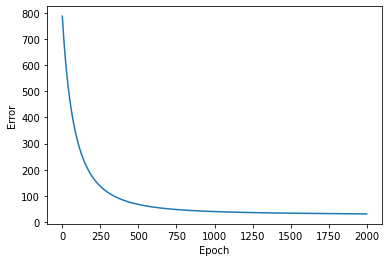

Weight Matrices 
[array([[ 0.32766309,  0.44447122],
       [ 0.04048442,  0.10738601],
       [ 0.26023568, -0.23337847]]), array([[ 0.60015786,  0.02418954,  0.56985657],
       [-0.0731628 ,  0.00830608,  0.50178256],
       [ 0.75637498,  0.97194355,  0.4602966 ],
       [ 0.48063102,  0.26935521,  0.93520394]]), array([[0.84259105, 0.29758953, 0.31276304, 0.93889787],
       [0.02349772, 0.04540677, 0.09918606, 0.88947939],
       [0.1843461 , 0.77449114, 0.30524524, 0.12866063],
       [0.734273  , 0.7992561 , 0.17946856, 0.28271754],
       [0.49506939, 0.42185904, 0.69694977, 0.18619686]]), array([[ 0.2089155 ,  0.84992639,  0.04470312,  0.71315356, -0.05373303],
       [ 0.17290562,  0.44502634,  0.27344917,  0.06873837,  0.77498292]])]


In [108]:
n5.train(2000, 0.000001)

EPOCH: 0   ERROR: 4483.921120530356
dW 
[array([[-0.01119815, -0.01167913],
       [-0.00800794, -0.00836828],
       [-0.01494653, -0.01559062]]), array([[-0.00787409, -0.00584319, -0.00803822],
       [-0.01045092, -0.00777111, -0.01068689],
       [-0.01223066, -0.00908322, -0.0124938 ],
       [-0.01148017, -0.00852024, -0.01172067]]), array([[-0.01053841, -0.01215412, -0.00694469, -0.00406137],
       [-0.00386471, -0.00445652, -0.00254659, -0.00148911],
       [-0.00476788, -0.00550098, -0.00314259, -0.00183836],
       [-0.00354992, -0.0040927 , -0.00233892, -0.00136748],
       [-0.00705553, -0.00814514, -0.00465181, -0.00272239]]), array([[-0.0138441 , -0.01109602, -0.01378545, -0.00750769, -0.00555302],
       [-0.01240945, -0.00994438, -0.01235757, -0.00672816, -0.00498009]])]
Weight
[array([[0.72428364, 0.7928954 ],
       [0.74668737, 0.38894378],
       [0.98085242, 0.57922199]]), array([[0.39103501, 0.5263754 , 0.75334178],
       [0.69827383, 0.34202899, 0.81975502],
  

EPOCH: 9   ERROR: 1490.070466523404
dW 
[array([[-0.00439561, -0.00447336],
       [-0.00313509, -0.00320692],
       [-0.00609614, -0.00620676]]), array([[-0.00325354, -0.00243091, -0.00322606],
       [-0.00422428, -0.00317196, -0.00420671],
       [-0.00532111, -0.00398298, -0.00528452],
       [-0.00518788, -0.00387745, -0.00514553]]), array([[-0.00454958, -0.00518159, -0.00262023, -0.00133781],
       [-0.00146218, -0.00166448, -0.00084193, -0.00042966],
       [-0.00181038, -0.00206384, -0.00104308, -0.00053306],
       [-0.0014337 , -0.00163133, -0.00082538, -0.00042103],
       [-0.00319003, -0.00364113, -0.00183896, -0.00094091]]), array([[-0.00562846, -0.00484468, -0.00591044, -0.00317607, -0.00202647],
       [-0.00497558, -0.00428102, -0.00522574, -0.00280633, -0.00179395]])]
Weight
[array([[0.65878642, 0.72521606],
       [0.69990171, 0.34045175],
       [0.89207089, 0.48746793]]), array([[0.3440479 , 0.4914104 , 0.70595748],
       [0.63642439, 0.29586339, 0.75721629],
  

       [-0.00322198, -0.00287787, -0.00347715, -0.00185571, -0.00108748]])]
Weight
[array([[0.63063994, 0.69679787],
       [0.67983832, 0.32006373],
       [0.85263957, 0.44763335]]), array([[ 0.3250525 ,  0.47719529,  0.68723199],
       [ 0.61191558,  0.27741211,  0.73292854],
       [ 0.19788859,  0.00943862,  0.53281551],
       [ 0.18350097,  0.24038168, -0.02626799]]), array([[ 0.46834515,  0.62226987,  0.60977618,  0.8492988 ],
       [ 0.25338519,  0.81176523,  0.50543734,  0.34264568],
       [ 0.49189812,  0.65115138,  0.83246734,  0.68779094],
       [-0.01872573,  0.51839302,  0.76544573,  0.03017492],
       [ 0.31375444, -0.06731451,  0.39960321,  0.50384835]]), array([[0.6651119 , 0.14776625, 0.35797391, 0.11181395, 0.94178332],
       [0.87366343, 0.3188581 , 0.19879503, 0.36886504, 0.0996066 ]])]
dW 
[array([[-0.0028115 , -0.00281157],
       [-0.0020028 , -0.00201921],
       [-0.00398407, -0.00398744]]), array([[-0.00214802, -0.00161115, -0.00210055],
       [-0.002

EPOCH: 23   ERROR: 584.5677943210759
dW 
[array([[-0.00199622, -0.0019617 ],
       [-0.00142063, -0.0014124 ],
       [-0.0028799 , -0.00283377]]), array([[-0.00156694, -0.00117924, -0.00151684],
       [-0.00197316, -0.00150076, -0.00192817],
       [-0.00267775, -0.00202258, -0.00260058],
       [-0.00270329, -0.00203585, -0.0026185 ]]), array([[-0.00228655, -0.0025812 , -0.0011546 , -0.00049104],
       [-0.00064296, -0.00072489, -0.00032452, -0.00013779],
       [-0.00080479, -0.00091035, -0.00040666, -0.00017341],
       [-0.00067668, -0.00076229, -0.00034145, -0.00014483],
       [-0.00167348, -0.00189717, -0.00084625, -0.00036187]]), array([[-0.00266495, -0.00245473, -0.00293726, -0.00156248, -0.00084511],
       [-0.00231027, -0.00212637, -0.00254738, -0.00135335, -0.00073522]])]
Weight
[array([[0.61648107, 0.68275633],
       [0.66975701, 0.30996786],
       [0.83239671, 0.42753779]]), array([[ 0.31194133,  0.46734756,  0.67446569],
       [ 0.59525901,  0.26479093,  0.716583

EPOCH: 30   ERROR: 419.6965292706684
dW 
[array([[-0.00150869, -0.0014563 ],
       [-0.00107269, -0.00105177],
       [-0.00221055, -0.00213786]]), array([[-0.0012124 , -0.00091519, -0.00116455],
       [-0.00150516, -0.00115203, -0.00146387],
       [-0.00210374, -0.00159546, -0.0020292 ],
       [-0.0021512 , -0.00162535, -0.00206801]]), array([[-1.79817341e-03, -2.02431687e-03, -8.63712660e-04,
        -3.36033377e-04],
       [-4.79959770e-04, -5.39358232e-04, -2.30413221e-04,
        -8.94130108e-05],
       [-6.04664671e-04, -6.82535693e-04, -2.90674044e-04,
        -1.13526774e-04],
       [-5.19841601e-04, -5.83611404e-04, -2.49486047e-04,
        -9.66789201e-05],
       [-1.33714696e-03, -1.51341002e-03, -6.43318841e-04,
        -2.52229915e-04]]), array([[-0.00204896, -0.00193604, -0.00229891, -0.00121902, -0.00061461],
       [-0.00175973, -0.0016611 , -0.00197549, -0.00104581, -0.00053045]])]
Weight
[array([[0.60409748, 0.67067417],
       [0.66094742, 0.30125835],
      

EPOCH: 37   ERROR: 317.1323818118942
dW 
[array([[-0.00118894, -0.00112652],
       [-0.00084458, -0.00081653],
       [-0.00176614, -0.00167785]]), array([[-0.00097533, -0.00073835, -0.00093116],
       [-0.00119433, -0.00092002, -0.00115836],
       [-0.00171402, -0.00130502, -0.00164491],
       [-0.00177215, -0.0013431 , -0.00169365]]), array([[-1.46729586e-03, -1.64819514e-03, -6.74718480e-04,
        -2.39896293e-04],
       [-3.73995610e-04, -4.19107962e-04, -1.71867274e-04,
        -6.08741085e-05],
       [-4.74424454e-04, -5.34711435e-04, -2.18356938e-04,
        -7.80574230e-05],
       [-4.15681051e-04, -4.65303543e-04, -1.90966298e-04,
        -6.75174709e-05],
       [-1.10626263e-03, -1.25079532e-03, -5.09601698e-04,
        -1.83095754e-04]]), array([[-0.00163965, -0.00158398, -0.0018681 , -0.00098812, -0.00046661],
       [-0.00139527, -0.00134625, -0.00159081, -0.00083974, -0.00039968]])]
Weight
[array([[0.59456609, 0.66154274],
       [0.65417303, 0.29465402],
      

EPOCH: 44   ERROR: 248.84232916291003
dW 
[array([[-0.00096562, -0.00089728],
       [-0.00068528, -0.00065305],
       [-0.00145223, -0.00135424]]), array([[-0.00080663, -0.00061234, -0.00076642],
       [-0.00097462, -0.00075579, -0.00094416],
       [-0.00143296, -0.00109529, -0.00137004],
       [-0.00149606, -0.00113726, -0.00142325]]), array([[-1.22902625e-03, -1.37800500e-03, -5.43693069e-04,
        -1.76269984e-04],
       [-3.00518980e-04, -3.35919979e-04, -1.32845923e-04,
        -4.28355579e-05],
       [-3.83973290e-04, -4.32288194e-04, -1.70027893e-04,
        -5.55284108e-05],
       [-3.41996517e-04, -3.81809238e-04, -1.51136573e-04,
        -4.86250323e-05],
       [-9.38045714e-04, -1.05994018e-03, -4.15741607e-04,
        -1.36654439e-04]]), array([[-0.00135013, -0.00133015, -0.00155916, -0.00082305, -0.0003653 ],
       [-0.00113842, -0.00111992, -0.00131583, -0.00069292, -0.00031065]])]
Weight
[array([[0.58695585, 0.65438897],
       [0.64876913, 0.28946023],
     

EPOCH: 50   ERROR: 206.96977489904046
dW 
[array([[-0.00082289, -0.00075137],
       [-0.00058346, -0.000549  ],
       [-0.00124962, -0.0011461 ]]), array([[-0.00069697, -0.00053033, -0.00066003],
       [-0.00083269, -0.00064955, -0.0008067 ],
       [-0.00124818, -0.00095726, -0.00119057],
       [-0.00131302, -0.00100066, -0.00124523]]), array([[-1.07253237e-03, -1.20087360e-03, -4.60415683e-04,
        -1.37566052e-04],
       [-2.53821890e-04, -2.83143981e-04, -1.08874155e-04,
        -3.22961000e-05],
       [-3.26384174e-04, -3.67191841e-04, -1.40253728e-04,
        -4.22961739e-05],
       [-2.94329216e-04, -3.27892375e-04, -1.26213338e-04,
        -3.73418066e-05],
       [-8.26462995e-04, -9.33582563e-04, -3.55458424e-04,
        -1.08037969e-04]]), array([[-0.00116292, -0.00116329, -0.00135704, -0.00071535, -0.00030172],
       [-0.00097291, -0.00097156, -0.00113649, -0.0005974 , -0.00025506]])]
Weight
[array([[0.58153653, 0.6493883 ],
       [0.64492454, 0.28581508],
     

EPOCH: 54   ERROR: 184.91589723494272
dW 
[array([[-0.00074538, -0.00067239],
       [-0.00052817, -0.00049267],
       [-0.00113879, -0.00103255]]), array([[-0.00063665, -0.00048518, -0.00060179],
       [-0.000755  , -0.00059135, -0.00073181],
       [-0.00114573, -0.00088067, -0.00109155],
       [-0.00121091, -0.00092441, -0.00114642]]), array([[-9.85813039e-04, -1.10283622e-03, -4.15359246e-04,
        -1.17334726e-04],
       [-2.28561600e-04, -2.54627957e-04, -9.62217240e-05,
        -2.69481357e-05],
       [-2.95182162e-04, -3.31962979e-04, -1.24501231e-04,
        -3.55517539e-05],
       [-2.68201815e-04, -2.98373722e-04, -1.12878738e-04,
        -3.15220769e-05],
       [-7.64190034e-04, -8.63151943e-04, -3.22597972e-04,
        -9.29379100e-05]]), array([[-0.00106037, -0.00107079, -0.00124538, -0.00065595, -0.00026767],
       [-0.00088248, -0.00088949, -0.00103764, -0.00054485, -0.00022541]])]
Weight
[array([[0.57836503, 0.64650519],
       [0.64267633, 0.28370637],
     

EPOCH: 61   ERROR: 154.39929765447218
dW 
[array([[-0.00063473, -0.00056   ],
       [-0.00044922, -0.00041251],
       [-0.00097941, -0.00086968]]), array([[-0.00054939, -0.00041982, -0.00051793],
       [-0.00064317, -0.00050751, -0.0006245 ],
       [-0.00099632, -0.0007689 , -0.00094783],
       [-0.0010611 , -0.00081246, -0.00100216]]), array([[-8.59401491e-04, -9.60082354e-04, -3.51251871e-04,
        -8.96027224e-05],
       [-1.92631943e-04, -2.14109238e-04, -7.86630414e-05,
        -1.98346114e-05],
       [-2.50717402e-04, -2.81812171e-04, -1.02581288e-04,
        -2.65346177e-05],
       [-2.30530650e-04, -2.55857584e-04, -9.41155794e-05,
        -2.36508605e-05],
       [-6.72766197e-04, -7.59869751e-04, -2.75494595e-04,
        -7.20410952e-05]]), array([[-0.00091263, -0.00093591, -0.00108315, -0.0005698 , -0.00021977],
       [-0.00075256, -0.00077009, -0.00089438, -0.00046882, -0.00018388]])]
Weight
[array([[0.57349528, 0.64215207],
       [0.63922736, 0.28050987],
     

       [0.79879622, 0.24746001, 0.1141613 , 0.3241089 , 0.07756737]])]
EPOCH: 69   ERROR: 128.51401217518705
dW 
[array([[-0.00053688, -0.00046104],
       [-0.00037938, -0.00034192],
       [-0.00083709, -0.00072476]]), array([[-0.00047083, -0.00036092, -0.00044286],
       [-0.00054319, -0.00043246, -0.00052911],
       [-0.00086041, -0.00066714, -0.00081788],
       [-0.00092375, -0.00070974, -0.00087072]]), array([[-7.44453212e-04, -8.30438142e-04, -2.94780116e-04,
        -6.64342797e-05],
       [-1.61000272e-04, -1.78480130e-04, -6.36934646e-05,
        -1.41251108e-05],
       [-2.11459499e-04, -2.37588059e-04, -8.38193220e-05,
        -1.92407957e-05],
       [-1.96758793e-04, -2.17788467e-04, -7.78227638e-05,
        -1.71900974e-05],
       [-5.88864982e-04, -6.65212033e-04, -2.33602151e-04,
        -5.43599317e-05]]), array([[-0.00078034, -0.00081321, -0.00093628, -0.00049197, -0.00017825],
       [-0.00063668, -0.00066182, -0.00076513, -0.00040037, -0.00014811]])]
Weight
[

EPOCH: 76   ERROR: 111.3272074609682
dW 
[array([[-0.00046921, -0.00039289],
       [-0.00033107, -0.00029329],
       [-0.00073774, -0.00062392]]), array([[-0.00041553, -0.00031942, -0.0003903 ],
       [-0.0004733 , -0.00037995, -0.00046278],
       [-0.00076381, -0.00059475, -0.00072604],
       [-0.00082542, -0.00063614, -0.00077716]]), array([[-6.62776076e-04, -7.38414736e-04, -2.55851229e-04,
        -5.13251015e-05],
       [-1.39211246e-04, -1.53961719e-04, -5.36911334e-05,
        -1.05440609e-05],
       [-1.84331626e-04, -2.07059428e-04, -7.12296781e-05,
        -1.46262170e-05],
       [-1.73081288e-04, -1.91124674e-04, -6.67415334e-05,
        -1.30479037e-05],
       [-5.28730794e-04, -5.97443218e-04, -2.04463189e-04,
        -4.26854600e-05]]), array([[-0.00068773, -0.00072601, -0.00083239, -0.00043701, -0.00015013],
       [-0.00055586, -0.00058512, -0.00067401, -0.0003522 , -0.00012403]])]
Weight
[array([[0.56522966, 0.63502113],
       [0.63338497, 0.27522753],
      

EPOCH: 83   ERROR: 97.78538214361379
dW 
[array([[-0.00041389, -0.00033739],
       [-0.00029156, -0.00025367],
       [-0.00065585, -0.00054106]]), array([[-0.0003696 , -0.00028492, -0.00034685],
       [-0.00041561, -0.00033657, -0.00040828],
       [-0.0006829 , -0.00053409, -0.00064948],
       [-0.00074253, -0.00057407, -0.00069868]]), array([[-5.94370595e-04, -6.61404843e-04, -2.24105746e-04,
        -3.96455258e-05],
       [-1.21457501e-04, -1.33998969e-04, -4.57550304e-05,
        -7.87078137e-06],
       [-1.62157799e-04, -1.82125231e-04, -6.11994515e-05,
        -1.11509651e-05],
       [-1.53481232e-04, -1.69069083e-04, -5.78098527e-05,
        -9.89410199e-06],
       [-4.77987167e-04, -5.40305330e-04, -1.80515794e-04,
        -3.35593758e-05]]), array([[-0.00061117, -0.00065297, -0.00074571, -0.00039124, -0.00012757],
       [-0.0004893 , -0.00052107, -0.00059825, -0.00031221, -0.00010483]])]
Weight
[array([[0.5621173 , 0.63244368],
       [0.63119037, 0.27329783],
      

EPOCH: 90   ERROR: 86.95756405650776
dW 
[array([[-0.00036804, -0.00029155],
       [-0.00025879, -0.00022094],
       [-0.00058742, -0.00047201]]), array([[-0.00033093, -0.00025586, -0.00031041],
       [-0.00036735, -0.00030026, -0.00036286],
       [-0.00061424, -0.00048258, -0.00058479],
       [-0.00067177, -0.00052105, -0.00063199]]), array([[-5.36321217e-04, -5.96095855e-04, -1.97842372e-04,
        -3.05058467e-05],
       [-1.06783388e-04, -1.17509150e-04, -3.93586482e-05,
        -5.84870215e-06],
       [-1.43768693e-04, -1.61460254e-04, -5.30805595e-05,
        -8.49696823e-06],
       [-1.37030957e-04, -1.50569148e-04, -5.05011873e-05,
        -7.46217917e-06],
       [-4.34618301e-04, -4.91505551e-04, -1.60558551e-04,
        -2.63386991e-05]]), array([[-5.47010549e-04, -5.90982497e-04, -6.72447374e-04,
        -3.52601840e-04, -1.09229641e-04],
       [-4.33711955e-04, -4.66868128e-04, -5.34410432e-04,
        -2.78557861e-04, -8.93105215e-05]])]
Weight
[array([[0.559362

        -2.61646795e-04, -8.17583490e-05]])]
Weight
[array([[0.55757984, 0.62882409],
       [0.62799835, 0.27056011],
       [0.74352162, 0.34592147]]), array([[ 0.26291813,  0.4300663 ,  0.62784904],
       [ 0.53646069,  0.21895165,  0.65936125],
       [ 0.08849001, -0.07414873,  0.42763663],
       [ 0.06992677,  0.15406956, -0.13486888]]), array([[ 0.37441007,  0.51680255,  0.56699826,  0.83447639],
       [ 0.22973644,  0.78527805,  0.49453468,  0.33877329],
       [ 0.46174479,  0.61714109,  0.81857785,  0.68283082],
       [-0.04517981,  0.4888123 ,  0.75334106,  0.02595393],
       [ 0.24251437, -0.14792774,  0.36723489,  0.49259588]]), array([[0.56063133, 0.04614325, 0.23845784, 0.04859317, 0.91259021],
       [0.78531218, 0.23318865, 0.09774715, 0.31553706, 0.07461479]])]
dW 
[array([[-0.00034526, -0.00026884],
       [-0.00024251, -0.00020472],
       [-0.00055322, -0.00043758]]), array([[-0.00031149, -0.00024124, -0.00029215],
       [-0.0003432 , -0.00028207, -0.00034021

EPOCH: 98   ERROR: 77.07721570236494
dW 
[array([[-0.00032458, -0.00024827],
       [-0.00022772, -0.00019003],
       [-0.00052203, -0.00040623]]), array([[-0.00029368, -0.00022785, -0.00027546],
       [-0.00032117, -0.00026548, -0.00031958],
       [-0.00054759, -0.00043254, -0.00052226],
       [-0.00060266, -0.00046924, -0.00056714]]), array([[-4.79961697e-04, -5.32723266e-04, -1.72994558e-04,
        -2.23790051e-05],
       [-9.29156835e-05, -1.01933789e-04, -3.34656670e-05,
        -4.11325895e-06],
       [-1.26324263e-04, -1.41867999e-04, -4.55652566e-05,
        -6.19362727e-06],
       [-1.21236527e-04, -1.32816002e-04, -4.36622452e-05,
        -5.33266455e-06],
       [-3.92207951e-04, -4.43813384e-04, -1.41537716e-04,
        -1.98426746e-05]]), array([[-4.85504488e-04, -5.30789620e-04, -6.01592583e-04,
        -3.15285417e-04, -9.22055438e-05],
       [-3.80631224e-04, -4.14414554e-04, -4.72888494e-04,
        -2.46170008e-04, -7.50033069e-05]])]
Weight
[array([[0.556575

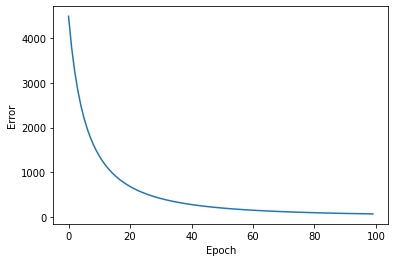

Weight Matrices 
[array([[0.55593142, 0.62755737],
       [0.62684148, 0.26959182],
       [0.74087292, 0.34385159]]), array([[ 0.26111622,  0.42866925,  0.62615898],
       [ 0.53448441,  0.21732167,  0.65739768],
       [ 0.08513307, -0.07679758,  0.42443614],
       [ 0.06623665,  0.15119848, -0.13834124]]), array([[ 0.37146992,  0.51353832,  0.56593389,  0.83433366],
       [ 0.22916421,  0.7846499 ,  0.49432767,  0.33874682],
       [ 0.46096829,  0.61626904,  0.81829653,  0.68279128],
       [-0.04592409,  0.48799645,  0.75307185,  0.02591973],
       [ 0.24011558, -0.15064182,  0.3663654 ,  0.49247003]]), array([[0.55765267, 0.04289402, 0.23477247, 0.04666154, 0.912019  ],
       [0.78297182, 0.23064602, 0.09484406, 0.31402543, 0.0741497 ]])]


In [98]:
n5.train(00, 0.000005)

### Comments
We definitely see that the network is learning, but perhaps it can do much better. 
We now change the initial weights to lie between -0.2 and 0.2 and try again. 

In [118]:
n5_new = nn.neural_network(X, Y, [3, 4, 5])

EPOCH: 0   ERROR: 128.79347890205136
dW 
[array([[-8.33187859e-05, -2.69806588e-04],
       [ 7.61485388e-06, -1.75761870e-05],
       [-1.14625045e-04,  5.13621488e-06]]), array([[-1.75876085e-04,  0.00000000e+00, -8.27299524e-05],
       [ 2.31367561e-05,  0.00000000e+00, -1.29154648e-04],
       [ 4.92702995e-06,  0.00000000e+00,  8.26261652e-06],
       [-2.00814195e-05,  0.00000000e+00, -2.76434472e-05]]), array([[-1.19247006e-04, -2.43081163e-04,  0.00000000e+00,
         0.00000000e+00],
       [-5.51827261e-06, -1.39580198e-04,  0.00000000e+00,
         0.00000000e+00],
       [-1.16810211e-04, -6.30736243e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.31399309e-04, -2.26729129e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 1.52737708e-05,  7.14896737e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[3.72891133e-05, 4.98316468e-05, 7.27116893e-07, 3.49163972e-05,
        1.74805112e-05],
       [7.39917338e-05, 4.98631619e-05, 1.44189339e-05, 1.380

[array([[-0.8838528 ,  0.74573056],
       [-0.49530195, -0.96216954],
       [ 0.47709995,  0.06796844]]), array([[ 0.76081319,  0.81296379, -0.22621055],
       [ 0.16375382, -0.60910187,  0.60329187],
       [-0.50245583, -0.67064023, -0.85632018],
       [-0.15571161, -0.67250744, -0.43517306]]), array([[ 0.07150521,  0.18162857, -0.46972568, -0.11084357],
       [-0.43200109,  0.2837672 , -0.40821746,  0.26315474],
       [ 0.33081063, -0.49888461, -0.53480373,  0.22416611],
       [ 0.4449495 ,  0.12426941,  0.65164149,  0.96399562],
       [-0.94443982,  0.10226735,  0.01182478,  0.59574998]]), array([[-0.44850076, -0.69017334,  0.41478792, -0.23745752, -0.34892566],
       [-0.4931642 , -0.07398111, -0.86227334, -0.57041549,  0.73097877]])]
EPOCH: 8   ERROR: 128.51825454644705
dW 
[array([[-8.13518911e-05, -2.63442276e-04],
       [ 7.82772759e-06, -1.64467944e-05],
       [-1.14580268e-04,  4.57078256e-07]]), array([[-1.70829979e-04,  0.00000000e+00, -8.06942226e-05],
       [

EPOCH: 15   ERROR: 128.2839623207716
dW 
[array([[-8.07057671e-05, -2.61375124e-04],
       [ 7.69124092e-06, -1.65113833e-05],
       [-1.12711853e-04,  2.35462255e-06]]), array([[-1.69257680e-04,  0.00000000e+00, -8.01768495e-05],
       [ 1.97505467e-05,  0.00000000e+00, -1.27398165e-04],
       [ 4.36312292e-06,  0.00000000e+00,  7.99310571e-06],
       [-1.95471642e-05,  0.00000000e+00, -2.72896350e-05]]), array([[-1.16795471e-04, -2.40553482e-04,  0.00000000e+00,
         0.00000000e+00],
       [-5.31206110e-06, -1.38109911e-04,  0.00000000e+00,
         0.00000000e+00],
       [-1.08443693e-04, -5.81484423e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.28568636e-04, -2.24064490e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 1.50159044e-05,  7.09792663e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[3.61930114e-05, 4.90858744e-05, 6.79444738e-07, 3.37329448e-05,
        1.75158662e-05],
       [7.17005863e-05, 4.91961679e-05, 1.37720194e-05, 1.345

EPOCH: 24   ERROR: 127.98832058398068
dW 
[array([[-7.99305078e-05, -2.58897684e-04],
       [ 7.50456438e-06, -1.66365248e-05],
       [-1.10271358e-04,  4.99927434e-06]]), array([[-1.67383320e-04,  0.00000000e+00, -7.95814970e-05],
       [ 2.07348275e-05,  0.00000000e+00, -1.25018316e-04],
       [ 4.35247287e-06,  0.00000000e+00,  7.97945855e-06],
       [-1.93692786e-05,  0.00000000e+00, -2.71431972e-05]]), array([[-1.15371746e-04, -2.39076461e-04,  0.00000000e+00,
         0.00000000e+00],
       [-5.19229325e-06, -1.37248570e-04,  0.00000000e+00,
         0.00000000e+00],
       [-1.07497993e-04, -5.78726565e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.26926031e-04, -2.22508509e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 1.48658315e-05,  7.06811035e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[3.55511121e-05, 4.86483244e-05, 6.53850343e-07, 3.30411407e-05,
        1.75370698e-05],
       [7.03627916e-05, 4.88045419e-05, 1.34139794e-05, 1.32

EPOCH: 34   ERROR: 127.66693232315043
dW 
[array([[-7.88843388e-05, -2.55524516e-04],
       [ 7.36248912e-06, -1.65643172e-05],
       [-1.07966809e-04,  6.68242004e-06]]), array([[-1.64791322e-04,  0.00000000e+00, -7.86998623e-05],
       [ 2.09569879e-05,  0.00000000e+00, -1.22797211e-04],
       [ 4.25056667e-06,  0.00000000e+00,  7.92514509e-06],
       [-1.91374834e-05,  0.00000000e+00, -2.69691830e-05]]), array([[-1.13818451e-04, -2.37489184e-04,  0.00000000e+00,
         0.00000000e+00],
       [-5.06179859e-06, -1.36319273e-04,  0.00000000e+00,
         0.00000000e+00],
       [-1.05359986e-04, -5.68540773e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.25135268e-04, -2.20835059e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 1.47014298e-05,  7.03623548e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[3.48538337e-05, 4.81743988e-05, 6.26108955e-07, 3.22893499e-05,
        1.75618744e-05],
       [6.89107430e-05, 4.83816751e-05, 1.30211572e-05, 1.30

EPOCH: 43   ERROR: 127.38427953500677
dW 
[array([[-7.81410871e-05, -2.53150457e-04],
       [ 7.17970389e-06, -1.66890040e-05],
       [-1.05606676e-04,  9.24217776e-06]]), array([[-1.63002851e-04,  0.00000000e+00, -7.81469966e-05],
       [ 2.18951318e-05,  0.00000000e+00, -1.20502356e-04],
       [ 4.24060733e-06,  0.00000000e+00,  7.91278922e-06],
       [-1.89665968e-05,  0.00000000e+00, -2.68317261e-05]]), array([[-1.12449140e-04, -2.36100989e-04,  0.00000000e+00,
         0.00000000e+00],
       [-4.94683760e-06, -1.35503848e-04,  0.00000000e+00,
         0.00000000e+00],
       [-1.04457909e-04, -5.66019193e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.23557779e-04, -2.19371035e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 1.45560610e-05,  7.00846058e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[3.42392096e-05, 4.77572751e-05, 6.02443278e-07, 3.16268016e-05,
        1.75849112e-05],
       [6.76326767e-05, 4.80101340e-05, 1.26784493e-05, 1.28

EPOCH: 52   ERROR: 127.10717932296699
dW 
[array([[-7.74108490e-05, -2.50817236e-04],
       [ 6.99881823e-06, -1.68129936e-05],
       [-1.03283650e-04,  1.17618298e-05]]), array([[-1.61248012e-04,  0.00000000e+00, -7.76140697e-05],
       [ 2.28101467e-05,  0.00000000e+00, -1.18247003e-04],
       [ 4.23060214e-06,  0.00000000e+00,  7.90106792e-06],
       [-1.87985476e-05,  0.00000000e+00, -2.66987208e-05]]), array([[-1.11102143e-04, -2.34756851e-04,  0.00000000e+00,
         0.00000000e+00],
       [-4.83390004e-06, -1.34711163e-04,  0.00000000e+00,
         0.00000000e+00],
       [-1.03567998e-04, -5.63596001e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.22007119e-04, -2.17952187e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 1.44124959e-05,  6.98172224e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[3.36373037e-05, 4.73500990e-05, 5.79187319e-07, 3.09776588e-05,
        1.76090606e-05],
       [6.63819623e-05, 4.76485988e-05, 1.23386154e-05, 1.26

EPOCH: 61   ERROR: 126.83543894378711
dW 
[array([[-7.66932229e-05, -2.48523637e-04],
       [ 6.81976590e-06, -1.69363262e-05],
       [-1.00996463e-04,  1.42428562e-05]]), array([[-1.59525873e-04,  0.00000000e+00, -7.71004911e-05],
       [ 2.37027910e-05,  0.00000000e+00, -1.16029571e-04],
       [ 4.22055312e-06,  0.00000000e+00,  7.88996957e-06],
       [-1.86332603e-05,  0.00000000e+00, -2.65700501e-05]]), array([[-1.09776774e-04, -2.33455519e-04,  0.00000000e+00,
         0.00000000e+00],
       [-4.72292086e-06, -1.33940589e-04,  0.00000000e+00,
         0.00000000e+00],
       [-1.02689924e-04, -5.61268512e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.20482486e-04, -2.16577199e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 1.42706845e-05,  6.95599456e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[3.30476441e-05, 4.69525618e-05, 5.56323827e-07, 3.03414157e-05,
        1.76343255e-05],
       [6.51576353e-05, 4.72967498e-05, 1.20015721e-05, 1.24

        1.70553305e-05]])]
Weight
[array([[-0.88873686,  0.72992443],
       [-0.49485374, -0.96320764],
       [ 0.47048775,  0.06849427]]), array([[ 0.75062987,  0.81296379, -0.23108874],
       [ 0.16510206, -0.60910187,  0.59575566],
       [-0.50219022, -0.67064023, -0.85582808],
       [-0.15689399, -0.67250744, -0.43684135]]), array([[ 0.06459676,  0.16717478, -0.46972568, -0.11084357],
       [-0.43230698,  0.27547146, -0.40821746,  0.26315474],
       [ 0.32437735, -0.50236596, -0.53480373,  0.22416611],
       [ 0.43735584,  0.11083343,  0.65164149,  0.96399562],
       [-0.9435463 ,  0.10655707,  0.01182478,  0.59574998]]), array([[-0.44635319, -0.68719548,  0.41482626, -0.23547   , -0.34783615],
       [-0.48891938, -0.07098931, -0.86147361, -0.56238803,  0.73203048]])]
dW 
[array([[-7.79389697e-05, -2.49390715e-04],
       [ 6.42868535e-06, -1.74035188e-05],
       [-9.83116634e-05,  1.74625416e-05]]), array([[-1.58601344e-04,  0.00000000e+00, -7.81136248e-05],
       [ 2.

EPOCH: 78   ERROR: 126.33511785875443
dW 
[array([[-7.60938249e-05, -2.43173394e-04],
       [ 6.62180409e-06, -1.62367337e-05],
       [-9.81960497e-05,  1.24960427e-05]]), array([[-1.53580819e-04,  0.00000000e+00, -7.61884156e-05],
       [ 2.01920444e-05,  0.00000000e+00, -1.13999603e-04],
       [ 3.64883473e-06,  0.00000000e+00,  7.63544773e-06],
       [-1.80591459e-05,  0.00000000e+00, -2.61465193e-05]]), array([[-1.07323242e-04, -2.31093461e-04,  0.00000000e+00,
         0.00000000e+00],
       [-4.51761541e-06, -1.32539047e-04,  0.00000000e+00,
         0.00000000e+00],
       [-9.43340270e-05, -5.13604389e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.17664175e-04, -2.14078197e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 1.41063921e-05,  7.01090089e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[3.19642622e-05, 4.62259292e-05, 5.15773968e-07, 2.91707666e-05,
        1.76974056e-05],
       [6.29085880e-05, 4.66550470e-05, 1.13910229e-05, 1.20

[array([[-8.07282263e-05, -2.49255313e-04],
       [ 5.78155682e-06, -1.73918271e-05],
       [-9.40410409e-05,  1.79233688e-05]]), array([[-1.53638626e-04,  0.00000000e+00, -7.98514340e-05],
       [ 2.12406505e-05,  0.00000000e+00, -1.11401433e-04],
       [ 3.64421537e-06,  0.00000000e+00,  7.63126844e-06],
       [-1.77957699e-05,  0.00000000e+00, -2.57660624e-05]]), array([[-1.06045941e-04, -2.29871662e-04,  0.00000000e+00,
         0.00000000e+00],
       [-4.41048621e-06, -1.31817717e-04,  0.00000000e+00,
         0.00000000e+00],
       [-9.35514881e-05, -5.11570677e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.16200043e-04, -2.12785100e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 1.42693560e-05,  7.27614405e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[3.14040674e-05, 4.58515616e-05, 4.97535984e-07, 2.85641312e-05,
        1.77468247e-05],
       [6.17448425e-05, 4.63239015e-05, 1.11034484e-05, 1.18931652e-04,
        1.71820755e-05]])]
Wei

EPOCH: 96   ERROR: 125.82072436543065
dW 
[array([[-7.95153269e-05, -2.46467322e-04],
       [ 5.61024204e-06, -1.75133579e-05],
       [-9.18680856e-05,  2.02998345e-05]]), array([[-1.52006618e-04,  0.00000000e+00, -7.93831937e-05],
       [ 2.20701801e-05,  0.00000000e+00, -1.09310376e-04],
       [ 3.63745889e-06,  0.00000000e+00,  7.62273965e-06],
       [-1.76426027e-05,  0.00000000e+00, -2.56524911e-05]]), array([[-1.04777490e-04, -2.28695984e-04,  0.00000000e+00,
         0.00000000e+00],
       [-4.30416137e-06, -1.31122250e-04,  0.00000000e+00,
         0.00000000e+00],
       [-9.27723368e-05, -5.09623576e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.14747913e-04, -2.11537913e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 1.40928053e-05,  7.25095899e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[3.08557669e-05, 4.54882635e-05, 4.79480611e-07, 2.79685590e-05,
        1.78041371e-05],
       [6.06046173e-05, 4.60043565e-05, 1.08157429e-05, 1.17

Weight
[array([[-0.89150008,  0.72128492],
       [-0.49464548, -0.96381013],
       [ 0.46718263,  0.06911727]]), array([[ 0.7452575 ,  0.81296379, -0.233844  ],
       [ 0.16586371, -0.60910187,  0.59185958],
       [-0.50206047, -0.67064023, -0.85556008],
       [-0.15751901, -0.67250744, -0.43774655]]), array([[ 0.06087999,  0.15912368, -0.46972568, -0.11084357],
       [-0.43246178,  0.27085455, -0.40821746,  0.26315474],
       [ 0.32106603, -0.5041792 , -0.53480373,  0.22416611],
       [ 0.43328289,  0.10338008,  0.65164149,  0.96399562],
       [-0.94305039,  0.1090699 ,  0.01182478,  0.59574998]]), array([[-0.44525163, -0.685589  ,  0.41484375, -0.23446768, -0.34721503],
       [-0.48675333, -0.06936647, -0.8610838 , -0.5582178 ,  0.73263194]])]
dW 
[array([[-7.89084226e-05, -2.44585094e-04],
       [ 5.45925472e-06, -1.76209752e-05],
       [-8.99624899e-05,  2.23844204e-05]]), array([[-1.50581069e-04,  0.00000000e+00, -7.89818201e-05],
       [ 2.27904271e-05,  0.00000000e+

EPOCH: 112   ERROR: 125.37790457745874
dW 
[array([[-7.83103170e-05, -2.42729886e-04],
       [ 5.30944496e-06, -1.77282258e-05],
       [-8.80805252e-05,  2.44436940e-05]]), array([[-1.49177945e-04,  0.00000000e+00, -7.85940377e-05],
       [ 2.34956217e-05,  0.00000000e+00, -1.05670882e-04],
       [ 3.62530566e-06,  0.00000000e+00,  7.60889670e-06],
       [-1.73765218e-05,  0.00000000e+00, -2.54599439e-05]]), array([[-1.02569839e-04, -2.26700067e-04,  0.00000000e+00,
         0.00000000e+00],
       [-4.11932659e-06, -1.29934322e-04,  0.00000000e+00,
         0.00000000e+00],
       [-9.14113586e-05, -5.06357864e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.12223449e-04, -2.09416931e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 1.37842016e-05,  7.20868538e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[2.99064666e-05, 4.48630708e-05, 4.48107886e-07, 2.69365873e-05,
        1.79082883e-05],
       [5.86335229e-05, 4.54569804e-05, 1.03094874e-05, 1.1

EPOCH: 122   ERROR: 125.10888529201222
dW 
[array([[-7.68231381e-05, -2.37679035e-04],
       [ 5.37432863e-06, -1.69382515e-05],
       [-8.71966410e-05,  2.16863631e-05]]), array([[-1.45075904e-04,  0.00000000e+00, -7.71419083e-05],
       [ 2.05876689e-05,  0.00000000e+00, -1.04996394e-04],
       [ 3.21859047e-06,  0.00000000e+00,  7.43631201e-06],
       [-1.70470106e-05,  0.00000000e+00, -2.52757183e-05]]), array([[-1.01223358e-04, -2.25503503e-04,  0.00000000e+00,
         0.00000000e+00],
       [-4.00663661e-06, -1.29218266e-04,  0.00000000e+00,
         0.00000000e+00],
       [-8.57607347e-05, -4.73855596e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.10685612e-04, -2.08143957e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 1.35953007e-05,  7.18357870e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[2.93279539e-05, 4.44837790e-05, 4.29758318e-07, 2.63075860e-05,
        1.79742645e-05],
       [5.74350498e-05, 4.51258656e-05, 1.00057631e-05, 1.1

EPOCH: 131   ERROR: 124.87301301046257
dW 
[array([[-7.61823274e-05, -2.35703703e-04],
       [ 5.20779389e-06, -1.70613715e-05],
       [-8.51319963e-05,  2.39528064e-05]]), array([[-1.43593261e-04,  0.00000000e+00, -7.67289236e-05],
       [ 2.13626761e-05,  0.00000000e+00, -1.03013313e-04],
       [ 3.21430406e-06,  0.00000000e+00,  7.42909230e-06],
       [-1.69055488e-05,  0.00000000e+00, -2.51729625e-05]]), array([[-1.00044565e-04, -2.24436263e-04,  0.00000000e+00,
         0.00000000e+00],
       [-3.90783560e-06, -1.28579653e-04,  0.00000000e+00,
         0.00000000e+00],
       [-8.50776774e-05, -4.72222301e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.09340216e-04, -2.07010324e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 1.34299314e-05,  7.16114510e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[2.88141339e-05, 4.41456260e-05, 4.15447694e-07, 2.57504051e-05,
        1.80324921e-05],
       [5.63740742e-05, 4.48295166e-05, 9.75915094e-06, 1.1

dW 
[array([[-7.56211894e-05, -2.33973734e-04],
       [ 5.06093262e-06, -1.71704107e-05],
       [-8.33199259e-05,  2.59426362e-05]]), array([[-1.42296695e-04,  0.00000000e+00, -7.63751202e-05],
       [ 2.20367979e-05,  0.00000000e+00, -1.01274259e-04],
       [ 3.21039980e-06,  0.00000000e+00,  7.42308336e-06],
       [-1.67815896e-05,  0.00000000e+00, -2.50845605e-05]]), array([[-9.90106815e-05, -2.23516864e-04,  0.00000000e+00,
         0.00000000e+00],
       [-3.82124611e-06, -1.28027097e-04,  0.00000000e+00,
         0.00000000e+00],
       [-8.44771539e-05, -4.70827663e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.08161156e-04, -2.06032450e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 1.32844628e-05,  7.14197809e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[2.83651156e-05, 4.38514450e-05, 4.02917625e-07, 2.52631902e-05,
        1.80850331e-05],
       [5.54478727e-05, 4.45724977e-05, 9.54122046e-06, 1.08864394e-04,
        1.77549078e-05]])]

       [-0.48424363, -0.06738583, -0.86064723, -0.55331582,  0.73340668]])]
dW 
[array([[-7.66119568e-05, -2.34639681e-04],
       [ 4.69168178e-06, -1.76215967e-05],
       [-8.06912401e-05,  2.91406138e-05]]), array([[-1.41399773e-04,  0.00000000e+00, -7.72652951e-05],
       [ 2.28433805e-05,  0.00000000e+00, -9.91921915e-05],
       [ 3.20656016e-06,  0.00000000e+00,  7.41844517e-06],
       [-1.66096508e-05,  0.00000000e+00, -2.49079943e-05]]), array([[-9.78602865e-05, -2.22515454e-04,  0.00000000e+00,
         0.00000000e+00],
       [-3.72497126e-06, -1.27423002e-04,  0.00000000e+00,
         0.00000000e+00],
       [-8.38074243e-05, -4.69321507e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.06850449e-04, -2.04965568e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 1.32255271e-05,  7.21022798e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[2.78685122e-05, 4.35279160e-05, 3.89004886e-07, 2.47236909e-05,
        1.81470738e-05],
       [5.44240726e-05

EPOCH: 157   ERROR: 124.2119735982662
dW 
[array([[-7.59886526e-05, -2.32732161e-04],
       [ 4.52978875e-06, -1.77421301e-05],
       [-7.87031432e-05,  3.13273775e-05]]), array([[-1.39967994e-04,  0.00000000e+00, -7.68938999e-05],
       [ 2.35679011e-05,  0.00000000e+00, -9.72887207e-05],
       [ 3.20183486e-06,  0.00000000e+00,  7.41290683e-06],
       [-1.64736550e-05,  0.00000000e+00, -2.48160880e-05]]), array([[-9.67169181e-05, -2.21550163e-04,  0.00000000e+00,
         0.00000000e+00],
       [-3.62933460e-06, -1.26839187e-04,  0.00000000e+00,
         0.00000000e+00],
       [-8.31403028e-05, -4.67880923e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.05549441e-04, -2.03934580e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 1.30545529e-05,  7.18995623e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[2.73809995e-05, 4.32130076e-05, 3.75225179e-07, 2.41926341e-05,
        1.82158188e-05],
       [5.34185117e-05, 4.40175983e-05, 9.05264965e-06, 1.05

EPOCH: 166   ERROR: 123.98961483753801
dW 
[array([[-7.53748315e-05, -2.30853526e-04],
       [ 4.36913560e-06, -1.78623064e-05],
       [-7.67400463e-05,  3.34876529e-05]]), array([[-1.38560237e-04,  0.00000000e+00, -7.65373872e-05],
       [ 2.42762023e-05,  0.00000000e+00, -9.54101259e-05],
       [ 3.19700430e-06,  0.00000000e+00,  7.40783047e-06],
       [-1.63396518e-05,  0.00000000e+00, -2.47274403e-05]]), array([[-9.55890009e-05, -2.20617289e-04,  0.00000000e+00,
         0.00000000e+00],
       [-3.53504735e-06, -1.26272090e-04,  0.00000000e+00,
         0.00000000e+00],
       [-8.24806378e-05, -4.66503992e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.04267174e-04, -2.02936562e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 1.28854116e-05,  7.17056998e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[2.69017151e-05, 4.29050861e-05, 3.61648823e-07, 2.36701748e-05,
        1.82854913e-05],
       [5.24312102e-05, 4.37514149e-05, 8.80974876e-06, 1.0

EPOCH: 176   ERROR: 123.74692051382847
dW 
[array([[-7.30835714e-05, -2.26380703e-04],
       [ 4.35778353e-06, -1.77497585e-05],
       [-7.50672658e-05,  3.51472313e-05]]), array([[-1.36686988e-04,  0.00000000e+00, -7.49153772e-05],
       [ 2.50761576e-05,  0.00000000e+00, -9.32770751e-05],
       [ 3.19186207e-06,  0.00000000e+00,  7.40345697e-06],
       [-1.61768989e-05,  0.00000000e+00, -2.45944706e-05]]), array([[-9.43585642e-05, -2.19617842e-04,  0.00000000e+00,
         0.00000000e+00],
       [-3.43389103e-06, -1.25660915e-04,  0.00000000e+00,
         0.00000000e+00],
       [-8.17574300e-05, -4.65048117e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.02868992e-04, -2.01865400e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 1.27511778e-05,  7.19206398e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[2.63785791e-05, 4.25697849e-05, 3.46802966e-07, 2.31004986e-05,
        1.83642217e-05],
       [5.13553547e-05, 4.34610105e-05, 8.54170613e-06, 1.0

EPOCH: 185   ERROR: 123.5332272805844
dW 
[array([[-7.25006571e-05, -2.24579146e-04],
       [ 4.19845115e-06, -1.78710726e-05],
       [-7.31527705e-05,  3.72555296e-05]]), array([[-1.35346773e-04,  0.00000000e+00, -7.45939617e-05],
       [ 2.57520496e-05,  0.00000000e+00, -9.14448537e-05],
       [ 3.18692762e-06,  0.00000000e+00,  7.39911351e-06],
       [-1.60482728e-05,  0.00000000e+00, -2.45118769e-05]]), array([[-9.32824734e-05, -2.18749212e-04,  0.00000000e+00,
         0.00000000e+00],
       [-3.34885321e-06, -1.25125259e-04,  0.00000000e+00,
         0.00000000e+00],
       [-8.11195491e-05, -4.63804314e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.01645586e-04, -2.00933389e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 1.25930074e-05,  7.17438435e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[2.59156841e-05, 4.22717840e-05, 3.33705975e-07, 2.25987745e-05,
        1.84324497e-05],
       [5.04063695e-05, 4.32005435e-05, 8.30326515e-06, 1.00

EPOCH: 194   ERROR: 123.32441756517474
dW 
[array([[-6.50662099e-05, -2.12186598e-04],
       [ 4.80135844e-06, -1.68140609e-05],
       [-7.35144962e-05,  3.58504588e-05]]), array([[-1.32294132e-04,  0.00000000e+00, -6.89366838e-05],
       [ 2.64138924e-05,  0.00000000e+00, -8.96323502e-05],
       [ 3.18200641e-06,  0.00000000e+00,  7.39497858e-06],
       [-1.59224892e-05,  0.00000000e+00, -2.44316410e-05]]), array([[-9.22387609e-05, -2.17908476e-04,  0.00000000e+00,
         0.00000000e+00],
       [-3.26990527e-06, -1.24602263e-04,  0.00000000e+00,
         0.00000000e+00],
       [-8.04949926e-05, -4.62621800e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.00458192e-04, -2.00030477e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 1.24468582e-05,  7.15760956e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[2.54599228e-05, 4.19768265e-05, 3.20864749e-07, 2.21073145e-05,
        1.84965035e-05],
       [4.94752420e-05, 4.29391218e-05, 8.06772136e-06, 9.9

EPOCH: 202   ERROR: 123.14493212517007
dW 
[array([[-6.45984485e-05, -2.10689987e-04],
       [ 4.65860236e-06, -1.69263811e-05],
       [-7.18503343e-05,  3.76799767e-05]]), array([[-1.31209313e-04,  0.00000000e+00, -6.86843082e-05],
       [ 2.69922345e-05,  0.00000000e+00, -8.80329774e-05],
       [ 3.17792109e-06,  0.00000000e+00,  7.39102604e-06],
       [-1.58153269e-05,  0.00000000e+00, -2.43607873e-05]]), array([[-9.13676086e-05, -2.17178320e-04,  0.00000000e+00,
         0.00000000e+00],
       [-3.21042318e-06, -1.24141865e-04,  0.00000000e+00,
         0.00000000e+00],
       [-7.99641502e-05, -4.61622866e-05,  0.00000000e+00,
         0.00000000e+00],
       [-9.94637109e-05, -1.99247359e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 1.23387861e-05,  7.14336488e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[2.50599817e-05, 4.17124453e-05, 3.09836140e-07, 2.16822891e-05,
        1.85443107e-05],
       [4.86641207e-05, 4.26966515e-05, 7.86434979e-06, 9.7

EPOCH: 211   ERROR: 122.9458527219704
dW 
[array([[-6.40789596e-05, -2.09027937e-04],
       [ 4.49908028e-06, -1.70523431e-05],
       [-6.99984576e-05,  3.97170250e-05]]), array([[-1.30007064e-04,  0.00000000e+00, -6.84117634e-05],
       [ 2.76300729e-05,  0.00000000e+00, -8.62531513e-05],
       [ 3.17324940e-06,  0.00000000e+00,  7.38700802e-06],
       [-1.56963543e-05,  0.00000000e+00, -2.42838394e-05]]), array([[-9.03990653e-05, -2.16384185e-04,  0.00000000e+00,
         0.00000000e+00],
       [-3.14437848e-06, -1.23638216e-04,  0.00000000e+00,
         0.00000000e+00],
       [-7.93726716e-05, -4.60552360e-05,  0.00000000e+00,
         0.00000000e+00],
       [-9.83589211e-05, -1.98393796e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 1.22182880e-05,  7.12808508e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[2.46165486e-05, 4.14209271e-05, 2.97572518e-07, 2.12107588e-05,
        1.85991285e-05],
       [4.77657248e-05, 4.24298889e-05, 7.63653943e-06, 9.64

EPOCH: 220   ERROR: 122.75041527626027
dW 
[array([[-6.31298910e-05, -2.05574502e-04],
       [ 4.49610834e-06, -1.65313557e-05],
       [-6.90600377e-05,  3.80169570e-05]]), array([[-1.27178400e-04,  0.00000000e+00, -6.75164613e-05],
       [ 2.55532289e-05,  0.00000000e+00, -8.55231331e-05],
       [ 2.88510346e-06,  0.00000000e+00,  7.27487079e-06],
       [-1.54606323e-05,  0.00000000e+00, -2.41633150e-05]]), array([[-8.94475670e-05, -2.15608181e-04,  0.00000000e+00,
         0.00000000e+00],
       [-3.07948803e-06, -1.23144545e-04,  0.00000000e+00,
         0.00000000e+00],
       [-7.54164278e-05, -4.38808950e-05,  0.00000000e+00,
         0.00000000e+00],
       [-9.72744035e-05, -1.97559155e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 1.20997422e-05,  7.11326579e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[2.41787711e-05, 4.11338155e-05, 2.86176251e-07, 2.07455016e-05,
        1.86542949e-05],
       [4.68804261e-05, 4.21671649e-05, 7.41936071e-06, 9.5

       [-0.4801812 , -0.06389399, -0.85997996, -0.54519017,  0.73489068]])]
EPOCH: 230   ERROR: 122.53756727450676
dW 
[array([[-6.25747087e-05, -2.03809322e-04],
       [ 4.32077379e-06, -1.66728048e-05],
       [-6.70455860e-05,  4.02403844e-05]]), array([[-1.25911815e-04,  0.00000000e+00, -6.72318587e-05],
       [ 2.62458472e-05,  0.00000000e+00, -8.35860012e-05],
       [ 2.88162862e-06,  0.00000000e+00,  7.27075385e-06],
       [-1.53339102e-05,  0.00000000e+00, -2.40816884e-05]]), array([[-8.84109086e-05, -2.14764512e-04,  0.00000000e+00,
         0.00000000e+00],
       [-3.00876061e-06, -1.22606414e-04,  0.00000000e+00,
         0.00000000e+00],
       [-7.48136109e-05, -4.37732571e-05,  0.00000000e+00,
         0.00000000e+00],
       [-9.60937455e-05, -1.96651354e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 1.19704333e-05,  7.09725965e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[2.36985871e-05, 4.08194788e-05, 2.74651361e-07, 2.02355957e-05,
        

EPOCH: 238   ERROR: 122.36983891145616
dW 
[array([[-6.20985038e-05, -2.02255627e-04],
       [ 4.19511715e-06, -1.67277011e-05],
       [-6.55301472e-05,  4.16678516e-05]]), array([[-1.24767573e-04,  0.00000000e+00, -6.69577270e-05],
       [ 2.65460003e-05,  0.00000000e+00, -8.21445695e-05],
       [ 2.85334161e-06,  0.00000000e+00,  7.25816246e-06],
       [-1.52233231e-05,  0.00000000e+00, -2.40146501e-05]]), array([[-8.75922742e-05, -2.14112344e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.95296163e-06, -1.22187895e-04,  0.00000000e+00,
         0.00000000e+00],
       [-7.40347508e-05, -4.35065021e-05,  0.00000000e+00,
         0.00000000e+00],
       [-9.51621983e-05, -1.95948065e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 1.18680559e-05,  7.08507644e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[2.33198661e-05, 4.05729511e-05, 2.65725117e-07, 1.98332157e-05,
        1.87659432e-05],
       [4.51480741e-05, 4.16541513e-05, 7.01279934e-06, 9.2

EPOCH: 247   ERROR: 122.18364952562196
dW 
[array([[-6.16119750e-05, -2.00709959e-04],
       [ 4.03927490e-06, -1.68545366e-05],
       [-6.37546728e-05,  4.36308671e-05]]), array([[-1.23663750e-04,  0.00000000e+00, -6.67226163e-05],
       [ 2.71466520e-05,  0.00000000e+00, -8.04363726e-05],
       [ 2.85022096e-06,  0.00000000e+00,  7.25523770e-06],
       [-1.51124142e-05,  0.00000000e+00, -2.39463174e-05]]), array([[-8.66815933e-05, -2.13403721e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.89096869e-06, -1.21730211e-04,  0.00000000e+00,
         0.00000000e+00],
       [-7.35059270e-05, -4.34196293e-05,  0.00000000e+00,
         0.00000000e+00],
       [-9.41267393e-05, -1.95181987e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 1.17538528e-05,  7.07206217e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[2.28995170e-05, 4.03009546e-05, 2.55799020e-07, 1.93863393e-05,
        1.88233536e-05],
       [4.43018132e-05, 4.14061793e-05, 6.81175578e-06, 9.0

EPOCH: 256   ERROR: 122.00002228863937
dW 
[array([[-6.11316456e-05, -1.99184157e-04],
       [ 3.88442579e-06, -1.69810155e-05],
       [-6.19978265e-05,  4.55746919e-05]]), array([[-1.22576644e-04,  0.00000000e+00, -6.64982449e-05],
       [ 2.77353656e-05,  0.00000000e+00, -7.87453859e-05],
       [ 2.84701093e-06,  0.00000000e+00,  7.25272627e-06],
       [-1.50029851e-05,  0.00000000e+00, -2.38806492e-05]]), array([[-8.57814006e-05, -2.12721390e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.82977417e-06, -1.21286304e-04,  0.00000000e+00,
         0.00000000e+00],
       [-7.29820343e-05, -4.33376441e-05,  0.00000000e+00,
         0.00000000e+00],
       [-9.31040903e-05, -1.94442222e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 1.16406346e-05,  7.05977707e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[2.24850300e-05, 4.00345217e-05, 2.45985853e-07, 1.89453952e-05,
        1.88818975e-05],
       [4.34683444e-05, 4.11638661e-05, 6.61142863e-06, 8.9

EPOCH: 265   ERROR: 121.818028294803
dW 
[array([[-6.18680042e-05, -1.99730230e-04],
       [ 3.57172401e-06, -1.73764650e-05],
       [-5.97649962e-05,  4.83387387e-05]]), array([[-1.21943960e-04,  0.00000000e+00, -6.72749608e-05],
       [ 2.83688516e-05,  0.00000000e+00, -7.69447741e-05],
       [ 2.84421146e-06,  0.00000000e+00,  7.25204929e-06],
       [-1.48662222e-05,  0.00000000e+00, -2.37553826e-05]]), array([[-8.48851130e-05, -2.12067223e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.76896060e-06, -1.20858361e-04,  0.00000000e+00,
         0.00000000e+00],
       [-7.24593920e-05, -4.32605368e-05,  0.00000000e+00,
         0.00000000e+00],
       [-9.20871637e-05, -1.93729994e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 1.16104968e-05,  7.11699155e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[2.20765645e-05, 3.97744924e-05, 2.36232759e-07, 1.85098311e-05,
        1.89457666e-05],
       [4.26469154e-05, 4.09279680e-05, 6.41068310e-06, 8.831

EPOCH: 275   ERROR: 121.6194708855686
dW 
[array([[-5.93364182e-05, -1.94854648e-04],
       [ 3.62774289e-06, -1.71542050e-05],
       [-5.85355949e-05,  4.93641381e-05]]), array([[-1.20229511e-04,  0.00000000e+00, -6.54512482e-05],
       [ 2.89962756e-05,  0.00000000e+00, -7.51013183e-05],
       [ 2.84043297e-06,  0.00000000e+00,  7.25022243e-06],
       [-1.47483084e-05,  0.00000000e+00, -2.36884875e-05]]), array([[-8.39133474e-05, -2.11368684e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.70581217e-06, -1.20396453e-04,  0.00000000e+00,
         0.00000000e+00],
       [-7.18883576e-05, -4.31805707e-05,  0.00000000e+00,
         0.00000000e+00],
       [-9.09842238e-05, -1.92967486e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 1.14857052e-05,  7.10478870e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[2.16289767e-05, 3.94893075e-05, 2.25560453e-07, 1.80342759e-05,
        1.90152224e-05],
       [4.17491613e-05, 4.06673833e-05, 6.18939384e-06, 8.68

EPOCH: 285   ERROR: 121.42453112278771
dW 
[array([[-5.84619133e-05, -1.92442540e-04],
       [ 3.52961277e-06, -1.71405810e-05],
       [-5.70376784e-05,  5.06100360e-05]]), array([[-1.18731820e-04,  0.00000000e+00, -6.48519114e-05],
       [ 2.94064956e-05,  0.00000000e+00, -7.34958559e-05],
       [ 2.87025762e-06,  0.00000000e+00,  7.28518526e-06],
       [-1.46545880e-05,  0.00000000e+00, -2.36474388e-05]]), array([[-8.29644542e-05, -2.10696211e-04,  0.00000000e+00,
         0.00000000e+00],
       [-3.01856189e-06, -1.20602598e-04,  0.00000000e+00,
         0.00000000e+00],
       [-7.13278278e-05, -4.31056743e-05,  0.00000000e+00,
         0.00000000e+00],
       [-8.99072118e-05, -1.92231576e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 1.13659711e-05,  7.09335481e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[2.11874636e-05, 3.92090496e-05, 2.15076779e-07, 1.75665387e-05,
        1.90837438e-05],
       [4.08658057e-05, 4.04161719e-05, 5.97049003e-06, 8.5

EPOCH: 294   ERROR: 121.25150974805125
dW 
[array([[-5.80135154e-05, -1.91008858e-04],
       [ 3.37741815e-06, -1.72677453e-05],
       [-5.53479033e-05,  5.24870746e-05]]), array([[-1.17725415e-04,  0.00000000e+00, -6.46714977e-05],
       [ 2.99515918e-05,  0.00000000e+00, -7.18636193e-05],
       [ 2.86643550e-06,  0.00000000e+00,  7.28403536e-06],
       [-1.45520688e-05,  0.00000000e+00, -2.35916000e-05]]), array([[-8.21217461e-05, -2.10114781e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.95804994e-06, -1.20207459e-04,  0.00000000e+00,
         0.00000000e+00],
       [-7.08289168e-05, -4.30426397e-05,  0.00000000e+00,
         0.00000000e+00],
       [-8.89514874e-05, -1.91593072e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 1.12593350e-05,  7.08372836e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[2.07952654e-05, 3.89619417e-05, 2.05756743e-07, 1.71509972e-05,
        1.91464640e-05],
       [4.00822714e-05, 4.01976427e-05, 5.77453836e-06, 8.4

EPOCH: 303   ERROR: 121.08101209939541
dW 
[array([[-5.66489956e-05, -1.88097050e-04],
       [ 3.33019474e-06, -1.72256428e-05],
       [-5.39916288e-05,  5.38320893e-05]]), array([[-1.16484186e-04,  0.00000000e+00, -6.37599709e-05],
       [ 3.04867087e-05,  0.00000000e+00, -7.02443676e-05],
       [ 2.86257256e-06,  0.00000000e+00,  7.28319289e-06],
       [-1.44511998e-05,  0.00000000e+00, -2.35379393e-05]]), array([[-8.12933353e-05, -2.09556432e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.89968547e-06, -1.19823861e-04,  0.00000000e+00,
         0.00000000e+00],
       [-7.03362900e-05, -4.29841240e-05,  0.00000000e+00,
         0.00000000e+00],
       [-8.80122177e-05, -1.90977831e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 1.11559387e-05,  7.07481560e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[2.04078246e-05, 3.87186714e-05, 1.96546522e-07, 1.67411029e-05,
        1.92087898e-05],
       [3.93097764e-05, 3.99823188e-05, 5.57964958e-06, 8.2

EPOCH: 312   ERROR: 120.91289523984892
dW 
[array([[-5.61640385e-05, -1.86591908e-04],
       [ 3.18941521e-06, -1.73306979e-05],
       [-5.23893714e-05,  5.55534640e-05]]), array([[-1.15464765e-04,  0.00000000e+00, -6.35435030e-05],
       [ 3.09824991e-05,  0.00000000e+00, -6.86696704e-05],
       [ 2.86359846e-06,  0.00000000e+00,  7.28802447e-06],
       [-1.43550830e-05,  0.00000000e+00, -2.34898842e-05]]), array([[-8.04780664e-05, -2.09020622e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.89723283e-06, -1.19547670e-04,  0.00000000e+00,
         0.00000000e+00],
       [-6.98495574e-05, -4.29299662e-05,  0.00000000e+00,
         0.00000000e+00],
       [-8.70881737e-05, -1.90385221e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 1.10552480e-05,  7.06658692e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[2.00249655e-05, 3.84793639e-05, 1.87439827e-07, 1.63365256e-05,
        1.92710464e-05],
       [3.85478228e-05, 3.97708100e-05, 5.38575796e-06, 8.1

        1.94099218e-05]])]
Weight
[array([[-0.90592458,  0.67530742],
       [-0.4937243 , -0.96753496],
       [ 0.45212048,  0.07757919]]), array([[ 0.71719878,  0.81296379, -0.24900048],
       [ 0.17150364, -0.60910187,  0.57315806],
       [-0.50140185, -0.67064023, -0.8539787 ],
       [-0.16089367, -0.67250744, -0.44297643]]), array([[ 0.04125784,  0.11226623, -0.46972568, -0.11084357],
       [-0.43317027,  0.24406273, -0.40821746,  0.26315474],
       [ 0.3041616 , -0.51397112, -0.53480373,  0.22416611],
       [ 0.41192702,  0.0604058 ,  0.65164149,  0.96399562],
       [-0.94039194,  0.12447738,  0.01182478,  0.59574998]]), array([[-0.43990672, -0.67662278,  0.4149099 , -0.22985161, -0.34319958],
       [-0.47636937, -0.0601888 , -0.85941424, -0.53726451,  0.73662354]])]
dW 
[array([[-5.57905227e-05, -1.85381668e-04],
       [ 3.05489705e-06, -1.74454514e-05],
       [-5.09238610e-05,  5.71871458e-05]]), array([[-1.14619593e-04,  0.00000000e+00, -6.34138728e-05],
       [ 3.

Weight
[array([[-0.90642458,  0.67364579],
       [-0.49369755, -0.96769261],
       [ 0.45167034,  0.07810298]]), array([[ 0.71617097,  0.81296379, -0.24957062],
       [ 0.17178865, -0.60910187,  0.57255914],
       [-0.50137612, -0.67064023, -0.85391311],
       [-0.16102169, -0.67250744, -0.44318725]]), array([[ 0.04054319,  0.11039115, -0.46972568, -0.11084357],
       [-0.43319567,  0.2429911 , -0.40821746,  0.26315474],
       [ 0.30353873, -0.5143569 , -0.53480373,  0.22416611],
       [ 0.41115417,  0.05869912,  0.65164149,  0.96399562],
       [-0.94029364,  0.12511251,  0.01182478,  0.59574998]]), array([[-0.43973103, -0.67627927,  0.41491148, -0.22970937, -0.34302537],
       [-0.47603144, -0.05983333, -0.85936808, -0.53654337,  0.73679852]])]
dW 
[array([[-5.53682892e-05, -1.84023600e-04],
       [ 2.90516150e-06, -1.75728227e-05],
       [-4.92915286e-05,  5.90067602e-05]]), array([[-1.13679018e-04,  0.00000000e+00, -6.32709801e-05],
       [ 3.19494673e-05,  0.00000000e+

EPOCH: 338   ERROR: 120.43841957564423
dW 
[array([[-5.38436417e-05, -1.81190104e-04],
       [ 2.75618072e-06, -1.76999980e-05],
       [-4.76732550e-05,  6.08125911e-05]]), array([[-1.12756560e-04,  0.00000000e+00, -6.31368289e-05],
       [ 3.24458385e-05,  0.00000000e+00, -6.40936599e-05],
       [ 2.85206766e-06,  0.00000000e+00,  7.28861161e-06],
       [-1.40762156e-05,  0.00000000e+00, -2.33536830e-05]]), array([[-7.81725371e-05, -2.07604024e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.73497463e-06, -1.18540207e-04,  0.00000000e+00,
         0.00000000e+00],
       [-6.84677285e-05, -4.27978686e-05,  0.00000000e+00,
         0.00000000e+00],
       [-8.44793697e-05, -1.88803365e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 1.07693141e-05,  7.04710036e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[1.89437995e-05, 3.78145816e-05, 1.61582487e-07, 1.51927328e-05,
        1.94581308e-05],
       [3.64019636e-05, 3.91886654e-05, 4.82882224e-06, 7.8

EPOCH: 348   ERROR: 120.26030387708346
dW 
[array([[-5.33982881e-05, -1.79733994e-04],
       [ 2.59149112e-06, -1.78411015e-05],
       [-4.58910206e-05,  6.28036336e-05]]), array([[-1.11750759e-04,  0.00000000e+00, -6.29977987e-05],
       [ 3.29857711e-05,  0.00000000e+00, -6.23584993e-05],
       [ 2.84786836e-06,  0.00000000e+00,  7.28969154e-06],
       [-1.39734313e-05,  0.00000000e+00, -2.33064658e-05]]), array([[-7.73071481e-05, -2.07114739e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.67427652e-06, -1.18181554e-04,  0.00000000e+00,
         0.00000000e+00],
       [-6.79468832e-05, -4.27573490e-05,  0.00000000e+00,
         0.00000000e+00],
       [-8.35017000e-05, -1.88249854e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 1.06612674e-05,  7.04139411e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[1.85374942e-05, 3.75694920e-05, 1.51809972e-07, 1.47624237e-05,
        1.95333035e-05],
       [3.55982684e-05, 3.89764446e-05, 4.61595493e-06, 7.6

[array([[-5.30020380e-05, -1.78438792e-04],
       [ 2.44399825e-06, -1.79679241e-05],
       [-4.43007303e-05,  6.45822507e-05]]), array([[-1.10858880e-04,  0.00000000e+00, -6.28814741e-05],
       [ 3.34628183e-05,  0.00000000e+00, -6.08074092e-05],
       [ 2.84402060e-06,  0.00000000e+00,  7.29105446e-06],
       [-1.38821206e-05,  0.00000000e+00, -2.32662854e-05]]), array([[-7.65362365e-05, -2.06697092e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.62029576e-06, -1.17870754e-04,  0.00000000e+00,
         0.00000000e+00],
       [-6.74820008e-05, -4.27251254e-05,  0.00000000e+00,
         0.00000000e+00],
       [-8.26316260e-05, -1.87774131e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 1.05647352e-05,  7.03691777e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[1.81758407e-05, 3.73533949e-05, 1.43082302e-07, 1.43791264e-05,
        1.96023149e-05],
       [3.48839561e-05, 3.87900037e-05, 4.42480564e-06, 7.58161115e-05,
        1.97152352e-05]])]
Wei

EPOCH: 367   ERROR: 119.92750149859495
dW 
[array([[-5.23983032e-05, -1.74725080e-04],
       [ 2.45235345e-06, -1.70242244e-05],
       [-4.36790033e-05,  6.00382849e-05]]), array([[-1.07018443e-04,  0.00000000e+00, -6.20879165e-05],
       [ 2.88167055e-05,  0.00000000e+00, -6.08022052e-05],
       [ 2.30206888e-06,  0.00000000e+00,  7.11166882e-06],
       [-1.35458801e-05,  0.00000000e+00, -2.31259968e-05]]), array([[-7.56858906e-05, -2.06258875e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.56086513e-06, -1.17539566e-04,  0.00000000e+00,
         0.00000000e+00],
       [-6.06661939e-05, -3.90151639e-05,  0.00000000e+00,
         0.00000000e+00],
       [-8.16730362e-05, -1.87270804e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 1.04888107e-05,  7.05690877e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[1.77784043e-05, 3.71185424e-05, 1.33577826e-07, 1.39572798e-05,
        1.96823534e-05],
       [3.40998233e-05, 3.85881461e-05, 4.21452782e-06, 7.4

       [-0.47437286, -0.05800515, -0.85915495, -0.5329492 ,  0.73772325]])]
dW 
[array([[-5.20159840e-05, -1.73498882e-04],
       [ 2.30581858e-06, -1.71534668e-05],
       [-4.21111442e-05,  6.18015468e-05]]), array([[-1.06183882e-04,  0.00000000e+00, -6.19732206e-05],
       [ 2.92951482e-05,  0.00000000e+00, -5.92717134e-05],
       [ 2.30061971e-06,  0.00000000e+00,  7.11247816e-06],
       [-1.34591528e-05,  0.00000000e+00, -2.30864276e-05]]), array([[-7.49462307e-05, -2.05847860e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.50889999e-06, -1.17235220e-04,  0.00000000e+00,
         0.00000000e+00],
       [-6.02649882e-05, -3.89831998e-05,  0.00000000e+00,
         0.00000000e+00],
       [-8.08397260e-05, -1.86803426e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 1.03941781e-05,  7.05241005e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[1.74216623e-05, 3.69055602e-05, 1.26979626e-07, 1.35803239e-05,
        1.97530086e-05],
       [3.33982463e-05

EPOCH: 385   ERROR: 119.62562313193459
dW 
[array([[-5.07976577e-05, -1.68173216e-04],
       [ 2.45483060e-06, -1.57042411e-05],
       [-4.22567688e-05,  5.44435320e-05]]), array([[-1.01330694e-04,  0.00000000e+00, -6.05074905e-05],
       [ 2.28096659e-05,  0.00000000e+00, -6.00787133e-05],
       [ 1.57915931e-06,  0.00000000e+00,  6.87201183e-06],
       [-1.30722972e-05,  0.00000000e+00, -2.29461117e-05]]), array([[-7.42216240e-05, -2.05440503e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.45790427e-06, -1.16933858e-04,  0.00000000e+00,
         0.00000000e+00],
       [-5.14543888e-05, -3.40473640e-05,  0.00000000e+00,
         0.00000000e+00],
       [-8.00239906e-05, -1.86340554e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 1.03014899e-05,  7.04797073e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[1.70672201e-05, 3.66939971e-05, 1.21335962e-07, 1.32063963e-05,
        1.98236019e-05],
       [3.27027101e-05, 3.82179324e-05, 3.92286946e-06, 7.2

EPOCH: 394   ERROR: 119.47993951656352
dW 
[array([[-5.00057676e-05, -1.66067245e-04],
       [ 2.39191437e-06, -1.56501232e-05],
       [-4.11643641e-05,  5.51696384e-05]]), array([[-1.00136176e-04,  0.00000000e+00, -5.99183199e-05],
       [ 2.30636312e-05,  0.00000000e+00, -5.88213295e-05],
       [ 1.62111849e-06,  0.00000000e+00,  6.91589124e-06],
       [-1.30169637e-05,  0.00000000e+00, -2.29335232e-05]]), array([[-7.35215783e-05, -2.05018242e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.83445779e-06, -1.17414009e-04,  0.00000000e+00,
         0.00000000e+00],
       [-5.11313253e-05, -3.40131816e-05,  0.00000000e+00,
         0.00000000e+00],
       [-7.92360375e-05, -1.85864724e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 1.02121817e-05,  7.04299838e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[1.67138706e-05, 3.64812827e-05, 1.17018826e-07, 1.28355070e-05,
        1.98926125e-05],
       [3.20111785e-05, 3.80335045e-05, 3.81178805e-06, 7.1

[array([[-0.91019488,  0.66104151],
       [-0.49351911, -0.96892433],
       [ 0.44850875,  0.08245292]]), array([[ 0.70831445,  0.81296379, -0.25410108],
       [ 0.17393952, -0.60910187,  0.5681096 ],
       [-0.50120133, -0.67064023, -0.85339148],
       [-0.16201556, -0.67250744, -0.44487795]]), array([[ 0.03500268,  0.09532742, -0.46972568, -0.11084357],
       [-0.43338834,  0.23439675, -0.40821746,  0.26315474],
       [ 0.29902592, -0.51724718, -0.53480373,  0.22416611],
       [ 0.4051745 ,  0.0450204 ,  0.65164149,  0.96399562],
       [-0.93952706,  0.13025736,  0.01182478,  0.59574998]]), array([[-0.43842697, -0.67356593,  0.41492156, -0.22868374, -0.34158968],
       [-0.47352955, -0.05701333, -0.85905399, -0.5310802 ,  0.73824312]])]
dW 
[array([[-4.82037572e-05, -1.62548095e-04],
       [ 2.43247457e-06, -1.54797961e-05],
       [-4.03267858e-05,  5.58183792e-05]]), array([[-9.90269162e-05,  0.00000000e+00, -5.85850565e-05],
       [ 2.34926143e-05,  0.00000000e+00, -5.

EPOCH: 411   ERROR: 119.2100954067426
dW 
[array([[-4.78568573e-05, -1.61445297e-04],
       [ 2.28639282e-06, -1.56141888e-05],
       [-3.87959167e-05,  5.75531409e-05]]), array([[-9.83001233e-05,  0.00000000e+00, -5.84799682e-05],
       [ 2.39690386e-05,  0.00000000e+00, -5.59826735e-05],
       [ 1.62326324e-06,  0.00000000e+00,  6.91556502e-06],
       [-1.28668477e-05,  0.00000000e+00, -2.28598745e-05]]), array([[-7.22359229e-05, -2.04267386e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.73187733e-06, -1.16850535e-04,  0.00000000e+00,
         0.00000000e+00],
       [-5.05340644e-05, -3.39558936e-05,  0.00000000e+00,
         0.00000000e+00],
       [-7.77889096e-05, -1.85012921e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 1.00523313e-05,  7.03503456e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[1.60551353e-05, 3.60871424e-05, 1.09033546e-07, 1.21463845e-05,
        2.00220304e-05],
       [3.07257543e-05, 3.77010057e-05, 3.60400134e-06, 6.92

       [-0.47297579, -0.05633452, -0.85898901, -0.5298335 ,  0.73860635]])]
dW 
[array([[-4.75134156e-05, -1.60353834e-04],
       [ 2.14094690e-06, -1.57483366e-05],
       [-3.72763562e-05,  5.92767703e-05]]), array([[-9.75828686e-05,  0.00000000e+00, -5.83820855e-05],
       [ 2.44380820e-05,  0.00000000e+00, -5.44918045e-05],
       [ 1.62427739e-06,  0.00000000e+00,  6.91574930e-06],
       [-1.27891320e-05,  0.00000000e+00, -2.28234790e-05]]), array([[-7.15702762e-05, -2.03897797e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.67990155e-06, -1.16566278e-04,  0.00000000e+00,
         0.00000000e+00],
       [-5.02229662e-05, -3.39299625e-05,  0.00000000e+00,
         0.00000000e+00],
       [-7.70399725e-05, -1.84589646e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 9.97138313e-06,  7.03168452e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[1.57109932e-05, 3.58828852e-05, 1.04872588e-07, 1.17869601e-05,
        2.00907699e-05],
       [3.00559442e-05

EPOCH: 429   ERROR: 118.93019584540356
dW 
[array([[-4.88696592e-05, -1.62309890e-04],
       [ 1.77559499e-06, -1.62719064e-05],
       [-3.51294092e-05,  6.20780396e-05]]), array([[-9.74891642e-05,  0.00000000e+00, -5.97234071e-05],
       [ 2.49144768e-05,  0.00000000e+00, -5.28864959e-05],
       [ 1.64344232e-06,  0.00000000e+00,  6.93739190e-06],
       [-1.26723665e-05,  0.00000000e+00, -2.26978270e-05]]), array([[-7.09072758e-05, -2.03548516e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.80721190e-06, -1.16631050e-04,  0.00000000e+00,
         0.00000000e+00],
       [-4.99125538e-05, -3.39068294e-05,  0.00000000e+00,
         0.00000000e+00],
       [-7.62948141e-05, -1.84185905e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 1.00465460e-05,  7.14237387e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[1.53700525e-05, 3.56830341e-05, 1.00735532e-07, 1.14303646e-05,
        2.01631023e-05],
       [2.93927436e-05, 3.73628662e-05, 3.38452281e-06, 6.7

EPOCH: 438   ERROR: 118.79102204302464
dW 
[array([[-4.85256091e-05, -1.61226235e-04],
       [ 1.63158208e-06, -1.64050910e-05],
       [-3.36281463e-05,  6.37871241e-05]]), array([[-9.67738221e-05,  0.00000000e+00, -5.96403827e-05],
       [ 2.53686786e-05,  0.00000000e+00, -5.14094891e-05],
       [ 1.64406397e-06,  0.00000000e+00,  6.93845072e-06],
       [-1.25957974e-05,  0.00000000e+00, -2.26661230e-05]]), array([[-7.02420532e-05, -2.03222005e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.75233588e-06, -1.16370282e-04,  0.00000000e+00,
         0.00000000e+00],
       [-4.96006606e-05, -3.38867261e-05,  0.00000000e+00,
         0.00000000e+00],
       [-7.55482811e-05, -1.83803740e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 9.95620150e-06,  7.14003271e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[1.50323871e-05, 3.54881387e-05, 9.66009046e-08, 1.10761248e-05,
        2.02409200e-05],
       [2.87358959e-05, 3.72040330e-05, 3.27368599e-06, 6.6

dW 
[array([[-4.82225622e-05, -1.60272085e-04],
       [ 1.50403993e-06, -1.65233364e-05],
       [-3.23022229e-05,  6.52981071e-05]]), array([[-9.61457485e-05,  0.00000000e+00, -5.95724686e-05],
       [ 2.57665617e-05,  0.00000000e+00, -5.01025257e-05],
       [ 1.64454084e-06,  0.00000000e+00,  6.93965103e-06],
       [-1.25284692e-05,  0.00000000e+00, -2.26395618e-05]]), array([[-6.96552634e-05, -2.02948016e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.70400512e-06, -1.16147078e-04,  0.00000000e+00,
         0.00000000e+00],
       [-4.93250698e-05, -3.38712937e-05,  0.00000000e+00,
         0.00000000e+00],
       [-7.48903489e-05, -1.83479908e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 9.87631763e-06,  7.13844671e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[1.47345943e-05, 3.53179247e-05, 9.29516025e-08, 1.07634931e-05,
        2.03112217e-05],
       [2.81573761e-05, 3.70659954e-05, 3.17513708e-06, 6.51507931e-05,
        2.05100951e-05]])]

EPOCH: 456   ERROR: 118.51636418292335
dW 
[array([[-4.78473398e-05, -1.59091177e-04],
       [ 1.34520933e-06, -1.66709781e-05],
       [-3.06557126e-05,  6.71764561e-05]]), array([[-9.53707797e-05,  0.00000000e+00, -5.94952453e-05],
       [ 2.62563552e-05,  0.00000000e+00, -4.84761352e-05],
       [ 1.64503830e-06,  0.00000000e+00,  6.94149039e-06],
       [-1.24452630e-05,  0.00000000e+00, -2.26084756e-05]]), array([[-6.89276120e-05, -2.02626749e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.64417060e-06, -1.15879282e-04,  0.00000000e+00,
         0.00000000e+00],
       [-4.89827147e-05, -3.38551887e-05,  0.00000000e+00,
         0.00000000e+00],
       [-7.40752451e-05, -1.83095834e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 9.77700814e-06,  7.13711301e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[1.43653279e-05, 3.51090688e-05, 8.84225643e-08, 1.03755386e-05,
        2.04006111e-05],
       [2.74410267e-05, 3.68975124e-05, 3.05190739e-06, 6.4

EPOCH: 465   ERROR: 118.38078658031954
dW 
[array([[-4.75129658e-05, -1.58039308e-04],
       [ 1.20280665e-06, -1.68037189e-05],
       [-2.91838321e-05,  6.88575536e-05]]), array([[-9.46827565e-05,  0.00000000e+00, -5.94329201e-05],
       [ 2.66901574e-05,  0.00000000e+00, -4.70188318e-05],
       [ 1.64539378e-06,  0.00000000e+00,  6.94346406e-06],
       [-1.23712689e-05,  0.00000000e+00, -2.25824809e-05]]), array([[-6.82781349e-05, -2.02357513e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.59085667e-06, -1.15648764e-04,  0.00000000e+00,
         0.00000000e+00],
       [-4.86765783e-05, -3.38436832e-05,  0.00000000e+00,
         0.00000000e+00],
       [-7.33484399e-05, -1.82769582e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 9.68813498e-06,  7.13652327e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[1.40356827e-05, 3.49247276e-05, 8.43757918e-08, 1.00289423e-05,
        2.04825138e-05],
       [2.68025178e-05, 3.67496449e-05, 2.94095220e-06, 6.2

Weight
[array([[-0.91369635,  0.64934454],
       [-0.49339449, -0.97011225],
       [ 0.44603609,  0.08708025]]), array([[ 0.7012641 ,  0.81296379, -0.25842128],
       [ 0.17578937, -0.60910187,  0.56435211],
       [-0.50108173, -0.67064023, -0.85288536],
       [-0.16293619, -0.67250744, -0.44653522]]), array([[ 0.02994193,  0.08069032, -0.46972568, -0.11084357],
       [-0.43358292,  0.2260221 , -0.40821746,  0.26315474],
       [ 0.29545322, -0.51968765, -0.53480373,  0.22416611],
       [ 0.39973115,  0.03178131,  0.65164149,  0.96399562],
       [-0.93881393,  0.1353721 ,  0.01182478,  0.59574998]]), array([[-0.43734273, -0.67100926,  0.41492854, -0.22788435, -0.34013218],
       [-0.47145674, -0.05433311, -0.85881789, -0.52631784,  0.73971431]])]
dW 
[array([[-4.71816654e-05, -1.56997578e-04],
       [ 1.06089866e-06, -1.69363492e-05],
       [-2.77210489e-05,  7.05301575e-05]]), array([[-9.40035237e-05,  0.00000000e+00, -5.93772884e-05],
       [ 2.71174798e-05,  0.00000000e+

EPOCH: 483   ERROR: 118.11290984966375
dW 
[array([[-4.68492068e-05, -1.55958505e-04],
       [ 9.19945385e-07, -1.70680485e-05],
       [-2.62685474e-05,  7.21920140e-05]]), array([[-9.33316528e-05,  0.00000000e+00, -5.93246962e-05],
       [ 2.75384840e-05,  0.00000000e+00, -4.41206306e-05],
       [ 1.64584760e-06,  0.00000000e+00,  6.94829969e-06],
       [-1.22257588e-05,  0.00000000e+00, -2.25360245e-05]]), array([[-6.69941026e-05, -2.01874672e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.48574069e-06, -1.15216996e-04,  0.00000000e+00,
         0.00000000e+00],
       [-4.80697857e-05, -3.38290350e-05,  0.00000000e+00,
         0.00000000e+00],
       [-7.19135781e-05, -1.82171291e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 9.51179610e-06,  7.13706181e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[1.33835512e-05, 3.45660057e-05, 7.63597104e-08, 9.34255583e-06,
        2.06504625e-05],
       [2.55421755e-05, 3.64642504e-05, 2.71887807e-06, 6.0

Weight
[array([[-0.91454743,  0.64659008],
       [-0.49338638, -0.97041663],
       [ 0.44561437,  0.08835445]]), array([[ 0.69974921,  0.81296379, -0.25941237],
       [ 0.17623265, -0.60910187,  0.56365096],
       [-0.50105537, -0.67064023, -0.85277413],
       [-0.16313052, -0.67250744, -0.44689317]]), array([[ 0.02880191,  0.07725793, -0.46972568, -0.11084357],
       [-0.43362527,  0.22406296, -0.40821746,  0.26315474],
       [ 0.2946355 , -0.52026277, -0.53480373,  0.22416611],
       [ 0.39850736,  0.02868378,  0.65164149,  0.96399562],
       [-0.93864793,  0.13661448,  0.01182478,  0.59574998]]), array([[-0.43711459, -0.67042128,  0.41492984, -0.22772488, -0.33978123],
       [-0.47102133, -0.05371293, -0.85877148, -0.52527932,  0.74006968]])]
dW 
[array([[-5.43563491e-05, -1.69764536e-04],
       [-2.81428165e-07, -1.92169585e-05],
       [-2.14273900e-05,  8.03813063e-05]]), array([[-9.62063121e-05,  0.00000000e+00, -6.62673071e-05],
       [ 2.84110396e-05,  0.00000000e+

       [-0.47077454, -0.05335005, -0.85874591, -0.52468378,  0.74028107]])]
dW 
[array([[-5.39678374e-05, -1.68575910e-04],
       [-4.36577109e-07, -1.93616383e-05],
       [-1.98169273e-05,  8.22438790e-05]]), array([[-9.53886194e-05,  0.00000000e+00, -6.62477187e-05],
       [ 2.88538250e-05,  0.00000000e+00, -4.02209205e-05],
       [ 1.64980673e-06,  0.00000000e+00,  6.96562019e-06],
       [-1.18552940e-05,  0.00000000e+00, -2.20615889e-05]]), array([[-6.56362345e-05, -2.01510643e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.37552532e-06, -1.14861393e-04,  0.00000000e+00,
         0.00000000e+00],
       [-4.74280212e-05, -3.38284992e-05,  0.00000000e+00,
         0.00000000e+00],
       [-7.04043859e-05, -1.81681253e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 9.95298245e-06,  7.62514523e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[1.27436473e-05, 3.42343300e-05, 6.80661303e-08, 8.65803668e-06,
        2.08689610e-05],
       [2.43010854e-05

       [-0.47055829, -0.05302456, -0.85872401, -0.52415755,  0.74047304]])]
dW 
[array([[-5.30844229e-05, -1.66263287e-04],
       [-4.72135248e-07, -1.92494577e-05],
       [-1.89409957e-05,  8.25890207e-05]]), array([[-9.41114864e-05,  0.00000000e+00, -6.56172578e-05],
       [ 2.89629027e-05,  0.00000000e+00, -3.90946360e-05],
       [ 1.70156985e-06,  0.00000000e+00,  7.02841425e-06],
       [-1.18166080e-05,  0.00000000e+00, -2.20853743e-05]]), array([[-6.49633917e-05, -2.01353412e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.84122216e-06, -1.15724011e-04,  0.00000000e+00,
         0.00000000e+00],
       [-4.71093285e-05, -3.38315756e-05,  0.00000000e+00,
         0.00000000e+00],
       [-6.96576737e-05, -1.81460194e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 9.81894624e-06,  7.62764031e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[1.24265179e-05, 3.40742101e-05, 6.39564356e-08, 8.31855808e-06,
        2.09824184e-05],
       [2.36874202e-05

        2.15913327e-05]])]
Weight
[array([[-0.91599184,  0.64207122],
       [-0.49339818, -0.97093708],
       [ 0.44508751,  0.09057384]]), array([[ 0.69709497,  0.81296379, -0.26125733],
       [ 0.17704025, -0.60910187,  0.56253541],
       [-0.50100834, -0.67064023, -0.85257811],
       [-0.16346223, -0.67250744, -0.44751136]]), array([[ 0.02697135,  0.07161724, -0.46972568, -0.11084357],
       [-0.43369951,  0.22083215, -0.40821746,  0.26315474],
       [ 0.29331096, -0.52121001, -0.53480373,  0.22416611],
       [ 0.39654409,  0.023599  ,  0.65164149,  0.96399562],
       [-0.93837069,  0.13874983,  0.01182478,  0.59574998]]), array([[-0.43677336, -0.66949837,  0.41493164, -0.22749416, -0.33921674],
       [-0.47037069, -0.052736  , -0.85870543, -0.52369746,  0.74064504]])]
EPOCH: 519   ERROR: 117.56327318933006
dW 
[array([[-5.27437521e-05, -1.65221246e-04],
       [-6.11740930e-07, -1.93810776e-05],
       [-1.75020397e-05,  8.42588048e-05]]), array([[-9.34032670e-05,  0.0000

EPOCH: 527   ERROR: 117.44331524531627
dW 
[array([[-5.19625150e-05, -1.63447069e-04],
       [-6.79446182e-07, -1.93982424e-05],
       [-1.64095152e-05,  8.54160951e-05]]), array([[-9.26279340e-05,  0.00000000e+00, -6.51902142e-05],
       [ 2.96959533e-05,  0.00000000e+00, -3.63730571e-05],
       [ 1.69972680e-06,  0.00000000e+00,  7.03776930e-06],
       [-1.16820108e-05,  0.00000000e+00, -2.20636062e-05]]), array([[-6.37119619e-05, -2.01101208e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.72162517e-06, -1.15430516e-04,  0.00000000e+00,
         0.00000000e+00],
       [-4.65145941e-05, -3.38442423e-05,  0.00000000e+00,
         0.00000000e+00],
       [-6.82703716e-05, -1.81086700e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 9.57035799e-06,  7.63395234e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[1.18319966e-05, 3.37785955e-05, 5.62722954e-08, 7.68261335e-06,
        2.11990784e-05],
       [2.25406386e-05, 3.59208237e-05, 2.14810318e-06, 5.5

EPOCH: 536   ERROR: 117.30916501817552
dW 
[array([[-5.16307012e-05, -1.62429391e-04],
       [-8.18794846e-07, -1.95306727e-05],
       [-1.49827437e-05,  8.70760053e-05]]), array([[-9.19415675e-05,  0.00000000e+00, -6.51969359e-05],
       [ 3.00758308e-05,  0.00000000e+00, -3.49349962e-05],
       [ 1.69864325e-06,  0.00000000e+00,  7.04306719e-06],
       [-1.16120342e-05,  0.00000000e+00, -2.20543727e-05]]), array([[-6.30589032e-05, -2.00992376e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.65980269e-06, -1.15287651e-04,  0.00000000e+00,
         0.00000000e+00],
       [-4.62031503e-05, -3.38547859e-05,  0.00000000e+00,
         0.00000000e+00],
       [-6.75472372e-05, -1.80913164e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 9.44111033e-06,  7.63818672e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[1.15194959e-05, 3.36256150e-05, 5.22375640e-08, 7.34849656e-06,
        2.13151362e-05],
       [2.19397608e-05, 3.58245488e-05, 2.03170296e-06, 5.5

EPOCH: 545   ERROR: 117.17728313967606
dW 
[array([[-5.09549858e-05, -1.58883448e-04],
       [-8.07134392e-07, -1.85616272e-05],
       [-1.44371735e-05,  8.23342709e-05]]), array([[-8.84085892e-05,  0.00000000e+00, -6.43443442e-05],
       [ 2.53347234e-05,  0.00000000e+00, -3.50326783e-05],
       [ 1.17350183e-06,  0.00000000e+00,  6.89099869e-06],
       [-1.13237543e-05,  0.00000000e+00, -2.19790683e-05]]), array([[-6.24190049e-05, -2.00882004e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.59907391e-06, -1.15145028e-04,  0.00000000e+00,
         0.00000000e+00],
       [-3.98639353e-05, -3.04709131e-05,  0.00000000e+00,
         0.00000000e+00],
       [-6.68393492e-05, -1.80738966e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 9.31441894e-06,  7.64235041e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[1.12075652e-05, 3.34726303e-05, 4.88895447e-08, 7.01565684e-06,
        2.14309879e-05],
       [2.13414872e-05, 3.57264772e-05, 1.93115482e-06, 5.4

EPOCH: 554   ERROR: 117.04734818185402
dW 
[array([[-5.06345336e-05, -1.57918768e-04],
       [-9.46306758e-07, -1.86966653e-05],
       [-1.30212144e-05,  8.39897904e-05]]), array([[-8.77665884e-05,  0.00000000e+00, -6.43486578e-05],
       [ 2.57206601e-05,  0.00000000e+00, -3.36044695e-05],
       [ 1.17435604e-06,  0.00000000e+00,  6.89538401e-06],
       [-1.12571660e-05,  0.00000000e+00, -2.19695609e-05]]), array([[-6.17902757e-05, -2.00773851e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.53930087e-06, -1.15004391e-04,  0.00000000e+00,
         0.00000000e+00],
       [-3.96030851e-05, -3.04774908e-05,  0.00000000e+00,
         0.00000000e+00],
       [-6.61444825e-05, -1.80567567e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 9.18984642e-06,  7.64657675e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[1.08963848e-05, 3.33201959e-05, 4.60888155e-08, 6.68410076e-06,
        2.15469866e-05],
       [2.07460512e-05, 3.56275670e-05, 1.84315097e-06, 5.3

EPOCH: 565   ERROR: 116.88953416318907
dW 
[array([[-5.02464754e-05, -1.56751455e-04],
       [-1.11599076e-06, -1.88617970e-05],
       [-1.12989608e-05,  8.60063235e-05]]), array([[-8.69924488e-05,  0.00000000e+00, -6.43626230e-05],
       [ 2.61847320e-05,  0.00000000e+00, -3.18610030e-05],
       [ 1.17527982e-06,  0.00000000e+00,  6.90109133e-06],
       [-1.11767411e-05,  0.00000000e+00, -2.19601690e-05]]), array([[-6.10272657e-05, -2.00664927e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.46687105e-06, -1.14844605e-04,  0.00000000e+00,
         0.00000000e+00],
       [-3.92860382e-05, -3.04886977e-05,  0.00000000e+00,
         0.00000000e+00],
       [-6.53021825e-05, -1.80380630e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 9.03830563e-06,  7.65255225e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[1.05179115e-05, 3.31375813e-05, 4.26848122e-08, 6.28055969e-06,
        2.16909298e-05],
       [2.00233922e-05, 3.55105010e-05, 1.73542240e-06, 5.1

        2.27060306e-05]])]
Weight
[array([[-0.91885054,  0.63312653],
       [-0.49344789, -0.97200112],
       [ 0.44431033,  0.09533444]]), array([[ 0.69208823,  0.81296379, -0.26487924],
       [ 0.17857018, -0.60910187,  0.56061874],
       [-0.50093155, -0.67064023, -0.85218889],
       [-0.16410047, -0.67250744, -0.44874353]]), array([[ 0.02348099,  0.06036824, -0.46972568, -0.11084357],
       [-0.43384457,  0.21438497, -0.40821746,  0.26315474],
       [ 0.2909525 , -0.52298766, -0.53480373,  0.22416611],
       [ 0.39280666,  0.01347858,  0.65164149,  0.96399562],
       [-0.93785011,  0.14303014,  0.01182478,  0.59574998]]), array([[-0.43614662, -0.66762428,  0.41493441, -0.2271022 , -0.3380162 ],
       [-0.46917714, -0.05073561, -0.85859676, -0.52067482,  0.7418848 ]])]
EPOCH: 575   ERROR: 116.74696080265281
dW 
[array([[-4.98970471e-05, -1.55701205e-04],
       [-1.26987650e-06, -1.90120206e-05],
       [-9.74084825e-06,  8.78334738e-05]]), array([[-8.62985548e-05,  0.0000

       [-0.46898571, -0.0503819 , -0.85858067, -0.5201707 ,  0.74211276]])]
dW 
[array([[-4.91360614e-05, -1.51145825e-04],
       [-1.20862141e-06, -1.75439989e-05],
       [-9.50466502e-06,  8.01448034e-05]]), array([[-8.15040157e-05,  0.00000000e+00, -6.31703546e-05],
       [ 1.94256679e-05,  0.00000000e+00, -3.10601074e-05],
       [ 4.05741533e-07,  0.00000000e+00,  6.68550243e-06],
       [-1.07180966e-05,  0.00000000e+00, -2.18519030e-05]]), array([[-5.97378229e-05, -2.00503880e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.34437972e-06, -1.14584559e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.99046680e-05, -2.55689199e-05,  0.00000000e+00,
         0.00000000e+00],
       [-6.38810301e-05, -1.80085271e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 8.78164051e-06,  7.66379239e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[9.86717625e-06, 3.28267339e-05, 3.77640533e-08, 5.58758430e-06,
        2.19421511e-05],
       [1.87852682e-05

EPOCH: 593   ERROR: 116.49887351012819
dW 
[array([[-4.65464253e-05, -1.46060156e-04],
       [-1.07781430e-06, -1.71877853e-05],
       [-8.99302307e-06,  8.01672406e-05]]), array([[-8.01452759e-05,  0.00000000e+00, -6.11176245e-05],
       [ 1.98125296e-05,  0.00000000e+00, -2.96461576e-05],
       [ 4.08980694e-07,  0.00000000e+00,  6.68882521e-06],
       [-1.06574704e-05,  0.00000000e+00, -2.18438727e-05]]), array([[-5.91556134e-05, -2.00418922e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.28979068e-06, -1.14457965e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.97141130e-05, -2.55730976e-05,  0.00000000e+00,
         0.00000000e+00],
       [-6.32395876e-05, -1.79938619e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 8.66844579e-06,  7.66884040e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[9.55936237e-06, 3.26774088e-05, 3.63290954e-08, 5.26216389e-06,
        2.20585644e-05],
       [1.82021013e-05, 3.52079613e-05, 1.52222194e-06, 4.8

EPOCH: 602   ERROR: 116.37767506548347
dW 
[array([[-4.62568837e-05, -1.45202779e-04],
       [-1.21698059e-06, -1.73279938e-05],
       [-7.60499676e-06,  8.18038362e-05]]), array([[-7.96007910e-05,  0.00000000e+00, -6.11308543e-05],
       [ 2.01955574e-05,  0.00000000e+00, -2.82322424e-05],
       [ 4.12104909e-07,  0.00000000e+00,  6.69215734e-06],
       [-1.05983526e-05,  0.00000000e+00, -2.18366721e-05]]), array([[-5.85912246e-05, -2.00347573e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.23860851e-06, -1.14336845e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.95278947e-05, -2.55791896e-05,  0.00000000e+00,
         0.00000000e+00],
       [-6.26173180e-05, -1.79805796e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 8.56326037e-06,  7.67445396e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[9.25254215e-06, 3.25282332e-05, 3.49171425e-08, 4.93951468e-06,
        2.21732312e-05],
       [1.76225893e-05, 3.51026287e-05, 1.47062746e-06, 4.7

       [-0.46853547, -0.04950259, -0.85854304, -0.51895574,  0.74269094]])]
EPOCH: 610   ERROR: 116.27042402336292
dW 
[array([[-4.60013711e-05, -1.44446714e-04],
       [-1.34044504e-06, -1.74526488e-05],
       [-6.37564937e-06,  8.32550107e-05]]), array([[-7.91221355e-05,  0.00000000e+00, -6.11475000e-05],
       [ 2.05317789e-05,  0.00000000e+00, -2.69761126e-05],
       [ 4.14803399e-07,  0.00000000e+00,  6.69531487e-06],
       [-1.05463170e-05,  0.00000000e+00, -2.18315930e-05]]), array([[-5.80921859e-05, -2.00298164e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.19342744e-06, -1.14236445e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.93630100e-05, -2.55862042e-05,  0.00000000e+00,
         0.00000000e+00],
       [-6.20676168e-05, -1.79701212e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 8.47004898e-06,  7.67993175e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[8.98070598e-06, 3.23977669e-05, 3.36705775e-08, 4.65347573e-06,
        

        2.35288358e-05]])]
Weight
[array([[-0.92092959,  0.62663992],
       [-0.49350234, -0.97277206],
       [ 0.44395489,  0.09894191]]), array([[ 0.68854609,  0.81296379, -0.26760342],
       [ 0.179471  , -0.60910187,  0.55934508],
       [-0.50091118, -0.67064023, -0.85189385],
       [-0.1645694 , -0.67250744, -0.44970486]]), array([[ 0.02094496,  0.05175074, -0.46972568, -0.11084357],
       [-0.43394237,  0.20946478, -0.40821746,  0.26315474],
       [ 0.28965068, -0.52410227, -0.53480373,  0.22416611],
       [ 0.39009581,  0.00574262,  0.65164149,  0.96399562],
       [-0.9374787 ,  0.14632875,  0.01182478,  0.59574998]]), array([[-0.43572972, -0.66618826,  0.41493599, -0.22687453, -0.33704424],
       [-0.4683832 , -0.04918779, -0.85853037, -0.51853394,  0.74290187]])]
dW 
[array([[-4.57475686e-05, -1.43696230e-04],
       [-1.46369647e-06, -1.75773396e-05],
       [-5.15029689e-06,  8.47030625e-05]]), array([[-7.86484263e-05,  0.00000000e+00, -6.11687014e-05],
       [ 2.

EPOCH: 628   ERROR: 116.03063077286075
dW 
[array([[-4.54326656e-05, -1.42765815e-04],
       [-1.61747825e-06, -1.77332703e-05],
       [-3.62394045e-06,  8.65090878e-05]]), array([[-7.80631443e-05,  0.00000000e+00, -6.12015491e-05],
       [ 2.12740713e-05,  0.00000000e+00, -2.41507316e-05],
       [ 4.20608955e-07,  0.00000000e+00,  6.70308237e-06],
       [-1.04309711e-05,  0.00000000e+00, -2.18246580e-05]]), array([[-5.69781157e-05, -2.00234751e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.09281955e-06, -1.14035232e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.89941582e-05, -2.56074365e-05,  0.00000000e+00,
         0.00000000e+00],
       [-6.08422121e-05, -1.79511794e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 8.26126845e-06,  7.69392548e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[8.37178132e-06, 3.21113429e-05, 3.08930505e-08, 4.01214649e-06,
        2.25138637e-05],
       [1.59646267e-05, 3.48133253e-05, 1.32073053e-06, 4.5

        2.38261591e-05]])]
Weight
[array([[-0.92165727,  0.62435343],
       [-0.49352785, -0.97305542],
       [ 0.44389324,  0.10032172]]), array([[ 0.68729567,  0.81296379, -0.26858257],
       [ 0.1798104 , -0.60910187,  0.5589549 ],
       [-0.50090446, -0.67064023, -0.85178661],
       [-0.16473645, -0.67250744, -0.45005406]]), array([[ 0.02003084,  0.04854687, -0.46972568, -0.11084357],
       [-0.43397608,  0.20763978, -0.40821746,  0.26315474],
       [ 0.28918595, -0.52451194, -0.53480373,  0.22416611],
       [ 0.38911962,  0.00287004,  0.65164149,  0.96399562],
       [-0.93734606,  0.14755945,  0.01182478,  0.59574998]]), array([[-0.43559442, -0.66567384,  0.41493649, -0.22680891, -0.33668455],
       [-0.46812523, -0.04863034, -0.85850901, -0.51780428,  0.74328055]])]
dW 
[array([[-4.52449507e-05, -1.42211590e-04],
       [-1.70960489e-06, -1.78268729e-05],
       [-2.71083360e-06,  8.75907201e-05]]), array([[-7.77155818e-05,  0.00000000e+00, -6.12246136e-05],
       [ 2.

EPOCH: 642   ERROR: 115.8454379476688
dW 
[array([[-4.49960651e-05, -1.41477232e-04],
       [-1.83228373e-06, -1.79517375e-05],
       [-1.49635719e-06,  8.90307808e-05]]), array([[-7.72563169e-05,  0.00000000e+00, -6.12592493e-05],
       [ 2.18382466e-05,  0.00000000e+00, -2.19525306e-05],
       [ 4.24874376e-07,  0.00000000e+00,  6.70974753e-06],
       [-1.03428823e-05,  0.00000000e+00, -2.18235079e-05]]), array([[-5.61196685e-05, -2.00230679e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.01554022e-06, -1.13902055e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.87092428e-05, -2.56291104e-05,  0.00000000e+00,
         0.00000000e+00],
       [-5.98996583e-05, -1.79407911e-04,  0.00000000e+00,
         0.00000000e+00],
       [ 8.09974353e-06,  7.70639644e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[7.90037004e-06, 3.18951564e-05, 2.87566707e-08, 3.51511114e-06,
        2.27031933e-05],
       [1.50806839e-05, 3.46663680e-05, 1.23948027e-06, 4.39

dW 
[array([[-4.58244888e-05, -1.41901781e-04],
       [-4.61125248e-06, -2.04354027e-05],
       [-3.77650151e-05,  5.72284688e-05]]), array([[-7.66864899e-05,  0.00000000e+00, -5.41695658e-05],
       [ 2.21829106e-05,  0.00000000e+00, -2.05794145e-05],
       [ 5.26859223e-07,  0.00000000e+00,  1.86750623e-05],
       [-1.01400726e-05,  0.00000000e+00, -4.12665465e-06]]), array([[-5.55759605e-05, -2.00226737e-04,  0.00000000e+00,
         0.00000000e+00],
       [-1.96669811e-06, -1.13814095e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.85284242e-05, -2.56427613e-05,  0.00000000e+00,
         0.00000000e+00],
       [-5.93032069e-05, -7.65291905e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 7.99724910e-06,  7.71445288e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[7.59732018e-06, 3.17552579e-05, 2.74141271e-08, 3.22529531e-06,
        2.28244116e-05],
       [1.45141069e-05, 3.45704070e-05, 1.18794189e-06, 4.30886557e-05,
        2.41446886e-05]])]

EPOCH: 660   ERROR: 115.63917764222518
dW 
[array([[-3.60887125e-05, -1.23247121e-04],
       [-3.63228591e-06, -1.84957966e-05],
       [-4.16848534e-05,  4.90739270e-05]]), array([[-7.25674899e-05,  0.00000000e+00, -4.48580548e-05],
       [ 2.24262760e-05,  0.00000000e+00, -1.95396749e-05],
       [ 6.90730328e-07,  0.00000000e+00,  1.90801092e-05],
       [-9.84882781e-06,  0.00000000e+00, -3.49650656e-06]]), array([[-5.51059424e-05, -2.00046454e-04,  0.00000000e+00,
         0.00000000e+00],
       [-1.92697369e-06, -1.13619018e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.83690199e-05, -2.56358131e-05,  0.00000000e+00,
         0.00000000e+00],
       [-5.87839307e-05, -7.23974558e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 7.91991996e-06,  7.71704343e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[7.28811352e-06, 3.15811398e-05, 2.62823340e-08, 3.17278426e-06,
        2.29186583e-05],
       [1.39413260e-05, 3.44251407e-05, 1.14509818e-06, 4.2

Weight
[array([[-0.92311649,  0.61964799],
       [-0.49363499, -0.97370795],
       [ 0.44306639,  0.10269479]]), array([[ 0.68473331,  0.81296379, -0.27041381],
       [ 0.18056356, -0.60910187,  0.55825217],
       [-0.50088579, -0.67064023, -0.85132551],
       [-0.16508006, -0.67250744, -0.45045097]]), array([[ 0.0180843 ,  0.0415419 , -0.46972568, -0.11084357],
       [-0.43404509,  0.2036581 , -0.40821746,  0.26315474],
       [ 0.28818706, -0.52540909, -0.53480373,  0.22416611],
       [ 0.38704256, -0.00139654,  0.65164149,  0.96399562],
       [-0.93706567,  0.1502586 ,  0.01182478,  0.59574998]]), array([[-0.43532861, -0.664563  ,  0.41493745, -0.22669198, -0.33588616],
       [-0.46761732, -0.04742125, -0.85846728, -0.51628955,  0.74412482]])]
dW 
[array([[-3.58837534e-05, -1.22591475e-04],
       [-3.73087590e-06, -1.85908913e-05],
       [-4.06745357e-05,  5.02256238e-05]]), array([[-7.21568356e-05,  0.00000000e+00, -4.48250798e-05],
       [ 2.26710730e-05,  0.00000000e+

EPOCH: 678   ERROR: 115.46713243423318
dW 
[array([[-3.56800477e-05, -1.21940293e-04],
       [-3.82927696e-06, -1.86860013e-05],
       [-3.96681106e-05,  5.13742003e-05]]), array([[-7.17502192e-05,  0.00000000e+00, -4.47954111e-05],
       [ 2.29129008e-05,  0.00000000e+00, -1.74650777e-05],
       [ 6.87462183e-07,  0.00000000e+00,  1.90505806e-05],
       [-9.76405320e-06,  0.00000000e+00, -3.47311832e-06]]), array([[-5.42768020e-05, -1.99687635e-04,  0.00000000e+00,
         0.00000000e+00],
       [-1.86471306e-06, -1.13220446e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.80794379e-05, -2.56239235e-05,  0.00000000e+00,
         0.00000000e+00],
       [-5.78609907e-05, -7.22357803e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 7.81602729e-06,  7.72235687e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[6.67246062e-06, 3.12239639e-05, 2.41463372e-08, 3.07969380e-06,
        2.30919841e-05],
       [1.28064080e-05, 3.40991004e-05, 1.06381895e-06, 4.1

EPOCH: 687   ERROR: 115.38178569788374
dW 
[array([[-3.54775694e-05, -1.21293495e-04],
       [-3.92749792e-06, -1.87811353e-05],
       [-3.86654270e-05,  5.25198363e-05]]), array([[-7.13475883e-05,  0.00000000e+00, -4.47690166e-05],
       [ 2.31518173e-05,  0.00000000e+00, -1.64311862e-05],
       [ 6.85851194e-07,  0.00000000e+00,  1.90370660e-05],
       [-9.72218610e-06,  0.00000000e+00, -3.46187158e-06]]), array([[-5.38657874e-05, -1.99527378e-04,  0.00000000e+00,
         0.00000000e+00],
       [-1.83397232e-06, -1.13031322e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.79355188e-05, -2.56200359e-05,  0.00000000e+00,
         0.00000000e+00],
       [-5.74034585e-05, -7.21619349e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 7.76432908e-06,  7.72563720e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[6.36653876e-06, 3.10486933e-05, 2.30886842e-08, 3.03373824e-06,
        2.31802966e-05],
       [1.22430538e-05, 3.39396206e-05, 1.02304395e-06, 4.1

dW 
[array([[-3.52762930e-05, -1.20651003e-04],
       [-4.02554745e-06, -1.88763015e-05],
       [-3.76663357e-05,  5.36627094e-05]]), array([[-7.09488916e-05,  0.00000000e+00, -4.47458651e-05],
       [ 2.33878795e-05,  0.00000000e+00, -1.53992890e-05],
       [ 6.84255131e-07,  0.00000000e+00,  1.90243759e-05],
       [-9.68066018e-06,  0.00000000e+00, -3.45091766e-06]]), array([[-5.34570759e-05, -1.99379771e-04,  0.00000000e+00,
         0.00000000e+00],
       [-1.80348509e-06, -1.12848887e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.77921662e-05, -2.56175081e-05,  0.00000000e+00,
         0.00000000e+00],
       [-5.69484858e-05, -7.20927006e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 7.71279096e-06,  7.72933170e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[6.06179011e-06, 3.08755732e-05, 2.20375517e-08, 2.98816345e-06,
        2.32697285e-05],
       [1.16822606e-05, 3.37824349e-05, 9.82176695e-07, 4.09069892e-05,
        2.46553750e-05]])]

       [-0.46717539, -0.04619905, -0.85843037, -0.51480074,  0.74500871]])]
EPOCH: 706   ERROR: 115.20298530976093
dW 
[array([[-3.50540319e-05, -1.19942078e-04],
       [-4.13430073e-06, -1.89820898e-05],
       [-3.65602683e-05,  5.49295413e-05]]), array([[-7.05104481e-05,  0.00000000e+00, -4.47239083e-05],
       [ 2.36468910e-05,  0.00000000e+00, -1.42548267e-05],
       [ 6.82498832e-07,  0.00000000e+00,  1.90112352e-05],
       [-9.63491546e-06,  0.00000000e+00, -3.43908528e-06]]), array([[-5.30055929e-05, -1.99230498e-04,  0.00000000e+00,
         0.00000000e+00],
       [-1.76990218e-06, -1.12653952e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.76335369e-05, -2.56162838e-05,  0.00000000e+00,
         0.00000000e+00],
       [-5.64459041e-05, -7.20211378e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 7.65570935e-06,  7.73392122e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[5.72446979e-06, 3.06856852e-05, 2.08769372e-08, 2.93796043e-06,
        

EPOCH: 715   ERROR: 115.11897147723226
dW 
[array([[-3.45566854e-05, -1.18557595e-04],
       [-4.17521602e-06, -1.89343515e-05],
       [-3.58762192e-05,  5.52912605e-05]]), array([[-6.97905474e-05,  0.00000000e+00, -4.43314804e-05],
       [ 2.37264379e-05,  0.00000000e+00, -1.33975746e-05],
       [ 7.11982133e-07,  0.00000000e+00,  1.90354157e-05],
       [-9.61419675e-06,  0.00000000e+00, -3.45142934e-06]]), array([[-5.26028778e-05, -1.99107742e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.02249769e-06, -1.13104602e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.74917721e-05, -2.56163826e-05,  0.00000000e+00,
         0.00000000e+00],
       [-5.59975133e-05, -7.19609940e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 7.60466581e-06,  7.73842162e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[5.42193255e-06, 3.05167674e-05, 1.98415540e-08, 2.89329848e-06,
        2.34620634e-05],
       [1.05061565e-05, 3.34605347e-05, 8.95726398e-07, 4.0

       [-0.46697459, -0.04556297, -0.85841326, -0.51403945,  0.74548096]])]
dW 
[array([[-3.43601436e-05, -1.17931320e-04],
       [-4.27317286e-06, -1.90304086e-05],
       [-3.48847222e-05,  5.64306490e-05]]), array([[-6.94078412e-05,  0.00000000e+00, -4.43173388e-05],
       [ 2.39563676e-05,  0.00000000e+00, -1.23683632e-05],
       [ 7.10225195e-07,  0.00000000e+00,  1.90248687e-05],
       [-9.57376255e-06,  0.00000000e+00, -3.44118825e-06]]), array([[-5.22039100e-05, -1.98995422e-04,  0.00000000e+00,
         0.00000000e+00],
       [-1.98853023e-06, -1.12938640e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.73510693e-05, -2.56175501e-05,  0.00000000e+00,
         0.00000000e+00],
       [-5.55531795e-05, -7.19046959e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 7.55398087e-06,  7.74325260e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[5.12031841e-06, 3.03495800e-05, 1.88154087e-08, 2.84915316e-06,
        2.35546029e-05],
       [9.95244210e-06

EPOCH: 733   ERROR: 114.9521966063033
dW 
[array([[-3.41646914e-05, -1.17308999e-04],
       [-4.37098834e-06, -1.91265236e-05],
       [-3.38962668e-05,  5.75679185e-05]]), array([[-6.90288219e-05,  0.00000000e+00, -4.43063104e-05],
       [ 2.41836505e-05,  0.00000000e+00, -1.13403914e-05],
       [ 7.08484254e-07,  0.00000000e+00,  1.90151265e-05],
       [-9.53365248e-06,  0.00000000e+00, -3.43122693e-06]]), array([[-5.18070234e-05, -1.98895472e-04,  0.00000000e+00,
         0.00000000e+00],
       [-1.95482944e-06, -1.12779189e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.72108814e-05, -2.56200496e-05,  0.00000000e+00,
         0.00000000e+00],
       [-5.51111838e-05, -7.18528832e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 7.50343778e-06,  7.74849506e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[4.81960394e-06, 3.01843871e-05, 1.77946106e-08, 2.80534734e-06,
        2.36483223e-05],
       [9.40078426e-06, 3.31729842e-05, 8.13897768e-07, 3.91

EPOCH: 742   ERROR: 114.86932171267837
dW 
[array([[-3.39703056e-05, -1.16690562e-04],
       [-4.46867065e-06, -1.92227045e-05],
       [-3.29107122e-05,  5.87032379e-05]]), array([[-6.86534436e-05,  0.00000000e+00, -4.42983689e-05],
       [ 2.44083384e-05,  0.00000000e+00, -1.03134613e-05],
       [ 7.06758994e-07,  0.00000000e+00,  1.90061836e-05],
       [-9.49386273e-06,  0.00000000e+00, -3.42154173e-06]]), array([[-5.14121720e-05, -1.98807821e-04,  0.00000000e+00,
         0.00000000e+00],
       [-1.92139060e-06, -1.12626195e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.70711982e-05, -2.56238740e-05,  0.00000000e+00,
         0.00000000e+00],
       [-5.46714812e-05, -7.18055252e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 7.45303281e-06,  7.75414833e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[4.51972064e-06, 3.00211465e-05, 1.67789011e-08, 2.76187276e-06,
        2.37432375e-05],
       [8.85105841e-06, 3.30323961e-05, 7.72828453e-07, 3.8

EPOCH: 752   ERROR: 114.77761127567177
dW 
[array([[-3.37555440e-05, -1.16007878e-04],
       [-4.57706020e-06, -1.93296594e-05],
       [-3.18188846e-05,  5.99626204e-05]]), array([[-6.82405722e-05,  0.00000000e+00, -4.42931345e-05],
       [ 2.46550102e-05,  0.00000000e+00, -9.17341100e-06],
       [ 7.04860064e-07,  0.00000000e+00,  1.89971779e-05],
       [-9.45002306e-06,  0.00000000e+00, -3.41109991e-06]]), array([[-5.09757800e-05, -1.98724776e-04,  0.00000000e+00,
         0.00000000e+00],
       [-1.88453792e-06, -1.12463710e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.69165742e-05, -2.56296691e-05,  0.00000000e+00,
         0.00000000e+00],
       [-5.41855586e-05, -7.17580940e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 7.39718476e-06,  7.76091084e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[4.18740931e-06, 2.98420077e-05, 1.56559934e-08, 2.71394634e-06,
        2.38501204e-05],
       [8.24236773e-06, 3.28786061e-05, 7.27072038e-07, 3.8

EPOCH: 761   ERROR: 114.69538855534392
dW 
[array([[-3.35633346e-05, -1.15397409e-04],
       [-4.67448781e-06, -1.94260059e-05],
       [-3.08389991e-05,  6.10943707e-05]]), array([[-6.78727336e-05,  0.00000000e+00, -4.42916272e-05],
       [ 2.48743861e-05,  0.00000000e+00, -8.14803772e-06],
       [ 7.03166934e-07,  0.00000000e+00,  1.89899050e-05],
       [-9.41089738e-06,  0.00000000e+00, -3.40198605e-06]]), array([[-5.05850770e-05, -1.98662878e-04,  0.00000000e+00,
         0.00000000e+00],
       [-1.85163699e-06, -1.12324176e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.67779234e-05, -2.56362687e-05,  0.00000000e+00,
         0.00000000e+00],
       [-5.37505526e-05, -7.17200452e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 7.34705923e-06,  7.76742954e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[3.88905865e-06, 2.96827540e-05, 1.46501939e-08, 2.67114466e-06,
        2.39476121e-05],
       [7.69631651e-06, 3.27423236e-05, 6.85777951e-07, 3.7

EPOCH: 769   ERROR: 114.62253923657185
dW 
[array([[-3.33933189e-05, -1.14857852e-04],
       [-4.76099895e-06, -1.95117232e-05],
       [-2.99700701e-05,  6.20991615e-05]]), array([[-6.75487086e-05,  0.00000000e+00, -4.42928153e-05],
       [ 2.50673373e-05,  0.00000000e+00, -7.23696739e-06],
       [ 7.01674350e-07,  0.00000000e+00,  1.89840979e-05],
       [-9.37637845e-06,  0.00000000e+00, -3.39410767e-06]]), array([[-5.02393788e-05, -1.98618024e-04,  0.00000000e+00,
         0.00000000e+00],
       [-1.82259993e-06, -1.12205436e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.66550760e-05, -2.56432307e-05,  0.00000000e+00,
         0.00000000e+00],
       [-5.33656933e-05, -7.16898912e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 7.30260967e-06,  7.77356753e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[3.62438236e-06, 2.95427295e-05, 1.37597730e-08, 2.63335632e-06,
        2.40353167e-05],
       [7.21224386e-06, 3.26228399e-05, 6.48980524e-07, 3.7

EPOCH: 779   ERROR: 114.5297384639245
dW 
[array([[-3.62547039e-05, -1.20815530e-04],
       [-5.31806883e-06, -2.05876612e-05],
       [-2.72942383e-05,  6.67899036e-05]]), array([[-6.89242912e-05,  0.00000000e+00, -4.74557784e-05],
       [ 2.56058124e-05,  0.00000000e+00, -5.56137363e-06],
       [ 7.01910632e-07,  0.00000000e+00,  1.89828896e-05],
       [-9.21844787e-06,  0.00000000e+00, -3.18428137e-06]]), array([[-4.97932332e-05, -1.98585300e-04,  0.00000000e+00,
         0.00000000e+00],
       [-1.78546945e-06, -1.12071661e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.64966366e-05, -2.56540422e-05,  0.00000000e+00,
         0.00000000e+00],
       [-5.28700749e-05, -7.16587457e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 7.61004073e-06,  8.00470887e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[3.29433526e-06, 2.93721718e-05, 1.26253538e-08, 2.58530347e-06,
        2.41539875e-05],
       [6.60856872e-06, 3.24800929e-05, 6.01685282e-07, 3.71

EPOCH: 788   ERROR: 114.44580549152002
dW 
[array([[-3.60566466e-05, -1.20195088e-04],
       [-5.41497346e-06, -2.06836545e-05],
       [-2.63167529e-05,  6.79287971e-05]]), array([[-6.85390484e-05,  0.00000000e+00, -4.74703055e-05],
       [ 2.58127565e-05,  0.00000000e+00, -4.53105334e-06],
       [ 7.00017806e-07,  0.00000000e+00,  1.89794937e-05],
       [-9.17937918e-06,  0.00000000e+00, -3.17639031e-06]]), array([[-4.93875216e-05, -1.98572434e-04,  0.00000000e+00,
         0.00000000e+00],
       [-1.75187633e-06, -1.11960737e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.63524817e-05, -2.56654176e-05,  0.00000000e+00,
         0.00000000e+00],
       [-5.24198438e-05, -7.16360365e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 7.54401917e-06,  8.01287397e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[2.99782270e-06, 2.92214374e-05, 1.15986284e-08, 2.54192444e-06,
        2.42648064e-05],
       [6.06656358e-06, 3.23553023e-05, 5.58557404e-07, 3.6

EPOCH: 797   ERROR: 114.36205954195717
dW 
[array([[-3.61857977e-05, -1.20289534e-04],
       [-5.55962091e-06, -2.08840299e-05],
       [-2.51711629e-05,  6.94376905e-05]]), array([[-6.83515950e-05,  0.00000000e+00, -4.78258480e-05],
       [ 2.60504975e-05,  0.00000000e+00, -3.44245022e-06],
       [ 6.98380881e-07,  0.00000000e+00,  1.89773133e-05],
       [-9.12822748e-06,  0.00000000e+00, -3.14724237e-06]]), array([[-4.89834415e-05, -1.98571692e-04,  0.00000000e+00,
         0.00000000e+00],
       [-1.71850965e-06, -1.11856103e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.62087305e-05, -2.56780908e-05,  0.00000000e+00,
         0.00000000e+00],
       [-5.19715362e-05, -7.16176555e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 7.51875371e-06,  8.04538383e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[2.70167354e-06, 2.90724221e-05, 1.05752999e-08, 2.49882257e-06,
        2.43771577e-05],
       [5.52572194e-06, 3.22323583e-05, 5.15308023e-07, 3.6

EPOCH: 807   ERROR: 114.26948601387755
dW 
[array([[-3.57175728e-05, -1.18493882e-04],
       [-5.64154974e-06, -2.05953047e-05],
       [-2.42392154e-05,  6.83741274e-05]]), array([[-6.68659006e-05,  0.00000000e+00, -4.75748264e-05],
       [ 2.42946613e-05,  0.00000000e+00, -2.80340949e-06],
       [ 4.96458632e-07,  0.00000000e+00,  1.89238484e-05],
       [-9.00143482e-06,  0.00000000e+00, -3.11740922e-06]]), array([[-4.85378271e-05, -1.98581359e-04,  0.00000000e+00,
         0.00000000e+00],
       [-1.68176188e-06, -1.11745963e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.37869548e-05, -2.44705290e-05,  0.00000000e+00,
         0.00000000e+00],
       [-5.14773176e-05, -7.15996744e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 7.44433723e-06,  8.05532975e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[2.37293237e-06, 2.89084815e-05, 9.58214351e-09, 2.45117749e-06,
        2.45043168e-05],
       [4.92596068e-06, 3.20972695e-05, 4.71515708e-07, 3.5

EPOCH: 816   ERROR: 114.18672216688653
dW 
[array([[-3.55243257e-05, -1.17893994e-04],
       [-5.73823634e-06, -2.06922164e-05],
       [-2.32670671e-05,  6.95127638e-05]]), array([[-6.64968288e-05,  0.00000000e+00, -4.75949949e-05],
       [ 2.44998786e-05,  0.00000000e+00, -1.77387117e-06],
       [ 4.95590098e-07,  0.00000000e+00,  1.89221295e-05],
       [-8.96356648e-06,  0.00000000e+00, -3.10987790e-06]]), array([[-4.81411166e-05, -1.98597055e-04,  0.00000000e+00,
         0.00000000e+00],
       [-1.64906600e-06, -1.11650771e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.36566766e-05, -2.44834750e-05,  0.00000000e+00,
         0.00000000e+00],
       [-5.10373869e-05, -7.15852490e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 7.37801103e-06,  8.06452328e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[2.07727437e-06, 2.87619442e-05, 8.78701224e-09, 2.40864369e-06,
        2.46196571e-05],
       [4.38713150e-06, 3.19762829e-05, 4.35099459e-07, 3.5

EPOCH: 825   ERROR: 114.10414250643048
dW 
[array([[-3.53320352e-05, -1.17297615e-04],
       [-5.83487224e-06, -2.07892854e-05],
       [-2.22965274e-05,  7.06510006e-05]]), array([[-6.61312154e-05,  0.00000000e+00, -4.76182457e-05],
       [ 2.47028285e-05,  0.00000000e+00, -7.43470406e-07],
       [ 4.94727266e-07,  0.00000000e+00,  1.89211648e-05],
       [-8.92599049e-06,  0.00000000e+00, -3.10257765e-06]]), array([[-4.77461232e-05, -1.98624646e-04,  0.00000000e+00,
         0.00000000e+00],
       [-1.61659400e-06, -1.11561629e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.35268002e-05, -2.44976492e-05,  0.00000000e+00,
         0.00000000e+00],
       [-5.05994720e-05, -7.15751138e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 7.31184752e-06,  8.07414831e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[1.78180774e-06, 2.86169875e-05, 7.99478358e-09, 2.36637996e-06,
        2.47363837e-05],
       [3.84916072e-06, 3.18569813e-05, 3.98577242e-07, 3.5

EPOCH: 834   ERROR: 114.0217303337151
dW 
[array([[-3.51406799e-05, -1.16704681e-04],
       [-5.93146462e-06, -2.08865191e-05],
       [-2.13274684e-05,  7.17889944e-05]]), array([[-6.57690192e-05,  0.00000000e+00, -4.76445592e-05],
       [ 2.49035549e-05,  0.00000000e+00,  2.87978710e-07],
       [ 4.93870020e-07,  0.00000000e+00,  1.89209506e-05],
       [-8.88870353e-06,  0.00000000e+00, -3.09550565e-06]]), array([[-4.73528040e-05, -1.98664098e-04,  0.00000000e+00,
         0.00000000e+00],
       [-1.58434189e-06, -1.11478502e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.33973167e-05, -2.45130477e-05,  0.00000000e+00,
         0.00000000e+00],
       [-5.01635308e-05, -7.15692499e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 7.24584182e-06,  8.08420498e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[1.48646846e-06, 2.84735760e-05, 7.20526020e-09, 2.32437914e-06,
        2.48545162e-05],
       [3.31193083e-06, 3.17393256e-05, 3.61947264e-07, 3.46

EPOCH: 844   ERROR: 113.93038420951635
dW 
[array([[-3.44118633e-05, -1.15249224e-04],
       [-6.03874428e-06, -2.09947641e-05],
       [-2.02523464e-05,  7.30533468e-05]]), array([[-6.53736434e-05,  0.00000000e+00, -4.76774003e-05],
       [ 2.51270587e-05,  0.00000000e+00,  1.43544487e-06],
       [ 4.93989308e-07,  0.00000000e+00,  1.89215935e-05],
       [-8.84699157e-06,  0.00000000e+00, -3.08792869e-06]]), array([[-4.69194355e-05, -1.98725367e-04,  0.00000000e+00,
         0.00000000e+00],
       [-1.54889112e-06, -1.11394517e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.32544067e-05, -2.45320909e-05,  0.00000000e+00,
         0.00000000e+00],
       [-4.96832299e-05, -7.15685482e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 7.17300140e-06,  8.09620813e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[1.15839852e-06, 2.83162681e-05, 6.33179796e-09, 2.27814263e-06,
        2.49877091e-05],
       [2.71580200e-06, 3.16111165e-05, 3.21158200e-07, 3.4

EPOCH: 852   ERROR: 113.85742731003076
dW 
[array([[-3.42478738e-05, -1.14735223e-04],
       [-6.12454345e-06, -2.10815214e-05],
       [-1.93933228e-05,  7.40649130e-05]]), array([[-6.50605001e-05,  0.00000000e+00, -4.77063626e-05],
       [ 2.53042262e-05,  0.00000000e+00,  2.35469750e-06],
       [ 4.94139322e-07,  0.00000000e+00,  1.89227684e-05],
       [-8.81384895e-06,  0.00000000e+00, -3.08206578e-06]]), array([[-4.65742860e-05, -1.98785064e-04,  0.00000000e+00,
         0.00000000e+00],
       [-1.52072863e-06, -1.11332678e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.31404502e-05, -2.45484378e-05,  0.00000000e+00,
         0.00000000e+00],
       [-4.93008048e-05, -7.15718102e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 7.11488532e-06,  8.10621139e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[8.95931296e-07, 2.81917394e-05, 5.63511725e-09, 2.24138370e-06,
        2.50955671e-05],
       [2.23932216e-06, 3.15099564e-05, 2.88429850e-07, 3.3

EPOCH: 861   ERROR: 113.77555627061854
dW 
[array([[-3.37266225e-05, -1.13010740e-04],
       [-6.15310828e-06, -2.08691860e-05],
       [-1.87985209e-05,  7.34514989e-05]]), array([[-6.39315246e-05,  0.00000000e+00, -4.72119256e-05],
       [ 2.45766948e-05,  0.00000000e+00,  3.02145181e-06],
       [ 4.51263977e-07,  0.00000000e+00,  1.89457880e-05],
       [-8.76666672e-06,  0.00000000e+00, -3.09355297e-06]]), array([[-4.61883751e-05, -1.98862068e-04,  0.00000000e+00,
         0.00000000e+00],
       [-1.78436385e-06, -1.11973994e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.21368608e-05, -2.40994712e-05,  0.00000000e+00,
         0.00000000e+00],
       [-4.88732718e-05, -7.15789886e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 7.04979988e-06,  8.11781818e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[6.00581710e-07, 2.80530166e-05, 4.86847125e-09, 2.20033584e-06,
        2.52181208e-05],
       [1.70362530e-06, 3.14005419e-05, 2.51950593e-07, 3.3

EPOCH: 870   ERROR: 113.69070029728996
dW 
[array([[-3.76253951e-05, -1.21605848e-04],
       [-6.85663333e-06, -2.23302656e-05],
       [-1.56354853e-05,  7.95268611e-05]]), array([[-6.61426291e-05,  0.00000000e+00, -5.16323807e-05],
       [ 2.52276189e-05,  0.00000000e+00,  4.84171030e-06],
       [ 4.54546722e-07,  0.00000000e+00,  1.89552817e-05],
       [-8.56462164e-06,  0.00000000e+00, -2.80893328e-06]]), array([[-4.57828516e-05, -1.98960658e-04,  0.00000000e+00,
         0.00000000e+00],
       [-1.74643580e-06, -1.11922800e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.20077617e-05, -2.41198948e-05,  0.00000000e+00,
         0.00000000e+00],
       [-4.84254931e-05, -7.15905826e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 7.51302429e-06,  8.44178543e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[3.05084054e-07, 2.79188464e-05, 4.15983988e-09, 2.15798348e-06,
        2.53536449e-05],
       [1.16785968e-06, 3.13054782e-05, 2.16367121e-07, 3.2

EPOCH: 879   ERROR: 113.60953693868734
dW 
[array([[-3.59147428e-05, -1.19301477e-04],
       [-5.26997131e-06, -2.09633781e-05],
       [ 4.16476129e-06,  9.70426553e-05]]), array([[-6.57670425e-05,  0.00000000e+00, -5.15156781e-05],
       [ 2.54056153e-05,  0.00000000e+00,  5.82836290e-06],
       [ 3.30386866e-07,  0.00000000e+00,  8.25326169e-06],
       [-8.55672776e-06,  0.00000000e+00, -5.33039597e-06]]), array([[-4.53748562e-05, -7.16432564e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.70843611e-06, -1.11889656e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.18777146e-05, -2.41434021e-05,  0.00000000e+00,
         0.00000000e+00],
       [-4.79752906e-05, -7.16123544e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 7.42393796e-06,  8.45557788e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[4.52407129e-08, 2.77892390e-05, 3.44411747e-09, 2.11572738e-06,
        2.54943136e-05],
       [6.83199568e-07, 3.12163388e-05, 1.80149302e-07, 3.2

EPOCH: 889   ERROR: 113.54989679856098
dW 
[array([[-3.68569507e-05, -1.20443268e-04],
       [-5.46010971e-06, -2.09384132e-05],
       [ 5.31160127e-06,  9.68173052e-05]]), array([[-6.49070127e-05,  0.00000000e+00, -5.26464924e-05],
       [ 2.34298783e-05,  0.00000000e+00,  6.05752918e-06],
       [ 7.94185134e-08,  0.00000000e+00,  8.10254295e-06],
       [-8.40083184e-06,  0.00000000e+00, -5.25864968e-06]]), array([[-4.47278503e-05, -6.97425292e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.92442286e-06, -1.12579061e-04,  0.00000000e+00,
         0.00000000e+00],
       [-1.93526271e-05, -2.29098302e-05,  0.00000000e+00,
         0.00000000e+00],
       [-4.74674533e-05, -7.16834130e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 7.53237392e-06,  8.59827602e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[3.39993091e-08, 2.76692316e-05, 2.78273719e-09, 2.06962034e-06,
        2.56758112e-05],
       [5.55320294e-07, 3.11548058e-05, 1.43645934e-07, 3.2

EPOCH: 897   ERROR: 113.50236202979795
dW 
[array([[-3.65084500e-05, -1.19524957e-04],
       [-5.46564448e-06, -2.08973123e-05],
       [ 6.02311825e-06,  9.80223899e-05]]), array([[-6.45637481e-05,  0.00000000e+00, -5.27091353e-05],
       [ 2.34919965e-05,  0.00000000e+00,  6.52863690e-06],
       [-5.67816757e-08,  0.00000000e+00,  7.86689686e-06],
       [-8.40166384e-06,  0.00000000e+00, -5.31602170e-06]]), array([[-4.38380636e-05, -6.64172917e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.88627097e-06, -1.12628180e-04,  0.00000000e+00,
         0.00000000e+00],
       [-1.92454286e-05, -2.29412605e-05,  0.00000000e+00,
         0.00000000e+00],
       [-4.70614407e-05, -7.17430461e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 7.44369830e-06,  8.61615858e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[2.61562235e-08, 2.75740856e-05, 2.28636829e-09, 2.03281383e-06,
        2.58240285e-05],
       [4.60815631e-07, 3.11096922e-05, 1.15635301e-07, 3.1

dW 
[array([[-3.61476415e-05, -1.18546826e-04],
       [-5.47525206e-06, -2.08559745e-05],
       [ 6.78439635e-06,  9.93160172e-05]]), array([[-6.41853145e-05,  0.00000000e+00, -5.27912125e-05],
       [ 2.35538168e-05,  0.00000000e+00,  7.05198831e-06],
       [-2.10249599e-07,  0.00000000e+00,  7.62348339e-06],
       [-8.40309488e-06,  0.00000000e+00, -5.37588100e-06]]), array([[-4.27167921e-05, -6.29321463e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.84370771e-06, -1.12688752e-04,  0.00000000e+00,
         0.00000000e+00],
       [-1.91253651e-05, -2.29778758e-05,  0.00000000e+00,
         0.00000000e+00],
       [-4.66074241e-05, -7.18150795e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 7.34438091e-06,  8.63676538e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[1.89906009e-08, 2.74678184e-05, 1.72572448e-09, 1.99170447e-06,
        2.59925095e-05],
       [3.67392052e-07, 3.10596020e-05, 8.40134180e-08, 3.13306280e-05,
        2.80824671e-05]])]

       [-0.46613632, -0.03945128, -0.85833019, -0.50729881,  0.75051775]])]
EPOCH: 916   ERROR: 113.39173067253016
dW 
[array([[-3.54301963e-05, -1.16562662e-04],
       [-5.43475296e-06, -2.06653916e-05],
       [ 8.09396652e-06,  1.02069610e-04]]), array([[-6.37245811e-05,  0.00000000e+00, -5.28395911e-05],
       [ 2.35930213e-05,  0.00000000e+00,  7.60425081e-06],
       [-7.69632931e-07,  0.00000000e+00,  6.94119273e-06],
       [-8.49693471e-06,  0.00000000e+00, -5.54002015e-06]]), array([[-3.84292539e-05, -5.26297462e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.79684422e-06, -1.12761785e-04,  0.00000000e+00,
         0.00000000e+00],
       [-1.89925629e-05, -2.30199009e-05,  0.00000000e+00,
         0.00000000e+00],
       [-4.61060923e-05, -7.19004264e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 7.23450031e-06,  8.66019469e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[1.24739990e-08, 2.73504593e-05, 1.10006964e-09, 1.94637042e-06,
        

        2.85694241e-05]])]
Weight
[array([[-0.93212265,  0.58945373],
       [-0.49495059, -0.97885179],
       [ 0.43743986,  0.12063973]]), array([[ 0.6674741 ,  0.81296379, -0.28257441],
       [ 0.18676729, -0.60910187,  0.55718264],
       [-0.50077043, -0.67064023, -0.84700015],
       [-0.16740913, -0.67250744, -0.45138371]]), array([[ 0.00563149, -0.00298884, -0.46972568, -0.11084357],
       [-0.43450291,  0.1749057 , -0.40821746,  0.26315474],
       [ 0.28194552, -0.53173577, -0.53480373,  0.22416611],
       [ 0.37372867, -0.01977071,  0.65164149,  0.96399562],
       [-0.9351554 ,  0.17088707,  0.01182478,  0.59574998]]), array([[-0.43459508, -0.65712653,  0.4149404 , -0.22605225, -0.32965026],
       [-0.46613402, -0.03917239, -0.85832983, -0.50702222,  0.75077367]])]
EPOCH: 925   ERROR: 113.3423122625838
dW 
[array([[-3.50683968e-05, -1.12483296e-04],
       [-5.40598800e-06, -1.89615603e-05],
       [ 8.43851850e-06,  9.32027484e-05]]), array([[-5.87375763e-05,  0.00000

        2.88082780e-05]])]
Weight
[array([[-0.93243698,  0.58844538],
       [-0.49499928, -0.9790222 ],
       [ 0.43751875,  0.12148431]]), array([[ 0.66694682,  0.81296379, -0.28304134],
       [ 0.18690149, -0.60910187,  0.55723884],
       [-0.50078779, -0.67064023, -0.8469422 ],
       [-0.16748245, -0.67250744, -0.45143343]]), array([[ 0.00531039, -0.0034213 , -0.46972568, -0.11084357],
       [-0.43451855,  0.17389005, -0.40821746,  0.26315474],
       [ 0.28186474, -0.53189613, -0.53480373,  0.22416611],
       [ 0.37331936, -0.02041873,  0.65164149,  0.96399562],
       [-0.93509153,  0.17166918,  0.01182478,  0.59574998]]), array([[-0.43459501, -0.65688167,  0.41494041, -0.22603521, -0.32941259],
       [-0.46613225, -0.03889401, -0.85832957, -0.50674922,  0.75103175]])]
EPOCH: 934   ERROR: 113.29504361210996
dW 
[array([[-3.46767537e-05, -1.11253814e-04],
       [-5.40562738e-06, -1.88645999e-05],
       [ 9.27460632e-06,  9.49812561e-05]]), array([[-5.83847657e-05,  0.0000

Weight
[array([[-0.93272925,  0.58752157],
       [-0.49504501, -0.97917861],
       [ 0.43760381,  0.12226966]]), array([[ 0.66646972,  0.81296379, -0.28347479],
       [ 0.18702314, -0.60910187,  0.55729587],
       [-0.50080679, -0.67064023, -0.84689362],
       [-0.16754725, -0.67250744, -0.45147661]]), array([[ 0.00506114, -0.00375143, -0.46972568, -0.11084357],
       [-0.43453215,  0.17298679, -0.40821746,  0.26315474],
       [ 0.28179345, -0.53203886, -0.53480373,  0.22416611],
       [ 0.37295894, -0.02099165,  0.65164149,  0.96399562],
       [-0.93503285,  0.17238023,  0.01182478,  0.59574998]]), array([[-0.43459497, -0.65663779,  0.41494042, -0.22601853, -0.32917338],
       [-0.46613089, -0.03861617, -0.85832934, -0.50647977,  0.75129202]])]
dW 
[array([[-3.94754525e-05, -1.22276322e-04],
       [-6.21460252e-06, -2.06752716e-05],
       [ 1.24152853e-05,  1.02387279e-04]]), array([[-6.16092325e-05,  0.00000000e+00, -5.76038076e-05],
       [ 1.56607094e-05,  0.00000000e+

Weight
[array([[-0.9331213 ,  0.5863068 ],
       [-0.495107  , -0.97938447],
       [ 0.43772911,  0.123294  ]]), array([[ 0.6658574 ,  0.81296379, -0.2840492 ],
       [ 0.18717911, -0.60910187,  0.55737831],
       [-0.50083244, -0.67064023, -0.84683347],
       [-0.16762615, -0.67250744, -0.4515266 ]]), array([[ 0.00477927, -0.00412685, -0.46972568, -0.11084357],
       [-0.43455025,  0.17185312, -0.40821746,  0.26315474],
       [ 0.28170509, -0.53221755, -0.53480373,  0.22416611],
       [ 0.37251358, -0.02169501,  0.65164149,  0.96399562],
       [-0.93495529,  0.17330105,  0.01182478,  0.59574998]]), array([[-0.43459493, -0.65639485,  0.41494042, -0.22600219, -0.32893249],
       [-0.46612983, -0.03833874, -0.85832915, -0.50621396,  0.75155499]])]
EPOCH: 952   ERROR: 113.19492776676803
dW 
[array([[-3.90297645e-05, -1.20949836e-04],
       [-6.20663956e-06, -2.05560780e-05],
       [ 1.27706286e-05,  1.02725634e-04]]), array([[-6.09363579e-05,  0.00000000e+00, -5.74318378e-05],

EPOCH: 961   ERROR: 113.1441427381582
dW 
[array([[-3.87746923e-05, -1.20192548e-04],
       [-6.23297602e-06, -2.05431982e-05],
       [ 1.31866075e-05,  1.03351862e-04]]), array([[-6.05358537e-05,  0.00000000e+00, -5.74624514e-05],
       [ 1.56120407e-05,  0.00000000e+00,  9.00543187e-06],
       [-2.70212779e-06,  0.00000000e+00,  5.92811229e-06],
       [-7.86790605e-06,  0.00000000e+00, -5.00483767e-06]]), array([[-2.61035430e-05, -3.55331321e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.80017798e-06, -1.13667567e-04,  0.00000000e+00,
         0.00000000e+00],
       [-8.71590364e-06, -1.79145458e-05,  0.00000000e+00,
         0.00000000e+00],
       [-4.38127173e-05, -7.02545938e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 7.54234017e-06,  9.24491228e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[2.01606208e-09, 2.68224107e-05, 3.53873612e-10, 1.75087045e-06,
        2.70879921e-05],
       [7.25688116e-08, 3.07631716e-05, 1.41061228e-08, 2.88

Weight
[array([[-0.93385857,  0.584022  ],
       [-0.49522548, -0.97977491],
       [ 0.43798021,  0.125259  ]]), array([[ 0.66470686,  0.81296379, -0.28514171],
       [ 0.18747574, -0.60910187,  0.55754946],
       [-0.50088391, -0.67064023, -0.84672095],
       [-0.16777574, -0.67250744, -0.45162187]]), array([[ 0.00430775, -0.00476851, -0.46972568, -0.11084357],
       [-0.4345827 ,  0.16980718, -0.40821746,  0.26315474],
       [ 0.28154813, -0.53253998, -0.53480373,  0.22416611],
       [ 0.37172443, -0.02296076,  0.65164149,  0.96399562],
       [-0.93481939,  0.17496492,  0.01182478,  0.59574998]]), array([[-0.43459489, -0.65588501,  0.41494043, -0.22596884, -0.32841822],
       [-0.4661284 , -0.03775416, -0.85832887, -0.50566466,  0.75211944]])]
dW 
[array([[-3.85945518e-05, -1.19507517e-04],
       [-6.26630182e-06, -2.05300364e-05],
       [ 1.37227153e-05,  1.04380263e-04]]), array([[-6.01884497e-05,  0.00000000e+00, -5.76110605e-05],
       [ 1.56299793e-05,  0.00000000e+

EPOCH: 979   ERROR: 113.04333611777615
dW 
[array([[-3.83986169e-05, -1.18728759e-04],
       [-6.29660715e-06, -2.04996245e-05],
       [ 1.42850010e-05,  1.05564172e-04]]), array([[-5.98422814e-05,  0.00000000e+00, -5.77622476e-05],
       [ 1.56348818e-05,  0.00000000e+00,  9.99902400e-06],
       [-3.19461360e-06,  0.00000000e+00,  5.66151666e-06],
       [-7.92537611e-06,  0.00000000e+00, -5.07147675e-06]]), array([[-2.00483631e-05, -3.04034844e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.70836435e-06, -1.13847164e-04,  0.00000000e+00,
         0.00000000e+00],
       [-8.56732578e-06, -1.79731297e-05,  0.00000000e+00,
         0.00000000e+00],
       [-4.29404907e-05, -7.04213664e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 7.27863139e-06,  9.29185782e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[7.82537480e-10, 2.66177532e-05, 1.41955760e-10, 1.67553860e-06,
        2.74804189e-05],
       [3.39781002e-08, 3.06889556e-05, 5.63174003e-09, 2.8

       [-0.46612775, -0.03717107, -0.85832877, -0.50513133,  0.75269662]])]
dW 
[array([[-3.81358804e-05, -1.17897157e-04],
       [-6.33831756e-06, -2.04955198e-05],
       [ 1.48383905e-05,  1.06614096e-04]]), array([[-5.94730074e-05,  0.00000000e+00, -5.79403837e-05],
       [ 1.56478765e-05,  0.00000000e+00,  1.05575978e-05],
       [-3.40802495e-06,  0.00000000e+00,  5.56566488e-06],
       [-7.94340174e-06,  0.00000000e+00, -5.09647487e-06]]), array([[-1.72350615e-05, -2.84128200e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.65776315e-06, -1.13953496e-04,  0.00000000e+00,
         0.00000000e+00],
       [-8.48517647e-06, -1.80068868e-05,  0.00000000e+00,
         0.00000000e+00],
       [-4.24593616e-05, -7.05196638e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 7.13277625e-06,  9.31873067e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[4.01640176e-10, 2.65045057e-05, 2.30426890e-11, 1.63401255e-06,
        2.77014926e-05],
       [1.97090876e-08

dW 
[array([[-3.79661798e-05, -1.16605787e-04],
       [-6.37055271e-06, -2.01857597e-05],
       [ 1.53457396e-05,  1.06129497e-04]]), array([[-5.83541051e-05,  0.00000000e+00, -5.79186642e-05],
       [ 1.41549562e-05,  0.00000000e+00,  1.07115494e-05],
       [-3.88296320e-06,  0.00000000e+00,  5.39566125e-06],
       [-7.92920442e-06,  0.00000000e+00, -5.11621813e-06]]), array([[-1.31265402e-05, -2.54995515e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.61266895e-06, -1.14050909e-04,  0.00000000e+00,
         0.00000000e+00],
       [-6.74886202e-06, -1.71550351e-05,  0.00000000e+00,
         0.00000000e+00],
       [-4.20312651e-05, -7.06094219e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 7.00271510e-06,  9.34315372e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[2.73920297e-10, 2.64022135e-05, 0.00000000e+00, 1.59690817e-06,
        2.79017185e-05],
       [1.37093204e-08, 3.06095946e-05, 0.00000000e+00, 2.72381060e-05,
        3.10532074e-05]])]

EPOCH: 1007   ERROR: 112.8889512002554
dW 
[array([[-3.78549622e-05, -1.16275416e-04],
       [-6.41432178e-06, -2.02272568e-05],
       [ 1.57898285e-05,  1.06679285e-04]]), array([[-5.80527312e-05,  0.00000000e+00, -5.80893358e-05],
       [ 1.41893576e-05,  0.00000000e+00,  1.12237532e-05],
       [-3.86596874e-06,  0.00000000e+00,  5.39360946e-06],
       [-7.89702821e-06,  0.00000000e+00, -5.11874649e-06]]), array([[-1.30443337e-05, -2.55441409e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.56779851e-06, -1.14150296e-04,  0.00000000e+00,
         0.00000000e+00],
       [-6.68407518e-06, -1.71846336e-05,  0.00000000e+00,
         0.00000000e+00],
       [-4.16052472e-05, -7.07005726e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 6.87309073e-06,  9.36782109e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[1.52589143e-10, 2.62997228e-05, 0.00000000e+00, 1.55988048e-06,
        2.81033218e-05],
       [7.91637889e-09, 3.05705815e-05, 0.00000000e+00, 2.6

Weight
[array([[-0.9356032 ,  0.57864205],
       [-0.49551708, -0.98070837],
       [ 0.43866587,  0.1301262 ]]), array([[ 0.66200372,  0.81296379, -0.28779619],
       [ 0.18815653, -0.60910187,  0.55803701],
       [-0.50104976, -0.67064023, -0.84646655],
       [-0.16813902, -0.67250744, -0.45185399]]), array([[ 0.00356967, -0.00605528, -0.46972568, -0.11084357],
       [-0.43465969,  0.16444925, -0.40821746,  0.26315474],
       [ 0.28119394, -0.53336399, -0.53480373,  0.22416611],
       [ 0.36973877, -0.02625974,  0.65164149,  0.96399562],
       [-0.93448682,  0.17934994,  0.01182478,  0.59574998]]), array([[-0.43459487, -0.65466764,  0.41494043, -0.22589433, -0.32714031],
       [-0.46612745, -0.03634509, -0.85832877, -0.50440053,  0.75353891]])]
EPOCH: 1017   ERROR: 112.83531702807456
dW 
[array([[-3.67292776e-05, -1.13536620e-04],
       [-6.35315854e-06, -2.00056608e-05],
       [ 1.51497915e-05,  1.04930989e-04]]), array([[-5.70134802e-05,  0.00000000e+00, -5.68657782e-05]

dW 
[array([[-3.37465319e-05, -1.06527137e-04],
       [-6.03640162e-06, -1.91895102e-05],
       [ 1.43172703e-05,  1.03526739e-04]]), array([[-5.53834913e-05,  0.00000000e+00, -5.38691086e-05],
       [ 1.41210664e-05,  0.00000000e+00,  1.21244656e-05],
       [-4.36187361e-06,  0.00000000e+00,  5.46070207e-06],
       [-7.80724264e-06,  0.00000000e+00, -4.79622314e-06]]), array([[-4.80337955e-06, -2.09160225e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.48472715e-06, -1.14341759e-04,  0.00000000e+00,
         0.00000000e+00],
       [-6.56077744e-06, -1.72437373e-05,  0.00000000e+00,
         0.00000000e+00],
       [-4.06405450e-05, -6.83978086e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 6.63686994e-06,  9.41735445e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[6.63548308e-12, 2.60880526e-05, 0.00000000e+00, 1.49318667e-06,
        2.85022236e-05],
       [2.69226731e-10, 3.04717364e-05, 0.00000000e+00, 2.61193704e-05,
        3.19919235e-05]])]

EPOCH: 1035   ERROR: 112.74422640754807
dW 
[array([[-3.29589778e-05, -1.04485719e-04],
       [-5.99767943e-06, -1.90005720e-05],
       [ 1.41113292e-05,  1.02520591e-04]]), array([[-5.45095857e-05,  0.00000000e+00, -5.31266165e-05],
       [ 1.40110215e-05,  0.00000000e+00,  1.25129461e-05],
       [-4.33891110e-06,  0.00000000e+00,  5.57231015e-06],
       [-7.73832528e-06,  0.00000000e+00, -4.67833522e-06]]), array([[-3.83918030e-06, -2.04549262e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.66759622e-06, -1.15047811e-04,  0.00000000e+00,
         0.00000000e+00],
       [-6.49612584e-06, -1.72770283e-05,  0.00000000e+00,
         0.00000000e+00],
       [-4.01542739e-05, -6.75166875e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 6.52056797e-06,  9.44521725e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.59668906e-05, 0.00000000e+00, 1.45884155e-06,
        2.87213425e-05],
       [0.00000000e+00, 3.04048460e-05, 0.00000000e+00, 2.

EPOCH: 1045   ERROR: 112.69421702511025
dW 
[array([[-3.25787221e-05, -1.03571402e-04],
       [-6.01378878e-06, -1.89757947e-05],
       [ 1.44831150e-05,  1.02859237e-04]]), array([[-5.41044616e-05,  0.00000000e+00, -5.29986486e-05],
       [ 1.40479010e-05,  0.00000000e+00,  1.30847194e-05],
       [-4.32198879e-06,  0.00000000e+00,  5.56908010e-06],
       [-7.70764849e-06,  0.00000000e+00, -4.67899620e-06]]), array([[-3.79942459e-06, -2.04934272e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.62184427e-06, -1.15152426e-04,  0.00000000e+00,
         0.00000000e+00],
       [-6.43223015e-06, -1.73104589e-05,  0.00000000e+00,
         0.00000000e+00],
       [-3.97468952e-05, -6.76196429e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 6.40589583e-06,  9.47330392e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.58452424e-05, 0.00000000e+00, 1.42532307e-06,
        2.89414024e-05],
       [0.00000000e+00, 3.03466177e-05, 0.00000000e+00, 2.

EPOCH: 1054   ERROR: 112.64930118270358
dW 
[array([[-3.24878939e-05, -1.03297462e-04],
       [-6.05926465e-06, -1.90210575e-05],
       [ 1.49282020e-05,  1.03404918e-04]]), array([[-5.38644061e-05,  0.00000000e+00, -5.31604554e-05],
       [ 1.40809693e-05,  0.00000000e+00,  1.36021294e-05],
       [-4.30692166e-06,  0.00000000e+00,  5.56618254e-06],
       [-7.68029807e-06,  0.00000000e+00, -4.67955746e-06]]), array([[-3.76394553e-06, -2.05285008e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.58144930e-06, -1.15248623e-04,  0.00000000e+00,
         0.00000000e+00],
       [-6.37516766e-06, -1.73409516e-05,  0.00000000e+00,
         0.00000000e+00],
       [-3.93827592e-05, -6.77142210e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 6.30447421e-06,  9.49890911e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.57351943e-05, 0.00000000e+00, 1.39529799e-06,
        2.91402829e-05],
       [0.00000000e+00, 3.02925634e-05, 0.00000000e+00, 2.

dW 
[array([[-3.24075198e-05, -1.03055327e-04],
       [-6.09975833e-06, -1.90614646e-05],
       [ 1.53245006e-05,  1.03891557e-04]]), array([[-5.36522541e-05,  0.00000000e+00, -5.33055424e-05],
       [ 1.41099458e-05,  0.00000000e+00,  1.40642340e-05],
       [-4.29359892e-06,  0.00000000e+00,  5.56363559e-06],
       [-7.65611341e-06,  0.00000000e+00, -4.68010180e-06]]), array([[-3.73243332e-06, -2.05600737e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.54566830e-06, -1.15336386e-04,  0.00000000e+00,
         0.00000000e+00],
       [-6.32448952e-06, -1.73683755e-05,  0.00000000e+00,
         0.00000000e+00],
       [-3.90597811e-05, -6.77998966e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 6.21437737e-06,  9.52192619e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.56373276e-05, 0.00000000e+00, 1.36864400e-06,
        2.93184010e-05],
       [0.00000000e+00, 3.02443091e-05, 0.00000000e+00, 2.47168709e-05,
        3.32021605e-05]])]

EPOCH: 1072   ERROR: 112.55916764471716
dW 
[array([[-3.59559077e-05, -1.11932829e-04],
       [-6.71354094e-06, -2.05287435e-05],
       [ 1.79601346e-05,  1.09884046e-04]]), array([[-5.62922817e-05,  0.00000000e+00, -5.79902319e-05],
       [ 1.47192859e-05,  0.00000000e+00,  1.55341987e-05],
       [-4.27335953e-06,  0.00000000e+00,  5.56619206e-06],
       [-7.44086525e-06,  0.00000000e+00, -4.39373843e-06]]), array([[-3.69307367e-06, -2.06000640e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.50111055e-06, -1.15449105e-04,  0.00000000e+00,
         0.00000000e+00],
       [-6.26119579e-06, -1.74030697e-05,  0.00000000e+00,
         0.00000000e+00],
       [-3.86569524e-05, -6.79090865e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 6.74919285e-06,  9.87903795e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.55149210e-05, 0.00000000e+00, 1.33537187e-06,
        2.95429779e-05],
       [0.00000000e+00, 3.01836960e-05, 0.00000000e+00, 2.

        3.38827695e-05]])]
Weight
[array([[-0.93777199,  0.57178235],
       [-0.49591722, -0.9819634 ],
       [ 0.43965219,  0.13690214]]), array([[ 0.65850782,  0.81296379, -0.29125493],
       [ 0.18906424, -0.60910187,  0.55889856],
       [-0.50132314, -0.67064023, -0.84611052],
       [-0.1686293 , -0.67250744, -0.45215131]]), array([[ 0.00328081, -0.00739389, -0.46972568, -0.11084357],
       [-0.4347584 ,  0.15708762, -0.40821746,  0.26315474],
       [ 0.28078368, -0.53447267, -0.53480373,  0.22416611],
       [ 0.36720336, -0.03059707,  0.65164149,  0.96399562],
       [-0.93407355,  0.18544916,  0.01182478,  0.59574998]]), array([[-0.43459487, -0.65299011,  0.41494043, -0.22580231, -0.3252546 ],
       [-0.46612743, -0.03437362, -0.85832877, -0.50275952,  0.75566754]])]
dW 
[array([[-3.44619597e-05, -1.08380916e-04],
       [-6.60366502e-06, -2.02110119e-05],
       [ 1.67561368e-05,  1.06578952e-04]]), array([[-5.49314053e-05,  0.00000000e+00, -5.60985011e-05],
       [ 1.

       [-0.46612743, -0.03410256, -0.85832877, -0.50254489,  0.75597387]])]
dW 
[array([[-3.43697315e-05, -1.08104759e-04],
       [-6.64946242e-06, -2.02567016e-05],
       [ 1.72092875e-05,  1.07141697e-04]]), array([[-5.46766039e-05,  0.00000000e+00, -5.62765281e-05],
       [ 1.46775880e-05,  0.00000000e+00,  1.64318059e-05],
       [-4.05013978e-06,  0.00000000e+00,  5.93066173e-06],
       [-7.10265464e-06,  0.00000000e+00, -3.84857276e-06]]), array([[-3.61817568e-06, -2.06759403e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.41752423e-06, -1.15680731e-04,  0.00000000e+00,
         0.00000000e+00],
       [-6.14067117e-06, -1.74674957e-05,  0.00000000e+00,
         0.00000000e+00],
       [-3.76115458e-05, -6.43897452e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 6.49349255e-06,  9.93437374e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.53005580e-05, 0.00000000e+00, 1.27760804e-06,
        2.99785050e-05],
       [0.00000000e+00

EPOCH: 1100   ERROR: 112.41001995941599
dW 
[array([[-3.42677549e-05, -1.07799811e-04],
       [-6.70046494e-06, -2.03077305e-05],
       [ 1.77139318e-05,  1.07769472e-04]]), array([[-5.43952179e-05,  0.00000000e+00, -5.64762047e-05],
       [ 1.47029697e-05,  0.00000000e+00,  1.70271089e-05],
       [-4.03455854e-06,  0.00000000e+00,  5.92886778e-06],
       [-7.07522415e-06,  0.00000000e+00, -3.84751858e-06]]), array([[-3.57720167e-06, -2.07181579e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.37192459e-06, -1.15809585e-04,  0.00000000e+00,
         0.00000000e+00],
       [-6.07474907e-06, -1.75033347e-05,  0.00000000e+00,
         0.00000000e+00],
       [-3.72196160e-05, -6.44999831e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 6.35369807e-06,  9.96534389e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.51799745e-05, 0.00000000e+00, 1.24768824e-06,
        3.02220260e-05],
       [0.00000000e+00, 3.00349080e-05, 0.00000000e+00, 2.

EPOCH: 1109   ERROR: 112.36241696114125
dW 
[array([[-3.41764192e-05, -1.07527043e-04],
       [-6.74647348e-06, -2.03538942e-05],
       [ 1.81691698e-05,  1.08336760e-04]]), array([[-5.41435093e-05,  0.00000000e+00, -5.66576012e-05],
       [ 1.47253019e-05,  0.00000000e+00,  1.75659831e-05],
       [-4.02061494e-06,  0.00000000e+00,  5.92729847e-06],
       [-7.05067730e-06,  0.00000000e+00, -3.84659414e-06]]), array([[-3.54035225e-06, -2.07566681e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.33102041e-06, -1.15928465e-04,  0.00000000e+00,
         0.00000000e+00],
       [-6.01547255e-06, -1.75359989e-05,  0.00000000e+00,
         0.00000000e+00],
       [-3.68676598e-05, -6.46011314e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 6.22795938e-06,  9.99357340e-05,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.50713137e-05, 0.00000000e+00, 1.22080115e-06,
        3.04430889e-05],
       [0.00000000e+00, 2.99845354e-05, 0.00000000e+00, 2.

EPOCH: 1118   ERROR: 112.31576961903082
dW 
[array([[-3.01842744e-05, -9.84957132e-05],
       [-6.30954825e-06, -1.93155600e-05],
       [ 1.68820249e-05,  1.04990342e-04]]), array([[-5.19002579e-05,  0.00000000e+00, -5.23428927e-05],
       [ 1.47492423e-05,  0.00000000e+00,  1.81076818e-05],
       [-4.00708860e-06,  0.00000000e+00,  5.92564218e-06],
       [-7.02674706e-06,  0.00000000e+00, -3.84535789e-06]]), array([[-3.50495842e-06, -2.07952567e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.29280987e-06, -1.16046499e-04,  0.00000000e+00,
         0.00000000e+00],
       [-5.95843784e-06, -1.75689402e-05,  0.00000000e+00,
         0.00000000e+00],
       [-3.65244678e-05, -6.47035626e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 6.11303183e-06,  1.00220564e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.49604156e-05, 0.00000000e+00, 1.19439287e-06,
        3.06626072e-05],
       [0.00000000e+00, 2.99257110e-05, 0.00000000e+00, 2.

EPOCH: 1128   ERROR: 112.26582758692189
dW 
[array([[-3.00916465e-05, -9.82156406e-05],
       [-6.36167685e-06, -1.93690753e-05],
       [ 1.73879740e-05,  1.05617800e-04]]), array([[-5.16603798e-05,  0.00000000e+00, -5.25290478e-05],
       [ 1.47798260e-05,  0.00000000e+00,  1.87123708e-05],
       [-3.99289688e-06,  0.00000000e+00,  5.92358028e-06],
       [-7.00140937e-06,  0.00000000e+00, -3.84333184e-06]]), array([[-3.46850622e-06, -2.08377892e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.25527351e-06, -1.16173196e-04,  0.00000000e+00,
         0.00000000e+00],
       [-5.89951374e-06, -1.76056860e-05,  0.00000000e+00,
         0.00000000e+00],
       [-3.61614441e-05, -6.48182660e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 6.00507374e-06,  1.00538509e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.48329327e-05, 0.00000000e+00, 1.16606908e-06,
        3.09022737e-05],
       [0.00000000e+00, 2.98445262e-05, 0.00000000e+00, 2.

EPOCH: 1139   ERROR: 112.21071912063664
dW 
[array([[-2.99902079e-05, -9.79094093e-05],
       [-6.41914592e-06, -1.94282296e-05],
       [ 1.79459280e-05,  1.06311020e-04]]), array([[-5.13982769e-05,  0.00000000e+00, -5.27359033e-05],
       [ 1.48128451e-05,  0.00000000e+00,  1.93817234e-05],
       [-3.97738186e-06,  0.00000000e+00,  5.92137982e-06],
       [-6.97371422e-06,  0.00000000e+00, -3.84114482e-06]]), array([[-3.42843038e-06, -2.08852768e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.21415003e-06, -1.16316608e-04,  0.00000000e+00,
         0.00000000e+00],
       [-5.83473855e-06, -1.76466649e-05,  0.00000000e+00,
         0.00000000e+00],
       [-3.57629609e-05, -6.49470480e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 5.88635003e-06,  1.00893049e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.46924919e-05, 0.00000000e+00, 1.13495067e-06,
        3.11684675e-05],
       [0.00000000e+00, 2.97547504e-05, 0.00000000e+00, 2.

EPOCH: 1148   ERROR: 112.16375909708
dW 
[array([[-3.29475059e-05, -1.06144996e-04],
       [-6.98973636e-06, -2.09131254e-05],
       [ 2.04762969e-05,  1.12545657e-04]]), array([[-5.43018716e-05,  0.00000000e+00, -5.70704877e-05],
       [ 1.56370335e-05,  0.00000000e+00,  2.11437413e-05],
       [-3.95949979e-06,  0.00000000e+00,  5.92725947e-06],
       [-6.70294539e-06,  0.00000000e+00, -3.46540073e-06]]), array([[-3.39537739e-06, -2.09255335e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.18167242e-06, -1.16442714e-04,  0.00000000e+00,
         0.00000000e+00],
       [-5.78115746e-06, -1.76811981e-05,  0.00000000e+00,
         0.00000000e+00],
       [-3.54303313e-05, -6.50561548e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 6.66346739e-06,  1.05499514e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.45779548e-05, 0.00000000e+00, 1.10909490e-06,
        3.13938880e-05],
       [0.00000000e+00, 2.96805229e-05, 0.00000000e+00, 2.165

       [-0.46612743, -0.03207146, -0.85832877, -0.50101516,  0.75838708]])]
dW 
[array([[-3.68483988e-05, -1.16423959e-04],
       [-7.67062018e-06, -2.26285546e-05],
       [ 2.34369325e-05,  1.19658383e-04]]), array([[-5.75467527e-05,  0.00000000e+00, -6.25559543e-05],
       [ 1.63881725e-05,  0.00000000e+00,  2.28726487e-05],
       [-3.93981300e-06,  0.00000000e+00,  5.93275159e-06],
       [-6.45287864e-06,  0.00000000e+00, -3.12681688e-06]]), array([[-3.35663368e-06, -2.09727226e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.14433971e-06, -1.16599461e-04,  0.00000000e+00,
         0.00000000e+00],
       [-5.71828713e-06, -1.77211041e-05,  0.00000000e+00,
         0.00000000e+00],
       [-3.50407502e-05, -6.51832115e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 7.32475159e-06,  1.09733240e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.44538360e-05, 0.00000000e+00, 1.07919353e-06,
        3.16590012e-05],
       [0.00000000e+00

EPOCH: 1167   ERROR: 112.05289797833292
dW 
[array([[-3.67434312e-05, -1.16114226e-04],
       [-7.71801741e-06, -2.26772392e-05],
       [ 2.39179126e-05,  1.20284057e-04]]), array([[-5.72574674e-05,  0.00000000e+00, -6.27740663e-05],
       [ 1.64011362e-05,  0.00000000e+00,  2.34675728e-05],
       [-3.92503800e-06,  0.00000000e+00,  5.93233959e-06],
       [-6.42980743e-06,  0.00000000e+00, -3.12461925e-06]]), array([[-3.31911905e-06, -2.10179650e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.10873139e-06, -1.16759887e-04,  0.00000000e+00,
         0.00000000e+00],
       [-5.65736804e-06, -1.77586290e-05,  0.00000000e+00,
         0.00000000e+00],
       [-3.46650011e-05, -6.53036131e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 7.16530387e-06,  1.10072116e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.43462372e-05, 0.00000000e+00, 1.05082178e-06,
        3.19156153e-05],
       [0.00000000e+00, 2.95486076e-05, 0.00000000e+00, 2.

EPOCH: 1176   ERROR: 111.997671326465
dW 
[array([[-3.66389352e-05, -1.15806281e-04],
       [-7.76555441e-06, -2.27262116e-05],
       [ 2.44003646e-05,  1.20912652e-04]]), array([[-5.69698691e-05,  0.00000000e+00, -6.29940475e-05],
       [ 1.64135600e-05,  0.00000000e+00,  2.40663613e-05],
       [-3.91034387e-06,  0.00000000e+00,  5.93197334e-06],
       [-6.40686872e-06,  0.00000000e+00, -3.12240857e-06]]), array([[-3.28163111e-06, -2.10637442e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.07321970e-06, -1.16923345e-04,  0.00000000e+00,
         0.00000000e+00],
       [-5.59650375e-06, -1.77965720e-05,  0.00000000e+00,
         0.00000000e+00],
       [-3.42900099e-05, -6.54260162e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 7.00596678e-06,  1.10415162e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.42383487e-05, 0.00000000e+00, 1.02245564e-06,
        3.21744800e-05],
       [0.00000000e+00, 2.94909732e-05, 0.00000000e+00, 2.06

EPOCH: 1186   ERROR: 111.93609847315925
dW 
[array([[-3.65233734e-05, -1.15466194e-04],
       [-7.81853888e-06, -2.27809645e-05],
       [ 2.49381869e-05,  1.21614570e-04]]), array([[-5.66522740e-05,  0.00000000e+00, -6.32406722e-05],
       [ 1.64267353e-05,  0.00000000e+00,  2.47362804e-05],
       [-3.89411099e-06,  0.00000000e+00,  5.93162003e-06],
       [-6.38153534e-06,  0.00000000e+00, -3.11993630e-06]]), array([[-3.24000712e-06, -2.11152432e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.03387314e-06, -1.17108542e-04,  0.00000000e+00,
         0.00000000e+00],
       [-5.52893775e-06, -1.78392237e-05,  0.00000000e+00,
         0.00000000e+00],
       [-3.38742135e-05, -6.55643792e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 6.82904419e-06,  1.10801253e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.41181140e-05, 0.00000000e+00, 9.90941339e-07,
        3.24647840e-05],
       [0.00000000e+00, 2.94262060e-05, 0.00000000e+00, 2.

       [-0.46612743, -0.03100968, -0.85832877, -0.50027225,  0.75974376]])]
dW 
[array([[-3.98742924e-05, -1.24512120e-04],
       [-8.40546590e-06, -2.42981531e-05],
       [ 2.75060203e-05,  1.27958823e-04]]), array([[-5.95579531e-05,  0.00000000e+00, -6.81186328e-05],
       [ 1.71036356e-05,  0.00000000e+00,  2.62667283e-05],
       [-3.87679295e-06,  0.00000000e+00,  5.93750706e-06],
       [-6.15878161e-06,  0.00000000e+00, -2.81969326e-06]]), array([[-3.20585391e-06, -2.11576527e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.00180190e-06, -1.17264850e-04,  0.00000000e+00,
         0.00000000e+00],
       [-5.47348934e-06, -1.78740812e-05,  0.00000000e+00,
         0.00000000e+00],
       [-3.35337345e-05, -6.56780917e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 7.40441517e-06,  1.14576269e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.40230646e-05, 0.00000000e+00, 9.65252115e-07,
        3.27046532e-05],
       [0.00000000e+00

EPOCH: 1204   ERROR: 111.81918620924354
dW 
[array([[-3.31699695e-05, -1.08631887e-04],
       [-7.64498326e-06, -2.24352765e-05],
       [ 2.43744254e-05,  1.19900875e-04]]), array([[-5.52364349e-05,  0.00000000e+00, -6.00150360e-05],
       [ 1.70280890e-05,  0.00000000e+00,  2.68173605e-05],
       [-3.72145038e-06,  0.00000000e+00,  6.18334603e-06],
       [-5.92915637e-06,  0.00000000e+00, -2.45321763e-06]]), array([[-3.16310011e-06, -2.12120372e-05,  0.00000000e+00,
         0.00000000e+00],
       [-9.63074751e-07, -1.17469238e-04,  0.00000000e+00,
         0.00000000e+00],
       [-5.40394956e-06, -1.79185158e-05,  0.00000000e+00,
         0.00000000e+00],
       [-3.28419796e-05, -6.33018557e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 7.20224736e-06,  1.14987752e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.39042823e-05, 0.00000000e+00, 9.33725563e-07,
        3.30142433e-05],
       [0.00000000e+00, 2.93131627e-05, 0.00000000e+00, 1.

EPOCH: 1213   ERROR: 111.76486498813935
dW 
[array([[-3.30715645e-05, -1.08340273e-04],
       [-7.69412162e-06, -2.24874396e-05],
       [ 2.48666117e-05,  1.20545606e-04]]), array([[-5.49814389e-05,  0.00000000e+00, -6.02274344e-05],
       [ 1.70418426e-05,  0.00000000e+00,  2.74410879e-05],
       [-3.70870566e-06,  0.00000000e+00,  6.18365289e-06],
       [-5.91001455e-06,  0.00000000e+00, -2.44817969e-06]]), array([[-3.12989421e-06, -2.12593034e-05,  0.00000000e+00,
         0.00000000e+00],
       [-9.36105402e-07, -1.17639316e-04,  0.00000000e+00,
         0.00000000e+00],
       [-5.34964664e-06, -1.79578677e-05,  0.00000000e+00,
         0.00000000e+00],
       [-3.25036384e-05, -6.34270236e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 7.06263809e-06,  1.15355040e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.37895547e-05, 0.00000000e+00, 9.08858355e-07,
        3.32826549e-05],
       [0.00000000e+00, 2.92263336e-05, 0.00000000e+00, 1.

Weight
[array([[-0.94257743,  0.55642674],
       [-0.49693043, -0.98497677],
       [ 0.44265254,  0.15301793]]), array([[ 0.65070855,  0.81296379, -0.29958547],
       [ 0.19129932, -0.60910187,  0.56197067],
       [-0.50188097, -0.67064023, -0.84526282],
       [-0.16956992, -0.67250744, -0.45262699]]), array([[ 0.00280142, -0.01036947, -0.46972568, -0.11084357],
       [-0.43492545,  0.14053022, -0.40821746,  0.26315474],
       [ 0.27996729, -0.53698659, -0.53480373,  0.22416611],
       [ 0.3622069 , -0.03979062,  0.65164149,  0.96399562],
       [-0.9331269 ,  0.2005576 ,  0.01182478,  0.59574998]]), array([[-0.43459487, -0.64950503,  0.41494043, -0.22564684, -0.32077312],
       [-0.46612743, -0.03016084, -0.85832877, -0.4997091 ,  0.76088591]])]
dW 
[array([[-3.27764423e-05, -1.07456661e-04],
       [-7.71563855e-06, -2.24453213e-05],
       [ 2.52360704e-05,  1.20723424e-04]]), array([[-5.44525491e-05,  0.00000000e+00, -6.01597827e-05],
       [ 1.69766862e-05,  0.00000000e+

       [-0.46612743, -0.029928  , -0.85832877, -0.49955887,  0.76120849]])]
dW 
[array([[-3.26344283e-05, -1.07107370e-04],
       [-7.75980326e-06, -2.24926636e-05],
       [ 2.56779920e-05,  1.21304479e-04]]), array([[-5.42312411e-05,  0.00000000e+00, -6.03506199e-05],
       [ 1.69896849e-05,  0.00000000e+00,  2.86038330e-05],
       [-3.66036562e-06,  0.00000000e+00,  6.21301886e-06],
       [-5.88710257e-06,  0.00000000e+00, -2.45643141e-06]]), array([[-3.06380485e-06, -2.13552175e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.04048620e-06, -1.18490445e-04,  0.00000000e+00,
         0.00000000e+00],
       [-5.24154333e-06, -1.80375472e-05,  0.00000000e+00,
         0.00000000e+00],
       [-3.18312790e-05, -6.36825736e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 6.78469405e-06,  1.16101379e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.35591925e-05, 0.00000000e+00, 8.59363814e-07,
        3.38260105e-05],
       [0.00000000e+00

EPOCH: 1240   ERROR: 111.60103576262536
dW 
[array([[-3.25383732e-05, -1.06823244e-04],
       [-7.80961936e-06, -2.25461827e-05],
       [ 2.61767134e-05,  1.21961128e-04]]), array([[-5.39839552e-05,  0.00000000e+00, -6.05670062e-05],
       [ 1.70044432e-05,  0.00000000e+00,  2.92413018e-05],
       [-3.64797530e-06,  0.00000000e+00,  6.21348125e-06],
       [-5.86815639e-06,  0.00000000e+00, -2.45128802e-06]]), array([[-3.03083049e-06, -2.14040420e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.01039790e-06, -1.18669232e-04,  0.00000000e+00,
         0.00000000e+00],
       [-5.18761480e-06, -1.80780664e-05,  0.00000000e+00,
         0.00000000e+00],
       [-3.14963892e-05, -6.38133088e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 6.64600349e-06,  1.16481713e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.34434796e-05, 0.00000000e+00, 8.34638928e-07,
        3.41013658e-05],
       [0.00000000e+00, 2.89870049e-05, 0.00000000e+00, 1.

Weight
[array([[-0.9434848 ,  0.55346185],
       [-0.49714506, -0.98559713],
       [ 0.44337074,  0.15635181]]), array([[ 0.64922111,  0.81296379, -0.30125711],
       [ 0.19176411, -0.60910187,  0.56276106],
       [-0.50197957, -0.67064023, -0.84509501],
       [-0.16972687, -0.67250744, -0.45269076]]), array([[ 0.0027192 , -0.0109468 , -0.46972568, -0.11084357],
       [-0.43495309,  0.13732823, -0.40821746,  0.26315474],
       [ 0.27982659, -0.53747422, -0.53480373,  0.22416611],
       [ 0.36135254, -0.04151203,  0.65164149,  0.96399562],
       [-0.93293961,  0.2037271 ,  0.01182478,  0.59574998]]), array([[-0.43459487, -0.64889399,  0.41494043, -0.22562482, -0.31989001],
       [-0.46612743, -0.02940613, -0.85832877, -0.49922891,  0.76194633]])]
EPOCH: 1250   ERROR: 111.5350056978842
dW 
[array([[-3.63315822e-05, -1.17444401e-04],
       [-8.48947195e-06, -2.43566566e-05],
       [ 2.92234002e-05,  1.29676845e-04]]), array([[-5.75315387e-05,  0.00000000e+00, -6.63801449e-05],

EPOCH: 1259   ERROR: 111.47378659376989
dW 
[array([[-3.62223322e-05, -1.17123610e-04],
       [-8.53942150e-06, -2.44100418e-05],
       [ 2.97371260e-05,  1.30369362e-04]]), array([[-5.72390171e-05,  0.00000000e+00, -6.66274194e-05],
       [ 1.78581286e-05,  0.00000000e+00,  3.18471932e-05],
       [-3.61493101e-06,  0.00000000e+00,  6.22308811e-06],
       [-5.58189249e-06,  0.00000000e+00, -2.08515424e-06]]), array([[-2.95615780e-06, -2.15137416e-05,  0.00000000e+00,
         0.00000000e+00],
       [-9.43438854e-07, -1.19092216e-04,  0.00000000e+00,
         0.00000000e+00],
       [-5.06540631e-06, -1.81675114e-05,  0.00000000e+00,
         0.00000000e+00],
       [-3.07407646e-05, -6.41039254e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 7.17894220e-06,  1.21477276e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.32063194e-05, 0.00000000e+00, 7.79633832e-07,
        3.47256367e-05],
       [0.00000000e+00, 2.88387817e-05, 0.00000000e+00, 1.

EPOCH: 1269   ERROR: 111.40700807189911
dW 
[array([[-3.51140679e-05, -1.14180855e-04],
       [-8.47711488e-06, -2.41602028e-05],
       [ 2.90097117e-05,  1.27731383e-04]]), array([[-5.59077466e-05,  0.00000000e+00, -6.51609569e-05],
       [ 1.77435296e-05,  0.00000000e+00,  3.23860154e-05],
       [-3.41712195e-06,  0.00000000e+00,  6.53869346e-06],
       [-5.29043331e-06,  0.00000000e+00, -1.61368291e-06]]), array([[-2.91704958e-06, -2.15719665e-05,  0.00000000e+00,
         0.00000000e+00],
       [-9.08509977e-07, -1.19318228e-04,  0.00000000e+00,
         0.00000000e+00],
       [-5.00141320e-06, -1.82148157e-05,  0.00000000e+00,
         0.00000000e+00],
       [-2.99829252e-05, -6.10022380e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 6.98369501e-06,  1.21935545e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.30800406e-05, 0.00000000e+00, 7.53253303e-07,
        3.50600510e-05],
       [0.00000000e+00, 2.87578879e-05, 0.00000000e+00, 1.

EPOCH: 1277   ERROR: 111.35453872424375
dW 
[array([[-3.41441909e-05, -1.11590494e-04],
       [-8.41669812e-06, -2.39301411e-05],
       [ 2.83067691e-05,  1.25276009e-04]]), array([[-5.47468019e-05,  0.00000000e+00, -6.38132471e-05],
       [ 1.76366884e-05,  0.00000000e+00,  3.27927222e-05],
       [-3.24045320e-06,  0.00000000e+00,  6.82266765e-06],
       [-5.02996043e-06,  0.00000000e+00, -1.18945165e-06]]), array([[-2.88634220e-06, -2.16181669e-05,  0.00000000e+00,
         0.00000000e+00],
       [-8.81104106e-07, -1.19496838e-04,  0.00000000e+00,
         0.00000000e+00],
       [-4.95117441e-06, -1.82523266e-05,  0.00000000e+00,
         0.00000000e+00],
       [-2.93508111e-05, -5.81887713e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 6.83050708e-06,  1.22301888e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.29773512e-05, 0.00000000e+00, 7.34268990e-07,
        3.53281198e-05],
       [0.00000000e+00, 2.86894494e-05, 0.00000000e+00, 1.

EPOCH: 1287   ERROR: 111.28956773825335
dW 
[array([[-3.40368300e-05, -1.11275374e-04],
       [-8.47317848e-06, -2.39913915e-05],
       [ 2.88792525e-05,  1.26041206e-04]]), array([[-5.44582686e-05,  0.00000000e+00, -6.40761647e-05],
       [ 1.76397782e-05,  0.00000000e+00,  3.35344446e-05],
       [-3.22889496e-06,  0.00000000e+00,  6.82573037e-06],
       [-5.01392395e-06,  0.00000000e+00, -1.17941311e-06]]), array([[-2.84839191e-06, -2.16758989e-05,  0.00000000e+00,
         0.00000000e+00],
       [-8.47269232e-07, -1.19720007e-04,  0.00000000e+00,
         0.00000000e+00],
       [-4.88909837e-06, -1.82991666e-05,  0.00000000e+00,
         0.00000000e+00],
       [-2.90113057e-05, -5.83304313e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 6.64126605e-06,  1.22761891e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.28475391e-05, 0.00000000e+00, 7.12207938e-07,
        3.56648691e-05],
       [0.00000000e+00, 2.86007662e-05, 0.00000000e+00, 1.

EPOCH: 1296   ERROR: 111.23079287815541
dW 
[array([[-3.39405184e-05, -1.10993115e-04],
       [-8.52418241e-06, -2.40468359e-05],
       [ 2.93965804e-05,  1.26733675e-04]]), array([[-5.42000168e-05,  0.00000000e+00, -6.43148443e-05],
       [ 1.76420576e-05,  0.00000000e+00,  3.42070589e-05],
       [-3.21854687e-06,  0.00000000e+00,  6.82856933e-06],
       [-4.99957833e-06,  0.00000000e+00, -1.17029290e-06]]), array([[-2.81424093e-06, -2.17284876e-05,  0.00000000e+00,
         0.00000000e+00],
       [-8.16866897e-07, -1.19924528e-04,  0.00000000e+00,
         0.00000000e+00],
       [-4.83325301e-06, -1.83417975e-05,  0.00000000e+00,
         0.00000000e+00],
       [-2.87061527e-05, -5.84598649e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 6.47095284e-06,  1.23181291e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.27302020e-05, 0.00000000e+00, 6.92351141e-07,
        3.59709709e-05],
       [0.00000000e+00, 2.85200670e-05, 0.00000000e+00, 1.

        4.47983642e-05]])]
Weight
[array([[-0.94539506,  0.54723909],
       [-0.49761183, -0.98692341],
       [ 0.44496988,  0.16335317]]), array([[ 0.64617604,  0.81296379, -0.30482325],
       [ 0.192738  , -0.60910187,  0.56457144],
       [-0.50216389, -0.67064023, -0.84472996],
       [-0.17001255, -0.67250744, -0.45277127]]), array([[ 0.00256041, -0.01213581, -0.46972568, -0.11084357],
       [-0.43500165,  0.13075564, -0.40821746,  0.26315474],
       [ 0.27955422, -0.5384781 , -0.53480373,  0.22416611],
       [ 0.3597246 , -0.04481862,  0.65164149,  0.96399562],
       [-0.93256376,  0.21045388,  0.01182478,  0.59574998]]), array([[-0.43459487, -0.64762964,  0.41494043, -0.22558418, -0.31794868],
       [-0.46612743, -0.02782798, -0.85832877, -0.49828899,  0.76431849]])]
EPOCH: 1305   ERROR: 111.17173585810995
dW 
[array([[-3.38228866e-05, -1.10644420e-04],
       [-8.57153890e-06, -2.40906279e-05],
       [ 2.98953407e-05,  1.27365154e-04]]), array([[-5.39130197e-05,  0.000

EPOCH: 1314   ERROR: 111.11370008259547
dW 
[array([[-3.29801062e-05, -1.08343981e-04],
       [-8.53220304e-06, -2.39012262e-05],
       [ 2.94103384e-05,  1.25340341e-04]]), array([[-5.28399590e-05,  0.00000000e+00, -6.33814899e-05],
       [ 1.75328425e-05,  0.00000000e+00,  3.53787023e-05],
       [-3.04624043e-06,  0.00000000e+00,  7.08710209e-06],
       [-4.75253693e-06,  0.00000000e+00, -7.85050833e-07]]), array([[-2.74657753e-06, -2.18344830e-05,  0.00000000e+00,
         0.00000000e+00],
       [-7.74836147e-07, -1.20400454e-04,  0.00000000e+00,
         0.00000000e+00],
       [-4.72263556e-06, -1.84276009e-05,  0.00000000e+00,
         0.00000000e+00],
       [-2.77932138e-05, -5.61191187e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 6.13355786e-06,  1.24030337e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.24927738e-05, 0.00000000e+00, 6.54999198e-07,
        3.65896901e-05],
       [0.00000000e+00, 2.83543715e-05, 0.00000000e+00, 1.

EPOCH: 1322   ERROR: 111.06197072251487
dW 
[array([[-3.28992872e-05, -1.08108083e-04],
       [-8.57814045e-06, -2.39516618e-05],
       [ 2.98742213e-05,  1.25960659e-04]]), array([[-5.26240932e-05,  0.00000000e+00, -6.35925411e-05],
       [ 1.75335932e-05,  0.00000000e+00,  3.59836471e-05],
       [-3.03820261e-06,  0.00000000e+00,  7.09023415e-06],
       [-4.74142605e-06,  0.00000000e+00, -7.75615594e-07]]), array([[-2.71684110e-06, -2.18818267e-05,  0.00000000e+00,
         0.00000000e+00],
       [-7.48093783e-07, -1.20585843e-04,  0.00000000e+00,
         0.00000000e+00],
       [-4.67403688e-06, -1.84658783e-05,  0.00000000e+00,
         0.00000000e+00],
       [-2.75424172e-05, -5.62322828e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 5.98531307e-06,  1.24411498e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.23858717e-05, 0.00000000e+00, 6.39625618e-07,
        3.68672503e-05],
       [0.00000000e+00, 2.82780757e-05, 0.00000000e+00, 1.

EPOCH: 1331   ERROR: 111.0034812843449
dW 
[array([[-3.28085927e-05, -1.07843736e-04],
       [-8.62997486e-06, -2.40086823e-05],
       [ 3.03980605e-05,  1.26662012e-04]]), array([[-5.23823794e-05,  0.00000000e+00, -6.38317996e-05],
       [ 1.75340168e-05,  0.00000000e+00,  3.66688768e-05],
       [-3.02920038e-06,  0.00000000e+00,  7.09383911e-06],
       [-4.72899306e-06,  0.00000000e+00, -7.64914453e-07]]), array([[-2.68338322e-06, -2.19356625e-05,  0.00000000e+00,
         0.00000000e+00],
       [-7.18042621e-07, -1.20797773e-04,  0.00000000e+00,
         0.00000000e+00],
       [-4.61937091e-06, -1.85093703e-05,  0.00000000e+00,
         0.00000000e+00],
       [-2.72605196e-05, -5.63612666e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 5.81848561e-06,  1.24845257e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.22651052e-05, 0.00000000e+00, 6.22335672e-07,
        3.71823307e-05],
       [0.00000000e+00, 2.81914107e-05, 0.00000000e+00, 1.5

EPOCH: 1341   ERROR: 110.93621651250022
dW 
[array([[-3.58868669e-05, -1.17114127e-04],
       [-9.20514462e-06, -2.56284065e-05],
       [ 3.30702059e-05,  1.33717610e-04]]), array([[-5.56702627e-05,  0.00000000e+00, -6.90304850e-05],
       [ 1.83421743e-05,  0.00000000e+00,  3.85630035e-05],
       [-2.99757649e-06,  0.00000000e+00,  7.12558282e-06],
       [-4.48673705e-06,  0.00000000e+00, -4.37395510e-07]]), array([[-2.64537804e-06, -2.19969870e-05,  0.00000000e+00,
         0.00000000e+00],
       [-7.90071710e-07, -1.21410974e-04,  0.00000000e+00,
         0.00000000e+00],
       [-4.55725687e-06, -1.85585877e-05,  0.00000000e+00,
         0.00000000e+00],
       [-2.69407907e-05, -5.65078363e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 6.51649800e-06,  1.29238754e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.21318150e-05, 0.00000000e+00, 6.02852925e-07,
        3.75420522e-05],
       [0.00000000e+00, 2.81018941e-05, 0.00000000e+00, 1.

EPOCH: 1350   ERROR: 110.87150711120286
dW 
[array([[-3.57844575e-05, -1.16815796e-04],
       [-9.25734978e-06, -2.56857333e-05],
       [ 3.36104162e-05,  1.34457023e-04]]), array([[-5.53887459e-05,  0.00000000e+00, -6.92983521e-05],
       [ 1.83348497e-05,  0.00000000e+00,  3.92822083e-05],
       [-2.98796634e-06,  0.00000000e+00,  7.13023320e-06],
       [-4.47485578e-06,  0.00000000e+00, -4.25803960e-07]]), array([[-2.60940109e-06, -2.20545473e-05,  0.00000000e+00,
         0.00000000e+00],
       [-7.55620278e-07, -1.21648311e-04,  0.00000000e+00,
         0.00000000e+00],
       [-4.49842088e-06, -1.86042157e-05,  0.00000000e+00,
         0.00000000e+00],
       [-2.66387478e-05, -5.66442839e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 6.31064504e-06,  1.29704607e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.20142542e-05, 0.00000000e+00, 5.84686663e-07,
        3.78817519e-05],
       [0.00000000e+00, 2.80324016e-05, 0.00000000e+00, 1.

EPOCH: 1359   ERROR: 110.81052592292629
dW 
[array([[-3.11967124e-05, -1.04929401e-04],
       [-8.74110270e-06, -2.42714718e-05],
       [ 3.12111624e-05,  1.27402893e-04]]), array([[-5.17084293e-05,  0.00000000e+00, -6.29412967e-05],
       [ 1.81638410e-05,  0.00000000e+00,  3.97394506e-05],
       [-2.78594222e-06,  0.00000000e+00,  7.44242742e-06],
       [-4.20499266e-06,  0.00000000e+00,  8.16572459e-09]]), array([[-2.57732751e-06, -2.21109513e-05,  0.00000000e+00,
         0.00000000e+00],
       [-8.07708689e-07, -1.22159729e-04,  0.00000000e+00,
         0.00000000e+00],
       [-4.44573080e-06, -1.86494853e-05,  0.00000000e+00,
         0.00000000e+00],
       [-2.59587657e-05, -5.37046395e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 6.13960906e-06,  1.30170083e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.18905577e-05, 0.00000000e+00, 5.68622202e-07,
        3.82140262e-05],
       [0.00000000e+00, 2.79417956e-05, 0.00000000e+00, 1.

        4.88276642e-05]])]
Weight
[array([[-0.94751297,  0.54024862],
       [-0.49817255, -0.98848552],
       [ 0.44695428,  0.17155925]]), array([[ 0.64278032,  0.81296379, -0.30896096],
       [ 0.1938827 , -0.60910187,  0.56697811],
       [-0.50235416, -0.67064023, -0.84427083],
       [-0.17030429, -0.67250744, -0.45280445]]), array([[ 0.00239259, -0.01351982, -0.46972568, -0.11084357],
       [-0.43505009,  0.1231217 , -0.40821746,  0.26315474],
       [ 0.27926521, -0.53964582, -0.53480373,  0.22416611],
       [ 0.35802246, -0.0483369 ,  0.65164149,  0.96399562],
       [-0.93217744,  0.21845299,  0.01182478,  0.59574998]]), array([[-0.43459487, -0.64620851,  0.41494043, -0.2255449 , -0.31555775],
       [-0.46612743, -0.02602602, -0.85832877, -0.49730728,  0.76730988]])]
dW 
[array([[-3.11078851e-05, -1.04670637e-04],
       [-8.79482712e-06, -2.43321986e-05],
       [ 3.17529895e-05,  1.28137671e-04]]), array([[-5.14814661e-05,  0.00000000e+00, -6.31829830e-05],
       [ 1.

EPOCH: 1378   ERROR: 110.68330360662861
dW 
[array([[-3.10093853e-05, -1.04384165e-04],
       [-8.85472569e-06, -2.44000339e-05],
       [ 3.23577632e-05,  1.28958860e-04]]), array([[-5.12305605e-05,  0.00000000e+00, -6.34538365e-05],
       [ 1.81663858e-05,  0.00000000e+00,  4.12671509e-05],
       [-2.77027226e-06,  0.00000000e+00,  7.45268091e-06],
       [-4.18490167e-06,  0.00000000e+00,  3.76039711e-08]]), array([[-2.51140479e-06, -2.22301813e-05,  0.00000000e+00,
         0.00000000e+00],
       [-7.45760034e-07, -1.22640046e-04,  0.00000000e+00,
         0.00000000e+00],
       [-4.33739949e-06, -1.87451427e-05,  0.00000000e+00,
         0.00000000e+00],
       [-2.54176185e-05, -5.39789958e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 5.79102618e-06,  1.31161532e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.16243446e-05, 0.00000000e+00, 5.37856471e-07,
        3.89202840e-05],
       [0.00000000e+00, 2.77437065e-05, 0.00000000e+00, 1.

EPOCH: 1388   ERROR: 110.61564950340818
dW 
[array([[-3.10604424e-05, -1.04548987e-04],
       [-8.93815595e-06, -2.45379945e-05],
       [ 3.30290241e-05,  1.29965602e-04]]), array([[-5.11267661e-05,  0.00000000e+00, -6.39400345e-05],
       [ 1.81927770e-05,  0.00000000e+00,  4.21210750e-05],
       [-2.74100499e-06,  0.00000000e+00,  7.48493281e-06],
       [-4.16439499e-06,  0.00000000e+00,  6.79104354e-08]]), array([[-2.47674478e-06, -2.22940121e-05,  0.00000000e+00,
         0.00000000e+00],
       [-8.39456917e-07, -1.23360124e-04,  0.00000000e+00,
         0.00000000e+00],
       [-4.28044462e-06, -1.87962025e-05,  0.00000000e+00,
         0.00000000e+00],
       [-2.51335153e-05, -5.41263556e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 5.69571207e-06,  1.32068589e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.14832493e-05, 0.00000000e+00, 5.21718599e-07,
        3.92980640e-05],
       [0.00000000e+00, 2.76459109e-05, 0.00000000e+00, 1.

EPOCH: 1398   ERROR: 110.54712922864852
dW 
[array([[-3.09611579e-05, -1.04261191e-04],
       [-8.99864619e-06, -2.46067894e-05],
       [ 3.36420559e-05,  1.30801351e-04]]), array([[-5.08762302e-05,  0.00000000e+00, -6.42162266e-05],
       [ 1.81933760e-05,  0.00000000e+00,  4.29452952e-05],
       [-2.73296880e-06,  0.00000000e+00,  7.49071436e-06],
       [-4.15401956e-06,  0.00000000e+00,  8.38148007e-08]]), array([[-2.44190036e-06, -2.23588026e-05,  0.00000000e+00,
         0.00000000e+00],
       [-8.03490164e-07, -1.23625536e-04,  0.00000000e+00,
         0.00000000e+00],
       [-4.22319201e-06, -1.88478769e-05,  0.00000000e+00,
         0.00000000e+00],
       [-2.48482186e-05, -5.42759940e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 5.50860952e-06,  1.32608660e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.13416120e-05, 0.00000000e+00, 5.05530568e-07,
        3.96815524e-05],
       [0.00000000e+00, 2.75501182e-05, 0.00000000e+00, 1.

       [-0.46612743, -0.02497486, -0.85832877, -0.49677578,  0.76921091]])]
dW 
[array([[-3.32375365e-05, -1.11532219e-04],
       [-9.43720587e-06, -2.59038508e-05],
       [ 3.57580362e-05,  1.36641818e-04]]), array([[-5.36269473e-05,  0.00000000e+00, -6.83659559e-05],
       [ 1.89003467e-05,  0.00000000e+00,  4.45519621e-05],
       [-2.72193426e-06,  0.00000000e+00,  7.50153371e-06],
       [-3.95696776e-06,  0.00000000e+00,  3.47659745e-07]]), array([[-2.41380321e-06, -2.24114365e-05,  0.00000000e+00,
         0.00000000e+00],
       [-7.79466351e-07, -1.23861137e-04,  0.00000000e+00,
         0.00000000e+00],
       [-4.17703298e-06, -1.88897407e-05,  0.00000000e+00,
         0.00000000e+00],
       [-2.46184145e-05, -5.43975683e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 6.07842896e-06,  1.36067133e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.12280545e-05, 0.00000000e+00, 4.92505795e-07,
        3.99930883e-05],
       [0.00000000e+00

EPOCH: 1415   ERROR: 110.42461915495956
dW 
[array([[-3.31388326e-05, -1.11244901e-04],
       [-9.49186414e-06, -2.59657656e-05],
       [ 3.63226940e-05,  1.37424001e-04]]), array([[-5.33705399e-05,  0.00000000e+00, -6.86375499e-05],
       [ 1.88939477e-05,  0.00000000e+00,  4.53234345e-05],
       [-2.71419232e-06,  0.00000000e+00,  7.50767525e-06],
       [-3.94821170e-06,  0.00000000e+00,  3.62876493e-07]]), array([[-2.38051733e-06, -2.24730273e-05,  0.00000000e+00,
         0.00000000e+00],
       [-7.45494640e-07, -1.24122313e-04,  0.00000000e+00,
         0.00000000e+00],
       [-4.12232075e-06, -1.89381829e-05,  0.00000000e+00,
         0.00000000e+00],
       [-2.43466264e-05, -5.45385187e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 5.87993368e-06,  1.36582343e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.11024559e-05, 0.00000000e+00, 4.77297579e-07,
        4.03594332e-05],
       [0.00000000e+00, 2.73952698e-05, 0.00000000e+00, 1.

EPOCH: 1426   ERROR: 110.33831399443336
dW 
[array([[-3.47740202e-05, -1.16537006e-04],
       [-9.85151154e-06, -2.69818887e-05],
       [ 3.82459692e-05,  1.42333482e-04]]), array([[-5.52778621e-05,  0.00000000e+00, -7.19626428e-05],
       [ 1.94224450e-05,  0.00000000e+00,  4.70080755e-05],
       [-2.70141310e-06,  0.00000000e+00,  7.51975746e-06],
       [-3.79429766e-06,  0.00000000e+00,  5.72432980e-07]]), array([[-2.33821785e-06, -2.25508885e-05,  0.00000000e+00,
         0.00000000e+00],
       [-7.02738855e-07, -1.24459609e-04,  0.00000000e+00,
         0.00000000e+00],
       [-4.05276957e-06, -1.89988067e-05,  0.00000000e+00,
         0.00000000e+00],
       [-2.40017511e-05, -5.47152733e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 6.15992215e-06,  1.39521329e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.09506091e-05, 0.00000000e+00, 4.58170596e-07,
        4.08251695e-05],
       [0.00000000e+00, 2.73057292e-05, 0.00000000e+00, 1.

       [-0.46612743, -0.0242088 , -0.85832877, -0.49640817,  0.77067641]])]
dW 
[array([[-3.32911461e-05, -1.14563465e-04],
       [-9.84769917e-06, -2.72207304e-05],
       [ 3.87362822e-05,  1.44343466e-04]]), array([[-5.58987077e-05,  0.00000000e+00, -7.10878634e-05],
       [ 2.03863446e-05,  0.00000000e+00,  4.90155641e-05],
       [-2.68893481e-06,  0.00000000e+00,  7.53295133e-06],
       [-3.53119366e-06,  0.00000000e+00,  9.24689118e-07]]), array([[-2.30815313e-06, -2.26092956e-05,  0.00000000e+00,
         0.00000000e+00],
       [-6.74252239e-07, -1.24715933e-04,  0.00000000e+00,
         0.00000000e+00],
       [-4.00313167e-06, -1.90441359e-05,  0.00000000e+00,
         0.00000000e+00],
       [-2.37473674e-05, -5.48472193e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 6.94283384e-06,  1.44078651e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.08391398e-05, 0.00000000e+00, 4.44062465e-07,
        4.11750521e-05],
       [0.00000000e+00

EPOCH: 1443   ERROR: 110.19989403114053
dW 
[array([[-3.32254803e-05, -1.14381918e-04],
       [-9.91084344e-06, -2.73079892e-05],
       [ 3.93481950e-05,  1.45253807e-04]]), array([[-5.56752258e-05,  0.00000000e+00, -7.14483759e-05],
       [ 2.03899414e-05,  0.00000000e+00,  4.98607523e-05],
       [-2.67660725e-06,  0.00000000e+00,  7.54563466e-06],
       [-3.52053665e-06,  0.00000000e+00,  9.47357950e-07]]), array([[-2.27594109e-06, -2.26755280e-05,  0.00000000e+00,
         0.00000000e+00],
       [-6.68919027e-07, -1.25098869e-04,  0.00000000e+00,
         0.00000000e+00],
       [-3.94981653e-06, -1.90956954e-05,  0.00000000e+00,
         0.00000000e+00],
       [-2.34677357e-05, -5.49975159e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 6.75044674e-06,  1.44746028e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.07111346e-05, 0.00000000e+00, 4.28408094e-07,
        4.15714819e-05],
       [0.00000000e+00, 2.71392016e-05, 0.00000000e+00, 1.

EPOCH: 1453   ERROR: 110.12357752736465
dW 
[array([[-2.84701112e-05, -1.01520765e-04],
       [-9.38351325e-06, -2.57879206e-05],
       [ 3.70736829e-05,  1.38067429e-04]]), array([[-5.16402473e-05,  0.00000000e+00, -6.45238097e-05],
       [ 2.02518735e-05,  0.00000000e+00,  5.05675878e-05],
       [-2.49541236e-06,  0.00000000e+00,  7.81929479e-06],
       [-3.25677939e-06,  0.00000000e+00,  1.36205678e-06]]), array([[-2.24491779e-06, -2.27477385e-05,  0.00000000e+00,
         0.00000000e+00],
       [-6.42839050e-07, -1.25409301e-04,  0.00000000e+00,
         0.00000000e+00],
       [-3.89816372e-06, -1.91526437e-05,  0.00000000e+00,
         0.00000000e+00],
       [-2.27718741e-05, -5.23119430e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 6.55799953e-06,  1.45380193e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.05612169e-05, 0.00000000e+00, 4.13255787e-07,
        4.20031026e-05],
       [0.00000000e+00, 2.70049014e-05, 0.00000000e+00, 1.

EPOCH: 1462   ERROR: 110.05478362034822
dW 
[array([[-2.88643448e-05, -1.02877228e-04],
       [-9.52349389e-06, -2.61311011e-05],
       [ 3.80138096e-05,  1.40065074e-04]]), array([[-5.20910799e-05,  0.00000000e+00, -6.56559839e-05],
       [ 2.04208228e-05,  0.00000000e+00,  5.16176201e-05],
       [-2.48828964e-06,  0.00000000e+00,  7.82788518e-06],
       [-3.20833294e-06,  0.00000000e+00,  1.43801005e-06]]), array([[-2.21735900e-06, -2.28129258e-05,  0.00000000e+00,
         0.00000000e+00],
       [-6.19787452e-07, -1.25690350e-04,  0.00000000e+00,
         0.00000000e+00],
       [-3.85227788e-06, -1.92039393e-05,  0.00000000e+00,
         0.00000000e+00],
       [-2.25344374e-05, -5.24549879e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 6.55223375e-06,  1.46630878e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.04246434e-05, 0.00000000e+00, 4.00556525e-07,
        4.23954833e-05],
       [0.00000000e+00, 2.68803787e-05, 0.00000000e+00, 1.

EPOCH: 1472   ERROR: 109.97720468418854
dW 
[array([[-2.87541510e-05, -1.02553226e-04],
       [-9.58756317e-06, -2.62063692e-05],
       [ 3.86750904e-05,  1.40997400e-04]]), array([[-5.18405562e-05,  0.00000000e+00, -6.59508959e-05],
       [ 2.04217578e-05,  0.00000000e+00,  5.25554151e-05],
       [-2.48128040e-06,  0.00000000e+00,  7.83646666e-06],
       [-3.20248959e-06,  0.00000000e+00,  1.46084358e-06]]), array([[-2.18649396e-06, -2.28864887e-05,  0.00000000e+00,
         0.00000000e+00],
       [-5.94044387e-07, -1.26009997e-04,  0.00000000e+00,
         0.00000000e+00],
       [-3.80090010e-06, -1.92616666e-05,  0.00000000e+00,
         0.00000000e+00],
       [-2.22687936e-05, -5.26163544e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 6.35644265e-06,  1.47281134e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.02722272e-05, 0.00000000e+00, 3.86334140e-07,
        4.28384078e-05],
       [0.00000000e+00, 2.67413902e-05, 0.00000000e+00, 1.

       [-0.46612743, -0.02296902, -0.85832877, -0.49584877,  0.77321853]])]
dW 
[array([[-2.86660470e-05, -1.02294576e-04],
       [-9.63901000e-06, -2.62669098e-05],
       [ 3.92069068e-05,  1.41747994e-04]]), array([[-5.16411374e-05,  0.00000000e+00, -6.61886989e-05],
       [ 2.04221242e-05,  0.00000000e+00,  5.33119934e-05],
       [-2.47569728e-06,  0.00000000e+00,  7.84344632e-06],
       [-3.19784953e-06,  0.00000000e+00,  1.47927929e-06]]), array([[-2.16178763e-06, -2.29459982e-05,  0.00000000e+00,
         0.00000000e+00],
       [-5.73443648e-07, -1.26269786e-04,  0.00000000e+00,
         0.00000000e+00],
       [-3.75979199e-06, -1.93083138e-05,  0.00000000e+00,
         0.00000000e+00],
       [-2.20563541e-05, -5.27470950e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 6.19970669e-06,  1.47807848e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.01494658e-05, 0.00000000e+00, 3.74921927e-07,
        4.31965862e-05],
       [0.00000000e+00

       [-0.46612743, -0.02272988, -0.85832877, -0.49574525,  0.77373518]])]
dW 
[array([[-2.51577420e-05, -9.27793753e-05],
       [-9.26169675e-06, -2.51571667e-05],
       [ 3.81100952e-05,  1.38001574e-04]]), array([[-4.88741788e-05,  0.00000000e+00, -6.13113243e-05],
       [ 2.04257436e-05,  0.00000000e+00,  5.41688579e-05],
       [-2.46962578e-06,  0.00000000e+00,  7.85120073e-06],
       [-3.19264199e-06,  0.00000000e+00,  1.50034721e-06]]), array([[-2.13525704e-06, -2.30131776e-05,  0.00000000e+00,
         0.00000000e+00],
       [-5.52195142e-07, -1.26562318e-04,  0.00000000e+00,
         0.00000000e+00],
       [-3.71556432e-06, -1.93611666e-05,  0.00000000e+00,
         0.00000000e+00],
       [-2.18232645e-05, -5.28954002e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 6.03645987e-06,  1.48406229e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 2.00087650e-05, 0.00000000e+00, 3.62261781e-07,
        4.36000375e-05],
       [0.00000000e+00

Weight
[array([[-0.95148649,  0.52650414],
       [-0.49939483, -0.99183717],
       [ 0.45171618,  0.18944688]]), array([[ 0.63597429,  0.81296379, -0.31757499],
       [ 0.19642556, -0.60910187,  0.57321267],
       [-0.50269563, -0.67064023, -0.8432784 ],
       [-0.17077773, -0.67250744, -0.45269882]]), array([[ 0.00209085, -0.01645854, -0.46972568, -0.11084357],
       [-0.43513999,  0.10691035, -0.40821746,  0.26315474],
       [ 0.27874215, -0.54212117, -0.53480373,  0.22416611],
       [ 0.35494568, -0.0553219 ,  0.65164149,  0.96399562],
       [-0.93137242,  0.23674586,  0.01182478,  0.59574998]]), array([[-0.43459487, -0.64349863,  0.41494043, -0.2254865 , -0.31020727],
       [-0.46612743, -0.02249205, -0.85832877, -0.49564357,  0.77425794]])]
dW 
[array([[-2.50022902e-05, -9.23117526e-05],
       [-9.31258424e-06, -2.52024111e-05],
       [ 3.86199574e-05,  1.38558355e-04]]), array([[-4.85920757e-05,  0.00000000e+00, -6.14178978e-05],
       [ 2.04213257e-05,  0.00000000e+

Weight
[array([[-0.95171405,  0.52566418],
       [-0.49947945, -0.99206612],
       [ 0.45206897,  0.19070581]]), array([[ 0.63553343,  0.81296379, -0.31813462],
       [ 0.19661054, -0.60910187,  0.57371352],
       [-0.50271761, -0.67064023, -0.8432074 ],
       [-0.17080587, -0.67250744, -0.45268431]]), array([[ 0.00206986, -0.01668968, -0.46972568, -0.11084357],
       [-0.43514525,  0.10564038, -0.40821746,  0.26315474],
       [ 0.2787056 , -0.54231558, -0.53480373,  0.22416611],
       [ 0.35473119, -0.05585029,  0.65164149,  0.96399562],
       [-0.93131306,  0.2382434 ,  0.01182478,  0.59574998]]), array([[-0.43459487, -0.64332043,  0.41494043, -0.2254834 , -0.30980964],
       [-0.46612743, -0.02225557, -0.85832877, -0.49554372,  0.77478676]])]
EPOCH: 1508   ERROR: 109.70052643836365
dW 
[array([[-2.78995868e-05, -1.02508104e-04],
       [-9.88749474e-06, -2.70624846e-05],
       [ 4.14799005e-05,  1.47155552e-04]]), array([[-5.28443357e-05,  0.00000000e+00, -6.73227661e-05]

        5.98980809e-05]])]
Weight
[array([[-0.95196329,  0.52474742],
       [-0.49956849, -0.99230938],
       [ 0.45244265,  0.19202701]]), array([[ 0.63506097,  0.81296379, -0.31873836],
       [ 0.19680435, -0.60910187,  0.57423335],
       [-0.50273909, -0.67064023, -0.84313565],
       [-0.17083109, -0.67250744, -0.45266582]]), array([[ 0.00205327, -0.01687515, -0.46972568, -0.11084357],
       [-0.4351493 ,  0.10462195, -0.40821746,  0.26315474],
       [ 0.27867671, -0.54247154, -0.53480373,  0.22416611],
       [ 0.35456212, -0.05626985,  0.65164149,  0.96399562],
       [-0.93125875,  0.23947818,  0.01182478,  0.59574998]]), array([[-0.43459487, -0.64314354,  0.41494043, -0.22548041, -0.30940826],
       [-0.46612743, -0.02202044, -0.85832877, -0.49544574,  0.77532203]])]
dW 
[array([[-2.73279148e-05, -1.00708367e-04],
       [-9.87823821e-06, -2.69279675e-05],
       [ 4.13229917e-05,  1.45690972e-04]]), array([[-5.19017186e-05,  0.00000000e+00, -6.64756378e-05],
       [ 2.

       [-0.46612743, -0.02181254, -0.85832877, -0.4953602 ,  0.77580359]])]
EPOCH: 1525   ERROR: 109.5593003477345
dW 
[array([[-2.68688227e-05, -9.92601241e-05],
       [-9.89155786e-06, -2.68504722e-05],
       [ 4.14149397e-05,  1.44877302e-04]]), array([[-5.11199595e-05,  0.00000000e+00, -6.59248433e-05],
       [ 2.13673825e-05,  0.00000000e+00,  5.88216608e-05],
       [-2.18354857e-06,  0.00000000e+00,  8.27165030e-06],
       [-2.50878526e-06,  0.00000000e+00,  2.51365024e-06]]), array([[-2.03410433e-06, -2.32901281e-05,  0.00000000e+00,
         0.00000000e+00],
       [-4.77407997e-07, -1.27780233e-04,  0.00000000e+00,
         0.00000000e+00],
       [-3.54625759e-06, -1.95786060e-05,  0.00000000e+00,
         0.00000000e+00],
       [-2.02703314e-05, -4.93725822e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 6.51874332e-06,  1.55321033e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 1.94303209e-05, 0.00000000e+00, 3.14540007e-07,
        

       [-0.46612743, -0.02157992, -0.85832877, -0.4952656 ,  0.77635184]])]
dW 
[array([[-2.67814095e-05, -9.90039612e-05],
       [-9.94517333e-06, -2.69154808e-05],
       [ 4.19723663e-05,  1.45677666e-04]]), array([[-5.09337563e-05,  0.00000000e+00, -6.61702333e-05],
       [ 2.13688094e-05,  0.00000000e+00,  5.96320594e-05],
       [-2.17934431e-06,  0.00000000e+00,  8.28036393e-06],
       [-2.50688669e-06,  0.00000000e+00,  2.53633035e-06]]), array([[-2.01114968e-06, -2.33535319e-05,  0.00000000e+00,
         0.00000000e+00],
       [-4.60562720e-07, -1.28063859e-04,  0.00000000e+00,
         0.00000000e+00],
       [-3.50783263e-06, -1.96278802e-05,  0.00000000e+00,
         0.00000000e+00],
       [-2.00836816e-05, -4.95029496e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 6.36161049e-06,  1.55902038e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 1.92998974e-05, 0.00000000e+00, 3.05657997e-07,
        4.56576582e-05],
       [0.00000000e+00

       [-0.46612743, -0.02134863, -0.85832877, -0.49517268,  0.77690699]])]
dW 
[array([[-2.59361858e-05, -9.62570801e-05],
       [-9.90307073e-06, -2.66496983e-05],
       [ 4.15588710e-05,  1.43158852e-04]]), array([[-4.95274716e-05,  0.00000000e+00, -6.47226141e-05],
       [ 2.11613665e-05,  0.00000000e+00,  6.02503520e-05],
       [-1.97214313e-06,  0.00000000e+00,  8.58325450e-06],
       [-2.24589000e-06,  0.00000000e+00,  2.94266483e-06]]), array([[-1.98564536e-06, -2.34249663e-05,  0.00000000e+00,
         0.00000000e+00],
       [-5.43814348e-07, -1.28828610e-04,  0.00000000e+00,
         0.00000000e+00],
       [-3.46513060e-06, -1.96832639e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.94115523e-05, -4.67253523e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 6.18694530e-06,  1.56559017e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 1.91515629e-05, 0.00000000e+00, 2.96613143e-07,
        4.60965065e-05],
       [0.00000000e+00

[array([[-0.95288821,  0.52132149],
       [-0.49991515, -0.99324643],
       [ 0.4539013 ,  0.19708758]]), array([[ 0.63329531,  0.81296379, -0.32103045],
       [ 0.19754986, -0.60910187,  0.57632074],
       [-0.50281326, -0.67064023, -0.84284279],
       [-0.17091646, -0.67250744, -0.45257344]]), array([[ 0.00198091, -0.01771602, -0.46972568, -0.11084357],
       [-0.43516768,  0.10000298, -0.40821746,  0.26315474],
       [ 0.2785505 , -0.54317825, -0.53480373,  0.22416611],
       [ 0.35384352, -0.05802589,  0.65164149,  0.96399562],
       [-0.93103003,  0.24509205,  0.01182478,  0.59574998]]), array([[-0.43459487, -0.64246808,  0.41494043, -0.22546969, -0.30781017],
       [-0.46612743, -0.02111867, -0.85832877, -0.49508127,  0.77746904]])]
EPOCH: 1552   ERROR: 109.3377104263529
dW 
[array([[-2.19082986e-05, -8.49443729e-05],
       [-9.46739768e-06, -2.53194634e-05],
       [ 4.02596480e-05,  1.38538133e-04]]), array([[-4.61468906e-05,  0.00000000e+00, -5.87748642e-05],
      

       [-0.46612743, -0.02086487, -0.85832877, -0.49498139,  0.77810138]])]
dW 
[array([[-2.38554923e-05, -9.21931837e-05],
       [-9.87957938e-06, -2.66868866e-05],
       [ 4.24238340e-05,  1.45076957e-04]]), array([[-4.93081267e-05,  0.00000000e+00, -6.30960082e-05],
       [ 2.20552884e-05,  0.00000000e+00,  6.32726519e-05],
       [-1.95618455e-06,  0.00000000e+00,  8.61703896e-06],
       [-2.02440738e-06,  0.00000000e+00,  3.27125995e-06]]), array([[-1.93659970e-06, -2.35754814e-05,  0.00000000e+00,
         0.00000000e+00],
       [-5.05526240e-07, -1.29502450e-04,  0.00000000e+00,
         0.00000000e+00],
       [-3.38272092e-06, -1.98004370e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.90197034e-05, -4.69475525e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 6.71729561e-06,  1.61191591e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 1.88279127e-05, 0.00000000e+00, 2.80161015e-07,
        4.70257535e-05],
       [0.00000000e+00

Weight
[array([[-0.95332718,  0.51962246],
       [-0.50010041, -0.99374445],
       [ 0.45469671,  0.19980475]]), array([[ 0.63238181,  0.81296379, -0.32220084],
       [ 0.19796274, -0.60910187,  0.57751548],
       [-0.50285045, -0.67064023, -0.8426791 ],
       [-0.17095641, -0.67250744, -0.4525131 ]]), array([[ 0.00194412, -0.01816396, -0.46972568, -0.11084357],
       [-0.43517728,  0.09754237, -0.40821746,  0.26315474],
       [ 0.27848623, -0.54355447, -0.53480373,  0.22416611],
       [ 0.35348218, -0.05891791,  0.65164149,  0.96399562],
       [-0.93090846,  0.24813219,  0.01182478,  0.59574998]]), array([[-0.43459487, -0.64211002,  0.41494043, -0.22546435, -0.30691756],
       [-0.46612743, -0.02063807, -0.85832877, -0.49489302,  0.77867772]])]
EPOCH: 1571   ERROR: 109.1819873982078
dW 
[array([[-2.36489932e-05, -9.15475309e-05],
       [-9.93579274e-06, -2.67290581e-05],
       [ 4.29932072e-05,  1.45614799e-04]]), array([[-4.89347833e-05,  0.00000000e+00, -6.31493378e-05],

EPOCH: 1580   ERROR: 109.10575059269814
dW 
[array([[-2.35124636e-05, -9.11936759e-05],
       [-9.99854413e-06, -2.68072034e-05],
       [ 4.36458079e-05,  1.46560274e-04]]), array([[-4.87547032e-05,  0.00000000e+00, -6.34176744e-05],
       [ 2.20483246e-05,  0.00000000e+00,  6.52586302e-05],
       [-1.91772377e-06,  0.00000000e+00,  8.68541805e-06],
       [-1.97746407e-06,  0.00000000e+00,  3.39948421e-06]]), array([[-1.88847312e-06, -2.37318516e-05,  0.00000000e+00,
         0.00000000e+00],
       [-4.70520681e-07, -1.30212499e-04,  0.00000000e+00,
         0.00000000e+00],
       [-3.30153769e-06, -1.99215214e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.85559410e-05, -4.67589447e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 6.37970897e-06,  1.62669658e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 1.84989396e-05, 0.00000000e+00, 2.63969734e-07,
        4.79943420e-05],
       [0.00000000e+00, 2.49146474e-05, 0.00000000e+00, 9.

        6.61571769e-05]])]
Weight
[array([[-0.95377417,  0.51788931],
       [-0.50029039, -0.99425379],
       [ 0.45552599,  0.20258942]]), array([[ 0.63145546,  0.81296379, -0.32340578],
       [ 0.19838166, -0.60910187,  0.57875543],
       [-0.50288689, -0.67064023, -0.84251407],
       [-0.17099398, -0.67250744, -0.45244851]]), array([[ 0.00190824, -0.01861487, -0.46972568, -0.11084357],
       [-0.43518622,  0.09506831, -0.40821746,  0.26315474],
       [ 0.27842351, -0.54393298, -0.53480373,  0.22416611],
       [ 0.35312962, -0.05980634,  0.65164149,  0.96399562],
       [-0.93078725,  0.25122295,  0.01182478,  0.59574998]]), array([[-0.43459487, -0.64175821,  0.41494043, -0.22545932, -0.30600663],
       [-0.46612743, -0.02016433, -0.85832877, -0.49471124,  0.77991785]])]
EPOCH: 1590   ERROR: 109.02019116247976
dW 
[array([[-2.34077459e-05, -9.08871383e-05],
       [-1.00685508e-05, -2.68945039e-05],
       [ 4.43755452e-05,  1.47618543e-04]]), array([[-4.85560340e-05,  0.000

EPOCH: 1598   ERROR: 108.95109329968278
dW 
[array([[-2.33238480e-05, -9.06419335e-05],
       [-1.01247745e-05, -2.69647075e-05],
       [ 4.49629130e-05,  1.48471134e-04]]), array([[-4.83978525e-05,  0.00000000e+00, -6.39607883e-05],
       [ 2.20701280e-05,  0.00000000e+00,  6.72130279e-05],
       [-1.91101913e-06,  0.00000000e+00,  8.70844784e-06],
       [-1.97678497e-06,  0.00000000e+00,  3.45928774e-06]]), array([[-1.84286869e-06, -2.38834111e-05,  0.00000000e+00,
         0.00000000e+00],
       [-4.37356120e-07, -1.30906986e-04,  0.00000000e+00,
         0.00000000e+00],
       [-3.22468193e-06, -2.00386087e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.81976246e-05, -4.70531840e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 6.05968242e-06,  1.64106969e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 1.81819289e-05, 0.00000000e+00, 2.48943064e-07,
        4.89336631e-05],
       [0.00000000e+00, 2.45652390e-05, 0.00000000e+00, 9.

       [-0.46612743, -0.0197464 , -0.85832877, -0.49455405,  0.78105472]])]
dW 
[array([[-2.32398347e-05, -9.03967359e-05],
       [-1.01811941e-05, -2.70352363e-05],
       [ 4.55535125e-05,  1.49329111e-04]]), array([[-4.82403367e-05,  0.00000000e+00, -6.42049448e-05],
       [ 2.20794293e-05,  0.00000000e+00,  6.80931418e-05],
       [-1.90805250e-06,  0.00000000e+00,  8.71890623e-06],
       [-1.97649916e-06,  0.00000000e+00,  3.48620534e-06]]), array([[-1.82256181e-06, -2.39518663e-05,  0.00000000e+00,
         0.00000000e+00],
       [-4.22585575e-07, -1.31222756e-04,  0.00000000e+00,
         0.00000000e+00],
       [-3.19048328e-06, -2.00913852e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.80382477e-05, -4.71862612e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 5.91712192e-06,  1.64757385e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 1.80393277e-05, 0.00000000e+00, 2.42238168e-07,
        4.93582035e-05],
       [0.00000000e+00

EPOCH: 1616   ERROR: 108.7934512518321
dW 
[array([[-2.31346479e-05, -9.00902277e-05],
       [-1.02519964e-05, -2.71238581e-05],
       [ 4.62963797e-05,  1.50409269e-04]]), array([[-4.80443727e-05,  0.00000000e+00, -6.45125547e-05],
       [ 2.20907251e-05,  0.00000000e+00,  6.92034213e-05],
       [-1.90435555e-06,  0.00000000e+00,  8.73217379e-06],
       [-1.97615577e-06,  0.00000000e+00,  3.52014749e-06]]), array([[-1.79714374e-06, -2.40383936e-05,  0.00000000e+00,
         0.00000000e+00],
       [-4.04092957e-07, -1.31623711e-04,  0.00000000e+00,
         0.00000000e+00],
       [-3.14769772e-06, -2.01579978e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.78389048e-05, -4.73546262e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 5.73862458e-06,  1.65580596e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 1.78595446e-05, 0.00000000e+00, 2.33833310e-07,
        4.98951251e-05],
       [0.00000000e+00, 2.42078654e-05, 0.00000000e+00, 8.9

EPOCH: 1626   ERROR: 108.70516188662897
dW 
[array([[-2.24432846e-05, -8.77337051e-05],
       [-1.02443921e-05, -2.69375483e-05],
       [ 4.61339006e-05,  1.48312163e-04]]), array([[-4.67611043e-05,  0.00000000e+00, -6.32950255e-05],
       [ 2.19119411e-05,  0.00000000e+00,  7.00567455e-05],
       [-1.69916001e-06,  0.00000000e+00,  9.02777488e-06],
       [-1.67766257e-06,  0.00000000e+00,  3.97191611e-06]]), array([[-1.77186318e-06, -2.41255816e-05,  0.00000000e+00,
         0.00000000e+00],
       [-3.85706364e-07, -1.32029334e-04,  0.00000000e+00,
         0.00000000e+00],
       [-3.10516197e-06, -2.02249948e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.71039655e-05, -4.43910838e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 5.56107252e-06,  1.66412606e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 1.76776233e-05, 0.00000000e+00, 2.26133690e-07,
        5.04380281e-05],
       [0.00000000e+00, 2.40047600e-05, 0.00000000e+00, 8.

EPOCH: 1635   ERROR: 108.6259020223247
dW 
[array([[-2.23517231e-05, -8.74703917e-05],
       [-1.03088404e-05, -2.70187271e-05],
       [ 4.68104952e-05,  1.49294937e-04]]), array([[-4.65969550e-05,  0.00000000e+00, -6.35684295e-05],
       [ 2.19224407e-05,  0.00000000e+00,  7.10672946e-05],
       [-1.69681157e-06,  0.00000000e+00,  9.04066774e-06],
       [-1.67860779e-06,  0.00000000e+00,  4.00434219e-06]]), array([[-1.74944196e-06, -2.42040809e-05,  0.00000000e+00,
         0.00000000e+00],
       [-3.69401392e-07, -1.32395402e-04,  0.00000000e+00,
         0.00000000e+00],
       [-3.06744986e-06, -2.02851836e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.69454136e-05, -4.45349778e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 5.40362193e-06,  1.67165467e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 1.75115573e-05, 0.00000000e+00, 2.20254380e-07,
        5.09304606e-05],
       [0.00000000e+00, 2.38176751e-05, 0.00000000e+00, 8.5

EPOCH: 1645   ERROR: 108.53689656631705
dW 
[array([[-2.22497685e-05, -8.71776707e-05],
       [-1.03807474e-05, -2.71094157e-05],
       [ 4.75673443e-05,  1.50395299e-04]]), array([[-4.64154441e-05,  0.00000000e+00, -6.38747618e-05],
       [ 2.19337895e-05,  0.00000000e+00,  7.22011330e-05],
       [-1.69420864e-06,  0.00000000e+00,  9.05521207e-06],
       [-1.67966595e-06,  0.00000000e+00,  4.04069765e-06]]), array([[-1.72448732e-06, -2.42923345e-05,  0.00000000e+00,
         0.00000000e+00],
       [-3.51244556e-07, -1.32808943e-04,  0.00000000e+00,
         0.00000000e+00],
       [-3.02549864e-06, -2.03527443e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.67690753e-05, -4.46968907e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 5.22830701e-06,  1.68013026e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 1.73253185e-05, 0.00000000e+00, 2.13716312e-07,
        5.14844709e-05],
       [0.00000000e+00, 2.36073070e-05, 0.00000000e+00, 8.

EPOCH: 1653   ERROR: 108.46498686174093
dW 
[array([[-2.20837454e-05, -8.66326851e-05],
       [-1.04245823e-05, -2.71309880e-05],
       [ 4.81012023e-05,  1.51003193e-04]]), array([[-4.61284671e-05,  0.00000000e+00, -6.39322543e-05],
       [ 2.19142882e-05,  0.00000000e+00,  7.30789531e-05],
       [-1.67876780e-06,  0.00000000e+00,  9.08476395e-06],
       [-1.68914079e-06,  0.00000000e+00,  4.05856836e-06]]), array([[-1.70450656e-06, -2.43637080e-05,  0.00000000e+00,
         0.00000000e+00],
       [-4.00026976e-07, -1.33463987e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.99192131e-06, -2.04072878e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.66279759e-05, -4.48279782e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 5.08785596e-06,  1.68699327e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 1.71750015e-05, 0.00000000e+00, 2.08485602e-07,
        5.19329012e-05],
       [0.00000000e+00, 2.34388235e-05, 0.00000000e+00, 8.

       [-0.46612743, -0.01841105, -0.85832877, -0.49407113,  0.78498649]])]
dW 
[array([[-2.19915613e-05, -8.63688406e-05],
       [-1.04898857e-05, -2.72135356e-05],
       [ 4.87916661e-05,  1.52008301e-04]]), array([[-4.59674352e-05,  0.00000000e+00, -6.42107595e-05],
       [ 2.19247964e-05,  0.00000000e+00,  7.41186010e-05],
       [-1.67649505e-06,  0.00000000e+00,  9.09824481e-06],
       [-1.69009275e-06,  0.00000000e+00,  4.09173893e-06]]), array([[-1.68204363e-06, -2.44447785e-05,  0.00000000e+00,
         0.00000000e+00],
       [-3.81985001e-07, -1.33848209e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.95418041e-06, -2.04691258e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.64694366e-05, -4.49770849e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 4.92984713e-06,  1.69479859e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 1.70043189e-05, 0.00000000e+00, 2.02606510e-07,
        5.24428644e-05],
       [0.00000000e+00

dW 
[array([[-2.31607935e-05, -9.13528009e-05],
       [-1.07787850e-05, -2.82253827e-05],
       [ 5.04952408e-05,  1.57214267e-04]]), array([[-4.83381877e-05,  0.00000000e+00, -6.74245119e-05],
       [ 2.26547363e-05,  0.00000000e+00,  7.60047881e-05],
       [-1.67095206e-06,  0.00000000e+00,  9.11579569e-06],
       [-1.52882216e-06,  0.00000000e+00,  4.31302996e-06]]), array([[-1.65930563e-06, -2.45271028e-05,  0.00000000e+00,
         0.00000000e+00],
       [-3.63738882e-07, -1.34240898e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.91598111e-06, -2.05317039e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.63090195e-05, -4.51281970e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 5.44340314e-06,  1.72659531e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 1.68324459e-05, 0.00000000e+00, 1.96687064e-07,
        5.29616445e-05],
       [0.00000000e+00, 2.30622945e-05, 0.00000000e+00, 8.02857236e-06,
        7.37269733e-05]])]

EPOCH: 1680   ERROR: 108.21437121815488
dW 
[array([[-1.93342938e-05, -7.95637943e-05],
       [-1.03587853e-05, -2.68078782e-05],
       [ 4.88268037e-05,  1.50675957e-04]]), array([[-4.42648290e-05,  0.00000000e+00, -6.07141252e-05],
       [ 2.25176012e-05,  0.00000000e+00,  7.68819732e-05],
       [-1.51930344e-06,  0.00000000e+00,  9.33307700e-06],
       [-1.30950142e-06,  0.00000000e+00,  4.64809710e-06]]), array([[-1.63668077e-06, -2.46110435e-05,  0.00000000e+00,
         0.00000000e+00],
       [-3.46175139e-07, -1.34644044e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.87788721e-06, -2.05952607e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.57353306e-05, -4.29997489e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 5.27447313e-06,  1.73475181e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 1.66590569e-05, 0.00000000e+00, 1.90977684e-07,
        5.34923039e-05],
       [0.00000000e+00, 2.28688093e-05, 0.00000000e+00, 7.

EPOCH: 1688   ERROR: 108.14069460958821
dW 
[array([[-1.93588734e-05, -7.97793225e-05],
       [-1.04369643e-05, -2.69635444e-05],
       [ 4.95408786e-05,  1.51955928e-04]]), array([[-4.43588863e-05,  0.00000000e+00, -6.12008708e-05],
       [ 2.25977480e-05,  0.00000000e+00,  7.79105154e-05],
       [-1.51763722e-06,  0.00000000e+00,  9.34611063e-06],
       [-1.29709941e-06,  0.00000000e+00,  4.69611781e-06]]), array([[-1.61903333e-06, -2.46847156e-05,  0.00000000e+00,
         0.00000000e+00],
       [-3.33647563e-07, -1.34995224e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.84803132e-06, -2.06513662e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.56120961e-05, -4.31290758e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 5.20853586e-06,  1.74405202e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 1.65002872e-05, 0.00000000e+00, 1.86906112e-07,
        5.39609850e-05],
       [0.00000000e+00, 2.26792401e-05, 0.00000000e+00, 7.

EPOCH: 1697   ERROR: 108.05682321270082
dW 
[array([[-1.92674483e-05, -7.95182152e-05],
       [-1.05041152e-05, -2.70499028e-05],
       [ 5.02535940e-05,  1.53000071e-04]]), array([[-4.42190661e-05,  0.00000000e+00, -6.14698683e-05],
       [ 2.26171394e-05,  0.00000000e+00,  7.89974147e-05],
       [-1.51606486e-06,  0.00000000e+00,  9.36064401e-06],
       [-1.29888704e-06,  0.00000000e+00,  4.73246984e-06]]), array([[-1.59910082e-06, -2.47685417e-05,  0.00000000e+00,
         0.00000000e+00],
       [-3.19496556e-07, -1.35396724e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.81432137e-06, -2.07150752e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.54729743e-05, -4.32762086e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 5.06737994e-06,  1.75232038e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 1.63201458e-05, 0.00000000e+00, 1.82317772e-07,
        5.44948467e-05],
       [0.00000000e+00, 2.24638764e-05, 0.00000000e+00, 7.

EPOCH: 1706   ERROR: 107.97202750500074
dW 
[array([[-1.91757328e-05, -7.92566624e-05],
       [-1.05715316e-05, -2.71366955e-05],
       [ 5.09711503e-05,  1.54052171e-04]]), array([[-4.40798801e-05,  0.00000000e+00, -6.17409753e-05],
       [ 2.26363518e-05,  0.00000000e+00,  8.00947124e-05],
       [-1.51449345e-06,  0.00000000e+00,  9.37538520e-06],
       [-1.30067529e-06,  0.00000000e+00,  4.76912429e-06]]), array([[-1.57912891e-06, -2.48533068e-05,  0.00000000e+00,
         0.00000000e+00],
       [-3.05307923e-07, -1.35804596e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.78056207e-06, -2.07793892e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.53336641e-05, -4.34250903e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 4.92588142e-06,  1.76069183e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 1.61382716e-05, 0.00000000e+00, 1.77723972e-07,
        5.50352664e-05],
       [0.00000000e+00, 2.22460314e-05, 0.00000000e+00, 7.

Weight
[array([[-0.95648369,  0.50714017],
       [-0.50158922, -0.99764652],
       [ 0.46152998,  0.22150524]]), array([[ 0.62566127,  0.81296379, -0.33133946],
       [ 0.20115902, -0.60910187,  0.58793081],
       [-0.50309868, -0.67064023, -0.84138108],
       [-0.17119853, -0.67250744, -0.45193395]]), array([[ 0.0016947 , -0.02166002, -0.46972568, -0.11084357],
       [-0.43523251,  0.07840448, -0.40821746,  0.26315474],
       [ 0.27804871, -0.54648354, -0.53480373,  0.22416611],
       [ 0.35104387, -0.06542715,  0.65164149,  0.96399562],
       [-0.93011556,  0.27242592,  0.01182478,  0.59574998]]), array([[-0.43459487, -0.63959245,  0.41494043, -0.22543273, -0.29946739],
       [-0.46612743, -0.01720956, -0.85832877, -0.49365871,  0.78898202]])]
dW 
[array([[-1.90837194e-05, -7.89946431e-05],
       [-1.06392159e-05, -2.72239258e-05],
       [ 5.16936251e-05,  1.55112345e-04]]), array([[-4.39413249e-05,  0.00000000e+00, -6.20142011e-05],
       [ 2.26553899e-05,  0.00000000e+

EPOCH: 1724   ERROR: 107.79954970354409
dW 
[array([[-1.89163828e-05, -7.85905168e-05],
       [-1.07071663e-05, -2.73115909e-05],
       [ 5.24210703e-05,  1.56180670e-04]]), array([[-4.38041887e-05,  0.00000000e+00, -6.22895500e-05],
       [ 2.26768704e-05,  0.00000000e+00,  8.23210675e-05],
       [-1.51123936e-06,  0.00000000e+00,  9.40549749e-06],
       [-1.30389311e-06,  0.00000000e+00,  4.84333947e-06]]), array([[-1.53906835e-06, -2.50258112e-05,  0.00000000e+00,
         0.00000000e+00],
       [-2.76813017e-07, -1.36640136e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.71289841e-06, -2.09100069e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.50544825e-05, -4.37282983e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 4.64185812e-06,  1.77776407e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 1.57691827e-05, 0.00000000e+00, 1.68519605e-07,
        5.61363616e-05],
       [0.00000000e+00, 2.18028231e-05, 0.00000000e+00, 7.

EPOCH: 1732   ERROR: 107.72156709149482
dW 
[array([[-1.88394673e-05, -7.83669744e-05],
       [-1.07677900e-05, -2.73898802e-05],
       [ 5.30719132e-05,  1.57137213e-04]]), array([[-4.36839999e-05,  0.00000000e+00, -6.25360926e-05],
       [ 2.26997484e-05,  0.00000000e+00,  8.33243543e-05],
       [-1.50957547e-06,  0.00000000e+00,  9.41915404e-06],
       [-1.30462893e-06,  0.00000000e+00,  4.87670380e-06]]), array([[-1.52122006e-06, -2.51039545e-05,  0.00000000e+00,
         0.00000000e+00],
       [-2.64100258e-07, -1.37020650e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.68277457e-06, -2.09691644e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.49302017e-05, -4.38656144e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 4.51523051e-06,  1.78551813e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 1.56028362e-05, 0.00000000e+00, 1.64422299e-07,
        5.66348126e-05],
       [0.00000000e+00, 2.16027439e-05, 0.00000000e+00, 7.

        8.05335023e-05]])]
Weight
[array([[-0.95697511,  0.50509846],
       [-0.5018683 , -0.99835751],
       [ 0.46290036,  0.22557687]]), array([[ 0.62452372,  0.81296379, -0.33296181],
       [ 0.20174889, -0.60910187,  0.59008264],
       [-0.50313795, -0.67064023, -0.84113638],
       [-0.17123243, -0.67250744, -0.45180764]]), array([[ 0.00165488, -0.02231159, -0.46972568, -0.11084357],
       [-0.43523956,  0.07484746, -0.40821746,  0.26315474],
       [ 0.27797852, -0.54702787, -0.53480373,  0.22416611],
       [ 0.35065387, -0.06656566,  0.65164149,  0.96399562],
       [-0.92999631,  0.277057  ,  0.01182478,  0.59574998]]), array([[-0.43459487, -0.63919979,  0.41494043, -0.22542856, -0.29805927],
       [-0.46612743, -0.01666638, -0.85832877, -0.49347795,  0.79096258]])]
EPOCH: 1741   ERROR: 107.6328890015381
dW 
[array([[-1.87526621e-05, -7.81150360e-05],
       [-1.08362512e-05, -2.74783791e-05],
       [ 5.38089833e-05,  1.58221296e-04]]), array([[-4.35493513e-05,  0.0000

EPOCH: 1750   ERROR: 107.5434150488129
dW 
[array([[-1.83865394e-05, -7.69886108e-05],
       [-1.08686740e-05, -2.74535540e-05],
       [ 5.44022495e-05,  1.58846886e-04]]), array([[-4.31377247e-05,  0.00000000e+00, -6.25714189e-05],
       [ 2.27517862e-05,  0.00000000e+00,  8.56135168e-05],
       [-1.50585676e-06,  0.00000000e+00,  9.45044243e-06],
       [-1.30623115e-06,  0.00000000e+00,  4.95269948e-06]]), array([[-1.48114957e-06, -2.52824881e-05,  0.00000000e+00,
         0.00000000e+00],
       [-2.35740740e-07, -1.37895195e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.61516114e-06, -2.11040382e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.46506785e-05, -4.41797369e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 4.23149542e-06,  1.80327613e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 1.52226312e-05, 0.00000000e+00, 1.55199231e-07,
        5.77757993e-05],
       [0.00000000e+00, 2.11433402e-05, 0.00000000e+00, 6.9

Weight
[array([[-0.95734359,  0.50355634],
       [-0.50208586, -0.99890703],
       [ 0.46398971,  0.22875647]]), array([[ 0.62370326,  0.81296379, -0.33415224],
       [ 0.20218117, -0.60910187,  0.59170933],
       [-0.50316657, -0.67064023, -0.84095683],
       [-0.17125725, -0.67250744, -0.45171354]]), array([[ 0.00162674, -0.02279196, -0.46972568, -0.11084357],
       [-0.43524404,  0.07222743, -0.40821746,  0.26315474],
       [ 0.27792883, -0.54742885, -0.53480373,  0.22416611],
       [ 0.35037551, -0.06740509,  0.65164149,  0.96399562],
       [-0.92991591,  0.28048326,  0.01182478,  0.59574998]]), array([[-0.43459487, -0.63889513,  0.41494043, -0.22542545, -0.29690436],
       [-0.46612743, -0.01624327, -0.85832877, -0.4933397 ,  0.79259265]])]
dW 
[array([[-1.82904777e-05, -7.67110479e-05],
       [-1.09455359e-05, -2.75534033e-05],
       [ 5.52335473e-05,  1.60071737e-04]]), array([[-4.29930594e-05,  0.00000000e+00, -6.28850839e-05],
       [ 2.27814681e-05,  0.00000000e+

EPOCH: 1770   ERROR: 107.34103909597447
dW 
[array([[-1.81940247e-05, -7.64328012e-05],
       [-1.10227441e-05, -2.76538185e-05],
       [ 5.60715175e-05,  1.61307489e-04]]), array([[-4.28491004e-05,  0.00000000e+00, -6.32014275e-05],
       [ 2.28110484e-05,  0.00000000e+00,  8.82096571e-05],
       [-1.50177425e-06,  0.00000000e+00,  9.48610105e-06],
       [-1.30789725e-06,  0.00000000e+00,  5.03865825e-06]]), array([[-1.43686061e-06, -2.54852688e-05,  0.00000000e+00,
         0.00000000e+00],
       [-2.04770497e-07, -1.38896935e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.54044192e-06, -2.12567760e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.43406317e-05, -4.45372238e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 3.91903021e-06,  1.82352062e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 1.47900330e-05, 0.00000000e+00, 1.44951227e-07,
        5.90756745e-05],
       [0.00000000e+00, 2.06169123e-05, 0.00000000e+00, 6.

EPOCH: 1779   ERROR: 107.25072733558737
dW 
[array([[-1.57241470e-05, -6.85956506e-05],
       [-1.07817148e-05, -2.67548334e-05],
       [ 5.55484301e-05,  1.58341743e-04]]), array([[-4.02762705e-05,  0.00000000e+00, -5.88817453e-05],
       [ 2.28465124e-05,  0.00000000e+00,  8.93920892e-05],
       [-1.50011393e-06,  0.00000000e+00,  9.50192206e-06],
       [-1.30815016e-06,  0.00000000e+00,  5.07787179e-06]]), array([[-1.41906894e-06, -2.55769662e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.93555353e-07, -1.39349595e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.51029774e-06, -2.13261083e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.42093126e-05, -4.46998237e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 3.80206128e-06,  1.83276895e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 1.45894209e-05, 0.00000000e+00, 1.40507249e-07,
        5.96651136e-05],
       [0.00000000e+00, 2.03616660e-05, 0.00000000e+00, 6.

EPOCH: 1789   ERROR: 107.14986671731599
dW 
[array([[-1.38612325e-05, -6.26435996e-05],
       [-1.06290190e-05, -2.61152359e-05],
       [ 5.54429235e-05,  1.56522762e-04]]), array([[-3.83008872e-05,  0.00000000e+00, -5.57230085e-05],
       [ 2.28888281e-05,  0.00000000e+00,  9.07181096e-05],
       [-1.49832663e-06,  0.00000000e+00,  9.51957578e-06],
       [-1.30827181e-06,  0.00000000e+00,  5.12180875e-06]]), array([[-1.39993400e-06, -2.56796551e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.81917844e-07, -1.39857838e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.47783825e-06, -2.14037455e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.40658575e-05, -4.48822959e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 3.67905209e-06,  1.84316319e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 1.43631931e-05, 0.00000000e+00, 1.35617129e-07,
        6.03264482e-05],
       [0.00000000e+00, 2.00704157e-05, 0.00000000e+00, 6.

dW 
[array([[-1.37802858e-05, -6.24152945e-05],
       [-1.07002995e-05, -2.62096771e-05],
       [ 5.62129096e-05,  1.57654431e-04]]), array([[-3.82109437e-05,  0.00000000e+00, -5.59767743e-05],
       [ 2.29329491e-05,  0.00000000e+00,  9.19207713e-05],
       [-1.49683371e-06,  0.00000000e+00,  9.53531736e-06],
       [-1.30805521e-06,  0.00000000e+00,  5.16167392e-06]]), array([[-1.38400931e-06, -2.57723581e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.73069868e-07, -1.40316606e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.45072999e-06, -2.14739930e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.39421129e-05, -4.50476576e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 3.58213557e-06,  1.85260762e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 1.41557009e-05, 0.00000000e+00, 1.31326645e-07,
        6.09248650e-05],
       [0.00000000e+00, 1.97971787e-05, 0.00000000e+00, 6.24186300e-06,
        8.64541576e-05]])]

EPOCH: 1807   ERROR: 106.96850024169999
dW 
[array([[-1.34643589e-05, -6.12105462e-05],
       [-1.07386154e-05, -2.61662526e-05],
       [ 5.65950903e-05,  1.57158904e-04]]), array([[-3.75233509e-05,  0.00000000e+00, -5.54579252e-05],
       [ 2.28585985e-05,  0.00000000e+00,  9.29784939e-05],
       [-1.38355805e-06,  0.00000000e+00,  9.69523110e-06],
       [-1.14238308e-06,  0.00000000e+00,  5.41497721e-06]]), array([[-1.36823231e-06, -2.58655122e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.64295729e-07, -1.40779290e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.42387519e-06, -2.15444061e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.34977772e-05, -4.35471012e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 3.48609743e-06,  1.86212746e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 1.39455932e-05, 0.00000000e+00, 1.27648297e-07,
        6.15293694e-05],
       [0.00000000e+00, 1.95199418e-05, 0.00000000e+00, 6.

EPOCH: 1817   ERROR: 106.86961158104901
dW 
[array([[-1.02313504e-05, -5.07454352e-05],
       [-1.04075294e-05, -2.49364507e-05],
       [ 5.57559957e-05,  1.52884379e-04]]), array([[-3.40699874e-05,  0.00000000e+00, -4.94630187e-05],
       [ 2.29217510e-05,  0.00000000e+00,  9.43288095e-05],
       [-1.38254564e-06,  0.00000000e+00,  9.71266294e-06],
       [-1.14191123e-06,  0.00000000e+00,  5.46052932e-06]]), array([[-1.35367473e-06, -2.59683482e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.57932292e-07, -1.41287794e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.39890530e-06, -2.16225797e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.33819431e-05, -4.37260203e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 3.41115637e-06,  1.87275821e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 1.37061986e-05, 0.00000000e+00, 1.23872068e-07,
        6.21996177e-05],
       [0.00000000e+00, 1.91903990e-05, 0.00000000e+00, 6.

EPOCH: 1826   ERROR: 106.77962483885034
dW 
[array([[-1.00731434e-05, -5.02492554e-05],
       [-1.04693987e-05, -2.49957327e-05],
       [ 5.64751070e-05,  1.53785366e-04]]), array([[-3.38902895e-05,  0.00000000e+00, -4.94991676e-05],
       [ 2.29697522e-05,  0.00000000e+00,  9.55421383e-05],
       [-1.37197932e-06,  0.00000000e+00,  9.74086874e-06],
       [-1.12710212e-06,  0.00000000e+00,  5.52009209e-06]]), array([[-1.34071025e-06, -2.60617564e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.52321669e-07, -1.41751711e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.37666517e-06, -2.16934677e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.32505021e-05, -4.37450867e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 3.34466350e-06,  1.88243420e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 1.34881104e-05, 0.00000000e+00, 1.20570064e-07,
        6.28101367e-05],
       [0.00000000e+00, 1.88898074e-05, 0.00000000e+00, 5.

Weight
[array([[-0.95833939,  0.49902662],
       [-0.50287417, -1.00083402],
       [ 0.46812386,  0.24032804]]), array([[ 0.62087183,  0.81296379, -0.3382913 ],
       [ 0.20389728, -0.60910187,  0.59858933],
       [-0.50327468, -0.67064023, -0.84023642],
       [-0.17134913, -0.67250744, -0.45131868]]), array([[ 0.0015226 , -0.02472416, -0.46972568, -0.11084357],
       [-0.43525734,  0.06170717, -0.40821746,  0.26315474],
       [ 0.27774446, -0.54903887, -0.53480373,  0.22416611],
       [ 0.3493397 , -0.07071982,  0.65164149,  0.96399562],
       [-0.92964425,  0.29437158,  0.01182478,  0.59574998]]), array([[-0.43459487, -0.63783246,  0.41494043, -0.2254155 , -0.29233919],
       [-0.46612743, -0.01475814, -0.85832877, -0.49286945,  0.79906801]])]
dW 
[array([[-9.99601069e-06, -5.00381966e-05],
       [-1.05424323e-05, -2.50938513e-05],
       [ 5.72667404e-05,  1.54946215e-04]]), array([[-3.38307913e-05,  0.00000000e+00, -4.97269149e-05],
       [ 2.30286442e-05,  0.00000000e+

[array([[-1.17791066e-05, -5.95371412e-05],
       [-1.09608219e-05, -2.69928186e-05],
       [ 5.97073412e-05,  1.64682476e-04]]), array([[-3.91610661e-05,  0.00000000e+00, -5.56386965e-05],
       [ 2.48024621e-05,  0.00000000e+00,  9.98492476e-05],
       [-1.36330762e-06,  0.00000000e+00,  9.78093563e-06],
       [-7.80575910e-07,  0.00000000e+00,  5.96785549e-06]]), array([[-1.31424008e-06, -2.62527827e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.41082300e-07, -1.42708998e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.33121543e-06, -2.18378126e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.30404891e-05, -4.40768324e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 4.73992392e-06,  1.95068549e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 1.30454512e-05, 0.00000000e+00, 1.13914936e-07,
        6.40618541e-05],
       [0.00000000e+00, 1.82801166e-05, 0.00000000e+00, 5.69949384e-06,
        9.10708356e-05]])]
Wei

       [-0.46612743, -0.01442879, -0.85832877, -0.49276677,  0.80070651]])]
dW 
[array([[-1.16934420e-05, -5.92914986e-05],
       [-1.10348051e-05, -2.70933842e-05],
       [ 6.05241005e-05,  1.65909053e-04]]), array([[-3.90774784e-05,  0.00000000e+00, -5.59016479e-05],
       [ 2.48584224e-05,  0.00000000e+00,  1.01157226e-04],
       [-1.36214967e-06,  0.00000000e+00,  9.79881206e-06],
       [-7.81047403e-07,  0.00000000e+00,  6.01237068e-06]]), array([[-1.29968918e-06, -2.63527553e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.35031397e-07, -1.43217744e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.30616150e-06, -2.19125867e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.29249095e-05, -4.42486372e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 4.64363374e-06,  1.96115414e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 1.28222909e-05, 0.00000000e+00, 1.10433040e-07,
        6.47187507e-05],
       [0.00000000e+00

[array([[-1.35729527e-05, -7.04962450e-05],
       [-1.14915665e-05, -2.93989667e-05],
       [ 6.31637224e-05,  1.77731783e-04]]), array([[-4.57851641e-05,  0.00000000e+00, -6.28043606e-05],
       [ 2.72641727e-05,  0.00000000e+00,  1.04806486e-04],
       [-1.35164587e-06,  0.00000000e+00,  9.82519881e-06],
       [-3.11999419e-07,  0.00000000e+00,  6.54277342e-06]]), array([[-1.28615204e-06, -2.64440043e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.29592755e-07, -1.43686168e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.28279102e-06, -2.19803930e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.28167878e-05, -4.44042678e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 6.64483426e-06,  2.03625716e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 1.26225692e-05, 0.00000000e+00, 1.07270425e-07,
        6.53199901e-05],
       [0.00000000e+00, 1.77009304e-05, 0.00000000e+00, 5.48112856e-06,
        9.30133657e-05]])]
Wei

        9.42753190e-05]])]
Weight
[array([[-0.95877518,  0.49680016],
       [-0.50327436, -1.00182742],
       [ 0.47031659,  0.24638793]]), array([[ 0.61940875,  0.81296379, -0.34035717],
       [ 0.20481239, -0.60910187,  0.60225041],
       [-0.50332364, -0.67064023, -0.83988359],
       [-0.17137322, -0.67250744, -0.4510981 ]]), array([[ 0.0014758 , -0.02567273, -0.46972568, -0.11084357],
       [-0.43526221,  0.05655187, -0.40821746,  0.26315474],
       [ 0.27766142, -0.54982761, -0.53480373,  0.22416611],
       [ 0.34887433, -0.07231252,  0.65164149,  0.96399562],
       [-0.92945923,  0.30148666,  0.01182478,  0.59574998]]), array([[-0.43459487, -0.63737044,  0.41494043, -0.22541152, -0.29001012],
       [-0.46612743, -0.01411049, -0.85832877, -0.49266825,  0.80238207]])]
dW 
[array([[-1.34658599e-05, -7.01719759e-05],
       [-1.15751978e-05, -2.95146847e-05],
       [ 6.41058609e-05,  1.79191745e-04]]), array([[-4.56560963e-05,  0.00000000e+00, -6.31483466e-05],
       [ 2.

EPOCH: 1880   ERROR: 106.16369316699402
dW 
[array([[-1.33689502e-05, -6.98789863e-05],
       [-1.16508087e-05, -2.96194323e-05],
       [ 6.49611263e-05,  1.80518205e-04]]), array([[-4.55405476e-05,  0.00000000e+00, -6.34604644e-05],
       [ 2.73773293e-05,  0.00000000e+00,  1.07770444e-04],
       [-1.34838787e-06,  0.00000000e+00,  9.86769001e-06],
       [-3.15829132e-07,  0.00000000e+00,  6.64579838e-06]]), array([[-1.25198653e-06, -2.66700735e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.16857340e-07, -1.44861183e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.22359408e-06, -2.21470051e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.25406039e-05, -4.47866605e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 6.35390974e-06,  2.06033001e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 1.21422496e-05, 0.00000000e+00, 9.94255191e-08,
        6.68146373e-05],
       [0.00000000e+00, 1.70437086e-05, 0.00000000e+00, 5.

EPOCH: 1890   ERROR: 106.03619609968574
dW 
[array([[-1.32606757e-05, -6.95521299e-05],
       [-1.17352030e-05, -2.97364903e-05],
       [ 6.59197063e-05,  1.82006149e-04]]), array([[-4.54128352e-05,  0.00000000e+00, -6.38100843e-05],
       [ 2.74371739e-05,  0.00000000e+00,  1.09357617e-04],
       [-1.34666816e-06,  0.00000000e+00,  9.89053539e-06],
       [-3.17817607e-07,  0.00000000e+00,  6.70073458e-06]]), array([[-1.23392504e-06, -2.67911590e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.10116965e-07, -1.45495246e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.19232309e-06, -2.22358749e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.23947161e-05, -4.49916626e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 6.19990915e-06,  2.07325663e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 1.18842165e-05, 0.00000000e+00, 9.52487978e-08,
        6.76188570e-05],
       [0.00000000e+00, 1.66907024e-05, 0.00000000e+00, 5.

EPOCH: 1899   ERROR: 105.91978865667342
dW 
[array([[-1.31626803e-05, -6.92567447e-05],
       [-1.18115030e-05, -2.98424506e-05],
       [ 6.67899976e-05,  1.83358181e-04]]), array([[-4.52984969e-05,  0.00000000e+00, -6.41272914e-05],
       [ 2.74912160e-05,  0.00000000e+00,  1.10802434e-04],
       [-1.34511742e-06,  0.00000000e+00,  9.91138336e-06],
       [-3.19591217e-07,  0.00000000e+00,  6.75059841e-06]]), array([[-1.21762163e-06, -2.69013897e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.04026652e-07, -1.46075302e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.16410986e-06, -2.23165518e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.22630952e-05, -4.51784021e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 6.06077322e-06,  2.08504432e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 1.16487940e-05, 0.00000000e+00, 9.14608241e-08,
        6.83532751e-05],
       [0.00000000e+00, 1.63686856e-05, 0.00000000e+00, 4.

EPOCH: 1908   ERROR: 105.80177396754475
dW 
[array([[-1.30641549e-05, -6.89601771e-05],
       [-1.18881309e-05, -2.99489896e-05],
       [ 6.76675674e-05,  1.84722599e-04]]), array([[-4.51847252e-05,  0.00000000e+00, -6.44469215e-05],
       [ 2.75454384e-05,  0.00000000e+00,  1.12262978e-04],
       [-1.34356379e-06,  0.00000000e+00,  9.93250556e-06],
       [-3.21349655e-07,  0.00000000e+00,  6.80086191e-06]]), array([[-1.20127189e-06, -2.70128182e-05,  0.00000000e+00,
         0.00000000e+00],
       [-9.79123033e-08, -1.46664391e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.13582974e-06, -2.23978853e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.21311619e-05, -4.53672830e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 5.92111947e-06,  2.09697932e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 1.14102699e-05, 0.00000000e+00, 8.76449343e-08,
        6.90979436e-05],
       [0.00000000e+00, 1.60424955e-05, 0.00000000e+00, 4.

EPOCH: 1917   ERROR: 105.68211797020206
dW 
[array([[-1.29650894e-05, -6.86623959e-05],
       [-1.19650876e-05, -3.00561102e-05],
       [ 6.85525197e-05,  1.86099583e-04]]), array([[-4.50715157e-05,  0.00000000e+00, -6.47689822e-05],
       [ 2.75998492e-05,  0.00000000e+00,  1.13739474e-04],
       [-1.34200722e-06,  0.00000000e+00,  9.95390414e-06],
       [-3.23092923e-07,  0.00000000e+00,  6.85152548e-06]]), array([[-1.18487508e-06, -2.71254542e-05,  0.00000000e+00,
         0.00000000e+00],
       [-9.17726240e-08, -1.47262642e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.10748157e-06, -2.24798739e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.19989089e-05, -4.55583265e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 5.78093764e-06,  2.10906325e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 1.11685683e-05, 0.00000000e+00, 8.38006266e-08,
        6.98530482e-05],
       [0.00000000e+00, 1.57120448e-05, 0.00000000e+00, 4.

EPOCH: 1926   ERROR: 105.56078584597492
dW 
[array([[-1.28654733e-05, -6.83633694e-05],
       [-1.20423736e-05, -3.01638146e-05],
       [ 6.94449592e-05,  1.87489311e-04]]), array([[-4.49588639e-05,  0.00000000e+00, -6.50934804e-05],
       [ 2.76544561e-05,  0.00000000e+00,  1.15232146e-04],
       [-1.34044767e-06,  0.00000000e+00,  9.97558127e-06],
       [-3.24821028e-07,  0.00000000e+00,  6.90258940e-06]]), array([[-1.16843043e-06, -2.72393074e-05,  0.00000000e+00,
         0.00000000e+00],
       [-8.56062946e-08, -1.47870183e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.07906421e-06, -2.25625159e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.18663289e-05, -4.57515538e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 5.64021740e-06,  2.12129774e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 1.09236117e-05, 0.00000000e+00, 7.99273938e-08,
        7.06187787e-05],
       [0.00000000e+00, 1.53772448e-05, 0.00000000e+00, 4.

EPOCH: 1936   ERROR: 105.42791170597071
dW 
[array([[-9.65807368e-06, -5.71994650e-05],
       [-1.17205955e-05, -2.88563355e-05],
       [ 6.87151588e-05,  1.82991681e-04]]), array([[-4.10163504e-05,  0.00000000e+00, -5.85250494e-05],
       [ 2.77305700e-05,  0.00000000e+00,  1.16901325e-04],
       [-1.33891452e-06,  0.00000000e+00,  9.99915569e-06],
       [-3.25697959e-07,  0.00000000e+00,  6.95961142e-06]]), array([[-1.15305209e-06, -2.73655424e-05,  0.00000000e+00,
         0.00000000e+00],
       [-8.18358223e-08, -1.48542842e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.05226955e-06, -2.26545109e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.17302631e-05, -4.59670827e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 5.52030538e-06,  2.13499990e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 1.06448164e-05, 0.00000000e+00, 7.57950383e-08,
        7.14715705e-05],
       [0.00000000e+00, 1.49826821e-05, 0.00000000e+00, 4.

dW 
[array([[-9.57253403e-06, -5.69473914e-05],
       [-1.17904229e-05, -2.89547607e-05],
       [ 6.95208834e-05,  1.84242444e-04]]), array([[-4.09429685e-05,  0.00000000e+00, -5.87850462e-05],
       [ 2.77946626e-05,  0.00000000e+00,  1.18249269e-04],
       [-1.33772049e-06,  0.00000000e+00,  1.00181091e-05],
       [-3.26203794e-07,  0.00000000e+00,  7.00549628e-06]]), array([[-1.14111102e-06, -2.74672771e-05,  0.00000000e+00,
         0.00000000e+00],
       [-7.91416289e-08, -1.49086954e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.03144396e-06, -2.27285207e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.16232385e-05, -4.61411132e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 5.42852148e-06,  2.14607850e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 1.04184319e-05, 0.00000000e+00, 7.25041232e-08,
        7.21617472e-05],
       [0.00000000e+00, 1.46611628e-05, 0.00000000e+00, 4.32188880e-06,
        1.03851903e-04]])]

EPOCH: 1953   ERROR: 105.1982692279026
dW 
[array([[-9.47572349e-06, -5.66624175e-05],
       [-1.18692821e-05, -2.90660365e-05],
       [ 7.04346075e-05,  1.85661970e-04]]), array([[-4.08608213e-05,  0.00000000e+00, -5.90796099e-05],
       [ 2.78671152e-05,  0.00000000e+00,  1.19781384e-04],
       [-1.33637302e-06,  0.00000000e+00,  1.00397041e-05],
       [-3.26757653e-07,  0.00000000e+00,  7.05748360e-06]]), array([[-1.12763468e-06, -2.75829009e-05,  0.00000000e+00,
         0.00000000e+00],
       [-7.61055450e-08, -1.49708200e-04,  0.00000000e+00,
         0.00000000e+00],
       [-2.00794827e-06, -2.28124027e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.15024998e-05, -4.63390137e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 5.32483796e-06,  2.15868736e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 1.01605006e-05, 0.00000000e+00, 6.87736016e-08,
        7.29485845e-05],
       [0.00000000e+00, 1.42951443e-05, 0.00000000e+00, 4.1

dW 
[array([[-9.37829071e-06, -5.63759407e-05],
       [-1.19484626e-05, -2.91778941e-05],
       [ 7.13561466e-05,  1.87094823e-04]]), array([[-4.07791020e-05,  0.00000000e+00, -5.93763672e-05],
       [ 2.79399458e-05,  0.00000000e+00,  1.21330322e-04],
       [-1.33502108e-06,  0.00000000e+00,  1.00615897e-05],
       [-3.27295356e-07,  0.00000000e+00,  7.10985904e-06]]), array([[-1.11411255e-06, -2.76997749e-05,  0.00000000e+00,
         0.00000000e+00],
       [-7.30634002e-08, -1.50339235e-04,  0.00000000e+00,
         0.00000000e+00],
       [-1.98438076e-06, -2.28969399e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.13813990e-05, -4.65391759e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 5.22069527e-06,  2.17145180e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 9.89904897e-06, 0.00000000e+00, 6.50126841e-08,
        7.37466147e-05],
       [0.00000000e+00, 1.39244723e-05, 0.00000000e+00, 4.07562045e-06,
        1.06265106e-04]])]

EPOCH: 1972   ERROR: 104.93405954150984
dW 
[array([[-9.26928973e-06, -5.60558326e-05],
       [-1.20368175e-05, -2.93028653e-05],
       [ 7.23893743e-05,  1.88702743e-04]]), array([[-4.06888006e-05,  0.00000000e+00, -5.97086753e-05],
       [ 2.80213240e-05,  0.00000000e+00,  1.23071381e-04],
       [-1.33351361e-06,  0.00000000e+00,  1.00862505e-05],
       [-3.27873786e-07,  0.00000000e+00,  7.16850857e-06]]), array([[-1.09903350e-06, -2.78311129e-05,  0.00000000e+00,
         0.00000000e+00],
       [-6.96753032e-08, -1.51052034e-04,  0.00000000e+00,
         0.00000000e+00],
       [-1.95810915e-06, -2.29916350e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.12464097e-05, -4.67642574e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 5.10443319e-06,  2.18581899e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 9.60431409e-06, 0.00000000e+00, 6.07976086e-08,
        7.46466909e-05],
       [0.00000000e+00, 1.35070408e-05, 0.00000000e+00, 3.

Weight
[array([[-0.96002699,  0.48985133],
       [-0.50457721, -1.00506969],
       [ 0.47786335,  0.26669003]]), array([[ 0.61466151,  0.81296379, -0.34714578],
       [ 0.20785682, -0.60910187,  0.61492643],
       [-0.50347113, -0.67064023, -0.83878636],
       [-0.17140876, -0.67250744, -0.45033889]]), array([[ 0.00134672, -0.0286689 , -0.46972568, -0.11084357],
       [-0.43527215,  0.04028574, -0.40821746,  0.26315474],
       [ 0.27743179, -0.55230932, -0.53480373,  0.22416611],
       [ 0.34756647, -0.07734521,  0.65164149,  0.96399562],
       [-0.92883225,  0.32482252,  0.01182478,  0.59574998]]), array([[-0.43459487, -0.63617005,  0.41494043, -0.22540268, -0.2822412 ],
       [-0.46612743, -0.01242276, -0.85832877, -0.49216435,  0.8135387 ]])]
dW 
[array([[-9.17050938e-06, -5.57660800e-05],
       [-1.21166757e-05, -2.94159578e-05],
       [ 7.33277621e-05,  1.90164354e-04]]), array([[-4.06079735e-05,  0.00000000e+00, -6.00100766e-05],
       [ 2.80949847e-05,  0.00000000e+

        1.09981555e-04]])]
Weight
[array([[-0.96010677,  0.48936248],
       [-0.50468623, -1.00533311],
       [ 0.47852321,  0.26838756]]), array([[ 0.61430448,  0.81296379, -0.3476773 ],
       [ 0.20810826, -0.60910187,  0.61605269],
       [-0.50348166, -0.67064023, -0.83869356],
       [-0.17140971, -0.67250744, -0.45027134]]), array([[ 0.001337  , -0.02892094, -0.46972568, -0.11084357],
       [-0.43527291,  0.03891586, -0.40821746,  0.26315474],
       [ 0.27741448, -0.55251736, -0.53480373,  0.22416611],
       [ 0.3474712 , -0.07774896,  0.65164149,  0.96399562],
       [-0.92878767,  0.32680683,  0.01182478,  0.59574998]]), array([[-0.43459487, -0.63609622,  0.41494043, -0.22540224, -0.28163487],
       [-0.46612743, -0.01231894, -0.85832877, -0.49213421,  0.81441355]])]
EPOCH: 1990   ERROR: 104.67726120978419
dW 
[array([[-8.69510043e-06, -5.35642112e-05],
       [-1.21405504e-05, -2.92432716e-05],
       [ 7.36431062e-05,  1.88386726e-04]]), array([[-3.92087742e-05,  0.000

EPOCH: 1999   ERROR: 104.54700724112163
dW 
[array([[-8.59698985e-06, -5.32816211e-05],
       [-1.22212429e-05, -2.93581248e-05],
       [ 7.45975819e-05,  1.89873415e-04]]), array([[-3.91367242e-05,  0.00000000e+00, -5.90219892e-05],
       [ 2.79637372e-05,  0.00000000e+00,  1.27528064e-04],
       [-1.09097555e-06,  0.00000000e+00,  1.04397980e-05],
       [ 5.22895422e-09,  0.00000000e+00,  7.72384009e-06]]), array([[-1.05862176e-06, -2.81914803e-05,  0.00000000e+00,
         0.00000000e+00],
       [-8.07704111e-08, -1.53269023e-04,  0.00000000e+00,
         0.00000000e+00],
       [-1.88771317e-06, -2.32495714e-05,  0.00000000e+00,
         0.00000000e+00],
       [-1.01774645e-05, -4.40646506e-05,  0.00000000e+00,
         0.00000000e+00],
       [ 4.79236413e-06,  2.22543639e-04,  0.00000000e+00,
         0.00000000e+00]]), array([[0.00000000e+00, 8.78409240e-06, 0.00000000e+00, 5.09826025e-08,
        7.71429495e-05],
       [0.00000000e+00, 1.23521378e-05, 0.00000000e+00, 3.

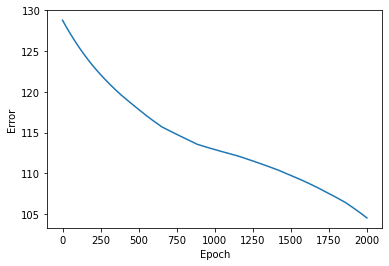

Weight Matrices 
[array([[-0.96019323,  0.48882825],
       [-0.50480803, -1.00562612],
       [ 0.47926441,  0.27027885]]), array([[ 0.61391275,  0.81296379, -0.34826603],
       [ 0.20838751, -0.60910187,  0.6173199 ],
       [-0.50349257, -0.67064023, -0.83858928],
       [-0.17140966, -0.67250744, -0.45019438]]), array([[ 0.00132635, -0.02920225, -0.46972568, -0.11084357],
       [-0.43527374,  0.03738651, -0.40821746,  0.26315474],
       [ 0.27739548, -0.55274943, -0.53480373,  0.22416611],
       [ 0.34736891, -0.07818863,  0.65164149,  0.96399562],
       [-0.92873923,  0.32902559,  0.01182478,  0.59574998]]), array([[-0.43459487, -0.6359979 ,  0.41494043, -0.22540166, -0.28079145],
       [-0.46612743, -0.01218068, -0.85832877, -0.492094  ,  0.81563104]])]


In [123]:
n5_new.train(2000, 0.00001)

### Comments
Negative numbers are causing the weirdest training curves. My guess is that in the beginning itself a lot of numbers 
are cut out from the picture, and they don't contribute to the training. 

And with positive numbers, I worry that there is no non-linear training happening at all, but we only have a linear fit.

We have two options. 
1. Try again with only positive inputs
2. Try with sigmoid function

In [161]:
n5_3 = nn.neural_network(X, Y, [3, 4, 5])

EPOCH: 0   ERROR: 389.4265528069519
dW 
[array([[0.00164309, 0.00204447],
       [0.00058482, 0.00076792]]), array([[0.00077655, 0.00145986],
       [0.00113527, 0.00233036]])]
Weight
[array([[0.25971704, 0.10603676],
       [0.43368188, 0.27962794]]), array([[0.27347503, 0.07874772],
       [0.37978398, 0.15164853]])]
dW 
[array([[0.00164309, 0.00204447],
       [0.00058482, 0.00076792]]), array([[0.00077655, 0.00145986],
       [0.00113527, 0.00233036]])]
Weight
[array([[0.26136012, 0.10808123],
       [0.4342667 , 0.28039586]]), array([[0.27347503, 0.07874772],
       [0.37978398, 0.15164853]])]
EPOCH: 1   ERROR: 387.6994084846582
dW 
[array([[0.00164175, 0.0020445 ],
       [0.00059212, 0.0007779 ]]), array([[0.00078099, 0.00145732],
       [0.00114427, 0.00232741]])]
Weight
[array([[0.26136012, 0.10808123],
       [0.4342667 , 0.28039586]]), array([[0.27425158, 0.08020757],
       [0.38091925, 0.15397889]])]
dW 
[array([[0.00164175, 0.0020445 ],
       [0.00059212, 0.0007779 ]]), 

EPOCH: 16   ERROR: 361.5056894467869
dW 
[array([[0.00161742, 0.00204182],
       [0.00068992, 0.00091561]]), array([[0.00083925, 0.00141762],
       [0.00126632, 0.00228158]])]
Weight
[array([[0.28582709, 0.13873822],
       [0.44386103, 0.29305682]]), array([[0.28639407, 0.10179388],
       [0.39896816, 0.18857429]])]
dW 
[array([[0.00161742, 0.00204182],
       [0.00068992, 0.00091561]]), array([[0.00083925, 0.00141762],
       [0.00126632, 0.00228158]])]
Weight
[array([[0.2874445 , 0.14078003],
       [0.44455094, 0.29397243]]), array([[0.28639407, 0.10179388],
       [0.39896816, 0.18857429]])]
EPOCH: 17   ERROR: 359.7430235245938
dW 
[array([[0.00161545, 0.00204137],
       [0.00069563, 0.00092396]]), array([[0.00084256, 0.00141483],
       [0.00127357, 0.00227834]])]
Weight
[array([[0.2874445 , 0.14078003],
       [0.44455094, 0.29397243]]), array([[0.28723332, 0.1032115 ],
       [0.40023449, 0.19085587]])]
dW 
[array([[0.00161545, 0.00204137],
       [0.00069563, 0.00092396]])

EPOCH: 32   ERROR: 333.1667448172853
dW 
[array([[0.00157959, 0.00202922],
       [0.00076862, 0.0010363 ]]), array([[0.00088297, 0.00136972],
       [0.00136791, 0.00222531]])]
Weight
[array([[0.31144095, 0.17132921],
       [0.45552621, 0.30864896]]), array([[0.30017632, 0.12412627],
       [0.42003251, 0.22467134]])]
dW 
[array([[0.00157959, 0.00202922],
       [0.00076862, 0.0010363 ]]), array([[0.00088297, 0.00136972],
       [0.00136791, 0.00222531]])]
Weight
[array([[0.31302054, 0.17335842],
       [0.45629483, 0.30968525]]), array([[0.30017632, 0.12412627],
       [0.42003251, 0.22467134]])]
EPOCH: 33   ERROR: 331.39114786433476
dW 
[array([[0.00157673, 0.00202799],
       [0.00077263, 0.0010429 ]]), array([[0.00088504, 0.00136647],
       [0.0013732 , 0.00222141]])]
Weight
[array([[0.31302054, 0.17335842],
       [0.45629483, 0.30968525]]), array([[0.30105929, 0.12549599],
       [0.42140042, 0.22689664]])]
dW 
[array([[0.00157673, 0.00202799],
       [0.00077263, 0.0010429 ]]

EPOCH: 50   ERROR: 301.3663689957839
dW 
[array([[0.00151785, 0.00199763],
       [0.0008237 , 0.00113746]]), array([[0.00090762, 0.00130544],
       [0.00144328, 0.00214645]])]
Weight
[array([[0.33938207, 0.20761784],
       [0.4698837 , 0.32821856]]), array([[0.31631924, 0.14825355],
       [0.44535946, 0.26408549]])]
dW 
[array([[0.00151785, 0.00199763],
       [0.0008237 , 0.00113746]]), array([[0.00090762, 0.00130544],
       [0.00144328, 0.00214645]])]
Weight
[array([[0.34089992, 0.20961547],
       [0.4707074 , 0.32935602]]), array([[0.31631924, 0.14825355],
       [0.44535946, 0.26408549]])]
EPOCH: 51   ERROR: 299.61863052433216
dW 
[array([[0.00151376, 0.00199524],
       [0.0008257 , 0.00114197]]), array([[0.0009082 , 0.00130149],
       [0.0014462 , 0.00214147]])]
Weight
[array([[0.34089992, 0.20961547],
       [0.4707074 , 0.32935602]]), array([[0.31722686, 0.14955898],
       [0.44680274, 0.26623193]])]
dW 
[array([[0.00151376, 0.00199524],
       [0.0008257 , 0.00114197]]

EPOCH: 64   ERROR: 277.24291443247597
dW 
[array([[0.00145371, 0.00195755],
       [0.00084139, 0.00118977]]), array([[0.00090818, 0.0012462 ],
       [0.00147178, 0.00207045]])]
Weight
[array([[0.36023208, 0.2353409 ],
       [0.48155606, 0.34451004]]), array([[0.32904849, 0.16615449],
       [0.46578165, 0.29365782]])]
dW 
[array([[0.00145371, 0.00195755],
       [0.00084139, 0.00118977]]), array([[0.00090818, 0.0012462 ],
       [0.00147178, 0.00207045]])]
Weight
[array([[0.36168579, 0.23729844],
       [0.48239745, 0.34569981]]), array([[0.32904849, 0.16615449],
       [0.46578165, 0.29365782]])]
EPOCH: 65   ERROR: 275.5543354253862
dW 
[array([[0.00144856, 0.00195413],
       [0.00084182, 0.00119261]]), array([[0.0009076 , 0.00124164],
       [0.00147279, 0.00206448]])]
Weight
[array([[0.36168579, 0.23729844],
       [0.48239745, 0.34569981]]), array([[0.32995667, 0.16740069],
       [0.46725343, 0.29572827]])]
dW 
[array([[0.00144856, 0.00195413],
       [0.00084182, 0.00119261]]

EPOCH: 78   ERROR: 254.1684114909702
dW 
[array([[0.0013749 , 0.00190273],
       [0.00083743, 0.00121896]]), array([[0.00089269, 0.00117841],
       [0.00147372, 0.00198027]])]
Weight
[array([[0.3800886 , 0.26240754],
       [0.49333441, 0.36138301]]), array([[0.34168053, 0.18317046],
       [0.48642963, 0.32207461]])]
dW 
[array([[0.0013749 , 0.00190273],
       [0.00083743, 0.00121896]]), array([[0.00089269, 0.00117841],
       [0.00147372, 0.00198027]])]
Weight
[array([[0.3814635 , 0.26431028],
       [0.49417185, 0.36260197]]), array([[0.34168053, 0.18317046],
       [0.48642963, 0.32207461]])]
EPOCH: 79   ERROR: 252.57268591557946
dW 
[array([[0.00136872, 0.00189825],
       [0.00083635, 0.00122018]]), array([[0.00089099, 0.00117324],
       [0.00147286, 0.00197328]])]
Weight
[array([[0.3814635 , 0.26431028],
       [0.49417185, 0.36260197]]), array([[0.34257323, 0.18434886],
       [0.48790335, 0.32405489]])]
dW 
[array([[0.00136872, 0.00189825],
       [0.00083635, 0.00122018]]

EPOCH: 92   ERROR: 232.59684935096985
dW 
[array([[0.0012821 , 0.00183332],
       [0.00081309, 0.00122594]]), array([[0.00086217, 0.00110248],
       [0.00145017, 0.00187604]])]
Weight
[array([[0.39874941, 0.2886111 ],
       [0.5049228 , 0.37851871]]), array([[0.35399642, 0.19918353],
       [0.50693712, 0.34913665]])]
dW 
[array([[0.0012821 , 0.00183332],
       [0.00081309, 0.00122594]]), array([[0.00086217, 0.00110248],
       [0.00145017, 0.00187604]])]
Weight
[array([[0.4000315 , 0.29044443],
       [0.50573589, 0.37974465]]), array([[0.35399642, 0.19918353],
       [0.50693712, 0.34913665]])]
EPOCH: 93   ERROR: 231.12426692140517
dW 
[array([[0.00127497, 0.00182783],
       [0.00081062, 0.00122564]]), array([[0.00085946, 0.00109677],
       [0.00144757, 0.00186808]])]
Weight
[array([[0.4000315 , 0.29044443],
       [0.50573589, 0.37974465]]), array([[0.3548586 , 0.20028601],
       [0.50838729, 0.35101268]])]
dW 
[array([[0.00127497, 0.00182783],
       [0.00081062, 0.00122564]

EPOCH: 108   ERROR: 210.27070394976832
dW 
[array([[0.00116117, 0.00173774],
       [0.00076313, 0.00120913]]), array([[0.00081116, 0.00100729],
       [0.00139507, 0.00174151]])]
Weight
[array([[0.4183749 , 0.31724865],
       [0.51758641, 0.39804064]]), array([[0.36742942, 0.2161197 ],
       [0.52976375, 0.37816415]])]
dW 
[array([[0.00116117, 0.00173774],
       [0.00076313, 0.00120913]]), array([[0.00081116, 0.00100729],
       [0.00139507, 0.00174151]])]
Weight
[array([[0.41953607, 0.31898639],
       [0.51834954, 0.39924978]]), array([[0.36742942, 0.2161197 ],
       [0.52976375, 0.37816415]])]
EPOCH: 109   ERROR: 208.9671067974471
dW 
[array([[0.00115317, 0.00173125],
       [0.00075932, 0.00120729]]), array([[0.00080747, 0.00100109],
       [0.00139073, 0.00173264]])]
Weight
[array([[0.41953607, 0.31898639],
       [0.51834954, 0.39924978]]), array([[0.36824058, 0.21712699],
       [0.53115882, 0.37990566]])]
dW 
[array([[0.00115317, 0.00173125],
       [0.00075932, 0.00120729

       [0.00132049, 0.0016037 ]])]
Weight
[array([[0.43596961, 0.34424584],
       [0.52929945, 0.4171185 ]]), array([[0.37918701, 0.23056876],
       [0.5501921 , 0.40333379]])]
EPOCH: 124   ERROR: 190.79532989090998
dW 
[array([[0.00102826, 0.00162806],
       [0.00069389, 0.00116979]]), array([[0.0007464 , 0.00090574],
       [0.00131486, 0.00159421]])]
Weight
[array([[0.43596961, 0.34424584],
       [0.52929945, 0.4171185 ]]), array([[0.37993778, 0.23148097],
       [0.55151259, 0.4049375 ]])]
dW 
[array([[0.00102826, 0.00162806],
       [0.00069389, 0.00116979]]), array([[0.0007464 , 0.00090574],
       [0.00131486, 0.00159421]])]
Weight
[array([[0.43699787, 0.3458739 ],
       [0.52999334, 0.41828829]]), array([[0.37993778, 0.23148097],
       [0.55151259, 0.4049375 ]])]
EPOCH: 125   ERROR: 189.6777319059998
dW 
[array([[0.00101967, 0.00162084],
       [0.00068904, 0.0011667 ]]), array([[0.00074199, 0.00089925],
       [0.00130915, 0.00158469]])]
Weight
[array([[0.43699787, 0.345

       [0.00122252, 0.00144894]])]
Weight
[array([[0.45137801, 0.3694096 ],
       [0.5397924 , 0.43542845]]), array([[0.39065574, 0.24438253],
       [0.57060606, 0.42783951]])]
EPOCH: 140   ERROR: 174.33324339659677
dW 
[array([[0.00088831, 0.00150876],
       [0.00061067, 0.00111294]]), array([[0.00067211, 0.00080119],
       [0.00121592, 0.00143912]])]
Weight
[array([[0.45137801, 0.3694096 ],
       [0.5397924 , 0.43542845]]), array([[0.39133269, 0.24519027],
       [0.57182858, 0.42928844]])]
dW 
[array([[0.00088831, 0.00150876],
       [0.00061067, 0.00111294]]), array([[0.00067211, 0.00080119],
       [0.00121592, 0.00143912]])]
Weight
[array([[0.45226632, 0.37091836],
       [0.54040307, 0.43654138]]), array([[0.39133269, 0.24519027],
       [0.57182858, 0.42928844]])]
EPOCH: 141   ERROR: 173.40412382326488
dW 
[array([[0.00087945, 0.00150109],
       [0.00060514, 0.00110893]]), array([[0.00066726, 0.00079464],
       [0.00120927, 0.00142929]])]
Weight
[array([[0.45226632, 0.37

EPOCH: 154   ERROR: 162.35841159714496
dW 
[array([[0.00076422, 0.00140035],
       [0.00053078, 0.00105309]]), array([[0.00060276, 0.00071003],
       [0.00111939, 0.00130133]])]
Weight
[array([[0.46300739, 0.38982981],
       [0.54782786, 0.45062921]]), array([[0.40029438, 0.25581256],
       [0.58823182, 0.4485404 ]])]
dW 
[array([[0.00076422, 0.00140035],
       [0.00053078, 0.00105309]]), array([[0.00060276, 0.00071003],
       [0.00111939, 0.00130133]])]
Weight
[array([[0.46377162, 0.39123016],
       [0.54835864, 0.45168231]]), array([[0.40029438, 0.25581256],
       [0.58823182, 0.4485404 ]])]
EPOCH: 155   ERROR: 161.58613141647396
dW 
[array([[0.0007554 , 0.00139256],
       [0.00052493, 0.00104856]]), array([[0.00059773, 0.00070359],
       [0.00111226, 0.00129152]])]
Weight
[array([[0.46377162, 0.39123016],
       [0.54835864, 0.45168231]]), array([[0.40089714, 0.25652259],
       [0.5893512 , 0.44984173]])]
dW 
[array([[0.0007554 , 0.00139256],
       [0.00052493, 0.0010485

EPOCH: 169   ERROR: 151.86293663047715
dW 
[array([[0.00063354, 0.00128388],
       [0.00044209, 0.00098274]]), array([[0.00052723, 0.00061529],
       [0.00101096, 0.00115578]])]
Weight
[array([[0.4735508 , 0.410018  ],
       [0.5551703 , 0.46593873]]), array([[0.40880681, 0.26579455],
       [0.60426701, 0.46703638]])]
dW 
[array([[0.00063354, 0.00128388],
       [0.00044209, 0.00098274]]), array([[0.00052723, 0.00061529],
       [0.00101096, 0.00115578]])]
Weight
[array([[0.47418434, 0.41130189],
       [0.55561239, 0.46692147]]), array([[0.40880681, 0.26579455],
       [0.60426701, 0.46703638]])]
EPOCH: 170   ERROR: 151.2427704687901
dW 
[array([[0.000625  , 0.00127619],
       [0.00043615, 0.00097792]]), array([[0.00052222, 0.00060914],
       [0.00100367, 0.00114624]])]
Weight
[array([[0.47418434, 0.41130189],
       [0.55561239, 0.46692147]]), array([[0.40933404, 0.26640984],
       [0.60527798, 0.46819216]])]
dW 
[array([[0.000625  , 0.00127619],
       [0.00043615, 0.00097792

EPOCH: 183   ERROR: 144.00340157443244
dW 
[array([[0.0005167 , 0.0011779 ],
       [0.0003597 , 0.00091463]]), array([[0.00045811, 0.00053157],
       [0.00090931, 0.00102515]])]
Weight
[array([[0.48165361, 0.42729892],
       [0.56082189, 0.4792554 ]]), array([[0.41573598, 0.27385824],
       [0.6177581 , 0.48236069]])]
dW 
[array([[0.0005167 , 0.0011779 ],
       [0.0003597 , 0.00091463]]), array([[0.00045811, 0.00053157],
       [0.00090931, 0.00102515]])]
Weight
[array([[0.48217031, 0.42847682],
       [0.56118158, 0.48017003]]), array([[0.41573598, 0.27385824],
       [0.6177581 , 0.48236069]])]
EPOCH: 184   ERROR: 143.50636830647983
dW 
[array([[0.00050861, 0.0011705 ],
       [0.0003539 , 0.00090975]]), array([[0.00045328, 0.00052581],
       [0.00090212, 0.00101609]])]
Weight
[array([[0.48217031, 0.42847682],
       [0.56118158, 0.48017003]]), array([[0.41619409, 0.27438981],
       [0.6186674 , 0.48338584]])]
dW 
[array([[0.00050861, 0.0011705 ],
       [0.0003539 , 0.0009097

       [0.00080367, 0.00089365]])]
Weight
[array([[0.48857254, 0.44420312],
       [0.56561692, 0.49246504]]), array([[0.42210898, 0.28124115],
       [0.63065203, 0.49680516]])]
dW 
[array([[0.00039957, 0.00106993],
       [0.00027475, 0.00084211]]), array([[0.0003877 , 0.00044852],
       [0.00080367, 0.00089365]])]
Weight
[array([[0.48897211, 0.44527305],
       [0.56589167, 0.49330715]]), array([[0.42210898, 0.28124115],
       [0.63065203, 0.49680516]])]
EPOCH: 199   ERROR: 136.96032121482145
dW 
[array([[0.00039211, 0.00106299],
       [0.00026926, 0.00083736]]), array([[0.00038318, 0.00044326],
       [0.00079682, 0.00088525]])]
Weight
[array([[0.48897211, 0.44527305],
       [0.56589167, 0.49330715]]), array([[0.42249668, 0.28168968],
       [0.6314557 , 0.49769881]])]
dW 
[array([[0.00039211, 0.00106299],
       [0.00026926, 0.00083736]]), array([[0.00038318, 0.00044326],
       [0.00079682, 0.00088525]])]
Weight
[array([[0.48936422, 0.44633604],
       [0.56616094, 0.49414451

EPOCH: 216   ERROR: 131.3089149276057
dW 
[array([[0.00027251, 0.0009507 ],
       [0.00018036, 0.00075907]]), array([[0.00031037, 0.0003594 ],
       [0.0006854 , 0.0007502 ]])]
Weight
[array([[0.49466138, 0.46242991],
       [0.56974591, 0.50690852]]), array([[0.42841726, 0.28853908],
       [0.64409635, 0.51164652]])]
dW 
[array([[0.00027251, 0.0009507 ],
       [0.00018036, 0.00075907]]), array([[0.00031037, 0.0003594 ],
       [0.0006854 , 0.0007502 ]])]
Weight
[array([[0.49493388, 0.46338061],
       [0.56992627, 0.50766759]]), array([[0.42841726, 0.28853908],
       [0.64409635, 0.51164652]])]
EPOCH: 217   ERROR: 131.02566412529072
dW 
[array([[0.00026591, 0.00094445],
       [0.00017541, 0.00075464]]), array([[0.00030634, 0.00035481],
       [0.00067917, 0.00074274]])]
Weight
[array([[0.49493388, 0.46338061],
       [0.56992627, 0.50766759]]), array([[0.42872763, 0.28889848],
       [0.64478175, 0.51239673]])]
dW 
[array([[0.00026591, 0.00094445],
       [0.00017541, 0.00075464

       [0.00060178, 0.00065063]])]
Weight
[array([[0.49807975, 0.47605296],
       [0.57194649, 0.51784004]]), array([[0.43240613, 0.29316636],
       [0.65313918, 0.52148963]])]
EPOCH: 231   ERROR: 127.53852090818735
dW 
[array([[0.00017894, 0.00086131],
       [0.0001096 , 0.0006951 ]]), array([[0.00025298, 0.00029446],
       [0.00059611, 0.00064393]])]
Weight
[array([[0.49807975, 0.47605296],
       [0.57194649, 0.51784004]]), array([[0.43266272, 0.29346488],
       [0.65374095, 0.52214026]])]
dW 
[array([[0.00017894, 0.00086131],
       [0.0001096 , 0.0006951 ]]), array([[0.00025298, 0.00029446],
       [0.00059611, 0.00064393]])]
Weight
[array([[0.49825869, 0.47691427],
       [0.57205609, 0.51853514]]), array([[0.43266272, 0.29346488],
       [0.65374095, 0.52214026]])]
EPOCH: 232   ERROR: 127.3204916665264
dW 
[array([[0.00017311, 0.00085569],
       [0.00010516, 0.00069103]]), array([[0.00024939, 0.00029043],
       [0.00059049, 0.00063728]])]
Weight
[array([[0.49825869, 0.476

EPOCH: 246   ERROR: 124.6309352727857
dW 
[array([[9.67723663e-05, 7.81459756e-04],
       [4.66743679e-05, 6.36874595e-04]]), array([[0.00020237, 0.00023797],
       [0.00051626, 0.00055003]])]
Weight
[array([[0.50017459, 0.48840177],
       [0.57314009, 0.52785148]]), array([[0.43609463, 0.29747601],
       [0.66211162, 0.53112659]])]
dW 
[array([[9.67723663e-05, 7.81459756e-04],
       [4.66743679e-05, 6.36874595e-04]]), array([[0.00020237, 0.00023797],
       [0.00051626, 0.00055003]])]
Weight
[array([[0.50027137, 0.48918323],
       [0.57318677, 0.52848835]]), array([[0.43609463, 0.29747601],
       [0.66211162, 0.53112659]])]
EPOCH: 247   ERROR: 124.4621952147846
dW 
[array([[9.16935380e-05, 7.76475046e-04],
       [4.27623701e-05, 6.33208488e-04]]), array([[0.00019923, 0.00023449],
       [0.00051128, 0.00054421]])]
Weight
[array([[0.50027137, 0.48918323],
       [0.57318677, 0.52848835]]), array([[0.43629699, 0.29771398],
       [0.66262787, 0.53167662]])]
dW 
[array([[9.169353

EPOCH: 260   ERROR: 122.50378173317034
dW 
[array([[ 3.00547792e-05,  7.15442748e-04],
       [-4.91448595e-06,  5.88035126e-04]]), array([[0.00016118, 0.00019252],
       [0.00045043, 0.00047329]])]
Weight
[array([[0.50108487, 0.49890374],
       [0.5734503 , 0.53644406]]), array([[0.43865339, 0.30050424],
       [0.66890165, 0.53831628]])]
dW 
[array([[ 3.00547792e-05,  7.15442748e-04],
       [-4.91448595e-06,  5.88035126e-04]]), array([[0.00016118, 0.00019252],
       [0.00045043, 0.00047329]])]
Weight
[array([[0.50111493, 0.49961918],
       [0.57344538, 0.53703209]]), array([[0.43865339, 0.30050424],
       [0.66890165, 0.53831628]])]
EPOCH: 261   ERROR: 122.369461445223
dW 
[array([[ 2.56430443e-05,  7.11032751e-04],
       [-8.34075116e-06,  5.84750945e-04]]), array([[0.00015845, 0.00018953],
       [0.00044605, 0.00046819]])]
Weight
[array([[0.50111493, 0.49961918],
       [0.57344538, 0.53703209]]), array([[0.43881457, 0.30069676],
       [0.66935208, 0.53878957]])]
dW 
[arra

EPOCH: 273   ERROR: 120.90923761919419
dW 
[array([[-2.37938813e-05,  6.61163838e-04],
       [-4.68576329e-05,  5.47428790e-04]]), array([[0.00012791, 0.00015615],
       [0.00039665, 0.00041092]])]
Weight
[array([[0.50114441, 0.50787177],
       [0.57312874, 0.54384003]]), array([[0.44054413, 0.30278298],
       [0.67442715, 0.54408593]])]
dW 
[array([[-2.37938813e-05,  6.61163838e-04],
       [-4.68576329e-05,  5.47428790e-04]]), array([[0.00012791, 0.00015615],
       [0.00039665, 0.00041092]])]
Weight
[array([[0.50112062, 0.50853293],
       [0.57308188, 0.54438746]]), array([[0.44054413, 0.30278298],
       [0.67442715, 0.54408593]])]
EPOCH: 274   ERROR: 120.79898766901101
dW 
[array([[-2.76300354e-05,  6.57256000e-04],
       [-4.98557499e-05,  5.44489954e-04]]), array([[0.00012554, 0.00015358],
       [0.0003928 , 0.00040646]])]
Weight
[array([[0.50112062, 0.50853293],
       [0.57308188, 0.54438746]]), array([[0.44067204, 0.30293913],
       [0.6748238 , 0.54449685]])]
dW 
[ar

EPOCH: 286   ERROR: 119.59050676170558
dW 
[array([[-7.04516335e-05,  6.13187992e-04],
       [-8.34123989e-05,  5.11207094e-04]]), array([[9.90886972e-05, 1.24927431e-04],
       [3.49548577e-04, 3.56492448e-04]])]
Weight
[array([[0.50054775, 0.51617253],
       [0.57229468, 0.55073469]]), array([[0.44202946, 0.30462036],
       [0.67929405, 0.54909317]])]
dW 
[array([[-7.04516335e-05,  6.13187992e-04],
       [-8.34123989e-05,  5.11207094e-04]]), array([[9.90886972e-05, 1.24927431e-04],
       [3.49548577e-04, 3.56492448e-04]])]
Weight
[array([[0.5004773 , 0.51678572],
       [0.57221127, 0.5512459 ]]), array([[0.44202946, 0.30462036],
       [0.67929405, 0.54909317]])]
EPOCH: 287   ERROR: 119.49841331419323
dW 
[array([[-7.37616746e-05,  6.09743763e-04],
       [-8.60130958e-05,  5.08594772e-04]]), array([[9.70445356e-05, 1.22723400e-04],
       [3.46188306e-04, 3.52614175e-04]])]
Weight
[array([[0.5004773 , 0.51678572],
       [0.57221127, 0.5512459 ]]), array([[0.44212855, 0.30474

dW 
[array([[-0.00011342,  0.00056796],
       [-0.00011725,  0.00047678]]), array([[7.25641083e-05, 9.64505900e-05],
       [3.05720173e-04, 3.05937790e-04]])]
Weight
[array([[0.49916042, 0.52502379],
       [0.57078339, 0.55813928]]), array([[0.44323914, 0.30617841],
       [0.68389492, 0.55374626]])]
EPOCH: 301   ERROR: 118.32311797961269
dW 
[array([[-0.00011622,  0.00056497],
       [-0.00011946,  0.00047449]]), array([[7.08353001e-05, 9.46043639e-05],
       [3.02845482e-04, 3.02623304e-04]])]
Weight
[array([[0.49916042, 0.52502379],
       [0.57078339, 0.55813928]]), array([[0.44331171, 0.30627486],
       [0.68420064, 0.5540522 ]])]
dW 
[array([[-0.00011622,  0.00056497],
       [-0.00011946,  0.00047449]]), array([[7.08353001e-05, 9.46043639e-05],
       [3.02845482e-04, 3.02623304e-04]])]
Weight
[array([[0.4990442 , 0.52558876],
       [0.57066393, 0.55861377]]), array([[0.44331171, 0.30627486],
       [0.68420064, 0.5540522 ]])]
EPOCH: 302   ERROR: 118.2463963712056
dW 
[arr

EPOCH: 315   ERROR: 117.32008155557526
dW 
[array([[-0.00015203,  0.00052614],
       [-0.00014779,  0.00044468]]), array([[4.87574740e-05, 7.11507639e-05],
       [2.65912884e-04, 2.60032038e-04]])]
Weight
[array([[0.49729334, 0.53267447],
       [0.56892119, 0.5645836 ]]), array([[0.44415541, 0.30744182],
       [0.6881934 , 0.55800402]])]
dW 
[array([[-0.00015203,  0.00052614],
       [-0.00014779,  0.00044468]]), array([[4.87574740e-05, 7.11507639e-05],
       [2.65912884e-04, 2.60032038e-04]])]
Weight
[array([[0.49714131, 0.5332006 ],
       [0.5687734 , 0.56502828]]), array([[0.44415541, 0.30744182],
       [0.6881934 , 0.55800402]])]
EPOCH: 316   ERROR: 117.25371116334055
dW 
[array([[-0.00015436,  0.00052357],
       [-0.00014964,  0.0004427 ]]), array([[4.73246796e-05, 6.96374231e-05],
       [2.63500771e-04, 2.57248835e-04]])]
Weight
[array([[0.49714131, 0.5332006 ],
       [0.5687734 , 0.56502828]]), array([[0.44420416, 0.30751297],
       [0.68845932, 0.55826405]])]
dW 
[ar

EPOCH: 329   ERROR: 116.44275795802744
dW 
[array([[-0.00018202,  0.00049254],
       [-0.00017161,  0.0004187 ]]), array([[3.02899254e-05, 5.17433286e-05],
       [2.34659086e-04, 2.23936523e-04]])]
Weight
[array([[0.49496369, 0.53981629],
       [0.56669237, 0.57063601]]), array([[0.44471407, 0.30830743],
       [0.69170686, 0.56140282]])]
dW 
[array([[-0.00018202,  0.00049254],
       [-0.00017161,  0.0004187 ]]), array([[3.02899254e-05, 5.17433286e-05],
       [2.34659086e-04, 2.23936523e-04]])]
Weight
[array([[0.49478167, 0.54030883],
       [0.56652076, 0.5710547 ]]), array([[0.44471407, 0.30830743],
       [0.69170686, 0.56140282]])]
EPOCH: 330   ERROR: 116.38394420421693
dW 
[array([[-0.00018396,  0.00049032],
       [-0.00017316,  0.00041697]]), array([[2.90956906e-05, 5.04964229e-05],
       [2.32624900e-04, 2.21583851e-04]])]
Weight
[array([[0.49478167, 0.54030883],
       [0.56652076, 0.5710547 ]]), array([[0.44474436, 0.30835918],
       [0.69194152, 0.56162676]])]
dW 
[ar

EPOCH: 343   ERROR: 115.65734292362346
dW 
[array([[-0.00020698,  0.0004635 ],
       [-0.0001915 ,  0.00039609]]), array([[1.49388882e-05, 3.58081202e-05],
       [2.08370625e-04, 1.93481619e-04]])]
Weight
[array([[0.49224779, 0.54651813],
       [0.56415631, 0.57634715]]), array([[0.44503501, 0.30892454],
       [0.69481585, 0.5643339 ]])]
dW 
[array([[-0.00020698,  0.0004635 ],
       [-0.0001915 ,  0.00039609]]), array([[1.49388882e-05, 3.58081202e-05],
       [2.08370625e-04, 1.93481619e-04]])]
Weight
[array([[0.49204081, 0.54698163],
       [0.56396481, 0.57674324]]), array([[0.44503501, 0.30892454],
       [0.69481585, 0.5643339 ]])]
EPOCH: 344   ERROR: 115.6040688073607
dW 
[array([[-0.00020858,  0.00046158],
       [-0.00019278,  0.00039459]]), array([[1.39493846e-05, 3.47886927e-05],
       [2.06664847e-04, 1.91500867e-04]])]
Weight
[array([[0.49204081, 0.54698163],
       [0.56396481, 0.57674324]]), array([[0.44504995, 0.30896035],
       [0.69502422, 0.56452738]])]
dW 
[arr

Weight
[array([[0.48875482, 0.55371492],
       [0.56094747, 0.5825129 ]]), array([[0.44516109, 0.30936115],
       [0.69777185, 0.56703891]])]
EPOCH: 359   ERROR: 114.84143391612562
dW 
[array([[-0.00023025,  0.00043511],
       [-0.0002101 ,  0.00037382]]), array([[6.31632317e-07, 2.11854143e-05],
       [1.83550011e-04, 1.64577986e-04]])]
Weight
[array([[0.48875482, 0.55371492],
       [0.56094747, 0.5825129 ]]), array([[0.44516252, 0.30938315],
       [0.6979568 , 0.56720513]])]
dW 
[array([[-0.00023025,  0.00043511],
       [-0.0002101 ,  0.00037382]]), array([[6.31632317e-07, 2.11854143e-05],
       [1.83550011e-04, 1.64577986e-04]])]
Weight
[array([[0.48852457, 0.55415002],
       [0.56073737, 0.58288672]]), array([[0.44516252, 0.30938315],
       [0.6979568 , 0.56720513]])]
EPOCH: 360   ERROR: 114.79275030563599
dW 
[array([[-0.00023154,  0.00043348],
       [-0.00021113,  0.00037254]]), array([[-1.61195206e-07,  2.03835799e-05],
       [ 1.82163807e-04,  1.62957478e-04]])]
Wei

EPOCH: 373   ERROR: 114.18000171724589
dW 
[array([[-0.00024673,  0.00041383],
       [-0.0002233 ,  0.00035701]]), array([[-9.50734713e-06,  1.10194180e-05],
       [ 1.65720844e-04,  1.43664222e-04]])]
Weight
[array([[0.48542042, 0.55966458],
       [0.55791725, 0.5876345 ]]), array([[0.44510312, 0.30961109],
       [0.70040676, 0.56936895]])]
dW 
[array([[-0.00024673,  0.00041383],
       [-0.0002233 ,  0.00035701]]), array([[-9.50734713e-06,  1.10194180e-05],
       [ 1.65720844e-04,  1.43664222e-04]])]
Weight
[array([[0.48517369, 0.56007841],
       [0.55769395, 0.58799151]]), array([[0.44510312, 0.30961109],
       [0.70040676, 0.56936895]])]
EPOCH: 374   ERROR: 114.1342708556648
dW 
[array([[-0.00024778,  0.00041242],
       [-0.00022415,  0.0003559 ]]), array([[-1.01568427e-05,  1.03756240e-05],
       [ 1.64570531e-04,  1.42308744e-04]])]
Weight
[array([[0.48517369, 0.56007841],
       [0.55769395, 0.58799151]]), array([[0.44509361, 0.30962211],
       [0.70057248, 0.56951262]

EPOCH: 386   ERROR: 113.5987613674403
dW 
[array([[-0.0002593 ,  0.0003966 ],
       [-0.0002334 ,  0.00034331]]), array([[-1.72574175e-05,  3.41306523e-06],
       [ 1.51918844e-04,  1.27335154e-04]])]
Weight
[array([[0.48213494, 0.5649386 ],
       [0.55495169, 0.59219164]]), array([[0.44493144, 0.30970696],
       [0.70247569, 0.57113567]])]
dW 
[array([[-0.0002593 ,  0.0003966 ],
       [-0.0002334 ,  0.00034331]]), array([[-1.72574175e-05,  3.41306523e-06],
       [ 1.51918844e-04,  1.27335154e-04]])]
Weight
[array([[0.48187565, 0.5653352 ],
       [0.55471829, 0.59253495]]), array([[0.44493144, 0.30970696],
       [0.70247569, 0.57113567]])]
EPOCH: 387   ERROR: 113.55515068006726
dW 
[array([[-0.00026017,  0.00039537],
       [-0.00023409,  0.00034233]]), array([[-1.77947110e-05,  2.89269182e-06],
       [ 1.50955321e-04,  1.26189122e-04]])]
Weight
[array([[0.48187565, 0.5653352 ],
       [0.55471829, 0.59253495]]), array([[0.44491419, 0.30971038],
       [0.70262761, 0.571263  ]

EPOCH: 401   ERROR: 112.95863993929346
dW 
[array([[-0.00027105,  0.0003793 ],
       [-0.00024285,  0.00032944]]), array([[-2.45347571e-05, -3.53368515e-06],
       [ 1.38780727e-04,  1.11617302e-04]])]
Weight
[array([[0.47815987, 0.57076336],
       [0.55138192, 0.59724182]]), array([[0.44461961, 0.30970731],
       [0.70465909, 0.57293185]])]
dW 
[array([[-0.00027105,  0.0003793 ],
       [-0.00024285,  0.00032944]]), array([[-2.45347571e-05, -3.53368515e-06],
       [ 1.38780727e-04,  1.11617302e-04]])]
Weight
[array([[0.47788882, 0.57114265],
       [0.55113907, 0.59757127]]), array([[0.44461961, 0.30970731],
       [0.70465909, 0.57293185]])]
EPOCH: 402   ERROR: 112.91695122176982
dW 
[array([[-0.00027174,  0.00037823],
       [-0.0002434 ,  0.00032858]]), array([[-2.49641248e-05, -3.93557375e-06],
       [ 1.37999045e-04,  1.10674920e-04]])]
Weight
[array([[0.47788882, 0.57114265],
       [0.55113907, 0.59757127]]), array([[0.44459508, 0.30970377],
       [0.70479787, 0.57304346

       [ 1.28786601e-04,  9.94867547e-05]])]
Weight
[array([[0.47402638, 0.57634525],
       [0.54768465, 0.60209664]]), array([[0.44423932, 0.30962375],
       [0.70653474, 0.57441305]])]
EPOCH: 416   ERROR: 112.34441508554673
dW 
[array([[-0.00028033,  0.00036431],
       [-0.00025032,  0.00031733]]), array([[-3.03348019e-05, -8.85987291e-06],
       [ 1.28146512e-04,  9.87028740e-05]])]
Weight
[array([[0.47402638, 0.57634525],
       [0.54768465, 0.60209664]]), array([[0.44420933, 0.3096152 ],
       [0.70666353, 0.57451254]])]
dW 
[array([[-0.00028033,  0.00036431],
       [-0.00025032,  0.00031733]]), array([[-3.03348019e-05, -8.85987291e-06],
       [ 1.28146512e-04,  9.87028740e-05]])]
Weight
[array([[0.47374605, 0.57670955],
       [0.54743433, 0.60241396]]), array([[0.44420933, 0.3096152 ],
       [0.70666353, 0.57451254]])]
EPOCH: 417   ERROR: 112.30425551937275
dW 
[array([[-0.00028087,  0.00036338],
       [-0.00025076,  0.00031657]]), array([[-3.06758619e-05, -9.16497470e-

EPOCH: 431   ERROR: 111.75111151615256
dW 
[array([[-0.00028758,  0.00035125],
       [-0.00025616,  0.00030668]]), array([[-3.49288002e-05, -1.28650101e-05],
       [ 1.19584263e-04,  8.81080599e-05]])]
Weight
[array([[0.46976836, 0.58171624],
       [0.54388707, 0.60678033]]), array([[0.4437208 , 0.30945279],
       [0.70852345, 0.5759163 ]])]
dW 
[array([[-0.00028758,  0.00035125],
       [-0.00025616,  0.00030668]]), array([[-3.49288002e-05, -1.28650101e-05],
       [ 1.19584263e-04,  8.81080599e-05]])]
Weight
[array([[0.46948078, 0.58206749],
       [0.54363091, 0.60708701]]), array([[0.4437208 , 0.30945279],
       [0.70852345, 0.5759163 ]])]
EPOCH: 432   ERROR: 111.71221094907591
dW 
[array([[-0.000288  ,  0.00035044],
       [-0.0002565 ,  0.00030601]]), array([[-3.51979581e-05, -1.30914068e-05],
       [ 1.19077835e-04,  8.74738518e-05]])]
Weight
[array([[0.46948078, 0.58206749],
       [0.54363091, 0.60708701]]), array([[0.44368587, 0.30943992],
       [0.70864304, 0.57600441

EPOCH: 446   ERROR: 111.17530119433802
dW 
[array([[-0.00029316,  0.00033979],
       [-0.00026065,  0.00029725]]), array([[-3.85428148e-05, -1.57979398e-05],
       [ 1.12729626e-04,  7.94263423e-05]])]
Weight
[array([[0.46541374, 0.58690295],
       [0.54001166, 0.61131312]]), array([[0.44317048, 0.30923808],
       [0.71026731, 0.57717499]])]
dW 
[array([[-0.00029316,  0.00033979],
       [-0.00026065,  0.00029725]]), array([[-3.85428148e-05, -1.57979398e-05],
       [ 1.12729626e-04,  7.94263423e-05]])]
Weight
[array([[0.46512058, 0.58724275],
       [0.53975101, 0.61161038]]), array([[0.44317048, 0.30923808],
       [0.71026731, 0.57717499]])]
EPOCH: 447   ERROR: 111.13747291727971
dW 
[array([[-0.00029348,  0.00033908],
       [-0.00026091,  0.00029666]]), array([[-3.87536908e-05, -1.59606028e-05],
       [ 1.12325580e-04,  7.89069180e-05]])]
Weight
[array([[0.46512058, 0.58724275],
       [0.53975101, 0.61161038]]), array([[0.44313193, 0.30922229],
       [0.71038004, 0.57725442

EPOCH: 462   ERROR: 110.57772055076146
dW 
[array([[-0.00029759,  0.00032904],
       [-0.00026422,  0.00028831]]), array([[-4.15278469e-05, -1.79754501e-05],
       [ 1.06957284e-04,  7.18930600e-05]])]
Weight
[array([[0.46068811, 0.59225717],
       [0.53581296, 0.61600069]]), array([[0.44253034, 0.30896782],
       [0.71202579, 0.57838718]])]
dW 
[array([[-0.00029759,  0.00032904],
       [-0.00026422,  0.00028831]]), array([[-4.15278469e-05, -1.79754501e-05],
       [ 1.06957284e-04,  7.18930600e-05]])]
Weight
[array([[0.46039052, 0.59258621],
       [0.53554875, 0.616289  ]]), array([[0.44253034, 0.30896782],
       [0.71202579, 0.57838718]])]
EPOCH: 463   ERROR: 110.54089359512696
dW 
[array([[-0.00029782,  0.00032841],
       [-0.0002644 ,  0.00028778]]), array([[-4.16888949e-05, -1.80836649e-05],
       [ 1.06642193e-04,  7.14735709e-05]])]
Weight
[array([[0.46039052, 0.59258621],
       [0.53554875, 0.616289  ]]), array([[0.44248881, 0.30894985],
       [0.71213275, 0.57845907

EPOCH: 476   ERROR: 110.06736170704977
dW 
[array([[-0.00030043,  0.00032066],
       [-0.00026648,  0.00028127]]), array([[-4.35465153e-05, -1.92326870e-05],
       [ 1.02973332e-04,  6.65014125e-05]])]
Weight
[array([[0.45650238, 0.59680824],
       [0.53209838, 0.6199905 ]]), array([[0.44193525, 0.30870737],
       [0.71349626, 0.57935746]])]
dW 
[array([[-0.00030043,  0.00032066],
       [-0.00026648,  0.00028127]]), array([[-4.35465153e-05, -1.92326870e-05],
       [ 1.02973332e-04,  6.65014125e-05]])]
Weight
[array([[0.45620195, 0.5971289 ],
       [0.53183189, 0.62027177]]), array([[0.44193525, 0.30870737],
       [0.71349626, 0.57935746]])]
EPOCH: 477   ERROR: 110.03132573066536
dW 
[array([[-0.0003006 ,  0.00032009],
       [-0.00026662,  0.00028079]]), array([[-4.36725430e-05, -1.93026541e-05],
       [ 1.02721832e-04,  6.61535699e-05]])]
Weight
[array([[0.45620195, 0.5971289 ],
       [0.53183189, 0.62027177]]), array([[0.44189171, 0.30868813],
       [0.71359923, 0.57942396

EPOCH: 493   ERROR: 109.46192673945887
dW 
[array([[-0.0003028 ,  0.00031155],
       [-0.00026836,  0.00027353]]), array([[-4.54064345e-05, -2.01136225e-05],
       [ 9.92188051e-05,  6.11769304e-05]])]
Weight
[array([[0.45137463, 0.60218503],
       [0.52755197, 0.62470906]]), array([[0.44117927, 0.30837247],
       [0.71521526, 0.58044368]])]
dW 
[array([[-0.0003028 ,  0.00031155],
       [-0.00026836,  0.00027353]]), array([[-4.54064345e-05, -2.01136225e-05],
       [ 9.92188051e-05,  6.11769304e-05]])]
Weight
[array([[0.45107183, 0.60249658],
       [0.52728362, 0.6249826 ]]), array([[0.44117927, 0.30837247],
       [0.71521526, 0.58044368]])]
EPOCH: 494   ERROR: 109.4267753534984
dW 
[array([[-0.00030291,  0.00031104],
       [-0.00026844,  0.0002731 ]]), array([[-4.54986654e-05, -2.01466900e-05],
       [ 9.90298541e-05,  6.08998441e-05]])]
Weight
[array([[0.45107183, 0.60249658],
       [0.52728362, 0.6249826 ]]), array([[0.44113386, 0.30835236],
       [0.71531448, 0.58050486]

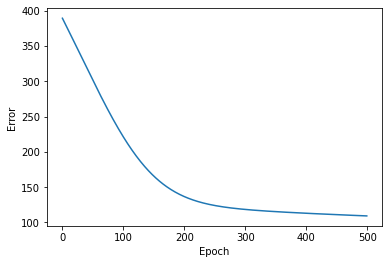

Weight Matrices 
[array([[0.44925284, 0.60435537],
       [0.5256718 , 0.62661484]]), array([[0.44085955, 0.30823105],
       [0.71590594, 0.58086623]])]


In [160]:
n5_3.train(500, 0.00001)

### Comments
Looks like the above is the best I can get with the Relu function.
Lets whip out the test set. 

It is possible that increasing the dataset size might help though, and I have not explored that. 
The issue I have is an average error of 0.2 for every datapoint, which means it is about 0.5 away from the 
right answer. 
Since the values are all in ranges 0 to 1, that seems like too much of an error. 


In [141]:
X_test = np.array([[[random.random()],[random.random()]] for i in range(100)])

In [142]:
Y_test= np.array([[[X[i][0, 0]**1.5],[X[i][1,0]**2*2]] for i in range(100)])

In [143]:
X_test

array([[[0.84285079],
        [0.2333735 ]],

       [[0.61781639],
        [0.31656158]],

       [[0.31032817],
        [0.72682481]],

       [[0.41518095],
        [0.89435369]],

       [[0.50955389],
        [0.89865551]],

       [[0.4540888 ],
        [0.41215807]],

       [[0.70399856],
        [0.08690024]],

       [[0.57069628],
        [0.28817903]],

       [[0.9438708 ],
        [0.32968211]],

       [[0.28929457],
        [0.73666059]],

       [[0.66291899],
        [0.17833246]],

       [[0.35392255],
        [0.11260774]],

       [[0.64524997],
        [0.96706238]],

       [[0.68516061],
        [0.4853681 ]],

       [[0.99038849],
        [0.49537996]],

       [[0.96619897],
        [0.19864834]],

       [[0.02248336],
        [0.3675926 ]],

       [[0.89251447],
        [0.13645786]],

       [[0.5563748 ],
        [0.55368967]],

       [[0.72172519],
        [0.90468479]],

       [[0.26584057],
        [0.4703693 ]],

       [[0.21136123],
        [0.2

In [144]:
Y_test

array([[[2.15113465e-01],
        [1.62678334e+00]],

       [[4.81316685e-01],
        [2.32612403e-02]],

       [[2.77587894e-02],
        [1.38870106e-01]],

       [[2.93450218e-01],
        [7.32926434e-02]],

       [[3.92447815e-01],
        [1.92161819e-01]],

       [[1.92281764e-01],
        [1.23813608e+00]],

       [[7.56139578e-01],
        [5.93737722e-01]],

       [[6.74378948e-01],
        [1.23574626e-01]],

       [[4.94633611e-01],
        [1.53687382e+00]],

       [[3.03560702e-01],
        [2.76578551e-01]],

       [[2.16369253e-01],
        [3.63088574e-01]],

       [[5.79239359e-01],
        [1.18453809e-02]],

       [[9.03449336e-01],
        [7.33084532e-01]],

       [[7.25097105e-01],
        [1.54920525e+00]],

       [[7.49624867e-01],
        [1.53941962e-01]],

       [[4.09546808e-01],
        [1.35313708e+00]],

       [[4.03163277e-01],
        [4.23595232e-01]],

       [[7.58545414e-01],
        [3.66801187e-01]],

       [[5.07801653e-01],
  

In [146]:
n5_3.test(X_test)

[array([[0.16869097],
        [0.4255077 ]]),
 array([[0.20405931],
        [0.51683488]]),
 array([[0.41629692],
        [1.05938216]]),
 array([[0.51382132],
        [1.30739069]]),
 array([[0.52064601],
        [1.32428822]]),
 array([[0.24917411],
        [0.63268032]]),
 array([[0.08795775],
        [0.22073518]]),
 array([[0.18615343],
        [0.47144614]]),
 array([[0.22667556],
        [0.57276138]]),
 array([[0.42074136],
        [1.07082036]]),
 array([[0.12979378],
        [0.32731723]]),
 array([[0.07891019],
        [0.19925608]]),
 array([[0.56484508],
        [1.43622435]]),
 array([[0.30052219],
        [0.76233527]]),
 array([[0.32043902],
        [0.81149134]]),
 array([[0.15531324],
        [0.39076293]]),
 array([[0.20420602],
        [0.52034108]]),
 array([[0.11878294],
        [0.29809666]]),
 array([[0.33221041],
        [0.84377655]]),
 array([[0.53397661],
        [1.35714759]]),
 array([[0.27247278],
        [0.69305202]]),
 array([[0.14850228],
        [0.3

### Comments
As expected, the outputs are no where near the correct answers.
We make two changes. 
1. Sigmoid function
2. Larger dataset

Also found a rule of thumb for number of layers and nodes here: [stack exchange answer](https://stats.stackexchange.com/questions/181/how-to-choose-the-number-of-hidden-layers-and-nodes-in-a-feedforward-neural-netw)

According to this, I should be using only one hidden layer of size 2. 

In [162]:
X = np.array([[[random.random()],[random.random()]] for i in range(500)])
Y = np.array([[[X[i][0, 0]**1.5],[X[i][1,0]**2*2]] for i in range(500)])

In [163]:
n5_sigmoid = nn.neural_network(X, Y, [2], func = "sigmoid")

EPOCH: 0   ERROR: 438.9271737846095
dW 
[array([[1.74828483e-05, 1.78808008e-05],
       [3.71525469e-06, 3.06667007e-06]]), array([[0.00015241, 0.00014957],
       [0.00034923, 0.00036486]])]
Weight
[array([[0.35763463, 0.16220581],
       [0.14107519, 0.43722091]]), array([[0.18935383, 0.05376651],
       [0.10517595, 0.01257789]])]
dW 
[array([[1.74828483e-05, 1.78808008e-05],
       [3.71525469e-06, 3.06667007e-06]]), array([[0.00015241, 0.00014957],
       [0.00034923, 0.00036486]])]
Weight
[array([[0.35765211, 0.16222369],
       [0.14107891, 0.43722398]]), array([[0.18935383, 0.05376651],
       [0.10517595, 0.01257789]])]
EPOCH: 1   ERROR: 438.6259357388194
dW 
[array([[1.75067895e-05, 1.79158497e-05],
       [3.74736026e-06, 3.11040113e-06]]), array([[0.00015232, 0.00014947],
       [0.00034901, 0.00036463]])]
Weight
[array([[0.35765211, 0.16222369],
       [0.14107891, 0.43722398]]), array([[0.18950624, 0.05391607],
       [0.10552518, 0.01294274]])]
dW 
[array([[1.75067895e-

EPOCH: 14   ERROR: 434.7445399059369
dW 
[array([[1.78128821e-05, 1.83655365e-05],
       [4.15903543e-06, 3.67243729e-06]]), array([[0.00015107, 0.00014819],
       [0.00034608, 0.00036162]])]
Weight
[array([[0.35788154, 0.16245931],
       [0.14113011, 0.4372678 ]]), array([[0.19147888, 0.05585147],
       [0.1100447 , 0.01766482]])]
dW 
[array([[1.78128821e-05, 1.83655365e-05],
       [4.15903543e-06, 3.67243729e-06]]), array([[0.00015107, 0.00014819],
       [0.00034608, 0.00036162]])]
Weight
[array([[0.35789936, 0.16247767],
       [0.14113427, 0.43727147]]), array([[0.19147888, 0.05585147],
       [0.1100447 , 0.01766482]])]
EPOCH: 15   ERROR: 434.4486226515483
dW 
[array([[1.78360351e-05, 1.83996735e-05],
       [4.19026772e-06, 3.71517679e-06]]), array([[0.00015098, 0.00014809],
       [0.00034586, 0.00036139]])]
Weight
[array([[0.35789936, 0.16247767],
       [0.14113427, 0.43727147]]), array([[0.19162995, 0.05599966],
       [0.11039078, 0.01802645]])]
dW 
[array([[1.78360351

EPOCH: 28   ERROR: 430.6357650021424
dW 
[array([[1.81319917e-05, 1.88376251e-05],
       [4.59070672e-06, 4.26444769e-06]]), array([[0.00014975, 0.00014683],
       [0.00034296, 0.00035841]])]
Weight
[array([[0.35813301, 0.16271951],
       [0.14119115, 0.43732307]]), array([[0.19358528, 0.05791729],
       [0.1148695 , 0.02270664]])]
dW 
[array([[1.81319917e-05, 1.88376251e-05],
       [4.59070672e-06, 4.26444769e-06]]), array([[0.00014975, 0.00014683],
       [0.00034296, 0.00035841]])]
Weight
[array([[0.35815114, 0.16273834],
       [0.14119574, 0.43732734]]), array([[0.19358528, 0.05791729],
       [0.1148695 , 0.02270664]])]
EPOCH: 29   ERROR: 430.34507164579355
dW 
[array([[1.81543735e-05, 1.88708686e-05],
       [4.62108359e-06, 4.30621479e-06]]), array([[0.00014965, 0.00014673],
       [0.00034273, 0.00035819]])]
Weight
[array([[0.35815114, 0.16273834],
       [0.14119574, 0.43732734]]), array([[0.19373502, 0.05806412],
       [0.11521245, 0.02306505]])]
dW 
[array([[1.8154373

EPOCH: 42   ERROR: 426.59950533185264
dW 
[array([[1.84404119e-05, 1.92973219e-05],
       [5.01051654e-06, 4.84296729e-06]]), array([[0.00014843, 0.00014548],
       [0.00033986, 0.00035524]])]
Weight
[array([[0.35838888, 0.16298624],
       [0.14125817, 0.43738655]]), array([[0.19567319, 0.05996413],
       [0.11965073, 0.02770373]])]
dW 
[array([[1.84404119e-05, 1.92973219e-05],
       [5.01051654e-06, 4.84296729e-06]]), array([[0.00014843, 0.00014548],
       [0.00033986, 0.00035524]])]
Weight
[array([[0.35840732, 0.16300553],
       [0.14126318, 0.4373914 ]]), array([[0.19567319, 0.05996413],
       [0.11965073, 0.02770373]])]
EPOCH: 43   ERROR: 426.31394093542843
dW 
[array([[1.84620390e-05, 1.93296899e-05],
       [5.04005552e-06, 4.88378082e-06]]), array([[0.00014834, 0.00014539],
       [0.00033964, 0.00035501]])]
Weight
[array([[0.35840732, 0.16300553],
       [0.14126318, 0.4373914 ]]), array([[0.19582162, 0.06010961],
       [0.11999059, 0.02805897]])]
dW 
[array([[1.846203

EPOCH: 56   ERROR: 422.63444421335305
dW 
[array([[1.87383729e-05, 1.97448773e-05],
       [5.41870809e-06, 5.40825714e-06]]), array([[0.00014713, 0.00014414],
       [0.00033679, 0.00035209]])]
Weight
[array([[0.35864899, 0.16325932],
       [0.14133098, 0.43745804]]), array([[0.19774278, 0.06199216],
       [0.12438879, 0.03265652]])]
dW 
[array([[1.87383729e-05, 1.97448773e-05],
       [5.41870809e-06, 5.40825714e-06]]), array([[0.00014713, 0.00014414],
       [0.00033679, 0.00035209]])]
Weight
[array([[0.35866773, 0.16327907],
       [0.1413364 , 0.43746345]]), array([[0.19774278, 0.06199216],
       [0.12438879, 0.03265652]])]
EPOCH: 57   ERROR: 422.3539157459757
dW 
[array([[1.87592616e-05, 1.97763875e-05],
       [5.44742638e-06, 5.44813554e-06]]), array([[0.00014704, 0.00014405],
       [0.00033657, 0.00035186]])]
Weight
[array([[0.35866773, 0.16327907],
       [0.1413364 , 0.43746345]]), array([[0.19788991, 0.0621363 ],
       [0.12472558, 0.03300861]])]
dW 
[array([[1.8759261

EPOCH: 70   ERROR: 418.739291362154
dW 
[array([[1.90261004e-05, 2.01805367e-05],
       [5.81551989e-06, 5.96057334e-06]]), array([[0.00014584, 0.00014282],
       [0.00033375, 0.00034897]])]
Weight
[array([[0.35891321, 0.16353859],
       [0.14140943, 0.43753736]]), array([[0.19979422, 0.06400156],
       [0.12908406, 0.03756541]])]
dW 
[array([[1.90261004e-05, 2.01805367e-05],
       [5.81551989e-06, 5.96057334e-06]]), array([[0.00014584, 0.00014282],
       [0.00033375, 0.00034897]])]
Weight
[array([[0.35893223, 0.16355878],
       [0.14141525, 0.43754332]]), array([[0.19979422, 0.06400156],
       [0.12908406, 0.03756541]])]
EPOCH: 71   ERROR: 418.4637076536565
dW 
[array([[1.90462667e-05, 2.02112064e-05],
       [5.84343434e-06, 5.99953472e-06]]), array([[0.00014575, 0.00014273],
       [0.00033353, 0.00034874]])]
Weight
[array([[0.35893223, 0.16355878],
       [0.14141525, 0.43754332]]), array([[0.19994006, 0.06414437],
       [0.12941781, 0.03791438]])]
dW 
[array([[1.90462667e

EPOCH: 85   ERROR: 414.64205394462766
dW 
[array([[1.93232752e-05, 2.06343872e-05],
       [6.22831302e-06, 6.53822934e-06]]), array([[0.00014447, 0.00014141],
       [0.00033052, 0.00034565]])]
Weight
[array([[0.35920069, 0.1638445 ],
       [0.14149957, 0.43763083]]), array([[0.20197221, 0.06613399],
       [0.13406767, 0.04277667]])]
dW 
[array([[1.93232752e-05, 2.06343872e-05],
       [6.22831302e-06, 6.53822934e-06]]), array([[0.00014447, 0.00014141],
       [0.00033052, 0.00034565]])]
Weight
[array([[0.35922002, 0.16386513],
       [0.1415058 , 0.43763737]]), array([[0.20197221, 0.06613399],
       [0.13406767, 0.04277667]])]
EPOCH: 86   ERROR: 414.37166908292534
dW 
[array([[1.93426847e-05, 2.06641754e-05],
       [6.25538457e-06, 6.57622792e-06]]), array([[0.00014438, 0.00014132],
       [0.00033031, 0.00034543]])]
Weight
[array([[0.35922002, 0.16386513],
       [0.1415058 , 0.43763737]]), array([[0.20211668, 0.0662754 ],
       [0.13439819, 0.04312233]])]
dW 
[array([[1.934268

EPOCH: 99   ERROR: 410.88771699369676
dW 
[array([[1.95905038e-05, 2.10461658e-05],
       [6.60229153e-06, 7.06446567e-06]]), array([[0.0001432 , 0.00014011],
       [0.00032754, 0.00034259]])]
Weight
[array([[0.35947297, 0.16413607],
       [0.14158921, 0.4377258 ]]), array([[0.20398654, 0.06810531],
       [0.13867553, 0.04759589]])]
dW 
[array([[1.95905038e-05, 2.10461658e-05],
       [6.60229153e-06, 7.06446567e-06]]), array([[0.0001432 , 0.00014011],
       [0.00032754, 0.00034259]])]
Weight
[array([[0.35949256, 0.16415711],
       [0.14159581, 0.43773287]]), array([[0.20398654, 0.06810531],
       [0.13867553, 0.04759589]])]
EPOCH: 100   ERROR: 410.6220937643331
dW 
[array([[1.96092229e-05, 2.10751484e-05],
       [6.62859315e-06, 7.10158367e-06]]), array([[0.00014311, 0.00014002],
       [0.00032732, 0.00034237]])]
Weight
[array([[0.35949256, 0.16415711],
       [0.14159581, 0.43773287]]), array([[0.20412974, 0.06824542],
       [0.13900306, 0.04793848]])]
dW 
[array([[1.960922

EPOCH: 113   ERROR: 407.1994836618056
dW 
[array([[1.98481649e-05, 2.14467736e-05],
       [6.96559460e-06, 7.57848537e-06]]), array([[0.00014195, 0.00013882],
       [0.00032458, 0.00033956]])]
Weight
[array([[0.35974892, 0.16443333],
       [0.14168402, 0.43782806]]), array([[0.20598319, 0.0700585 ],
       [0.14324176, 0.05237242]])]
dW 
[array([[1.98481649e-05, 2.14467736e-05],
       [6.96559460e-06, 7.57848537e-06]]), array([[0.00014195, 0.00013882],
       [0.00032458, 0.00033956]])]
Weight
[array([[0.35976877, 0.16445478],
       [0.14169098, 0.43783564]]), array([[0.20598319, 0.0700585 ],
       [0.14324176, 0.05237242]])]
EPOCH: 114   ERROR: 406.93853633341183
dW 
[array([[1.98662087e-05, 2.14749670e-05],
       [6.99114217e-06, 7.61473988e-06]]), array([[0.00014186, 0.00013873],
       [0.00032437, 0.00033934]])]
Weight
[array([[0.35976877, 0.16445478],
       [0.14169098, 0.43783564]]), array([[0.20612514, 0.07019732],
       [0.14356634, 0.05271197]])]
dW 
[array([[1.98662

EPOCH: 130   ERROR: 402.8080723234927
dW 
[array([[2.01484766e-05, 2.19185345e-05],
       [7.39271358e-06, 8.18656951e-06]]), array([[0.00014044, 0.00013727],
       [0.00032102, 0.00033591]])]
Weight
[array([[0.36008876, 0.16480172],
       [0.14180587, 0.43796179]]), array([[0.20838417, 0.07240609],
       [0.14873106, 0.05811565]])]
dW 
[array([[2.01484766e-05, 2.19185345e-05],
       [7.39271358e-06, 8.18656951e-06]]), array([[0.00014044, 0.00013727],
       [0.00032102, 0.00033591]])]
Weight
[array([[0.36010891, 0.16482364],
       [0.14181326, 0.43796997]]), array([[0.20838417, 0.07240609],
       [0.14873106, 0.05811565]])]
EPOCH: 131   ERROR: 402.552690043187
dW 
[array([[2.01657201e-05, 2.19457911e-05],
       [7.41736645e-06, 8.22179801e-06]]), array([[0.00014035, 0.00013718],
       [0.00032081, 0.0003357 ]])]
Weight
[array([[0.36010891, 0.16482364],
       [0.14181326, 0.43796997]]), array([[0.2085246 , 0.07254337],
       [0.14905208, 0.05845156]])]
dW 
[array([[2.0165720

EPOCH: 143   ERROR: 399.51322119630515
dW 
[array([[2.03690425e-05, 2.22686524e-05],
       [7.70917270e-06, 8.63991544e-06]]), array([[0.00013929, 0.0001361 ],
       [0.00031832, 0.00033315]])]
Weight
[array([[0.36035202, 0.16508877],
       [0.14190388, 0.43807094]]), array([[0.21020295, 0.07418361],
       [0.15288812, 0.06246587]])]
dW 
[array([[2.03690425e-05, 2.22686524e-05],
       [7.70917270e-06, 8.63991544e-06]]), array([[0.00013929, 0.0001361 ],
       [0.00031832, 0.00033315]])]
Weight
[array([[0.36037239, 0.16511104],
       [0.14191159, 0.43807958]]), array([[0.21020295, 0.07418361],
       [0.15288812, 0.06246587]])]
EPOCH: 144   ERROR: 399.26201275276077
dW 
[array([[2.03856883e-05, 2.22952083e-05],
       [7.73315655e-06, 8.67437568e-06]]), array([[0.0001392 , 0.00013601],
       [0.00031812, 0.00033294]])]
Weight
[array([[0.36037239, 0.16511104],
       [0.14191159, 0.43807958]]), array([[0.21034224, 0.07431971],
       [0.15320645, 0.06279902]])]
dW 
[array([[2.0385

EPOCH: 159   ERROR: 395.53183778308215
dW 
[array([[2.06299590e-05, 2.26871896e-05],
       [8.08684564e-06, 9.18430295e-06]]), array([[0.00013789, 0.00013467],
       [0.00031504, 0.00032978]])]
Weight
[array([[0.3606799 , 0.16544823],
       [0.14203008, 0.43821328]]), array([[0.21242111, 0.07635048],
       [0.15795663, 0.06777092]])]
dW 
[array([[2.06299590e-05, 2.26871896e-05],
       [8.08684564e-06, 9.18430295e-06]]), array([[0.00013789, 0.00013467],
       [0.00031504, 0.00032978]])]
Weight
[array([[0.36070053, 0.16547092],
       [0.14203817, 0.43822247]]), array([[0.21242111, 0.07635048],
       [0.15795663, 0.06777092]])]
EPOCH: 160   ERROR: 395.2856711376151
dW 
[array([[2.06458859e-05, 2.27129013e-05],
       [8.11002376e-06, 9.21783669e-06]]), array([[0.00013781, 0.00013458],
       [0.00031483, 0.00032957]])]
Weight
[array([[0.36070053, 0.16547092],
       [0.14203817, 0.43822247]]), array([[0.21255901, 0.07648515],
       [0.15827167, 0.0681007 ]])]
dW 
[array([[2.06458

EPOCH: 175   ERROR: 391.63034832768193
dW 
[array([[2.08795087e-05, 2.30923676e-05],
       [8.45177076e-06, 9.71402139e-06]]), array([[0.00013651, 0.00013325],
       [0.00031179, 0.00032644]])]
Weight
[array([[0.36101187, 0.16581428],
       [0.14216222, 0.43836422]]), array([[0.21461705, 0.07849456],
       [0.16297281, 0.07302233]])]
dW 
[array([[2.08795087e-05, 2.30923676e-05],
       [8.45177076e-06, 9.71402139e-06]]), array([[0.00013651, 0.00013325],
       [0.00031179, 0.00032644]])]
Weight
[array([[0.36103275, 0.16583737],
       [0.14217068, 0.43837394]]), array([[0.21461705, 0.07849456],
       [0.16297281, 0.07302233]])]
EPOCH: 176   ERROR: 391.38912057933544
dW 
[array([[2.08947346e-05, 2.31172549e-05],
       [8.47416225e-06, 9.74664921e-06]]), array([[0.00013643, 0.00013317],
       [0.00031158, 0.00032624]])]
Weight
[array([[0.36103275, 0.16583737],
       [0.14217068, 0.43837394]]), array([[0.21475356, 0.07862782],
       [0.1632846 , 0.07334877]])]
dW 
[array([[2.0894

EPOCH: 190   ERROR: 388.04381248292515
dW 
[array([[2.11033919e-05, 2.34603666e-05],
       [8.78257960e-06, 1.01976001e-05]]), array([[0.00013523, 0.00013194],
       [0.00030877, 0.00032335]])]
Weight
[array([[0.36132664, 0.16616326],
       [0.14229133, 0.43851334]]), array([[0.21665574, 0.08048415],
       [0.16762843, 0.0778973 ]])]
dW 
[array([[2.11033919e-05, 2.34603666e-05],
       [8.78257960e-06, 1.01976001e-05]]), array([[0.00013523, 0.00013194],
       [0.00030877, 0.00032335]])]
Weight
[array([[0.36134774, 0.16618672],
       [0.14230011, 0.43852353]]), array([[0.21665574, 0.08048415],
       [0.16762843, 0.0778973 ]])]
EPOCH: 191   ERROR: 387.8071235144772
dW 
[array([[2.11179769e-05, 2.34844983e-05],
       [8.80425061e-06, 1.02293970e-05]]), array([[0.00013514, 0.00013185],
       [0.00030857, 0.00032315]])]
Weight
[array([[0.36134774, 0.16618672],
       [0.14230011, 0.43852353]]), array([[0.21679097, 0.08061608],
       [0.1679372 , 0.07822065]])]
dW 
[array([[2.11179

EPOCH: 205   ERROR: 384.52474973512506
dW 
[array([[2.13177660e-05, 2.38171497e-05],
       [9.10269434e-06, 1.06688362e-05]]), array([[0.00013396, 0.00013064],
       [0.00030578, 0.00032029]])]
Weight
[array([[0.3616447 , 0.16651767],
       [0.14242532, 0.43866961]]), array([[0.21867528, 0.08245409],
       [0.17223895, 0.08272607]])]
dW 
[array([[2.13177660e-05, 2.38171497e-05],
       [9.10269434e-06, 1.06688362e-05]]), array([[0.00013396, 0.00013064],
       [0.00030578, 0.00032029]])]
Weight
[array([[0.36166602, 0.16654149],
       [0.14243443, 0.43868028]]), array([[0.21867528, 0.08245409],
       [0.17223895, 0.08272607]])]
EPOCH: 206   ERROR: 384.2925129234351
dW 
[array([[2.13317250e-05, 2.38405425e-05],
       [9.12366098e-06, 1.06998194e-05]]), array([[0.00013387, 0.00013055],
       [0.00030558, 0.00032008]])]
Weight
[array([[0.36166602, 0.16654149],
       [0.14243443, 0.43868028]]), array([[0.21880924, 0.08258473],
       [0.17254473, 0.08304635]])]
dW 
[array([[2.13317

EPOCH: 221   ERROR: 380.84400373444225
dW 
[array([[2.15362043e-05, 2.41856333e-05],
       [9.43263211e-06, 1.11581743e-05]]), array([[0.00013262, 0.00012926],
       [0.00030262, 0.00031705]])]
Weight
[array([[0.36198744, 0.16690153],
       [0.14257346, 0.438844  ]]), array([[0.22080853, 0.08453393],
       [0.17710761, 0.08782631]])]
dW 
[array([[2.15362043e-05, 2.41856333e-05],
       [9.43263211e-06, 1.11581743e-05]]), array([[0.00013262, 0.00012926],
       [0.00030262, 0.00031705]])]
Weight
[array([[0.36200897, 0.16692571],
       [0.14258289, 0.43885516]]), array([[0.22080853, 0.08453393],
       [0.17710761, 0.08782631]])]
EPOCH: 222   ERROR: 380.61642241403206
dW 
[array([[2.15495121e-05, 2.42082559e-05],
       [9.45286478e-06, 1.11883084e-05]]), array([[0.00013253, 0.00012917],
       [0.00030242, 0.00031685]])]
Weight
[array([[0.36200897, 0.16692571],
       [0.14258289, 0.43885516]]), array([[0.22094114, 0.08466319],
       [0.17741023, 0.08814336]])]
dW 
[array([[2.1549

EPOCH: 235   ERROR: 377.6839224925589
dW 
[array([[2.17188836e-05, 2.44980487e-05],
       [9.71179311e-06, 1.15753075e-05]]), array([[0.00013145, 0.00012807],
       [0.00029988, 0.00031424]])]
Weight
[array([[0.36229014, 0.16724217],
       [0.14270734, 0.43900294]]), array([[0.22265757, 0.08633581],
       [0.1813264 , 0.09224673]])]
dW 
[array([[2.17188836e-05, 2.44980487e-05],
       [9.71179311e-06, 1.15753075e-05]]), array([[0.00013145, 0.00012807],
       [0.00029988, 0.00031424]])]
Weight
[array([[0.36231186, 0.16726667],
       [0.14271705, 0.43901452]]), array([[0.22265757, 0.08633581],
       [0.1813264 , 0.09224673]])]
EPOCH: 236   ERROR: 377.4603371920943
dW 
[array([[2.17316351e-05, 2.45200121e-05],
       [9.73139796e-06, 1.16047143e-05]]), array([[0.00013137, 0.00012798],
       [0.00029968, 0.00031404]])]
Weight
[array([[0.36231186, 0.16726667],
       [0.14271705, 0.43901452]]), array([[0.22278902, 0.08646388],
       [0.18162628, 0.09256098]])]
dW 
[array([[2.173163

EPOCH: 250   ERROR: 374.3596627387641
dW 
[array([[2.19060641e-05, 2.48226426e-05],
       [1.00012409e-05, 1.20110437e-05]]), array([[0.00013022, 0.0001268 ],
       [0.00029697, 0.00031127]])]
Weight
[array([[0.36261725, 0.16761192],
       [0.14285505, 0.43917963]]), array([[0.22462068, 0.08824795],
       [0.18580416, 0.0969395 ]])]
dW 
[array([[2.19060641e-05, 2.48226426e-05],
       [1.00012409e-05, 1.20110437e-05]]), array([[0.00013022, 0.0001268 ],
       [0.00029697, 0.00031127]])]
Weight
[array([[0.36263915, 0.16763675],
       [0.14286505, 0.43919165]]), array([[0.22462068, 0.08824795],
       [0.18580416, 0.0969395 ]])]
EPOCH: 251   ERROR: 374.1402802195881
dW 
[array([[2.19182335e-05, 2.48439149e-05],
       [1.00201877e-05, 1.20396869e-05]]), array([[0.00013013, 0.00012672],
       [0.00029678, 0.00031107]])]
Weight
[array([[0.36263915, 0.16763675],
       [0.14286505, 0.43919165]]), array([[0.22475089, 0.08837475],
       [0.18610113, 0.09725077]])]
dW 
[array([[2.191823

EPOCH: 266   ERROR: 370.8826248003777
dW 
[array([[2.20962109e-05, 2.51575733e-05],
       [1.02992259e-05, 1.24633351e-05]]), array([[0.00012891, 0.00012546],
       [0.0002939 , 0.00030812]])]
Weight
[array([[0.36296918, 0.16801161],
       [0.14301732, 0.43937522]]), array([[0.22669432, 0.09026673],
       [0.19053259, 0.10189612]])]
dW 
[array([[2.20962109e-05, 2.51575733e-05],
       [1.02992259e-05, 1.24633351e-05]]), array([[0.00012891, 0.00012546],
       [0.0002939 , 0.00030812]])]
Weight
[array([[0.36299128, 0.16803677],
       [0.14302762, 0.43938768]]), array([[0.22669432, 0.09026673],
       [0.19053259, 0.10189612]])]
EPOCH: 267   ERROR: 370.6676373667724
dW 
[array([[2.21077746e-05, 2.51781252e-05],
       [1.03174871e-05, 1.24911815e-05]]), array([[0.00012883, 0.00012538],
       [0.00029371, 0.00030792]])]
Weight
[array([[0.36299128, 0.16803677],
       [0.14302762, 0.43938768]]), array([[0.22682323, 0.09039219],
       [0.19082648, 0.10220424]])]
dW 
[array([[2.210777

EPOCH: 281   ERROR: 367.68618737852535
dW 
[array([[2.22657744e-05, 2.54612141e-05],
       [1.05687324e-05, 1.28758967e-05]]), array([[0.0001277 , 0.00012422],
       [0.00029105, 0.0003052 ]])]
Weight
[array([[0.36330182, 0.16839111],
       [0.14317371, 0.43956507]]), array([[0.22861946, 0.09213999],
       [0.19492105, 0.10649745]])]
dW 
[array([[2.22657744e-05, 2.54612141e-05],
       [1.05687324e-05, 1.28758967e-05]]), array([[0.0001277 , 0.00012422],
       [0.00029105, 0.0003052 ]])]
Weight
[array([[0.36332409, 0.16841658],
       [0.14318428, 0.43957795]]), array([[0.22861946, 0.09213999],
       [0.19492105, 0.10649745]])]
EPOCH: 282   ERROR: 367.4752396509037
dW 
[array([[2.22767844e-05, 2.54811061e-05],
       [1.05863659e-05, 1.29030124e-05]]), array([[0.00012762, 0.00012414],
       [0.00029086, 0.00030501]])]
Weight
[array([[0.36332409, 0.16841658],
       [0.14318428, 0.43957795]]), array([[0.22874716, 0.09226421],
       [0.1952121 , 0.10680266]])]
dW 
[array([[2.22767

EPOCH: 296   ERROR: 364.5498082770715
dW 
[array([[2.24271268e-05, 2.57550597e-05],
       [1.08289230e-05, 1.32776052e-05]]), array([[0.0001265 , 0.00012299],
       [0.00028822, 0.00030231]])]
Weight
[array([[0.36363695, 0.1687751 ],
       [0.14333407, 0.43976104]]), array([[0.23052649, 0.09399471],
       [0.19926693, 0.11105519]])]
dW 
[array([[2.24271268e-05, 2.57550597e-05],
       [1.08289230e-05, 1.32776052e-05]]), array([[0.0001265 , 0.00012299],
       [0.00028822, 0.00030231]])]
Weight
[array([[0.36365938, 0.16880086],
       [0.1433449 , 0.43977431]]), array([[0.23052649, 0.09399471],
       [0.19926693, 0.11105519]])]
EPOCH: 297   ERROR: 364.3428237787509
dW 
[array([[2.24375966e-05, 2.57743064e-05],
       [1.08459430e-05, 1.33040055e-05]]), array([[0.00012642, 0.00012291],
       [0.00028803, 0.00030212]])]
Weight
[array([[0.36365938, 0.16880086],
       [0.1433449 , 0.43977431]]), array([[0.23065299, 0.0941177 ],
       [0.19955515, 0.1113575 ]])]
dW 
[array([[2.243759

EPOCH: 311   ERROR: 361.4723511337846
dW 
[array([[2.25804669e-05, 2.60393277e-05],
       [1.10800087e-05, 1.36686891e-05]]), array([[0.00012531, 0.00012177],
       [0.00028542, 0.00029944]])]
Weight
[array([[0.36397444, 0.16916343],
       [0.14349828, 0.43996295]]), array([[0.23241558, 0.09583106],
       [0.20357061, 0.11556973]])]
dW 
[array([[2.25804669e-05, 2.60393277e-05],
       [1.10800087e-05, 1.36686891e-05]]), array([[0.00012531, 0.00012177],
       [0.00028542, 0.00029944]])]
Weight
[array([[0.36399702, 0.16918947],
       [0.14350936, 0.43997662]]), array([[0.23241558, 0.09583106],
       [0.20357061, 0.11556973]])]
EPOCH: 312   ERROR: 361.2692549227459
dW 
[array([[2.25904095e-05, 2.60579436e-05],
       [1.10964291e-05, 1.36943891e-05]]), array([[0.00012523, 0.00012169],
       [0.00028524, 0.00029925]])]
Weight
[array([[0.36399702, 0.16918947],
       [0.14350936, 0.43997662]]), array([[0.23254089, 0.09595283],
       [0.20385603, 0.11586918]])]
dW 
[array([[2.259040

EPOCH: 326   ERROR: 358.45270235363733
dW 
[array([[2.27259892e-05, 2.63142318e-05],
       [1.13221965e-05, 1.40493728e-05]]), array([[0.00012413, 0.00012057],
       [0.00028265, 0.00029661]])]
Weight
[array([[0.36431417, 0.16955595],
       [0.14366618, 0.44017066]]), array([[0.2342869 , 0.09764921],
       [0.20783249, 0.1200415 ]])]
dW 
[array([[2.27259892e-05, 2.63142318e-05],
       [1.13221965e-05, 1.40493728e-05]]), array([[0.00012413, 0.00012057],
       [0.00028265, 0.00029661]])]
Weight
[array([[0.3643369 , 0.16958227],
       [0.1436775 , 0.44018471]]), array([[0.2342869 , 0.09764921],
       [0.20783249, 0.1200415 ]])]
EPOCH: 327   ERROR: 358.2534209866074
dW 
[array([[2.27354174e-05, 2.63322309e-05],
       [1.13380309e-05, 1.40743873e-05]]), array([[0.00012405, 0.00012049],
       [0.00028247, 0.00029642]])]
Weight
[array([[0.3643369 , 0.16958227],
       [0.1436775 , 0.44018471]]), array([[0.23441102, 0.09776978],
       [0.20811514, 0.12033811]])]
dW 
[array([[2.27354

[array([[0.36465604, 0.16995254],
       [0.14383766, 0.440384  ]]), array([[0.23601756, 0.09932989],
       [0.21177289, 0.12417691]])]
EPOCH: 341   ERROR: 355.48977057743224
dW 
[array([[2.28638843e-05, 2.65799810e-05],
       [1.15556891e-05, 1.44198760e-05]]), array([[0.00012296, 0.00011937],
       [0.0002799 , 0.0002938 ]])]
Weight
[array([[0.36465604, 0.16995254],
       [0.14383766, 0.440384  ]]), array([[0.2361406 , 0.09944934],
       [0.21205297, 0.12447089]])]
dW 
[array([[2.28638843e-05, 2.65799810e-05],
       [1.15556891e-05, 1.44198760e-05]]), array([[0.00012296, 0.00011937],
       [0.0002799 , 0.0002938 ]])]
Weight
[array([[0.3646789 , 0.16997912],
       [0.14384922, 0.44039842]]), array([[0.2361406 , 0.09944934],
       [0.21205297, 0.12447089]])]
EPOCH: 342   ERROR: 355.29423207501634
dW 
[array([[2.28728107e-05, 2.65973771e-05],
       [1.15709510e-05, 1.44442195e-05]]), array([[0.00012288, 0.00011929],
       [0.00027972, 0.00029361]])]
Weight
[array([[0.3646789 

EPOCH: 355   ERROR: 352.77459500748085
dW 
[array([[2.29858696e-05, 2.68199348e-05],
       [1.17659458e-05, 1.47566842e-05]]), array([[0.00012188, 0.00011827],
       [0.00027736, 0.0002912 ]])]
Weight
[array([[0.36497693, 0.17032623],
       [0.14400081, 0.44058808]]), array([[0.23785497, 0.10111335],
       [0.21595506, 0.12856711]])]
dW 
[array([[2.29858696e-05, 2.68199348e-05],
       [1.17659458e-05, 1.47566842e-05]]), array([[0.00012188, 0.00011827],
       [0.00027736, 0.0002912 ]])]
Weight
[array([[0.36499992, 0.17035305],
       [0.14401258, 0.44060284]]), array([[0.23785497, 0.10111335],
       [0.21595506, 0.12856711]])]
EPOCH: 356   ERROR: 352.58248616598456
dW 
[array([[2.29943387e-05, 2.68367804e-05],
       [1.17806851e-05, 1.47804143e-05]]), array([[0.0001218 , 0.00011819],
       [0.00027718, 0.00029101]])]
Weight
[array([[0.36499992, 0.17035305],
       [0.14401258, 0.44060284]]), array([[0.23797685, 0.10123161],
       [0.21623242, 0.12885831]])]
dW 
[array([[2.2994

EPOCH: 368   ERROR: 350.29601950075397
dW 
[array([[2.30934680e-05, 2.70359111e-05],
       [1.19546954e-05, 1.50618124e-05]]), array([[0.00012088, 0.00011725],
       [0.00027502, 0.0002888 ]])]
Weight
[array([[0.3652764 , 0.17067619],
       [0.14415491, 0.44078176]]), array([[0.23943339, 0.10264469],
       [0.21954671, 0.13233829]])]
dW 
[array([[2.30934680e-05, 2.70359111e-05],
       [1.19546954e-05, 1.50618124e-05]]), array([[0.00012088, 0.00011725],
       [0.00027502, 0.0002888 ]])]
Weight
[array([[0.36529949, 0.17070323],
       [0.14416687, 0.44079682]]), array([[0.23943339, 0.10264469],
       [0.21954671, 0.13233829]])]
EPOCH: 369   ERROR: 350.10704131022675
dW 
[array([[2.31015220e-05, 2.70522558e-05],
       [1.19689595e-05, 1.50849838e-05]]), array([[0.00012081, 0.00011717],
       [0.00027484, 0.00028862]])]
Weight
[array([[0.36529949, 0.17070323],
       [0.14416687, 0.44079682]]), array([[0.23955427, 0.10276193],
       [0.21982173, 0.13262709]])]
dW 
[array([[2.3101

EPOCH: 383   ERROR: 347.4862722760072
dW 
[array([[2.32109874e-05, 2.72771043e-05],
       [1.21648855e-05, 1.54049435e-05]]), array([[0.00011974, 0.00011608],
       [0.00027235, 0.00028607]])]
Weight
[array([[0.36562363, 0.17108343],
       [0.14433571, 0.4410101 ]]), array([[0.24123862, 0.10439524],
       [0.22365327, 0.13665115]])]
dW 
[array([[2.32109874e-05, 2.72771043e-05],
       [1.21648855e-05, 1.54049435e-05]]), array([[0.00011974, 0.00011608],
       [0.00027235, 0.00028607]])]
Weight
[array([[0.36564685, 0.1711107 ],
       [0.14434788, 0.4410255 ]]), array([[0.24123862, 0.10439524],
       [0.22365327, 0.13665115]])]
EPOCH: 384   ERROR: 347.300842911254
dW 
[array([[2.32185735e-05, 2.72928831e-05],
       [1.21786130e-05, 1.54274831e-05]]), array([[0.00011967, 0.00011601],
       [0.00027217, 0.00028588]])]
Weight
[array([[0.36564685, 0.1711107 ],
       [0.14434788, 0.4410255 ]]), array([[0.24135837, 0.10451132],
       [0.22392562, 0.13693721]])]
dW 
[array([[2.3218573

EPOCH: 399   ERROR: 344.5473415129521
dW 
[array([[2.33286983e-05, 2.75251259e-05],
       [1.23803176e-05, 1.57606121e-05]]), array([[0.00011854, 0.00011485],
       [0.00026952, 0.00028317]])]
Weight
[array([[0.3659959 , 0.17152173],
       [0.14453198, 0.44125926]]), array([[0.24314547, 0.10624332],
       [0.22798957, 0.14120648]])]
dW 
[array([[2.33286983e-05, 2.75251259e-05],
       [1.23803176e-05, 1.57606121e-05]]), array([[0.00011854, 0.00011485],
       [0.00026952, 0.00028317]])]
Weight
[array([[0.36601923, 0.17154926],
       [0.14454436, 0.44127502]]), array([[0.24314547, 0.10624332],
       [0.22798957, 0.14120648]])]
EPOCH: 400   ERROR: 344.36562405752113
dW 
[array([[2.33357979e-05, 2.75403152e-05],
       [1.23934864e-05, 1.57824925e-05]]), array([[0.00011846, 0.00011478],
       [0.00026934, 0.000283  ]])]
Weight
[array([[0.36601923, 0.17154926],
       [0.14454436, 0.44127502]]), array([[0.24326401, 0.10635817],
       [0.22825909, 0.14148966]])]
dW 
[array([[2.33357

EPOCH: 414   ERROR: 341.8455468761829
dW 
[array([[2.34320686e-05, 2.77491735e-05],
       [1.25742567e-05, 1.60845707e-05]]), array([[0.00011742, 0.00011371],
       [0.00026689, 0.00028049]])]
Weight
[array([[0.36634657, 0.17193619],
       [0.14471905, 0.44149795]]), array([[0.24491573, 0.1079581 ],
       [0.23201395, 0.14543529]])]
dW 
[array([[2.34320686e-05, 2.77491735e-05],
       [1.25742567e-05, 1.60845707e-05]]), array([[0.00011742, 0.00011371],
       [0.00026689, 0.00028049]])]
Weight
[array([[0.36637   , 0.17196394],
       [0.14473162, 0.44151403]]), array([[0.24491573, 0.1079581 ],
       [0.23201395, 0.14543529]])]
EPOCH: 415   ERROR: 341.6672418077327
dW 
[array([[2.34387240e-05, 2.77638232e-05],
       [1.25869143e-05, 1.61058467e-05]]), array([[0.00011735, 0.00011363],
       [0.00026672, 0.00028031]])]
Weight
[array([[0.36637   , 0.17196394],
       [0.14473162, 0.44151403]]), array([[0.24503315, 0.10807181],
       [0.23228084, 0.14571578]])]
dW 
[array([[2.343872

EPOCH: 429   ERROR: 339.19448817626466
dW 
[array([[2.35288531e-05, 2.79652118e-05],
       [1.27606103e-05, 1.63995544e-05]]), array([[0.00011632, 0.00011258],
       [0.00026429, 0.00027783]])]
Weight
[array([[0.36669873, 0.17235395],
       [0.14490898, 0.44174143]]), array([[0.24666931, 0.10965582],
       [0.23599912, 0.149624  ]])]
dW 
[array([[2.35288531e-05, 2.79652118e-05],
       [1.27606103e-05, 1.63995544e-05]]), array([[0.00011632, 0.00011258],
       [0.00026429, 0.00027783]])]
Weight
[array([[0.36672226, 0.17238191],
       [0.14492174, 0.44175783]]), array([[0.24666931, 0.10965582],
       [0.23599912, 0.149624  ]])]
EPOCH: 430   ERROR: 339.0195314527166
dW 
[array([[2.35350753e-05, 2.79793341e-05],
       [1.27727685e-05, 1.64202389e-05]]), array([[0.00011624, 0.0001125 ],
       [0.00026412, 0.00027766]])]
Weight
[array([[0.36672226, 0.17238191],
       [0.14492174, 0.44175783]]), array([[0.24678562, 0.1097684 ],
       [0.23626341, 0.14990184]])]
dW 
[array([[2.35350

EPOCH: 444   ERROR: 336.5932135679848
dW 
[array([[2.36192170e-05, 2.81734230e-05],
       [1.29395546e-05, 1.67057553e-05]]), array([[0.00011522, 0.00011146],
       [0.00026172, 0.0002752 ]])]
Weight
[array([[0.36705231, 0.17277489],
       [0.14510165, 0.44198958]]), array([[0.24840635, 0.11133664],
       [0.23994545, 0.15377301]])]
dW 
[array([[2.36192170e-05, 2.81734230e-05],
       [1.29395546e-05, 1.67057553e-05]]), array([[0.00011522, 0.00011146],
       [0.00026172, 0.0002752 ]])]
Weight
[array([[0.36707592, 0.17280307],
       [0.14511459, 0.44200629]]), array([[0.24840635, 0.11133664],
       [0.23994545, 0.15377301]])]
EPOCH: 445   ERROR: 336.4215423973923
dW 
[array([[2.36250170e-05, 2.81870298e-05],
       [1.29512250e-05, 1.67258610e-05]]), array([[0.00011515, 0.00011138],
       [0.00026155, 0.00027502]])]
Weight
[array([[0.36707592, 0.17280307],
       [0.14511459, 0.44200629]]), array([[0.24852157, 0.1114481 ],
       [0.24020717, 0.15404821]])]
dW 
[array([[2.362501

       [0.00025916, 0.00027259]])]
Weight
[array([[0.36743089, 0.17322728],
       [0.14531006, 0.44225926]]), array([[0.25012701, 0.11300071],
       [0.2438533 , 0.15788268]])]
EPOCH: 460   ERROR: 333.87234257557105
dW 
[array([[2.37087104e-05, 2.83870886e-05],
       [1.31224564e-05, 1.70229008e-05]]), array([[0.00011406, 0.00011027],
       [0.00025899, 0.00027242]])]
Weight
[array([[0.36743089, 0.17322728],
       [0.14531006, 0.44225926]]), array([[0.25024114, 0.11311106],
       [0.24411246, 0.15815527]])]
dW 
[array([[2.37087104e-05, 2.83870886e-05],
       [1.31224564e-05, 1.70229008e-05]]), array([[0.00011406, 0.00011027],
       [0.00025899, 0.00027242]])]
Weight
[array([[0.3674546 , 0.17325567],
       [0.14532319, 0.44227629]]), array([[0.25024114, 0.11311106],
       [0.24411246, 0.15815527]])]
EPOCH: 461   ERROR: 333.7041081608707
dW 
[array([[2.37140717e-05, 2.84001586e-05],
       [1.31336191e-05, 1.70424029e-05]]), array([[0.00011399, 0.0001102 ],
       [0.00025882, 

EPOCH: 474   ERROR: 331.5363016177142
dW 
[array([[2.37813265e-05, 2.85670739e-05],
       [1.32759028e-05, 1.72925575e-05]]), array([[0.00011306, 0.00010925],
       [0.00025663, 0.00027   ]])]
Weight
[array([[0.36776329, 0.17362588],
       [0.14549478, 0.44249934]]), array([[0.25183144, 0.11464819],
       [0.24772301, 0.16195337]])]
dW 
[array([[2.37813265e-05, 2.85670739e-05],
       [1.32759028e-05, 1.72925575e-05]]), array([[0.00011306, 0.00010925],
       [0.00025663, 0.00027   ]])]
Weight
[array([[0.36778707, 0.17365445],
       [0.14550806, 0.44251664]]), array([[0.25183144, 0.11464819],
       [0.24772301, 0.16195337]])]
EPOCH: 475   ERROR: 331.37101803966686
dW 
[array([[2.37863137e-05, 2.85796849e-05],
       [1.32866317e-05, 1.73115426e-05]]), array([[0.00011298, 0.00010917],
       [0.00025647, 0.00026983]])]
Weight
[array([[0.36778707, 0.17365445],
       [0.14550806, 0.44251664]]), array([[0.2519445 , 0.11475744],
       [0.24797965, 0.16222338]])]
dW 
[array([[2.37863

EPOCH: 487   ERROR: 329.40382576620203
dW 
[array([[2.38441158e-05, 2.87285043e-05],
       [1.34130028e-05, 1.75365310e-05]]), array([[0.00011213, 0.0001083 ],
       [0.00025446, 0.00026778]])]
Weight
[array([[0.36807283, 0.17399823],
       [0.1456682 , 0.44272562]]), array([[0.2532956 , 0.11606271],
       [0.2510462 , 0.16545007]])]
dW 
[array([[2.38441158e-05, 2.87285043e-05],
       [1.34130028e-05, 1.75365310e-05]]), array([[0.00011213, 0.0001083 ],
       [0.00025446, 0.00026778]])]
Weight
[array([[0.36809668, 0.17402695],
       [0.14568161, 0.44274315]]), array([[0.2532956 , 0.11606271],
       [0.2510462 , 0.16545007]])]
EPOCH: 488   ERROR: 329.2412360510605
dW 
[array([[2.38487636e-05, 2.87406979e-05],
       [1.34233373e-05, 1.75550455e-05]]), array([[0.00011206, 0.00010823],
       [0.00025429, 0.00026761]])]
Weight
[array([[0.36809668, 0.17402695],
       [0.14568161, 0.44274315]]), array([[0.25340773, 0.11617101],
       [0.25130066, 0.16571785]])]
dW 
[array([[2.38487

EPOCH: 502   ERROR: 326.9864299101076
dW 
[array([[2.39111453e-05, 2.89080974e-05],
       [1.35648920e-05, 1.78105093e-05]]), array([[0.00011107, 0.00010722],
       [0.00025197, 0.00026524]])]
Weight
[array([[0.36843097, 0.17443042],
       [0.14587046, 0.44299059]]), array([[0.25497012, 0.11767963],
       [0.25484568, 0.16944899]])]
dW 
[array([[2.39111453e-05, 2.89080974e-05],
       [1.35648920e-05, 1.78105093e-05]]), array([[0.00011107, 0.00010722],
       [0.00025197, 0.00026524]])]
Weight
[array([[0.36845488, 0.17445933],
       [0.14588403, 0.4430084 ]]), array([[0.25497012, 0.11767963],
       [0.25484568, 0.16944899]])]
EPOCH: 503   ERROR: 326.82689421389813
dW 
[array([[2.39154109e-05, 2.89198199e-05],
       [1.35747815e-05, 1.78284916e-05]]), array([[0.000111  , 0.00010715],
       [0.00025181, 0.00026507]])]
Weight
[array([[0.36845488, 0.17445933],
       [0.14588403, 0.4430084 ]]), array([[0.2550812 , 0.11778685],
       [0.25509766, 0.16971424]])]
dW 
[array([[2.39154

EPOCH: 516   ERROR: 324.77118013230415
dW 
[array([[2.39685928e-05, 2.90694063e-05],
       [1.37006966e-05, 1.80590904e-05]]), array([[0.00011009, 0.00010622],
       [0.00024968, 0.00026289]])]
Weight
[array([[0.36876611, 0.17483619],
       [0.14606126, 0.44324157]]), array([[0.25651875, 0.11917418],
       [0.25835836, 0.17314709]])]
dW 
[array([[2.39685928e-05, 2.90694063e-05],
       [1.37006966e-05, 1.80590904e-05]]), array([[0.00011009, 0.00010622],
       [0.00024968, 0.00026289]])]
Weight
[array([[0.36879007, 0.17486526],
       [0.14607496, 0.44325962]]), array([[0.25651875, 0.11917418],
       [0.25835836, 0.17314709]])]
EPOCH: 517   ERROR: 324.6144433232873
dW 
[array([[2.39725105e-05, 2.90806988e-05],
       [1.37101803e-05, 1.80765865e-05]]), array([[0.00011002, 0.00010615],
       [0.00024951, 0.00026273]])]
Weight
[array([[0.36879007, 0.17486526],
       [0.14607496, 0.44325962]]), array([[0.25662884, 0.1192804 ],
       [0.25860804, 0.17340998]])]
dW 
[array([[2.39725

EPOCH: 529   ERROR: 322.74897788852104
dW 
[array([[2.40176228e-05, 2.92138547e-05],
       [1.38217635e-05, 1.82838746e-05]]), array([[0.00010919, 0.0001053 ],
       [0.00024756, 0.00026073]])]
Weight
[array([[0.369078  , 0.17521496],
       [0.1462401 , 0.44347769]]), array([[0.25794452, 0.12054949],
       [0.26159141, 0.1765517 ]])]
dW 
[array([[2.40176228e-05, 2.92138547e-05],
       [1.38217635e-05, 1.82838746e-05]]), array([[0.00010919, 0.0001053 ],
       [0.00024756, 0.00026073]])]
Weight
[array([[0.36910201, 0.17524418],
       [0.14625392, 0.44349597]]), array([[0.25794452, 0.12054949],
       [0.26159141, 0.1765517 ]])]
EPOCH: 530   ERROR: 322.59479629675434
dW 
[array([[2.40212250e-05, 2.92247563e-05],
       [1.38308784e-05, 1.83009280e-05]]), array([[0.00010912, 0.00010523],
       [0.0002474 , 0.00026056]])]
Weight
[array([[0.36910201, 0.17524418],
       [0.14625392, 0.44349597]]), array([[0.25805371, 0.12065479],
       [0.26183897, 0.17681243]])]
dW 
[array([[2.4021

EPOCH: 543   ERROR: 320.60807647915817
dW 
[array([[2.40658880e-05, 2.93637871e-05],
       [1.39468360e-05, 1.85195727e-05]]), array([[0.00010823, 0.00010431],
       [0.0002453 , 0.00025842]])]
Weight
[array([[0.36941456, 0.17562494],
       [0.14643443, 0.4437352 ]]), array([[0.25946692, 0.12201725],
       [0.2650425 , 0.18018687]])]
dW 
[array([[2.40658880e-05, 2.93637871e-05],
       [1.39468360e-05, 1.85195727e-05]]), array([[0.00010823, 0.00010431],
       [0.0002453 , 0.00025842]])]
Weight
[array([[0.36943863, 0.1756543 ],
       [0.14644837, 0.44375372]]), array([[0.25946692, 0.12201725],
       [0.2650425 , 0.18018687]])]
EPOCH: 544   ERROR: 320.45660036948743
dW 
[array([[2.40691585e-05, 2.93742765e-05],
       [1.39555623e-05, 1.85361586e-05]]), array([[0.00010816, 0.00010424],
       [0.00024514, 0.00025826]])]
Weight
[array([[0.36943863, 0.1756543 ],
       [0.14644837, 0.44375372]]), array([[0.25957514, 0.12212156],
       [0.26528779, 0.18044529]])]
dW 
[array([[2.4069

EPOCH: 556   ERROR: 318.6537503769635
dW 
[array([[2.41065912e-05, 2.94978927e-05],
       [1.40581511e-05, 1.87326279e-05]]), array([[0.00010734, 0.00010341],
       [0.00024321, 0.00025629]])]
Weight
[array([[0.36972767, 0.17600748],
       [0.14661641, 0.44397724]]), array([[0.26086853, 0.12336788],
       [0.26821883, 0.18353355]])]
dW 
[array([[2.41065912e-05, 2.94978927e-05],
       [1.40581511e-05, 1.87326279e-05]]), array([[0.00010734, 0.00010341],
       [0.00024321, 0.00025629]])]
Weight
[array([[0.36975177, 0.17603698],
       [0.14663047, 0.44399597]]), array([[0.26086853, 0.12336788],
       [0.26821883, 0.18353355]])]
EPOCH: 557   ERROR: 318.5047442492632
dW 
[array([[2.41095608e-05, 2.95080074e-05],
       [1.40665243e-05, 1.87487883e-05]]), array([[0.00010727, 0.00010334],
       [0.00024305, 0.00025613]])]
Weight
[array([[0.36975177, 0.17603698],
       [0.14663047, 0.44399597]]), array([[0.26097587, 0.12347129],
       [0.26846204, 0.18378984]])]
dW 
[array([[2.410956

EPOCH: 572   ERROR: 316.2921205544666
dW 
[array([[2.41513843e-05, 2.96563319e-05],
       [1.41889237e-05, 1.89873327e-05]]), array([[0.00010626, 0.0001023 ],
       [0.00024067, 0.0002537 ]])]
Weight
[array([[0.37011372, 0.17648064],
       [0.14684233, 0.44427888]]), array([[0.26257784, 0.1250141 ],
       [0.27209115, 0.18761473]])]
dW 
[array([[2.41513843e-05, 2.96563319e-05],
       [1.41889237e-05, 1.89873327e-05]]), array([[0.00010626, 0.0001023 ],
       [0.00024067, 0.0002537 ]])]
Weight
[array([[0.37013787, 0.1765103 ],
       [0.14685652, 0.44429787]]), array([[0.26257784, 0.1250141 ],
       [0.27209115, 0.18761473]])]
EPOCH: 573   ERROR: 316.1460995710511
dW 
[array([[2.41539930e-05, 2.96659958e-05],
       [1.41968724e-05, 1.90029803e-05]]), array([[0.00010619, 0.00010223],
       [0.00024051, 0.00025354]])]
Weight
[array([[0.37013787, 0.1765103 ],
       [0.14685652, 0.44429787]]), array([[0.2626841 , 0.12511641],
       [0.27233182, 0.18786843]])]
dW 
[array([[2.415399

EPOCH: 588   ERROR: 313.9778062798562
dW 
[array([[2.41904794e-05, 2.98076439e-05],
       [1.43129861e-05, 1.92339236e-05]]), array([[0.00010519, 0.00010121],
       [0.00023816, 0.00025113]])]
Weight
[array([[0.37050044, 0.17695629],
       [0.14707029, 0.44458454]]), array([[0.26426991, 0.12664273],
       [0.27592301, 0.1916546 ]])]
dW 
[array([[2.41904794e-05, 2.98076439e-05],
       [1.43129861e-05, 1.92339236e-05]]), array([[0.00010519, 0.00010121],
       [0.00023816, 0.00025113]])]
Weight
[array([[0.37052463, 0.17698609],
       [0.1470846 , 0.44460378]]), array([[0.26426991, 0.12664273],
       [0.27592301, 0.1916546 ]])]
EPOCH: 589   ERROR: 313.83471108827763
dW 
[array([[2.41927374e-05, 2.98168683e-05],
       [1.43205212e-05, 1.92490705e-05]]), array([[0.00010512, 0.00010114],
       [0.000238  , 0.00025097]])]
Weight
[array([[0.37052463, 0.17698609],
       [0.1470846 , 0.44460378]]), array([[0.2643751 , 0.12674394],
       [0.27616117, 0.19190573]])]
dW 
[array([[2.41927

EPOCH: 602   ERROR: 311.99085493924713
dW 
[array([[2.42201401e-05, 2.99343358e-05],
       [1.44161720e-05, 1.94431835e-05]]), array([[0.00010426, 0.00010026],
       [0.00023598, 0.0002489 ]])]
Weight
[array([[0.3708393 , 0.17737442],
       [0.14727135, 0.44485518]]), array([[0.26573647, 0.12805347],
       [0.27924301, 0.19515592]])]
dW 
[array([[2.42201401e-05, 2.99343358e-05],
       [1.44161720e-05, 1.94431835e-05]]), array([[0.00010426, 0.00010026],
       [0.00023598, 0.0002489 ]])]
Weight
[array([[0.37086352, 0.17740436],
       [0.14728577, 0.44487463]]), array([[0.26573647, 0.12805347],
       [0.27924301, 0.19515592]])]
EPOCH: 603   ERROR: 311.8502720751595
dW 
[array([[2.42220993e-05, 2.99431847e-05],
       [1.44233539e-05, 1.94579018e-05]]), array([[0.00010419, 0.00010019],
       [0.00023582, 0.00024874]])]
Weight
[array([[0.37086352, 0.17740436],
       [0.14728577, 0.44487463]]), array([[0.26584072, 0.12815373],
       [0.27947899, 0.19540482]])]
dW 
[array([[2.42220

EPOCH: 616   ERROR: 310.038791032056
dW 
[array([[2.42456668e-05, 3.00558247e-05],
       [1.45144656e-05, 1.96465004e-05]]), array([[1.03335552e-04, 9.93198135e-05],
       [2.33813512e-04, 2.46695527e-04]])]
Weight
[array([[0.37117856, 0.1777943 ],
       [0.14747382, 0.44512872]]), array([[0.26719006, 0.12945099],
       [0.2825326 , 0.19862619]])]
dW 
[array([[2.42456668e-05, 3.00558247e-05],
       [1.45144656e-05, 1.96465004e-05]]), array([[1.03335552e-04, 9.93198135e-05],
       [2.33813512e-04, 2.46695527e-04]])]
Weight
[array([[0.3712028 , 0.17782436],
       [0.14748833, 0.44514836]]), array([[0.26719006, 0.12945099],
       [0.2825326 , 0.19862619]])]
EPOCH: 617   ERROR: 309.900676765625
dW 
[array([[2.42473347e-05, 3.00643065e-05],
       [1.45213024e-05, 1.96607988e-05]]), array([[1.03270049e-04, 9.92529600e-05],
       [2.33659770e-04, 2.46538598e-04]])]
Weight
[array([[0.3712028 , 0.17782436],
       [0.14748833, 0.44514836]]), array([[0.2672934 , 0.12955031],
       [0.

EPOCH: 631   ERROR: 307.9853187663874
dW 
[array([[2.42685468e-05, 3.01803485e-05],
       [1.46144776e-05, 1.98578833e-05]]), array([[1.02357184e-04, 9.83213397e-05],
       [2.31517271e-04, 2.44351816e-04]])]
Weight
[array([[0.37154241, 0.17824602],
       [0.14769224, 0.4454249 ]]), array([[0.26873324, 0.13093379],
       [0.2860237 , 0.20231019]])]
dW 
[array([[2.42685468e-05, 3.01803485e-05],
       [1.46144776e-05, 1.98578833e-05]]), array([[1.02357184e-04, 9.83213397e-05],
       [2.31517271e-04, 2.44351816e-04]])]
Weight
[array([[0.37156667, 0.1782762 ],
       [0.14770686, 0.44544476]]), array([[0.26873324, 0.13093379],
       [0.2860237 , 0.20231019]])]
EPOCH: 632   ERROR: 307.84980177859387
dW 
[array([[2.42699107e-05, 3.01884458e-05],
       [1.46209532e-05, 1.98717415e-05]]), array([[1.02292278e-04, 9.82551035e-05],
       [2.31364940e-04, 2.44196345e-04]])]
Weight
[array([[0.37156667, 0.1782762 ],
       [0.14770686, 0.44544476]]), array([[0.2688356 , 0.13103211],
       

EPOCH: 644   ERROR: 306.23690758888165
dW 
[array([[2.42847297e-05, 3.02836519e-05],
       [1.46968185e-05, 2.00357903e-05]]), array([[1.01516477e-04, 9.74634561e-05],
       [2.29544240e-04, 2.42338219e-04]])]
Weight
[array([[0.371858  , 0.17863898],
       [0.14788273, 0.44568413]]), array([[0.27005883, 0.13220681],
       [0.28902157, 0.20547466]])]
dW 
[array([[2.42847297e-05, 3.02836519e-05],
       [1.46968185e-05, 2.00357903e-05]]), array([[1.01516477e-04, 9.74634561e-05],
       [2.29544240e-04, 2.42338219e-04]])]
Weight
[array([[0.37188228, 0.17866927],
       [0.14789743, 0.44570416]]), array([[0.27005883, 0.13220681],
       [0.28902157, 0.20547466]])]
EPOCH: 645   ERROR: 306.1036024101333
dW 
[array([[2.42858368e-05, 3.02914235e-05],
       [1.47029883e-05, 2.00492748e-05]]), array([[1.01452082e-04, 9.73977503e-05],
       [2.29393120e-04, 2.42184001e-04]])]
Weight
[array([[0.37188228, 0.17866927],
       [0.14789743, 0.44570416]]), array([[0.27016035, 0.13230427],
       

EPOCH: 657   ERROR: 304.51703484385786
dW 
[array([[2.42976103e-05, 3.03827610e-05],
       [1.47752230e-05, 2.02088826e-05]]), array([[1.00682408e-04, 9.66124404e-05],
       [2.27586899e-04, 2.40340840e-04]])]
Weight
[array([[0.37217378, 0.17903327],
       [0.14807426, 0.44594564]]), array([[0.27137353, 0.13346872],
       [0.29199388, 0.20861306]])]
dW 
[array([[2.42976103e-05, 3.03827610e-05],
       [1.47752230e-05, 2.02088826e-05]]), array([[1.00682408e-04, 9.66124404e-05],
       [2.27586899e-04, 2.40340840e-04]])]
Weight
[array([[0.37219808, 0.17906365],
       [0.14808904, 0.44596584]]), array([[0.27137353, 0.13346872],
       [0.29199388, 0.20861306]])]
EPOCH: 658   ERROR: 304.38590573258665
dW 
[array([[2.42984666e-05, 3.03902136e-05],
       [1.47810935e-05, 2.02220006e-05]]), array([[1.00618523e-04, 9.65472605e-05],
       [2.27436981e-04, 2.40187863e-04]])]
Weight
[array([[0.37219808, 0.17906365],
       [0.14808904, 0.44596584]]), array([[0.27147422, 0.13356534],
      

EPOCH: 670   ERROR: 302.825239412282
dW 
[array([[2.43072667e-05, 3.04777630e-05],
       [1.48497750e-05, 2.03772526e-05]]), array([[9.98549270e-05, 9.57682364e-05],
       [2.25645120e-04, 2.38359541e-04]])]
Weight
[array([[0.37248971, 0.17942882],
       [0.14826679, 0.44620937]]), array([[0.27267743, 0.13471961],
       [0.29494084, 0.21172558]])]
dW 
[array([[2.43072667e-05, 3.04777630e-05],
       [1.48497750e-05, 2.03772526e-05]]), array([[9.98549270e-05, 9.57682364e-05],
       [2.25645120e-04, 2.38359541e-04]])]
Weight
[array([[0.37251402, 0.1794593 ],
       [0.14828164, 0.44622974]]), array([[0.27267743, 0.13471961],
       [0.29494084, 0.21172558]])]
EPOCH: 671   ERROR: 302.69625121191865
dW 
[array([[2.43078781e-05, 3.04849031e-05],
       [1.48553526e-05, 2.03900112e-05]]), array([[9.97915459e-05, 9.57035781e-05],
       [2.25496393e-04, 2.38207795e-04]])]
Weight
[array([[0.37251402, 0.1794593 ],
       [0.14828164, 0.44622974]]), array([[0.27277729, 0.13481538],
       [

EPOCH: 683   ERROR: 301.1610677172897
dW 
[array([[2.43137754e-05, 3.05687432e-05],
       [1.49205572e-05, 2.05409913e-05]]), array([[9.90339800e-05, 9.49307884e-05],
       [2.23718775e-04, 2.36394188e-04]])]
Weight
[array([[0.37280575, 0.17982558],
       [0.14846027, 0.44647526]]), array([[0.27397061, 0.13595957],
       [0.29786266, 0.21481245]])]
dW 
[array([[2.43137754e-05, 3.05687432e-05],
       [1.49205572e-05, 2.05409913e-05]]), array([[9.90339800e-05, 9.49307884e-05],
       [2.23718775e-04, 2.36394188e-04]])]
Weight
[array([[0.37283006, 0.17985615],
       [0.14847519, 0.4464958 ]]), array([[0.27397061, 0.13595957],
       [0.29786266, 0.21481245]])]
EPOCH: 684   ERROR: 301.03418584583665
dW 
[array([[2.43141479e-05, 3.05755775e-05],
       [1.49258481e-05, 2.05533974e-05]]), array([[9.89710994e-05, 9.48666475e-05],
       [2.23571230e-04, 2.36243664e-04]])]
Weight
[array([[0.37283006, 0.17985615],
       [0.14847519, 0.4464958 ]]), array([[0.27406965, 0.1360545 ],
       

EPOCH: 696   ERROR: 299.5240735899491
dW 
[array([[2.43172117e-05, 3.06557858e-05],
       [1.49876505e-05, 2.07001880e-05]]), array([[9.82195157e-05, 9.41000415e-05],
       [2.21807739e-04, 2.34444649e-04]])]
Weight
[array([[0.37312185, 0.1802235 ],
       [0.14865464, 0.44674325]]), array([[0.27525316, 0.13718868],
       [0.30075952, 0.21787386]])]
dW 
[array([[2.43172117e-05, 3.06557858e-05],
       [1.49876505e-05, 2.07001880e-05]]), array([[9.82195157e-05, 9.41000415e-05],
       [2.21807739e-04, 2.34444649e-04]])]
Weight
[array([[0.37314617, 0.18025416],
       [0.14866963, 0.44676395]]), array([[0.27525316, 0.13718868],
       [0.30075952, 0.21787386]])]
EPOCH: 697   ERROR: 299.3992640297694
dW 
[array([[2.43173509e-05, 3.06623207e-05],
       [1.49926610e-05, 2.07122483e-05]]), array([[9.81571316e-05, 9.40364139e-05],
       [2.21661366e-04, 2.34295336e-04]])]
Weight
[array([[0.37314617, 0.18025416],
       [0.14866963, 0.44676395]]), array([[0.27535138, 0.13728278],
       [

       [2.19766678e-04, 2.32362681e-04]])]
Weight
[array([[0.3734623 , 0.18065327],
       [0.14886492, 0.44703414]]), array([[0.27662257, 0.1385003 ],
       [0.30385154, 0.22114253]])]
dW 
[array([[2.43175610e-05, 3.07452150e-05],
       [1.50558707e-05, 2.08666517e-05]]), array([[9.73495914e-05, 9.32128229e-05],
       [2.19766678e-04, 2.32362681e-04]])]
Weight
[array([[0.37348662, 0.18068402],
       [0.14887997, 0.44705501]]), array([[0.27662257, 0.1385003 ],
       [0.30385154, 0.22114253]])]
EPOCH: 711   ERROR: 297.66843217767615
dW 
[array([[2.43174553e-05, 3.07514344e-05],
       [1.50605860e-05, 2.08783471e-05]]), array([[9.72877377e-05, 9.31497433e-05],
       [2.19621558e-04, 2.32214660e-04]])]
Weight
[array([[0.37348662, 0.18068402],
       [0.14887997, 0.44705501]]), array([[0.27671992, 0.13859351],
       [0.30407131, 0.22137489]])]
dW 
[array([[2.43174553e-05, 3.07514344e-05],
       [1.50605860e-05, 2.08783471e-05]]), array([[9.72877377e-05, 9.31497433e-05],
       [2.

EPOCH: 724   ERROR: 296.08849300546524
dW 
[array([[2.43145232e-05, 3.08302743e-05],
       [1.51200027e-05, 2.10280572e-05]]), array([[9.64870628e-05, 9.23332458e-05],
       [2.17743076e-04, 2.30298738e-04]])]
Weight
[array([[0.37380273, 0.18108426],
       [0.14907612, 0.44732733]]), array([[0.27797985, 0.13979955],
       [0.3069151 , 0.22438217]])]
dW 
[array([[2.43145232e-05, 3.08302743e-05],
       [1.51200027e-05, 2.10280572e-05]]), array([[9.64870628e-05, 9.23332458e-05],
       [2.17743076e-04, 2.30298738e-04]])]
Weight
[array([[0.37382704, 0.18111509],
       [0.14909124, 0.44734836]]), array([[0.27797985, 0.13979955],
       [0.3069151 , 0.22438217]])]
EPOCH: 725   ERROR: 295.9680339396363
dW 
[array([[2.43141790e-05, 3.08361854e-05],
       [1.51244296e-05, 2.10393955e-05]]), array([[9.64257349e-05, 9.22707096e-05],
       [2.17599197e-04, 2.30151999e-04]])]
Weight
[array([[0.37382704, 0.18111509],
       [0.14909124, 0.44734836]]), array([[0.27807634, 0.13989189],
       

EPOCH: 742   ERROR: 293.94341824987475
dW 
[array([[2.43057830e-05, 3.09333750e-05],
       [1.51966047e-05, 2.12283162e-05]]), array([[9.53888640e-05, 9.12134829e-05],
       [2.15166709e-04, 2.27671327e-04]])]
Weight
[array([[0.37424032, 0.18164009],
       [0.14934894, 0.44770755]]), array([[0.27970727, 0.14145202],
       [0.31081253, 0.22850517]])]
dW 
[array([[2.43057830e-05, 3.09333750e-05],
       [1.51966047e-05, 2.12283162e-05]]), array([[9.53888640e-05, 9.12134829e-05],
       [2.15166709e-04, 2.27671327e-04]])]
Weight
[array([[0.37426463, 0.18167103],
       [0.14936414, 0.44772878]]), array([[0.27970727, 0.14145202],
       [0.31081253, 0.22850517]])]
EPOCH: 743   ERROR: 293.8256764626106
dW 
[array([[2.43051413e-05, 3.09389000e-05],
       [1.52006709e-05, 2.12392061e-05]]), array([[9.53282057e-05, 9.11516383e-05],
       [2.15024410e-04, 2.27526219e-04]])]
Weight
[array([[0.37426463, 0.18167103],
       [0.14936414, 0.44772878]]), array([[0.27980265, 0.14154323],
       

EPOCH: 757   ERROR: 292.1928699203958
dW 
[array([[2.42944675e-05, 3.10140488e-05],
       [1.52555419e-05, 2.13891039e-05]]), array([[9.44828636e-05, 9.02898125e-05],
       [2.13041362e-04, 2.25504136e-04]])]
Weight
[array([[0.37460483, 0.18210466],
       [0.14957731, 0.44802711]]), array([[0.28113175, 0.14281374],
       [0.31402513, 0.23190505]])]
dW 
[array([[2.42944675e-05, 3.10140488e-05],
       [1.52555419e-05, 2.13891039e-05]]), array([[9.44828636e-05, 9.02898125e-05],
       [2.13041362e-04, 2.25504136e-04]])]
Weight
[array([[0.37462913, 0.18213568],
       [0.14959257, 0.4480485 ]]), array([[0.28113175, 0.14281374],
       [0.31402513, 0.23190505]])]
EPOCH: 758   ERROR: 292.077346226191
dW 
[array([[2.42935856e-05, 3.10192607e-05],
       [1.52593158e-05, 2.13996294e-05]]), array([[9.44227578e-05, 9.02285383e-05],
       [2.12900366e-04, 2.25360373e-04]])]
Weight
[array([[0.37462913, 0.18213568],
       [0.14959257, 0.4480485 ]]), array([[0.28122623, 0.14290403],
       [0

EPOCH: 771   ERROR: 290.5887939272964
dW 
[array([[2.42806975e-05, 3.10851538e-05],
       [1.53066390e-05, 2.15342909e-05]]), array([[9.36447099e-05, 8.94354087e-05],
       [2.11075269e-04, 2.23499549e-04]])]
Weight
[array([[0.37494487, 0.18253933],
       [0.14979122, 0.4483275 ]]), array([[0.28244905, 0.14407224],
       [0.31699491, 0.23504905]])]
dW 
[array([[2.42806975e-05, 3.10851538e-05],
       [1.53066390e-05, 2.15342909e-05]]), array([[9.36447099e-05, 8.94354087e-05],
       [2.11075269e-04, 2.23499549e-04]])]
Weight
[array([[0.37496915, 0.18257041],
       [0.14980653, 0.44834904]]), array([[0.28244905, 0.14407224],
       [0.31699491, 0.23504905]])]
EPOCH: 772   ERROR: 290.47530321390167
dW 
[array([[2.42795976e-05, 3.10900804e-05],
       [1.53101467e-05, 2.15444838e-05]]), array([[9.35851152e-05, 8.93746622e-05],
       [2.10935479e-04, 2.23357030e-04]])]
Weight
[array([[0.37496915, 0.18257041],
       [0.14980653, 0.44834904]]), array([[0.28254269, 0.14416167],
       

       [2.08987392e-04, 2.21371018e-04]])]
Weight
[array([[0.37533322, 0.18303727],
       [0.15003654, 0.44867326]]), array([[0.28384748, 0.14540741],
       [0.3201464 , 0.23838662]])]
EPOCH: 787   ERROR: 288.79010466485965
dW 
[array([[2.42612755e-05, 3.11615846e-05],
       [1.53605295e-05, 2.16945781e-05]]), array([[9.26955448e-05, 8.84679535e-05],
       [2.08848882e-04, 2.21229819e-04]])]
Weight
[array([[0.37533322, 0.18303727],
       [0.15003654, 0.44867326]]), array([[0.28394023, 0.14549593],
       [0.32035539, 0.23860799]])]
dW 
[array([[2.42612755e-05, 3.11615846e-05],
       [1.53605295e-05, 2.16945781e-05]]), array([[9.26955448e-05, 8.84679535e-05],
       [2.08848882e-04, 2.21229819e-04]])]
Weight
[array([[0.37535748, 0.18306843],
       [0.1500519 , 0.44869496]]), array([[0.28394023, 0.14549593],
       [0.32035539, 0.23860799]])]
EPOCH: 788   ERROR: 288.67889415209856
dW 
[array([[2.42599337e-05, 3.11661933e-05],
       [1.53637409e-05, 2.17043994e-05]]), array([[9.26

EPOCH: 802   ERROR: 287.13667223944253
dW 
[array([[2.42396008e-05, 3.12286733e-05],
       [1.54067983e-05, 2.18395066e-05]]), array([[9.18140792e-05, 8.75696088e-05],
       [2.06781393e-04, 2.19122317e-04]])]
Weight
[array([[0.37569699, 0.18350517],
       [0.15026728, 0.4489997 ]]), array([[0.28532449, 0.14681666],
       [0.32347363, 0.24191166]])]
dW 
[array([[2.42396008e-05, 3.12286733e-05],
       [1.54067983e-05, 2.18395066e-05]]), array([[9.18140792e-05, 8.75696088e-05],
       [2.06781393e-04, 2.19122317e-04]])]
Weight
[array([[0.37572123, 0.1835364 ],
       [0.15028268, 0.44902154]]), array([[0.28532449, 0.14681666],
       [0.32347363, 0.24191166]])]
EPOCH: 803   ERROR: 287.027558338334
dW 
[array([[2.42380390e-05, 3.12329916e-05],
       [1.54097392e-05, 2.18489877e-05]]), array([[9.17556012e-05, 8.75100147e-05],
       [2.06644236e-04, 2.18982513e-04]])]
Weight
[array([[0.37572123, 0.1835364 ],
       [0.15028268, 0.44902154]]), array([[0.2854163 , 0.14690422],
       [

EPOCH: 817   ERROR: 285.51441510854426
dW 
[array([[2.42146713e-05, 3.12914566e-05],
       [1.54490589e-05, 2.19793866e-05]]), array([[9.09406459e-05, 8.66795515e-05],
       [2.04732839e-04, 2.17034340e-04]])]
Weight
[array([[0.37606042, 0.18397404],
       [0.15049868, 0.44932828]]), array([[0.28669557, 0.14812396],
       [0.32656098, 0.24518386]])]
dW 
[array([[2.42146713e-05, 3.12914566e-05],
       [1.54490589e-05, 2.19793866e-05]]), array([[9.09406459e-05, 8.66795515e-05],
       [2.04732839e-04, 2.17034340e-04]])]
Weight
[array([[0.37608463, 0.18400534],
       [0.15051413, 0.44935026]]), array([[0.28669557, 0.14812396],
       [0.32656098, 0.24518386]])]
EPOCH: 818   ERROR: 285.4073588234131
dW 
[array([[2.42128960e-05, 3.12954918e-05],
       [1.54517363e-05, 2.19885353e-05]]), array([[9.08827009e-05, 8.66205072e-05],
       [2.04596937e-04, 2.16895831e-04]])]
Weight
[array([[0.37608463, 0.18400534],
       [0.15051413, 0.44935026]]), array([[0.28678652, 0.14821064],
       

EPOCH: 832   ERROR: 283.92275342615505
dW 
[array([[2.41865826e-05, 3.13500421e-05],
       [1.54874150e-05, 2.21143332e-05]]), array([[9.00751734e-05, 8.57977059e-05],
       [2.02703045e-04, 2.14965704e-04]])]
Weight
[array([[0.37642344, 0.18444383],
       [0.15073069, 0.44965892]]), array([[0.28805362, 0.14941797],
       [0.32961774, 0.24842487]])]
dW 
[array([[2.41865826e-05, 3.13500421e-05],
       [1.54874150e-05, 2.21143332e-05]]), array([[9.00751734e-05, 8.57977059e-05],
       [2.02703045e-04, 2.14965704e-04]])]
Weight
[array([[0.37644763, 0.18447518],
       [0.15074618, 0.44968103]]), array([[0.28805362, 0.14941797],
       [0.32961774, 0.24842487]])]
EPOCH: 833   ERROR: 283.8177164857804
dW 
[array([[2.41846000e-05, 3.13538012e-05],
       [1.54898358e-05, 2.21231571e-05]]), array([[9.00177566e-05, 8.57392063e-05],
       [2.02568389e-04, 2.14828478e-04]])]
Weight
[array([[0.37644763, 0.18447518],
       [0.15074618, 0.44968103]]), array([[0.28814369, 0.14950377],
       

EPOCH: 848   ERROR: 282.2580629562997
dW 
[array([[2.41532444e-05, 3.14080252e-05],
       [1.55241389e-05, 2.22529657e-05]]), array([[8.91606976e-05, 8.48660373e-05],
       [2.00558419e-04, 2.12780275e-04]])]
Weight
[array([[0.37681018, 0.18494587],
       [0.15097877, 0.4500138 ]]), array([[0.28948795, 0.15078373],
       [0.33284488, 0.2518479 ]])]
dW 
[array([[2.41532444e-05, 3.14080252e-05],
       [1.55241389e-05, 2.22529657e-05]]), array([[8.91606976e-05, 8.48660373e-05],
       [2.00558419e-04, 2.12780275e-04]])]
Weight
[array([[0.37683434, 0.18497728],
       [0.15099429, 0.45003605]]), array([[0.28948795, 0.15078373],
       [0.33284488, 0.2518479 ]])]
EPOCH: 849   ERROR: 282.15513860021383
dW 
[array([[2.41510475e-05, 3.14114974e-05],
       [1.55262932e-05, 2.22614512e-05]]), array([[8.91038390e-05, 8.48081134e-05],
       [2.00425078e-04, 2.12644405e-04]])]
Weight
[array([[0.37683434, 0.18497728],
       [0.15099429, 0.45003605]]), array([[0.28957711, 0.1508686 ],
       

EPOCH: 863   ERROR: 280.72784040719387
dW 
[array([[2.41189208e-05, 3.14582670e-05],
       [1.55547450e-05, 2.23780716e-05]]), array([[8.83114541e-05, 8.40009262e-05],
       [1.98566860e-04, 2.10751045e-04]])]
Weight
[array([[0.37717225, 0.18541735],
       [0.15121185, 0.45034847]]), array([[0.2908194 , 0.15205066],
       [0.33583929, 0.25502538]])]
dW 
[array([[2.41189208e-05, 3.14582670e-05],
       [1.55547450e-05, 2.23780716e-05]]), array([[8.83114541e-05, 8.40009262e-05],
       [1.98566860e-04, 2.10751045e-04]])]
Weight
[array([[0.37719637, 0.18544881],
       [0.1512274 , 0.45037085]]), array([[0.2908194 , 0.15205066],
       [0.33583929, 0.25502538]])]
EPOCH: 864   ERROR: 280.6268585368991
dW 
[array([[2.41165292e-05, 3.14614774e-05],
       [1.55566563e-05, 2.23862474e-05]]), array([[8.82551140e-05, 8.39435369e-05],
       [1.98434740e-04, 2.10616433e-04]])]
Weight
[array([[0.37719637, 0.18544881],
       [0.1512274 , 0.45037085]]), array([[0.29090772, 0.15213466],
       

EPOCH: 878   ERROR: 279.2265013458619
dW 
[array([[2.40817185e-05, 3.15046277e-05],
       [1.55817512e-05, 2.24985830e-05]]), array([[8.74699568e-05, 8.31437999e-05],
       [1.96593544e-04, 2.08740610e-04]])]
Weight
[array([[0.37753377, 0.18588955],
       [0.15144536, 0.45068499]]), array([[0.29213818, 0.15330466],
       [0.33880396, 0.25817255]])]
dW 
[array([[2.40817185e-05, 3.15046277e-05],
       [1.55817512e-05, 2.24985830e-05]]), array([[8.74699568e-05, 8.31437999e-05],
       [1.96593544e-04, 2.08740610e-04]])]
Weight
[array([[0.37755785, 0.18592106],
       [0.15146095, 0.45070749]]), array([[0.29213818, 0.15330466],
       [0.33880396, 0.25817255]])]
EPOCH: 879   ERROR: 279.1274258243635
dW 
[array([[2.40791382e-05, 3.15075828e-05],
       [1.55834260e-05, 2.25064563e-05]]), array([[8.74141307e-05, 8.30869403e-05],
       [1.96462635e-04, 2.08607245e-04]])]
Weight
[array([[0.37755785, 0.18592106],
       [0.15146095, 0.45070749]]), array([[0.29222565, 0.15338781],
       [

EPOCH: 894   ERROR: 277.65630377227285
dW 
[array([[2.40389617e-05, 3.15499127e-05],
       [1.56066973e-05, 2.26221838e-05]]), array([[8.65808208e-05, 8.22382514e-05],
       [1.94508597e-04, 2.06616669e-04]])]
Weight
[array([[0.37791876, 0.18639397],
       [0.15169486, 0.4510459 ]]), array([[0.29353102, 0.15462816],
       [0.34193379, 0.26149644]])]
dW 
[array([[2.40389617e-05, 3.15499127e-05],
       [1.56066973e-05, 2.26221838e-05]]), array([[8.65808208e-05, 8.22382514e-05],
       [1.94508597e-04, 2.06616669e-04]])]
Weight
[array([[0.3779428 , 0.18642552],
       [0.15171047, 0.45106853]]), array([[0.29353102, 0.15462816],
       [0.34193379, 0.26149644]])]
EPOCH: 895   ERROR: 277.55922261149544
dW 
[array([[2.40361864e-05, 3.15526028e-05],
       [1.56081267e-05, 2.26297422e-05]]), array([[8.65255380e-05, 8.21819515e-05],
       [1.94378967e-04, 2.06484621e-04]])]
Weight
[array([[0.3779428 , 0.18642552],
       [0.15171047, 0.45106853]]), array([[0.2936176 , 0.1547104 ],
      

EPOCH: 909   ERROR: 276.21296561421394
dW 
[array([[2.39960855e-05, 3.15885638e-05],
       [1.56265634e-05, 2.27335337e-05]]), array([[8.57551165e-05, 8.13973988e-05],
       [1.92572465e-04, 2.04644532e-04]])]
Weight
[array([[0.37827905, 0.1868675 ],
       [0.15192911, 0.45138602]]), array([[0.29482394, 0.15585584],
       [0.34483785, 0.26458186]])]
dW 
[array([[2.39960855e-05, 3.15885638e-05],
       [1.56265634e-05, 2.27335337e-05]]), array([[8.57551165e-05, 8.13973988e-05],
       [1.92572465e-04, 2.04644532e-04]])]
Weight
[array([[0.37830305, 0.18689908],
       [0.15194474, 0.45140876]]), array([[0.29482394, 0.15585584],
       [0.34483785, 0.26458186]])]
EPOCH: 910   ERROR: 276.1177182230187
dW 
[array([[2.39931331e-05, 3.15910121e-05],
       [1.56277690e-05, 2.27408039e-05]]), array([[8.57003384e-05, 8.13416188e-05],
       [1.92444023e-04, 2.04513708e-04]])]
Weight
[array([[0.37830305, 0.18689908],
       [0.15194474, 0.45140876]]), array([[0.29490969, 0.15593723],
       

EPOCH: 922   ERROR: 274.9841467442712
dW 
[array([[2.39568068e-05, 3.16191590e-05],
       [1.56410967e-05, 2.28265747e-05]]), array([[8.50456067e-05, 8.06749439e-05],
       [1.90908843e-04, 2.02950131e-04]])]
Weight
[array([[0.37859077, 0.18727833],
       [0.15213234, 0.45168212]]), array([[0.29593449, 0.15690966],
       [0.34733129, 0.26723206]])]
dW 
[array([[2.39568068e-05, 3.16191590e-05],
       [1.56410967e-05, 2.28265747e-05]]), array([[8.50456067e-05, 8.06749439e-05],
       [1.90908843e-04, 2.02950131e-04]])]
Weight
[array([[0.37861472, 0.18730995],
       [0.15214798, 0.45170495]]), array([[0.29593449, 0.15690966],
       [0.34733129, 0.26723206]])]
EPOCH: 923   ERROR: 274.89046099186817
dW 
[array([[2.39537056e-05, 3.16214027e-05],
       [1.56421132e-05, 2.28336006e-05]]), array([[8.49912623e-05, 8.06196107e-05],
       [1.90781421e-04, 2.02820358e-04]])]
Weight
[array([[0.37861472, 0.18730995],
       [0.15214798, 0.45170495]]), array([[0.29601954, 0.15699034],
       

EPOCH: 937   ERROR: 273.59129588204235
dW 
[array([[2.39091132e-05, 3.16511953e-05],
       [1.56548488e-05, 2.29300240e-05]]), array([[8.42339213e-05, 7.98485305e-05],
       [1.89005705e-04, 2.01011963e-04]])]
Weight
[array([[0.37894979, 0.18775285],
       [0.15236706, 0.45202525]]), array([[0.29720448, 0.15811399],
       [0.35018158, 0.27026272]])]
dW 
[array([[2.39091132e-05, 3.16511953e-05],
       [1.56548488e-05, 2.29300240e-05]]), array([[8.42339213e-05, 7.98485305e-05],
       [1.89005705e-04, 2.01011963e-04]])]
Weight
[array([[0.3789737 , 0.1877845 ],
       [0.15238272, 0.45204818]]), array([[0.29720448, 0.15811399],
       [0.35018158, 0.27026272]])]
EPOCH: 938   ERROR: 273.4993807042082
dW 
[array([[2.39058452e-05, 3.16532087e-05],
       [1.56556526e-05, 2.29367740e-05]]), array([[8.41800734e-05, 7.97937085e-05],
       [1.88879451e-04, 2.00883392e-04]])]
Weight
[array([[0.3789737 , 0.1877845 ],
       [0.15238272, 0.45204818]]), array([[0.29728872, 0.15819384],
       

EPOCH: 953   ERROR: 272.1345945765202
dW 
[array([[2.38555252e-05, 3.16816086e-05],
       [1.56660488e-05, 2.30358628e-05]]), array([[8.33762960e-05, 7.89754375e-05],
       [1.86994918e-04, 1.98964374e-04]])]
Weight
[array([[0.37933194, 0.1882595 ],
       [0.15261763, 0.45239293]]), array([[0.29854578, 0.15938501],
       [0.35319056, 0.27346353]])]
dW 
[array([[2.38555252e-05, 3.16816086e-05],
       [1.56660488e-05, 2.30358628e-05]]), array([[8.33762960e-05, 7.89754375e-05],
       [1.86994918e-04, 1.98964374e-04]])]
Weight
[array([[0.37935579, 0.18829118],
       [0.15263329, 0.45241596]]), array([[0.29854578, 0.15938501],
       [0.35319056, 0.27346353]])]
EPOCH: 954   ERROR: 272.0445316951315
dW 
[array([[2.38520850e-05, 3.16833830e-05],
       [1.56666323e-05, 2.30423258e-05]]), array([[8.33229727e-05, 7.89211558e-05],
       [1.86869899e-04, 1.98837074e-04]])]
Weight
[array([[0.37935579, 0.18829118],
       [0.15263329, 0.45241596]]), array([[0.29862916, 0.15946398],
       [

EPOCH: 969   ERROR: 270.7072532942283
dW 
[array([[2.37992279e-05, 3.17082480e-05],
       [1.56737701e-05, 2.31371633e-05]]), array([[8.25270295e-05, 7.81109493e-05],
       [1.85003795e-04, 1.96937019e-04]])]
Weight
[array([[0.37971321, 0.18876661],
       [0.15286835, 0.45276227]]), array([[0.29987342, 0.16064212],
       [0.35616752, 0.27663173]])]
dW 
[array([[2.37992279e-05, 3.17082480e-05],
       [1.56737701e-05, 2.31371633e-05]]), array([[8.25270295e-05, 7.81109493e-05],
       [1.85003795e-04, 1.96937019e-04]])]
Weight
[array([[0.37973701, 0.18879832],
       [0.15288402, 0.4527854 ]]), array([[0.29987342, 0.16064212],
       [0.35616752, 0.27663173]])]
EPOCH: 970   ERROR: 270.6190059424032
dW 
[array([[2.37956215e-05, 3.17097901e-05],
       [1.56741395e-05, 2.31433465e-05]]), array([[8.24742261e-05, 7.80572026e-05],
       [1.84879998e-04, 1.96810976e-04]])]
Weight
[array([[0.37973701, 0.18879832],
       [0.15288402, 0.4527854 ]]), array([[0.29995595, 0.16072023],
       [

Weight
[array([[0.38006981, 0.18924239],
       [0.15310349, 0.45310997]]), array([[0.3011058 , 0.16180816],
       [0.35892962, 0.27957258]])]
dW 
[array([[2.37440713e-05, 3.17298892e-05],
       [1.56779398e-05, 2.32281122e-05]]), array([[8.17383644e-05, 7.73082334e-05],
       [1.83154808e-04, 1.95054575e-04]])]
Weight
[array([[0.38009356, 0.18927412],
       [0.15311916, 0.45313319]]), array([[0.3011058 , 0.16180816],
       [0.35892962, 0.27957258]])]
EPOCH: 985   ERROR: 269.3086891969618
dW 
[array([[2.37403143e-05, 3.17312195e-05],
       [1.56781143e-05, 2.32340395e-05]]), array([[8.16860439e-05, 7.72549837e-05],
       [1.83032148e-04, 1.94929701e-04]])]
Weight
[array([[0.38009356, 0.18927412],
       [0.15311916, 0.45313319]]), array([[0.30118754, 0.16188546],
       [0.35911277, 0.27976764]])]
dW 
[array([[2.37403143e-05, 3.17312195e-05],
       [1.56781143e-05, 2.32340395e-05]]), array([[8.16860439e-05, 7.72549837e-05],
       [1.83032148e-04, 1.94929701e-04]])]
Weight
[arr

EPOCH: 999   ERROR: 268.10810242178115
dW 
[array([[2.36866904e-05, 3.17483922e-05],
       [1.56792234e-05, 2.33152647e-05]]), array([[8.09569140e-05, 7.65129411e-05],
       [1.81322787e-04, 1.93189581e-04]])]
Weight
[array([[0.38042557, 0.18971847],
       [0.15333867, 0.453459  ]]), array([[0.3023264 , 0.1629622 ],
       [0.36166409, 0.28248533]])]
dW 
[array([[2.36866904e-05, 3.17483922e-05],
       [1.56792234e-05, 2.33152647e-05]]), array([[8.09569140e-05, 7.65129411e-05],
       [1.81322787e-04, 1.93189581e-04]])]
Weight
[array([[0.38044926, 0.18975022],
       [0.15335435, 0.45348232]]), array([[0.3023264 , 0.1629622 ],
       [0.36166409, 0.28248533]])]
EPOCH: 1000   ERROR: 268.0231625908136
dW 
[array([[2.36827877e-05, 3.17495162e-05],
       [1.56792084e-05, 2.33209421e-05]]), array([[8.09050723e-05, 7.64601840e-05],
       [1.81201252e-04, 1.93065865e-04]])]
Weight
[array([[0.38044926, 0.18975022],
       [0.15335435, 0.45348232]]), array([[0.30240735, 0.16303872],
      

EPOCH: 1015   ERROR: 266.7619642520015
dW 
[array([[2.36231147e-05, 3.17647638e-05],
       [1.56775019e-05, 2.34041443e-05]]), array([[8.01312483e-05, 7.56727372e-05],
       [1.79387160e-04, 1.91219310e-04]])]
Weight
[array([[0.38080409, 0.19022657],
       [0.15358953, 0.45383272]]), array([[0.3036155 , 0.1641801 ],
       [0.36455072, 0.28556156]])]
dW 
[array([[2.36231147e-05, 3.17647638e-05],
       [1.56775019e-05, 2.34041443e-05]]), array([[8.01312483e-05, 7.56727372e-05],
       [1.79387160e-04, 1.91219310e-04]])]
Weight
[array([[0.38082771, 0.19025834],
       [0.1536052 , 0.45385612]]), array([[0.3036155 , 0.1641801 ],
       [0.36455072, 0.28556156]])]
EPOCH: 1016   ERROR: 266.67873821480816
dW 
[array([[2.36190619e-05, 3.17656739e-05],
       [1.56772905e-05, 2.34095617e-05]]), array([[8.00799126e-05, 7.56205006e-05],
       [1.79266815e-04, 1.91096817e-04]])]
Weight
[array([[0.38082771, 0.19025834],
       [0.1536052 , 0.45385612]]), array([[0.30369564, 0.16425577],
     

EPOCH: 1030   ERROR: 265.524640799365
dW 
[array([[2.35613668e-05, 3.17770441e-05],
       [1.56730734e-05, 2.34837344e-05]]), array([[7.93645098e-05, 7.48925780e-05],
       [1.77589724e-04, 1.89389879e-04]])]
Weight
[array([[0.381158  , 0.19070314],
       [0.15382466, 0.45418434]]), array([[0.3048121 , 0.16530972],
       [0.36722892, 0.28841702]])]
dW 
[array([[2.35613668e-05, 3.17770441e-05],
       [1.56730734e-05, 2.34837344e-05]]), array([[7.93645098e-05, 7.48925780e-05],
       [1.77589724e-04, 1.89389879e-04]])]
Weight
[array([[0.38118156, 0.19073491],
       [0.15384033, 0.45420783]]), array([[0.3048121 , 0.16530972],
       [0.36722892, 0.28841702]])]
EPOCH: 1031   ERROR: 265.4429905059771
dW 
[array([[2.35571783e-05, 3.17777593e-05],
       [1.56726833e-05, 2.34889141e-05]]), array([[7.93136443e-05, 7.48408249e-05],
       [1.77470483e-04, 1.89268522e-04]])]
Weight
[array([[0.38118156, 0.19073491],
       [0.15384033, 0.45420783]]), array([[0.30489146, 0.16538461],
       

EPOCH: 1045   ERROR: 264.31074718203746
dW 
[array([[2.34976142e-05, 3.17864372e-05],
       [1.56659997e-05, 2.35597990e-05]]), array([[7.86047953e-05, 7.41196414e-05],
       [1.75808795e-04, 1.87577419e-04]])]
Weight
[array([[0.38151098, 0.19117986],
       [0.15405971, 0.45453714]]), array([[0.30599724, 0.16642769],
       [0.36988028, 0.29124516]])]
dW 
[array([[2.34976142e-05, 3.17864372e-05],
       [1.56659997e-05, 2.35597990e-05]]), array([[7.86047953e-05, 7.41196414e-05],
       [1.75808795e-04, 1.87577419e-04]])]
Weight
[array([[0.38153448, 0.19121165],
       [0.15407538, 0.4545607 ]]), array([[0.30599724, 0.16642769],
       [0.36988028, 0.29124516]])]
EPOCH: 1046   ERROR: 264.23064325471796
dW 
[array([[2.34932944e-05, 3.17869627e-05],
       [1.56654359e-05, 2.35647467e-05]]), array([[7.85543959e-05, 7.40683675e-05],
       [1.75690649e-04, 1.87457187e-04]])]
Weight
[array([[0.38153448, 0.19121165],
       [0.15407538, 0.4545607 ]]), array([[0.30607584, 0.16650181],
    

EPOCH: 1060   ERROR: 263.1198465223761
dW 
[array([[2.34319251e-05, 3.17930215e-05],
       [1.56563559e-05, 2.36324227e-05]]), array([[7.78520437e-05, 7.33538632e-05],
       [1.74044227e-04, 1.85781774e-04]])]
Weight
[array([[0.38186299, 0.19165671],
       [0.15429464, 0.45489104]]), array([[0.30717103, 0.16753411],
       [0.37250504, 0.29404623]])]
dW 
[array([[2.34319251e-05, 3.17930215e-05],
       [1.56563559e-05, 2.36324227e-05]]), array([[7.78520437e-05, 7.33538632e-05],
       [1.74044227e-04, 1.85781774e-04]])]
Weight
[array([[0.38188642, 0.1916885 ],
       [0.15431029, 0.45491468]]), array([[0.30717103, 0.16753411],
       [0.37250504, 0.29404623]])]
EPOCH: 1061   ERROR: 263.0412601227697
dW 
[array([[2.34274786e-05, 3.17933625e-05],
       [1.56556234e-05, 2.36371440e-05]]), array([[7.78021064e-05, 7.33030643e-05],
       [1.73927167e-04, 1.85662658e-04]])]
Weight
[array([[0.38188642, 0.1916885 ],
       [0.15431029, 0.45491468]]), array([[0.30724888, 0.16760747],
      

EPOCH: 1075   ERROR: 261.95150996224396
dW 
[array([[2.33643664e-05, 3.17968739e-05],
       [1.56442156e-05, 2.37016886e-05]]), array([[7.71061948e-05, 7.25951800e-05],
       [1.72295876e-04, 1.84002793e-04]])]
Weight
[array([[0.382214  , 0.19213363],
       [0.1545294 , 0.45524602]]), array([[0.30833358, 0.1686291 ],
       [0.37510344, 0.29682048]])]
dW 
[array([[2.33643664e-05, 3.17968739e-05],
       [1.56442156e-05, 2.37016886e-05]]), array([[7.71061948e-05, 7.25951800e-05],
       [1.72295876e-04, 1.84002793e-04]])]
Weight
[array([[0.38223736, 0.19216543],
       [0.15454504, 0.45526972]]), array([[0.30833358, 0.1686291 ],
       [0.37510344, 0.29682048]])]
EPOCH: 1076   ERROR: 261.8744127812419
dW 
[array([[2.33597976e-05, 3.17970354e-05],
       [1.56433193e-05, 2.37061889e-05]]), array([[7.70567155e-05, 7.25448518e-05],
       [1.72179892e-04, 1.83884783e-04]])]
Weight
[array([[0.38223736, 0.19216543],
       [0.15454504, 0.45526972]]), array([[0.30841069, 0.1687017 ],
     

EPOCH: 1090   ERROR: 260.80531651254034
dW 
[array([[2.32950036e-05, 3.17980693e-05],
       [1.56296509e-05, 2.37676780e-05]]), array([[7.63671886e-05, 7.18435288e-05],
       [1.70563598e-04, 1.82240327e-04]])]
Weight
[array([[0.38256398, 0.1926106 ],
       [0.15476396, 0.45560201]]), array([[0.30948499, 0.16971276],
       [0.37767574, 0.29956817]])]
dW 
[array([[2.32950036e-05, 3.17980693e-05],
       [1.56296509e-05, 2.37676780e-05]]), array([[7.63671886e-05, 7.18435288e-05],
       [1.70563598e-04, 1.82240327e-04]])]
Weight
[array([[0.38258727, 0.1926424 ],
       [0.15477959, 0.45562578]]), array([[0.30948499, 0.16971276],
       [0.37767574, 0.29956817]])]
EPOCH: 1091   ERROR: 260.72968076036454
dW 
[array([[2.32903168e-05, 3.17980564e-05],
       [1.56285955e-05, 2.37719628e-05]]), array([[7.63181634e-05, 7.17936672e-05],
       [1.70448681e-04, 1.82123412e-04]])]
Weight
[array([[0.38258727, 0.1926424 ],
       [0.15477959, 0.45562578]]), array([[0.30956136, 0.1697846 ],
    

EPOCH: 1105   ERROR: 259.68085290590216
dW 
[array([[2.32239005e-05, 3.17966815e-05],
       [1.56127322e-05, 2.38304707e-05]]), array([[7.56349661e-05, 7.10988474e-05],
       [1.68847252e-04, 1.80494226e-04]])]
Weight
[array([[0.38291291, 0.19308756],
       [0.15499829, 0.45595897]]), array([[0.31062537, 0.17078519],
       [0.38022216, 0.30228953]])]
dW 
[array([[2.32239005e-05, 3.17966815e-05],
       [1.56127322e-05, 2.38304707e-05]]), array([[7.56349661e-05, 7.10988474e-05],
       [1.68847252e-04, 1.80494226e-04]])]
Weight
[array([[0.38293613, 0.19311936],
       [0.15501391, 0.4559828 ]]), array([[0.31062537, 0.17078519],
       [0.38022216, 0.30228953]])]
EPOCH: 1106   ERROR: 259.60665130239585
dW 
[array([[2.32191000e-05, 3.17964989e-05],
       [1.56115223e-05, 2.38345452e-05]]), array([[7.55863911e-05, 7.10494482e-05],
       [1.68733392e-04, 1.80378397e-04]])]
Weight
[array([[0.38293613, 0.19311936],
       [0.15501391, 0.4559828 ]]), array([[0.310701  , 0.17085629],
    

EPOCH: 1121   ERROR: 258.50491921760926
dW 
[array([[2.31462096e-05, 3.17924351e-05],
       [1.55921687e-05, 2.38940141e-05]]), array([[7.48613398e-05, 7.03121333e-05],
       [1.67033886e-04, 1.78649590e-04]])]
Weight
[array([[0.38328391, 0.19359628],
       [0.15524795, 0.45634074]]), array([[0.31182972, 0.17191686],
       [0.38291009, 0.30516358]])]
dW 
[array([[2.31462096e-05, 3.17924351e-05],
       [1.55921687e-05, 2.38940141e-05]]), array([[7.48613398e-05, 7.03121333e-05],
       [1.67033886e-04, 1.78649590e-04]])]
Weight
[array([[0.38330706, 0.19362807],
       [0.15526354, 0.45636463]]), array([[0.31182972, 0.17191686],
       [0.38291009, 0.30516358]])]
EPOCH: 1122   ERROR: 258.43221786720136
dW 
[array([[2.31412922e-05, 3.17920767e-05],
       [1.55907991e-05, 2.38978699e-05]]), array([[7.48132406e-05, 7.02632230e-05],
       [1.66921144e-04, 1.78534909e-04]])]
Weight
[array([[0.38330706, 0.19362807],
       [0.15526354, 0.45636463]]), array([[0.31190458, 0.17198717],
    

EPOCH: 1138   ERROR: 257.2815337649863
dW 
[array([[2.30616541e-05, 3.17848881e-05],
       [1.55675629e-05, 2.39577448e-05]]), array([[7.40476668e-05, 6.94847789e-05],
       [1.65126683e-04, 1.76709686e-04]])]
Weight
[array([[0.38367672, 0.1941367 ],
       [0.15551282, 0.45674745]]), array([[0.31309584, 0.17310554],
       [0.38573438, 0.30818507]])]
dW 
[array([[2.30616541e-05, 3.17848881e-05],
       [1.55675629e-05, 2.39577448e-05]]), array([[7.40476668e-05, 6.94847789e-05],
       [1.65126683e-04, 1.76709686e-04]])]
Weight
[array([[0.38369978, 0.19416848],
       [0.15552839, 0.45677141]]), array([[0.31309584, 0.17310554],
       [0.38573438, 0.30818507]])]
EPOCH: 1139   ERROR: 257.21039371321484
dW 
[array([[2.30566176e-05, 3.17843489e-05],
       [1.55660290e-05, 2.39613745e-05]]), array([[7.40000684e-05, 6.94363828e-05],
       [1.65015116e-04, 1.76596212e-04]])]
Weight
[array([[0.38369978, 0.19416848],
       [0.15552839, 0.45677141]]), array([[0.31316988, 0.17317502],
     

EPOCH: 1155   ERROR: 256.0844252019441
dW 
[array([[2.29751140e-05, 3.17743123e-05],
       [1.55402103e-05, 2.40176834e-05]]), array([[7.32424685e-05, 6.86661261e-05],
       [1.63239373e-04, 1.74790205e-04]])]
Weight
[array([[0.38406808, 0.19467696],
       [0.15577725, 0.45715522]]), array([[0.31434819, 0.17428022],
       [0.38852641, 0.31117375]])]
dW 
[array([[2.29751140e-05, 3.17743123e-05],
       [1.55402103e-05, 2.40176834e-05]]), array([[7.32424685e-05, 6.86661261e-05],
       [1.63239373e-04, 1.74790205e-04]])]
Weight
[array([[0.38409105, 0.19470873],
       [0.15579279, 0.45717924]]), array([[0.31434819, 0.17428022],
       [0.38852641, 0.31117375]])]
EPOCH: 1156   ERROR: 256.014813422531
dW 
[array([[2.29699634e-05, 3.17735980e-05],
       [1.55385178e-05, 2.40210934e-05]]), array([[7.31953660e-05, 6.86182392e-05],
       [1.63128970e-04, 1.74677926e-04]])]
Weight
[array([[0.38409105, 0.19470873],
       [0.15579279, 0.45717924]]), array([[0.31442144, 0.17434888],
       

EPOCH: 1169   ERROR: 255.11790824160752
dW 
[array([[2.29024150e-05, 3.17633978e-05],
       [1.55156884e-05, 2.40642724e-05]]), array([[7.25856688e-05, 6.79984138e-05],
       [1.61699915e-04, 1.73224643e-04]])]
Weight
[array([[0.38438926, 0.19512173],
       [0.15599466, 0.45749177]]), array([[0.31536931, 0.1752372 ],
       [0.39080174, 0.31361062]])]
dW 
[array([[2.29024150e-05, 3.17633978e-05],
       [1.55156884e-05, 2.40642724e-05]]), array([[7.25856688e-05, 6.79984138e-05],
       [1.61699915e-04, 1.73224643e-04]])]
Weight
[array([[0.38441216, 0.19515349],
       [0.15601017, 0.45751584]]), array([[0.31536931, 0.1752372 ],
       [0.39080174, 0.31361062]])]
EPOCH: 1170   ERROR: 255.04953072553639
dW 
[array([[2.28971742e-05, 3.17625435e-05],
       [1.55138693e-05, 2.40675061e-05]]), array([[7.25389711e-05, 6.79509423e-05],
       [1.61590462e-04, 1.73113339e-04]])]
Weight
[array([[0.38441216, 0.19515349],
       [0.15601017, 0.45751584]]), array([[0.3154419 , 0.17530519],
    

EPOCH: 1185   ERROR: 254.03428658931531
dW 
[array([[2.28178115e-05, 3.17485584e-05],
       [1.54855255e-05, 2.41145306e-05]]), array([[7.18419508e-05, 6.72424063e-05],
       [1.59956751e-04, 1.71452071e-04]])]
Weight
[array([[0.38475507, 0.19562984],
       [0.15624269, 0.45787718]]), array([[0.3165251 , 0.17631949],
       [0.39337584, 0.3163689 ]])]
dW 
[array([[2.28178115e-05, 3.17485584e-05],
       [1.54855255e-05, 2.41145306e-05]]), array([[7.18419508e-05, 6.72424063e-05],
       [1.59956751e-04, 1.71452071e-04]])]
Weight
[array([[0.38477788, 0.19566159],
       [0.15625817, 0.4579013 ]]), array([[0.3165251 , 0.17631949],
       [0.39337584, 0.3163689 ]])]
EPOCH: 1186   ERROR: 253.96729328319498
dW 
[array([[2.28124714e-05, 3.17475488e-05],
       [1.54835662e-05, 2.41175678e-05]]), array([[7.17957117e-05, 6.71954055e-05],
       [1.59848374e-04, 1.71341871e-04]])]
Weight
[array([[0.38477788, 0.19566159],
       [0.15625817, 0.4579013 ]]), array([[0.31659694, 0.17638673],
    

EPOCH: 1200   ERROR: 253.03832520174728
dW 
[array([[2.27370812e-05, 3.17324212e-05],
       [1.54552402e-05, 2.41588271e-05]]), array([[7.11513519e-05, 6.65404596e-05],
       [1.58338105e-04, 1.69806261e-04]])]
Weight
[array([[0.38509677, 0.19610595],
       [0.15647476, 0.45823921]]), array([[0.31759788, 0.1773232 ],
       [0.39576384, 0.31892914]])]
dW 
[array([[2.27370812e-05, 3.17324212e-05],
       [1.54552402e-05, 2.41588271e-05]]), array([[7.11513519e-05, 6.65404596e-05],
       [1.58338105e-04, 1.69806261e-04]])]
Weight
[array([[0.38511951, 0.19613769],
       [0.15649022, 0.45826337]]), array([[0.31759788, 0.1773232 ],
       [0.39576384, 0.31892914]])]
EPOCH: 1201   ERROR: 252.97260450785845
dW 
[array([[2.27316519e-05, 3.17312704e-05],
       [1.54531536e-05, 2.41616849e-05]]), array([[7.11055389e-05, 6.64938960e-05],
       [1.58230728e-04, 1.69697087e-04]])]
Weight
[array([[0.38511951, 0.19613769],
       [0.15649022, 0.45826337]]), array([[0.31766903, 0.17738974],
    

EPOCH: 1215   ERROR: 252.0612857020417
dW 
[array([[2.26550374e-05, 3.17141948e-05],
       [1.54230734e-05, 2.42004640e-05]]), array([[7.04671190e-05, 6.58450442e-05],
       [1.56734394e-04, 1.68175772e-04]])]
Weight
[array([[0.38543725, 0.19658182],
       [0.15670637, 0.45860189]]), array([[0.31866036, 0.17831644],
       [0.39812767, 0.3214648 ]])]
dW 
[array([[2.26550374e-05, 3.17141948e-05],
       [1.54230734e-05, 2.42004640e-05]]), array([[7.04671190e-05, 6.58450442e-05],
       [1.56734394e-04, 1.68175772e-04]])]
Weight
[array([[0.38545991, 0.19661353],
       [0.15672179, 0.45862609]]), array([[0.31866036, 0.17831644],
       [0.39812767, 0.3214648 ]])]
EPOCH: 1216   ERROR: 251.99681379926355
dW 
[array([[2.26495224e-05, 3.17129069e-05],
       [1.54208635e-05, 2.42031469e-05]]), array([[7.04217285e-05, 6.57989140e-05],
       [1.56628008e-04, 1.68067614e-04]])]
Weight
[array([[0.38545991, 0.19661353],
       [0.15672179, 0.45862609]]), array([[0.31873082, 0.17838228],
     

EPOCH: 1231   ERROR: 251.03956733955172
dW 
[array([[2.25661355e-05, 3.16925198e-05],
       [1.53867547e-05, 2.42420210e-05]]), array([[6.97442257e-05, 6.51104019e-05],
       [1.55040083e-04, 1.66453316e-04]])]
Weight
[array([[0.38579907, 0.19708908],
       [0.15695287, 0.45898941]]), array([[0.3197824 , 0.17936444],
       [0.40062269, 0.32414267]])]
dW 
[array([[2.25661355e-05, 3.16925198e-05],
       [1.53867547e-05, 2.42420210e-05]]), array([[6.97442257e-05, 6.51104019e-05],
       [1.55040083e-04, 1.66453316e-04]])]
Weight
[array([[0.38582164, 0.19712078],
       [0.15696825, 0.45901366]]), array([[0.3197824 , 0.17936444],
       [0.40062269, 0.32414267]])]
EPOCH: 1232   ERROR: 250.9764017156775
dW 
[array([[2.25605330e-05, 3.16910902e-05],
       [1.53844175e-05, 2.42445222e-05]]), array([[6.96992818e-05, 6.50647298e-05],
       [1.54934745e-04, 1.66346232e-04]])]
Weight
[array([[0.38582164, 0.19712078],
       [0.15696825, 0.45901366]]), array([[0.31985214, 0.17942955],
     

EPOCH: 1246   ERROR: 250.10051778823998
dW 
[array([[2.24815427e-05, 3.16701691e-05],
       [1.53508845e-05, 2.42783727e-05]]), array([[6.90729764e-05, 6.44283030e-05],
       [1.53466825e-04, 1.64854057e-04]])]
Weight
[array([[0.38613697, 0.19756432],
       [0.15718342, 0.4593533 ]]), array([[0.32082385, 0.18033631],
       [0.40293726, 0.32662826]])]
dW 
[array([[2.24815427e-05, 3.16701691e-05],
       [1.53508845e-05, 2.42783727e-05]]), array([[6.90729764e-05, 6.44283030e-05],
       [1.53466825e-04, 1.64854057e-04]])]
Weight
[array([[0.38615945, 0.19759599],
       [0.15719877, 0.45937758]]), array([[0.32082385, 0.18033631],
       [0.40293726, 0.32662826]])]
EPOCH: 1247   ERROR: 250.0385530981241
dW 
[array([[2.24758616e-05, 3.16686107e-05],
       [1.53484319e-05, 2.42807081e-05]]), array([[6.90284474e-05, 6.43830564e-05],
       [1.53362459e-04, 1.64747971e-04]])]
Weight
[array([[0.38615945, 0.19759599],
       [0.15719877, 0.45937758]]), array([[0.32089293, 0.18040074],
     

EPOCH: 1261   ERROR: 249.1793241633645
dW 
[array([[2.23957944e-05, 3.16459136e-05],
       [1.53133089e-05, 2.43122665e-05]]), array([[6.84079266e-05, 6.37525610e-05],
       [1.51908103e-04, 1.63269703e-04]])]
Weight
[array([[0.38647359, 0.1980392 ],
       [0.15741342, 0.45971772]]), array([[0.32185529, 0.181298  ],
       [0.40522833, 0.32908996]])]
dW 
[array([[2.23957944e-05, 3.16459136e-05],
       [1.53133089e-05, 2.43122665e-05]]), array([[6.84079266e-05, 6.37525610e-05],
       [1.51908103e-04, 1.63269703e-04]])]
Weight
[array([[0.38649599, 0.19807085],
       [0.15742873, 0.45974203]]), array([[0.32185529, 0.181298  ],
       [0.40522833, 0.32908996]])]
EPOCH: 1262   ERROR: 249.11853789808978
dW 
[array([[2.23900379e-05, 3.16442303e-05],
       [1.53107446e-05, 2.43144402e-05]]), array([[6.83638091e-05, 6.37077362e-05],
       [1.51804702e-04, 1.63164607e-04]])]
Weight
[array([[0.38649599, 0.19807085],
       [0.15742873, 0.45974203]]), array([[0.32192369, 0.18136175],
     

EPOCH: 1277   ERROR: 248.21602178768035
dW 
[array([[2.23031110e-05, 3.16180064e-05],
       [1.52714106e-05, 2.43457816e-05]]), array([[6.77053135e-05, 6.30387132e-05],
       [1.50261348e-04, 1.61596006e-04]])]
Weight
[array([[0.38683123, 0.19854533],
       [0.15765812, 0.46010697]]), array([[0.32294453, 0.18231267],
       [0.40764649, 0.3316897 ]])]
dW 
[array([[2.23031110e-05, 3.16180064e-05],
       [1.52714106e-05, 2.43457816e-05]]), array([[6.77053135e-05, 6.30387132e-05],
       [1.50261348e-04, 1.61596006e-04]])]
Weight
[array([[0.38685354, 0.19857695],
       [0.15767339, 0.46013131]]), array([[0.32294453, 0.18231267],
       [0.40764649, 0.3316897 ]])]
EPOCH: 1278   ERROR: 248.15646816319503
dW 
[array([[2.22972778e-05, 3.16161940e-05],
       [1.52687311e-05, 2.43477875e-05]]), array([[6.76616309e-05, 6.29943342e-05],
       [1.50158967e-04, 1.61491954e-04]])]
Weight
[array([[0.38685354, 0.19857695],
       [0.15767339, 0.46013131]]), array([[0.32301224, 0.18237571],
    

EPOCH: 1292   ERROR: 247.33067655929162
dW 
[array([[2.22151286e-05, 3.15899953e-05],
       [1.52304833e-05, 2.43747937e-05]]), array([[6.70529078e-05, 6.23759322e-05],
       [1.48732270e-04, 1.60042038e-04]])]
Weight
[array([[0.38716517, 0.19901941],
       [0.15788691, 0.46047236]]), array([[0.32395554, 0.18325361],
       [0.40988969, 0.33410275]])]
dW 
[array([[2.22151286e-05, 3.15899953e-05],
       [1.52304833e-05, 2.43747937e-05]]), array([[6.70529078e-05, 6.23759322e-05],
       [1.48732270e-04, 1.60042038e-04]])]
Weight
[array([[0.38718738, 0.199051  ],
       [0.15790214, 0.46049674]]), array([[0.32395554, 0.18325361],
       [0.40988969, 0.33410275]])]
EPOCH: 1293   ERROR: 247.272256138472
dW 
[array([[2.22092267e-05, 3.15880657e-05],
       [1.52276995e-05, 2.43766465e-05]]), array([[6.70096294e-05, 6.23319674e-05],
       [1.48630836e-04, 1.59938957e-04]])]
Weight
[array([[0.38718738, 0.199051  ],
       [0.15790214, 0.46049674]]), array([[0.32402259, 0.18331598],
      

EPOCH: 1308   ERROR: 246.40487152764516
dW 
[array([[2.21201700e-05, 3.15582087e-05],
       [1.51851306e-05, 2.44032406e-05]]), array([[6.63636621e-05, 6.16757842e-05],
       [1.47116850e-04, 1.58400453e-04]])]
Weight
[array([[0.3875199 , 0.19952461],
       [0.15813026, 0.46086257]]), array([[0.32502321, 0.18424636],
       [0.41225727, 0.33665108]])]
dW 
[array([[2.21201700e-05, 3.15582087e-05],
       [1.51851306e-05, 2.44032406e-05]]), array([[6.63636621e-05, 6.16757842e-05],
       [1.47116850e-04, 1.58400453e-04]])]
Weight
[array([[0.38754202, 0.19955617],
       [0.15814544, 0.46088698]]), array([[0.32502321, 0.18424636],
       [0.41225727, 0.33665108]])]
EPOCH: 1309   ERROR: 246.3476364238142
dW 
[array([[2.21141982e-05, 3.15561581e-05],
       [1.51822393e-05, 2.44049344e-05]]), array([[6.63208108e-05, 6.16322572e-05],
       [1.47016417e-04, 1.58298398e-04]])]
Weight
[array([[0.38754202, 0.19955617],
       [0.15814544, 0.46088698]]), array([[0.32508957, 0.18430804],
     

EPOCH: 1322   ERROR: 245.61021585095799
dW 
[array([[2.20361833e-05, 3.15288300e-05],
       [1.51440577e-05, 2.44260703e-05]]), array([[6.57661576e-05, 6.10688776e-05],
       [1.45716448e-04, 1.56977480e-04]])]
Weight
[array([[0.38782903, 0.19996624],
       [0.15834258, 0.46120437]]), array([[0.32594841, 0.18510587],
       [0.41430779, 0.33885943]])]
dW 
[array([[2.20361833e-05, 3.15288300e-05],
       [1.51440577e-05, 2.44260703e-05]]), array([[6.57661576e-05, 6.10688776e-05],
       [1.45716448e-04, 1.56977480e-04]])]
Weight
[array([[0.38785107, 0.19999777],
       [0.15835773, 0.4612288 ]]), array([[0.32594841, 0.18510587],
       [0.41430779, 0.33885943]])]
EPOCH: 1323   ERROR: 245.55399841987315
dW 
[array([[2.20301532e-05, 3.15266768e-05],
       [1.51410755e-05, 2.44276287e-05]]), array([[6.57236770e-05, 6.10257303e-05],
       [1.45616884e-04, 1.56876315e-04]])]
Weight
[array([[0.38785107, 0.19999777],
       [0.15835773, 0.4612288 ]]), array([[0.32601418, 0.18516694],
    

EPOCH: 1338   ERROR: 244.71932668860836
dW 
[array([[2.19392209e-05, 3.14935224e-05],
       [1.50955842e-05, 2.44498688e-05]]), array([[6.50896229e-05, 6.03817520e-05],
       [1.44130817e-04, 1.55366414e-04]])]
Weight
[array([[0.38818089, 0.20047044],
       [0.15858453, 0.46159537]]), array([[0.32699558, 0.18607781],
       [0.41662734, 0.34135896]])]
dW 
[array([[2.19392209e-05, 3.14935224e-05],
       [1.50955842e-05, 2.44498688e-05]]), array([[6.50896229e-05, 6.03817520e-05],
       [1.44130817e-04, 1.55366414e-04]])]
Weight
[array([[0.38820283, 0.20050193],
       [0.15859962, 0.46161982]]), array([[0.32699558, 0.18607781],
       [0.41662734, 0.34135896]])]
EPOCH: 1339   ERROR: 244.6642504662888
dW 
[array([[2.19331273e-05, 3.14912556e-05],
       [1.50925016e-05, 2.44512764e-05]]), array([[6.50475622e-05, 6.03390349e-05],
       [1.44032237e-04, 1.55266257e-04]])]
Weight
[array([[0.38820283, 0.20050193],
       [0.15859962, 0.46161982]]), array([[0.32706067, 0.18613819],
     

EPOCH: 1353   ERROR: 243.90055188633463
dW 
[array([[2.18474164e-05, 3.14587968e-05],
       [1.50487057e-05, 2.44700172e-05]]), array([[6.44614487e-05, 5.97437961e-05],
       [1.42658526e-04, 1.53870624e-04]])]
Weight
[array([[0.38850933, 0.2009426 ],
       [0.15881063, 0.46196226]]), array([[0.32796752, 0.18697906],
       [0.41877897, 0.34367897]])]
dW 
[array([[2.18474164e-05, 3.14587968e-05],
       [1.50487057e-05, 2.44700172e-05]]), array([[6.44614487e-05, 5.97437961e-05],
       [1.42658526e-04, 1.53870624e-04]])]
Weight
[array([[0.38853118, 0.20097406],
       [0.15882568, 0.46198673]]), array([[0.32796752, 0.18697906],
       [0.41877897, 0.34367897]])]
EPOCH: 1354   ERROR: 243.84652477163678
dW 
[array([[2.18412662e-05, 3.14564271e-05],
       [1.50455323e-05, 2.44712874e-05]]), array([[6.44197782e-05, 5.97014785e-05],
       [1.42560861e-04, 1.53771404e-04]])]
Weight
[array([[0.38853118, 0.20097406],
       [0.15882568, 0.46198673]]), array([[0.32803199, 0.18703881],
    

EPOCH: 1369   ERROR: 243.044377405244
dW 
[array([[2.17485781e-05, 3.14200811e-05],
       [1.49972267e-05, 2.44892658e-05]]), array([[6.37978203e-05, 5.90698881e-05],
       [1.41103134e-04, 1.52290528e-04]])]
Weight
[array([[0.38885815, 0.20144565],
       [0.15905103, 0.46235393]]), array([[0.32899392, 0.1879299 ],
       [0.42104983, 0.34612903]])]
dW 
[array([[2.17485781e-05, 3.14200811e-05],
       [1.49972267e-05, 2.44892658e-05]]), array([[6.37978203e-05, 5.90698881e-05],
       [1.41103134e-04, 1.52290528e-04]])]
Weight
[array([[0.3888799 , 0.20147707],
       [0.15906603, 0.46237842]]), array([[0.32899392, 0.1879299 ],
       [0.42104983, 0.34612903]])]
EPOCH: 1370   ERROR: 242.9914476018002
dW 
[array([[2.17423705e-05, 3.14176052e-05],
       [1.49939600e-05, 2.44903934e-05]]), array([[6.37565624e-05, 5.90279929e-05],
       [1.41006434e-04, 1.52192297e-04]])]
Weight
[array([[0.3888799 , 0.20147707],
       [0.15906603, 0.46237842]]), array([[0.32905772, 0.18798897],
       

EPOCH: 1386   ERROR: 242.15373975929865
dW 
[array([[2.16425840e-05, 3.13771161e-05],
       [1.49409238e-05, 2.45072525e-05]]), array([[6.30999145e-05, 5.83612319e-05],
       [1.39467394e-04, 1.50628943e-04]])]
Weight
[array([[0.38922703, 0.20197945],
       [0.15930553, 0.46277039]]), array([[0.33007289, 0.18892841],
       [0.42343547, 0.34870465]])]
dW 
[array([[2.16425840e-05, 3.13771161e-05],
       [1.49409238e-05, 2.45072525e-05]]), array([[6.30999145e-05, 5.83612319e-05],
       [1.39467394e-04, 1.50628943e-04]])]
Weight
[array([[0.38924868, 0.20201083],
       [0.15932048, 0.4627949 ]]), array([[0.33007289, 0.18892841],
       [0.42343547, 0.34870465]])]
EPOCH: 1387   ERROR: 242.1019517436286
dW 
[array([[2.16363189e-05, 3.13745315e-05],
       [1.49375617e-05, 2.45082331e-05]]), array([[6.30590907e-05, 5.83197812e-05],
       [1.39371711e-04, 1.50531753e-04]])]
Weight
[array([[0.38924868, 0.20201083],
       [0.15932048, 0.4627949 ]]), array([[0.33013599, 0.18898677],
     

EPOCH: 1401   ERROR: 241.3838535438493
dW 
[array([[2.15482684e-05, 3.13376951e-05],
       [1.48899220e-05, 2.45210743e-05]]), array([[6.24902187e-05, 5.77421948e-05],
       [1.38038390e-04, 1.49177474e-04]])]
Weight
[array([[0.38955101, 0.20244983],
       [0.15952929, 0.4631381 ]]), array([[0.33101511, 0.18979949],
       [0.42551746, 0.35095391]])]
dW 
[array([[2.15482684e-05, 3.13376951e-05],
       [1.48899220e-05, 2.45210743e-05]]), array([[6.24902187e-05, 5.77421948e-05],
       [1.38038390e-04, 1.49177474e-04]])]
Weight
[array([[0.38957256, 0.20248117],
       [0.15954418, 0.46316262]]), array([[0.33101511, 0.18979949],
       [0.42551746, 0.35095391]])]
EPOCH: 1402   ERROR: 241.33305276591173
dW 
[array([[2.15419554e-05, 3.13350179e-05],
       [1.48864790e-05, 2.45219288e-05]]), array([[6.24497745e-05, 5.77011325e-05],
       [1.37943596e-04, 1.49081194e-04]])]
Weight
[array([[0.38957256, 0.20248117],
       [0.15954418, 0.46316262]]), array([[0.33107761, 0.18985723],
     

EPOCH: 1418   ERROR: 240.52904495092724
dW 
[array([[2.14405322e-05, 3.12913671e-05],
       [1.48306794e-05, 2.45344850e-05]]), array([[6.18060827e-05, 5.70476326e-05],
       [1.36434900e-04, 1.47548901e-04]])]
Weight
[array([[0.38991647, 0.20298221],
       [0.15978195, 0.46355507]]), array([[0.33207197, 0.19077554],
       [0.42785126, 0.35347687]])]
dW 
[array([[2.14405322e-05, 3.12913671e-05],
       [1.48306794e-05, 2.45344850e-05]]), array([[6.18060827e-05, 5.70476326e-05],
       [1.36434900e-04, 1.47548901e-04]])]
Weight
[array([[0.38993791, 0.2030135 ],
       [0.15979678, 0.4635796 ]]), array([[0.33207197, 0.19077554],
       [0.42785126, 0.35347687]])]
EPOCH: 1419   ERROR: 240.47934058107185
dW 
[array([[2.14341680e-05, 3.12885887e-05],
       [1.48271482e-05, 2.45352008e-05]]), array([[6.17660647e-05, 5.70070065e-05],
       [1.36341105e-04, 1.47453643e-04]])]
Weight
[array([[0.38993791, 0.2030135 ],
       [0.15979678, 0.4635796 ]]), array([[0.33213377, 0.19083259],
    

EPOCH: 1432   ERROR: 239.83895673957747
dW 
[array([[2.13511716e-05, 3.12519428e-05],
       [1.47807849e-05, 2.45437809e-05]]), array([[6.12480954e-05, 5.64811851e-05],
       [1.35127068e-04, 1.46220709e-04]])]
Weight
[array([[0.39021606, 0.20342003],
       [0.15998926, 0.46389861]]), array([[0.33293362, 0.19157052],
       [0.42975283, 0.35553391]])]
dW 
[array([[2.13511716e-05, 3.12519428e-05],
       [1.47807849e-05, 2.45437809e-05]]), array([[6.12480954e-05, 5.64811851e-05],
       [1.35127068e-04, 1.46220709e-04]])]
Weight
[array([[0.39023741, 0.20345128],
       [0.16000404, 0.46392316]]), array([[0.33293362, 0.19157052],
       [0.42975283, 0.35553391]])]
EPOCH: 1433   ERROR: 239.79013771026038
dW 
[array([[2.13447676e-05, 3.12490839e-05],
       [1.47771838e-05, 2.45443857e-05]]), array([[6.12084253e-05, 5.64409151e-05],
       [1.35034087e-04, 1.46126284e-04]])]
Weight
[array([[0.39023741, 0.20345128],
       [0.16000404, 0.46392316]]), array([[0.33299487, 0.191627  ],
    

EPOCH: 1447   ERROR: 239.11321236341118
dW 
[array([[2.12548267e-05, 3.12084716e-05],
       [1.47262592e-05, 2.45520375e-05]]), array([[6.06556354e-05, 5.58797851e-05],
       [1.33738425e-04, 1.44810545e-04]])]
Weight
[array([[0.39053565, 0.20388851],
       [0.16021059, 0.46426683]]), array([[0.33384819, 0.19241352],
       [0.43177   , 0.35771733]])]
dW 
[array([[2.12548267e-05, 3.12084716e-05],
       [1.47262592e-05, 2.45520375e-05]]), array([[6.06556354e-05, 5.58797851e-05],
       [1.33738425e-04, 1.44810545e-04]])]
Weight
[array([[0.39055691, 0.20391971],
       [0.16022531, 0.46429138]]), array([[0.33384819, 0.19241352],
       [0.43177   , 0.35771733]])]
EPOCH: 1448   ERROR: 239.06532461931835
dW 
[array([[2.12483825e-05, 3.12055293e-05],
       [1.47225859e-05, 2.45525264e-05]]), array([[6.06163350e-05, 5.58398932e-05],
       [1.33646310e-04, 1.44717005e-04]])]
Weight
[array([[0.39055691, 0.20391971],
       [0.16022531, 0.46429138]]), array([[0.33390884, 0.1924694 ],
    

EPOCH: 1463   ERROR: 238.354339846872
dW 
[array([[2.11514132e-05, 3.11607470e-05],
       [1.46669272e-05, 2.45589555e-05]]), array([[6.00297639e-05, 5.52445171e-05],
       [1.32271453e-04, 1.43320946e-04]])]
Weight
[array([[0.39087496, 0.20438749],
       [0.16044576, 0.46465972]]), array([[0.33481397, 0.19330282],
       [0.4338988 , 0.36002311]])]
dW 
[array([[2.11514132e-05, 3.11607470e-05],
       [1.46669272e-05, 2.45589555e-05]]), array([[6.00297639e-05, 5.52445171e-05],
       [1.32271453e-04, 1.43320946e-04]])]
Weight
[array([[0.39089611, 0.20441865],
       [0.16046043, 0.46468428]]), array([[0.33481397, 0.19330282],
       [0.4338988 , 0.36002311]])]
EPOCH: 1464   ERROR: 238.30742611625112
dW 
[array([[2.11449286e-05, 3.11577189e-05],
       [1.46631799e-05, 2.45593244e-05]]), array([[5.99908542e-05, 5.52050248e-05],
       [1.32180253e-04, 1.43228342e-04]])]
Weight
[array([[0.39089611, 0.20441865],
       [0.16046043, 0.46468428]]), array([[0.334874  , 0.19335807],
      

EPOCH: 1479   ERROR: 237.61090403802356
dW 
[array([[2.10473751e-05, 3.11116739e-05],
       [1.46064342e-05, 2.45639801e-05]]), array([[5.94101179e-05, 5.46156162e-05],
       [1.30819056e-04, 1.41846254e-04]])]
Weight
[array([[0.3912126 , 0.20488569],
       [0.16067998, 0.4650527 ]]), array([[0.33576979, 0.19418201],
       [0.43600423, 0.36230516]])]
dW 
[array([[2.10473751e-05, 3.11116739e-05],
       [1.46064342e-05, 2.45639801e-05]]), array([[5.94101179e-05, 5.46156162e-05],
       [1.30819056e-04, 1.41846254e-04]])]
Weight
[array([[0.39123365, 0.2049168 ],
       [0.16069459, 0.46507727]]), array([[0.33576979, 0.19418201],
       [0.43600423, 0.36230516]])]
EPOCH: 1480   ERROR: 237.56494472172582
dW 
[array([[2.10408530e-05, 3.11085632e-05],
       [1.46026159e-05, 2.45642325e-05]]), array([[5.93715954e-05, 5.45765200e-05],
       [1.30728762e-04, 1.41754577e-04]])]
Weight
[array([[0.39123365, 0.2049168 ],
       [0.16069459, 0.46507727]]), array([[0.3358292 , 0.19423662],
    

EPOCH: 1494   ERROR: 236.9276762481116
dW 
[array([[2.09493095e-05, 3.10644880e-05],
       [1.45487100e-05, 2.45670209e-05]]), array([[5.88348031e-05, 5.40317515e-05],
       [1.29470548e-04, 1.40477144e-04]])]
Weight
[array([[0.39152762, 0.20535204],
       [0.16089868, 0.46542119]]), array([[0.33665691, 0.19499715],
       [0.43795706, 0.36442326]])]
dW 
[array([[2.09493095e-05, 3.10644880e-05],
       [1.45487100e-05, 2.45670209e-05]]), array([[5.88348031e-05, 5.40317515e-05],
       [1.29470548e-04, 1.40477144e-04]])]
Weight
[array([[0.39154857, 0.2053831 ],
       [0.16091323, 0.46544575]]), array([[0.33665691, 0.19499715],
       [0.43795706, 0.36442326]])]
EPOCH: 1495   ERROR: 236.88259423634275
dW 
[array([[2.09427544e-05, 3.10613027e-05],
       [1.45448279e-05, 2.45671673e-05]]), array([[5.87966404e-05, 5.39930231e-05],
       [1.29381096e-04, 1.40386329e-04]])]
Weight
[array([[0.39154857, 0.2053831 ],
       [0.16091323, 0.46544575]]), array([[0.33671575, 0.19505118],
     

EPOCH: 1509   ERROR: 236.257491593256
dW 
[array([[2.08507653e-05, 3.10162019e-05],
       [1.44900459e-05, 2.45684922e-05]]), array([[5.82648631e-05, 5.34533819e-05],
       [1.28134621e-04, 1.39120898e-04]])]
Weight
[array([[0.39184117, 0.20581767],
       [0.1611165 , 0.4657897 ]]), array([[0.33753544, 0.19580357],
       [0.43988975, 0.36652091]])]
dW 
[array([[2.08507653e-05, 3.10162019e-05],
       [1.44900459e-05, 2.45684922e-05]]), array([[5.82648631e-05, 5.34533819e-05],
       [1.28134621e-04, 1.39120898e-04]])]
Weight
[array([[0.39186202, 0.20584868],
       [0.16113099, 0.46581427]]), array([[0.33753544, 0.19580357],
       [0.43988975, 0.36652091]])]
EPOCH: 1510   ERROR: 236.21327030737308
dW 
[array([[2.08441795e-05, 3.10129447e-05],
       [1.44861024e-05, 2.45685356e-05]]), array([[5.82270571e-05, 5.34150182e-05],
       [1.28046003e-04, 1.39030936e-04]])]
Weight
[array([[0.39186202, 0.20584868],
       [0.16113099, 0.46581427]]), array([[0.3375937 , 0.19585702],
      

EPOCH: 1524   ERROR: 235.60010353212428
dW 
[array([[2.07517753e-05, 3.09668552e-05],
       [1.44304794e-05, 2.45684383e-05]]), array([[5.77002516e-05, 5.28804594e-05],
       [1.26811163e-04, 1.37777401e-04]])]
Weight
[array([[0.39215324, 0.20628257],
       [0.16133343, 0.46615823]]), array([[0.33840545, 0.19660135],
       [0.44180249, 0.3685983 ]])]
dW 
[array([[2.07517753e-05, 3.09668552e-05],
       [1.44304794e-05, 2.45684383e-05]]), array([[5.77002516e-05, 5.28804594e-05],
       [1.26811163e-04, 1.37777401e-04]])]
Weight
[array([[0.39217399, 0.20631353],
       [0.16134786, 0.4661828 ]]), array([[0.33840545, 0.19660135],
       [0.44180249, 0.3685983 ]])]
EPOCH: 1525   ERROR: 235.55672669797298
dW 
[array([[2.07451609e-05, 3.09635286e-05],
       [1.44264771e-05, 2.45683815e-05]]), array([[5.76627992e-05, 5.28424571e-05],
       [1.26723373e-04, 1.37688285e-04]])]
Weight
[array([[0.39217399, 0.20631353],
       [0.16134786, 0.4661828 ]]), array([[0.33846315, 0.19665423],
    

EPOCH: 1539   ERROR: 234.95527005223332
dW 
[array([[2.06523713e-05, 3.09164866e-05],
       [1.43700473e-05, 2.45669025e-05]]), array([[5.71409227e-05, 5.23129361e-05],
       [1.25500066e-04, 1.36446541e-04]])]
Weight
[array([[0.39246382, 0.20674672],
       [0.16154947, 0.46652675]]), array([[0.33926703, 0.19739058],
       [0.44369546, 0.37065563]])]
dW 
[array([[2.06523713e-05, 3.09164866e-05],
       [1.43700473e-05, 2.45669025e-05]]), array([[5.71409227e-05, 5.23129361e-05],
       [1.25500066e-04, 1.36446541e-04]])]
Weight
[array([[0.39248448, 0.20677763],
       [0.16156384, 0.46655132]]), array([[0.33926703, 0.19739058],
       [0.44369546, 0.37065563]])]
EPOCH: 1540   ERROR: 234.9127216946693
dW 
[array([[2.06457304e-05, 3.09130933e-05],
       [1.43659886e-05, 2.45667485e-05]]), array([[5.71038208e-05, 5.22752920e-05],
       [1.25413097e-04, 1.36358263e-04]])]
Weight
[array([[0.39248448, 0.20677763],
       [0.16156384, 0.46655132]]), array([[0.33932417, 0.19744289],
     

[array([[0.39277291, 0.20721011],
       [0.16176459, 0.46689523]]), array([[0.34006364, 0.19811955],
       [0.44544457, 0.37255787]])]
EPOCH: 1554   ERROR: 234.3227535884152
dW 
[array([[2.05525845e-05, 3.08651340e-05],
       [1.43087853e-05, 2.45639274e-05]]), array([[5.65868308e-05, 5.17507646e-05],
       [1.24201224e-04, 1.35128206e-04]])]
Weight
[array([[0.39277291, 0.20721011],
       [0.16176459, 0.46689523]]), array([[0.34012026, 0.19817133],
       [0.44556886, 0.37269308]])]
dW 
[array([[2.05525845e-05, 3.08651340e-05],
       [1.43087853e-05, 2.45639274e-05]]), array([[5.65868308e-05, 5.17507646e-05],
       [1.24201224e-04, 1.35128206e-04]])]
Weight
[array([[0.39279346, 0.20724097],
       [0.1617789 , 0.4669198 ]]), array([[0.34012026, 0.19817133],
       [0.44556886, 0.37269308]])]
EPOCH: 1555   ERROR: 234.28101802591812
dW 
[array([[2.05459192e-05, 3.08616764e-05],
       [1.43046725e-05, 2.45636789e-05]]), array([[5.65500764e-05, 5.17134756e-05],
       [1.24115067e-

EPOCH: 1569   ERROR: 233.70232094277935
dW 
[array([[2.04524451e-05, 3.08128344e-05],
       [1.42467285e-05, 2.45595544e-05]]), array([[5.60379307e-05, 5.11938978e-05],
       [1.22914528e-04, 1.33822284e-04]])]
Weight
[array([[0.3930805 , 0.20767272],
       [0.16197879, 0.46726366]]), array([[0.34096522, 0.19894369],
       [0.44742285, 0.37471085]])]
dW 
[array([[2.04524451e-05, 3.08128344e-05],
       [1.42467285e-05, 2.45595544e-05]]), array([[5.60379307e-05, 5.11938978e-05],
       [1.22914528e-04, 1.33822284e-04]])]
Weight
[array([[0.39310095, 0.20770353],
       [0.16199304, 0.46728822]]), array([[0.34096522, 0.19894369],
       [0.44742285, 0.37471085]])]
EPOCH: 1570   ERROR: 233.66138278217164
dW 
[array([[2.04457573e-05, 3.08093150e-05],
       [1.42425640e-05, 2.45592141e-05]]), array([[5.60015209e-05, 5.11569609e-05],
       [1.22829177e-04, 1.33735662e-04]])]
Weight
[array([[0.39310095, 0.20770353],
       [0.16199304, 0.46728822]]), array([[0.34102125, 0.19899488],
    

EPOCH: 1584   ERROR: 233.09374320615302
dW 
[array([[2.03519826e-05, 3.07596240e-05],
       [1.41839110e-05, 2.45538241e-05]]), array([[5.54941777e-05, 5.06422893e-05],
       [1.21639873e-04, 1.32528667e-04]])]
Weight
[array([[0.39338658, 0.20813454],
       [0.16219205, 0.46763202]]), array([[0.34180197, 0.19970773],
       [0.44925763, 0.37670911]])]
dW 
[array([[2.03519826e-05, 3.07596240e-05],
       [1.41839110e-05, 2.45538241e-05]]), array([[5.54941777e-05, 5.06422893e-05],
       [1.21639873e-04, 1.32528667e-04]])]
Weight
[array([[0.39340694, 0.2081653 ],
       [0.16220624, 0.46765657]]), array([[0.34180197, 0.19970773],
       [0.44925763, 0.37670911]])]
EPOCH: 1585   ERROR: 233.0535873374133
dW 
[array([[2.03452743e-05, 3.07560451e-05],
       [1.41796970e-05, 2.45533948e-05]]), array([[5.54581095e-05, 5.06057012e-05],
       [1.21555321e-04, 1.32442860e-04]])]
Weight
[array([[0.39340694, 0.2081653 ],
       [0.16220624, 0.46765657]]), array([[0.34185747, 0.19975837],
     

EPOCH: 1599   ERROR: 232.49679568095527
dW 
[array([[2.02512257e-05, 3.07055380e-05],
       [1.41203663e-05, 2.45467762e-05]]), array([[5.49555273e-05, 5.00958927e-05],
       [1.20377154e-04, 1.31247244e-04]])]
Weight
[array([[0.39369116, 0.20859556],
       [0.16240437, 0.46800028]]), array([[0.34263061, 0.20046353],
       [0.45107338, 0.37868806]])]
dW 
[array([[2.02512257e-05, 3.07055380e-05],
       [1.41203663e-05, 2.45467762e-05]]), array([[5.49555273e-05, 5.00958927e-05],
       [1.20377154e-04, 1.31247244e-04]])]
Weight
[array([[0.39371141, 0.20862626],
       [0.16241849, 0.46802482]]), array([[0.34263061, 0.20046353],
       [0.45107338, 0.37868806]])]
EPOCH: 1600   ERROR: 232.45740727212902
dW 
[array([[2.02444988e-05, 3.07019020e-05],
       [1.41161049e-05, 2.45462605e-05]]), array([[5.49197977e-05, 5.00596505e-05],
       [1.20293394e-04, 1.31162247e-04]])]
Weight
[array([[0.39371141, 0.20862626],
       [0.16241849, 0.46802482]]), array([[0.34268556, 0.20051363],
    

EPOCH: 1615   ERROR: 231.87262229768905
dW 
[array([[2.01434588e-05, 3.06469200e-05],
       [1.40518202e-05, 2.45378501e-05]]), array([[5.43865414e-05, 4.95187628e-05],
       [1.19043292e-04, 1.29893713e-04]])]
Weight
[array([[0.39401437, 0.20908641],
       [0.16262978, 0.46839296]]), array([[0.34350562, 0.20126073],
       [0.45298939, 0.38077784]])]
dW 
[array([[2.01434588e-05, 3.06469200e-05],
       [1.40518202e-05, 2.45378501e-05]]), array([[5.43865414e-05, 4.95187628e-05],
       [1.19043292e-04, 1.29893713e-04]])]
Weight
[array([[0.39403451, 0.20911705],
       [0.16264383, 0.4684175 ]]), array([[0.34350562, 0.20126073],
       [0.45298939, 0.38077784]])]
EPOCH: 1616   ERROR: 231.83403647223537
dW 
[array([[2.01367141e-05, 3.06432255e-05],
       [1.40475107e-05, 2.45372450e-05]]), array([[5.43511697e-05, 4.94828861e-05],
       [1.18960370e-04, 1.29809571e-04]])]
Weight
[array([[0.39403451, 0.20911705],
       [0.16264383, 0.4684175 ]]), array([[0.34356001, 0.20131025],
    

EPOCH: 1630   ERROR: 231.29901618211042
dW 
[array([[2.00421815e-05, 3.05911328e-05],
       [1.39868747e-05, 2.45282016e-05]]), array([[5.38582970e-05, 4.89829929e-05],
       [1.17804912e-04, 1.28637151e-04]])]
Weight
[array([[0.39431581, 0.20954572],
       [0.1628401 , 0.46876096]]), array([[0.34431772, 0.20199976],
       [0.45476636, 0.38271744]])]
dW 
[array([[2.00421815e-05, 3.05911328e-05],
       [1.39868747e-05, 2.45282016e-05]]), array([[5.38582970e-05, 4.89829929e-05],
       [1.17804912e-04, 1.28637151e-04]])]
Weight
[array([[0.39433586, 0.20957631],
       [0.16285409, 0.46878549]]), array([[0.34431772, 0.20199976],
       [0.45476636, 0.38271744]])]
EPOCH: 1631   ERROR: 231.2611680236556
dW 
[array([[2.00354219e-05, 3.05873859e-05],
       [1.39825222e-05, 2.45275152e-05]]), array([[5.38232579e-05, 4.89474557e-05],
       [1.17722767e-04, 1.28553804e-04]])]
Weight
[array([[0.39433586, 0.20957631],
       [0.16285409, 0.46878549]]), array([[0.34437157, 0.20204874],
     

EPOCH: 1646   ERROR: 230.699252175714
dW 
[array([[1.99339207e-05, 3.05307760e-05],
       [1.39169059e-05, 2.45165870e-05]]), array([[5.33003117e-05, 4.84170950e-05],
       [1.16496777e-04, 1.27309896e-04]])]
Weight
[array([[0.39463568, 0.21003473],
       [0.16306337, 0.46915333]]), array([[0.34517526, 0.20277923],
       [0.45664141, 0.38476566]])]
dW 
[array([[1.99339207e-05, 3.05307760e-05],
       [1.39169059e-05, 2.45165870e-05]]), array([[5.33003117e-05, 4.84170950e-05],
       [1.16496777e-04, 1.27309896e-04]])]
Weight
[array([[0.39465561, 0.21006526],
       [0.16307729, 0.46917785]]), array([[0.34517526, 0.20277923],
       [0.45664141, 0.38476566]])]
EPOCH: 1647   ERROR: 230.6621754262802
dW 
[array([[1.99271472e-05, 3.05269754e-05],
       [1.39125099e-05, 2.45158167e-05]]), array([[5.32656241e-05, 4.83819168e-05],
       [1.16415455e-04, 1.27227388e-04]])]
Weight
[array([[0.39465561, 0.21006526],
       [0.16307729, 0.46917785]]), array([[0.34522856, 0.20282765],
       

EPOCH: 1661   ERROR: 230.14808085067915
dW 
[array([[1.98322362e-05, 3.04734278e-05],
       [1.38506918e-05, 2.45044964e-05]]), array([[5.27822881e-05, 4.78917593e-05],
       [1.15282299e-04, 1.26077743e-04]])]
Weight
[array([[0.39493397, 0.21049229],
       [0.16327166, 0.46952099]]), array([[0.34597113, 0.20350181],
       [0.45838034, 0.38666667]])]
dW 
[array([[1.98322362e-05, 3.04734278e-05],
       [1.38506918e-05, 2.45044964e-05]]), array([[5.27822881e-05, 4.78917593e-05],
       [1.15282299e-04, 1.26077743e-04]])]
Weight
[array([[0.39495381, 0.21052276],
       [0.16328551, 0.4695455 ]]), array([[0.34597113, 0.20350181],
       [0.45838034, 0.38666667]])]
EPOCH: 1662   ERROR: 230.11171309883983
dW 
[array([[1.98254513e-05, 3.04695791e-05],
       [1.38462570e-05, 2.45036499e-05]]), array([[5.27479272e-05, 4.78569145e-05],
       [1.15201740e-04, 1.25996014e-04]])]
Weight
[array([[0.39495381, 0.21052276],
       [0.16328551, 0.4695455 ]]), array([[0.34602391, 0.2035497 ],
    

EPOCH: 1677   ERROR: 229.57177757257287
dW 
[array([[1.97235989e-05, 3.04114780e-05],
       [1.37794379e-05, 2.44903586e-05]]), array([[5.22351074e-05, 4.73368900e-05],
       [1.13999429e-04, 1.24776284e-04]])]
Weight
[array([[0.39525048, 0.2109794 ],
       [0.16349274, 0.46991296]]), array([[0.34681153, 0.2042639 ],
       [0.46021522, 0.38867413]])]
dW 
[array([[1.97235989e-05, 3.04114780e-05],
       [1.37794379e-05, 2.44903586e-05]]), array([[5.22351074e-05, 4.73368900e-05],
       [1.13999429e-04, 1.24776284e-04]])]
Weight
[array([[0.3952702 , 0.21100981],
       [0.16350652, 0.46993745]]), array([[0.34681153, 0.2042639 ],
       [0.46021522, 0.38867413]])]
EPOCH: 1678   ERROR: 229.5361512315793
dW 
[array([[1.97168038e-05, 3.04075803e-05],
       [1.37749638e-05, 2.44894334e-05]]), array([[5.22010918e-05, 4.73023976e-05],
       [1.13919678e-04, 1.24695380e-04]])]
Weight
[array([[0.3952702 , 0.21100981],
       [0.16350652, 0.46993745]]), array([[0.34686377, 0.20431124],
     

EPOCH: 1693   ERROR: 229.00722369361372
dW 
[array([[1.96148111e-05, 3.03487607e-05],
       [1.37075722e-05, 2.44749808e-05]]), array([[5.16934277e-05, 4.67876345e-05],
       [1.12729422e-04, 1.23487954e-04]])]
Weight
[array([[0.39556524, 0.21146551],
       [0.16371267, 0.47030469]]), array([[0.34764323, 0.20501717],
       [0.46202967, 0.39066088]])]
dW 
[array([[1.96148111e-05, 3.03487607e-05],
       [1.37075722e-05, 2.44749808e-05]]), array([[5.16934277e-05, 4.67876345e-05],
       [1.12729422e-04, 1.23487954e-04]])]
Weight
[array([[0.39558485, 0.21149586],
       [0.16372638, 0.47032917]]), array([[0.34764323, 0.20501717],
       [0.46202967, 0.39066088]])]
EPOCH: 1694   ERROR: 228.97232372647218
dW 
[array([[1.96080075e-05, 3.03448162e-05],
       [1.37030610e-05, 2.44739795e-05]]), array([[5.16597542e-05, 4.67534912e-05],
       [1.12650470e-04, 1.23407867e-04]])]
Weight
[array([[0.39558485, 0.21149586],
       [0.16372638, 0.47032917]]), array([[0.34769492, 0.20506396],
    

EPOCH: 1708   ERROR: 228.48841323450912
dW 
[array([[1.95127114e-05, 3.02892984e-05],
       [1.36396727e-05, 2.44594745e-05]]), array([[5.11905538e-05, 4.62777588e-05],
       [1.11550364e-04, 1.22291959e-04]])]
Weight
[array([[0.39585874, 0.21192033],
       [0.16391781, 0.47067171]]), array([[0.3484151 , 0.20571541],
       [0.46371234, 0.39250481]])]
dW 
[array([[1.95127114e-05, 3.02892984e-05],
       [1.36396727e-05, 2.44594745e-05]]), array([[5.11905538e-05, 4.62777588e-05],
       [1.11550364e-04, 1.22291959e-04]])]
Weight
[array([[0.39587826, 0.21195062],
       [0.16393145, 0.47069617]]), array([[0.3484151 , 0.20571541],
       [0.46371234, 0.39250481]])]
EPOCH: 1709   ERROR: 228.45418084951757
dW 
[array([[1.95059015e-05, 3.02853121e-05],
       [1.36351287e-05, 2.44584041e-05]]), array([[5.11571981e-05, 4.62439398e-05],
       [1.11472156e-04, 1.22212630e-04]])]
Weight
[array([[0.39587826, 0.21195062],
       [0.16393145, 0.47069617]]), array([[0.34846629, 0.20576169],
    

EPOCH: 1724   ERROR: 227.94594967738448
dW 
[array([[1.94037131e-05, 3.02251960e-05],
       [1.35667175e-05, 2.44418102e-05]]), array([[5.06593878e-05, 4.57392300e-05],
       [1.10304935e-04, 1.21028716e-04]])]
Weight
[array([[0.39617013, 0.21240448],
       [0.1641355 , 0.47106293]]), array([[0.34923016, 0.20645181],
       [0.46548779, 0.39445199]])]
dW 
[array([[1.94037131e-05, 3.02251960e-05],
       [1.35667175e-05, 2.44418102e-05]]), array([[5.06593878e-05, 4.57392300e-05],
       [1.10304935e-04, 1.21028716e-04]])]
Weight
[array([[0.39618953, 0.21243471],
       [0.16414906, 0.47108737]]), array([[0.34923016, 0.20645181],
       [0.46548779, 0.39445199]])]
EPOCH: 1725   ERROR: 227.91241536936084
dW 
[array([[1.93968981e-05, 3.02211672e-05],
       [1.35621404e-05, 2.44406685e-05]]), array([[5.06263682e-05, 4.57057538e-05],
       [1.10227513e-04, 1.20950188e-04]])]
Weight
[array([[0.39618953, 0.21243471],
       [0.16414906, 0.47108737]]), array([[0.34928082, 0.20649754],
    

EPOCH: 1739   ERROR: 227.4474413480158
dW 
[array([[1.93014644e-05, 3.01644962e-05],
       [1.34978541e-05, 2.44242300e-05]]), array([[5.01662820e-05, 4.52393189e-05],
       [1.09148712e-04, 1.19856023e-04]])]
Weight
[array([[0.39646047, 0.21285743],
       [0.16433852, 0.47142944]]), array([[0.34998659, 0.20713439],
       [0.46713426, 0.3962592 ]])]
dW 
[array([[1.93014644e-05, 3.01644962e-05],
       [1.34978541e-05, 2.44242300e-05]]), array([[5.01662820e-05, 4.52393189e-05],
       [1.09148712e-04, 1.19856023e-04]])]
Weight
[array([[0.39647977, 0.2128876 ],
       [0.16435201, 0.47145386]]), array([[0.34998659, 0.20713439],
       [0.46713426, 0.3962592 ]])]
EPOCH: 1740   ERROR: 227.41454860031268
dW 
[array([[1.92946463e-05, 3.01604295e-05],
       [1.34932478e-05, 2.44230237e-05]]), array([[5.01335745e-05, 4.52061611e-05],
       [1.09072019e-04, 1.19778240e-04]])]
Weight
[array([[0.39647977, 0.2128876 ],
       [0.16435201, 0.47145386]]), array([[0.35003676, 0.20717963],
     

EPOCH: 1755   ERROR: 226.92620706883284
dW 
[array([[1.91923574e-05, 3.00991374e-05],
       [1.34239305e-05, 2.44044263e-05]]), array([[4.96454418e-05, 4.47113220e-05],
       [1.07927420e-04, 1.18617407e-04]])]
Weight
[array([[0.39676848, 0.21333958],
       [0.16455393, 0.47182008]]), array([[0.35078534, 0.20785425],
       [0.46887146, 0.39816759]])]
dW 
[array([[1.91923574e-05, 3.00991374e-05],
       [1.34239305e-05, 2.44044263e-05]]), array([[4.96454418e-05, 4.47113220e-05],
       [1.07927420e-04, 1.18617407e-04]])]
Weight
[array([[0.39678767, 0.21336968],
       [0.16456735, 0.47184448]]), array([[0.35078534, 0.20785425],
       [0.46887146, 0.39816759]])]
EPOCH: 1756   ERROR: 226.89398517161928
dW 
[array([[1.91855373e-05, 3.00950322e-05],
       [1.34192948e-05, 2.44031534e-05]]), array([[4.96130643e-05, 4.46785007e-05],
       [1.07851498e-04, 1.18540411e-04]])]
Weight
[array([[0.39678767, 0.21336968],
       [0.16456735, 0.47184448]]), array([[0.35083498, 0.20789896],
    

EPOCH: 1770   ERROR: 226.44720906103177
dW 
[array([[1.90900526e-05, 3.00373177e-05],
       [1.33542136e-05, 2.43849071e-05]]), array([[4.91619294e-05, 4.42211944e-05],
       [1.06793620e-04, 1.17467590e-04]])]
Weight
[array([[0.39705565, 0.21379063],
       [0.1647548 , 0.47218601]]), array([[0.35152663, 0.20852148],
       [0.47048242, 0.39993879]])]
dW 
[array([[1.90900526e-05, 3.00373177e-05],
       [1.33542136e-05, 2.43849071e-05]]), array([[4.91619294e-05, 4.42211944e-05],
       [1.06793620e-04, 1.17467590e-04]])]
Weight
[array([[0.39707474, 0.21382067],
       [0.16476815, 0.47221039]]), array([[0.35152663, 0.20852148],
       [0.47048242, 0.39993879]])]
EPOCH: 1771   ERROR: 226.41560368719968
dW 
[array([[1.90832322e-05, 3.00331783e-05],
       [1.33495522e-05, 2.43835738e-05]]), array([[4.91298585e-05, 4.41886858e-05],
       [1.06718415e-04, 1.17391325e-04]])]
Weight
[array([[0.39707474, 0.21382067],
       [0.16476815, 0.47221039]]), array([[0.35157579, 0.2085657 ],
    

EPOCH: 1785   ERROR: 225.9773762268739
dW 
[array([[1.89877523e-05, 2.99749967e-05],
       [1.32841217e-05, 2.43644963e-05]]), array([[4.86829970e-05, 4.37357367e-05],
       [1.05670524e-04, 1.16328692e-04]])]
Weight
[array([[0.39734128, 0.21424076],
       [0.16495462, 0.47255164]]), array([[0.3522607 , 0.2091814 ],
       [0.47207645, 0.40169281]])]
dW 
[array([[1.89877523e-05, 2.99749967e-05],
       [1.32841217e-05, 2.43644963e-05]]), array([[4.86829970e-05, 4.37357367e-05],
       [1.05670524e-04, 1.16328692e-04]])]
Weight
[array([[0.39736027, 0.21427073],
       [0.16496791, 0.47257601]]), array([[0.3522607 , 0.2091814 ],
       [0.47207645, 0.40169281]])]
EPOCH: 1786   ERROR: 225.9463756045387
dW 
[array([[1.89809329e-05, 2.99708248e-05],
       [1.32794362e-05, 2.43631045e-05]]), array([[4.86512301e-05, 4.37035378e-05],
       [1.05596029e-04, 1.16253151e-04]])]
Weight
[array([[0.39736027, 0.21427073],
       [0.16496791, 0.47257601]]), array([[0.35230938, 0.20922513],
      

EPOCH: 1800   ERROR: 225.5165335197547
dW 
[array([[1.88854764e-05, 2.99121998e-05],
       [1.32136788e-05, 2.43432231e-05]]), array([[4.82086048e-05, 4.32549074e-05],
       [1.04558038e-04, 1.15200615e-04]])]
Weight
[array([[0.39762538, 0.21468994],
       [0.16515339, 0.47291696]]), array([[0.35298762, 0.20983406],
       [0.47365371, 0.40342983]])]
dW 
[array([[1.88854764e-05, 2.99121998e-05],
       [1.32136788e-05, 2.43432231e-05]]), array([[4.82086048e-05, 4.32549074e-05],
       [1.04558038e-04, 1.15200615e-04]])]
Weight
[array([[0.39764427, 0.21471985],
       [0.16516661, 0.4729413 ]]), array([[0.35298762, 0.20983406],
       [0.47365371, 0.40342983]])]
EPOCH: 1801   ERROR: 225.48612609513833
dW 
[array([[1.88786594e-05, 2.99079971e-05],
       [1.32089707e-05, 2.43417750e-05]]), array([[4.81771391e-05, 4.32230157e-05],
       [1.04484247e-04, 1.15125792e-04]])]
Weight
[array([[0.39764427, 0.21471985],
       [0.16516661, 0.4729413 ]]), array([[0.35303583, 0.20987732],
     

EPOCH: 1816   ERROR: 225.03468357067206
dW 
[array([[1.87764309e-05, 2.98447200e-05],
       [1.31381790e-05, 2.43196137e-05]]), array([[4.77075460e-05, 4.27470783e-05],
       [1.03382976e-04, 1.14009151e-04]])]
Weight
[array([[0.39792673, 0.21516803],
       [0.16536424, 0.47330628]]), array([[0.35375519, 0.21052233],
       [0.47531781, 0.40526409]])]
dW 
[array([[1.87764309e-05, 2.98447200e-05],
       [1.31381790e-05, 2.43196137e-05]]), array([[4.77075460e-05, 4.27470783e-05],
       [1.03382976e-04, 1.14009151e-04]])]
Weight
[array([[0.39794551, 0.21519788],
       [0.16537738, 0.4733306 ]]), array([[0.35375519, 0.21052233],
       [0.47531781, 0.40526409]])]
EPOCH: 1817   ERROR: 225.00489639671576
dW 
[array([[1.87696178e-05, 2.98404862e-05],
       [1.31334485e-05, 2.43181075e-05]]), array([[4.76763988e-05, 4.27155111e-05],
       [1.03309930e-04, 1.13935087e-04]])]
Weight
[array([[0.39794551, 0.21519788],
       [0.16537738, 0.4733306 ]]), array([[0.3538029 , 0.21056507],
    

EPOCH: 1830   ERROR: 224.6211344623696
dW 
[array([[1.86810749e-05, 2.97852775e-05],
       [1.30718324e-05, 2.42982044e-05]]), array([[4.72732826e-05, 4.23069706e-05],
       [1.02364525e-04, 1.12976539e-04]])]
Weight
[array([[0.39818898, 0.21558547],
       [0.16554775, 0.47364661]]), array([[0.35442027, 0.21111792],
       [0.47675854, 0.4068535 ]])]
dW 
[array([[1.86810749e-05, 2.97852775e-05],
       [1.30718324e-05, 2.42982044e-05]]), array([[4.72732826e-05, 4.23069706e-05],
       [1.02364525e-04, 1.12976539e-04]])]
Weight
[array([[0.39820766, 0.21561526],
       [0.16556082, 0.47367091]]), array([[0.35442027, 0.21111792],
       [0.47675854, 0.4068535 ]])]
EPOCH: 1831   ERROR: 224.5918796247627
dW 
[array([[1.86742663e-05, 2.97810179e-05],
       [1.30670837e-05, 2.42966490e-05]]), array([[4.72424116e-05, 4.22756849e-05],
       [1.02292124e-04, 1.12903133e-04]])]
Weight
[array([[0.39820766, 0.21561526],
       [0.16556082, 0.47367091]]), array([[0.35446754, 0.21116023],
      

EPOCH: 1846   ERROR: 224.15754897580052
dW 
[array([[1.85721837e-05, 2.97169143e-05],
       [1.29957071e-05, 2.42729081e-05]]), array([[4.67816968e-05, 4.18087954e-05],
       [1.01211598e-04, 1.11807643e-04]])]
Weight
[array([[0.39848706, 0.21606152],
       [0.16575633, 0.4740352 ]]), array([[0.35517295, 0.21179109],
       [0.47838771, 0.40865234]])]
dW 
[array([[1.85721837e-05, 2.97169143e-05],
       [1.29957071e-05, 2.42729081e-05]]), array([[4.67816968e-05, 4.18087954e-05],
       [1.01211598e-04, 1.11807643e-04]])]
Weight
[array([[0.39850563, 0.21609124],
       [0.16576932, 0.47405947]]), array([[0.35517295, 0.21179109],
       [0.47838771, 0.40865234]])]
EPOCH: 1847   ERROR: 224.1288908814226
dW 
[array([[1.85653815e-05, 2.97126271e-05],
       [1.29909392e-05, 2.42712985e-05]]), array([[4.67511386e-05, 4.17778286e-05],
       [1.01139928e-04, 1.11734983e-04]])]
Weight
[array([[0.39850563, 0.21609124],
       [0.16576932, 0.47405947]]), array([[0.35521973, 0.2118329 ],
     

EPOCH: 1861   ERROR: 223.7315294107725
dW 
[array([[1.84702008e-05, 2.96524324e-05],
       [1.29240705e-05, 2.42484180e-05]]), array([[4.63253629e-05, 4.13463696e-05],
       [1.00141309e-04, 1.10722588e-04]])]
Weight
[array([[0.39876493, 0.21650683],
       [0.16595076, 0.47439912]]), array([[0.35587148, 0.21241498],
       [0.47989838, 0.41032185]])]
dW 
[array([[1.84702008e-05, 2.96524324e-05],
       [1.29240705e-05, 2.42484180e-05]]), array([[4.63253629e-05, 4.13463696e-05],
       [1.00141309e-04, 1.10722588e-04]])]
Weight
[array([[0.3987834 , 0.21653648],
       [0.16596369, 0.47442337]]), array([[0.35587148, 0.21241498],
       [0.47989838, 0.41032185]])]
EPOCH: 1862   ERROR: 223.70341969520555
dW 
[array([[1.84634059e-05, 2.96481207e-05],
       [1.29192860e-05, 2.42467593e-05]]), array([[4.62950954e-05, 4.13156990e-05],
       [1.00070318e-04, 1.10650620e-04]])]
Weight
[array([[0.3987834 , 0.21653648],
       [0.16596369, 0.47442337]]), array([[0.3559178 , 0.21245632],
     

EPOCH: 1876   ERROR: 223.31366173009013
dW 
[array([[1.83683347e-05, 2.95875945e-05],
       [1.28521951e-05, 2.42232047e-05]]), array([[4.58733716e-05, 4.08883680e-05],
       [9.90811648e-05, 1.09647874e-04]])]
Weight
[array([[0.39904127, 0.21695116],
       [0.16614412, 0.47476267]]), array([[0.35656319, 0.21303196],
       [0.48139307, 0.41197515]])]
dW 
[array([[1.83683347e-05, 2.95875945e-05],
       [1.28521951e-05, 2.42232047e-05]]), array([[4.58733716e-05, 4.08883680e-05],
       [9.90811648e-05, 1.09647874e-04]])]
Weight
[array([[0.39905964, 0.21698075],
       [0.16615697, 0.47478689]]), array([[0.35656319, 0.21303196],
       [0.48139307, 0.41197515]])]
EPOCH: 1877   ERROR: 223.2860898858385
dW 
[array([[1.83615482e-05, 2.95832598e-05],
       [1.28473954e-05, 2.42214987e-05]]), array([[4.58433923e-05, 4.08579909e-05],
       [9.90108471e-05, 1.09576592e-04]])]
Weight
[array([[0.39905964, 0.21698075],
       [0.16615697, 0.47478689]]), array([[0.35660906, 0.21307285],
     

EPOCH: 1892   ERROR: 222.8767454083369
dW 
[array([[1.82598252e-05, 2.95180664e-05],
       [1.27752876e-05, 2.41955422e-05]]), array([[4.53959912e-05, 4.04046649e-05],
       [9.79614270e-05, 1.08512806e-04]])]
Weight
[array([[0.39933435, 0.21742404],
       [0.16634918, 0.47515003]]), array([[0.35729357, 0.21368254],
       [0.48296995, 0.41372099]])]
dW 
[array([[1.82598252e-05, 2.95180664e-05],
       [1.27752876e-05, 2.41955422e-05]]), array([[4.53959912e-05, 4.04046649e-05],
       [9.79614270e-05, 1.08512806e-04]])]
Weight
[array([[0.39935261, 0.21745356],
       [0.16636195, 0.47517423]]), array([[0.35729357, 0.21368254],
       [0.48296995, 0.41372099]])]
EPOCH: 1893   ERROR: 222.84973593196412
dW 
[array([[1.82530488e-05, 2.95137088e-05],
       [1.27704732e-05, 2.41937877e-05]]), array([[4.53663165e-05, 4.03745980e-05],
       [9.78918208e-05, 1.08442249e-04]])]
Weight
[array([[0.39935261, 0.21745356],
       [0.16636195, 0.47517423]]), array([[0.35733897, 0.21372295],
     

EPOCH: 1906   ERROR: 222.501759966297
dW 
[array([[1.81650193e-05, 2.94569379e-05],
       [1.27078086e-05, 2.41707104e-05]]), array([[4.49822649e-05, 3.99854799e-05],
       [9.69909578e-05, 1.07529100e-04]])]
Weight
[array([[0.39958937, 0.2178369 ],
       [0.16652759, 0.47548861]]), array([[0.35792642, 0.21424548],
       [0.48433509, 0.41523376]])]
dW 
[array([[1.81650193e-05, 2.94569379e-05],
       [1.27078086e-05, 2.41707104e-05]]), array([[4.49822649e-05, 3.99854799e-05],
       [9.69909578e-05, 1.07529100e-04]])]
Weight
[array([[0.39960753, 0.21786635],
       [0.1665403 , 0.47551278]]), array([[0.35792642, 0.21424548],
       [0.48433509, 0.41523376]])]
EPOCH: 1907   ERROR: 222.47523312018944
dW 
[array([[1.81582529e-05, 2.94525616e-05],
       [1.27029825e-05, 2.41689149e-05]]), array([[4.49528544e-05, 3.99556821e-05],
       [9.69219687e-05, 1.07459172e-04]])]
Weight
[array([[0.39960753, 0.21786635],
       [0.1665403 , 0.47551278]]), array([[0.35797141, 0.21428546],
      

EPOCH: 1920   ERROR: 222.1334749356779
dW 
[array([[1.80703576e-05, 2.93955551e-05],
       [1.26401735e-05, 2.41453140e-05]]), array([[4.45722228e-05, 3.95700469e-05],
       [9.60290949e-05, 1.06554164e-04]])]
Weight
[array([[0.39984306, 0.21824889],
       [0.16670506, 0.47582684]]), array([[0.35855351, 0.21480257],
       [0.48568671, 0.41673282]])]
dW 
[array([[1.80703576e-05, 2.93955551e-05],
       [1.26401735e-05, 2.41453140e-05]]), array([[4.45722228e-05, 3.95700469e-05],
       [9.60290949e-05, 1.06554164e-04]])]
Weight
[array([[0.39986113, 0.21827829],
       [0.1667177 , 0.47585098]]), array([[0.35855351, 0.21480257],
       [0.48568671, 0.41673282]])]
EPOCH: 1921   ERROR: 222.10742206812765
dW 
[array([[1.80636019e-05, 2.93911613e-05],
       [1.26353368e-05, 2.41434789e-05]]), array([[4.45430742e-05, 3.95405158e-05],
       [9.59607178e-05, 1.06484859e-04]])]
Weight
[array([[0.39986113, 0.21827829],
       [0.1667177 , 0.47585098]]), array([[0.35859808, 0.21484214],
     

EPOCH: 1934   ERROR: 221.771770173878
dW 
[array([[1.79758522e-05, 2.93339345e-05],
       [1.25723976e-05, 2.41193724e-05]]), array([[4.41658346e-05, 3.91583345e-05],
       [9.50757673e-05, 1.05587922e-04]])]
Weight
[array([[0.40009543, 0.21866003],
       [0.16688159, 0.4761647 ]]), array([[0.35917487, 0.21535387],
       [0.48702491, 0.41821829]])]
dW 
[array([[1.79758522e-05, 2.93339345e-05],
       [1.25723976e-05, 2.41193724e-05]]), array([[4.41658346e-05, 3.91583345e-05],
       [9.50757673e-05, 1.05587922e-04]])]
Weight
[array([[0.40011341, 0.21868937],
       [0.16689416, 0.47618882]]), array([[0.35917487, 0.21535387],
       [0.48702491, 0.41821829]])]
EPOCH: 1935   ERROR: 221.7461827836922
dW 
[array([[1.79691081e-05, 2.93295244e-05],
       [1.25675515e-05, 2.41174990e-05]]), array([[4.41369459e-05, 3.91290681e-05],
       [9.50079973e-05, 1.05519236e-04]])]
Weight
[array([[0.40011341, 0.21868937],
       [0.16689416, 0.47618882]]), array([[0.35921904, 0.21539303],
       

EPOCH: 1949   ERROR: 221.39139736297983
dW 
[array([[1.78747837e-05, 2.92676669e-05],
       [1.24996414e-05, 2.40909943e-05]]), array([[4.37344394e-05, 3.87213077e-05],
       [9.40637366e-05, 1.04562231e-04]])]
Weight
[array([[0.40036436, 0.21909958],
       [0.16706966, 0.4765263 ]]), array([[0.35983433, 0.21593818],
       [0.48844395, 0.41979492]])]
dW 
[array([[1.78747837e-05, 2.92676669e-05],
       [1.24996414e-05, 2.40909943e-05]]), array([[4.37344394e-05, 3.87213077e-05],
       [9.40637366e-05, 1.04562231e-04]])]
Weight
[array([[0.40038224, 0.21912884],
       [0.16708216, 0.47655039]]), array([[0.35983433, 0.21593818],
       [0.48844395, 0.41979492]])]
EPOCH: 1950   ERROR: 221.36629943289623
dW 
[array([[1.78680530e-05, 2.92632405e-05],
       [1.24947863e-05, 2.40890815e-05]]), array([[4.37058267e-05, 3.86923223e-05],
       [9.39966113e-05, 1.04494202e-04]])]
Weight
[array([[0.40038224, 0.21912884],
       [0.16708216, 0.47655039]]), array([[0.35987807, 0.2159769 ],
    

EPOCH: 1964   ERROR: 221.01830036073034
dW 
[array([[1.77739229e-05, 2.92011641e-05],
       [1.24267587e-05, 2.40620350e-05]]), array([[4.33071677e-05, 3.82884788e-05],
       [9.30613374e-05, 1.03546350e-04]])]
Weight
[array([[0.40063178, 0.21953813],
       [0.16725665, 0.47688746]]), array([[0.36048736, 0.21651596],
       [0.48984787, 0.42135623]])]
dW 
[array([[1.77739229e-05, 2.92011641e-05],
       [1.24267587e-05, 2.40620350e-05]]), array([[4.33071677e-05, 3.82884788e-05],
       [9.30613374e-05, 1.03546350e-04]])]
Weight
[array([[0.40064955, 0.21956733],
       [0.16726907, 0.47691152]]), array([[0.36048736, 0.21651596],
       [0.48984787, 0.42135623]])]
EPOCH: 1965   ERROR: 220.99368248041395
dW 
[array([[1.77672066e-05, 2.91967227e-05],
       [1.24218958e-05, 2.40600843e-05]]), array([[4.32788286e-05, 3.82597718e-05],
       [9.29948511e-05, 1.03478972e-04]])]
Weight
[array([[0.40064955, 0.21956733],
       [0.16726907, 0.47691152]]), array([[0.36053066, 0.21655425],
    

EPOCH: 1977   ERROR: 220.7007267278
dW 
[array([[1.76866890e-05, 2.91433526e-05],
       [1.23635049e-05, 2.40364840e-05]]), array([[4.29401729e-05, 3.79167269e-05],
       [9.22003162e-05, 1.02673788e-04]])]
Weight
[array([[0.40086232, 0.2199174 ],
       [0.16741782, 0.47720011]]), array([[0.36104814, 0.21701148],
       [0.4910525 , 0.42269709]])]
dW 
[array([[1.76866890e-05, 2.91433526e-05],
       [1.23635049e-05, 2.40364840e-05]]), array([[4.29401729e-05, 3.79167269e-05],
       [9.22003162e-05, 1.02673788e-04]])]
Weight
[array([[0.40088   , 0.21994654],
       [0.16743018, 0.47722415]]), array([[0.36104814, 0.21701148],
       [0.4910525 , 0.42269709]])]
EPOCH: 1978   ERROR: 220.67651741452494
dW 
[array([[1.76799858e-05, 2.91388992e-05],
       [1.23586361e-05, 2.40345015e-05]]), array([[4.29120690e-05, 3.78882593e-05],
       [9.21343792e-05, 1.02606968e-04]])]
Weight
[array([[0.40088   , 0.21994654],
       [0.16743018, 0.47722415]]), array([[0.36109108, 0.2170494 ],
       [

EPOCH: 1990   ERROR: 220.38842340319923
dW 
[array([[1.75996302e-05, 2.90853905e-05],
       [1.23001802e-05, 2.40105273e-05]]), array([[4.25762246e-05, 3.75480756e-05],
       [9.13464102e-05, 1.01808471e-04]])]
Weight
[array([[0.40109172, 0.22029591],
       [0.16757816, 0.47751243]]), array([[0.36160418, 0.21750218],
       [0.49224597, 0.42402664]])]
dW 
[array([[1.75996302e-05, 2.90853905e-05],
       [1.23001802e-05, 2.40105273e-05]]), array([[4.25762246e-05, 3.75480756e-05],
       [9.13464102e-05, 1.01808471e-04]])]
Weight
[array([[0.40110932, 0.220325  ],
       [0.16759046, 0.47753644]]), array([[0.36160418, 0.21750218],
       [0.49224597, 0.42402664]])]
EPOCH: 1991   ERROR: 220.36461583311228
dW 
[array([[1.75929409e-05, 2.90809260e-05],
       [1.22953065e-05, 2.40085142e-05]]), array([[4.25483541e-05, 3.75198456e-05],
       [9.12810182e-05, 1.01742207e-04]])]
Weight
[array([[0.40110932, 0.220325  ],
       [0.16759046, 0.47753644]]), array([[0.36164675, 0.21753973],
    

EPOCH: 2004   ERROR: 220.05788980241485
dW 
[array([[1.75060804e-05, 2.90228147e-05],
       [1.22319176e-05, 2.39821362e-05]]), array([[4.21876604e-05, 3.71545065e-05],
       [9.04347135e-05, 1.00884630e-04]])]
Weight
[array([[0.40133751, 0.2207027 ],
       [0.16774992, 0.47784839]]), array([[0.36219772, 0.21802529],
       [0.49351889, 0.42544595]])]
dW 
[array([[1.75060804e-05, 2.90228147e-05],
       [1.22319176e-05, 2.39821362e-05]]), array([[4.21876604e-05, 3.71545065e-05],
       [9.04347135e-05, 1.00884630e-04]])]
Weight
[array([[0.40135501, 0.22073172],
       [0.16776215, 0.47787238]]), array([[0.36219772, 0.21802529],
       [0.49351889, 0.42544595]])]
EPOCH: 2005   ERROR: 220.03450737429105
dW 
[array([[1.74994067e-05, 2.90183392e-05],
       [1.22270394e-05, 2.39800913e-05]]), array([[4.21600392e-05, 3.71265302e-05],
       [9.03699039e-05, 1.00818958e-04]])]
Weight
[array([[0.40135501, 0.22073172],
       [0.16776215, 0.47787238]]), array([[0.3622399 , 0.21806245],
    

EPOCH: 2020   ERROR: 219.68735796843922
dW 
[array([[1.73994406e-05, 2.89511205e-05],
       [1.21538348e-05, 2.39491546e-05]]), array([[4.17478432e-05, 3.67090441e-05],
       [8.94027142e-05, 9.98389316e-05]])]
Weight
[array([[0.40161681, 0.22116653],
       [0.16794505, 0.47823186]]), array([[0.36286941, 0.21861642],
       [0.49495809, 0.42705225]])]
dW 
[array([[1.73994406e-05, 2.89511205e-05],
       [1.21538348e-05, 2.39491546e-05]]), array([[4.17478432e-05, 3.67090441e-05],
       [8.94027142e-05, 9.98389316e-05]])]
Weight
[array([[0.40163421, 0.22119548],
       [0.1679572 , 0.47825581]]), array([[0.36286941, 0.21861642],
       [0.49495809, 0.42705225]])]
EPOCH: 2021   ERROR: 219.66445205752083
dW 
[array([[1.73927856e-05, 2.89466337e-05],
       [1.21489526e-05, 2.39470748e-05]]), array([[4.17205044e-05, 3.66813551e-05],
       [8.93385641e-05, 9.97739317e-05]])]
Weight
[array([[0.40163421, 0.22119548],
       [0.1679572 , 0.47825581]]), array([[0.36291116, 0.21865313],
    

EPOCH: 2036   ERROR: 219.32437670432006
dW 
[array([[1.72931076e-05, 2.88792549e-05],
       [1.20756974e-05, 2.39156264e-05]]), array([[4.13125247e-05, 3.62681588e-05],
       [8.83812210e-05, 9.88039292e-05]])]
Weight
[array([[0.4018944 , 0.22162921],
       [0.16813892, 0.4786148 ]]), array([[0.36353411, 0.21920045],
       [0.49638086, 0.42864189]])]
dW 
[array([[1.72931076e-05, 2.88792549e-05],
       [1.20756974e-05, 2.39156264e-05]]), array([[4.13125247e-05, 3.62681588e-05],
       [8.83812210e-05, 9.88039292e-05]])]
Weight
[array([[0.40191169, 0.22165809],
       [0.168151  , 0.47863871]]), array([[0.36353411, 0.21920045],
       [0.49638086, 0.42864189]])]
EPOCH: 2037   ERROR: 219.3019375181579
dW 
[array([[1.72864723e-05, 2.88747581e-05],
       [1.20708124e-05, 2.39135133e-05]]), array([[4.12854657e-05, 3.62407545e-05],
       [8.83177243e-05, 9.87395943e-05]])]
Weight
[array([[0.40191169, 0.22165809],
       [0.168151  , 0.47863871]]), array([[0.36357542, 0.21923672],
     

EPOCH: 2050   ERROR: 219.01283983408456
dW 
[array([[1.72003292e-05, 2.88162479e-05],
       [1.20072969e-05, 2.38858599e-05]]), array([[4.09352780e-05, 3.58861045e-05],
       [8.74959545e-05, 9.79069953e-05]])]
Weight
[array([[0.4021359 , 0.22203311],
       [0.16830754, 0.47894942]]), array([[0.36411003, 0.21970572],
       [0.49761243, 0.43001931]])]
dW 
[array([[1.72003292e-05, 2.88162479e-05],
       [1.20072969e-05, 2.38858599e-05]]), array([[4.09352780e-05, 3.58861045e-05],
       [8.74959545e-05, 9.79069953e-05]])]
Weight
[array([[0.4021531 , 0.22206192],
       [0.16831954, 0.47897331]]), array([[0.36411003, 0.21970572],
       [0.49761243, 0.43001931]])]
EPOCH: 2051   ERROR: 218.99080115292995
dW 
[array([[1.71937119e-05, 2.88117434e-05],
       [1.20024104e-05, 2.38837188e-05]]), array([[4.09084616e-05, 3.58589470e-05],
       [8.74330243e-05, 9.78432371e-05]])]
Weight
[array([[0.4021531 , 0.22206192],
       [0.16831954, 0.47897331]]), array([[0.36415096, 0.2197416 ],
    

       [8.64938927e-05, 9.68917717e-05]])]
Weight
[array([[0.40241031, 0.22249363],
       [0.16849907, 0.47933134]]), array([[0.36476178, 0.22027665],
       [0.49900484, 0.43157819]])]
dW 
[array([[1.70946100e-05, 2.87441150e-05],
       [1.19291066e-05, 2.38513714e-05]]), array([[4.05082805e-05, 3.54536838e-05],
       [8.64938927e-05, 9.68917717e-05]])]
Weight
[array([[0.40242741, 0.22252237],
       [0.168511  , 0.47935519]]), array([[0.36476178, 0.22027665],
       [0.49900484, 0.43157819]])]
EPOCH: 2067   ERROR: 218.64201019656116
dW 
[array([[1.70880140e-05, 2.87396027e-05],
       [1.19242194e-05, 2.38491998e-05]]), array([[4.04817390e-05, 3.54268058e-05],
       [8.64316043e-05, 9.68286666e-05]])]
Weight
[array([[0.40242741, 0.22252237],
       [0.168511  , 0.47935519]]), array([[0.36480229, 0.2203121 ],
       [0.49909133, 0.43167508]])]
dW 
[array([[1.70880140e-05, 2.87396027e-05],
       [1.19242194e-05, 2.38491998e-05]]), array([[4.04817390e-05, 3.54268058e-05],
       [8

EPOCH: 2081   ERROR: 218.34265015247604
dW 
[array([[1.69958131e-05, 2.86763855e-05],
       [1.18558003e-05, 2.38186031e-05]]), array([[4.01119469e-05, 3.50523339e-05],
       [8.55637454e-05, 9.59494498e-05]])]
Weight
[array([[0.40266604, 0.22292431],
       [0.16867749, 0.47968888]]), array([[0.36536663, 0.22080564],
       [0.50029572, 0.43302496]])]
dW 
[array([[1.69958131e-05, 2.86763855e-05],
       [1.18558003e-05, 2.38186031e-05]]), array([[4.01119469e-05, 3.50523339e-05],
       [8.55637454e-05, 9.59494498e-05]])]
Weight
[array([[0.40268303, 0.22295299],
       [0.16868935, 0.4797127 ]]), array([[0.36536663, 0.22080564],
       [0.50029572, 0.43302496]])]
EPOCH: 2082   ERROR: 218.32147279516906
dW 
[array([[1.69892378e-05, 2.86718669e-05],
       [1.18509134e-05, 2.38164041e-05]]), array([[4.00856606e-05, 3.50257155e-05],
       [8.55020531e-05, 9.58869514e-05]])]
Weight
[array([[0.40268303, 0.22295299],
       [0.16868935, 0.4797127 ]]), array([[0.36540674, 0.22084069],
    

EPOCH: 2096   ERROR: 218.02783088444056
dW 
[array([[1.68973320e-05, 2.86085700e-05],
       [1.17825055e-05, 2.37854324e-05]]), array([[3.97194266e-05, 3.46548619e-05],
       [8.46425025e-05, 9.50161890e-05]])]
Weight
[array([[0.40292029, 0.22335399],
       [0.16885481, 0.48004593]]), array([[0.36596556, 0.22132863],
       [0.50157272, 0.43445766]])]
dW 
[array([[1.68973320e-05, 2.86085700e-05],
       [1.17825055e-05, 2.37854324e-05]]), array([[3.97194266e-05, 3.46548619e-05],
       [8.46425025e-05, 9.50161890e-05]])]
Weight
[array([[0.40293718, 0.22338259],
       [0.1688666 , 0.48006971]]), array([[0.36596556, 0.22132863],
       [0.50157272, 0.43445766]])]
EPOCH: 2097   ERROR: 218.00705799396718
dW 
[array([[1.68907780e-05, 2.86040463e-05],
       [1.17776199e-05, 2.37832072e-05]]), array([[3.96933933e-05, 3.46285008e-05],
       [8.45814009e-05, 9.49542918e-05]])]
Weight
[array([[0.40293718, 0.22338259],
       [0.1688666 , 0.48006971]]), array([[0.36600528, 0.22136329],
    

EPOCH: 2112   ERROR: 217.69864745256922
dW 
[array([[1.67926450e-05, 2.85361555e-05],
       [1.17043525e-05, 2.37496270e-05]]), array([[3.93049032e-05, 3.42351269e-05],
       [8.36695684e-05, 9.40306062e-05]])]
Weight
[array([[0.40318986, 0.22381118],
       [0.16904275, 0.48042623]]), array([[0.36659795, 0.22187996],
       [0.50291969, 0.43597051]])]
dW 
[array([[1.67926450e-05, 2.85361555e-05],
       [1.17043525e-05, 2.37496270e-05]]), array([[3.93049032e-05, 3.42351269e-05],
       [8.36695684e-05, 9.40306062e-05]])]
Weight
[array([[0.40320665, 0.22383972],
       [0.16905445, 0.48044998]]), array([[0.36659795, 0.22187996],
       [0.50291969, 0.43597051]])]
EPOCH: 2113   ERROR: 217.67829737786138
dW 
[array([[1.67861146e-05, 2.85316273e-05],
       [1.16994692e-05, 2.37473751e-05]]), array([[3.92791373e-05, 3.42090376e-05],
       [8.36090912e-05, 9.39693443e-05]])]
Weight
[array([[0.40320665, 0.22383972],
       [0.16905445, 0.48044998]]), array([[0.36663726, 0.22191419],
    

EPOCH: 2127   ERROR: 217.39612505259728
dW 
[array([[1.66948487e-05, 2.84682089e-05],
       [1.16311242e-05, 2.37156810e-05]]), array([[3.89201566e-05, 3.38455591e-05],
       [8.27664768e-05, 9.31158137e-05]])]
Weight
[array([[0.40344106, 0.22423875],
       [0.1692178 , 0.48078223]]), array([[0.36718483, 0.22239075],
       [0.5041684 , 0.43737456]])]
dW 
[array([[1.66948487e-05, 2.84682089e-05],
       [1.16311242e-05, 2.37156810e-05]]), array([[3.89201566e-05, 3.38455591e-05],
       [8.27664768e-05, 9.31158137e-05]])]
Weight
[array([[0.40345776, 0.22426721],
       [0.16922943, 0.48080595]]), array([[0.36718483, 0.22239075],
       [0.5041684 , 0.43737456]])]
EPOCH: 2128   ERROR: 217.3761634456646
dW 
[array([[1.66883411e-05, 2.84636775e-05],
       [1.16262440e-05, 2.37134054e-05]]), array([[3.88946391e-05, 3.38197224e-05],
       [8.27065796e-05, 9.30551417e-05]])]
Weight
[array([[0.40345776, 0.22426721],
       [0.16922943, 0.48080595]]), array([[0.36722375, 0.2224246 ],
     

EPOCH: 2142   ERROR: 217.09937685741397
dW 
[array([[1.65973987e-05, 2.84002205e-05],
       [1.15579480e-05, 2.36813865e-05]]), array([[3.85391202e-05, 3.34597631e-05],
       [8.18720480e-05, 9.22098338e-05]])]
Weight
[array([[0.4036908 , 0.22466529],
       [0.16939175, 0.48113773]]), array([[0.36776596, 0.22289573],
       [0.50540362, 0.43876494]])]
dW 
[array([[1.65973987e-05, 2.84002205e-05],
       [1.15579480e-05, 2.36813865e-05]]), array([[3.85391202e-05, 3.34597631e-05],
       [8.18720480e-05, 9.22098338e-05]])]
Weight
[array([[0.4037074 , 0.22469369],
       [0.16940331, 0.48116141]]), array([[0.36776596, 0.22289573],
       [0.50540362, 0.43876494]])]
EPOCH: 2143   ERROR: 217.07979619908073
dW 
[array([[1.65909146e-05, 2.83956868e-05],
       [1.15530718e-05, 2.36790882e-05]]), array([[3.85138489e-05, 3.34341766e-05],
       [8.18127255e-05, 9.21497466e-05]])]
Weight
[array([[0.4037074 , 0.22469369],
       [0.16940331, 0.48116141]]), array([[0.3678045 , 0.22292919],
    

EPOCH: 2157   ERROR: 216.80829107255758
dW 
[array([[1.65003043e-05, 2.83322038e-05],
       [1.14848363e-05, 2.36467600e-05]]), array([[3.81617610e-05, 3.30777049e-05],
       [8.09862046e-05, 9.13125870e-05]])]
Weight
[array([[0.40393908, 0.22509082],
       [0.16956461, 0.48149271]]), array([[0.3683414 , 0.22339495],
       [0.50662549, 0.4401418 ]])]
dW 
[array([[1.65003043e-05, 2.83322038e-05],
       [1.14848363e-05, 2.36467600e-05]]), array([[3.81617610e-05, 3.30777049e-05],
       [8.09862046e-05, 9.13125870e-05]])]
Weight
[array([[0.40395558, 0.22511915],
       [0.1695761 , 0.48151636]]), array([[0.3683414 , 0.22339495],
       [0.50662549, 0.4401418 ]])]
EPOCH: 2158   ERROR: 216.78908398506965
dW 
[array([[1.64938442e-05, 2.83276687e-05],
       [1.14799648e-05, 2.36444402e-05]]), array([[3.81367336e-05, 3.30523664e-05],
       [8.09274518e-05, 9.12530792e-05]])]
Weight
[array([[0.40395558, 0.22511915],
       [0.1695761 , 0.48151636]]), array([[0.36837956, 0.22342803],
    

EPOCH: 2172   ERROR: 216.52275800687445
dW 
[array([[1.64035746e-05, 2.82641721e-05],
       [1.14118011e-05, 2.36118178e-05]]), array([[3.77880459e-05, 3.26993506e-05],
       [8.01088698e-05, 9.04239943e-05]])]
Weight
[array([[0.40418591, 0.22551533],
       [0.16973637, 0.48184717]]), array([[0.3689112 , 0.22388846],
       [0.50783413, 0.44150525]])]
dW 
[array([[1.64035746e-05, 2.82641721e-05],
       [1.14118011e-05, 2.36118178e-05]]), array([[3.77880459e-05, 3.26993506e-05],
       [8.01088698e-05, 9.04239943e-05]])]
Weight
[array([[0.40420231, 0.22554359],
       [0.16974778, 0.48187078]]), array([[0.3689112 , 0.22388846],
       [0.50783413, 0.44150525]])]
EPOCH: 2173   ERROR: 216.50391725133352
dW 
[array([[1.63971391e-05, 2.82596364e-05],
       [1.14069351e-05, 2.36094775e-05]]), array([[3.77632604e-05, 3.26742579e-05],
       [8.00506814e-05, 9.03650606e-05]])]
Weight
[array([[0.40420231, 0.22554359],
       [0.16974778, 0.48187078]]), array([[0.36894899, 0.22392116],
    

dW 
[array([[1.63072180e-05, 2.81961380e-05],
       [1.13388541e-05, 2.35765759e-05]]), array([[3.74179426e-05, 3.23246668e-05],
       [7.92399673e-05, 8.95439773e-05]])]
Weight
[array([[0.4044476 , 0.22596701],
       [0.16991838, 0.48222467]]), array([[0.36947543, 0.22437632],
       [0.50902967, 0.44285544]])]
EPOCH: 2188   ERROR: 216.22418850817283
dW 
[array([[1.63008077e-05, 2.81916027e-05],
       [1.13339944e-05, 2.35742161e-05]]), array([[3.73933967e-05, 3.22998176e-05],
       [7.91823384e-05, 8.94856125e-05]])]
Weight
[array([[0.4044476 , 0.22596701],
       [0.16991838, 0.48222467]]), array([[0.36951285, 0.22440865],
       [0.50910891, 0.44294499]])]
dW 
[array([[1.63008077e-05, 2.81916027e-05],
       [1.13339944e-05, 2.35742161e-05]]), array([[3.73933967e-05, 3.22998176e-05],
       [7.91823384e-05, 8.94856125e-05]])]
Weight
[array([[0.4044639 , 0.2259952 ],
       [0.16992971, 0.48224825]]), array([[0.36951285, 0.22440865],
       [0.50910891, 0.44294499]])]
EPOCH: 21

EPOCH: 2203   ERROR: 215.9497922910125
dW 
[array([[1.62048585e-05, 2.81235800e-05],
       [1.12611541e-05, 2.35386714e-05]]), array([[3.70271102e-05, 3.19290124e-05],
       [7.83223471e-05, 8.86146573e-05]])]
Weight
[array([[0.40469144, 0.22638941],
       [0.17008788, 0.48257804]]), array([[0.37007118, 0.22489055],
       [0.51029062, 0.44428116]])]
dW 
[array([[1.62048585e-05, 2.81235800e-05],
       [1.12611541e-05, 2.35386714e-05]]), array([[3.70271102e-05, 3.19290124e-05],
       [7.83223471e-05, 8.86146573e-05]])]
Weight
[array([[0.40470764, 0.22641753],
       [0.17009914, 0.48260158]]), array([[0.37007118, 0.22489055],
       [0.51029062, 0.44428116]])]
EPOCH: 2204   ERROR: 215.9316862650271
dW 
[array([[1.61984756e-05, 2.81190458e-05],
       [1.12563019e-05, 2.35362920e-05]]), array([[3.70028175e-05, 3.19044205e-05],
       [7.82653095e-05, 8.85568937e-05]])]
Weight
[array([[0.40470764, 0.22641753],
       [0.17009914, 0.48260158]]), array([[0.37010821, 0.22492248],
      

EPOCH: 2217   ERROR: 215.6984089656895
dW 
[array([[1.61156575e-05, 2.80601127e-05],
       [1.11932700e-05, 2.35052540e-05]]), array([[3.66884420e-05, 3.15861781e-05],
       [7.75271576e-05, 8.78093602e-05]])]
Weight
[array([[0.40491772, 0.22678273],
       [0.17024509, 0.48290736]]), array([[0.37058736, 0.22533532],
       [0.51138196, 0.44551653]])]
dW 
[array([[1.61156575e-05, 2.80601127e-05],
       [1.11932700e-05, 2.35052540e-05]]), array([[3.66884420e-05, 3.15861781e-05],
       [7.75271576e-05, 8.78093602e-05]])]
Weight
[array([[0.40493384, 0.22681079],
       [0.17025629, 0.48293087]]), array([[0.37058736, 0.22533532],
       [0.51138196, 0.44551653]])]
EPOCH: 2218   ERROR: 215.68062512358728
dW 
[array([[1.61092992e-05, 2.80555804e-05],
       [1.11884251e-05, 2.35028584e-05]]), array([[3.66643689e-05, 3.15618093e-05],
       [7.74706326e-05, 8.77521179e-05]])]
Weight
[array([[0.40493384, 0.22681079],
       [0.17025629, 0.48293087]]), array([[0.37062404, 0.22536691],
     

EPOCH: 2233   ERROR: 215.41658548177116
dW 
[array([[1.60141377e-05, 2.79876155e-05],
       [1.11158180e-05, 2.34667918e-05]]), array([[3.63051411e-05, 3.11981756e-05],
       [7.66271205e-05, 8.68979180e-05]])]
Weight
[array([[0.40517481, 0.22723114],
       [0.1704236 , 0.48328316]]), array([[0.37117149, 0.22583778],
       [0.51261563, 0.44691463]])]
dW 
[array([[1.60141377e-05, 2.79876155e-05],
       [1.11158180e-05, 2.34667918e-05]]), array([[3.63051411e-05, 3.11981756e-05],
       [7.66271205e-05, 8.68979180e-05]])]
Weight
[array([[0.40519083, 0.22725913],
       [0.17043472, 0.48330663]]), array([[0.37117149, 0.22583778],
       [0.51261563, 0.44691463]])]
EPOCH: 2234   ERROR: 215.39916270040445
dW 
[array([[1.60078079e-05, 2.79830861e-05],
       [1.11109822e-05, 2.34643787e-05]]), array([[3.62813167e-05, 3.11740595e-05],
       [7.65711762e-05, 8.68412660e-05]])]
Weight
[array([[0.40519083, 0.22725913],
       [0.17043472, 0.48330663]]), array([[0.3712078 , 0.22586898],
    

EPOCH: 2248   ERROR: 215.15757375803926
dW 
[array([[1.59193812e-05, 2.79196969e-05],
       [1.10433433e-05, 2.34304859e-05]]), array([[3.59493951e-05, 3.08380790e-05],
       [7.57917372e-05, 8.60519819e-05]])]
Weight
[array([[0.40541436, 0.22765048],
       [0.17058983, 0.48363491]]), array([[0.37171357, 0.22630323],
       [0.51375918, 0.44821217]])]
dW 
[array([[1.59193812e-05, 2.79196969e-05],
       [1.10433433e-05, 2.34304859e-05]]), array([[3.59493951e-05, 3.08380790e-05],
       [7.57917372e-05, 8.60519819e-05]])]
Weight
[array([[0.40543028, 0.2276784 ],
       [0.17060088, 0.48365834]]), array([[0.37171357, 0.22630323],
       [0.51375918, 0.44821217]])]
EPOCH: 2249   ERROR: 215.14048267589814
dW 
[array([[1.59130787e-05, 2.79151709e-05],
       [1.10385166e-05, 2.34280573e-05]]), array([[3.59258017e-05, 3.08141975e-05],
       [7.57363322e-05, 8.59958781e-05]])]
Weight
[array([[0.40543028, 0.2276784 ],
       [0.17060088, 0.48365834]]), array([[0.37174952, 0.22633407],
    

EPOCH: 2264   ERROR: 214.88672639464852
dW 
[array([[1.58187622e-05, 2.78473136e-05],
       [1.09661940e-05, 2.33915116e-05]]), array([[3.55737352e-05, 3.04578383e-05],
       [7.49095388e-05, 8.51586739e-05]])]
Weight
[array([[0.40566832, 0.22809665],
       [0.17076595, 0.4840095 ]]), array([[0.37228594, 0.22679378],
       [0.51496522, 0.44958228]])]
dW 
[array([[1.58187622e-05, 2.78473136e-05],
       [1.09661940e-05, 2.33915116e-05]]), array([[3.55737352e-05, 3.04578383e-05],
       [7.49095388e-05, 8.51586739e-05]])]
Weight
[array([[0.40568413, 0.2281245 ],
       [0.17077691, 0.48403289]]), array([[0.37228594, 0.22679378],
       [0.51496522, 0.44958228]])]
EPOCH: 2265   ERROR: 214.8699820197892
dW 
[array([[1.58124892e-05, 2.78427921e-05],
       [1.09613779e-05, 2.33890676e-05]]), array([[3.55503860e-05, 3.04342047e-05],
       [7.48547038e-05, 8.51031494e-05]])]
Weight
[array([[0.40568413, 0.2281245 ],
       [0.17077691, 0.48403289]]), array([[0.37232151, 0.22682424],
     

EPOCH: 2279   ERROR: 214.63779810016757
dW 
[array([[1.57248650e-05, 2.77795250e-05],
       [1.08940241e-05, 2.33547550e-05]]), array([[3.52250862e-05, 3.01049499e-05],
       [7.40907237e-05, 8.43295788e-05]])]
Weight
[array([[0.40590494, 0.22851389],
       [0.17092994, 0.48436012]]), array([[0.3728171 , 0.22724818],
       [0.51608312, 0.45085385]])]
dW 
[array([[1.57248650e-05, 2.77795250e-05],
       [1.08940241e-05, 2.33547550e-05]]), array([[3.52250862e-05, 3.01049499e-05],
       [7.40907237e-05, 8.43295788e-05]])]
Weight
[array([[0.40592066, 0.22854167],
       [0.17094083, 0.48438347]]), array([[0.3728171 , 0.22724818],
       [0.51608312, 0.45085385]])]
EPOCH: 2280   ERROR: 214.62137223097793
dW 
[array([[1.57186203e-05, 2.77750084e-05],
       [1.08892184e-05, 2.33522974e-05]]), array([[3.52019637e-05, 3.00815467e-05],
       [7.40364180e-05, 8.42745923e-05]])]
Weight
[array([[0.40592066, 0.22854167],
       [0.17094083, 0.48438347]]), array([[0.37285233, 0.22727828],
    

EPOCH: 2295   ERROR: 214.3774902845083
dW 
[array([[1.56251777e-05, 2.77073044e-05],
       [1.08172216e-05, 2.33153304e-05]]), array([[3.48569262e-05, 2.97323258e-05],
       [7.32260337e-05, 8.34540658e-05]])]
Weight
[array([[0.40615579, 0.22895782],
       [0.17110366, 0.4847335 ]]), array([[0.37337794, 0.22772706],
       [0.51726207, 0.45219655]])]
dW 
[array([[1.56251777e-05, 2.77073044e-05],
       [1.08172216e-05, 2.33153304e-05]]), array([[3.48569262e-05, 2.97323258e-05],
       [7.32260337e-05, 8.34540658e-05]])]
Weight
[array([[0.40617141, 0.22898553],
       [0.17111448, 0.48475681]]), array([[0.37337794, 0.22772706],
       [0.51726207, 0.45219655]])]
EPOCH: 2296   ERROR: 214.36139732446333
dW 
[array([[1.56189635e-05, 2.77027939e-05],
       [1.08124278e-05, 2.33128593e-05]]), array([[3.48340433e-05, 2.97091658e-05],
       [7.31722872e-05, 8.33996477e-05]])]
Weight
[array([[0.40617141, 0.22898553],
       [0.17111448, 0.48475681]]), array([[0.37341279, 0.22775679],
     

EPOCH: 2309   ERROR: 214.1540514698325
dW 
[array([[1.55383547e-05, 2.76441947e-05],
       [1.07501793e-05, 2.32806617e-05]]), array([[3.45379179e-05, 2.94094597e-05],
       [7.24767410e-05, 8.26954217e-05]])]
Weight
[array([[0.40637398, 0.22934531],
       [0.17125467, 0.48505969]]), array([[0.37386386, 0.22814121],
       [0.51828236, 0.45335996]])]
dW 
[array([[1.55383547e-05, 2.76441947e-05],
       [1.07501793e-05, 2.32806617e-05]]), array([[3.45379179e-05, 2.94094597e-05],
       [7.24767410e-05, 8.26954217e-05]])]
Weight
[array([[0.40638951, 0.22937296],
       [0.17126542, 0.48508297]]), array([[0.37386386, 0.22814121],
       [0.51828236, 0.45335996]])]
EPOCH: 2310   ERROR: 214.13824413115995
dW 
[array([[1.55321676e-05, 2.76396901e-05],
       [1.07453964e-05, 2.32781795e-05]]), array([[3.45152428e-05, 2.93865107e-05],
       [7.24234796e-05, 8.26414965e-05]])]
Weight
[array([[0.40638951, 0.22937296],
       [0.17126542, 0.48508297]]), array([[0.3738984 , 0.22817062],
     

EPOCH: 2324   ERROR: 213.91905054665474
dW 
[array([[1.54457538e-05, 2.75766729e-05],
       [1.06785222e-05, 2.32433504e-05]]), array([[3.41993378e-05, 2.90667955e-05],
       [7.16814314e-05, 8.18902138e-05]])]
Weight
[array([[0.4066064 , 0.2297595 ],
       [0.17141542, 0.48540864]]), array([[0.37437955, 0.22857995],
       [0.51936393, 0.45459475]])]
dW 
[array([[1.54457538e-05, 2.75766729e-05],
       [1.06785222e-05, 2.32433504e-05]]), array([[3.41993378e-05, 2.90667955e-05],
       [7.16814314e-05, 8.18902138e-05]])]
Weight
[array([[0.40662185, 0.22978708],
       [0.1714261 , 0.48543188]]), array([[0.37437955, 0.22857995],
       [0.51936393, 0.45459475]])]
EPOCH: 2325   ERROR: 213.90354346548148
dW 
[array([[1.54395961e-05, 2.75721752e-05],
       [1.06737517e-05, 2.32408572e-05]]), array([[3.41768833e-05, 2.90440705e-05],
       [7.16286850e-05, 8.18368120e-05]])]
Weight
[array([[0.40662185, 0.22978708],
       [0.1714261 , 0.48543188]]), array([[0.37441375, 0.22860901],
    

EPOCH: 2339   ERROR: 213.68851237119674
dW 
[array([[1.53535967e-05, 2.75092593e-05],
       [1.06070535e-05, 2.32058792e-05]]), array([[3.38640535e-05, 2.87274772e-05],
       [7.08938157e-05, 8.10928235e-05]])]
Weight
[array([[0.40683744, 0.23017268],
       [0.1715751 , 0.48575703]]), array([[0.37489019, 0.22901357],
       [0.52043363, 0.45581751]])]
dW 
[array([[1.53535967e-05, 2.75092593e-05],
       [1.06070535e-05, 2.32058792e-05]]), array([[3.38640535e-05, 2.87274772e-05],
       [7.08938157e-05, 8.10928235e-05]])]
Weight
[array([[0.4068528 , 0.23020019],
       [0.1715857 , 0.48578023]]), array([[0.37489019, 0.22901357],
       [0.52043363, 0.45581751]])]
EPOCH: 2340   ERROR: 213.67329969391335
dW 
[array([[1.53474688e-05, 2.75047691e-05],
       [1.06022958e-05, 2.32033757e-05]]), array([[3.38418176e-05, 2.87049742e-05],
       [7.08415798e-05, 8.10399403e-05]])]
Weight
[array([[0.4068528 , 0.23020019],
       [0.1715857 , 0.48578023]]), array([[0.37492405, 0.2290423 ],
    

EPOCH: 2355   ERROR: 213.44742590347113
dW 
[array([[1.52557911e-05, 2.74374810e-05],
       [1.05310370e-05, 2.31657468e-05]]), array([[3.35100161e-05, 2.83691914e-05],
       [7.00620944e-05, 8.02508101e-05]])]
Weight
[array([[0.40708237, 0.23061229],
       [0.17174424, 0.48612802]]), array([[0.37542936, 0.22947052],
       [0.52156168, 0.45710867]])]
dW 
[array([[1.52557911e-05, 2.74374810e-05],
       [1.05310370e-05, 2.31657468e-05]]), array([[3.35100161e-05, 2.83691914e-05],
       [7.00620944e-05, 8.02508101e-05]])]
Weight
[array([[0.40709762, 0.23063973],
       [0.17175477, 0.48615118]]), array([[0.37542936, 0.22947052],
       [0.52156168, 0.45710867]])]
EPOCH: 2356   ERROR: 213.43252093013754
dW 
[array([[1.52496954e-05, 2.74329995e-05],
       [1.05262936e-05, 2.31632333e-05]]), array([[3.34880113e-05, 2.83469229e-05],
       [7.00103979e-05, 8.01984749e-05]])]
Weight
[array([[0.40709762, 0.23063973],
       [0.17175477, 0.48615118]]), array([[0.37546287, 0.22949889],
    

EPOCH: 2372   ERROR: 213.19661084288452
dW 
[array([[1.51524399e-05, 2.73613750e-05],
       [1.04505251e-05, 2.31229372e-05]]), array([[3.31378830e-05, 2.79926048e-05],
       [6.91878019e-05, 7.93657316e-05]])]
Weight
[array([[0.40734089, 0.23107812],
       [0.17192262, 0.48652149]]), array([[0.37599604, 0.22994977],
       [0.52274573, 0.45846584]])]
dW 
[array([[1.51524399e-05, 2.73613750e-05],
       [1.04505251e-05, 2.31229372e-05]]), array([[3.31378830e-05, 2.79926048e-05],
       [6.91878019e-05, 7.93657316e-05]])]
Weight
[array([[0.40735604, 0.23110548],
       [0.17193307, 0.48654462]]), array([[0.37599604, 0.22994977],
       [0.52274573, 0.45846584]])]
EPOCH: 2373   ERROR: 213.18202579382765
dW 
[array([[1.51463787e-05, 2.73569035e-05],
       [1.04457976e-05, 2.31204140e-05]]), array([[3.31161213e-05, 2.79705830e-05],
       [6.91366728e-05, 7.93139728e-05]])]
Weight
[array([[0.40735604, 0.23110548],
       [0.17193307, 0.48654462]]), array([[0.37602918, 0.22997777],
    

EPOCH: 2387   ERROR: 212.97977675401748
dW 
[array([[1.50617385e-05, 2.72943678e-05],
       [1.03797128e-05, 2.30850323e-05]]), array([[3.28129464e-05, 2.76637895e-05],
       [6.84243421e-05, 7.85928806e-05]])]
Weight
[array([[0.40756754, 0.23148807],
       [0.17207889, 0.48686807]]), array([[0.37649083, 0.23036736],
       [0.52377819, 0.45965091]])]
dW 
[array([[1.50617385e-05, 2.72943678e-05],
       [1.03797128e-05, 2.30850323e-05]]), array([[3.28129464e-05, 2.76637895e-05],
       [6.84243421e-05, 7.85928806e-05]])]
Weight
[array([[0.4075826 , 0.23151536],
       [0.17208926, 0.48689116]]), array([[0.37649083, 0.23036736],
       [0.52377819, 0.45965091]])]
EPOCH: 2388   ERROR: 212.96546811375416
dW 
[array([[1.50557082e-05, 2.72899057e-05],
       [1.03749997e-05, 2.30825012e-05]]), array([[3.27913970e-05, 2.76419833e-05],
       [6.83737088e-05, 7.85416254e-05]])]
Weight
[array([[0.4075826 , 0.23151536],
       [0.17208926, 0.48689116]]), array([[0.37652365, 0.23039502],
    

EPOCH: 2402   ERROR: 212.7670508638566
dW 
[array([[1.49715023e-05, 2.72275054e-05],
       [1.03091214e-05, 2.30470152e-05]]), array([[3.24911820e-05, 2.73381936e-05],
       [6.76682876e-05, 7.78275513e-05]])]
Weight
[array([[0.40779283, 0.23189702],
       [0.17223409, 0.48721408]]), array([[0.37698077, 0.23078003],
       [0.52479926, 0.46082443]])]
dW 
[array([[1.49715023e-05, 2.72275054e-05],
       [1.03091214e-05, 2.30470152e-05]]), array([[3.24911820e-05, 2.73381936e-05],
       [6.76682876e-05, 7.78275513e-05]])]
Weight
[array([[0.4078078 , 0.23192424],
       [0.1722444 , 0.48723713]]), array([[0.37698077, 0.23078003],
       [0.52479926, 0.46082443]])]
EPOCH: 2403   ERROR: 212.7530132317985
dW 
[array([[1.49655032e-05, 2.72230532e-05],
       [1.03044233e-05, 2.30444770e-05]]), array([[3.24698432e-05, 2.73166009e-05],
       [6.76181457e-05, 7.77767950e-05]])]
Weight
[array([[0.4078078 , 0.23192424],
       [0.1722444 , 0.48723713]]), array([[0.37701326, 0.23080737],
      

EPOCH: 2417   ERROR: 212.55835288533325
dW 
[array([[1.48817357e-05, 2.71607957e-05],
       [1.02387580e-05, 2.30088966e-05]]), array([[3.21725612e-05, 2.70157873e-05],
       [6.69195714e-05, 7.70696746e-05]])]
Weight
[array([[0.40801678, 0.23230496],
       [0.17238823, 0.48755952]]), array([[0.3774659 , 0.23118784],
       [0.52580903, 0.46198653]])]
dW 
[array([[1.48817357e-05, 2.71607957e-05],
       [1.02387580e-05, 2.30088966e-05]]), array([[3.21725612e-05, 2.70157873e-05],
       [6.69195714e-05, 7.70696746e-05]])]
Weight
[array([[0.40803166, 0.23233212],
       [0.17239847, 0.48758253]]), array([[0.3774659 , 0.23118784],
       [0.52580903, 0.46198653]])]
EPOCH: 2418   ERROR: 212.54458096366167
dW 
[array([[1.48757681e-05, 2.71563540e-05],
       [1.02340754e-05, 2.30063520e-05]]), array([[3.21514309e-05, 2.69944063e-05],
       [6.68699162e-05, 7.70194128e-05]])]
Weight
[array([[0.40803166, 0.23233212],
       [0.17239847, 0.48758253]]), array([[0.37749808, 0.23121486],
    

EPOCH: 2433   ERROR: 212.3400926514357
dW 
[array([[1.47865071e-05, 2.70898159e-05],
       [1.01639629e-05, 2.29681365e-05]]), array([[3.18361316e-05, 2.66753702e-05],
       [6.61289538e-05, 7.62694104e-05]])]
Weight
[array([[0.40825417, 0.232739  ],
       [0.17255149, 0.48792736]]), array([[0.37797814, 0.23161754],
       [0.5268738 , 0.46321363]])]
dW 
[array([[1.47865071e-05, 2.70898159e-05],
       [1.01639629e-05, 2.29681365e-05]]), array([[3.18361316e-05, 2.66753702e-05],
       [6.61289538e-05, 7.62694104e-05]])]
Weight
[array([[0.40826896, 0.23276609],
       [0.17256165, 0.48795033]]), array([[0.37797814, 0.23161754],
       [0.5268738 , 0.46321363]])]
EPOCH: 2434   ERROR: 212.32659842843142
dW 
[array([[1.47805733e-05, 2.70853859e-05],
       [1.01592972e-05, 2.29655858e-05]]), array([[3.18152216e-05, 2.66542127e-05],
       [6.60798131e-05, 7.62196710e-05]])]
Weight
[array([[0.40826896, 0.23276609],
       [0.17256165, 0.48795033]]), array([[0.37800997, 0.23164421],
     

EPOCH: 2449   ERROR: 212.12623199170062
dW 
[array([[1.46918225e-05, 2.70190277e-05],
       [1.00894430e-05, 2.29272848e-05]]), array([[3.15032117e-05, 2.63385136e-05],
       [6.53465293e-05, 7.54774657e-05]])]
Weight
[array([[0.40849004, 0.23317191],
       [0.17271355, 0.48829454]]), array([[0.37848501, 0.23204181],
       [0.52792599, 0.46442799]])]
dW 
[array([[1.46918225e-05, 2.70190277e-05],
       [1.00894430e-05, 2.29272848e-05]]), array([[3.15032117e-05, 2.63385136e-05],
       [6.53465293e-05, 7.54774657e-05]])]
Weight
[array([[0.40850473, 0.23319893],
       [0.17272364, 0.48831747]]), array([[0.37848501, 0.23204181],
       [0.52792599, 0.46442799]])]
EPOCH: 2450   ERROR: 212.1130096744872
dW 
[array([[1.46859229e-05, 2.70146100e-05],
       [1.00847948e-05, 2.29247288e-05]]), array([[3.14825199e-05, 2.63175775e-05],
       [6.52978980e-05, 7.54282435e-05]])]
Weight
[array([[0.40850473, 0.23319893],
       [0.17272364, 0.48831747]]), array([[0.37851652, 0.23206815],
     

EPOCH: 2465   ERROR: 211.9166791063387
dW 
[array([[1.45976865e-05, 2.69484399e-05],
       [1.00152060e-05, 2.28863534e-05]]), array([[3.11737673e-05, 2.60051827e-05],
       [6.45722182e-05, 7.46937590e-05]])]
Weight
[array([[0.4087244 , 0.23360368],
       [0.17287443, 0.48866107]]), array([[0.37898659, 0.23246072],
       [0.52896571, 0.46562974]])]
dW 
[array([[1.45976865e-05, 2.69484399e-05],
       [1.00152060e-05, 2.28863534e-05]]), array([[3.11737673e-05, 2.60051827e-05],
       [6.45722182e-05, 7.46937590e-05]])]
Weight
[array([[0.408739  , 0.23363063],
       [0.17288444, 0.48868396]]), array([[0.37898659, 0.23246072],
       [0.52896571, 0.46562974]])]
EPOCH: 2466   ERROR: 211.90372301979139
dW 
[array([[1.45918214e-05, 2.69440350e-05],
       [1.00105758e-05, 2.28837928e-05]]), array([[3.11532917e-05, 2.59844658e-05],
       [6.45240913e-05, 7.46450490e-05]])]
Weight
[array([[0.408739  , 0.23363063],
       [0.17288444, 0.48868396]]), array([[0.37901776, 0.23248673],
     

EPOCH: 2481   ERROR: 211.7113440622019
dW 
[array([[1.45041036e-05, 2.68780609e-05],
       [9.94125942e-06, 2.28453538e-05]]), array([[3.08477648e-05, 2.56753429e-05],
       [6.38059416e-05, 7.39182095e-05]])]
Weight
[array([[0.40895726, 0.23403433],
       [0.17303412, 0.48902695]]), array([[0.37948292, 0.23287433],
       [0.52999311, 0.46681902]])]
dW 
[array([[1.45041036e-05, 2.68780609e-05],
       [9.94125942e-06, 2.28453538e-05]]), array([[3.08477648e-05, 2.56753429e-05],
       [6.38059416e-05, 7.39182095e-05]])]
Weight
[array([[0.40897177, 0.23406121],
       [0.17304406, 0.48904979]]), array([[0.37948292, 0.23287433],
       [0.52999311, 0.46681902]])]
EPOCH: 2482   ERROR: 211.69864864663674
dW 
[array([[1.44982731e-05, 2.68736693e-05],
       [9.93664757e-06, 2.28427893e-05]]), array([[3.08275031e-05, 2.56548431e-05],
       [6.37583143e-05, 7.38700067e-05]])]
Weight
[array([[0.40897177, 0.23406121],
       [0.17304406, 0.48904979]]), array([[0.37951377, 0.2329    ],
     

EPOCH: 2496   ERROR: 211.52259474129406
dW 
[array([[1.44168754e-05, 2.68122775e-05],
       [9.87220451e-06, 2.28068646e-05]]), array([[3.05452334e-05, 2.53692582e-05],
       [6.30947848e-05, 7.31984691e-05]])]
Weight
[array([[0.40917422, 0.23443704],
       [0.17318275, 0.48936936]]), array([[0.37994352, 0.23325731],
       [0.53094521, 0.46792274]])]
dW 
[array([[1.44168754e-05, 2.68122775e-05],
       [9.87220451e-06, 2.28068646e-05]]), array([[3.05452334e-05, 2.53692582e-05],
       [6.30947848e-05, 7.31984691e-05]])]
Weight
[array([[0.40918863, 0.23446385],
       [0.17319262, 0.48939216]]), array([[0.37994352, 0.23325731],
       [0.53094521, 0.46792274]])]
EPOCH: 2497   ERROR: 211.510138756126
dW 
[array([[1.44110777e-05, 2.68078989e-05],
       [9.86761028e-06, 2.28042971e-05]]), array([[3.05251705e-05, 2.53489598e-05],
       [6.30476214e-05, 7.31507372e-05]])]
Weight
[array([[0.40918863, 0.23446385],
       [0.17319262, 0.48939216]]), array([[0.37997406, 0.23328268],
      

Weight
[array([[0.40941851, 0.23489225],
       [0.17334995, 0.48975672]]), array([[0.38042984, 0.23366079],
       [0.53194909, 0.46908821]])]
EPOCH: 2513   ERROR: 211.31297687896694
dW 
[array([[1.43186127e-05, 2.67379616e-05],
       [9.79426542e-06, 2.27631942e-05]]), array([[3.02059512e-05, 2.50259995e-05],
       [6.22971801e-05, 7.23912627e-05]])]
Weight
[array([[0.40941851, 0.23489225],
       [0.17334995, 0.48975672]]), array([[0.38046006, 0.23368584],
       [0.53201143, 0.46916065]])]
dW 
[array([[1.43186127e-05, 2.67379616e-05],
       [9.79426542e-06, 2.27631942e-05]]), array([[3.02059512e-05, 2.50259995e-05],
       [6.22971801e-05, 7.23912627e-05]])]
Weight
[array([[0.40943283, 0.23491899],
       [0.17335975, 0.48977949]]), array([[0.38046006, 0.23368584],
       [0.53201143, 0.46916065]])]
EPOCH: 2514   ERROR: 211.30078657678027
dW 
[array([[1.43128524e-05, 2.67335982e-05],
       [9.78969162e-06, 2.27606239e-05]]), array([[3.01861113e-05, 2.50059273e-05],
       [6.22

EPOCH: 2528   ERROR: 211.13173466067352
dW 
[array([[1.42324394e-05, 2.66726063e-05],
       [9.72578677e-06, 2.27246275e-05]]), array([[2.99097191e-05, 2.47263027e-05],
       [6.16007286e-05, 7.16864489e-05]])]
Weight
[array([[0.40963269, 0.23529287],
       [0.17349639, 0.4900979 ]]), array([[0.38091108, 0.23405913],
       [0.53294101, 0.47024157]])]
dW 
[array([[1.42324394e-05, 2.66726063e-05],
       [9.72578677e-06, 2.27246275e-05]]), array([[2.99097191e-05, 2.47263027e-05],
       [6.16007286e-05, 7.16864489e-05]])]
Weight
[array([[0.40964692, 0.23531954],
       [0.17350611, 0.49012063]]), array([[0.38091108, 0.23405913],
       [0.53294101, 0.47024157]])]
EPOCH: 2529   ERROR: 211.11977388031434
dW 
[array([[1.42267122e-05, 2.66682567e-05],
       [9.72123137e-06, 2.27220554e-05]]), array([[2.98900740e-05, 2.47064281e-05],
       [6.15545408e-05, 7.16397073e-05]])]
Weight
[array([[0.40964692, 0.23531954],
       [0.17350611, 0.49012063]]), array([[0.38094099, 0.23408385],
    

EPOCH: 2543   ERROR: 210.95390361984
dW 
[array([[1.41467650e-05, 2.66074611e-05],
       [9.65758649e-06, 2.26860377e-05]]), array([[2.96163974e-05, 2.44295569e-05],
       [6.09110716e-05, 7.09885312e-05]])]
Weight
[array([[0.40984558, 0.2356925 ],
       [0.1736418 , 0.4904385 ]]), array([[0.38135767, 0.23442794],
       [0.53386018, 0.47131197]])]
dW 
[array([[1.41467650e-05, 2.66074611e-05],
       [9.65758649e-06, 2.26860377e-05]]), array([[2.96163974e-05, 2.44295569e-05],
       [6.09110716e-05, 7.09885312e-05]])]
Weight
[array([[0.40985972, 0.23571911],
       [0.17365146, 0.49046119]]), array([[0.38135767, 0.23442794],
       [0.53386018, 0.47131197]])]
EPOCH: 2544   ERROR: 210.94216785536938
dW 
[array([[1.41410712e-05, 2.66031257e-05],
       [9.65304982e-06, 2.26834645e-05]]), array([[2.95969455e-05, 2.44098781e-05],
       [6.08653345e-05, 7.09422470e-05]])]
Weight
[array([[0.40985972, 0.23571911],
       [0.17365146, 0.49046119]]), array([[0.38138728, 0.23445237],
       

EPOCH: 2559   ERROR: 210.76790160512843
dW 
[array([[1.40559319e-05, 2.65382109e-05],
       [9.58515192e-06, 2.26448592e-05]]), array([[2.93066989e-05, 2.41162501e-05],
       [6.01828563e-05, 7.02516147e-05]])]
Weight
[array([[0.41007124, 0.2361177 ],
       [0.17379578, 0.49080117]]), array([[0.3818292 , 0.23481646],
       [0.53482929, 0.47244225]])]
dW 
[array([[1.40559319e-05, 2.65382109e-05],
       [9.58515192e-06, 2.26448592e-05]]), array([[2.93066989e-05, 2.41162501e-05],
       [6.01828563e-05, 7.02516147e-05]])]
Weight
[array([[0.4100853 , 0.23614424],
       [0.17380536, 0.49082381]]), array([[0.3818292 , 0.23481646],
       [0.53482929, 0.47244225]])]
EPOCH: 2560   ERROR: 210.75640098824582
dW 
[array([[1.40502738e-05, 2.65338911e-05],
       [9.58063560e-06, 2.26422852e-05]]), array([[2.92874510e-05, 2.40967781e-05],
       [6.01375955e-05, 7.02058138e-05]])]
Weight
[array([[0.4100853 , 0.23614424],
       [0.17380536, 0.49082381]]), array([[0.38185851, 0.23484058],
    

EPOCH: 2576   ERROR: 210.57435447738
dW 
[array([[1.39600501e-05, 2.64649093e-05],
       [9.50854986e-06, 2.26010991e-05]]), array([[2.89812035e-05, 2.37869697e-05],
       [5.94174367e-05, 6.94770728e-05]])]
Weight
[array([[0.41030943, 0.23656826],
       [0.17395811, 0.49118578]]), array([[0.38232481, 0.2352238 ],
       [0.53584626, 0.47363032]])]
dW 
[array([[1.39600501e-05, 2.64649093e-05],
       [9.50854986e-06, 2.26010991e-05]]), array([[2.89812035e-05, 2.37869697e-05],
       [5.94174367e-05, 6.94770728e-05]])]
Weight
[array([[0.41032339, 0.23659473],
       [0.17396762, 0.49120838]]), array([[0.38232481, 0.2352238 ],
       [0.53584626, 0.47363032]])]
EPOCH: 2577   ERROR: 210.5630983098026
dW 
[array([[1.39544302e-05, 2.64606065e-05],
       [9.50405554e-06, 2.25985250e-05]]), array([[2.89621701e-05, 2.37677152e-05],
       [5.93726768e-05, 6.94317802e-05]])]
Weight
[array([[0.41032339, 0.23659473],
       [0.17396762, 0.49120838]]), array([[0.38235379, 0.23524758],
       [

EPOCH: 2591   ERROR: 210.4069953656945
dW 
[array([[1.38759888e-05, 2.64004742e-05],
       [9.44127274e-06, 2.25624894e-05]]), array([[2.86970171e-05, 2.34994849e-05],
       [5.87491062e-05, 6.88007967e-05]])]
Weight
[array([[0.41051824, 0.23696478],
       [0.17410027, 0.49152453]]), array([[0.38275753, 0.23557858],
       [0.53673284, 0.47466774]])]
dW 
[array([[1.38759888e-05, 2.64004742e-05],
       [9.44127274e-06, 2.25624894e-05]]), array([[2.86970171e-05, 2.34994849e-05],
       [5.87491062e-05, 6.88007967e-05]])]
Weight
[array([[0.41053211, 0.23699118],
       [0.17410971, 0.49154709]]), array([[0.38275753, 0.23557858],
       [0.53673284, 0.47466774]])]
EPOCH: 2592   ERROR: 210.39595036699657
dW 
[array([[1.38704028e-05, 2.63961868e-05],
       [9.43679814e-06, 2.25599157e-05]]), array([[2.86781712e-05, 2.34804205e-05],
       [5.87047839e-05, 6.87559481e-05]])]
Weight
[array([[0.41053211, 0.23699118],
       [0.17410971, 0.49154709]]), array([[0.38278623, 0.23560208],
     

EPOCH: 2607   ERROR: 210.231936624068
dW 
[array([[1.37868841e-05, 2.63320003e-05],
       [9.36983894e-06, 2.25213165e-05]]), array([[2.83969704e-05, 2.31959618e-05],
       [5.80434235e-05, 6.80867440e-05]])]
Weight
[array([[0.41073958, 0.23738668],
       [0.17425079, 0.49188522]]), array([[0.38321443, 0.2359523 ],
       [0.53766752, 0.47576318]])]
dW 
[array([[1.37868841e-05, 2.63320003e-05],
       [9.36983894e-06, 2.25213165e-05]]), array([[2.83969704e-05, 2.31959618e-05],
       [5.80434235e-05, 6.80867440e-05]])]
Weight
[array([[0.41075337, 0.23741301],
       [0.17426016, 0.49190774]]), array([[0.38321443, 0.2359523 ],
       [0.53766752, 0.47576318]])]
EPOCH: 2608   ERROR: 210.22111229535182
dW 
[array([[1.37813343e-05, 2.63277296e-05],
       [9.36538570e-06, 2.25187438e-05]]), array([[2.83783225e-05, 2.31770980e-05],
       [5.79995636e-05, 6.80423645e-05]])]
Weight
[array([[0.41075337, 0.23741301],
       [0.17426016, 0.49190774]]), array([[0.38324283, 0.23597549],
      

EPOCH: 2622   ERROR: 210.07099540889854
dW 
[array([[1.37038761e-05, 2.62680520e-05],
       [9.30318208e-06, 2.24827347e-05]]), array([[2.81185419e-05, 2.29143128e-05],
       [5.73885355e-05, 6.74241063e-05]])]
Weight
[array([[0.41094581, 0.23778121],
       [0.17439087, 0.49222277]]), array([[0.38363843, 0.23629826],
       [0.53853358, 0.47677984]])]
dW 
[array([[1.37038761e-05, 2.62680520e-05],
       [9.30318208e-06, 2.24827347e-05]]), array([[2.81185419e-05, 2.29143128e-05],
       [5.73885355e-05, 6.74241063e-05]])]
Weight
[array([[0.41095951, 0.23780748],
       [0.17440017, 0.49224525]]), array([[0.38363843, 0.23629826],
       [0.53853358, 0.47677984]])]
EPOCH: 2623   ERROR: 210.0603737517224
dW 
[array([[1.36983604e-05, 2.62637974e-05],
       [9.29874914e-06, 2.24801634e-05]]), array([[2.81000779e-05, 2.28956354e-05],
       [5.73451049e-05, 6.73801624e-05]])]
Weight
[array([[0.41095951, 0.23780748],
       [0.17440017, 0.49224525]]), array([[0.38366655, 0.23632117],
     

EPOCH: 2637   ERROR: 209.91306623397486
dW 
[array([[1.36213804e-05, 2.62043466e-05],
       [9.23683154e-06, 2.24441773e-05]]), array([[2.78428602e-05, 2.26354474e-05],
       [5.67400602e-05, 6.67679742e-05]])]
Weight
[array([[0.41115079, 0.23817478],
       [0.17452995, 0.49255974]]), array([[0.38405828, 0.23664002],
       [0.53938986, 0.4777866 ]])]
dW 
[array([[1.36213804e-05, 2.62043466e-05],
       [9.23683154e-06, 2.24441773e-05]]), array([[2.78428602e-05, 2.26354474e-05],
       [5.67400602e-05, 6.67679742e-05]])]
Weight
[array([[0.41116441, 0.23820099],
       [0.17453919, 0.49258218]]), array([[0.38405828, 0.23664002],
       [0.53938986, 0.4777866 ]])]
EPOCH: 2638   ERROR: 209.9026432574151
dW 
[array([[1.36158989e-05, 2.62001083e-05],
       [9.23241916e-06, 2.24416079e-05]]), array([[2.78245785e-05, 2.26169547e-05],
       [5.66970551e-05, 6.67244619e-05]])]
Weight
[array([[0.41116441, 0.23820099],
       [0.17453919, 0.49258218]]), array([[0.38408612, 0.23666265],
     

EPOCH: 2652   ERROR: 209.75808977438712
dW 
[array([[1.35393987e-05, 2.61408885e-05],
       [9.17079111e-06, 2.24056511e-05]]), array([[2.75699000e-05, 2.23593397e-05],
       [5.60979386e-05, 6.61182872e-05]])]
Weight
[array([[0.41135453, 0.2385674 ],
       [0.17466804, 0.49289613]]), array([[0.384474  , 0.23697761],
       [0.54023646, 0.47878356]])]
dW 
[array([[1.35393987e-05, 2.61408885e-05],
       [9.17079111e-06, 2.24056511e-05]]), array([[2.75699000e-05, 2.23593397e-05],
       [5.60979386e-05, 6.61182872e-05]])]
Weight
[array([[0.41136807, 0.23859354],
       [0.17467721, 0.49291854]]), array([[0.384474  , 0.23697761],
       [0.54023646, 0.47878356]])]
EPOCH: 2653   ERROR: 209.74786156425574
dW 
[array([[1.35339515e-05, 2.61366669e-05],
       [9.16639954e-06, 2.24030839e-05]]), array([[2.75517988e-05, 2.23410300e-05],
       [5.60553550e-05, 6.60752024e-05]])]
Weight
[array([[0.41136807, 0.23859354],
       [0.17467721, 0.49291854]]), array([[0.38450157, 0.23699997],
    

EPOCH: 2667   ERROR: 209.60600784622193
dW 
[array([[1.34579323e-05, 2.60776822e-05],
       [9.10506442e-06, 2.23671625e-05]]), array([[2.72996360e-05, 2.20859640e-05],
       [5.54621121e-05, 6.54749855e-05]])]
Weight
[array([[0.41155705, 0.23895907],
       [0.17480515, 0.49323195]]), array([[0.38488566, 0.23731109],
       [0.54107347, 0.47977083]])]
dW 
[array([[1.34579323e-05, 2.60776822e-05],
       [9.10506442e-06, 2.23671625e-05]]), array([[2.72996360e-05, 2.20859640e-05],
       [5.54621121e-05, 6.54749855e-05]])]
Weight
[array([[0.41157051, 0.23898515],
       [0.17481425, 0.49325431]]), array([[0.38488566, 0.23731109],
       [0.54107347, 0.47977083]])]
EPOCH: 2668   ERROR: 209.595970563638
dW 
[array([[1.34525195e-05, 2.60734775e-05],
       [9.10069389e-06, 2.23645981e-05]]), array([[2.72817137e-05, 2.20678355e-05],
       [5.54199461e-05, 6.54323243e-05]])]
Weight
[array([[0.41157051, 0.23898515],
       [0.17481425, 0.49325431]]), array([[0.38491296, 0.23733317],
      

EPOCH: 2683   ERROR: 209.44691326532617
dW 
[array([[1.33716043e-05, 2.60105443e-05],
       [9.03530565e-06, 2.23261568e-05]]), array([[2.70142983e-05, 2.17973458e-05],
       [5.47907703e-05, 6.47957681e-05]])]
Weight
[array([[0.41177173, 0.23937581],
       [0.1749503 , 0.49358951]]), array([[0.38532031, 0.23766229],
       [0.54195582, 0.48081332]])]
dW 
[array([[1.33716043e-05, 2.60105443e-05],
       [9.03530565e-06, 2.23261568e-05]]), array([[2.70142983e-05, 2.17973458e-05],
       [5.47907703e-05, 6.47957681e-05]])]
Weight
[array([[0.4117851 , 0.23940182],
       [0.17495934, 0.49361184]]), array([[0.38532031, 0.23766229],
       [0.54195582, 0.48081332]])]
EPOCH: 2684   ERROR: 209.4370754907386
dW 
[array([[1.33662283e-05, 2.60063579e-05],
       [9.03095781e-06, 2.23235958e-05]]), array([[2.69965649e-05, 2.17794087e-05],
       [5.47490454e-05, 6.47535543e-05]])]
Weight
[array([[0.4117851 , 0.23940182],
       [0.17495934, 0.49361184]]), array([[0.38534732, 0.23768409],
     

EPOCH: 2698   ERROR: 209.3006337766348
dW 
[array([[1.32912068e-05, 2.59478712e-05],
       [8.97023812e-06, 2.22877662e-05]]), array([[2.67495279e-05, 2.15295357e-05],
       [5.41677700e-05, 6.41654750e-05]])]
Weight
[array([[0.41197174, 0.23976553],
       [0.17508538, 0.49392414]]), array([[0.38572367, 0.23798738],
       [0.54277331, 0.48178084]])]
dW 
[array([[1.32912068e-05, 2.59478712e-05],
       [8.97023812e-06, 2.22877662e-05]]), array([[2.67495279e-05, 2.15295357e-05],
       [5.41677700e-05, 6.41654750e-05]])]
Weight
[array([[0.41198503, 0.23979148],
       [0.17509435, 0.49394643]]), array([[0.38572367, 0.23798738],
       [0.54277331, 0.48178084]])]
EPOCH: 2699   ERROR: 209.2909792285579
dW 
[array([[1.32858654e-05, 2.59437023e-05],
       [8.96591177e-06, 2.22852088e-05]]), array([[2.67319700e-05, 2.15117763e-05],
       [5.41264548e-05, 6.41236767e-05]])]
Weight
[array([[0.41198503, 0.23979148],
       [0.17509435, 0.49394643]]), array([[0.38575042, 0.23800891],
      

EPOCH: 2713   ERROR: 209.15707728197953
dW 
[array([[1.32113282e-05, 2.58854621e-05],
       [8.90549442e-06, 2.22494323e-05]]), array([[2.64873780e-05, 2.12643801e-05],
       [5.35508882e-05, 6.35413866e-05]])]
Weight
[array([[0.41217055, 0.24015431],
       [0.17521948, 0.49425819]]), array([[0.38612307, 0.23830846],
       [0.5435815 , 0.48273895]])]
dW 
[array([[1.32113282e-05, 2.58854621e-05],
       [8.90549442e-06, 2.22494323e-05]]), array([[2.64873780e-05, 2.12643801e-05],
       [5.35508882e-05, 6.35413866e-05]])]
Weight
[array([[0.41218376, 0.2401802 ],
       [0.17522838, 0.49428044]]), array([[0.38612307, 0.23830846],
       [0.5435815 , 0.48273895]])]
EPOCH: 2714   ERROR: 209.1476023438436
dW 
[array([[1.32060214e-05, 2.58813109e-05],
       [8.90118976e-06, 2.22468789e-05]]), array([[2.64699940e-05, 2.12467968e-05],
       [5.35099789e-05, 6.34999999e-05]])]
Weight
[array([[0.41218376, 0.2401802 ],
       [0.17522838, 0.49428044]]), array([[0.38614956, 0.23832972],
     

EPOCH: 2728   ERROR: 209.01619002279534
dW 
[array([[1.31319692e-05, 2.58233205e-05],
       [8.84107750e-06, 2.22111608e-05]]), array([[2.62278243e-05, 2.10018542e-05],
       [5.29400681e-05, 6.29234451e-05]])]
Weight
[array([[0.41236816, 0.24054216],
       [0.17535261, 0.49459166]]), array([[0.38651856, 0.23862558],
       [0.54438048, 0.48368773]])]
dW 
[array([[1.31319692e-05, 2.58233205e-05],
       [8.84107750e-06, 2.22111608e-05]]), array([[2.62278243e-05, 2.10018542e-05],
       [5.29400681e-05, 6.29234451e-05]])]
Weight
[array([[0.4123813 , 0.24056798],
       [0.17536145, 0.49461387]]), array([[0.38651856, 0.23862558],
       [0.54438048, 0.48368773]])]
EPOCH: 2729   ERROR: 209.00689114779416
dW 
[array([[1.31266971e-05, 2.58191874e-05],
       [8.83679473e-06, 2.22086117e-05]]), array([[2.62106125e-05, 2.09844453e-05],
       [5.28995609e-05, 6.28824662e-05]])]
Weight
[array([[0.4123813 , 0.24056798],
       [0.17536145, 0.49461387]]), array([[0.38654479, 0.23864659],
    

EPOCH: 2744   ERROR: 208.86879298759666
dW 
[array([[1.30478933e-05, 2.57573351e-05],
       [8.77272950e-06, 2.21704130e-05]]), array([[2.59538014e-05, 2.07246973e-05],
       [5.22951449e-05, 6.22710182e-05]])]
Weight
[array([[0.41257764, 0.24095484],
       [0.17549355, 0.49494673]]), array([[0.38693615, 0.23895953],
       [0.54522268, 0.48468961]])]
dW 
[array([[1.30478933e-05, 2.57573351e-05],
       [8.77272950e-06, 2.21704130e-05]]), array([[2.59538014e-05, 2.07246973e-05],
       [5.22951449e-05, 6.22710182e-05]])]
Weight
[array([[0.41259069, 0.24098059],
       [0.17550232, 0.4949689 ]]), array([[0.38693615, 0.23895953],
       [0.54522268, 0.48468961]])]
EPOCH: 2745   ERROR: 208.85967808101412
dW 
[array([[1.30426582e-05, 2.57532214e-05],
       [8.76847028e-06, 2.21678690e-05]]), array([[2.59367715e-05, 2.07074727e-05],
       [5.22550625e-05, 6.22304700e-05]])]
Weight
[array([[0.41259069, 0.24098059],
       [0.17550232, 0.4949689 ]]), array([[0.3869621 , 0.23898026],
    

EPOCH: 2760   ERROR: 208.72431026906983
dW 
[array([[1.29644101e-05, 2.56916622e-05],
       [8.70475976e-06, 2.21297493e-05]]), array([[2.56826760e-05, 2.04504748e-05],
       [5.16569872e-05, 6.16254509e-05]])]
Weight
[array([[0.41278578, 0.24136646],
       [0.1756334 , 0.49530115]]), array([[0.38734937, 0.23928907],
       [0.5460546 , 0.48568109]])]
dW 
[array([[1.29644101e-05, 2.56916622e-05],
       [8.70475976e-06, 2.21297493e-05]]), array([[2.56826760e-05, 2.04504748e-05],
       [5.16569872e-05, 6.16254509e-05]])]
Weight
[array([[0.41279875, 0.24139215],
       [0.17564211, 0.49532328]]), array([[0.38734937, 0.23928907],
       [0.5460546 , 0.48568109]])]
EPOCH: 2761   ERROR: 208.71537545478654
dW 
[array([[1.29592121e-05, 2.56875681e-05],
       [8.70052428e-06, 2.21272108e-05]]), array([[2.56658262e-05, 2.04334326e-05],
       [5.16173254e-05, 6.15853291e-05]])]
Weight
[array([[0.41279875, 0.24139215],
       [0.17564211, 0.49532328]]), array([[0.38737505, 0.23930952],
    

EPOCH: 2776   ERROR: 208.58268045037428
dW 
[array([[1.28815204e-05, 2.56263055e-05],
       [8.63717132e-06, 2.20891760e-05]]), array([[2.54144193e-05, 2.01791573e-05],
       [5.10255280e-05, 6.09866747e-05]])]
Weight
[array([[0.41299259, 0.24177704],
       [0.17577217, 0.49565493]]), array([[0.38775828, 0.23961424],
       [0.54687637, 0.4866623 ]])]
dW 
[array([[1.28815204e-05, 2.56263055e-05],
       [8.63717132e-06, 2.20891760e-05]]), array([[2.54144193e-05, 2.01791573e-05],
       [5.10255280e-05, 6.09866747e-05]])]
Weight
[array([[0.41300547, 0.24180266],
       [0.17578081, 0.49567701]]), array([[0.38775828, 0.23961424],
       [0.54687637, 0.4866623 ]])]
EPOCH: 2777   ERROR: 208.57392193212868
dW 
[array([[1.28763595e-05, 2.56222313e-05],
       [8.63295977e-06, 2.20866433e-05]]), array([[2.53977479e-05, 2.01622958e-05],
       [5.09862827e-05, 6.09469752e-05]])]
Weight
[array([[0.41300547, 0.24180266],
       [0.17578081, 0.49567701]]), array([[0.38778369, 0.23963441],
    

EPOCH: 2791   ERROR: 208.4524399992749
dW 
[array([[1.28043505e-05, 2.55653242e-05],
       [8.57415602e-06, 2.20512261e-05]]), array([[2.51655087e-05, 1.99274097e-05],
       [5.04395597e-05, 6.03939297e-05]])]
Weight
[array([[0.41318527, 0.24216101],
       [0.17590129, 0.495986  ]]), array([[0.38813775, 0.23991516],
       [0.54763764, 0.48757294]])]
dW 
[array([[1.28043505e-05, 2.55653242e-05],
       [8.57415602e-06, 2.20512261e-05]]), array([[2.51655087e-05, 1.99274097e-05],
       [5.04395597e-05, 6.03939297e-05]])]
Weight
[array([[0.41319808, 0.24218657],
       [0.17590986, 0.49600805]]), array([[0.38813775, 0.23991516],
       [0.54763764, 0.48757294]])]
EPOCH: 2792   ERROR: 208.44384338040993
dW 
[array([[1.27992245e-05, 2.55612688e-05],
       [8.56996706e-06, 2.20486992e-05]]), array([[2.51490028e-05, 1.99107158e-05],
       [5.04007010e-05, 6.03546221e-05]])]
Weight
[array([[0.41319808, 0.24218657],
       [0.17590986, 0.49600805]]), array([[0.38816291, 0.23993508],
     

EPOCH: 2807   ERROR: 208.31616760531293
dW 
[array([[1.27226115e-05, 2.55005906e-05],
       [8.50731437e-06, 2.20108452e-05]]), array([[2.49027293e-05, 1.96616382e-05],
       [4.98208906e-05, 5.97681192e-05]])]
Weight
[array([[0.41338953, 0.24256956],
       [0.17603797, 0.49633851]]), array([[0.38853842, 0.240232  ],
       [0.54844003, 0.48853454]])]
dW 
[array([[1.27226115e-05, 2.55005906e-05],
       [8.50731437e-06, 2.20108452e-05]]), array([[2.49027293e-05, 1.96616382e-05],
       [4.98208906e-05, 5.97681192e-05]])]
Weight
[array([[0.41340225, 0.24259507],
       [0.17604648, 0.49636052]]), array([[0.38853842, 0.240232  ],
       [0.54844003, 0.48853454]])]
EPOCH: 2808   ERROR: 208.30774014855857
dW 
[array([[1.27175226e-05, 2.54965556e-05],
       [8.50314966e-06, 2.20083249e-05]]), array([[2.48863983e-05, 1.96451214e-05],
       [4.97824405e-05, 5.97292257e-05]])]
Weight
[array([[0.41340225, 0.24259507],
       [0.17604648, 0.49636052]]), array([[0.38856332, 0.24025166],
    

EPOCH: 2822   ERROR: 208.19084703699843
dW 
[array([[1.26465209e-05, 2.54401993e-05],
       [8.44500378e-06, 2.19730860e-05]]), array([[2.46589041e-05, 1.94150394e-05],
       [4.92467977e-05, 5.91874119e-05]])]
Weight
[array([[0.41357983, 0.24295165],
       [0.17616515, 0.49666841]]), array([[0.38891025, 0.24052519],
       [0.54918332, 0.48942699]])]
dW 
[array([[1.26465209e-05, 2.54401993e-05],
       [8.44500378e-06, 2.19730860e-05]]), array([[2.46589041e-05, 1.94150394e-05],
       [4.92467977e-05, 5.91874119e-05]])]
Weight
[array([[0.41359248, 0.24297709],
       [0.17617359, 0.49669039]]), array([[0.38891025, 0.24052519],
       [0.54918332, 0.48942699]])]
EPOCH: 2823   ERROR: 208.18257492532751
dW 
[array([[1.26414667e-05, 2.54361835e-05],
       [8.44086196e-06, 2.19705722e-05]]), array([[2.46427356e-05, 1.93986870e-05],
       [4.92087269e-05, 5.91489028e-05]])]
Weight
[array([[0.41359248, 0.24297709],
       [0.17617359, 0.49669039]]), array([[0.38893491, 0.24054461],
    

EPOCH: 2837   ERROR: 208.06783502711124
dW 
[array([[1.25709524e-05, 2.53800976e-05],
       [8.38303725e-06, 2.19354262e-05]]), array([[2.44175045e-05, 1.91708961e-05],
       [4.86783691e-05, 5.86124457e-05]])]
Weight
[array([[0.413769  , 0.24333283],
       [0.17629139, 0.49699774]]), array([[0.38927844, 0.24081471],
       [0.54991803, 0.49031077]])]
dW 
[array([[1.25709524e-05, 2.53800976e-05],
       [8.38303725e-06, 2.19354262e-05]]), array([[2.44175045e-05, 1.91708961e-05],
       [4.86783691e-05, 5.86124457e-05]])]
Weight
[array([[0.41378157, 0.24335821],
       [0.17629977, 0.49701968]]), array([[0.38927844, 0.24081471],
       [0.54991803, 0.49031077]])]
EPOCH: 2838   ERROR: 208.05971518297218
dW 
[array([[1.25659331e-05, 2.53761012e-05],
       [8.37891843e-06, 2.19329192e-05]]), array([[2.44014969e-05, 1.91547066e-05],
       [4.86406740e-05, 5.85743174e-05]])]
Weight
[array([[0.41378157, 0.24335821],
       [0.17629977, 0.49701968]]), array([[0.38930286, 0.24083388],
    

EPOCH: 2853   ERROR: 207.9391152370005
dW 
[array([[1.24909216e-05, 2.53163110e-05],
       [8.31732091e-06, 2.18953702e-05]]), array([[2.41626595e-05, 1.89131570e-05],
       [4.80782291e-05, 5.80054156e-05]])]
Weight
[array([[0.41396954, 0.24373844],
       [0.17642502, 0.49734841]]), array([[0.38966721, 0.24111951],
       [0.55069238, 0.49124401]])]
dW 
[array([[1.24909216e-05, 2.53163110e-05],
       [8.31732091e-06, 2.18953702e-05]]), array([[2.41626595e-05, 1.89131570e-05],
       [4.80782291e-05, 5.80054156e-05]])]
Weight
[array([[0.41398203, 0.24376375],
       [0.17643334, 0.49737031]]), array([[0.38966721, 0.24111951],
       [0.55069238, 0.49124401]])]
EPOCH: 2854   ERROR: 207.93115448662815
dW 
[array([[1.24859394e-05, 2.53123354e-05],
       [8.31322675e-06, 2.18928708e-05]]), array([[2.41468219e-05, 1.88971395e-05],
       [4.80409309e-05, 5.79676896e-05]])]
Weight
[array([[0.41398203, 0.24376375],
       [0.17643334, 0.49737031]]), array([[0.38969137, 0.24113842],
     

EPOCH: 2869   ERROR: 207.81291563372568
dW 
[array([[1.24114845e-05, 2.52528593e-05],
       [8.25200016e-06, 2.18554375e-05]]), array([[2.39105212e-05, 1.86581575e-05],
       [4.74844101e-05, 5.74047916e-05]])]
Weight
[array([[0.4141688 , 0.24414302],
       [0.17655761, 0.49769844]]), array([[0.39005192, 0.2414202 ],
       [0.55145717, 0.49216758]])]
dW 
[array([[1.24114845e-05, 2.52528593e-05],
       [8.25200016e-06, 2.18554375e-05]]), array([[2.39105212e-05, 1.86581575e-05],
       [4.74844101e-05, 5.74047916e-05]])]
Weight
[array([[0.41418121, 0.24416827],
       [0.17656586, 0.49772029]]), array([[0.39005192, 0.2414202 ],
       [0.55145717, 0.49216758]])]
EPOCH: 2870   ERROR: 207.8051106144443
dW 
[array([[1.24065394e-05, 2.52489048e-05],
       [8.24793080e-06, 2.18529459e-05]]), array([[2.38948518e-05, 1.86423104e-05],
       [4.74475049e-05, 5.73674639e-05]])]
Weight
[array([[0.41418121, 0.24416827],
       [0.17656586, 0.49772029]]), array([[0.39007583, 0.24143886],
     

EPOCH: 2886   ERROR: 207.6815303569962
dW 
[array([[1.23277328e-05, 2.51858119e-05],
       [8.18303247e-06, 2.18131496e-05]]), array([[2.36455597e-05, 1.83901916e-05],
       [4.68603331e-05, 5.67735759e-05]])]
Weight
[array([[0.41437912, 0.24457178],
       [0.17669734, 0.49806964]]), array([[0.39045627, 0.24173524],
       [0.5522594 , 0.4931384 ]])]
dW 
[array([[1.23277328e-05, 2.51858119e-05],
       [8.18303247e-06, 2.18131496e-05]]), array([[2.36455597e-05, 1.83901916e-05],
       [4.68603331e-05, 5.67735759e-05]])]
Weight
[array([[0.41439145, 0.24459697],
       [0.17670552, 0.49809145]]), array([[0.39045627, 0.24173524],
       [0.5522594 , 0.4931384 ]])]
EPOCH: 2887   ERROR: 207.673887195319
dW 
[array([[1.23228271e-05, 2.51818799e-05],
       [8.17898957e-06, 2.18106667e-05]]), array([[2.36300672e-05, 1.83745235e-05],
       [4.68238411e-05, 5.67366669e-05]])]
Weight
[array([[0.41439145, 0.24459697],
       [0.17670552, 0.49809145]]), array([[0.39047992, 0.24175363],
       

EPOCH: 2901   ERROR: 207.56786497457426
dW 
[array([[1.22543901e-05, 2.51269713e-05],
       [8.12255297e-06, 2.17759615e-05]]), array([[2.34142566e-05, 1.81562675e-05],
       [4.63154842e-05, 5.62225054e-05]])]
Weight
[array([[0.41456352, 0.24494916],
       [0.17681966, 0.49839658]]), array([[0.39080933, 0.24200945],
       [0.55295848, 0.49398614]])]
dW 
[array([[1.22543901e-05, 2.51269713e-05],
       [8.12255297e-06, 2.17759615e-05]]), array([[2.34142566e-05, 1.81562675e-05],
       [4.63154842e-05, 5.62225054e-05]])]
Weight
[array([[0.41457578, 0.24497428],
       [0.17682779, 0.49841835]]), array([[0.39080933, 0.24200945],
       [0.55295848, 0.49398614]])]
EPOCH: 2902   ERROR: 207.56036160641375
dW 
[array([[1.22495191e-05, 2.51230593e-05],
       [8.11853352e-06, 2.17734866e-05]]), array([[2.33989187e-05, 1.81407558e-05],
       [4.62793532e-05, 5.61859621e-05]])]
Weight
[array([[0.41457578, 0.24497428],
       [0.17682779, 0.49841835]]), array([[0.39083275, 0.24202761],
    

EPOCH: 2917   ERROR: 207.4489106473823
dW 
[array([[1.21767316e-05, 2.50645397e-05],
       [8.05842990e-06, 2.17364277e-05]]), array([[2.31700770e-05, 1.79093225e-05],
       [4.57402530e-05, 5.56407165e-05]])]
Weight
[array([[0.41475901, 0.24535072],
       [0.17694914, 0.4987447 ]]), array([[0.39118213, 0.2422981 ],
       [0.55369521, 0.49488133]])]
dW 
[array([[1.21767316e-05, 2.50645397e-05],
       [8.05842990e-06, 2.17364277e-05]]), array([[2.31700770e-05, 1.79093225e-05],
       [4.57402530e-05, 5.56407165e-05]])]
Weight
[array([[0.41477119, 0.24537578],
       [0.1769572 , 0.49876643]]), array([[0.39118213, 0.2422981 ],
       [0.55369521, 0.49488133]])]
EPOCH: 2918   ERROR: 207.4415533342728
dW 
[array([[1.21718976e-05, 2.50606492e-05],
       [8.05443556e-06, 2.17339615e-05]]), array([[2.31549023e-05, 1.78939760e-05],
       [4.57045033e-05, 5.56045596e-05]])]
Weight
[array([[0.41477119, 0.24537578],
       [0.1769572 , 0.49876643]]), array([[0.3912053 , 0.24231601],
      

EPOCH: 2934   ERROR: 207.32505556990998
dW 
[array([[1.20948676e-05, 2.49985838e-05],
       [7.99074004e-06, 2.16945788e-05]]), array([[2.29134843e-05, 1.76498255e-05],
       [4.51357222e-05, 5.50293058e-05]])]
Weight
[array([[0.41496536, 0.24577629],
       [0.17708559, 0.49911388]]), array([[0.39157396, 0.24260048],
       [0.55446795, 0.49582232]])]
dW 
[array([[1.20948676e-05, 2.49985838e-05],
       [7.99074004e-06, 2.16945788e-05]]), array([[2.29134843e-05, 1.76498255e-05],
       [4.51357222e-05, 5.50293058e-05]])]
Weight
[array([[0.41497745, 0.24580129],
       [0.17709358, 0.49913558]]), array([[0.39157396, 0.24260048],
       [0.55446795, 0.49582232]])]
EPOCH: 2935   ERROR: 207.3178500532117
dW 
[array([[1.20900728e-05, 2.49947162e-05],
       [7.98677247e-06, 2.16921222e-05]]), array([[2.28984814e-05, 1.76346527e-05],
       [4.51003735e-05, 5.49935552e-05]])]
Weight
[array([[0.41497745, 0.24580129],
       [0.17709358, 0.49913558]]), array([[0.39159687, 0.24261813],
     

EPOCH: 2950   ERROR: 207.21081937915798
dW 
[array([[1.20184281e-05, 2.49368651e-05],
       [7.92744831e-06, 2.16553427e-05]]), array([[2.26746385e-05, 1.74082775e-05],
       [4.45729494e-05, 5.44601390e-05]])]
Weight
[array([[0.4151583 , 0.2461758 ],
       [0.17721297, 0.4994607 ]]), array([[0.39193878, 0.24288106],
       [0.55518589, 0.49669852]])]
dW 
[array([[1.20184281e-05, 2.49368651e-05],
       [7.92744831e-06, 2.16553427e-05]]), array([[2.26746385e-05, 1.74082775e-05],
       [4.45729494e-05, 5.44601390e-05]])]
Weight
[array([[0.41517032, 0.24620074],
       [0.1772209 , 0.49948236]]), array([[0.39193878, 0.24288106],
       [0.55518589, 0.49669852]])]
EPOCH: 2951   ERROR: 207.20375360933753
dW 
[array([[1.20136702e-05, 2.49330192e-05],
       [7.92350601e-06, 2.16528954e-05]]), array([[2.26597955e-05, 1.73932666e-05],
       [4.45379742e-05, 5.44247668e-05]])]
Weight
[array([[0.41517032, 0.24620074],
       [0.1772209 , 0.49948236]]), array([[0.39196146, 0.24289847],
    

EPOCH: 2965   ERROR: 207.10573429156656
dW 
[array([[1.19473016e-05, 2.48793203e-05],
       [7.86848008e-06, 2.16186957e-05]]), array([[2.24530338e-05, 1.71841666e-05],
       [4.40507529e-05, 5.39320188e-05]])]
Weight
[array([[0.41533808, 0.24654945],
       [0.17733147, 0.49978527]]), array([[0.39227735, 0.24314061],
       [0.55585082, 0.49751171]])]
dW 
[array([[1.19473016e-05, 2.48793203e-05],
       [7.86848008e-06, 2.16186957e-05]]), array([[2.24530338e-05, 1.71841666e-05],
       [4.40507529e-05, 5.39320188e-05]])]
Weight
[array([[0.41535003, 0.24657433],
       [0.17733934, 0.49980689]]), array([[0.39227735, 0.24314061],
       [0.55585082, 0.49751171]])]
EPOCH: 2966   ERROR: 207.09879684348974
dW 
[array([[1.19425783e-05, 2.48754949e-05],
       [7.86456155e-06, 2.16162574e-05]]), array([[2.24383392e-05, 1.71693058e-05],
       [4.40161245e-05, 5.38969979e-05]])]
Weight
[array([[0.41535003, 0.24657433],
       [0.17733934, 0.49980689]]), array([[0.3922998 , 0.24315779],
    

EPOCH: 2981   ERROR: 206.9957444230675
dW 
[array([[1.18720036e-05, 2.48182785e-05],
       [7.80597395e-06, 2.15797552e-05]]), array([[2.22190985e-05, 1.69475865e-05],
       [4.34994503e-05, 5.33744716e-05]])]
Weight
[array([[0.41552867, 0.24694706],
       [0.1774569 , 0.50013088]]), array([[0.39263484, 0.24341378],
       [0.55655149, 0.49837044]])]
dW 
[array([[1.18720036e-05, 2.48182785e-05],
       [7.80597395e-06, 2.15797552e-05]]), array([[2.22190985e-05, 1.69475865e-05],
       [4.34994503e-05, 5.33744716e-05]])]
Weight
[array([[0.41554054, 0.24697188],
       [0.1774647 , 0.50015246]]), array([[0.39263484, 0.24341378],
       [0.55655149, 0.49837044]])]
EPOCH: 2982   ERROR: 206.98894103956764
dW 
[array([[1.18673170e-05, 2.48144751e-05],
       [7.80208082e-06, 2.15773266e-05]]), array([[2.22045607e-05, 1.69328844e-05],
       [4.34651881e-05, 5.33398217e-05]])]
Weight
[array([[0.41554054, 0.24697188],
       [0.1774647 , 0.50015246]]), array([[0.39265706, 0.24343073],
     

EPOCH: 2997   ERROR: 206.88787818167793
dW 
[array([[1.17972930e-05, 2.47575885e-05],
       [7.74387474e-06, 2.15409729e-05]]), array([[2.19876603e-05, 1.67135324e-05],
       [4.29539807e-05, 5.28228329e-05]])]
Weight
[array([[0.41571806, 0.2473437 ],
       [0.17758132, 0.50047587]]), array([[0.3929886 , 0.24368318],
       [0.55724338, 0.49922028]])]
dW 
[array([[1.17972930e-05, 2.47575885e-05],
       [7.74387474e-06, 2.15409729e-05]]), array([[2.19876603e-05, 1.67135324e-05],
       [4.29539807e-05, 5.28228329e-05]])]
Weight
[array([[0.41572986, 0.24736846],
       [0.17758907, 0.50049741]]), array([[0.3929886 , 0.24368318],
       [0.55724338, 0.49922028]])]
EPOCH: 2998   ERROR: 206.88120601918658
dW 
[array([[1.17926430e-05, 2.47538071e-05],
       [7.74000707e-06, 2.15385543e-05]]), array([[2.19732777e-05, 1.66989873e-05],
       [4.29200812e-05, 5.27885503e-05]])]
Weight
[array([[0.41572986, 0.24736846],
       [0.17758907, 0.50049741]]), array([[0.39301059, 0.2436999 ],
    

EPOCH: 3014   ERROR: 206.77554678960425
dW 
[array([[1.17185552e-05, 2.46934925e-05],
       [7.67834112e-06, 2.14999440e-05]]), array([[2.17444651e-05, 1.64675890e-05],
       [4.23807452e-05, 5.22431241e-05]])]
Weight
[array([[0.41591798, 0.24776407],
       [0.17771245, 0.50084173]]), array([[0.39336045, 0.24396534],
       [0.55796901, 0.50011362]])]
dW 
[array([[1.17185552e-05, 2.46934925e-05],
       [7.67834112e-06, 2.14999440e-05]]), array([[2.17444651e-05, 1.64675890e-05],
       [4.23807452e-05, 5.22431241e-05]])]
Weight
[array([[0.4159297 , 0.24778876],
       [0.17772012, 0.50086323]]), array([[0.39336045, 0.24396534],
       [0.55796901, 0.50011362]])]
EPOCH: 3015   ERROR: 206.76901099986446
dW 
[array([[1.17139441e-05, 2.46897346e-05],
       [7.67450055e-06, 2.14975364e-05]]), array([[2.17302458e-05, 1.64532090e-05],
       [4.23472270e-05, 5.22092277e-05]])]
Weight
[array([[0.4159297 , 0.24778876],
       [0.17772012, 0.50086323]]), array([[0.39338219, 0.24398181],
    

EPOCH: 3029   ERROR: 206.6783373100395
dW 
[array([[1.16496288e-05, 2.46372696e-05],
       [7.62090026e-06, 2.14638972e-05]]), array([[2.15321747e-05, 1.62529000e-05],
       [4.18803074e-05, 5.17370432e-05]])]
Weight
[array([[0.41609328, 0.24813407],
       [0.17782722, 0.50116398]]), array([[0.39368512, 0.24421085],
       [0.55860121, 0.50089372]])]
dW 
[array([[1.16496288e-05, 2.46372696e-05],
       [7.62090026e-06, 2.14638972e-05]]), array([[2.15321747e-05, 1.62529000e-05],
       [4.18803074e-05, 5.17370432e-05]])]
Weight
[array([[0.41610493, 0.24815871],
       [0.17783484, 0.50118544]]), array([[0.39368512, 0.24421085],
       [0.55860121, 0.50089372]])]
EPOCH: 3030   ERROR: 206.67191929425474
dW 
[array([[1.16450520e-05, 2.46335325e-05],
       [7.61708365e-06, 2.14614993e-05]]), array([[2.15180980e-05, 1.62386642e-05],
       [4.18471223e-05, 5.17034841e-05]])]
Weight
[array([[0.41610493, 0.24815871],
       [0.17783484, 0.50118544]]), array([[0.39370666, 0.2442271 ],
     

EPOCH: 3045   ERROR: 206.57657536918987
dW 
[array([[1.15766725e-05, 2.45776433e-05],
       [7.56002629e-06, 2.14256106e-05]]), array([[2.13080778e-05, 1.60262712e-05],
       [4.13519883e-05, 5.12027747e-05]])]
Weight
[array([[0.41627913, 0.24852782],
       [0.1779487 , 0.50150711]]), array([[0.39402795, 0.24446919],
       [0.55926732, 0.5017175 ]])]
dW 
[array([[1.15766725e-05, 2.45776433e-05],
       [7.56002629e-06, 2.14256106e-05]]), array([[2.13080778e-05, 1.60262712e-05],
       [4.13519883e-05, 5.12027747e-05]])]
Weight
[array([[0.4162907 , 0.2485524 ],
       [0.17795626, 0.50152854]]), array([[0.39402795, 0.24446919],
       [0.55926732, 0.5017175 ]])]
EPOCH: 3046   ERROR: 206.57028039383806
dW 
[array([[1.15721321e-05, 2.45739285e-05],
       [7.55623526e-06, 2.14232233e-05]]), array([[2.12941516e-05, 1.60121876e-05],
       [4.13191549e-05, 5.11695719e-05]])]
Weight
[array([[0.4162907 , 0.2485524 ],
       [0.17795626, 0.50152854]]), array([[0.39404926, 0.24448522],
    

EPOCH: 3060   ERROR: 206.48294439681493
dW 
[array([[1.15088043e-05, 2.45220677e-05],
       [7.50332886e-06, 2.13898729e-05]]), array([[2.11001652e-05, 1.58160095e-05],
       [4.08617781e-05, 5.07070516e-05]])]
Weight
[array([[0.4164523 , 0.2488961 ],
       [0.1780617 , 0.50182825]]), array([[0.39434612, 0.24470811],
       [0.55988416, 0.50248207]])]
dW 
[array([[1.15088043e-05, 2.45220677e-05],
       [7.50332886e-06, 2.13898729e-05]]), array([[2.11001652e-05, 1.58160095e-05],
       [4.08617781e-05, 5.07070516e-05]])]
Weight
[array([[0.41646381, 0.24892062],
       [0.1780692 , 0.50184964]]), array([[0.39434612, 0.24470811],
       [0.55988416, 0.50248207]])]
EPOCH: 3061   ERROR: 206.47676239674203
dW 
[array([[1.15042979e-05, 2.45183738e-05],
       [7.49956184e-06, 2.13874958e-05]]), array([[2.10863788e-05, 1.58020673e-05],
       [4.08292714e-05, 5.06741795e-05]])]
Weight
[array([[0.41646381, 0.24892062],
       [0.1780692 , 0.50184964]]), array([[0.39436722, 0.24472393],
    

EPOCH: 3076   ERROR: 206.384920952981
dW 
[array([[1.14369736e-05, 2.44631338e-05],
       [7.44324868e-06, 2.13519220e-05]]), array([[2.08806922e-05, 1.55940566e-05],
       [4.03442621e-05, 5.01837230e-05]])]
Weight
[array([[0.4166359 , 0.24928801],
       [0.1781813 , 0.5021702 ]]), array([[0.39468207, 0.2449595 ],
       [0.56053406, 0.50328945]])]
dW 
[array([[1.14369736e-05, 2.44631338e-05],
       [7.44324868e-06, 2.13519220e-05]]), array([[2.08806922e-05, 1.55940566e-05],
       [4.03442621e-05, 5.01837230e-05]])]
Weight
[array([[0.41664734, 0.24931247],
       [0.17818874, 0.50219155]]), array([[0.39468207, 0.2449595 ],
       [0.56053406, 0.50328945]])]
EPOCH: 3077   ERROR: 206.37885697813886
dW 
[array([[1.14325035e-05, 2.44594623e-05],
       [7.43950728e-06, 2.13495559e-05]]), array([[2.08670535e-05, 1.55802637e-05],
       [4.03121003e-05, 5.01512002e-05]])]
Weight
[array([[0.41664734, 0.24931247],
       [0.17818874, 0.50219155]]), array([[0.39470295, 0.24497509],
      

EPOCH: 3092   ERROR: 206.28876702168756
dW 
[array([[1.13657215e-05, 2.44045585e-05],
       [7.38357863e-06, 2.13141487e-05]]), array([[2.06635704e-05, 1.53744811e-05],
       [3.98322395e-05, 4.96659570e-05]])]
Weight
[array([[0.41681836, 0.24967898],
       [0.17829994, 0.50251155]]), array([[0.39501453, 0.24520736],
       [0.56117573, 0.5040885 ]])]
dW 
[array([[1.13657215e-05, 2.44045585e-05],
       [7.38357863e-06, 2.13141487e-05]]), array([[2.06635704e-05, 1.53744811e-05],
       [3.98322395e-05, 4.96659570e-05]])]
Weight
[array([[0.41682972, 0.24970338],
       [0.17830733, 0.50253286]]), array([[0.39501453, 0.24520736],
       [0.56117573, 0.5040885 ]])]
EPOCH: 3093   ERROR: 206.28281856262836
dW 
[array([[1.13612874e-05, 2.44009095e-05],
       [7.37986287e-06, 2.13117938e-05]]), array([[2.06500778e-05, 1.53608360e-05],
       [3.98004192e-05, 4.96337800e-05]])]
Weight
[array([[0.41682972, 0.24970338],
       [0.17830733, 0.50253286]]), array([[0.39503519, 0.24522273],
    

EPOCH: 3108   ERROR: 206.1944428460956
dW 
[array([[1.12950461e-05, 2.43463428e-05],
       [7.32431889e-06, 2.12765557e-05]]), array([[2.04487759e-05, 1.51572588e-05],
       [3.93256550e-05, 4.91536972e-05]])]
Weight
[array([[0.41699968, 0.25006901],
       [0.17841764, 0.50285229]]), array([[0.39534353, 0.24545171],
       [0.56180923, 0.5048793 ]])]
dW 
[array([[1.12950461e-05, 2.43463428e-05],
       [7.32431889e-06, 2.12765557e-05]]), array([[2.04487759e-05, 1.51572588e-05],
       [3.93256550e-05, 4.91536972e-05]])]
Weight
[array([[0.41701097, 0.25009336],
       [0.17842496, 0.50287357]]), array([[0.39534353, 0.24545171],
       [0.56180923, 0.5048793 ]])]
EPOCH: 3109   ERROR: 206.18860744575773
dW 
[array([[1.12906480e-05, 2.43427163e-05],
       [7.32062878e-06, 2.12742122e-05]]), array([[2.04354279e-05, 1.51437600e-05],
       [3.92941727e-05, 4.91218625e-05]])]
Weight
[array([[0.41701097, 0.25009336],
       [0.17842496, 0.50287357]]), array([[0.39536398, 0.24546687],
     

EPOCH: 3124   ERROR: 206.10190949956245
dW 
[array([[1.12249455e-05, 2.42884872e-05],
       [7.26546953e-06, 2.12391458e-05]]), array([[2.02362851e-05, 1.49423656e-05],
       [3.88244536e-05, 4.86468877e-05]])]
Weight
[array([[0.41717987, 0.25045812],
       [0.17853438, 0.50319244]]), array([[0.39566912, 0.24569262],
       [0.56243468, 0.50566195]])]
dW 
[array([[1.12249455e-05, 2.42884872e-05],
       [7.26546953e-06, 2.12391458e-05]]), array([[2.02362851e-05, 1.49423656e-05],
       [3.88244536e-05, 4.86468877e-05]])]
Weight
[array([[0.4171911 , 0.25048241],
       [0.17854165, 0.50321368]]), array([[0.39566912, 0.24569262],
       [0.56243468, 0.50566195]])]
EPOCH: 3125   ERROR: 206.0961847522105
dW 
[array([[1.12205833e-05, 2.42848832e-05],
       [7.26180507e-06, 2.12368139e-05]]), array([[2.02230804e-05, 1.49290116e-05],
       [3.87933060e-05, 4.86153918e-05]])]
Weight
[array([[0.4171911 , 0.25048241],
       [0.17854165, 0.50321368]]), array([[0.39568935, 0.24570756],
     

EPOCH: 3139   ERROR: 206.01675201914117
dW 
[array([[1.11597466e-05, 2.42345751e-05],
       [7.21067094e-06, 2.12042426e-05]]), array([[2.00391466e-05, 1.47429974e-05],
       [3.83594180e-05, 4.81766545e-05]])]
Weight
[array([[0.41734779, 0.25082207],
       [0.17864298, 0.50351078]]), array([[0.39597128, 0.24591535],
       [0.56301378, 0.50638836]])]
dW 
[array([[1.11597466e-05, 2.42345751e-05],
       [7.21067094e-06, 2.12042426e-05]]), array([[2.00391466e-05, 1.47429974e-05],
       [3.83594180e-05, 4.81766545e-05]])]
Weight
[array([[0.41735895, 0.25084631],
       [0.17865019, 0.50353198]]), array([[0.39597128, 0.24591535],
       [0.56301378, 0.50638836]])]
EPOCH: 3140   ERROR: 206.0111288687952
dW 
[array([[1.11554179e-05, 2.42309922e-05],
       [7.20703052e-06, 2.12019215e-05]]), array([[2.00260748e-05, 1.47297778e-05],
       [3.83285810e-05, 4.81454732e-05]])]
Weight
[array([[0.41735895, 0.25084631],
       [0.17865019, 0.50353198]]), array([[0.39599132, 0.2459301 ],
     

dW 
[array([[1.10950496e-05, 2.41809804e-05],
       [7.15623291e-06, 2.11695044e-05]]), array([[1.98439932e-05, 1.45456360e-05],
       [3.78990214e-05, 4.77111179e-05]])]
Weight
[array([[0.41751473, 0.25118521],
       [0.17875076, 0.5038286 ]]), array([[0.3962705 , 0.24613511],
       [0.56358595, 0.50710774]])]
dW 
[array([[1.10950496e-05, 2.41809804e-05],
       [7.15623291e-06, 2.11695044e-05]]), array([[1.98439932e-05, 1.45456360e-05],
       [3.78990214e-05, 4.77111179e-05]])]
Weight
[array([[0.41752583, 0.25120939],
       [0.17875792, 0.50384977]]), array([[0.3962705 , 0.24613511],
       [0.56358595, 0.50710774]])]
EPOCH: 3155   ERROR: 205.92758065362173
dW 
[array([[1.10907543e-05, 2.41774187e-05],
       [7.15261653e-06, 2.11671945e-05]]), array([[1.98310531e-05, 1.45325495e-05],
       [3.78684922e-05, 4.76802480e-05]])]
Weight
[array([[0.41752583, 0.25120939],
       [0.17875792, 0.50384977]]), array([[0.39629034, 0.24614966],
       [0.56362385, 0.50715545]])]
dW 
[arra

EPOCH: 3170   ERROR: 205.8455099823826
dW 
[array([[1.10265907e-05, 2.41241628e-05],
       [7.09856292e-06, 2.11326345e-05]]), array([[1.96379964e-05, 1.43373074e-05],
       [3.74129955e-05, 4.72196715e-05]])]
Weight
[array([[0.41769174, 0.25157168],
       [0.17886483, 0.50416704]]), array([[0.39658645, 0.24636628],
       [0.56418868, 0.50786743]])]
dW 
[array([[1.10265907e-05, 2.41241628e-05],
       [7.09856292e-06, 2.11326345e-05]]), array([[1.96379964e-05, 1.43373074e-05],
       [3.74129955e-05, 4.72196715e-05]])]
Weight
[array([[0.41770277, 0.25159581],
       [0.17887193, 0.50418817]]), array([[0.39658645, 0.24636628],
       [0.56418868, 0.50786743]])]
EPOCH: 3171   ERROR: 205.84009041248356
dW 
[array([[1.10223308e-05, 2.41206237e-05],
       [7.09497215e-06, 2.11303365e-05]]), array([[1.96251954e-05, 1.43243614e-05],
       [3.73827913e-05, 4.71891306e-05]])]
Weight
[array([[0.41770277, 0.25159581],
       [0.17887193, 0.50418817]]), array([[0.39660609, 0.24638062],
     

[array([[0.41785669, 0.25193317],
       [0.17897093, 0.50448378]]), array([[0.39687968, 0.24657998],
       [0.56474671, 0.50857253]])]
dW 
[array([[1.09629253e-05, 2.40712249e-05],
       [7.04486945e-06, 2.10982435e-05]]), array([[1.94468860e-05, 1.41440326e-05],
       [3.69620474e-05, 4.67636994e-05]])]
Weight
[array([[0.41786765, 0.25195725],
       [0.17897797, 0.50450488]]), array([[0.39687968, 0.24657998],
       [0.56474671, 0.50857253]])]
EPOCH: 3186   ERROR: 205.759563250672
dW 
[array([[1.09586987e-05, 2.40677070e-05],
       [7.04130268e-06, 2.10959568e-05]]), array([[1.94342140e-05, 1.41312171e-05],
       [3.69321449e-05, 4.67334639e-05]])]
Weight
[array([[0.41786765, 0.25195725],
       [0.17897797, 0.50450488]]), array([[0.39689913, 0.24659413],
       [0.56478367, 0.50861929]])]
dW 
[array([[1.09586987e-05, 2.40677070e-05],
       [7.04130268e-06, 2.10959568e-05]]), array([[1.94342140e-05, 1.41312171e-05],
       [3.69321449e-05, 4.67334639e-05]])]
Weight
[array([[0.

EPOCH: 3200   ERROR: 205.68568372070467
dW 
[array([[1.08997565e-05, 2.40186050e-05],
       [6.99153583e-06, 2.10640231e-05]]), array([[1.92577033e-05, 1.39527060e-05],
       [3.65156047e-05, 4.63122876e-05]])]
Weight
[array([[0.41802069, 0.25229387],
       [0.17907623, 0.50480002]]), array([[0.39717006, 0.2467908 ],
       [0.56529801, 0.50927082]])]
dW 
[array([[1.08997565e-05, 2.40186050e-05],
       [6.99153583e-06, 2.10640231e-05]]), array([[1.92577033e-05, 1.39527060e-05],
       [3.65156047e-05, 4.63122876e-05]])]
Weight
[array([[0.41803159, 0.25231789],
       [0.17908322, 0.50482108]]), array([[0.39717006, 0.2467908 ],
       [0.56529801, 0.50927082]])]
EPOCH: 3201   ERROR: 205.68045323758014
dW 
[array([[1.08955628e-05, 2.40151084e-05],
       [6.98799304e-06, 2.10617479e-05]]), array([[1.92451592e-05, 1.39400198e-05],
       [3.64860009e-05, 4.62823546e-05]])]
Weight
[array([[0.41803159, 0.25231789],
       [0.17908322, 0.50482108]]), array([[0.39718932, 0.24680476],
    

EPOCH: 3215   ERROR: 205.60787079419032
dW 
[array([[1.08370822e-05, 2.39663033e-05],
       [6.93856167e-06, 2.10299750e-05]]), array([[1.90704298e-05, 1.37633091e-05],
       [3.60736244e-05, 4.58653926e-05]])]
Weight
[array([[0.41818375, 0.25265379],
       [0.17918073, 0.50511574]]), array([[0.39745761, 0.24699876],
       [0.56584265, 0.50996237]])]
dW 
[array([[1.08370822e-05, 2.39663033e-05],
       [6.93856167e-06, 2.10299750e-05]]), array([[1.90704298e-05, 1.37633091e-05],
       [3.60736244e-05, 4.58653926e-05]])]
Weight
[array([[0.41819459, 0.25267775],
       [0.17918767, 0.50513677]]), array([[0.39745761, 0.24699876],
       [0.56584265, 0.50996237]])]
EPOCH: 3216   ERROR: 205.60273202728115
dW 
[array([[1.08329215e-05, 2.39628279e-05],
       [6.93504283e-06, 2.10277113e-05]]), array([[1.90580124e-05, 1.37507508e-05],
       [3.60443166e-05, 4.58357592e-05]])]
Weight
[array([[0.41819459, 0.25267775],
       [0.17918767, 0.50513677]]), array([[0.39747668, 0.24701253],
    

EPOCH: 3228   ERROR: 205.5415363047812
dW 
[array([[1.07831631e-05, 2.39212325e-05],
       [6.89294118e-06, 2.10006072e-05]]), array([[1.89096565e-05, 1.36007115e-05],
       [3.56941516e-05, 4.54817038e-05]])]
Weight
[array([[0.41832431, 0.25296508],
       [0.17927066, 0.50538895]]), array([[0.39770456, 0.24717671],
       [0.56630932, 0.51055631]])]
dW 
[array([[1.07831631e-05, 2.39212325e-05],
       [6.89294118e-06, 2.10006072e-05]]), array([[1.89096565e-05, 1.36007115e-05],
       [3.56941516e-05, 4.54817038e-05]])]
Weight
[array([[0.41833509, 0.252989  ],
       [0.17927755, 0.50540995]]), array([[0.39770456, 0.24717671],
       [0.56630932, 0.51055631]])]
EPOCH: 3229   ERROR: 205.53647553929213
dW 
[array([[1.07790308e-05, 2.39177755e-05],
       [6.88944307e-06, 2.09983536e-05]]), array([[1.88973478e-05, 1.35882631e-05],
       [3.56650981e-05, 4.54523276e-05]])]
Weight
[array([[0.41833509, 0.252989  ],
       [0.17927755, 0.50540995]]), array([[0.39772347, 0.24719031],
     

EPOCH: 3243   ERROR: 205.46624528054383
dW 
[array([[1.07214069e-05, 2.38695247e-05],
       [6.84063684e-06, 2.09668848e-05]]), array([[1.87258983e-05, 1.34148669e-05],
       [3.52603880e-05, 4.50431248e-05]])]
Weight
[array([[0.41848562, 0.25332353],
       [0.17937369, 0.50570373]]), array([[0.39798692, 0.24737942],
       [0.56684169, 0.51123546]])]
dW 
[array([[1.07214069e-05, 2.38695247e-05],
       [6.84063684e-06, 2.09668848e-05]]), array([[1.87258983e-05, 1.34148669e-05],
       [3.52603880e-05, 4.50431248e-05]])]
Weight
[array([[0.41849634, 0.2533474 ],
       [0.17938053, 0.50572469]]), array([[0.39798692, 0.24737942],
       [0.56684169, 0.51123546]])]
EPOCH: 3244   ERROR: 205.46127283438085
dW 
[array([[1.07173073e-05, 2.38660888e-05],
       [6.83716262e-06, 2.09646429e-05]]), array([[1.87137140e-05, 1.34025442e-05],
       [3.52316252e-05, 4.50140429e-05]])]
Weight
[array([[0.41849634, 0.2533474 ],
       [0.17938053, 0.50572469]]), array([[0.39800564, 0.24739283],
    

       [0.56736759, 0.51190806]])]
EPOCH: 3259   ERROR: 205.3873807271576
dW 
[array([[1.06560726e-05, 2.38147202e-05],
       [6.78524021e-06, 2.09311088e-05]]), array([[1.85319365e-05, 1.32187009e-05],
       [3.48024913e-05, 4.45801493e-05]])]
Weight
[array([[0.41865667, 0.25370504],
       [0.17948272, 0.50603893]]), array([[0.39828508, 0.24759258],
       [0.56740242, 0.51195267]])]
dW 
[array([[1.06560726e-05, 2.38147202e-05],
       [6.78524021e-06, 2.09311088e-05]]), array([[1.85319365e-05, 1.32187009e-05],
       [3.48024913e-05, 4.45801493e-05]])]
Weight
[array([[0.41866733, 0.25372885],
       [0.1794895 , 0.50605986]]), array([[0.39828508, 0.24759258],
       [0.56740242, 0.51195267]])]
EPOCH: 3260   ERROR: 205.3825005397958
dW 
[array([[1.06520076e-05, 2.38113069e-05],
       [6.78179144e-06, 2.09288795e-05]]), array([[1.85198835e-05, 1.32065109e-05],
       [3.47740356e-05, 4.45513781e-05]])]
Weight
[array([[0.41866733, 0.25372885],
       [0.1794895 , 0.50605986]]), arra

EPOCH: 3276   ERROR: 205.30518758577705
dW 
[array([[1.05872617e-05, 2.37568865e-05],
       [6.72682689e-06, 2.08933186e-05]]), array([[1.83281434e-05, 1.30125896e-05],
       [3.43213325e-05, 4.40936585e-05]])]
Weight
[array([[0.41883728, 0.25410942],
       [0.1795976 , 0.50639445]]), array([[0.39859848, 0.24781565],
       [0.56799021, 0.51270664]])]
dW 
[array([[1.05872617e-05, 2.37568865e-05],
       [6.72682689e-06, 2.08933186e-05]]), array([[1.83281434e-05, 1.30125896e-05],
       [3.43213325e-05, 4.40936585e-05]])]
Weight
[array([[0.41884786, 0.25413318],
       [0.17960433, 0.50641535]]), array([[0.39859848, 0.24781565],
       [0.56799021, 0.51270664]])]
EPOCH: 3277   ERROR: 205.30040326584472
dW 
[array([[1.05832335e-05, 2.37534973e-05],
       [6.72340509e-06, 2.08911028e-05]]), array([[1.83162286e-05, 1.30005392e-05],
       [3.42931997e-05, 4.40652140e-05]])]
Weight
[array([[0.41884786, 0.25413318],
       [0.17960433, 0.50641535]]), array([[0.39861681, 0.24782866],
    

EPOCH: 3292   ERROR: 205.22930280592274
dW 
[array([[1.05230671e-05, 2.37028275e-05],
       [6.67226817e-06, 2.08579618e-05]]), array([[1.81384723e-05, 1.28207587e-05],
       [3.38734662e-05, 4.36408332e-05]])]
Weight
[array([[0.41900619, 0.25448913],
       [0.17970482, 0.50672848]]), array([[0.39889031, 0.24802241],
       [0.56853598, 0.51340873]])]
dW 
[array([[1.05230671e-05, 2.37028275e-05],
       [6.67226817e-06, 2.08579618e-05]]), array([[1.81384723e-05, 1.28207587e-05],
       [3.38734662e-05, 4.36408332e-05]])]
Weight
[array([[0.41901671, 0.25451283],
       [0.17971149, 0.50674934]]), array([[0.39889031, 0.24802241],
       [0.56853598, 0.51340873]])]
EPOCH: 3293   ERROR: 205.22460672708144
dW 
[array([[1.05190732e-05, 2.36994608e-05],
       [6.66887171e-06, 2.08557588e-05]]), array([[1.81266861e-05, 1.28088382e-05],
       [3.38456340e-05, 4.36126930e-05]])]
Weight
[array([[0.41901671, 0.25451283],
       [0.17971149, 0.50674934]]), array([[0.39890845, 0.24803523],
    

EPOCH: 3307   ERROR: 205.15943075498922
dW 
[array([[1.04633829e-05, 2.36524750e-05],
       [6.62148718e-06, 2.08250013e-05]]), array([[1.79625159e-05, 1.26427966e-05],
       [3.34579406e-05, 4.32207102e-05]])]
Weight
[array([[0.41916362, 0.25484432],
       [0.17980455, 0.50704112]]), array([[0.39916115, 0.24821347],
       [0.56904117, 0.5140604 ]])]
dW 
[array([[1.04633829e-05, 2.36524750e-05],
       [6.62148718e-06, 2.08250013e-05]]), array([[1.79625159e-05, 1.26427966e-05],
       [3.34579406e-05, 4.32207102e-05]])]
Weight
[array([[0.41917408, 0.25486797],
       [0.17981117, 0.50706194]]), array([[0.39916115, 0.24821347],
       [0.56904117, 0.5140604 ]])]
EPOCH: 3308   ERROR: 205.15481568899324
dW 
[array([[1.04594210e-05, 2.36491295e-05],
       [6.61811442e-06, 2.08228103e-05]]), array([[1.79508490e-05, 1.26309967e-05],
       [3.34303875e-05, 4.31928524e-05]])]
Weight
[array([[0.41917408, 0.25486797],
       [0.17981117, 0.50706194]]), array([[0.39917912, 0.24822611],
    

EPOCH: 3321   ERROR: 205.09530340543122
dW 
[array([[1.04081108e-05, 2.36057652e-05],
       [6.57441203e-06, 2.07944020e-05]]), array([[1.77998984e-05, 1.24783236e-05],
       [3.30738775e-05, 4.28324008e-05]])]
Weight
[array([[0.41930975, 0.25517515],
       [0.17989694, 0.50733247]]), array([[0.39941157, 0.2483894 ],
       [0.56950708, 0.51466296]])]
dW 
[array([[1.04081108e-05, 2.36057652e-05],
       [6.57441203e-06, 2.07944020e-05]]), array([[1.77998984e-05, 1.24783236e-05],
       [3.30738775e-05, 4.28324008e-05]])]
Weight
[array([[0.41932015, 0.25519875],
       [0.17990352, 0.50735326]]), array([[0.39941157, 0.2483894 ],
       [0.56950708, 0.51466296]])]
EPOCH: 3322   ERROR: 205.09076248514597
dW 
[array([[1.04041788e-05, 2.36024394e-05],
       [6.57106134e-06, 2.07922224e-05]]), array([[1.77883420e-05, 1.24666351e-05],
       [3.30465825e-05, 4.28048041e-05]])]
Weight
[array([[0.41932015, 0.25519875],
       [0.17990352, 0.50735326]]), array([[0.39942937, 0.24840188],
    

EPOCH: 3337   ERROR: 205.023273854696
dW 
[array([[1.03454525e-05, 2.35527202e-05],
       [6.52098984e-06, 2.07596262e-05]]), array([[1.76159335e-05, 1.22922570e-05],
       [3.26393520e-05, 4.23930742e-05]])]
Weight
[array([[0.4194758 , 0.25555244],
       [0.18000173, 0.50766492]]), array([[0.39969499, 0.24858765],
       [0.570033  , 0.51534498]])]
dW 
[array([[1.03454525e-05, 2.35527202e-05],
       [6.52098984e-06, 2.07596262e-05]]), array([[1.76159335e-05, 1.22922570e-05],
       [3.26393520e-05, 4.23930742e-05]])]
Weight
[array([[0.41948615, 0.25557599],
       [0.18000825, 0.50768568]]), array([[0.39969499, 0.24858765],
       [0.570033  , 0.51534498]])]
EPOCH: 3338   ERROR: 205.0188159730637
dW 
[array([[1.03415544e-05, 2.35494168e-05],
       [6.51766432e-06, 2.07574596e-05]]), array([[1.76045019e-05, 1.22806948e-05],
       [3.26123491e-05, 4.23657731e-05]])]
Weight
[array([[0.41948615, 0.25557599],
       [0.18000825, 0.50768568]]), array([[0.3997126 , 0.24859995],
       

EPOCH: 3352   ERROR: 204.9569411987905
dW 
[array([[1.02872019e-05, 2.35033170e-05],
       [6.47127181e-06, 2.07272135e-05]]), array([[1.74452734e-05, 1.21196449e-05],
       [3.22362097e-05, 4.19854806e-05]])]
Weight
[array([[0.41963058, 0.25590539],
       [0.1800992 , 0.50797609]]), array([[0.39995803, 0.24877083],
       [0.57051976, 0.51597801]])]
dW 
[array([[1.02872019e-05, 2.35033170e-05],
       [6.47127181e-06, 2.07272135e-05]]), array([[1.74452734e-05, 1.21196449e-05],
       [3.22362097e-05, 4.19854806e-05]])]
Weight
[array([[0.41964087, 0.25592889],
       [0.18010567, 0.50799681]]), array([[0.39995803, 0.24877083],
       [0.57051976, 0.51597801]])]
EPOCH: 3353   ERROR: 204.9525595522186
dW 
[array([[1.02833354e-05, 2.35000347e-05],
       [6.46796982e-06, 2.07250592e-05]]), array([[1.74339578e-05, 1.21081998e-05],
       [3.22094780e-05, 4.19584537e-05]])]
Weight
[array([[0.41964087, 0.25592889],
       [0.18010567, 0.50799681]]), array([[0.39997547, 0.24878295],
      

EPOCH: 3369   ERROR: 204.8831323637588
dW 
[array([[1.02217566e-05, 2.34477081e-05],
       [6.41535085e-06, 2.06907023e-05]]), array([[1.72539511e-05, 1.19261313e-05],
       [3.17842078e-05, 4.15284909e-05]])]
Weight
[array([[0.41980494, 0.2563045 ],
       [0.18020876, 0.50832816]]), array([[0.40025306, 0.24897531],
       [0.57106415, 0.5166881 ]])]
dW 
[array([[1.02217566e-05, 2.34477081e-05],
       [6.41535085e-06, 2.06907023e-05]]), array([[1.72539511e-05, 1.19261313e-05],
       [3.17842078e-05, 4.15284909e-05]])]
Weight
[array([[0.41981516, 0.25632794],
       [0.18021518, 0.50834885]]), array([[0.40025306, 0.24897531],
       [0.57106415, 0.5166881 ]])]
EPOCH: 3370   ERROR: 204.87883526886688
dW 
[array([[1.02179258e-05, 2.34444496e-05],
       [6.41207546e-06, 2.06885620e-05]]), array([[1.72427656e-05, 1.19148175e-05],
       [3.17577802e-05, 4.15017718e-05]])]
Weight
[array([[0.41981516, 0.25632794],
       [0.18021518, 0.50834885]]), array([[0.40027032, 0.24898724],
     

EPOCH: 3384   ERROR: 204.81918883550105
dW 
[array([[1.01645131e-05, 2.33989773e-05],
       [6.36638377e-06, 2.06586842e-05]]), array([[1.70869649e-05, 1.17572298e-05],
       [3.13896564e-05, 4.11295884e-05]])]
Weight
[array([[0.41995786, 0.25665587],
       [0.18030465, 0.50863829]]), array([[0.4005107 , 0.24915302],
       [0.57153815, 0.51730823]])]
dW 
[array([[1.01645131e-05, 2.33989773e-05],
       [6.36638377e-06, 2.06586842e-05]]), array([[1.70869649e-05, 1.17572298e-05],
       [3.13896564e-05, 4.11295884e-05]])]
Weight
[array([[0.41996803, 0.25667927],
       [0.18031102, 0.50865895]]), array([[0.4005107 , 0.24915302],
       [0.57153815, 0.51730823]])]
EPOCH: 3385   ERROR: 204.81496474806673
dW 
[array([[1.01607135e-05, 2.33957397e-05],
       [6.36313177e-06, 2.06565563e-05]]), array([[1.70758930e-05, 1.17460308e-05],
       [3.13634944e-05, 4.11031380e-05]])]
Weight
[array([[0.41996803, 0.25667927],
       [0.18031102, 0.50865895]]), array([[0.40052779, 0.24916478],
    

EPOCH: 3400   ERROR: 204.75217757289735
dW 
[array([[1.01039696e-05, 2.33473440e-05],
       [6.31453847e-06, 2.06247367e-05]]), array([[1.69107155e-05, 1.15789558e-05],
       [3.09731726e-05, 4.07085142e-05]])]
Weight
[array([[0.42012004, 0.25702987],
       [0.18040612, 0.50896858]]), array([[0.40078277, 0.24933979],
       [0.57203725, 0.51796314]])]
dW 
[array([[1.01039696e-05, 2.33473440e-05],
       [6.31453847e-06, 2.06247367e-05]]), array([[1.69107155e-05, 1.15789558e-05],
       [3.09731726e-05, 4.07085142e-05]])]
Weight
[array([[0.42013014, 0.25705321],
       [0.18041244, 0.5089892 ]]), array([[0.40078277, 0.24933979],
       [0.57203725, 0.51796314]])]
EPOCH: 3401   ERROR: 204.74802974469955
dW 
[array([[1.01002033e-05, 2.33441288e-05],
       [6.31131135e-06, 2.06226221e-05]]), array([[1.68997635e-05, 1.15678780e-05],
       [3.09472912e-05, 4.06823476e-05]])]
Weight
[array([[0.42013014, 0.25705321],
       [0.18041244, 0.5089892 ]]), array([[0.40079968, 0.24935137],
    

EPOCH: 3416   ERROR: 204.68637416406867
dW 
[array([[1.00439563e-05, 2.32960674e-05],
       [6.26309064e-06, 2.05910019e-05]]), array([[1.67363761e-05, 1.14026107e-05],
       [3.05611557e-05, 4.02919585e-05]])]
Weight
[array([[0.42028125, 0.25740304],
       [0.18050677, 0.50929832]]), array([[0.40105203, 0.24952373],
       [0.57252973, 0.51861135]])]
dW 
[array([[1.00439563e-05, 2.32960674e-05],
       [6.26309064e-06, 2.05910019e-05]]), array([[1.67363761e-05, 1.14026107e-05],
       [3.05611557e-05, 4.02919585e-05]])]
Weight
[array([[0.42029129, 0.25742633],
       [0.18051303, 0.50931891]]), array([[0.40105203, 0.24952373],
       [0.57252973, 0.51861135]])]
EPOCH: 3417   ERROR: 204.68230096207637
dW 
[array([[1.00402230e-05, 2.32928745e-05],
       [6.25988831e-06, 2.05889006e-05]]), array([[1.67255428e-05, 1.13916527e-05],
       [3.05355519e-05, 4.02660727e-05]])]
Weight
[array([[0.42029129, 0.25742633],
       [0.18051303, 0.50931891]]), array([[0.40106877, 0.24953513],
    

EPOCH: 3431   ERROR: 204.62575743248078
dW 
[array([[9.98817275e-06, 2.32483189e-05],
       [6.21521809e-06, 2.05595694e-05]]), array([[1.65746501e-05, 1.12390211e-05],
       [3.01789060e-05, 3.99054998e-05]])]
Weight
[array([[0.42043152, 0.25775214],
       [0.18060038, 0.50960696]]), array([[0.40130194, 0.24969362],
       [0.57298546, 0.51921302]])]
dW 
[array([[9.98817275e-06, 2.32483189e-05],
       [6.21521809e-06, 2.05595694e-05]]), array([[1.65746501e-05, 1.12390211e-05],
       [3.01789060e-05, 3.99054998e-05]])]
Weight
[array([[0.42044151, 0.25777539],
       [0.18060659, 0.50962752]]), array([[0.40130194, 0.24969362],
       [0.57298546, 0.51921302]])]
EPOCH: 3432   ERROR: 204.62175274010895
dW 
[array([[9.98447027e-06, 2.32451467e-05],
       [6.21203894e-06, 2.05574805e-05]]), array([[1.65639270e-05, 1.12281744e-05],
       [3.01535599e-05, 3.98798747e-05]])]
Weight
[array([[0.42044151, 0.25777539],
       [0.18060659, 0.50962752]]), array([[0.40131852, 0.24970486],
    

EPOCH: 3447   ERROR: 204.56222111117003
dW 
[array([[9.92917838e-06, 2.31977309e-05],
       [6.16453653e-06, 2.05262486e-05]]), array([[1.64039555e-05, 1.10663563e-05],
       [2.97754137e-05, 3.94975666e-05]])]
Weight
[array([[0.42059089, 0.25812374],
       [0.18069944, 0.50993567]]), array([[0.40156585, 0.24987215],
       [0.5734653 , 0.51984844]])]
dW 
[array([[9.92917838e-06, 2.31977309e-05],
       [6.16453653e-06, 2.05262486e-05]]), array([[1.64039555e-05, 1.10663563e-05],
       [2.97754137e-05, 3.94975666e-05]])]
Weight
[array([[0.42060082, 0.25814694],
       [0.18070561, 0.50995619]]), array([[0.40156585, 0.24987215],
       [0.5734653 , 0.51984844]])]
EPOCH: 3448   ERROR: 204.55828797850634
dW 
[array([[9.92550859e-06, 2.31945809e-05],
       [6.16138201e-06, 2.05241732e-05]]), array([[1.63933488e-05, 1.10556271e-05],
       [2.97503397e-05, 3.94722168e-05]])]
Weight
[array([[0.42060082, 0.25814694],
       [0.18070561, 0.50995619]]), array([[0.40158226, 0.24988322],
    

EPOCH: 3463   ERROR: 204.49981819858388
dW 
[array([[9.87070561e-06, 2.31474969e-05],
       [6.11424839e-06, 2.04931425e-05]]), array([[1.62351136e-05, 1.08955621e-05],
       [2.93762550e-05, 3.90940166e-05]])]
Weight
[array([[0.42074931, 0.25849452],
       [0.1807977 , 0.51026384]]), array([[0.40182705, 0.25004793],
       [0.5739387 , 0.52047737]])]
dW 
[array([[9.87070561e-06, 2.31474969e-05],
       [6.11424839e-06, 2.04931425e-05]]), array([[1.62351136e-05, 1.08955621e-05],
       [2.93762550e-05, 3.90940166e-05]])]
Weight
[array([[0.42075919, 0.25851767],
       [0.18080381, 0.51028433]]), array([[0.40182705, 0.25004793],
       [0.5739387 , 0.52047737]])]
EPOCH: 3464   ERROR: 204.4959550918846
dW 
[array([[9.86706831e-06, 2.31443690e-05],
       [6.11111842e-06, 2.04910805e-05]]), array([[1.62246221e-05, 1.08849492e-05],
       [2.93514504e-05, 3.90689392e-05]])]
Weight
[array([[0.42075919, 0.25851767],
       [0.18080381, 0.51028433]]), array([[0.40184328, 0.25005882],
     

EPOCH: 3479   ERROR: 204.43852439901028
dW 
[array([[9.81275146e-06, 2.30976158e-05],
       [6.06435222e-06, 2.04602516e-05]]), array([[1.60681054e-05, 1.07266192e-05],
       [2.89813853e-05, 3.86948045e-05]])]
Weight
[array([[0.42090681, 0.25886451],
       [0.18089515, 0.51059148]]), array([[0.40208555, 0.25022099],
       [0.57440576, 0.52109987]])]
dW 
[array([[9.81275146e-06, 2.30976158e-05],
       [6.06435222e-06, 2.04602516e-05]]), array([[1.60681054e-05, 1.07266192e-05],
       [2.89813853e-05, 3.86948045e-05]])]
Weight
[array([[0.42091662, 0.25888761],
       [0.18090121, 0.51061194]]), array([[0.40208555, 0.25022099],
       [0.57440576, 0.52109987]])]
EPOCH: 3480   ERROR: 204.43472981697087
dW 
[array([[9.80914648e-06, 2.30945100e-05],
       [6.06124669e-06, 2.04582031e-05]]), array([[1.60577278e-05, 1.07161213e-05],
       [2.89568474e-05, 3.86699968e-05]])]
Weight
[array([[0.42091662, 0.25888761],
       [0.18090121, 0.51061194]]), array([[0.40210162, 0.25023172],
    

EPOCH: 3494   ERROR: 204.38204760609673
dW 
[array([[9.75888779e-06, 2.30511720e-05],
       [6.01792919e-06, 2.04296123e-05]]), array([[1.59131836e-05, 1.05698994e-05],
       [2.86150512e-05, 3.83244431e-05]])]
Weight
[array([[0.42105362, 0.25921065],
       [0.18098579, 0.51089817]]), array([[0.40232549, 0.25038079],
       [0.57483791, 0.5216777 ]])]
dW 
[array([[9.75888779e-06, 2.30511720e-05],
       [6.01792919e-06, 2.04296123e-05]]), array([[1.59131836e-05, 1.05698994e-05],
       [2.86150512e-05, 3.83244431e-05]])]
Weight
[array([[0.42106338, 0.2592337 ],
       [0.18099181, 0.5109186 ]]), array([[0.40232549, 0.25038079],
       [0.57483791, 0.5216777 ]])]
EPOCH: 3495   ERROR: 204.3783159306939
dW 
[array([[9.75531294e-06, 2.30480867e-05],
       [6.01484649e-06, 2.04275764e-05]]), array([[1.59029119e-05, 1.05595083e-05],
       [2.85907607e-05, 3.82998856e-05]])]
Weight
[array([[0.42106338, 0.2592337 ],
       [0.18099181, 0.5109186 ]]), array([[0.4023414 , 0.25039136],
     

EPOCH: 3510   ERROR: 204.32283548492848
dW 
[array([[9.70192992e-06, 2.30019717e-05],
       [5.96878809e-06, 2.03971397e-05]]), array([[1.57496743e-05, 1.04044887e-05],
       [2.82283665e-05, 3.79335087e-05]])]
Weight
[array([[0.42120934, 0.2595791 ],
       [0.18108171, 0.5112248 ]]), array([[0.40257887, 0.25054866],
       [0.57529284, 0.52228795]])]
dW 
[array([[9.70192992e-06, 2.30019717e-05],
       [5.96878809e-06, 2.03971397e-05]]), array([[1.57496743e-05, 1.04044887e-05],
       [2.82283665e-05, 3.79335087e-05]])]
Weight
[array([[0.42121904, 0.2596021 ],
       [0.18108768, 0.5112452 ]]), array([[0.40257887, 0.25054866],
       [0.57529284, 0.52228795]])]
EPOCH: 3511   ERROR: 204.31916951522223
dW 
[array([[9.69838701e-06, 2.29989083e-05],
       [5.96572965e-06, 2.03951173e-05]]), array([[1.57395142e-05, 1.03942103e-05],
       [2.82043374e-05, 3.79092154e-05]])]
Weight
[array([[0.42121904, 0.2596021 ],
       [0.18108768, 0.5112452 ]]), array([[0.40259462, 0.25055907],
    

EPOCH: 3526   ERROR: 204.26466404098034
dW 
[array([[9.64548178e-06, 2.29531211e-05],
       [5.92003440e-06, 2.03648835e-05]]), array([[1.55879434e-05, 1.02408732e-05],
       [2.78458427e-05, 3.75467819e-05]])]
Weight
[array([[0.42136415, 0.25994676],
       [0.18117684, 0.51155091]]), array([[0.40282965, 0.25071391],
       [0.57574162, 0.52289198]])]
dW 
[array([[9.64548178e-06, 2.29531211e-05],
       [5.92003440e-06, 2.03648835e-05]]), array([[1.55879434e-05, 1.02408732e-05],
       [2.78458427e-05, 3.75467819e-05]])]
Weight
[array([[0.42137379, 0.25996972],
       [0.18118276, 0.51157128]]), array([[0.40282965, 0.25071391],
       [0.57574162, 0.52289198]])]
EPOCH: 3527   ERROR: 204.26106236712695
dW 
[array([[9.64197063e-06, 2.29500795e-05],
       [5.91700011e-06, 2.03628747e-05]]), array([[1.55778939e-05, 1.02307064e-05],
       [2.78220721e-05, 3.75227502e-05]])]
Weight
[array([[0.42137379, 0.25996972],
       [0.18118276, 0.51157128]]), array([[0.40284524, 0.25072415],
    

EPOCH: 3541   ERROR: 204.21105359199615
dW 
[array([[9.59302186e-06, 2.29076401e-05],
       [5.87467818e-06, 2.03348401e-05]]), array([[1.54379196e-05, 1.00890975e-05],
       [2.74909672e-05, 3.71880082e-05]])]
Weight
[array([[0.42150846, 0.26029074],
       [0.18126532, 0.51185618]]), array([[0.40306242, 0.25086646],
       [0.57615682, 0.52345267]])]
dW 
[array([[9.59302186e-06, 2.29076401e-05],
       [5.87467818e-06, 2.03348401e-05]]), array([[1.54379196e-05, 1.00890975e-05],
       [2.74909672e-05, 3.71880082e-05]])]
Weight
[array([[0.42151805, 0.26031365],
       [0.1812712 , 0.51187651]]), array([[0.40306242, 0.25086646],
       [0.57615682, 0.52345267]])]
EPOCH: 3542   ERROR: 204.20751094165763
dW 
[array([[9.58954031e-06, 2.29046189e-05],
       [5.87166646e-06, 2.03328440e-05]]), array([[1.54279726e-05, 1.00790343e-05],
       [2.74674367e-05, 3.71642192e-05]])]
Weight
[array([[0.42151805, 0.26031365],
       [0.1812712 , 0.51187651]]), array([[0.40307786, 0.25087654],
    

EPOCH: 3557   ERROR: 204.1548353293336
dW 
[array([[9.53755258e-06, 2.28594635e-05],
       [5.82667038e-06, 2.03030040e-05]]), array([[1.52795823e-05, 9.92890731e-06],
       [2.71163832e-05, 3.68093102e-05]])]
Weight
[array([[0.42166153, 0.2606569 ],
       [0.18135896, 0.51218129]]), array([[0.40330824, 0.25102668],
       [0.57659386, 0.52404483]])]
dW 
[array([[9.53755258e-06, 2.28594635e-05],
       [5.82667038e-06, 2.03030040e-05]]), array([[1.52795823e-05, 9.92890731e-06],
       [2.71163832e-05, 3.68093102e-05]])]
Weight
[array([[0.42167107, 0.26067976],
       [0.18136479, 0.5122016 ]]), array([[0.40330824, 0.25102668],
       [0.57659386, 0.52404483]])]
EPOCH: 3558   ERROR: 204.15135432774684
dW 
[array([[9.53410241e-06, 2.28564639e-05],
       [5.82368261e-06, 2.03010215e-05]]), array([[1.52697437e-05, 9.91895341e-06],
       [2.70931062e-05, 3.67857776e-05]])]
Weight
[array([[0.42167107, 0.26067976],
       [0.18136479, 0.5122016 ]]), array([[0.40332351, 0.25103661],
     

EPOCH: 3573   ERROR: 204.09959348027672
dW 
[array([[9.48258396e-06, 2.28116328e-05],
       [5.77904507e-06, 2.02713851e-05]]), array([[1.51229699e-05, 9.77045796e-06],
       [2.67458352e-05, 3.64346933e-05]])]
Weight
[array([[0.42181372, 0.26102229],
       [0.18145183, 0.51250591]]), array([[0.40355153, 0.25118435],
       [0.57702494, 0.52463097]])]
dW 
[array([[9.48258396e-06, 2.28116328e-05],
       [5.77904507e-06, 2.02713851e-05]]), array([[1.51229699e-05, 9.77045796e-06],
       [2.67458352e-05, 3.64346933e-05]])]
Weight
[array([[0.4218232 , 0.26104511],
       [0.18145761, 0.51252618]]), array([[0.40355153, 0.25118435],
       [0.57702494, 0.52463097]])]
EPOCH: 3574   ERROR: 204.09617280361306
dW 
[array([[9.47916497e-06, 2.28086549e-05],
       [5.77608115e-06, 2.02694161e-05]]), array([[1.51132385e-05, 9.76061226e-06],
       [2.67228090e-05, 3.64114143e-05]])]
Weight
[array([[0.4218232 , 0.26104511],
       [0.18145761, 0.51252618]]), array([[0.40356665, 0.25119412],
    

EPOCH: 3590   ERROR: 204.04194542759845
dW 
[array([[9.42472486e-06, 2.27611903e-05],
       [5.72886033e-06, 2.02380280e-05]]), array([[1.49584391e-05, 9.60399267e-06],
       [2.63565037e-05, 3.60410870e-05]])]
Weight
[array([[0.42197446, 0.26140969],
       [0.18154967, 0.51285025]]), array([[0.4038073 , 0.25134911],
       [0.5774765 , 0.5252472 ]])]
dW 
[array([[9.42472486e-06, 2.27611903e-05],
       [5.72886033e-06, 2.02380280e-05]]), array([[1.49584391e-05, 9.60399267e-06],
       [2.63565037e-05, 3.60410870e-05]])]
Weight
[array([[0.42198388, 0.26143245],
       [0.1815554 , 0.51287049]]), array([[0.4038073 , 0.25134911],
       [0.5774765 , 0.5252472 ]])]
EPOCH: 3591   ERROR: 204.03858742705862
dW 
[array([[9.42133879e-06, 2.27582352e-05],
       [5.72592163e-06, 2.02360734e-05]]), array([[1.49488204e-05, 9.59426070e-06],
       [2.63337412e-05, 3.60180746e-05]])]
Weight
[array([[0.42198388, 0.26143245],
       [0.1815554 , 0.51287049]]), array([[0.40382226, 0.25135872],
    

EPOCH: 3606   ERROR: 203.98865170260783
dW 
[array([[9.37077893e-06, 2.27140690e-05],
       [5.68201837e-06, 2.02068572e-05]]), array([[1.48053279e-05, 9.44907668e-06],
       [2.59941489e-05, 3.56747540e-05]])]
Weight
[array([[0.42212485, 0.26177351],
       [0.18164098, 0.51317383]]), array([[0.40404549, 0.25150161],
       [0.57789548, 0.5258211 ]])]
dW 
[array([[9.37077893e-06, 2.27140690e-05],
       [5.68201837e-06, 2.02068572e-05]]), array([[1.48053279e-05, 9.44907668e-06],
       [2.59941489e-05, 3.56747540e-05]])]
Weight
[array([[0.42213422, 0.26179623],
       [0.18164666, 0.51319403]]), array([[0.40404549, 0.25150161],
       [0.57789548, 0.5258211 ]])]
EPOCH: 3607   ERROR: 203.98535138467574
dW 
[array([[9.36742364e-06, 2.27111353e-05],
       [5.67910329e-06, 2.02049162e-05]]), array([[1.47958141e-05, 9.43945059e-06],
       [2.59716319e-05, 3.56519899e-05]])]
Weight
[array([[0.42213422, 0.26179623],
       [0.18164666, 0.51319403]]), array([[0.40406029, 0.25151106],
    

EPOCH: 3621   ERROR: 203.93951893369635
dW 
[array([[9.32065061e-06, 2.26702032e-05],
       [5.63844651e-06, 2.01778319e-05]]), array([[1.46633037e-05, 9.30537430e-06],
       [2.56579928e-05, 3.53349075e-05]])]
Weight
[array([[0.42226506, 0.26211392],
       [0.1817259 , 0.51347673]]), array([[0.40426657, 0.25164234],
       [0.57828303, 0.52635384]])]
dW 
[array([[9.32065061e-06, 2.26702032e-05],
       [5.63844651e-06, 2.01778319e-05]]), array([[1.46633037e-05, 9.30537430e-06],
       [2.56579928e-05, 3.53349075e-05]])]
Weight
[array([[0.42227438, 0.26213659],
       [0.18173154, 0.5134969 ]]), array([[0.40426657, 0.25164234],
       [0.57828303, 0.52635384]])]
EPOCH: 3622   ERROR: 203.93627156688797
dW 
[array([[9.31732401e-06, 2.26672894e-05],
       [5.63555347e-06, 2.01759037e-05]]), array([[1.46538873e-05, 9.29584647e-06],
       [2.56357037e-05, 3.53123738e-05]])]
Weight
[array([[0.42227438, 0.26213659],
       [0.18173154, 0.5134969 ]]), array([[0.40428124, 0.25165165],
    

EPOCH: 3636   ERROR: 203.8911729304557
dW 
[array([[9.27095123e-06, 2.26266365e-05],
       [5.59520453e-06, 2.01489977e-05]]), array([[1.45227335e-05, 9.16313905e-06],
       [2.53252396e-05, 3.49985014e-05]])]
Weight
[array([[0.42240452, 0.26245366],
       [0.18181018, 0.51377919]]), array([[0.40448554, 0.25178092],
       [0.57866557, 0.52688151]])]
dW 
[array([[9.27095123e-06, 2.26266365e-05],
       [5.59520453e-06, 2.01489977e-05]]), array([[1.45227335e-05, 9.16313905e-06],
       [2.53252396e-05, 3.49985014e-05]])]
Weight
[array([[0.42241379, 0.26247629],
       [0.18181577, 0.51379934]]), array([[0.40448554, 0.25178092],
       [0.57866557, 0.52688151]])]
EPOCH: 3637   ERROR: 203.88797744699755
dW 
[array([[9.26765313e-06, 2.26237427e-05],
       [5.59233343e-06, 2.01470822e-05]]), array([[1.45134135e-05, 9.15370851e-06],
       [2.53031762e-05, 3.49761958e-05]])]
Weight
[array([[0.42241379, 0.26247629],
       [0.18181577, 0.51379934]]), array([[0.40450006, 0.25179009],
     

EPOCH: 3652   ERROR: 203.84045317932683
dW 
[array([[9.21840838e-06, 2.25804939e-05],
       [5.54944162e-06, 2.01184516e-05]]), array([[1.43743786e-05, 9.01302232e-06],
       [2.49740164e-05, 3.46434223e-05]])]
Weight
[array([[0.42255246, 0.26281534],
       [0.18189936, 0.51410135]]), array([[0.40471678, 0.25192641],
       [0.57906813, 0.52743881]])]
dW 
[array([[9.21840838e-06, 2.25804939e-05],
       [5.54944162e-06, 2.01184516e-05]]), array([[1.43743786e-05, 9.01302232e-06],
       [2.49740164e-05, 3.46434223e-05]])]
Weight
[array([[0.42256168, 0.26283792],
       [0.18190491, 0.51412146]]), array([[0.40471678, 0.25192641],
       [0.57906813, 0.52743881]])]
EPOCH: 3653   ERROR: 203.83731188517652
dW 
[array([[9.21514048e-06, 2.25776212e-05],
       [5.54659380e-06, 2.01165497e-05]]), array([[1.43651604e-05, 9.00369451e-06],
       [2.49521914e-05, 3.46213577e-05]])]
Weight
[array([[0.42256168, 0.26283792],
       [0.18190491, 0.51412146]]), array([[0.40473116, 0.25193542],
    

EPOCH: 3668   ERROR: 203.79059168387522
dW 
[array([[9.16634735e-06, 2.25346887e-05],
       [5.50405041e-06, 2.00881226e-05]]), array([[1.42276448e-05, 8.86454117e-06],
       [2.46265877e-05, 3.42921792e-05]])]
Weight
[array([[0.42269957, 0.26317629],
       [0.18198781, 0.51442301]]), array([[0.40494567, 0.2520695 ],
       [0.57946511, 0.52799047]])]
dW 
[array([[9.16634735e-06, 2.25346887e-05],
       [5.50405041e-06, 2.00881226e-05]]), array([[1.42276448e-05, 8.86454117e-06],
       [2.46265877e-05, 3.42921792e-05]])]
Weight
[array([[0.42270873, 0.26319882],
       [0.18199331, 0.5144431 ]]), array([[0.40494567, 0.2520695 ],
       [0.57946511, 0.52799047]])]
EPOCH: 3669   ERROR: 203.78750341370494
dW 
[array([[9.16310946e-06, 2.25318371e-05],
       [5.50122575e-06, 2.00862342e-05]]), array([[1.42185273e-05, 8.85531501e-06],
       [2.46049985e-05, 3.42703529e-05]])]
Weight
[array([[0.42270873, 0.26319882],
       [0.18199331, 0.5144431 ]]), array([[0.4049599 , 0.25207836],
    

EPOCH: 3683   ERROR: 203.74460958204304
dW 
[array([[9.11797488e-06, 2.24920515e-05],
       [5.46183200e-06, 2.00598862e-05]]), array([[1.40915390e-05, 8.72681028e-06],
       [2.43042844e-05, 3.39663370e-05]])]
Weight
[array([[0.42283672, 0.26351401],
       [0.18207007, 0.51472414]]), array([[0.40515813, 0.2522015 ],
       [0.57983225, 0.52850257]])]
dW 
[array([[9.11797488e-06, 2.24920515e-05],
       [5.46183200e-06, 2.00598862e-05]]), array([[1.40915390e-05, 8.72681028e-06],
       [2.43042844e-05, 3.39663370e-05]])]
Weight
[array([[0.42284584, 0.2635365 ],
       [0.18207553, 0.5147442 ]]), array([[0.40515813, 0.2522015 ],
       [0.57983225, 0.52850257]])]
EPOCH: 3684   ERROR: 203.741569985563
dW 
[array([[9.11476494e-06, 2.24892195e-05],
       [5.45902896e-06, 2.00580105e-05]]), array([[1.40825151e-05, 8.71767845e-06],
       [2.42829141e-05, 3.39447320e-05]])]
Weight
[array([[0.42284584, 0.2635365 ],
       [0.18207553, 0.5147442 ]]), array([[0.40517222, 0.25221023],
      

EPOCH: 3698   ERROR: 203.69935068419645
dW 
[array([[9.07002040e-06, 2.24497084e-05],
       [5.41993699e-06, 2.00318402e-05]]), array([[1.39568295e-05, 8.59048786e-06],
       [2.39852494e-05, 3.36437985e-05]])]
Weight
[array([[0.42297316, 0.26385109],
       [0.18215171, 0.51502484]]), array([[0.40536856, 0.25233145],
       [0.58019457, 0.5290098 ]])]
dW 
[array([[9.07002040e-06, 2.24497084e-05],
       [5.41993699e-06, 2.00318402e-05]]), array([[1.39568295e-05, 8.59048786e-06],
       [2.39852494e-05, 3.36437985e-05]])]
Weight
[array([[0.42298223, 0.26387354],
       [0.18215713, 0.51504487]]), array([[0.40536856, 0.25233145],
       [0.58019457, 0.5290098 ]])]
EPOCH: 3699   ERROR: 203.69635877902166
dW 
[array([[9.06683823e-06, 2.24468959e-05],
       [5.41715545e-06, 2.00299773e-05]]), array([[1.39478981e-05, 8.58144944e-06],
       [2.39640959e-05, 3.36224126e-05]])]
Weight
[array([[0.42298223, 0.26387354],
       [0.18215713, 0.51504487]]), array([[0.40538252, 0.25234004],
    

EPOCH: 3713   ERROR: 203.65480039247677
dW 
[array([[9.02248126e-06, 2.24076579e-05],
       [5.37836375e-06, 2.00039846e-05]]), array([[1.38235024e-05, 8.45556005e-06],
       [2.36694510e-05, 3.33245315e-05]])]
Weight
[array([[0.42310887, 0.26418754],
       [0.18223271, 0.51532512]]), array([[0.40557698, 0.25245936],
       [0.58055214, 0.52951222]])]
dW 
[array([[9.02248126e-06, 2.24076579e-05],
       [5.37836375e-06, 2.00039846e-05]]), array([[1.38235024e-05, 8.45556005e-06],
       [2.36694510e-05, 3.33245315e-05]])]
Weight
[array([[0.42311789, 0.26420995],
       [0.18223809, 0.51534512]]), array([[0.40557698, 0.25245936],
       [0.58055214, 0.52951222]])]
EPOCH: 3714   ERROR: 203.65185521585582
dW 
[array([[9.01932668e-06, 2.24048649e-05],
       [5.37560360e-06, 2.00021343e-05]]), array([[1.38146627e-05, 8.44661412e-06],
       [2.36485120e-05, 3.33033626e-05]])]
Weight
[array([[0.42311789, 0.26420995],
       [0.18223809, 0.51534512]]), array([[0.4055908 , 0.25246781],
    

EPOCH: 3729   ERROR: 203.60804500926673
dW 
[array([[8.97222761e-06, 2.23631251e-05],
       [5.33437177e-06, 1.99744813e-05]]), array([[1.36827953e-05, 8.31315876e-06],
       [2.33361311e-05, 3.29875499e-05]])]
Weight
[array([[0.42325285, 0.26454573],
       [0.18231844, 0.51564496]]), array([[0.4057971 , 0.25259358],
       [0.58092834, 0.53004288]])]
dW 
[array([[8.97222761e-06, 2.23631251e-05],
       [5.33437177e-06, 1.99744813e-05]]), array([[1.36827953e-05, 8.31315876e-06],
       [2.33361311e-05, 3.29875499e-05]])]
Weight
[array([[0.42326183, 0.26456809],
       [0.18232377, 0.51566494]]), array([[0.4057971 , 0.25259358],
       [0.58092834, 0.53004288]])]
EPOCH: 3730   ERROR: 203.6051486369527
dW 
[array([[8.96910228e-06, 2.23603528e-05],
       [5.33163432e-06, 1.99726445e-05]]), array([[1.36740525e-05, 8.30431047e-06],
       [2.33154188e-05, 3.29666101e-05]])]
Weight
[array([[0.42326183, 0.26456809],
       [0.18232377, 0.51566494]]), array([[0.40581078, 0.25260189],
     

EPOCH: 3745   ERROR: 203.5620625853081
dW 
[array([[8.92244023e-06, 2.23189221e-05],
       [5.29074202e-06, 1.99451938e-05]]), array([[1.35436296e-05, 8.17231211e-06],
       [2.30064198e-05, 3.26542158e-05]])]
Weight
[array([[0.42339604, 0.26490321],
       [0.18240346, 0.51596433]]), array([[0.40601498, 0.25272553],
       [0.58129924, 0.53056818]])]
dW 
[array([[8.92244023e-06, 2.23189221e-05],
       [5.29074202e-06, 1.99451938e-05]]), array([[1.35436296e-05, 8.17231211e-06],
       [2.30064198e-05, 3.26542158e-05]])]
Weight
[array([[0.42340496, 0.26492553],
       [0.18240875, 0.51598428]]), array([[0.40601498, 0.25272553],
       [0.58129924, 0.53056818]])]
EPOCH: 3746   ERROR: 203.55921396669046
dW 
[array([[8.91934393e-06, 2.23161704e-05],
       [5.28802715e-06, 1.99433705e-05]]), array([[1.35349825e-05, 8.16356044e-06],
       [2.29859318e-05, 3.26335026e-05]])]
Weight
[array([[0.42340496, 0.26492553],
       [0.18240875, 0.51598428]]), array([[0.40602852, 0.2527337 ],
     

EPOCH: 3761   ERROR: 203.51683647955954
dW 
[array([[8.87311585e-06, 2.22750474e-05],
       [5.24747247e-06, 1.99161219e-05]]), array([[1.34059890e-05, 8.03300376e-06],
       [2.26802797e-05, 3.23244909e-05]])]
Weight
[array([[0.42353842, 0.26525998],
       [0.18248779, 0.51628324]]), array([[0.40623064, 0.25285524],
       [0.5816649 , 0.53108816]])]
dW 
[array([[8.87311585e-06, 2.22750474e-05],
       [5.24747247e-06, 1.99161219e-05]]), array([[1.34059890e-05, 8.03300376e-06],
       [2.26802797e-05, 3.23244909e-05]])]
Weight
[array([[0.4235473 , 0.26528226],
       [0.18249303, 0.51630316]]), array([[0.40623064, 0.25285524],
       [0.5816649 , 0.53108816]])]
EPOCH: 3762   ERROR: 203.51403458644077
dW 
[array([[8.87004838e-06, 2.22723160e-05],
       [5.24478004e-06, 1.99143120e-05]]), array([[1.33974367e-05, 8.02434770e-06],
       [2.26600136e-05, 3.23040021e-05]])]
Weight
[array([[0.4235473 , 0.26528226],
       [0.18249303, 0.51630316]]), array([[0.40624405, 0.25286327],
    

EPOCH: 3777   ERROR: 203.47235040605443
dW 
[array([[8.82425121e-06, 2.22314990e-05],
       [5.20456107e-06, 1.98872650e-05]]), array([[1.32698575e-05, 7.89521753e-06],
       [2.23576735e-05, 3.19983378e-05]])]
Weight
[array([[0.42368003, 0.26561606],
       [0.18257142, 0.51660168]]), array([[0.40644411, 0.25298273],
       [0.58202536, 0.53160291]])]
dW 
[array([[8.82425121e-06, 2.22314990e-05],
       [5.20456107e-06, 1.98872650e-05]]), array([[1.32698575e-05, 7.89521753e-06],
       [2.23576735e-05, 3.19983378e-05]])]
Weight
[array([[0.42368885, 0.26563829],
       [0.18257663, 0.51662157]]), array([[0.40644411, 0.25298273],
       [0.58202536, 0.53160291]])]
EPOCH: 3778   ERROR: 203.46959423218144
dW 
[array([[8.82121236e-06, 2.22287881e-05],
       [5.20189095e-06, 1.98854686e-05]]), array([[1.32613991e-05, 7.88665606e-06],
       [2.23376271e-05, 3.19780710e-05]])]
Weight
[array([[0.42368885, 0.26563829],
       [0.18257663, 0.51662157]]), array([[0.40645738, 0.25299063],
    

EPOCH: 3792   ERROR: 203.431302633333
dW 
[array([[8.77885525e-06, 2.21909675e-05],
       [5.16465506e-06, 1.98604066e-05]]), array([[1.31435909e-05, 7.76741108e-06],
       [2.20584071e-05, 3.16957798e-05]])]
Weight
[array([[0.42381207, 0.26594925],
       [0.18264921, 0.5168998 ]]), array([[0.40664227, 0.25310026],
       [0.58235862, 0.53208076]])]
dW 
[array([[8.77885525e-06, 2.21909675e-05],
       [5.16465506e-06, 1.98604066e-05]]), array([[1.31435909e-05, 7.76741108e-06],
       [2.20584071e-05, 3.16957798e-05]])]
Weight
[array([[0.42382085, 0.26597144],
       [0.18265438, 0.51691966]]), array([[0.40664227, 0.25310026],
       [0.58235862, 0.53208076]])]
EPOCH: 3793   ERROR: 203.42858842648292
dW 
[array([[8.77584305e-06, 2.21882755e-05],
       [5.16200575e-06, 1.98586227e-05]]), array([[1.31352195e-05, 7.75893739e-06],
       [2.20385645e-05, 3.16757190e-05]])]
Weight
[array([[0.42382085, 0.26597144],
       [0.18265438, 0.51691966]]), array([[0.40665542, 0.25310803],
      

EPOCH: 3807   ERROR: 203.390878407401
dW 
[array([[8.73385778e-06, 2.21507198e-05],
       [5.12506029e-06, 1.98337364e-05]]), array([[1.30186239e-05, 7.64091527e-06],
       [2.17621842e-05, 3.13962978e-05]])]
Weight
[array([[0.42394344, 0.26628183],
       [0.1827264 , 0.51719752]]), array([[0.40683855, 0.25321589],
       [0.58268742, 0.5325541 ]])]
dW 
[array([[8.73385778e-06, 2.21507198e-05],
       [5.12506029e-06, 1.98337364e-05]]), array([[1.30186239e-05, 7.64091527e-06],
       [2.17621842e-05, 3.13962978e-05]])]
Weight
[array([[0.42395217, 0.26630398],
       [0.18273153, 0.51721735]]), array([[0.40683855, 0.25321589],
       [0.58268742, 0.5325541 ]])]
EPOCH: 3808   ERROR: 203.38820531940456
dW 
[array([[8.73087205e-06, 2.21480467e-05],
       [5.12243166e-06, 1.98319651e-05]]), array([[1.30103387e-05, 7.63252850e-06],
       [2.17425435e-05, 3.13764410e-05]])]
Weight
[array([[0.42395217, 0.26630398],
       [0.18273153, 0.51721735]]), array([[0.40685157, 0.25322353],
      

EPOCH: 3823   ERROR: 203.34843232485784
dW 
[array([[8.68629667e-06, 2.21081004e-05],
       [5.08316697e-06, 1.98054952e-05]]), array([[1.28867439e-05, 7.50741645e-06],
       [2.14495345e-05, 3.10802067e-05]])]
Weight
[array([[0.42408282, 0.26663592],
       [0.18280809, 0.51751465]]), array([[0.40704586, 0.25333714],
       [0.58303327, 0.53305406]])]
dW 
[array([[8.68629667e-06, 2.21081004e-05],
       [5.08316697e-06, 1.98054952e-05]]), array([[1.28867439e-05, 7.50741645e-06],
       [2.14495345e-05, 3.10802067e-05]])]
Weight
[array([[0.42409151, 0.26665803],
       [0.18281317, 0.51753445]]), array([[0.40704586, 0.25333714],
       [0.58303327, 0.53305406]])]
EPOCH: 3824   ERROR: 203.34580218125365
dW 
[array([[8.68333898e-06, 2.21054474e-05],
       [5.08056028e-06, 1.98037372e-05]]), array([[1.28785497e-05, 7.49912144e-06],
       [2.14301069e-05, 3.10605652e-05]])]
Weight
[array([[0.42409151, 0.26665803],
       [0.18281317, 0.51753445]]), array([[0.40705875, 0.25334465],
    

EPOCH: 3838   ERROR: 203.30925710914278
dW 
[array([[8.64211422e-06, 2.20684351e-05],
       [5.04420993e-06, 1.97792126e-05]]), array([[1.27644225e-05, 7.38358840e-06],
       [2.11595079e-05, 3.07869863e-05]])]
Weight
[array([[0.42421281, 0.26696726],
       [0.18288407, 0.51781155]]), array([[0.4072383 , 0.25344888],
       [0.58335298, 0.53351821]])]
dW 
[array([[8.64211422e-06, 2.20684351e-05],
       [5.04420993e-06, 1.97792126e-05]]), array([[1.27644225e-05, 7.38358840e-06],
       [2.11595079e-05, 3.07869863e-05]])]
Weight
[array([[0.42422145, 0.26698933],
       [0.18288911, 0.51783133]]), array([[0.4072383 , 0.25344888],
       [0.58335298, 0.53351821]])]
EPOCH: 3839   ERROR: 203.3066663850175
dW 
[array([[8.63918263e-06, 2.20658007e-05],
       [5.04162369e-06, 1.97774670e-05]]), array([[1.27563127e-05, 7.37537854e-06],
       [2.11402781e-05, 3.07675447e-05]])]
Weight
[array([[0.42422145, 0.26698933],
       [0.18288911, 0.51783133]]), array([[0.40725107, 0.25345627],
     

EPOCH: 3854   ERROR: 203.2681154842693
dW 
[array([[8.59541632e-06, 2.20264334e-05],
       [5.00299286e-06, 1.97513837e-05]]), array([[1.26353357e-05, 7.25290611e-06],
       [2.08534006e-05, 3.04775066e-05]])]
Weight
[array([[0.42435073, 0.26732004],
       [0.18296446, 0.51812781]]), array([[0.40744156, 0.25356604],
       [0.58368923, 0.53400847]])]
dW 
[array([[8.59541632e-06, 2.20264334e-05],
       [5.00299286e-06, 1.97513837e-05]]), array([[1.26353357e-05, 7.25290611e-06],
       [2.08534006e-05, 3.04775066e-05]])]
Weight
[array([[0.42435933, 0.26734207],
       [0.18296947, 0.51814756]]), array([[0.40744156, 0.25356604],
       [0.58368923, 0.53400847]])]
EPOCH: 3855   ERROR: 203.26556592943027
dW 
[array([[8.59251236e-06, 2.20238188e-05],
       [5.00042831e-06, 1.97496514e-05]]), array([[1.26273151e-05, 7.24478614e-06],
       [2.08343797e-05, 3.04582760e-05]])]
Weight
[array([[0.42435933, 0.26734207],
       [0.18296947, 0.51814756]]), array([[0.4074542 , 0.25357329],
     

EPOCH: 3870   ERROR: 203.2276258862916
dW 
[array([[8.54915912e-06, 2.19847479e-05],
       [4.96212169e-06, 1.97237668e-05]]), array([[1.25076684e-05, 7.12365502e-06],
       [2.05506184e-05, 3.01713867e-05]])]
Weight
[array([[0.42448791, 0.26767215],
       [0.1830442 , 0.51844362]]), array([[0.40764277, 0.25368111],
       [0.58402061, 0.53449381]])]
dW 
[array([[8.54915912e-06, 2.19847479e-05],
       [4.96212169e-06, 1.97237668e-05]]), array([[1.25076684e-05, 7.12365502e-06],
       [2.05506184e-05, 3.01713867e-05]])]
Weight
[array([[0.42449646, 0.26769414],
       [0.18304917, 0.51846334]]), array([[0.40764277, 0.25368111],
       [0.58402061, 0.53449381]])]
EPOCH: 3871   ERROR: 203.22511661324788
dW 
[array([[8.54628260e-06, 2.19821530e-05],
       [4.95957868e-06, 1.97220477e-05]]), array([[1.24997359e-05, 7.11562400e-06],
       [2.05318042e-05, 3.01523650e-05]])]
Weight
[array([[0.42449646, 0.26769414],
       [0.18304917, 0.51846334]]), array([[0.40765528, 0.25368824],
     

EPOCH: 3887   ERROR: 203.1853043986478
dW 
[array([[8.50049006e-06, 2.19408015e-05],
       [4.91907265e-06, 1.96946553e-05]]), array([[1.23735604e-05, 6.98787699e-06],
       [2.02325168e-05, 2.98497765e-05]])]
Weight
[array([[0.42463286, 0.26804554],
       [0.18312822, 0.51877869]]), array([[0.40785432, 0.25380113],
       [0.58436742, 0.53500415]])]
dW 
[array([[8.50049006e-06, 2.19408015e-05],
       [4.91907265e-06, 1.96946553e-05]]), array([[1.23735604e-05, 6.98787699e-06],
       [2.02325168e-05, 2.98497765e-05]])]
Weight
[array([[0.42464136, 0.26806748],
       [0.18313313, 0.51879839]]), array([[0.40785432, 0.25380113],
       [0.58436742, 0.53500415]])]
EPOCH: 3888   ERROR: 203.18283697382938
dW 
[array([[8.49764247e-06, 2.19382274e-05],
       [4.91655238e-06, 1.96929503e-05]]), array([[1.23657207e-05, 6.97993944e-06],
       [2.02139197e-05, 2.98309742e-05]])]
Weight
[array([[0.42464136, 0.26806748],
       [0.18313313, 0.51879839]]), array([[0.4078667 , 0.25380811],
     

EPOCH: 3903   ERROR: 203.14611554839422
dW 
[array([[8.45513147e-06, 2.18997623e-05],
       [4.87890804e-06, 1.96674734e-05]]), array([[1.22487738e-05, 6.86153016e-06],
       [1.99364831e-05, 2.95504756e-05]])]
Weight
[array([[0.42476852, 0.26839629],
       [0.18320662, 0.5190936 ]]), array([[0.40805136, 0.25391198],
       [0.58468891, 0.5354795 ]])]
dW 
[array([[8.45513147e-06, 2.18997623e-05],
       [4.87890804e-06, 1.96674734e-05]]), array([[1.22487738e-05, 6.86153016e-06],
       [1.99364831e-05, 2.95504756e-05]])]
Weight
[array([[0.42477698, 0.26841818],
       [0.1832115 , 0.51911327]]), array([[0.40805136, 0.25391198],
       [0.58468891, 0.5354795 ]])]
EPOCH: 3904   ERROR: 203.1436866344793
dW 
[array([[8.45231089e-06, 2.18972076e-05],
       [4.87640904e-06, 1.96657816e-05]]), array([[1.22410204e-05, 6.85367964e-06],
       [1.99180883e-05, 2.95318777e-05]])]
Weight
[array([[0.42477698, 0.26841818],
       [0.1832115 , 0.51911327]]), array([[0.40806361, 0.25391884],
     

EPOCH: 3918   ERROR: 203.10993018412452
dW 
[array([[8.41299899e-06, 2.18615700e-05],
       [4.84156187e-06, 1.96421811e-05]]), array([[1.21330346e-05, 6.74433849e-06],
       [1.96618764e-05, 2.92728362e-05]])]
Weight
[array([[0.42489506, 0.26872451],
       [0.18327954, 0.51938844]]), array([[0.40823428, 0.25401408],
       [0.58498604, 0.53592081]])]
dW 
[array([[8.41299899e-06, 2.18615700e-05],
       [4.84156187e-06, 1.96421811e-05]]), array([[1.21330346e-05, 6.74433849e-06],
       [1.96618764e-05, 2.92728362e-05]])]
Weight
[array([[0.42490347, 0.26874638],
       [0.18328438, 0.51940808]]), array([[0.40823428, 0.25401408],
       [0.58498604, 0.53592081]])]
EPOCH: 3919   ERROR: 203.10753661952927
dW 
[array([[8.41020355e-06, 2.18590336e-05],
       [4.83908269e-06, 1.96405015e-05]]), array([[1.21253614e-05, 6.73656871e-06],
       [1.96436692e-05, 2.92544279e-05]])]
Weight
[array([[0.42490347, 0.26874638],
       [0.18328438, 0.51940808]]), array([[0.40824642, 0.25402083],
    

EPOCH: 3933   ERROR: 203.0742700344813
dW 
[array([[8.37124233e-06, 2.18236492e-05],
       [4.80451206e-06, 1.96170726e-05]]), array([[1.20184914e-05, 6.62835234e-06],
       [1.93900717e-05, 2.89980279e-05]])]
Weight
[array([[0.42502096, 0.26905217],
       [0.1833519 , 0.51968289]]), array([[0.40841548, 0.25411444],
       [0.58527906, 0.53635797]])]
dW 
[array([[8.37124233e-06, 2.18236492e-05],
       [4.80451206e-06, 1.96170726e-05]]), array([[1.20184914e-05, 6.62835234e-06],
       [1.93900717e-05, 2.89980279e-05]])]
Weight
[array([[0.42502933, 0.269074  ],
       [0.18335671, 0.51970251]]), array([[0.40841548, 0.25411444],
       [0.58527906, 0.53635797]])]
EPOCH: 3934   ERROR: 203.07191110390818
dW 
[array([[8.36847185e-06, 2.18211308e-05],
       [4.80205257e-06, 1.96154052e-05]]), array([[1.20108974e-05, 6.62066250e-06],
       [1.93720503e-05, 2.89798073e-05]])]
Weight
[array([[0.42502933, 0.269074  ],
       [0.18335671, 0.51970251]]), array([[0.40842749, 0.25412106],
     

EPOCH: 3947   ERROR: 203.04145170923172
dW 
[array([[8.33260615e-06, 2.17884999e-05],
       [4.77019802e-06, 1.95938033e-05]]), array([[1.19126529e-05, 6.52117570e-06],
       [1.91388911e-05, 2.87440698e-05]])]
Weight
[array([[0.4251379 , 0.26935747],
       [0.18341894, 0.51995738]]), array([[0.40858305, 0.25420653],
       [0.58554888, 0.53676229]])]
dW 
[array([[8.33260615e-06, 2.17884999e-05],
       [4.77019802e-06, 1.95938033e-05]]), array([[1.19126529e-05, 6.52117570e-06],
       [1.91388911e-05, 2.87440698e-05]])]
Weight
[array([[0.42514624, 0.26937926],
       [0.18342371, 0.51997697]]), array([[0.40858305, 0.25420653],
       [0.58554888, 0.53676229]])]
EPOCH: 3948   ERROR: 203.0391244710874
dW 
[array([[8.32985880e-06, 2.17859982e-05],
       [4.76775679e-06, 1.95921473e-05]]), array([[1.19051322e-05, 6.51355975e-06],
       [1.91210415e-05, 2.87260227e-05]])]
Weight
[array([[0.42514624, 0.26937926],
       [0.18342371, 0.51997697]]), array([[0.40859496, 0.25421306],
     

EPOCH: 3960   ERROR: 203.0113715168363
dW 
[array([[8.29701883e-06, 2.17560705e-05],
       [4.73856343e-06, 1.95723386e-05]]), array([[1.18152895e-05, 6.42257707e-06],
       [1.89077967e-05, 2.85104183e-05]])]
Weight
[array([[0.42524601, 0.26964053],
       [0.18348077, 0.52021197]]), array([[0.40873732, 0.25429072],
       [0.5857963 , 0.53713456]])]
dW 
[array([[8.29701883e-06, 2.17560705e-05],
       [4.73856343e-06, 1.95723386e-05]]), array([[1.18152895e-05, 6.42257707e-06],
       [1.89077967e-05, 2.85104183e-05]])]
Weight
[array([[0.42525431, 0.26966229],
       [0.18348551, 0.52023154]]), array([[0.40873732, 0.25429072],
       [0.5857963 , 0.53713456]])]
EPOCH: 3961   ERROR: 203.00907317070465
dW 
[array([[8.29429282e-06, 2.17535843e-05],
       [4.73613908e-06, 1.95706932e-05]]), array([[1.18078362e-05, 6.41502913e-06],
       [1.88901052e-05, 2.84925310e-05]])]
Weight
[array([[0.42525431, 0.26966229],
       [0.18348551, 0.52023154]]), array([[0.40874914, 0.25429714],
     

EPOCH: 3975   ERROR: 202.97712610511365
dW 
[array([[8.25630015e-06, 2.17189012e-05],
       [4.70233376e-06, 1.95477416e-05]]), array([[1.17040321e-05, 6.30990307e-06],
       [1.86436920e-05, 2.82433894e-05]])]
Weight
[array([[0.42537018, 0.26996661],
       [0.18355159, 0.52050538]]), array([[0.40891377, 0.25438627],
       [0.58607806, 0.53756034]])]
dW 
[array([[8.25630015e-06, 2.17189012e-05],
       [4.70233376e-06, 1.95477416e-05]]), array([[1.17040321e-05, 6.30990307e-06],
       [1.86436920e-05, 2.82433894e-05]])]
Weight
[array([[0.42537844, 0.26998833],
       [0.18355629, 0.52052493]]), array([[0.40891377, 0.25438627],
       [0.58607806, 0.53756034]])]
EPOCH: 3976   ERROR: 202.9748604658233
dW 
[array([[8.25359860e-06, 2.17164327e-05],
       [4.69992876e-06, 1.95461082e-05]]), array([[1.16966560e-05, 6.30243287e-06],
       [1.86261813e-05, 2.82256848e-05]])]
Weight
[array([[0.42537844, 0.26998833],
       [0.18355629, 0.52052493]]), array([[0.40892548, 0.25439258],
     

EPOCH: 3988   ERROR: 202.94784018444147
dW 
[array([[8.22130646e-06, 2.16869025e-05],
       [4.67116889e-06, 1.95265709e-05]]), array([[1.16085410e-05, 6.21319151e-06],
       [1.84169853e-05, 2.80141708e-05]])]
Weight
[array([[0.42547731, 0.27024876],
       [0.18361253, 0.52075938]]), array([[0.40906535, 0.25446771],
       [0.58631907, 0.53792613]])]
dW 
[array([[8.22130646e-06, 2.16869025e-05],
       [4.67116889e-06, 1.95265709e-05]]), array([[1.16085410e-05, 6.21319151e-06],
       [1.84169853e-05, 2.80141708e-05]])]
Weight
[array([[0.42548553, 0.27027045],
       [0.18361721, 0.5207789 ]]), array([[0.40906535, 0.25446771],
       [0.58631907, 0.53792613]])]
EPOCH: 3989   ERROR: 202.9456023550256
dW 
[array([[8.21862596e-06, 2.16844493e-05],
       [4.66878056e-06, 1.95249480e-05]]), array([[1.16012311e-05, 6.20578805e-06],
       [1.83996298e-05, 2.79966229e-05]])]
Weight
[array([[0.42548553, 0.27027045],
       [0.18361721, 0.5207789 ]]), array([[0.40907696, 0.25447393],
     

       [1.81407189e-05, 2.77348408e-05]])]
Weight
[array([[0.4256167 , 0.27061711],
       [0.18369162, 0.52109111]]), array([[0.40925021, 0.25456624],
       [0.58661167, 0.53837226]])]
EPOCH: 4005   ERROR: 202.9100832970288
dW 
[array([[8.17595692e-06, 2.16453572e-05],
       [4.63074088e-06, 1.94990910e-05]]), array([[1.14849607e-05, 6.08802541e-06],
       [1.81235526e-05, 2.77174841e-05]])]
Weight
[array([[0.4256167 , 0.27061711],
       [0.18369162, 0.52109111]]), array([[0.40926171, 0.25457233],
       [0.58662981, 0.53839999]])]
dW 
[array([[8.17595692e-06, 2.16453572e-05],
       [4.63074088e-06, 1.94990910e-05]]), array([[1.14849607e-05, 6.08802541e-06],
       [1.81235526e-05, 2.77174841e-05]])]
Weight
[array([[0.42562488, 0.27063875],
       [0.18369625, 0.52111061]]), array([[0.40926171, 0.25457233],
       [0.58662981, 0.53839999]])]
EPOCH: 4006   ERROR: 202.90788109843538
dW 
[array([[8.17330375e-06, 2.16429238e-05],
       [4.62837421e-06, 1.94974818e-05]]), array([[1.1

EPOCH: 4019   ERROR: 202.87943989257218
dW 
[array([[8.13895786e-06, 2.16113963e-05],
       [4.59772293e-06, 1.94766342e-05]]), array([[1.13842781e-05, 5.98604538e-06],
       [1.78844555e-05, 2.74757335e-05]])]
Weight
[array([[0.42573093, 0.27091992],
       [0.18375624, 0.52136395]]), array([[0.40942184, 0.2546569 ],
       [0.58688198, 0.53878646]])]
dW 
[array([[8.13895786e-06, 2.16113963e-05],
       [4.59772293e-06, 1.94766342e-05]]), array([[1.13842781e-05, 5.98604538e-06],
       [1.78844555e-05, 2.74757335e-05]])]
Weight
[array([[0.42573907, 0.27094153],
       [0.18376083, 0.52138343]]), array([[0.40942184, 0.2546569 ],
       [0.58688198, 0.53878646]])]
EPOCH: 4020   ERROR: 202.87726642308536
dW 
[array([[8.13632702e-06, 2.16089792e-05],
       [4.59537400e-06, 1.94750361e-05]]), array([[1.13771239e-05, 5.97879877e-06],
       [1.78674648e-05, 2.74585541e-05]])]
Weight
[array([[0.42573907, 0.27094153],
       [0.18376083, 0.52138343]]), array([[0.40943322, 0.25466289],
    

EPOCH: 4034   ERROR: 202.84704986827035
dW 
[array([[8.09966177e-06, 2.15752617e-05],
       [4.56262110e-06, 1.94527466e-05]]), array([[1.12774847e-05, 5.87787030e-06],
       [1.76308137e-05, 2.72192743e-05]])]
Weight
[array([[0.42585274, 0.27124384],
       [0.18382496, 0.52165593]]), array([[0.40959186, 0.25474593],
       [0.58714847, 0.5391968 ]])]
dW 
[array([[8.09966177e-06, 2.15752617e-05],
       [4.56262110e-06, 1.94527466e-05]]), array([[1.12774847e-05, 5.87787030e-06],
       [1.76308137e-05, 2.72192743e-05]])]
Weight
[array([[0.42586083, 0.27126542],
       [0.18382952, 0.52167538]]), array([[0.40959186, 0.25474593],
       [0.58714847, 0.5391968 ]])]
EPOCH: 4035   ERROR: 202.8449065773123
dW 
[array([[8.09705468e-06, 2.15728619e-05],
       [4.56029103e-06, 1.94511605e-05]]), array([[1.12704047e-05, 5.87069842e-06],
       [1.76139969e-05, 2.72022705e-05]])]
Weight
[array([[0.42586083, 0.27126542],
       [0.18382952, 0.52167538]]), array([[0.40960313, 0.25475181],
     

EPOCH: 4050   ERROR: 202.81299450485346
dW 
[array([[8.05813726e-06, 2.15370036e-05],
       [4.52549013e-06, 1.94274634e-05]]), array([[1.11647920e-05, 5.76371316e-06],
       [1.73631229e-05, 2.69486073e-05]])]
Weight
[array([[0.42598202, 0.27158876],
       [0.18389768, 0.52196699]]), array([[0.40977145, 0.25483912],
       [0.58742855, 0.53963028]])]
dW 
[array([[8.05813726e-06, 2.15370036e-05],
       [4.52549013e-06, 1.94274634e-05]]), array([[1.11647920e-05, 5.76371316e-06],
       [1.73631229e-05, 2.69486073e-05]])]
Weight
[array([[0.42599008, 0.27161029],
       [0.1839022 , 0.52198641]]), array([[0.40977145, 0.25483912],
       [0.58742855, 0.53963028]])]
EPOCH: 4051   ERROR: 202.81088273101741
dW 
[array([[8.05555532e-06, 2.15346222e-05],
       [4.52318005e-06, 1.94258899e-05]]), array([[1.11577903e-05, 5.75662018e-06],
       [1.73464896e-05, 2.69317889e-05]])]
Weight
[array([[0.42599008, 0.27161029],
       [0.1839022 , 0.52198641]]), array([[0.40978261, 0.25484489],
    

EPOCH: 4065   ERROR: 202.78152113756346
dW 
[array([[8.01957208e-06, 2.15014027e-05],
       [4.49096944e-06, 1.94039441e-05]]), array([[1.10602750e-05, 5.65783186e-06],
       [1.71148173e-05, 2.66975384e-05]])]
Weight
[array([[0.42610262, 0.27191156],
       [0.18396532, 0.52225823]]), array([[0.40993819, 0.25492484],
       [0.58768725, 0.54003274]])]
dW 
[array([[8.01957208e-06, 2.15014027e-05],
       [4.49096944e-06, 1.94039441e-05]]), array([[1.10602750e-05, 5.65783186e-06],
       [1.71148173e-05, 2.66975384e-05]])]
Weight
[array([[0.42611064, 0.27193306],
       [0.18396981, 0.52227764]]), array([[0.40993819, 0.25492484],
       [0.58768725, 0.54003274]])]
EPOCH: 4066   ERROR: 202.77943829281983
dW 
[array([[8.01701353e-06, 2.14990384e-05],
       [4.48867798e-06, 1.94023824e-05]]), array([[1.10533459e-05, 5.65081208e-06],
       [1.70983543e-05, 2.66808921e-05]])]
Weight
[array([[0.42611064, 0.27193306],
       [0.18396981, 0.52227764]]), array([[0.40994925, 0.25493049],
    

EPOCH: 4081   ERROR: 202.74842308873772
dW 
[array([[7.97882116e-06, 2.14637103e-05],
       [4.45445415e-06, 1.93790519e-05]]), array([[1.09499854e-05, 5.54609620e-06],
       [1.68527604e-05, 2.64325623e-05]])]
Weight
[array([[0.42623063, 0.2722553 ],
       [0.1840369 , 0.52256851]]), array([[0.41011432, 0.25501452],
       [0.58795912, 0.54045791]])]
dW 
[array([[7.97882116e-06, 2.14637103e-05],
       [4.45445415e-06, 1.93790519e-05]]), array([[1.09499854e-05, 5.54609620e-06],
       [1.68527604e-05, 2.64325623e-05]])]
Weight
[array([[0.42623861, 0.27227677],
       [0.18404135, 0.52258789]]), array([[0.41011432, 0.25501452],
       [0.58795912, 0.54045791]])]
EPOCH: 4082   ERROR: 202.7463704561645
dW 
[array([[7.97628736e-06, 2.14613641e-05],
       [4.45218241e-06, 1.93775028e-05]]), array([[1.09431330e-05, 5.53915370e-06],
       [1.68364772e-05, 2.64160976e-05]])]
Weight
[array([[0.42623861, 0.27227677],
       [0.18404135, 0.52258789]]), array([[0.41012527, 0.25502007],
     

EPOCH: 4097   ERROR: 202.7158035235077
dW 
[array([[7.93846478e-06, 2.14263069e-05],
       [4.41825332e-06, 1.93543602e-05]]), array([[1.08409169e-05, 5.43559083e-06],
       [1.65935664e-05, 2.61704780e-05]])]
Weight
[array([[0.42635798, 0.27259844],
       [0.1841079 , 0.52287839]]), array([[0.4102887 , 0.25510243],
       [0.58822682, 0.54087886]])]
dW 
[array([[7.93846478e-06, 2.14263069e-05],
       [4.41825332e-06, 1.93543602e-05]]), array([[1.08409169e-05, 5.43559083e-06],
       [1.65935664e-05, 2.61704780e-05]])]
Weight
[array([[0.42636592, 0.27261987],
       [0.18411232, 0.52289774]]), array([[0.4102887 , 0.25510243],
       [0.58822682, 0.54087886]])]
EPOCH: 4098   ERROR: 202.7137804508011
dW 
[array([[7.93595554e-06, 2.14239787e-05],
       [4.41600116e-06, 1.93528236e-05]]), array([[1.08341403e-05, 5.42872479e-06],
       [1.65774611e-05, 2.61541930e-05]])]
Weight
[array([[0.42636592, 0.27261987],
       [0.18411232, 0.52289774]]), array([[0.41029954, 0.25510786],
      

EPOCH: 4113   ERROR: 202.68365211075636
dW 
[array([[7.89849975e-06, 2.13891905e-05],
       [4.38236470e-06, 1.93298680e-05]]), array([[1.07330564e-05, 5.32630264e-06],
       [1.63372051e-05, 2.59112549e-05]])]
Weight
[array([[0.4264847 , 0.27294098],
       [0.18417832, 0.52318787]]), array([[0.41046135, 0.25518858],
       [0.58849039, 0.54129564]])]
dW 
[array([[7.89849975e-06, 2.13891905e-05],
       [4.38236470e-06, 1.93298680e-05]]), array([[1.07330564e-05, 5.32630264e-06],
       [1.63372051e-05, 2.59112549e-05]])]
Weight
[array([[0.4264926 , 0.27296237],
       [0.1841827 , 0.5232072 ]]), array([[0.41046135, 0.25518858],
       [0.58849039, 0.54129564]])]
EPOCH: 4114   ERROR: 202.681657959659
dW 
[array([[7.89601486e-06, 2.13868802e-05],
       [4.38013197e-06, 1.93283438e-05]]), array([[1.07263550e-05, 5.31951225e-06],
       [1.63212759e-05, 2.58951477e-05]])]
Weight
[array([[0.4264926 , 0.27296237],
       [0.1841827 , 0.5232072 ]]), array([[0.41047208, 0.2551939 ],
      

EPOCH: 4129   ERROR: 202.6519587418802
dW 
[array([[7.85892287e-06, 2.13523592e-05],
       [4.34678602e-06, 1.93055743e-05]]), array([[1.06263913e-05, 5.21821867e-06],
       [1.60836468e-05, 2.56548627e-05]])]
Weight
[array([[0.42661078, 0.27328293],
       [0.18424817, 0.52349697]]), array([[0.41063227, 0.25527299],
       [0.58874988, 0.5417083 ]])]
dW 
[array([[7.85892287e-06, 2.13523592e-05],
       [4.34678602e-06, 1.93055743e-05]]), array([[1.06263913e-05, 5.21821867e-06],
       [1.60836468e-05, 2.56548627e-05]])]
Weight
[array([[0.42661864, 0.27330429],
       [0.18425252, 0.52351628]]), array([[0.41063227, 0.25527299],
       [0.58874988, 0.5417083 ]])]
EPOCH: 4130   ERROR: 202.64999288788442
dW 
[array([[7.85646213e-06, 2.13500667e-05],
       [4.34457259e-06, 1.93040625e-05]]), array([[1.06197641e-05, 5.21150311e-06],
       [1.60678917e-05, 2.56389315e-05]])]
Weight
[array([[0.42661864, 0.27330429],
       [0.18425252, 0.52351628]]), array([[0.4106429 , 0.2552782 ],
     

       [1.58328617e-05, 2.54012716e-05]])]
Weight
[array([[0.42674405, 0.27364561],
       [0.18432177, 0.52382496]]), array([[0.4108015 , 0.25535567],
       [0.58900533, 0.54211687]])]
EPOCH: 4146   ERROR: 202.6187753581402
dW 
[array([[7.81729418e-06, 2.13135361e-05],
       [4.30932077e-06, 1.92799786e-05]]), array([[1.05143550e-05, 5.10468454e-06],
       [1.58172790e-05, 2.53855145e-05]])]
Weight
[array([[0.42674405, 0.27364561],
       [0.18432177, 0.52382496]]), array([[0.41081203, 0.25536079],
       [0.58902117, 0.54214227]])]
dW 
[array([[7.81729418e-06, 2.13135361e-05],
       [4.30932077e-06, 1.92799786e-05]]), array([[1.05143550e-05, 5.10468454e-06],
       [1.58172790e-05, 2.53855145e-05]])]
Weight
[array([[0.42675186, 0.27366693],
       [0.18432608, 0.52384424]]), array([[0.41081203, 0.25536079],
       [0.58902117, 0.54214227]])]
EPOCH: 4147   ERROR: 202.61683890058956
dW 
[array([[7.81485888e-06, 2.13112623e-05],
       [4.30712769e-06, 1.92784799e-05]]), array([[1.0

EPOCH: 4160   ERROR: 202.5918195412682
dW 
[array([[7.78333535e-06, 2.12818024e-05],
       [4.27872593e-06, 1.92590664e-05]]), array([[1.04230816e-05, 5.01218495e-06],
       [1.56002434e-05, 2.51660475e-05]])]
Weight
[array([[0.42685327, 0.27394379],
       [0.1843819 , 0.52409474]]), array([[0.41095863, 0.25543165],
       [0.5892412 , 0.54249624]])]
dW 
[array([[7.78333535e-06, 2.12818024e-05],
       [4.27872593e-06, 1.92590664e-05]]), array([[1.04230816e-05, 5.01218495e-06],
       [1.56002434e-05, 2.51660475e-05]])]
Weight
[array([[0.42686105, 0.27396508],
       [0.18438618, 0.524114  ]]), array([[0.41095863, 0.25543165],
       [0.5892412 , 0.54249624]])]
EPOCH: 4161   ERROR: 202.58990678576347
dW 
[array([[7.78092084e-06, 2.12795439e-05],
       [4.27654949e-06, 1.92575784e-05]]), array([[1.04165961e-05, 5.00561212e-06],
       [1.55848207e-05, 2.51504519e-05]])]
Weight
[array([[0.42686105, 0.27396508],
       [0.18438618, 0.524114  ]]), array([[0.41096906, 0.25543666],
     

EPOCH: 4175   ERROR: 202.5633031260301
dW 
[array([[7.74727269e-06, 2.12480391e-05],
       [4.24620341e-06, 1.92368266e-05]]), array([[1.03262727e-05, 4.91406939e-06],
       [1.53700130e-05, 2.49332350e-05]])]
Weight
[array([[0.42696976, 0.27426279],
       [0.18444585, 0.52438347]]), array([[0.4111143 , 0.25550614],
       [0.58947358, 0.5428721 ]])]
dW 
[array([[7.74727269e-06, 2.12480391e-05],
       [4.24620341e-06, 1.92368266e-05]]), array([[1.03262727e-05, 4.91406939e-06],
       [1.53700130e-05, 2.49332350e-05]])]
Weight
[array([[0.42697751, 0.27428403],
       [0.1844501 , 0.52440271]]), array([[0.4111143 , 0.25550614],
       [0.58947358, 0.5428721 ]])]
EPOCH: 4176   ERROR: 202.56141526812166
dW 
[array([[7.74488029e-06, 2.12457970e-05],
       [4.24404468e-06, 1.92353501e-05]]), array([[1.03198547e-05, 4.90756457e-06],
       [1.53547486e-05, 2.49177994e-05]])]
Weight
[array([[0.42697751, 0.27428403],
       [0.1844501 , 0.52440271]]), array([[0.41112463, 0.25551106],
     

EPOCH: 4190   ERROR: 202.5351566309532
dW 
[array([[7.71154038e-06, 2.12145197e-05],
       [4.21394562e-06, 1.92147578e-05]]), array([[1.02304716e-05, 4.81696912e-06],
       [1.51421467e-05, 2.47028103e-05]])]
Weight
[array([[0.42708572, 0.27458127],
       [0.18450932, 0.52467187]]), array([[0.41126852, 0.25557917],
       [0.58970254, 0.54324448]])]
dW 
[array([[7.71154038e-06, 2.12145197e-05],
       [4.21394562e-06, 1.92147578e-05]]), array([[1.02304716e-05, 4.81696912e-06],
       [1.51421467e-05, 2.47028103e-05]])]
Weight
[array([[0.42709343, 0.27460249],
       [0.18451353, 0.52469109]]), array([[0.41126852, 0.25557917],
       [0.58970254, 0.54324448]])]
EPOCH: 4191   ERROR: 202.53329316622018
dW 
[array([[7.70916991e-06, 2.12122937e-05],
       [4.21180447e-06, 1.92132926e-05]]), array([[1.02241205e-05, 4.81053162e-06],
       [1.51270391e-05, 2.46875329e-05]])]
Weight
[array([[0.42709343, 0.27460249],
       [0.18451353, 0.52469109]]), array([[0.41127875, 0.25558399],
     

EPOCH: 4206   ERROR: 202.5055329957118
dW 
[array([[7.67378713e-06, 2.11790325e-05],
       [4.17982700e-06, 1.91914053e-05]]), array([[1.01293835e-05, 4.71450311e-06],
       [1.49016689e-05, 2.44596288e-05]])]
Weight
[array([[0.42720882, 0.27492044],
       [0.18457649, 0.52497913]]), array([[0.41143145, 0.25565547],
       [0.589943  , 0.5436379 ]])]
dW 
[array([[7.67378713e-06, 2.11790325e-05],
       [4.17982700e-06, 1.91914053e-05]]), array([[1.01293835e-05, 4.71450311e-06],
       [1.49016689e-05, 2.44596288e-05]])]
Weight
[array([[0.4272165 , 0.27494162],
       [0.18458067, 0.52499832]]), array([[0.41143145, 0.25565547],
       [0.589943  , 0.5436379 ]])]
EPOCH: 4207   ERROR: 202.5036950058861
dW 
[array([[7.67143987e-06, 2.11768236e-05],
       [4.17770446e-06, 1.91899522e-05]]), array([[1.01231029e-05, 4.70813668e-06],
       [1.48867268e-05, 2.44445187e-05]])]
Weight
[array([[0.4272165 , 0.27494162],
       [0.18458067, 0.52499832]]), array([[0.41144158, 0.25566019],
      

EPOCH: 4221   ERROR: 202.47812742381802
dW 
[array([[7.63872937e-06, 2.11460116e-05],
       [4.14811042e-06, 1.91696871e-05]]), array([[1.00356338e-05, 4.61946897e-06],
       [1.46786146e-05, 2.42340637e-05]])]
Weight
[array([[0.42732369, 0.27523789],
       [0.18463896, 0.52526685]]), array([[0.41158273, 0.25572553],
       [0.59016496, 0.54400321]])]
dW 
[array([[7.63872937e-06, 2.11460116e-05],
       [4.14811042e-06, 1.91696871e-05]]), array([[1.00356338e-05, 4.61946897e-06],
       [1.46786146e-05, 2.42340637e-05]])]
Weight
[array([[0.42733132, 0.27525904],
       [0.18464311, 0.52528602]]), array([[0.41158273, 0.25572553],
       [0.59016496, 0.54400321]])]
EPOCH: 4222   ERROR: 202.4763128168347
dW 
[array([[7.63640368e-06, 2.11438187e-05],
       [4.14600521e-06, 1.91682453e-05]]), array([[1.00294186e-05, 4.61316847e-06],
       [1.46638261e-05, 2.42191086e-05]])]
Weight
[array([[0.42733132, 0.27525904],
       [0.18464311, 0.52528602]]), array([[0.41159277, 0.25573015],
     

EPOCH: 4237   ERROR: 202.44927756843344
dW 
[array([[7.60168976e-06, 2.11110524e-05],
       [4.11456486e-06, 1.91467066e-05]]), array([[9.93671109e-06, 4.51918399e-06],
       [1.44432169e-05, 2.39960126e-05]])]
Weight
[array([[0.42744563, 0.27557596],
       [0.18470508, 0.52557339]]), array([[0.41174256, 0.25579868],
       [0.59039805, 0.54438917]])]
dW 
[array([[7.60168976e-06, 2.11110524e-05],
       [4.11456486e-06, 1.91467066e-05]]), array([[9.93671109e-06, 4.51918399e-06],
       [1.44432169e-05, 2.39960126e-05]])]
Weight
[array([[0.42745323, 0.27559708],
       [0.18470919, 0.52559254]]), array([[0.41174256, 0.25579868],
       [0.59039805, 0.54438917]])]
EPOCH: 4238   ERROR: 202.44748738121896
dW 
[array([[7.59938690e-06, 2.11088764e-05],
       [4.11247799e-06, 1.91452767e-05]]), array([[9.93056508e-06, 4.51295309e-06],
       [1.44285905e-05, 2.39812212e-05]])]
Weight
[array([[0.42745323, 0.27559708],
       [0.18470919, 0.52559254]]), array([[0.4117525 , 0.2558032 ],
    

       [1.42104005e-05, 2.37605682e-05]])]
Weight
[array([[0.42757454, 0.27593456],
       [0.18477474, 0.52589869]]), array([[0.41190081, 0.25587025],
       [0.5906274 , 0.54477133]])]
EPOCH: 4254   ERROR: 202.4190481639873
dW 
[array([[7.56273368e-06, 2.10742036e-05],
       [4.07924310e-06, 1.91224985e-05]]), array([[9.83281100e-06, 4.41384500e-06],
       [1.41959345e-05, 2.37459388e-05]])]
Weight
[array([[0.42757454, 0.27593456],
       [0.18477474, 0.52589869]]), array([[0.41191065, 0.25587467],
       [0.59064161, 0.54479509]])]
dW 
[array([[7.56273368e-06, 2.10742036e-05],
       [4.07924310e-06, 1.91224985e-05]]), array([[9.83281100e-06, 4.41384500e-06],
       [1.41959345e-05, 2.37459388e-05]])]
Weight
[array([[0.42758211, 0.27595563],
       [0.18477882, 0.52591782]]), array([[0.41191065, 0.25587467],
       [0.59064161, 0.54479509]])]
EPOCH: 4255   ERROR: 202.4172833452015
dW 
[array([[7.56045486e-06, 2.10720455e-05],
       [4.07717558e-06, 1.91210812e-05]]), array([[9.82

EPOCH: 4268   ERROR: 202.39447410736878
dW 
[array([[7.53095793e-06, 2.10440844e-05],
       [4.05040061e-06, 1.91027229e-05]]), array([[9.74816886e-06, 4.32802442e-06],
       [1.39944552e-05, 2.35421819e-05]])]
Weight
[array([[0.42768021, 0.2762294 ],
       [0.18483166, 0.52616628]]), array([[0.41204776, 0.2559359 ],
       [0.59083904, 0.54512621]])]
dW 
[array([[7.53095793e-06, 2.10440844e-05],
       [4.05040061e-06, 1.91027229e-05]]), array([[9.74816886e-06, 4.32802442e-06],
       [1.39944552e-05, 2.35421819e-05]])]
Weight
[array([[0.42768775, 0.27625044],
       [0.18483572, 0.52618538]]), array([[0.41204776, 0.2559359 ],
       [0.59083904, 0.54512621]])]
EPOCH: 4269   ERROR: 202.3927297428682
dW 
[array([[7.52869874e-06, 2.10419409e-05],
       [4.04834889e-06, 1.91013159e-05]]), array([[9.74215466e-06, 4.32192626e-06],
       [1.39801381e-05, 2.35277029e-05]])]
Weight
[array([[0.42768775, 0.27625044],
       [0.18483572, 0.52618538]]), array([[0.41205751, 0.25594023],
     

EPOCH: 4284   ERROR: 202.36673671079652
dW 
[array([[7.49497809e-06, 2.10099115e-05],
       [4.01770777e-06, 1.90802987e-05]]), array([[9.65244477e-06, 4.23096063e-06],
       [1.37665625e-05, 2.33117096e-05]])]
Weight
[array([[0.42780044, 0.27656585],
       [0.18489623, 0.52647175]]), array([[0.41220301, 0.25600442],
       [0.59106124, 0.54550115]])]
dW 
[array([[7.49497809e-06, 2.10099115e-05],
       [4.01770777e-06, 1.90802987e-05]]), array([[9.65244477e-06, 4.23096063e-06],
       [1.37665625e-05, 2.33117096e-05]])]
Weight
[array([[0.42780793, 0.27658686],
       [0.18490024, 0.52649083]]), array([[0.41220301, 0.25600442],
       [0.59106124, 0.54550115]])]
EPOCH: 4285   ERROR: 202.36501524914752
dW 
[array([[7.49274116e-06, 2.10077845e-05],
       [4.01567398e-06, 1.90789034e-05]]), array([[9.64649753e-06, 4.22492990e-06],
       [1.37524025e-05, 2.32973892e-05]])]
Weight
[array([[0.42780793, 0.27658686],
       [0.18490024, 0.52649083]]), array([[0.41221266, 0.25600865],
    

EPOCH: 4300   ERROR: 202.33936203622596
dW 
[array([[7.45935295e-06, 2.09760024e-05],
       [3.98530081e-06, 1.90580616e-05]]), array([[9.55778676e-06, 4.13497035e-06],
       [1.35411716e-05, 2.30837635e-05]])]
Weight
[array([[0.42792009, 0.27690175],
       [0.18496027, 0.52677687]]), array([[0.41235674, 0.25607139],
       [0.59127981, 0.54587243]])]
dW 
[array([[7.45935295e-06, 2.09760024e-05],
       [3.98530081e-06, 1.90580616e-05]]), array([[9.55778676e-06, 4.13497035e-06],
       [1.35411716e-05, 2.30837635e-05]])]
Weight
[array([[0.42792755, 0.27692273],
       [0.18496425, 0.52679593]]), array([[0.41235674, 0.25607139],
       [0.59127981, 0.54587243]])]
EPOCH: 4301   ERROR: 202.3376629828609
dW 
[array([[7.45713809e-06, 2.09738918e-05],
       [3.98328481e-06, 1.90566780e-05]]), array([[9.55190577e-06, 4.12900634e-06],
       [1.35271671e-05, 2.30696001e-05]])]
Weight
[array([[0.42792755, 0.27692273],
       [0.18496425, 0.52679593]]), array([[0.4123663 , 0.25607553],
     

EPOCH: 4316   ERROR: 202.31234225113877
dW 
[array([[7.42407948e-06, 2.09423549e-05],
       [3.95317747e-06, 1.90360107e-05]]), array([[9.46418345e-06, 4.04004209e-06],
       [1.33182559e-05, 2.28583167e-05]])]
Weight
[array([[0.42803918, 0.27723712],
       [0.18502379, 0.52708164]]), array([[0.41250896, 0.25613684],
       [0.59149479, 0.54624007]])]
dW 
[array([[7.42407948e-06, 2.09423549e-05],
       [3.95317747e-06, 1.90360107e-05]]), array([[9.46418345e-06, 4.04004209e-06],
       [1.33182559e-05, 2.28583167e-05]])]
Weight
[array([[0.4280466 , 0.27725806],
       [0.18502774, 0.52710067]]), array([[0.41250896, 0.25613684],
       [0.59149479, 0.54624007]])]
EPOCH: 4317   ERROR: 202.31066512219095
dW 
[array([[7.42188649e-06, 2.09402606e-05],
       [3.95117913e-06, 1.90346387e-05]]), array([[9.45836800e-06, 4.03414407e-06],
       [1.33044052e-05, 2.28443087e-05]])]
Weight
[array([[0.4280466 , 0.27725806],
       [0.18502774, 0.52710067]]), array([[0.41251842, 0.25614088],
    

EPOCH: 4332   ERROR: 202.28566969251847
dW 
[array([[7.38915462e-06, 2.09089673e-05],
       [3.92133554e-06, 1.90141447e-05]]), array([[9.37162355e-06, 3.94616444e-06],
       [1.30977891e-05, 2.26353428e-05]])]
Weight
[array([[0.4281577 , 0.27757194],
       [0.1850868 , 0.52738605]]), array([[0.41265969, 0.25620077],
       [0.59170623, 0.54660413]])]
dW 
[array([[7.38915462e-06, 2.09089673e-05],
       [3.92133554e-06, 1.90141447e-05]]), array([[9.37162355e-06, 3.94616444e-06],
       [1.30977891e-05, 2.26353428e-05]])]
Weight
[array([[0.42816509, 0.27759285],
       [0.18509072, 0.52740506]]), array([[0.41265969, 0.25620077],
       [0.59170623, 0.54660413]])]
EPOCH: 4333   ERROR: 202.28401401459482
dW 
[array([[7.38698332e-06, 2.09068891e-05],
       [3.91935471e-06, 1.90127842e-05]]), array([[9.36587295e-06, 3.94033171e-06],
       [1.30840906e-05, 2.26214884e-05]])]
Weight
[array([[0.42816509, 0.27759285],
       [0.18509072, 0.52740506]]), array([[0.41266906, 0.25620472],
    

EPOCH: 4348   ERROR: 202.25933686324598
dW 
[array([[7.35457535e-06, 2.08758373e-05],
       [3.88977278e-06, 1.89924625e-05]]), array([[9.28009593e-06, 3.85332612e-06],
       [1.28797453e-05, 2.24148153e-05]])]
Weight
[array([[0.42827567, 0.27790624],
       [0.1851493 , 0.52769011]]), array([[0.41280895, 0.25626322],
       [0.59191415, 0.54696464]])]
dW 
[array([[7.35457535e-06, 2.08758373e-05],
       [3.88977278e-06, 1.89924625e-05]]), array([[9.28009593e-06, 3.85332612e-06],
       [1.28797453e-05, 2.24148153e-05]])]
Weight
[array([[0.42828302, 0.27792711],
       [0.18515319, 0.5277091 ]]), array([[0.41280895, 0.25626322],
       [0.59191415, 0.54696464]])]
EPOCH: 4349   ERROR: 202.25770217320374
dW 
[array([[7.35242555e-06, 2.08737752e-05],
       [3.88780933e-06, 1.89911134e-05]]), array([[9.27440947e-06, 3.84755798e-06],
       [1.28661974e-05, 2.24011130e-05]])]
Weight
[array([[0.42828302, 0.27792711],
       [0.18515319, 0.5277091 ]]), array([[0.41281823, 0.25626707],
    

EPOCH: 4364   ERROR: 202.23333642856272
dW 
[array([[7.32033866e-06, 2.08429632e-05],
       [3.85848697e-06, 1.89709630e-05]]), array([[9.18958953e-06, 3.76151598e-06],
       [1.26640986e-05, 2.21967083e-05]])]
Weight
[array([[0.42839308, 0.27824   ],
       [0.18521131, 0.52799383]]), array([[0.41295675, 0.25632418],
       [0.59211861, 0.54732164]])]
dW 
[array([[7.32033866e-06, 2.08429632e-05],
       [3.85848697e-06, 1.89709630e-05]]), array([[9.18958953e-06, 3.76151598e-06],
       [1.26640986e-05, 2.21967083e-05]])]
Weight
[array([[0.4284004 , 0.27826085],
       [0.18521516, 0.5280128 ]]), array([[0.41295675, 0.25632418],
       [0.59211861, 0.54732164]])]
EPOCH: 4365   ERROR: 202.2317222732911
dW 
[array([[7.31821018e-06, 2.08409170e-05],
       [3.85654075e-06, 1.89696253e-05]]), array([[9.18396654e-06, 3.75581173e-06],
       [1.26506997e-05, 2.21831564e-05]])]
Weight
[array([[0.4284004 , 0.27826085],
       [0.18521516, 0.5280128 ]]), array([[0.41296594, 0.25632794],
     

EPOCH: 4379   ERROR: 202.20925651931867
dW 
[array([[7.28855024e-06, 2.08123741e-05],
       [3.82940607e-06, 1.89509721e-05]]), array([[9.10565754e-06, 3.67636793e-06],
       [1.24640843e-05, 2.19944083e-05]])]
Weight
[array([[0.42850266, 0.27855243],
       [0.18526898, 0.52827825]]), array([[0.41309401, 0.25638   ],
       [0.59230717, 0.54765317]])]
dW 
[array([[7.28855024e-06, 2.08123741e-05],
       [3.82940607e-06, 1.89509721e-05]]), array([[9.10565754e-06, 3.67636793e-06],
       [1.24640843e-05, 2.19944083e-05]])]
Weight
[array([[0.42850995, 0.27857325],
       [0.18527281, 0.5282972 ]]), array([[0.41309401, 0.25638   ],
       [0.59230717, 0.54765317]])]
EPOCH: 4380   ERROR: 202.20766121261167
dW 
[array([[7.28644156e-06, 2.08103428e-05],
       [3.82747589e-06, 1.89496450e-05]]), array([[9.10009343e-06, 3.67072296e-06],
       [1.24508237e-05, 2.19809959e-05]])]
Weight
[array([[0.42850995, 0.27857325],
       [0.18527281, 0.5282972 ]]), array([[0.41310311, 0.25638368],
    

EPOCH: 4392   ERROR: 202.1886139965116
dW 
[array([[7.26123979e-06, 2.07860428e-05],
       [3.80439654e-06, 1.89337749e-05]]), array([[9.03362785e-06, 3.60328909e-06],
       [1.22924087e-05, 2.18207678e-05]])]
Weight
[array([[0.42859725, 0.27882284],
       [0.18531861, 0.52852451]]), array([[0.41321195, 0.25642736],
       [0.59246817, 0.54793805]])]
dW 
[array([[7.26123979e-06, 2.07860428e-05],
       [3.80439654e-06, 1.89337749e-05]]), array([[9.03362785e-06, 3.60328909e-06],
       [1.22924087e-05, 2.18207678e-05]])]
Weight
[array([[0.42860451, 0.27884362],
       [0.18532242, 0.52854345]]), array([[0.41321195, 0.25642736],
       [0.59246817, 0.54793805]])]
EPOCH: 4393   ERROR: 202.18703471620273
dW 
[array([[7.25914815e-06, 2.07840242e-05],
       [3.80248015e-06, 1.89324570e-05]]), array([[9.02811429e-06, 3.59769501e-06],
       [1.22792667e-05, 2.18074752e-05]])]
Weight
[array([[0.42860451, 0.27884362],
       [0.18532242, 0.52854345]]), array([[0.41322098, 0.25643096],
     

EPOCH: 4405   ERROR: 202.16817812171928
dW 
[array([[7.23415008e-06, 2.07598767e-05],
       [3.77956582e-06, 1.89166962e-05]]), array([[8.96225266e-06, 3.53086913e-06],
       [1.21222697e-05, 2.16486787e-05]])]
Weight
[array([[0.42869148, 0.2790929 ],
       [0.18536792, 0.52877055]]), array([[0.41332895, 0.25647377],
       [0.59262695, 0.54822069]])]
dW 
[array([[7.23415008e-06, 2.07598767e-05],
       [3.77956582e-06, 1.89166962e-05]]), array([[8.96225266e-06, 3.53086913e-06],
       [1.21222697e-05, 2.16486787e-05]])]
Weight
[array([[0.42869872, 0.27911366],
       [0.1853717 , 0.52878947]]), array([[0.41332895, 0.25647377],
       [0.59262695, 0.54822069]])]
EPOCH: 4406   ERROR: 202.1666145861816
dW 
[array([[7.23207535e-06, 2.07578708e-05],
       [3.77766314e-06, 1.89153874e-05]]), array([[8.95678921e-06, 3.52532549e-06],
       [1.21092453e-05, 2.16355050e-05]])]
Weight
[array([[0.42869872, 0.27911366],
       [0.1853717 , 0.52878947]]), array([[0.41333792, 0.2564773 ],
     

EPOCH: 4420   ERROR: 202.14485030741704
dW 
[array([[7.20316494e-06, 2.07298890e-05],
       [3.75113564e-06, 1.88971365e-05]]), array([[8.88070251e-06, 3.44811882e-06],
       [1.19278475e-05, 2.14520248e-05]])]
Weight
[array([[0.42879978, 0.27940409],
       [0.18542441, 0.52905416]]), array([[0.41346282, 0.25652615],
       [0.59280742, 0.54854404]])]
dW 
[array([[7.20316494e-06, 2.07298890e-05],
       [3.75113564e-06, 1.88971365e-05]]), array([[8.88070251e-06, 3.44811882e-06],
       [1.19278475e-05, 2.14520248e-05]])]
Weight
[array([[0.42880698, 0.27942482],
       [0.18542817, 0.52907306]]), array([[0.41346282, 0.25652615],
       [0.59280742, 0.54854404]])]
EPOCH: 4421   ERROR: 202.1433045954644
dW 
[array([[7.20110958e-06, 2.07278976e-05],
       [3.74924866e-06, 1.88958381e-05]]), array([[8.87529633e-06, 3.44263283e-06],
       [1.19149576e-05, 2.14389868e-05]])]
Weight
[array([[0.42880698, 0.27942482],
       [0.18542817, 0.52907306]]), array([[0.4134717 , 0.2565296 ],
     

EPOCH: 4436   ERROR: 202.12025906262025
dW 
[array([[7.17043300e-06, 2.06981413e-05],
       [3.72106874e-06, 1.88764447e-05]]), array([[8.79465798e-06, 3.36080034e-06],
       [1.17226765e-05, 2.12444945e-05]])]
Weight
[array([[0.42891478, 0.27973553],
       [0.18548421, 0.52935636]]), array([[0.41360426, 0.25658066],
       [0.59299672, 0.54888571]])]
dW 
[array([[7.17043300e-06, 2.06981413e-05],
       [3.72106874e-06, 1.88764447e-05]]), array([[8.79465798e-06, 3.36080034e-06],
       [1.17226765e-05, 2.12444945e-05]])]
Weight
[array([[0.42892195, 0.27975622],
       [0.18548793, 0.52937524]]), array([[0.41360426, 0.25658066],
       [0.59299672, 0.54888571]])]
EPOCH: 4437   ERROR: 202.1187319649538
dW 
[array([[7.16839812e-06, 2.06961652e-05],
       [3.71919837e-06, 1.88751573e-05]]), array([[8.78931227e-06, 3.35537521e-06],
       [1.17099286e-05, 2.12315999e-05]])]
Weight
[array([[0.42892195, 0.27975622],
       [0.18548793, 0.52937524]]), array([[0.41361306, 0.25658402],
     

EPOCH: 4450   ERROR: 202.0989837740401
dW 
[array([[7.14206031e-06, 2.06705629e-05],
       [3.69497752e-06, 1.88584840e-05]]), array([[8.72015891e-06, 3.28519174e-06],
       [1.15450067e-05, 2.10647781e-05]])]
Weight
[array([[0.42901499, 0.28002512],
       [0.18553613, 0.52962051]]), array([[0.4137269 , 0.25662722],
       [0.59315968, 0.54918197]])]
dW 
[array([[7.14206031e-06, 2.06705629e-05],
       [3.69497752e-06, 1.88584840e-05]]), array([[8.72015891e-06, 3.28519174e-06],
       [1.15450067e-05, 2.10647781e-05]])]
Weight
[array([[0.42902213, 0.28004579],
       [0.18553983, 0.52963937]]), array([[0.4137269 , 0.25662722],
       [0.59315968, 0.54918197]])]
EPOCH: 4451   ERROR: 202.09747263410355
dW 
[array([[7.14004319e-06, 2.06686002e-05],
       [3.69312158e-06, 1.88572062e-05]]), array([[8.71486556e-06, 3.27981932e-06],
       [1.15323818e-05, 2.10520077e-05]])]
Weight
[array([[0.42902213, 0.28004579],
       [0.18553983, 0.52963937]]), array([[0.41373562, 0.25663051],
     

EPOCH: 4463   ERROR: 202.07942651847327
dW 
[array([[7.11593621e-06, 2.06451212e-05],
       [3.67093024e-06, 1.88419263e-05]]), array([[8.65163497e-06, 3.21564178e-06],
       [1.13815629e-05, 2.08994487e-05]])]
Weight
[array([[0.42910768, 0.28029368],
       [0.18558402, 0.52986557]]), array([[0.41383985, 0.25666951],
       [0.59330878, 0.54945481]])]
dW 
[array([[7.11593621e-06, 2.06451212e-05],
       [3.67093024e-06, 1.88419263e-05]]), array([[8.65163497e-06, 3.21564178e-06],
       [1.13815629e-05, 2.08994487e-05]])]
Weight
[array([[0.42911479, 0.28031433],
       [0.18558769, 0.52988442]]), array([[0.41383985, 0.25666951],
       [0.59330878, 0.54945481]])]
EPOCH: 4464   ERROR: 202.07792992620244
dW 
[array([[7.11393547e-06, 2.06431707e-05],
       [3.66908760e-06, 1.88406574e-05]]), array([[8.64638981e-06, 3.21031787e-06],
       [1.13690512e-05, 2.08867925e-05]])]
Weight
[array([[0.42911479, 0.28031433],
       [0.18558769, 0.52988442]]), array([[0.4138485 , 0.25667273],
    

EPOCH: 4479   ERROR: 202.05561320968116
dW 
[array([[7.08407457e-06, 2.06140271e-05],
       [3.64157013e-06, 1.88217055e-05]]), array([[8.56815374e-06, 3.13090331e-06],
       [1.11824116e-05, 2.06979958e-05]])]
Weight
[array([[0.42922129, 0.28062377],
       [0.18564254, 0.53016689]]), array([[0.41397765, 0.25672032],
       [0.59348939, 0.54978769]])]
dW 
[array([[7.08407457e-06, 2.06140271e-05],
       [3.64157013e-06, 1.88217055e-05]]), array([[8.56815374e-06, 3.13090331e-06],
       [1.11824116e-05, 2.06979958e-05]])]
Weight
[array([[0.42922837, 0.28064439],
       [0.18564618, 0.53018572]]), array([[0.41397765, 0.25672032],
       [0.59348939, 0.54978769]])]
EPOCH: 4480   ERROR: 202.05413417196178
dW 
[array([[7.08209383e-06, 2.06120917e-05],
       [3.63974374e-06, 1.88204475e-05]]), array([[8.56296731e-06, 3.12563851e-06],
       [1.11700378e-05, 2.06854788e-05]])]
Weight
[array([[0.42922837, 0.28064439],
       [0.18564618, 0.53018572]]), array([[0.41398622, 0.25672345],
    

EPOCH: 4496   ERROR: 202.03061606116458
dW 
[array([[7.05057050e-06, 2.05812521e-05],
       [3.61065873e-06, 1.88004106e-05]]), array([[8.48047915e-06, 3.04189949e-06],
       [1.09732189e-05, 2.04863807e-05]])]
Weight
[array([[0.42934145, 0.28097395],
       [0.18570419, 0.53048669]]), array([[0.41412261, 0.25677284],
       [0.59367782, 0.55013786]])]
dW 
[array([[7.05057050e-06, 2.05812521e-05],
       [3.61065873e-06, 1.88004106e-05]]), array([[8.48047915e-06, 3.04189949e-06],
       [1.09732189e-05, 2.04863807e-05]])]
Weight
[array([[0.4293485 , 0.28099453],
       [0.18570781, 0.53050549]]), array([[0.41412261, 0.25677284],
       [0.59367782, 0.55013786]])]
EPOCH: 4497   ERROR: 202.02915526048125
dW 
[array([[7.04861079e-06, 2.05793325e-05],
       [3.60884946e-06, 1.87991640e-05]]), array([[8.47535443e-06, 3.03669679e-06],
       [1.09609901e-05, 2.04740100e-05]])]
Weight
[array([[0.4293485 , 0.28099453],
       [0.18570781, 0.53050549]]), array([[0.41413109, 0.25677588],
    

EPOCH: 4511   ERROR: 202.00881466219502
dW 
[array([[7.02130392e-06, 2.05525557e-05],
       [3.58362470e-06, 1.87817821e-05]]), array([[8.40398612e-06, 2.96423915e-06],
       [1.07906734e-05, 2.03017171e-05]])]
Weight
[array([[0.429447  , 0.28128247],
       [0.18575817, 0.53076857]]), array([[0.41424928, 0.25681792],
       [0.59384113, 0.55044386]])]
dW 
[array([[7.02130392e-06, 2.05525557e-05],
       [3.58362470e-06, 1.87817821e-05]]), array([[8.40398612e-06, 2.96423915e-06],
       [1.07906734e-05, 2.03017171e-05]])]
Weight
[array([[0.42945403, 0.28130302],
       [0.18576175, 0.53078735]]), array([[0.41424928, 0.25681792],
       [0.59384113, 0.55044386]])]
EPOCH: 4512   ERROR: 202.00736960592133
dW 
[array([[7.01936262e-06, 2.05506500e-05],
       [3.58183041e-06, 1.87805456e-05]]), array([[8.39891527e-06, 2.95909066e-06],
       [1.07785711e-05, 2.02894742e-05]])]
Weight
[array([[0.42945403, 0.28130302],
       [0.18576175, 0.53078735]]), array([[0.41425768, 0.25682088],
    

EPOCH: 4527   ERROR: 201.9858175615744
dW 
[array([[6.99038920e-06, 2.05221747e-05],
       [3.55503507e-06, 1.87620771e-05]]), array([[8.32327974e-06, 2.88229327e-06],
       [1.05980399e-05, 2.01068442e-05]])]
Weight
[array([[0.42955911, 0.28161108],
       [0.18581529, 0.53106893]]), array([[0.41438313, 0.25686473],
       [0.59401234, 0.55076722]])]
dW 
[array([[6.99038920e-06, 2.05221747e-05],
       [3.55503507e-06, 1.87620771e-05]]), array([[8.32327974e-06, 2.88229327e-06],
       [1.05980399e-05, 2.01068442e-05]])]
Weight
[array([[0.4295661 , 0.2816316 ],
       [0.18581884, 0.53108769]]), array([[0.41438313, 0.25686473],
       [0.59401234, 0.55076722]])]
EPOCH: 4528   ERROR: 201.98438894847237
dW 
[array([[6.98846735e-06, 2.05202836e-05],
       [3.55325663e-06, 1.87608512e-05]]), array([[8.31826575e-06, 2.87720199e-06],
       [1.05860711e-05, 2.00947362e-05]])]
Weight
[array([[0.4295661 , 0.2816316 ],
       [0.18581884, 0.53108769]]), array([[0.41439146, 0.25686761],
     

EPOCH: 4542   ERROR: 201.9644944025118
dW 
[array([[6.96168819e-06, 2.04939047e-05],
       [3.52846168e-06, 1.87437576e-05]]), array([[8.24843973e-06, 2.80629641e-06],
       [1.04193776e-05, 1.99261008e-05]])]
Weight
[array([[0.42966377, 0.28191871],
       [0.18586843, 0.53135023]]), array([[0.41450746, 0.25690743],
       [0.59417006, 0.55106756]])]
dW 
[array([[6.96168819e-06, 2.04939047e-05],
       [3.52846168e-06, 1.87437576e-05]]), array([[8.24843973e-06, 2.80629641e-06],
       [1.04193776e-05, 1.99261008e-05]])]
Weight
[array([[0.42967073, 0.28193921],
       [0.18587196, 0.53136897]]), array([[0.41450746, 0.25690743],
       [0.59417006, 0.55106756]])]
EPOCH: 4543   ERROR: 201.96308088280298
dW 
[array([[6.95978442e-06, 2.04920273e-05],
       [3.52669797e-06, 1.87425416e-05]]), array([[8.24347849e-06, 2.80125821e-06],
       [1.04075327e-05, 1.99141179e-05]])]
Weight
[array([[0.42967073, 0.28193921],
       [0.18587196, 0.53136897]]), array([[0.41451571, 0.25691024],
     

EPOCH: 4557   ERROR: 201.94339550019393
dW 
[array([[6.93325728e-06, 2.04658387e-05],
       [3.50210848e-06, 1.87255862e-05]]), array([[8.17438722e-06, 2.73109198e-06],
       [1.02425654e-05, 1.97472251e-05]])]
Weight
[array([[0.42976799, 0.28222593],
       [0.18592117, 0.53163126]]), array([[0.41463067, 0.256949  ],
       [0.59432511, 0.5513652 ]])]
dW 
[array([[6.93325728e-06, 2.04658387e-05],
       [3.50210848e-06, 1.87255862e-05]]), array([[8.17438722e-06, 2.73109198e-06],
       [1.02425654e-05, 1.97472251e-05]])]
Weight
[array([[0.42977493, 0.28224639],
       [0.18592467, 0.53164999]]), array([[0.41463067, 0.256949  ],
       [0.59432511, 0.5513652 ]])]
EPOCH: 4558   ERROR: 201.94199676868925
dW 
[array([[6.93137143e-06, 2.04639748e-05],
       [3.50035939e-06, 1.87243800e-05]]), array([[8.16947819e-06, 2.72610633e-06],
       [1.02308432e-05, 1.97353660e-05]])]
Weight
[array([[0.42977493, 0.28224639],
       [0.18592467, 0.53164999]]), array([[0.41463884, 0.25695173],
    

EPOCH: 4572   ERROR: 201.92251632053657
dW 
[array([[6.90509415e-06, 2.04379750e-05],
       [3.47597372e-06, 1.87075617e-05]]), array([[8.10111425e-06, 2.65667194e-06],
       [1.00675848e-05, 1.95701984e-05]])]
Weight
[array([[0.4298718 , 0.28253272],
       [0.18597352, 0.53191202]]), array([[0.41475277, 0.25698944],
       [0.59447752, 0.55166016]])]
dW 
[array([[6.90509415e-06, 2.04379750e-05],
       [3.47597372e-06, 1.87075617e-05]]), array([[8.10111425e-06, 2.65667194e-06],
       [1.00675848e-05, 1.95701984e-05]])]
Weight
[array([[0.4298787 , 0.28255316],
       [0.18597699, 0.53193072]]), array([[0.41475277, 0.25698944],
       [0.59447752, 0.55166016]])]
EPOCH: 4573   ERROR: 201.9211320782749
dW 
[array([[6.90322607e-06, 2.04361246e-05],
       [3.47423912e-06, 1.87063653e-05]]), array([[8.09625691e-06, 2.65173830e-06],
       [1.00559841e-05, 1.95584619e-05]])]
Weight
[array([[0.4298787 , 0.28255316],
       [0.18597699, 0.53193072]]), array([[0.41476087, 0.2569921 ],
     

EPOCH: 4588   ERROR: 201.90048237613152
dW 
[array([[6.87534605e-06, 2.04084749e-05],
       [3.44833544e-06, 1.86884967e-05]]), array([[8.02380678e-06, 2.57814619e-06],
       [9.88293689e-06, 1.93833869e-05]])]
Weight
[array([[0.42998205, 0.2828595 ],
       [0.18602893, 0.5322112 ]]), array([[0.4148818 , 0.25703136],
       [0.59463721, 0.55197188]])]
dW 
[array([[6.87534605e-06, 2.04084749e-05],
       [3.44833544e-06, 1.86884967e-05]]), array([[8.02380678e-06, 2.57814619e-06],
       [9.88293689e-06, 1.93833869e-05]])]
Weight
[array([[0.42998893, 0.28287991],
       [0.18603237, 0.53222988]]), array([[0.4148818 , 0.25703136],
       [0.59463721, 0.55197188]])]
EPOCH: 4589   ERROR: 201.89911326641578
dW 
[array([[6.87349676e-06, 2.04066387e-05],
       [3.44661618e-06, 1.86873106e-05]]), array([[8.01900400e-06, 2.57326744e-06],
       [9.87146439e-06, 1.93717798e-05]])]
Weight
[array([[0.42998893, 0.28287991],
       [0.18603237, 0.53222988]]), array([[0.41488983, 0.25703394],
    

EPOCH: 4604   ERROR: 201.87868809827694
dW 
[array([[6.84589725e-06, 2.03792012e-05],
       [3.42094159e-06, 1.86695965e-05]]), array([[7.94736783e-06, 2.50049429e-06],
       [9.70032996e-06, 1.91986357e-05]])]
Weight
[array([[0.43009184, 0.28318582],
       [0.18608389, 0.53251007]]), array([[0.41500961, 0.25707203],
       [0.59479397, 0.55228063]])]
dW 
[array([[6.84589725e-06, 2.03792012e-05],
       [3.42094159e-06, 1.86695965e-05]]), array([[7.94736783e-06, 2.50049429e-06],
       [9.70032996e-06, 1.91986357e-05]])]
Weight
[array([[0.43009868, 0.2832062 ],
       [0.18608731, 0.53252874]]), array([[0.41500961, 0.25707203],
       [0.59479397, 0.55228063]])]
EPOCH: 4605   ERROR: 201.87733379515288
dW 
[array([[6.84406658e-06, 2.03773791e-05],
       [3.41923755e-06, 1.86684207e-05]]), array([[7.94261902e-06, 2.49566985e-06],
       [9.68898429e-06, 1.91871566e-05]])]
Weight
[array([[0.43009868, 0.2832062 ],
       [0.18608731, 0.53252874]]), array([[0.41501756, 0.25707453],
    

EPOCH: 4620   ERROR: 201.85712832513983
dW 
[array([[6.81674500e-06, 2.03501522e-05],
       [3.39379009e-06, 1.86508602e-05]]), array([[7.87178806e-06, 2.42370681e-06],
       [9.51974212e-06, 1.90159226e-05]])]
Weight
[array([[0.43020115, 0.28351167],
       [0.18613843, 0.53280864]]), array([[0.4151362 , 0.25711146],
       [0.59494781, 0.55258643]])]
dW 
[array([[6.81674500e-06, 2.03501522e-05],
       [3.39379009e-06, 1.86508602e-05]]), array([[7.87178806e-06, 2.42370681e-06],
       [9.51974212e-06, 1.90159226e-05]])]
Weight
[array([[0.43020797, 0.28353202],
       [0.18614182, 0.53282729]]), array([[0.4151362 , 0.25711146],
       [0.59494781, 0.55258643]])]
EPOCH: 4621   ERROR: 201.85578850975085
dW 
[array([[6.81493277e-06, 2.03483440e-05],
       [3.39210112e-06, 1.86496946e-05]]), array([[7.86709264e-06, 2.41893607e-06],
       [9.50852193e-06, 1.90045702e-05]])]
Weight
[array([[0.43020797, 0.28353202],
       [0.18614182, 0.53282729]]), array([[0.41514407, 0.25711388],
    

EPOCH: 4635   ERROR: 201.83712452385
dW 
[array([[6.78968166e-06, 2.03231209e-05],
       [3.36855379e-06, 1.86334426e-05]]), array([[7.80170408e-06, 2.35249527e-06],
       [9.35225554e-06, 1.88464607e-05]])]
Weight
[array([[0.43030321, 0.28381673],
       [0.18618916, 0.53308828]]), array([[0.41525379, 0.25714732],
       [0.59508944, 0.55287048]])]
dW 
[array([[6.78968166e-06, 2.03231209e-05],
       [3.36855379e-06, 1.86334426e-05]]), array([[7.80170408e-06, 2.35249527e-06],
       [9.35225554e-06, 1.88464607e-05]])]
Weight
[array([[0.43031   , 0.28383705],
       [0.18619252, 0.53310692]]), array([[0.41525379, 0.25714732],
       [0.59508944, 0.55287048]])]
EPOCH: 4636   ERROR: 201.8357980073049
dW 
[array([[6.78788656e-06, 2.03213257e-05],
       [3.36687884e-06, 1.86322864e-05]]), array([[7.79705819e-06, 2.34777436e-06],
       [9.34115175e-06, 1.88352258e-05]])]
Weight
[array([[0.43031   , 0.28383705],
       [0.18619252, 0.53310692]]), array([[0.41526159, 0.25714967],
       [

EPOCH: 4650   ERROR: 201.81731831856138
dW 
[array([[6.76287431e-06, 2.02962838e-05],
       [3.34352693e-06, 1.86161668e-05]]), array([[7.73235952e-06, 2.28202760e-06],
       [9.18650688e-06, 1.86787530e-05]])]
Weight
[array([[0.43040487, 0.28412139],
       [0.18623951, 0.53336766]]), array([[0.41537032, 0.25718211],
       [0.59522856, 0.55315201]])]
dW 
[array([[6.76287431e-06, 2.02962838e-05],
       [3.34352693e-06, 1.86161668e-05]]), array([[7.73235952e-06, 2.28202760e-06],
       [9.18650688e-06, 1.86787530e-05]])]
Weight
[array([[0.43041163, 0.28414169],
       [0.18624285, 0.53338628]]), array([[0.41537032, 0.25718211],
       [0.59522856, 0.55315201]])]
EPOCH: 4651   ERROR: 201.81600483232376
dW 
[array([[6.76109620e-06, 2.02945015e-05],
       [3.34186588e-06, 1.86150201e-05]]), array([[7.72776266e-06, 2.27735601e-06],
       [9.17551833e-06, 1.86676345e-05]])]
Weight
[array([[0.43041163, 0.28414169],
       [0.18624285, 0.53338628]]), array([[0.41537806, 0.25718439],
    

EPOCH: 4665   ERROR: 201.79770571981237
dW 
[array([[6.73632074e-06, 2.02696393e-05],
       [3.31870781e-06, 1.85990320e-05]]), array([[7.66374690e-06, 2.21229624e-06],
       [9.02247868e-06, 1.85127821e-05]])]
Weight
[array([[0.43050613, 0.28442565],
       [0.18628949, 0.53364679]]), array([[0.41548583, 0.25721585],
       [0.5953652 , 0.55343102]])]
dW 
[array([[6.73632074e-06, 2.02696393e-05],
       [3.31870781e-06, 1.85990320e-05]]), array([[7.66374690e-06, 2.21229624e-06],
       [9.02247868e-06, 1.85127821e-05]])]
Weight
[array([[0.43051286, 0.28444592],
       [0.18629281, 0.53366538]]), array([[0.41548583, 0.25721585],
       [0.5953652 , 0.55343102]])]
EPOCH: 4666   ERROR: 201.79640500083775
dW 
[array([[6.73455947e-06, 2.02678698e-05],
       [3.31706054e-06, 1.85978947e-05]]), array([[7.65919857e-06, 2.20767347e-06],
       [9.01160422e-06, 1.85017787e-05]])]
Weight
[array([[0.43051286, 0.28444592],
       [0.18629281, 0.53366538]]), array([[0.41549349, 0.25721806],
    

EPOCH: 4680   ERROR: 201.77828281972407
dW 
[array([[6.71001872e-06, 2.02431859e-05],
       [3.29409472e-06, 1.85820371e-05]]), array([[7.59585881e-06, 2.14329370e-06],
       [8.86015364e-06, 1.83485303e-05]])]
Weight
[array([[0.43060699, 0.28472951],
       [0.18633909, 0.53392565]]), array([[0.41560031, 0.25724855],
       [0.5954994 , 0.55370756]])]
dW 
[array([[6.71001872e-06, 2.02431859e-05],
       [3.29409472e-06, 1.85820371e-05]]), array([[7.59585881e-06, 2.14329370e-06],
       [8.86015364e-06, 1.83485303e-05]])]
Weight
[array([[0.4306137 , 0.28474975],
       [0.18634239, 0.53394423]]), array([[0.41560031, 0.25724855],
       [0.5954994 , 0.55370756]])]
EPOCH: 4681   ERROR: 201.7769946103473
dW 
[array([[6.70827414e-06, 2.02414291e-05],
       [3.29246113e-06, 1.85809091e-05]]), array([[7.59135852e-06, 2.13871926e-06],
       [8.84939211e-06, 1.83376408e-05]])]
Weight
[array([[0.4306137 , 0.28474975],
       [0.18634239, 0.53394423]]), array([[0.41560791, 0.25725069],
     

EPOCH: 4696   ERROR: 201.75776983818312
dW 
[array([[6.68223803e-06, 2.02151778e-05],
       [3.26806596e-06, 1.85640623e-05]]), array([[7.52423516e-06, 2.07048597e-06],
       [8.68886487e-06, 1.81752037e-05]])]
Weight
[array([[0.43071414, 0.28505319],
       [0.1863916 , 0.53422283]]), array([[0.4157213 , 0.2572823 ],
       [0.59563988, 0.55399984]])]
dW 
[array([[6.68223803e-06, 2.02151778e-05],
       [3.26806596e-06, 1.85640623e-05]]), array([[7.52423516e-06, 2.07048597e-06],
       [8.68886487e-06, 1.81752037e-05]])]
Weight
[array([[0.43072082, 0.2850734 ],
       [0.18639487, 0.53424139]]), array([[0.4157213 , 0.2572823 ],
       [0.59563988, 0.55399984]])]
EPOCH: 4697   ERROR: 201.75649469431107
dW 
[array([[6.68051110e-06, 2.02134344e-05],
       [3.26644683e-06, 1.85629441e-05]]), array([[7.51978558e-06, 2.06596253e-06],
       [8.67822255e-06, 1.81644346e-05]])]
Weight
[array([[0.43072082, 0.2850734 ],
       [0.18639487, 0.53424139]]), array([[0.41572883, 0.25728437],
    

EPOCH: 4712   ERROR: 201.73746378969486
dW 
[array([[6.65473841e-06, 2.01873834e-05],
       [3.24226766e-06, 1.85462444e-05]]), array([[7.45341870e-06, 1.99849014e-06],
       [8.51947382e-06, 1.80037926e-05]])]
Weight
[array([[0.43082085, 0.28537642],
       [0.1864437 , 0.53451972]]), array([[0.41584116, 0.25731488],
       [0.59577763, 0.55428935]])]
dW 
[array([[6.65473841e-06, 2.01873834e-05],
       [3.24226766e-06, 1.85462444e-05]]), array([[7.45341870e-06, 1.99849014e-06],
       [8.51947382e-06, 1.80037926e-05]])]
Weight
[array([[0.4308275 , 0.28539661],
       [0.18644694, 0.53453827]]), array([[0.41584116, 0.25731488],
       [0.59577763, 0.55428935]])]
EPOCH: 4713   ERROR: 201.73620143042203
dW 
[array([[6.65302895e-06, 2.01856533e-05],
       [3.24066287e-06, 1.85451360e-05]]), array([[7.44901927e-06, 1.99401715e-06],
       [8.50894942e-06, 1.79931426e-05]])]
Weight
[array([[0.4308275 , 0.28539661],
       [0.18644694, 0.53453827]]), array([[0.41584861, 0.25731688],
    

EPOCH: 4727   ERROR: 201.71861084930384
dW 
[array([[6.62921044e-06, 2.01615187e-05],
       [3.21828925e-06, 1.85296816e-05]]), array([[7.38775358e-06, 1.93172358e-06],
       [8.36237509e-06, 1.78448161e-05]])]
Weight
[array([[0.43092049, 0.28567905],
       [0.18649217, 0.5347978 ]]), array([[0.4159525 , 0.25734439],
       [0.59590432, 0.55455829]])]
dW 
[array([[6.62921044e-06, 2.01615187e-05],
       [3.21828925e-06, 1.85296816e-05]]), array([[7.38775358e-06, 1.93172358e-06],
       [8.36237509e-06, 1.78448161e-05]])]
Weight
[array([[0.43092712, 0.28569921],
       [0.18649538, 0.53481633]]), array([[0.4159525 , 0.25734439],
       [0.59590432, 0.55455829]])]
EPOCH: 4728   ERROR: 201.71736022592623
dW 
[array([[6.62751722e-06, 2.01598010e-05],
       [3.21669778e-06, 1.85285823e-05]]), array([[7.38340068e-06, 1.92729739e-06],
       [8.35196010e-06, 1.78342765e-05]])]
Weight
[array([[0.43092712, 0.28569921],
       [0.18649538, 0.53481633]]), array([[0.41595989, 0.25734632],
    

EPOCH: 4743   ERROR: 201.6986931613278
dW 
[array([[6.60224791e-06, 2.01341333e-05],
       [3.19293169e-06, 1.85121643e-05]]), array([[7.31847627e-06, 1.86127580e-06],
       [8.19660305e-06, 1.76770579e-05]])]
Weight
[array([[0.43102636, 0.28600143],
       [0.18654347, 0.53509414]]), array([[0.41607018, 0.25737477],
       [0.59603687, 0.55484255]])]
dW 
[array([[6.60224791e-06, 2.01341333e-05],
       [3.19293169e-06, 1.85121643e-05]]), array([[7.31847627e-06, 1.86127580e-06],
       [8.19660305e-06, 1.76770579e-05]])]
Weight
[array([[0.43103296, 0.28602156],
       [0.18654666, 0.53511265]]), array([[0.41607018, 0.25737477],
       [0.59603687, 0.55484255]])]
EPOCH: 4744   ERROR: 201.69745479562138
dW 
[array([[6.60057186e-06, 2.01324286e-05],
       [3.19135432e-06, 1.85110746e-05]]), array([[7.31417249e-06, 1.85689901e-06],
       [8.18630355e-06, 1.76666348e-05]])]
Weight
[array([[0.43103296, 0.28602156],
       [0.18654666, 0.53511265]]), array([[0.4160775 , 0.25737663],
     

EPOCH: 4758   ERROR: 201.68019672717196
dW 
[array([[6.57721888e-06, 2.01086487e-05],
       [3.16936294e-06, 1.84958811e-05]]), array([[7.25423899e-06, 1.79594528e-06],
       [8.04286182e-06, 1.75214703e-05]])]
Weight
[array([[0.43112521, 0.28630326],
       [0.1865912 , 0.53537171]]), array([[0.41617951, 0.25740223],
       [0.59615874, 0.55510661]])]
dW 
[array([[6.57721888e-06, 2.01086487e-05],
       [3.16936294e-06, 1.84958811e-05]]), array([[7.25423899e-06, 1.79594528e-06],
       [8.04286182e-06, 1.75214703e-05]])]
Weight
[array([[0.43113179, 0.28632337],
       [0.18659437, 0.53539021]]), array([[0.41617951, 0.25740223],
       [0.59615874, 0.55510661]])]
EPOCH: 4759   ERROR: 201.6789696138172
dW 
[array([[6.57555877e-06, 2.01069563e-05],
       [3.16779866e-06, 1.84948004e-05]]), array([[7.24998076e-06, 1.79161431e-06],
       [8.03266946e-06, 1.75111553e-05]])]
Weight
[array([[0.43113179, 0.28632337],
       [0.18659437, 0.53539021]]), array([[0.41618677, 0.25740403],
     

EPOCH: 4774   ERROR: 201.66065139824173
dW 
[array([[6.55078369e-06, 2.00816654e-05],
       [3.14443858e-06, 1.84786599e-05]]), array([[7.18646873e-06, 1.72701315e-06],
       [7.88063381e-06, 1.73572892e-05]])]
Weight
[array([[0.43123025, 0.2866248 ],
       [0.18664172, 0.53566751]]), array([[0.41629507, 0.25743045],
       [0.59628621, 0.55538572]])]
dW 
[array([[6.55078369e-06, 2.00816654e-05],
       [3.14443858e-06, 1.84786599e-05]]), array([[7.18646873e-06, 1.72701315e-06],
       [7.88063381e-06, 1.73572892e-05]])]
Weight
[array([[0.4312368 , 0.28664488],
       [0.18664486, 0.53568599]]), array([[0.41629507, 0.25743045],
       [0.59628621, 0.55538572]])]
EPOCH: 4775   ERROR: 201.6594360376901
dW 
[array([[6.54914043e-06, 2.00799858e-05],
       [3.14288816e-06, 1.84775886e-05]]), array([[7.18225859e-06, 1.72273053e-06],
       [7.87055454e-06, 1.73470884e-05]])]
Weight
[array([[0.4312368 , 0.28664488],
       [0.18664486, 0.53568599]]), array([[0.41630226, 0.25743217],
     

EPOCH: 4789   ERROR: 201.64249678641275
dW 
[array([[6.52624452e-06, 2.00565546e-05],
       [3.12127245e-06, 1.84626523e-05]]), array([[7.12362948e-06, 1.66308856e-06],
       [7.73018048e-06, 1.72050201e-05]])]
Weight
[array([[0.43132834, 0.28692585],
       [0.18668872, 0.53594458]]), array([[0.41640243, 0.2574559 ],
       [0.59640336, 0.55564502]])]
dW 
[array([[6.52624452e-06, 2.00565546e-05],
       [3.12127245e-06, 1.84626523e-05]]), array([[7.12362948e-06, 1.66308856e-06],
       [7.73018048e-06, 1.72050201e-05]])]
Weight
[array([[0.43133487, 0.2869459 ],
       [0.18669184, 0.53596304]]), array([[0.41640243, 0.2574559 ],
       [0.59640336, 0.55564502]])]
EPOCH: 4790   ERROR: 201.64129221491862
dW 
[array([[6.52461691e-06, 2.00548869e-05],
       [3.11973490e-06, 1.84615898e-05]]), array([[7.11946395e-06, 1.65885081e-06],
       [7.72020612e-06, 1.71949252e-05]])]
Weight
[array([[0.43133487, 0.2869459 ],
       [0.18669184, 0.53596304]]), array([[0.41640955, 0.25745757],
    

EPOCH: 4806   ERROR: 201.62211518276553
dW 
[array([[6.49871599e-06, 2.00283115e-05],
       [3.09524990e-06, 1.84446696e-05]]), array([[7.05321636e-06, 1.59144990e-06],
       [7.56155939e-06, 1.70343588e-05]])]
Weight
[array([[0.43143907, 0.28726658],
       [0.18674158, 0.5362583 ]]), array([[0.41652296, 0.2574836 ],
       [0.59653342, 0.55593613]])]
dW 
[array([[6.49871599e-06, 2.00283115e-05],
       [3.09524990e-06, 1.84446696e-05]]), array([[7.05321636e-06, 1.59144990e-06],
       [7.56155939e-06, 1.70343588e-05]])]
Weight
[array([[0.43144557, 0.28728661],
       [0.18674467, 0.53627675]]), array([[0.41652296, 0.2574836 ],
       [0.59653342, 0.55593613]])]
EPOCH: 4807   ERROR: 201.6209225765945
dW 
[array([[6.49710595e-06, 2.00266573e-05],
       [3.09372680e-06, 1.84436170e-05]]), array([[7.04910084e-06, 1.58726244e-06],
       [7.55170266e-06, 1.70243826e-05]])]
Weight
[array([[0.43144557, 0.28728661],
       [0.18674467, 0.53627675]]), array([[0.41653002, 0.25748519],
     

EPOCH: 4821   ERROR: 201.60429866963648
dW 
[array([[6.47467308e-06, 2.00035799e-05],
       [3.07249208e-06, 1.84289419e-05]]), array([[6.99178962e-06, 1.52894571e-06],
       [7.41442849e-06, 1.68854431e-05]])]
Weight
[array([[0.43153638, 0.28756683],
       [0.18678785, 0.53653486]]), array([[0.41662833, 0.25750704],
       [0.59664581, 0.5561906 ]])]
dW 
[array([[6.47467308e-06, 2.00035799e-05],
       [3.07249208e-06, 1.84289419e-05]]), array([[6.99178962e-06, 1.52894571e-06],
       [7.41442849e-06, 1.68854431e-05]])]
Weight
[array([[0.43154285, 0.28758684],
       [0.18679092, 0.53655329]]), array([[0.41662833, 0.25750704],
       [0.59664581, 0.5561906 ]])]
EPOCH: 4822   ERROR: 201.6031163946368
dW 
[array([[6.47307840e-06, 2.00019374e-05],
       [3.07098162e-06, 1.84278980e-05]]), array([[6.98771775e-06, 1.52480213e-06],
       [7.40467443e-06, 1.68755705e-05]])]
Weight
[array([[0.43154285, 0.28758684],
       [0.18679092, 0.53655329]]), array([[0.41663532, 0.25750857],
     

EPOCH: 4837   ERROR: 201.58546351277866
dW 
[array([[6.44928010e-06, 1.99773928e-05],
       [3.04842520e-06, 1.84123087e-05]]), array([[6.92698580e-06, 1.46299656e-06],
       [7.25917795e-06, 1.67283044e-05]])]
Weight
[array([[0.43163978, 0.2878867 ],
       [0.18683683, 0.5368296 ]]), array([[0.41673971, 0.257531  ],
       [0.59676328, 0.55645959]])]
dW 
[array([[6.44928010e-06, 1.99773928e-05],
       [3.04842520e-06, 1.84123087e-05]]), array([[6.92698580e-06, 1.46299656e-06],
       [7.25917795e-06, 1.67283044e-05]])]
Weight
[array([[0.43164623, 0.28790667],
       [0.18683987, 0.53684801]]), array([[0.41673971, 0.257531  ],
       [0.59676328, 0.55645959]])]
EPOCH: 4838   ERROR: 201.58429202879773
dW 
[array([[6.44770164e-06, 1.99757627e-05],
       [3.04692812e-06, 1.84112740e-05]]), array([[6.92295999e-06, 1.45889930e-06],
       [7.24953227e-06, 1.67185413e-05]])]
Weight
[array([[0.43164623, 0.28790667],
       [0.18683987, 0.53684801]]), array([[0.41674664, 0.25753247],
    

EPOCH: 4851   ERROR: 201.56912308044377
dW 
[array([[6.42727336e-06, 1.99546415e-05],
       [3.02754144e-06, 1.83978748e-05]]), array([[6.87088428e-06, 1.40589617e-06],
       [7.12474957e-06, 1.65922371e-05]])]
Weight
[array([[0.43172993, 0.28816623],
       [0.18687937, 0.53708728]]), array([[0.41683632, 0.25755111],
       [0.59686403, 0.5566929 ]])]
dW 
[array([[6.42727336e-06, 1.99546415e-05],
       [3.02754144e-06, 1.83978748e-05]]), array([[6.87088428e-06, 1.40589617e-06],
       [7.12474957e-06, 1.65922371e-05]])]
Weight
[array([[0.43173636, 0.28818619],
       [0.18688239, 0.53710568]]), array([[0.41683632, 0.25755111],
       [0.59686403, 0.5566929 ]])]
EPOCH: 4852   ERROR: 201.5679608487556
dW 
[array([[6.42570898e-06, 1.99530221e-05],
       [3.02605595e-06, 1.83968481e-05]]), array([[6.86689837e-06, 1.40183903e-06],
       [7.11519775e-06, 1.65825687e-05]])]
Weight
[array([[0.43173636, 0.28818619],
       [0.18688239, 0.53710568]]), array([[0.4168432 , 0.25755252],
     

EPOCH: 4866   ERROR: 201.55175789465764
dW 
[array([[6.40391245e-06, 1.99304317e-05],
       [3.00534543e-06, 1.83825334e-05]]), array([[6.81139248e-06, 1.34533751e-06],
       [6.98217073e-06, 1.64479157e-05]])]
Weight
[array([[0.43182617, 0.28846538],
       [0.18692462, 0.53736314]]), array([[0.41693897, 0.25757178],
       [0.5969699 , 0.55694077]])]
dW 
[array([[6.40391245e-06, 1.99304317e-05],
       [3.00534543e-06, 1.83825334e-05]]), array([[6.81139248e-06, 1.34533751e-06],
       [6.98217073e-06, 1.64479157e-05]])]
Weight
[array([[0.43183258, 0.28848531],
       [0.18692763, 0.53738152]]), array([[0.41693897, 0.25757178],
       [0.5969699 , 0.55694077]])]
EPOCH: 4867   ERROR: 201.55060538354806
dW 
[array([[6.40236301e-06, 1.99288239e-05],
       [3.00387226e-06, 1.83815152e-05]]), array([[6.80744890e-06, 1.34132293e-06],
       [6.97271850e-06, 1.64383478e-05]])]
Weight
[array([[0.43183258, 0.28848531],
       [0.18692763, 0.53738152]]), array([[0.41694578, 0.25757312],
    

EPOCH: 4882   ERROR: 201.53339416009752
dW 
[array([[6.37924017e-06, 1.99047965e-05],
       [2.98187255e-06, 1.83663091e-05]]), array([[6.74863090e-06, 1.28144169e-06],
       [6.83172502e-06, 1.62956265e-05]])]
Weight
[array([[0.43192845, 0.28878407],
       [0.18697253, 0.53765714]]), array([[0.41704748, 0.25759282],
       [0.59708049, 0.55720279]])]
dW 
[array([[6.37924017e-06, 1.99047965e-05],
       [2.98187255e-06, 1.83663091e-05]]), array([[6.74863090e-06, 1.28144169e-06],
       [6.83172502e-06, 1.62956265e-05]])]
Weight
[array([[0.43193483, 0.28880398],
       [0.18697552, 0.53767551]]), array([[0.41704748, 0.25759282],
       [0.59708049, 0.55720279]])]
EPOCH: 4883   ERROR: 201.5322518025114
dW 
[array([[6.37770654e-06, 1.99032008e-05],
       [2.98041241e-06, 1.83652998e-05]]), array([[6.74473199e-06, 1.27747202e-06],
       [6.82237792e-06, 1.62861647e-05]])]
Weight
[array([[0.43193483, 0.28880398],
       [0.18697552, 0.53767551]]), array([[0.41705423, 0.2575941 ],
     

EPOCH: 4897   ERROR: 201.51632428205266
dW 
[array([[6.35633845e-06, 1.98809388e-05],
       [2.96005526e-06, 1.83512287e-05]]), array([[6.69043793e-06, 1.22218883e-06],
       [6.69220228e-06, 1.61543896e-05]])]
Weight
[array([[0.43202398, 0.28908248],
       [0.18701711, 0.53793253]]), array([[0.4171483 , 0.25761163],
       [0.59718199, 0.55744624]])]
dW 
[array([[6.35633845e-06, 1.98809388e-05],
       [2.96005526e-06, 1.83512287e-05]]), array([[6.69043793e-06, 1.22218883e-06],
       [6.69220228e-06, 1.61543896e-05]])]
Weight
[array([[0.43203034, 0.28910236],
       [0.18702007, 0.53795088]]), array([[0.4171483 , 0.25761163],
       [0.59718199, 0.55744624]])]
EPOCH: 4898   ERROR: 201.51519124597587
dW 
[array([[6.35481949e-06, 1.98793542e-05],
       [2.95860722e-06, 1.83502278e-05]]), array([[6.68658046e-06, 1.21826082e-06],
       [6.68295270e-06, 1.61450262e-05]])]
Weight
[array([[0.43203034, 0.28910236],
       [0.18702007, 0.53795088]]), array([[0.41715499, 0.25761285],
    

EPOCH: 4913   ERROR: 201.49826901092788
dW 
[array([[6.33215142e-06, 1.98556757e-05],
       [2.93698278e-06, 1.83352806e-05]]), array([[6.62904717e-06, 1.15967114e-06],
       [6.54498234e-06, 1.60053560e-05]])]
Weight
[array([[0.4321255 , 0.28940038],
       [0.1870643 , 0.53822603]]), array([[0.41725489, 0.25763071],
       [0.59728795, 0.55770359]])]
dW 
[array([[6.33215142e-06, 1.98556757e-05],
       [2.93698278e-06, 1.83352806e-05]]), array([[6.62904717e-06, 1.15967114e-06],
       [6.54498234e-06, 1.60053560e-05]])]
Weight
[array([[0.43213183, 0.28942024],
       [0.18706723, 0.53824436]]), array([[0.41725489, 0.25763071],
       [0.59728795, 0.55770359]])]
EPOCH: 4914   ERROR: 201.49714571172902
dW 
[array([[6.33064796e-06, 1.98541031e-05],
       [2.93554754e-06, 1.83342885e-05]]), array([[6.62523345e-06, 1.15578711e-06],
       [6.53583568e-06, 1.59960965e-05]])]
Weight
[array([[0.43213183, 0.28942024],
       [0.18706723, 0.53824436]]), array([[0.41726152, 0.25763187],
    

EPOCH: 4928   ERROR: 201.48148232260044
dW 
[array([[6.30970037e-06, 1.98321638e-05],
       [2.91553753e-06, 1.83204572e-05]]), array([[6.57212582e-06, 1.10169663e-06],
       [6.40845212e-06, 1.58671393e-05]])]
Weight
[array([[0.43222032, 0.28969806],
       [0.1871082 , 0.53850095]]), array([[0.41735392, 0.2576477 ],
       [0.59738517, 0.5579427 ]])]
dW 
[array([[6.30970037e-06, 1.98321638e-05],
       [2.91553753e-06, 1.83204572e-05]]), array([[6.57212582e-06, 1.10169663e-06],
       [6.40845212e-06, 1.58671393e-05]])]
Weight
[array([[0.43222663, 0.28971789],
       [0.18711112, 0.53851927]]), array([[0.41735392, 0.2576477 ],
       [0.59738517, 0.5579427 ]])]
EPOCH: 4929   ERROR: 201.48036796259413
dW 
[array([[6.30821130e-06, 1.98306022e-05],
       [2.91411418e-06, 1.83194733e-05]]), array([[6.56835267e-06, 1.09785338e-06],
       [6.39940095e-06, 1.58579762e-05]])]
Weight
[array([[0.43222663, 0.28971789],
       [0.18711112, 0.53851927]]), array([[0.4173605 , 0.2576488 ],
    

Weight
[array([[0.43232739, 0.29003499],
       [0.18715757, 0.53881227]]), array([[0.41745863, 0.25766487],
       [0.59748662, 0.55819548]])]
EPOCH: 4945   ERROR: 201.46261784095537
dW 
[array([[6.28451570e-06, 1.98057165e-05],
       [2.89144758e-06, 1.83038058e-05]]), array([[6.50834685e-06, 1.03672789e-06],
       [6.25544043e-06, 1.57122322e-05]])]
Weight
[array([[0.43232739, 0.29003499],
       [0.18715757, 0.53881227]]), array([[0.41746514, 0.25766591],
       [0.59749289, 0.5582112 ]])]
dW 
[array([[6.28451570e-06, 1.98057165e-05],
       [2.89144758e-06, 1.83038058e-05]]), array([[6.50834685e-06, 1.03672789e-06],
       [6.25544043e-06, 1.57122322e-05]])]
Weight
[array([[0.43233367, 0.2900548 ],
       [0.18716046, 0.53883057]]), array([[0.41746514, 0.25766591],
       [0.59749289, 0.5582112 ]])]
EPOCH: 4946   ERROR: 201.46151339561743
dW 
[array([[6.28304279e-06, 1.98041673e-05],
       [2.89003758e-06, 1.83028312e-05]]), array([[6.50461918e-06, 1.03293036e-06],
       [6.24

EPOCH: 4960   ERROR: 201.44611130607635
dW 
[array([[6.26252104e-06, 1.97825552e-05],
       [2.87037945e-06, 1.82892433e-05]]), array([[6.45271019e-06, 9.80044757e-07],
       [6.12193393e-06, 1.55770672e-05]])]
Weight
[array([[0.4324215 , 0.29033191],
       [0.1872008 , 0.53908672]]), array([[0.41756237, 0.25768106],
       [0.59758578, 0.55844593]])]
dW 
[array([[6.26252104e-06, 1.97825552e-05],
       [2.87037945e-06, 1.82892433e-05]]), array([[6.45271019e-06, 9.80044757e-07],
       [6.12193393e-06, 1.55770672e-05]])]
Weight
[array([[0.43242776, 0.2903517 ],
       [0.18720367, 0.53910501]]), array([[0.41756237, 0.25768106],
       [0.59758578, 0.55844593]])]
EPOCH: 4961   ERROR: 201.44501542211626
dW 
[array([[6.26106225e-06, 1.97810169e-05],
       [2.86898112e-06, 1.82882768e-05]]), array([[6.44902221e-06, 9.76287128e-07],
       [6.11308325e-06, 1.55681064e-05]])]
Weight
[array([[0.43242776, 0.2903517 ],
       [0.18720367, 0.53910501]]), array([[0.41756883, 0.25768204],
    

EPOCH: 4977   ERROR: 201.42755755282033
dW 
[array([[6.23784860e-06, 1.97565017e-05],
       [2.84671295e-06, 1.82728852e-05]]), array([[6.39037136e-06, 9.16523602e-07],
       [5.97231209e-06, 1.54255812e-05]])]
Weight
[array([[0.43252777, 0.29066801],
       [0.1872494 , 0.53939751]]), array([[0.41767157, 0.25769722],
       [0.59768866, 0.55870953]])]
dW 
[array([[6.23784860e-06, 1.97565017e-05],
       [2.84671295e-06, 1.82728852e-05]]), array([[6.39037136e-06, 9.16523602e-07],
       [5.97231209e-06, 1.54255812e-05]])]
Weight
[array([[0.432534  , 0.29068776],
       [0.18725225, 0.53941578]]), array([[0.41767157, 0.25769722],
       [0.59768866, 0.55870953]])]
EPOCH: 4978   ERROR: 201.42647116471858
dW 
[array([[6.23640566e-06, 1.97549756e-05],
       [2.84532774e-06, 1.82719277e-05]]), array([[6.38672788e-06, 9.12810699e-07],
       [5.96356616e-06, 1.54167262e-05]])]
Weight
[array([[0.432534  , 0.29068776],
       [0.18725225, 0.53941578]]), array([[0.41767796, 0.25769813],
    

EPOCH: 4992   ERROR: 201.4113193370798
dW 
[array([[6.21630153e-06, 1.97336847e-05],
       [2.82601500e-06, 1.82585793e-05]]), array([[6.33599159e-06, 8.61103786e-07],
       [5.84176430e-06, 1.52934023e-05]])]
Weight
[array([[0.43262118, 0.2909642 ],
       [0.18729196, 0.5396715 ]]), array([[0.41776705, 0.25771057],
       [0.59777733, 0.55893999]])]
dW 
[array([[6.21630153e-06, 1.97336847e-05],
       [2.82601500e-06, 1.82585793e-05]]), array([[6.33599159e-06, 8.61103786e-07],
       [5.84176430e-06, 1.52934023e-05]])]
Weight
[array([[0.4326274 , 0.29098393],
       [0.18729478, 0.53968976]]), array([[0.41776705, 0.25771057],
       [0.59777733, 0.55893999]])]
EPOCH: 4993   ERROR: 201.4102411489188
dW 
[array([[6.21487243e-06, 1.97321693e-05],
       [2.82464124e-06, 1.82576299e-05]]), array([[6.33238695e-06, 8.57429916e-07],
       [5.83310980e-06, 1.52846395e-05]])]
Weight
[array([[0.4326274 , 0.29098393],
       [0.18729478, 0.53968976]]), array([[0.41777338, 0.25771144],
      

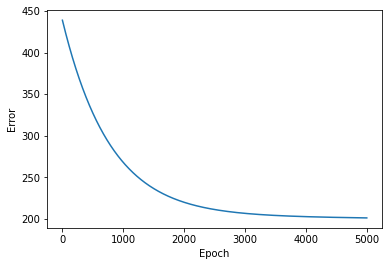

Weight Matrices 
[array([[0.43267087, 0.29112202],
       [0.18731453, 0.53981754]]), array([[0.41781763, 0.25771736],
       [0.59782382, 0.55906209]])]


In [166]:
n5_sigmoid.train(5000, 0.000001)

In [167]:
X_test = np.array([[[random.random()],[random.random()]] for i in range(100)])
Y_test = np.array([[[X[i][0, 0]**1.5],[X[i][1,0]**2*2]] for i in range(100)])

In [169]:
Y_test

array([[[7.20598070e-02],
        [1.71949483e+00]],

       [[2.04167144e-02],
        [4.99044594e-03]],

       [[5.17002823e-01],
        [1.12830657e+00]],

       [[5.66863515e-01],
        [1.07125116e+00]],

       [[8.01594705e-03],
        [2.18619382e-01]],

       [[1.64058509e-02],
        [4.55075690e-01]],

       [[8.52778180e-02],
        [1.20815765e+00]],

       [[2.07818873e-03],
        [1.82443140e+00]],

       [[5.94666246e-01],
        [1.15097525e+00]],

       [[6.04909010e-01],
        [9.43382822e-01]],

       [[4.75735433e-01],
        [8.27667356e-01]],

       [[5.18408557e-01],
        [1.56141738e+00]],

       [[3.59965399e-02],
        [6.71919939e-01]],

       [[1.02071691e-01],
        [7.89690078e-02]],

       [[8.15376231e-01],
        [8.28275140e-01]],

       [[1.46094267e-04],
        [7.30440073e-01]],

       [[2.77734114e-02],
        [2.97541459e-02]],

       [[6.11368150e-01],
        [2.81474599e-01]],

       [[1.49506198e-01],
  

In [168]:
n5_sigmoid.test(X_test)

[array([[0.40931941],
        [0.70333051]]),
 array([[0.38542138],
        [0.65865813]]),
 array([[0.35023992],
        [0.60004387]]),
 array([[0.3814943 ],
        [0.65385487]]),
 array([[0.39553666],
        [0.68216708]]),
 array([[0.41338246],
        [0.70631566]]),
 array([[0.38930687],
        [0.66167485]]),
 array([[0.38221463],
        [0.65166842]]),
 array([[0.34800601],
        [0.59549012]]),
 array([[0.40759451],
        [0.69529691]]),
 array([[0.43529782],
        [0.74704259]]),
 array([[0.39103231],
        [0.67280237]]),
 array([[0.42583864],
        [0.7291223 ]]),
 array([[0.44393172],
        [0.75927679]]),
 array([[0.37606574],
        [0.64410861]]),
 array([[0.41722449],
        [0.71830116]]),
 array([[0.42839276],
        [0.7306936 ]]),
 array([[0.40981884],
        [0.70125495]]),
 array([[0.38736436],
        [0.6649898 ]]),
 array([[0.36801137],
        [0.62764843]]),
 array([[0.41694538],
        [0.71866634]]),
 array([[0.39325178],
        [0.6

## Comments
Waiit a minute, I get nearly same values for all inputs! Guess sigmoid does this? Probably not good for small inputs. 

## Result
I end up with a final error of 204/500, which means every element in the training sample is about 0.63 away from the 
correct answer. Once again, since all the values are between 0 and 1, this is beyond depressing. 

Perhaps this is not as useful for regression as it is for classification?